In [25]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [27]:
listeners = []
strings = """[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.00025 ,11],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.00025 ,21]
]"""

In [29]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[6026, 8279, 5563, 5750, 5669, 894, 3002, 3893, 3782, 2254, 8280, 9817, 7971, 5644, 9331, 5220, 1198, 3168, 4762, 2463]
log initialized
Average similarity between family members is 0.9694640532585566 at temperature -1
Average similarity between family and home is 0.9998533982063503 at temperature -1
Average similarity between students and their classroom is 0.7666349721190233 at temperature -1
Average classroom occupancy is 4.656716417910448 and number classrooms is 67
Average similarity between workers is 0.9679399383600794 at temperature -1
Average office occupancy is 3.3978494623655915 and number offices is 186
Average friend similarity for adults: 0.8541519311728054 for kids: 0.7257820164568767
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.6794936015292673
avg restaurant similarity 0.6913476712424226
avg restaurant similarity 0.6631810700228994
avg restaurant similarity 0.6962926929730454
avg restaurant similarity 0.6338461974660687
avg restaurant similarity 0.6299893957759132
avg restaurant similarity 0.6630811994013177
avg restaurant similarity 0.6567265832441709
avg restaurant similarity 0.6360830149646142
avg restaurant similarity 0.655344539712711
avg restaurant similarity 0.6936516738484828
avg restaurant similarity 0.6501843898876581
avg restaurant similarity 0.6472682925454092
avg restaurant similarity 0.681643476723214
avg restaurant similarity 0.651243743035179
avg restaurant similarity 0.6457028753464581
avg restaurant similarity 0.674097501242087
avg restaurant similarity 0.6373941593541412
avg restaurant similarity 0.6878431209208843
avg restaurant similarity 0.7129761261088404
avg restaurant similarity 0.6480732110546534
avg restaurant similarity 0.6747598929645863
avg restaurant

avg restaurant similarity 0.6261587243310395
avg restaurant similarity 0.632520026497405
avg restaurant similarity 0.6357810098212804
avg restaurant similarity 0.6231904386389061
avg restaurant similarity 0.6056666823077481
avg restaurant similarity 0.641060574647548
avg restaurant similarity 0.6549881427379434
avg restaurant similarity 0.6805123949967726
avg restaurant similarity 0.6428430174959743
avg restaurant similarity 0.6715140628353206
avg restaurant similarity 0.6388470805707236
avg restaurant similarity 0.6333170962772366
avg restaurant similarity 0.6924522281361168
avg restaurant similarity 0.6521495392496963
avg restaurant similarity 0.6738890900033255
avg restaurant similarity 0.6685684341175004
avg restaurant similarity 0.6552607524447522
avg restaurant similarity 0.6533087885923553
avg restaurant similarity 0.677213931699943
avg restaurant similarity 0.6529555412767839
avg restaurant similarity 0.6484241468236318
avg restaurant similarity 0.6466144489934337
avg restauran

avg restaurant similarity 0.6915377630772066
avg restaurant similarity 0.6681937804301519
avg restaurant similarity 0.6241296852334937
avg restaurant similarity 0.6718788756306401
avg restaurant similarity 0.6776675836192628
avg restaurant similarity 0.6706969817116579
avg restaurant similarity 0.7010206957471545
avg restaurant similarity 0.645543120607781
avg restaurant similarity 0.6269980972940389
avg restaurant similarity 0.6697233035116298
avg restaurant similarity 0.6611601285273435
avg restaurant similarity 0.6346697234557582
avg restaurant similarity 0.6431695249376623
avg restaurant similarity 0.6409406860497397
avg restaurant similarity 0.6769986671458669
avg restaurant similarity 0.7239084033020047
avg restaurant similarity 0.6526035243936116
avg restaurant similarity 0.6787518425630444
avg restaurant similarity 0.6577674363722951
avg restaurant similarity 0.6730791465214968
avg restaurant similarity 0.6528868851773636
avg restaurant similarity 0.6704298634638827
avg restaur

avg restaurant similarity 0.6903160742191355
avg restaurant similarity 0.6786290378491484
avg restaurant similarity 0.6355147120431057
avg restaurant similarity 0.6302641911017577
avg restaurant similarity 0.7039784968164594
avg restaurant similarity 0.6726602953589061
avg restaurant similarity 0.6418483790581797
avg restaurant similarity 0.6764817423851505
avg restaurant similarity 0.6733476103315578
avg restaurant similarity 0.6419891875620721
avg restaurant similarity 0.6674355139742797
avg restaurant similarity 0.6199760606933375
avg restaurant similarity 0.6718238567196687
avg restaurant similarity 0.6632573453753837
avg restaurant similarity 0.6183847293735244
avg restaurant similarity 0.6906381800856449
avg restaurant similarity 0.6642917703886819
avg restaurant similarity 0.6567573207178748
avg restaurant similarity 0.6864831514121643
avg restaurant similarity 0.6733544844507481
avg restaurant similarity 0.7203296934183059
avg restaurant similarity 0.6932626893878308
avg restau

avg restaurant similarity 0.6285592259714768
avg restaurant similarity 0.6589363269233772
avg restaurant similarity 0.641984950850595
avg restaurant similarity 0.6849847999985844
avg restaurant similarity 0.6311437170496242
avg restaurant similarity 0.6598926066540707
avg restaurant similarity 0.6744514589687691
avg restaurant similarity 0.6600691088525867
avg restaurant similarity 0.6416394165598547
avg restaurant similarity 0.6274217434982885
avg restaurant similarity 0.5496470615594817
avg restaurant similarity 0.6318063519548169
avg restaurant similarity 0.6587030442367372
avg restaurant similarity 0.6292931736026731
avg restaurant similarity 0.6845178595017931
avg restaurant similarity 0.6604904639190178
avg restaurant similarity 0.6545290732481842
avg restaurant similarity 0.6439310739303638
avg restaurant similarity 0.6805994287773764
avg restaurant similarity 0.6737067069128658
avg restaurant similarity 0.6803450579323027
avg restaurant similarity 0.6695261649037458
avg restaur

avg restaurant similarity 0.6428143486388718
avg restaurant similarity 0.6536822776862264
avg restaurant similarity 0.6229856788371958
avg restaurant similarity 0.62839736859769
avg restaurant similarity 0.6696860822384796
avg restaurant similarity 0.6535131886427061
avg restaurant similarity 0.6478733707453842
avg restaurant similarity 0.6481265347707901
avg restaurant similarity 0.6199164556207925
avg restaurant similarity 0.6862623401046164
avg restaurant similarity 0.6843606835297454
avg restaurant similarity 0.6377814925443114
avg restaurant similarity 0.6651704266856662
avg restaurant similarity 0.7038082789218463
avg restaurant similarity 0.6704461958818747
avg restaurant similarity 0.6540702532122286
avg restaurant similarity 0.6576526421273174
avg restaurant similarity 0.6203155258567666
avg restaurant similarity 0.5999885343307555
avg restaurant similarity 0.6344240770609747
avg restaurant similarity 0.6900307387393358
avg restaurant similarity 0.6341489244731796
avg restaura

avg restaurant similarity 0.7070675715030605
avg restaurant similarity 0.6313506312521467
avg restaurant similarity 0.6052462923453046
avg restaurant similarity 0.6676320235934531
avg restaurant similarity 0.6581093265374868
avg restaurant similarity 0.6278344364468895
avg restaurant similarity 0.6931885113323687
avg restaurant similarity 0.6848541646716265
avg restaurant similarity 0.6220246990782703
avg restaurant similarity 0.6734778647809105
avg restaurant similarity 0.6787121817374173
avg restaurant similarity 0.660983541796103
avg restaurant similarity 0.62978052951653
avg restaurant similarity 0.670348958350859
avg restaurant similarity 0.6628747184116736
avg restaurant similarity 0.6480413086852067
avg restaurant similarity 0.6319462050239995
avg restaurant similarity 0.6586444804143342
avg restaurant similarity 0.6932950407256367
avg restaurant similarity 0.6748945808619621
avg restaurant similarity 0.6479793361425765
avg restaurant similarity 0.6481580679227158
avg restaurant

avg restaurant similarity 0.6611858725542973
avg restaurant similarity 0.6691077295189943
avg restaurant similarity 0.6614252275250446
avg restaurant similarity 0.6780464359348873
avg restaurant similarity 0.6534655231941017
avg restaurant similarity 0.6228530510409535
avg restaurant similarity 0.6672555817663083
avg restaurant similarity 0.597937467372077
avg restaurant similarity 0.6651950352875008
avg restaurant similarity 0.6768843426530112
avg restaurant similarity 0.6646992937078356
avg restaurant similarity 0.6105412835715364
avg restaurant similarity 0.645611662022312
avg restaurant similarity 0.6514125791111224
avg restaurant similarity 0.612751512561923
avg restaurant similarity 0.7338849963376548
avg restaurant similarity 0.6211318134530737
avg restaurant similarity 0.6389142497163767
avg restaurant similarity 0.6606684831527383
avg restaurant similarity 0.6971855090429625
avg restaurant similarity 0.6818610527702644
avg restaurant similarity 0.6379936859512375
avg restauran

avg restaurant similarity 0.710351125845528
avg restaurant similarity 0.6803512387215463
avg restaurant similarity 0.6678514965920892
avg restaurant similarity 0.7095146282609242
avg restaurant similarity 0.7201192499434572
avg restaurant similarity 0.6563545832103671
avg restaurant similarity 0.6504175731461437
avg restaurant similarity 0.6666398211470405
avg restaurant similarity 0.6635535342687457
avg restaurant similarity 0.7290159553618784
avg restaurant similarity 0.7002629204619584
avg restaurant similarity 0.6802823278136556
avg restaurant similarity 0.681066620723596
avg restaurant similarity 0.6583121052099863
avg restaurant similarity 0.6355978848707663
avg restaurant similarity 0.6713224465772415
avg restaurant similarity 0.6783100466169552
avg restaurant similarity 0.7089324667246173
avg restaurant similarity 0.6926012380630391
avg restaurant similarity 0.6834895628257507
avg restaurant similarity 0.6911408049697948
avg restaurant similarity 0.7350052342804084
avg restaura

avg restaurant similarity 0.6545691516079497
avg restaurant similarity 0.6897528466897177
avg restaurant similarity 0.6603009679716957
avg restaurant similarity 0.6038156878050313
avg restaurant similarity 0.6507002881394998
avg restaurant similarity 0.6727715783262816
avg restaurant similarity 0.6950938714262732
avg restaurant similarity 0.7037087226860054
avg restaurant similarity 0.7110377682549127
avg restaurant similarity 0.6436532327385469
avg restaurant similarity 0.6527180485755953
avg restaurant similarity 0.6711152720393739
avg restaurant similarity 0.69796880457326
avg restaurant similarity 0.7018579823237086
avg restaurant similarity 0.7089018090042675
avg restaurant similarity 0.6602395449214985
avg restaurant similarity 0.6649415816661614
avg restaurant similarity 0.6774854098269251
avg restaurant similarity 0.6911551032745964
avg restaurant similarity 0.654906329523743
avg restaurant similarity 0.6829507906345099
avg restaurant similarity 0.7467956349823436
avg restauran

avg restaurant similarity 0.6856274457169164
avg restaurant similarity 0.7288094520522841
avg restaurant similarity 0.6446190683853884
avg restaurant similarity 0.6783800702791523
avg restaurant similarity 0.6430124276493541
avg restaurant similarity 0.6903053123299175
avg restaurant similarity 0.6318306141365084
avg restaurant similarity 0.699121155848587
avg restaurant similarity 0.6802878115021346
avg restaurant similarity 0.6969552027298438
avg restaurant similarity 0.6715943776930192
avg restaurant similarity 0.6620730969445875
avg restaurant similarity 0.7075645824498882
avg restaurant similarity 0.5968743157523629
avg restaurant similarity 0.6711240078554397
avg restaurant similarity 0.5986218543795769
avg restaurant similarity 0.7064527811895241
avg restaurant similarity 0.6784456350876383
avg restaurant similarity 0.6759691007850223
avg restaurant similarity 0.6539015003300699
avg restaurant similarity 0.6512282560025052
avg restaurant similarity 0.5395643640045636
avg restaur

avg restaurant similarity 0.6788271996225436
avg restaurant similarity 0.6385833199260834
avg restaurant similarity 0.684305610654839
avg restaurant similarity 0.666051099986687
avg restaurant similarity 0.721944078918284
avg restaurant similarity 0.6724614613655236
avg restaurant similarity 0.646878489650781
avg restaurant similarity 0.6937760768965704
avg restaurant similarity 0.6979675942155248
avg restaurant similarity 0.6653387312563854
avg restaurant similarity 0.6412522340700337
avg restaurant similarity 0.6548452752165755
avg restaurant similarity 0.6276869723005247
avg restaurant similarity 0.6193375479687764
avg restaurant similarity 0.6959931849115782
avg restaurant similarity 0.6015695695345952
avg restaurant similarity 0.6792869535896675
avg restaurant similarity 0.621666500488481
avg restaurant similarity 0.6047145292694212
avg restaurant similarity 0.6561767825552343
avg restaurant similarity 0.6956980657258944
avg restaurant similarity 0.6298440177968746
avg restaurant 

avg restaurant similarity 0.6805658910264968
avg restaurant similarity 0.7274617811300215
avg restaurant similarity 0.74134885922224
avg restaurant similarity 0.7231048420225012
avg restaurant similarity 0.7218826661928636
avg restaurant similarity 0.676087823965631
avg restaurant similarity 0.6606645221459787
avg restaurant similarity 0.6982917907373706
avg restaurant similarity 0.6466301921320265
avg restaurant similarity 0.6731302706763781
avg restaurant similarity 0.649910893767381
avg restaurant similarity 0.7012420575546922
avg restaurant similarity 0.6829486872674374
avg restaurant similarity 0.6616018328366118
avg restaurant similarity 0.6667360824610319
avg restaurant similarity 0.701167338857501
avg restaurant similarity 0.6458078584585013
avg restaurant similarity 0.6705788357599124
avg restaurant similarity 0.6308733248043179
avg restaurant similarity 0.6591527680845248
avg restaurant similarity 0.6676080347735368
avg restaurant similarity 0.6299016360216645
avg restaurant 

avg restaurant similarity 0.6832071889403021
avg restaurant similarity 0.5872474221610217
avg restaurant similarity 0.6312419543989276
avg restaurant similarity 0.6536790239633506
avg restaurant similarity 0.7271459491529307
avg restaurant similarity 0.6299948368256599
avg restaurant similarity 0.6869558228743557
avg restaurant similarity 0.6964296500342367
avg restaurant similarity 0.6649129993814794
avg restaurant similarity 0.6878066100578568
avg restaurant similarity 0.655178601539871
avg restaurant similarity 0.6883600202490087
avg restaurant similarity 0.6997173492155645
avg restaurant similarity 0.6885707438116495
avg restaurant similarity 0.681768790782719
avg restaurant similarity 0.6433211046181675
avg restaurant similarity 0.7046683282213058
avg restaurant similarity 0.6984367536970645
avg restaurant similarity 0.71222154148688
avg restaurant similarity 0.7226214693182107
avg restaurant similarity 0.6826404623814344
avg restaurant similarity 0.6816546943905659
avg restaurant

avg restaurant similarity 0.6515231580759963
avg restaurant similarity 0.6219227720119939
avg restaurant similarity 0.6333858923690532
avg restaurant similarity 0.6784508220624287
avg restaurant similarity 0.6599194984287836
avg restaurant similarity 0.6862686775691673
avg restaurant similarity 0.6271495936895677
avg restaurant similarity 0.6351675035243419
avg restaurant similarity 0.6283352861797203
avg restaurant similarity 0.6170023979462435
avg restaurant similarity 0.6491834289655284
avg restaurant similarity 0.6156052855615315
avg restaurant similarity 0.6548241016448264
avg restaurant similarity 0.6643319457488078
avg restaurant similarity 0.6550165479657941
avg restaurant similarity 0.6435791250833119
avg restaurant similarity 0.6538427099215536
avg restaurant similarity 0.6643466774492022
avg restaurant similarity 0.6272065593742655
avg restaurant similarity 0.6924425341134454
avg restaurant similarity 0.5988029979722972
avg restaurant similarity 0.6001247785951697
avg restau

avg restaurant similarity 0.6220574049315718
avg restaurant similarity 0.653350764895446
avg restaurant similarity 0.6753858908536272
avg restaurant similarity 0.6898717088460012
avg restaurant similarity 0.62415879680199
avg restaurant similarity 0.6714370247245756
avg restaurant similarity 0.6300673631174485
avg restaurant similarity 0.7002336045585248
avg restaurant similarity 0.6516091490324543
avg restaurant similarity 0.6401541629438728
avg restaurant similarity 0.6598832431684157
avg restaurant similarity 0.6447691843462926
avg restaurant similarity 0.6205362177372332
avg restaurant similarity 0.6187250833399869
avg restaurant similarity 0.6390533854579795
avg restaurant similarity 0.663459474466643
avg restaurant similarity 0.678318577734513
avg restaurant similarity 0.6205652597900638
avg restaurant similarity 0.6564275540641483
avg restaurant similarity 0.6571516370202337
avg restaurant similarity 0.6324350975975183
avg restaurant similarity 0.6488416255055943
avg restaurant 

avg restaurant similarity 0.6943533031083056
avg restaurant similarity 0.6731866295657278
avg restaurant similarity 0.6233077106121674
avg restaurant similarity 0.6144574436667217
avg restaurant similarity 0.7047769053486311
avg restaurant similarity 0.6696074155353534
avg restaurant similarity 0.6603917579182893
avg restaurant similarity 0.6941031135383527
avg restaurant similarity 0.6363103717564217
avg restaurant similarity 0.6782732231193352
avg restaurant similarity 0.6745113239402148
avg restaurant similarity 0.6123109867226058
avg restaurant similarity 0.6017780805807651
avg restaurant similarity 0.6703565241312204
avg restaurant similarity 0.682003362974559
avg restaurant similarity 0.6992465843903558
avg restaurant similarity 0.661818317980523
avg restaurant similarity 0.6310449652386954
avg restaurant similarity 0.6917182697803519
avg restaurant similarity 0.660657873870154
avg restaurant similarity 0.672735683323494
avg restaurant similarity 0.7013368420835743
avg restaurant

avg restaurant similarity 0.7306595612035097
avg restaurant similarity 0.6186942738919016
avg restaurant similarity 0.6248658247120596
avg restaurant similarity 0.6418570722848727
avg restaurant similarity 0.6796628864957214
avg restaurant similarity 0.6781236329006134
avg restaurant similarity 0.6999035993611776
avg restaurant similarity 0.6320784043044579
avg restaurant similarity 0.6927300140137177
avg restaurant similarity 0.6780270081743522
avg restaurant similarity 0.6604214502111582
avg restaurant similarity 0.6485285239010872
avg restaurant similarity 0.6898963077768182
avg restaurant similarity 0.680654118201132
avg restaurant similarity 0.6663385436688505
avg restaurant similarity 0.6800574994000106
avg restaurant similarity 0.652263284068687
avg restaurant similarity 0.6652999852283497
avg restaurant similarity 0.646479347445294
avg restaurant similarity 0.6862195587154069
avg restaurant similarity 0.6525237023388963
avg restaurant similarity 0.719037351209018
avg restaurant

avg restaurant similarity 0.6375032939560755
avg restaurant similarity 0.6298535561684118
avg restaurant similarity 0.7161452023996152
avg restaurant similarity 0.6378215546201211
avg restaurant similarity 0.6364807988054546
avg restaurant similarity 0.6684147642052714
avg restaurant similarity 0.6522298886151512
avg restaurant similarity 0.6528626444169737
avg restaurant similarity 0.6350834410786559
avg restaurant similarity 0.6309851226794574
avg restaurant similarity 0.6412650240970892
avg restaurant similarity 0.623263557283528
avg restaurant similarity 0.6625841081771511
avg restaurant similarity 0.6287751972632065
avg restaurant similarity 0.6326146160542504
avg restaurant similarity 0.6800128533000102
avg restaurant similarity 0.6461248981170888
avg restaurant similarity 0.6525695973156405
avg restaurant similarity 0.6334347918355316
avg restaurant similarity 0.6362934087341838
avg restaurant similarity 0.6733075187639032
avg restaurant similarity 0.6159433876702556
avg restaur

avg restaurant similarity 0.6283818517654417
avg restaurant similarity 0.6506010092425644
avg restaurant similarity 0.6482187307599876
avg restaurant similarity 0.6465333960833777
avg restaurant similarity 0.6513533187738272
avg restaurant similarity 0.6436418444182375
avg restaurant similarity 0.6373061018332301
avg restaurant similarity 0.6673574256700809
avg restaurant similarity 0.648466801524167
avg restaurant similarity 0.6402573959389516
avg restaurant similarity 0.6338758592758584
avg restaurant similarity 0.6060083956988074
avg restaurant similarity 0.6844027281792505
avg restaurant similarity 0.649577184764247
avg restaurant similarity 0.6562862565457867
avg restaurant similarity 0.6396630861122573
avg restaurant similarity 0.5702456207520699
avg restaurant similarity 0.6514621011452618
avg restaurant similarity 0.6356887608882623
avg restaurant similarity 0.611211589080339
avg restaurant similarity 0.6222770348436003
avg restaurant similarity 0.6712008933279943
avg restauran

avg restaurant similarity 0.6366102167484678
avg restaurant similarity 0.6388503560464146
avg restaurant similarity 0.5884094445122423
avg restaurant similarity 0.6671472024057808
avg restaurant similarity 0.6727694432187916
avg restaurant similarity 0.669443777743136
avg restaurant similarity 0.6648073044775327
avg restaurant similarity 0.6927148573461493
avg restaurant similarity 0.6599176934203972
avg restaurant similarity 0.7866166830391106
avg restaurant similarity 0.6847066216545791
avg restaurant similarity 0.674382382465245
avg restaurant similarity 0.6417064365303999
avg restaurant similarity 0.7471718112195253
avg restaurant similarity 0.7317465483435471
avg restaurant similarity 0.6093904232009941
avg restaurant similarity 0.6054984231122277
avg restaurant similarity 0.6330639577673085
avg restaurant similarity 0.686810616794072
avg restaurant similarity 0.68459751592328
avg restaurant similarity 0.6957815520453482
avg restaurant similarity 0.6816693722372795
avg restaurant 

avg restaurant similarity 0.7194433072659924
avg restaurant similarity 0.699246424188999
avg restaurant similarity 0.6979354387666342
avg restaurant similarity 0.7412908324005134
avg restaurant similarity 0.7434163353146481
avg restaurant similarity 0.5721273732411509
avg restaurant similarity 0.6723234492451087
avg restaurant similarity 0.6374646611848476
avg restaurant similarity 0.5997862517949155
avg restaurant similarity 0.6595408412945345
avg restaurant similarity 0.650883942896504
avg restaurant similarity 0.7257941412721858
avg restaurant similarity 0.6768700044686817
avg restaurant similarity 0.7198169599274059
avg restaurant similarity 0.7010429044133878
avg restaurant similarity 0.6741035265561001
avg restaurant similarity 0.666929093192652
avg restaurant similarity 0.6332585955743928
avg restaurant similarity 0.6535296743261324
avg restaurant similarity 0.7075637886325191
avg restaurant similarity 0.6421308891069825
avg restaurant similarity 0.6419216344512941
avg restauran

avg restaurant similarity 0.5695528979868693
avg restaurant similarity 0.5435589909639753
avg restaurant similarity 0.5794653090485126
avg restaurant similarity 0.5872517185198621
avg restaurant similarity 0.5756551525459054
avg restaurant similarity 0.6423151355709095
avg restaurant similarity 0.6170653859179631
avg restaurant similarity 0.5957529787645304
avg restaurant similarity 0.5397866210205372
avg restaurant similarity 0.5587929644091787
avg restaurant similarity 0.5973033325214078
avg restaurant similarity 0.5868801062713257
avg restaurant similarity 0.6583915470446167
avg restaurant similarity 0.5524718089948202
avg restaurant similarity 0.5717639501301082
avg restaurant similarity 0.5564309507290955
avg restaurant similarity 0.549310339287232
avg restaurant similarity 0.6020964960950237
avg restaurant similarity 0.6065672397636013
avg restaurant similarity 0.5442860321269838
avg restaurant similarity 0.5697163946500916
avg restaurant similarity 0.6112027830181769
avg restaur

avg restaurant similarity 0.5951036562544976
avg restaurant similarity 0.5851814398511271
avg restaurant similarity 0.6175086594366522
avg restaurant similarity 0.5853043895741147
avg restaurant similarity 0.6284838029587271
avg restaurant similarity 0.5744934189783627
avg restaurant similarity 0.5509739019237423
avg restaurant similarity 0.5710885695820013
avg restaurant similarity 0.564384527636056
avg restaurant similarity 0.5667429425163398
avg restaurant similarity 0.595198081964767
avg restaurant similarity 0.6005055340018128
avg restaurant similarity 0.5986367977080609
avg restaurant similarity 0.5732598201114522
avg restaurant similarity 0.6148421177344212
avg restaurant similarity 0.5501831703980969
avg restaurant similarity 0.5905508125796218
avg restaurant similarity 0.5296101894114135
avg restaurant similarity 0.5594045188681611
avg restaurant similarity 0.6149752665681
avg restaurant similarity 0.6065280143558036
avg restaurant similarity 0.6135823326844383
avg restaurant 

avg restaurant similarity 0.6337830577180786
avg restaurant similarity 0.6475633190084586
avg restaurant similarity 0.6847122122857692
avg restaurant similarity 0.6922076451179736
avg restaurant similarity 0.6609810866342308
avg restaurant similarity 0.6646285842861013
avg restaurant similarity 0.6882133598003917
avg restaurant similarity 0.6765318228661555
avg restaurant similarity 0.6546048947407912
avg restaurant similarity 0.6561536566385399
avg restaurant similarity 0.6677753622146906
avg restaurant similarity 0.6781791659126086
avg restaurant similarity 0.6670286757488499
avg restaurant similarity 0.6814709875215191
avg restaurant similarity 0.6703953821946866
avg restaurant similarity 0.6619443056847056
avg restaurant similarity 0.6974366960926636
avg restaurant similarity 0.6770082866892497
avg restaurant similarity 0.7132897792657691
avg restaurant similarity 0.656356957215523
avg restaurant similarity 0.6812259667274198
avg restaurant similarity 0.6291327906781591
avg restaur

avg restaurant similarity 0.7150174353879327
avg restaurant similarity 0.7056458851364028
avg restaurant similarity 0.666818072704366
avg restaurant similarity 0.7227766070938413
avg restaurant similarity 0.7232488429889381
avg restaurant similarity 0.6414658327885747
avg restaurant similarity 0.6677737068851824
avg restaurant similarity 0.6521384417682282
avg restaurant similarity 0.6541550101431818
avg restaurant similarity 0.7007220885570933
avg restaurant similarity 0.6879024248010848
avg restaurant similarity 0.6625813811106243
avg restaurant similarity 0.6149217356743121
avg restaurant similarity 0.6748261893231261
avg restaurant similarity 0.6292655250920038
avg restaurant similarity 0.6905618272165762
avg restaurant similarity 0.6947880027526697
avg restaurant similarity 0.6872132255721636
avg restaurant similarity 0.7252808220146403
avg restaurant similarity 0.691621862814192
avg restaurant similarity 0.7148411654223817
avg restaurant similarity 0.7083471731865356
avg restaura

avg restaurant similarity 0.7052922762539797
avg restaurant similarity 0.6806099170706614
avg restaurant similarity 0.664924262224771
avg restaurant similarity 0.6509502120021949
avg restaurant similarity 0.6411199483664856
avg restaurant similarity 0.671852646674858
avg restaurant similarity 0.701587648647346
avg restaurant similarity 0.7132950039138867
avg restaurant similarity 0.6363357161548915
avg restaurant similarity 0.6549936794138375
avg restaurant similarity 0.7319139698100149
avg restaurant similarity 0.7100167914056014
avg restaurant similarity 0.6278764184696067
avg restaurant similarity 0.676971061172984
avg restaurant similarity 0.615442238990307
avg restaurant similarity 0.5726800816362733
avg restaurant similarity 0.6331044893797775
avg restaurant similarity 0.6600196112113326
avg restaurant similarity 0.5901349129600517
avg restaurant similarity 0.6112967503398977
avg restaurant similarity 0.6319021062682003
avg restaurant similarity 0.6690153041146373
avg restaurant 

avg restaurant similarity 0.7105246033277157
avg restaurant similarity 0.6801384885927015
avg restaurant similarity 0.6494302563314786
avg restaurant similarity 0.6867421076818849
avg restaurant similarity 0.640434565042018
avg restaurant similarity 0.6247047768497457
avg restaurant similarity 0.6351390024273902
avg restaurant similarity 0.7022102598884913
avg restaurant similarity 0.6680434490954954
avg restaurant similarity 0.5974261587142455
avg restaurant similarity 0.7168715942910783
avg restaurant similarity 0.6957428890164855
avg restaurant similarity 0.5840253240861046
avg restaurant similarity 0.6452394722406063
avg restaurant similarity 0.6981943569860495
avg restaurant similarity 0.6719073441599631
avg restaurant similarity 0.7257545694113122
avg restaurant similarity 0.6247465672135544
avg restaurant similarity 0.7077971537598097
avg restaurant similarity 0.7089182073499031
avg restaurant similarity 0.61577722930633
avg restaurant similarity 0.7004025476309691
avg restauran

avg restaurant similarity 0.6603652564828657
avg restaurant similarity 0.6453912333864686
avg restaurant similarity 0.7041718328300425
avg restaurant similarity 0.6640033568559834
avg restaurant similarity 0.6373299941307704
avg restaurant similarity 0.6549782518455842
avg restaurant similarity 0.694562017669954
avg restaurant similarity 0.7005418391943191
avg restaurant similarity 0.6545676127558177
avg restaurant similarity 0.6117651860178024
avg restaurant similarity 0.665616996965951
avg restaurant similarity 0.6312850901573244
avg restaurant similarity 0.6440584266288331
avg restaurant similarity 0.6658623328460178
avg restaurant similarity 0.6708413691357964
avg restaurant similarity 0.6723139791587793
avg restaurant similarity 0.6913075129623701
avg restaurant similarity 0.6671088800888924
avg restaurant similarity 0.6326924353588118
avg restaurant similarity 0.7147173568719406
avg restaurant similarity 0.6643429551439788
avg restaurant similarity 0.6289679164235139
avg restaura

avg restaurant similarity 0.636486328902265
avg restaurant similarity 0.6651719789991003
avg restaurant similarity 0.6698258553137333
avg restaurant similarity 0.6208113013735299
avg restaurant similarity 0.6336415593409712
avg restaurant similarity 0.7069194051219109
avg restaurant similarity 0.7050709313707355
avg restaurant similarity 0.6338491816085505
avg restaurant similarity 0.6290060923066478
avg restaurant similarity 0.6702317051067073
avg restaurant similarity 0.6479666753866877
avg restaurant similarity 0.6755263957271617
avg restaurant similarity 0.6411663074775544
avg restaurant similarity 0.6494268472798244
avg restaurant similarity 0.670442288478423
avg restaurant similarity 0.6471305392385743
avg restaurant similarity 0.6195052480799621
avg restaurant similarity 0.6192694439652221
avg restaurant similarity 0.6721667804751935
avg restaurant similarity 0.7121813828748729
avg restaurant similarity 0.6110615311108489
avg restaurant similarity 0.6357030788000719
avg restaura

avg restaurant similarity 0.6804883078027409
avg restaurant similarity 0.6792360479729597
avg restaurant similarity 0.6693264729811848
avg restaurant similarity 0.6457045239013561
avg restaurant similarity 0.6603344836666662
avg restaurant similarity 0.6549415545995563
avg restaurant similarity 0.6090926812812701
avg restaurant similarity 0.6296156393319171
avg restaurant similarity 0.6611258754353586
avg restaurant similarity 0.6660535802578426
avg restaurant similarity 0.6555316070671631
avg restaurant similarity 0.5922847777534783
avg restaurant similarity 0.5904624066221436
avg restaurant similarity 0.5854308942389234
avg restaurant similarity 0.704180699684391
avg restaurant similarity 0.6544266857446764
avg restaurant similarity 0.6181421961385115
avg restaurant similarity 0.6067618692111837
avg restaurant similarity 0.5977492877775804
avg restaurant similarity 0.6610449244610384
avg restaurant similarity 0.5131995107558885
avg restaurant similarity 0.5592919901169453
avg restaur

avg restaurant similarity 0.6504958656787145
avg restaurant similarity 0.6356062017804647
avg restaurant similarity 0.6040568112063921
avg restaurant similarity 0.5905339751669891
avg restaurant similarity 0.6915129193628967
avg restaurant similarity 0.6913676579881559
avg restaurant similarity 0.7021064265131526
avg restaurant similarity 0.6464674486964234
avg restaurant similarity 0.6417394142185153
avg restaurant similarity 0.6672366839736608
avg restaurant similarity 0.6279048713179627
avg restaurant similarity 0.6422058035058344
avg restaurant similarity 0.6628315866973555
avg restaurant similarity 0.6530283504989947
avg restaurant similarity 0.5617111078968842
avg restaurant similarity 0.7075337337229881
avg restaurant similarity 0.6678493061649297
avg restaurant similarity 0.6104035654844379
avg restaurant similarity 0.7143083673105416
avg restaurant similarity 0.687276240498791
avg restaurant similarity 0.5891094302821689
avg restaurant similarity 0.6546526953929406
avg restaur

avg restaurant similarity 0.6471366595513984
avg restaurant similarity 0.6511103082395167
avg restaurant similarity 0.6862765635108375
avg restaurant similarity 0.660672209246628
avg restaurant similarity 0.6550280717322211
avg restaurant similarity 0.6239243184214702
avg restaurant similarity 0.6711003931588666
avg restaurant similarity 0.6737609026751856
avg restaurant similarity 0.6766873666141974
avg restaurant similarity 0.6126970745341831
avg restaurant similarity 0.6731380029525271
avg restaurant similarity 0.6576573450660738
avg restaurant similarity 0.6519478101186014
avg restaurant similarity 0.6439567208185512
avg restaurant similarity 0.6684415754488786
avg restaurant similarity 0.6394912232662886
avg restaurant similarity 0.6236842787623204
avg restaurant similarity 0.6657585664017832
avg restaurant similarity 0.6380657450046131
avg restaurant similarity 0.674960542521746
avg restaurant similarity 0.6108474822119037
avg restaurant similarity 0.6550851545964063
avg restaura

avg restaurant similarity 0.6825742088305307
avg restaurant similarity 0.6656635793568545
avg restaurant similarity 0.6172816377194459
avg restaurant similarity 0.6898394928978296
avg restaurant similarity 0.6515320088025042
avg restaurant similarity 0.6366789136324051
avg restaurant similarity 0.5845846729499311
avg restaurant similarity 0.6850198394704079
avg restaurant similarity 0.691188589034435
avg restaurant similarity 0.6337369462871828
avg restaurant similarity 0.5992616084845842
avg restaurant similarity 0.6556045460892292
avg restaurant similarity 0.6323700732073815
avg restaurant similarity 0.6964049219164474
avg restaurant similarity 0.6398268503221327
avg restaurant similarity 0.6641520777560918
avg restaurant similarity 0.6739524062975313
avg restaurant similarity 0.5888626389405752
avg restaurant similarity 0.6962548391706374
avg restaurant similarity 0.6549099911578078
avg restaurant similarity 0.6605071007190039
avg restaurant similarity 0.6655098020900491
avg restaur

avg restaurant similarity 0.6912910117209452
avg restaurant similarity 0.6288262704329468
avg restaurant similarity 0.6566627306691624
avg restaurant similarity 0.6478637955332971
avg restaurant similarity 0.7106266493411154
avg restaurant similarity 0.6319728683480658
avg restaurant similarity 0.6689188187502031
avg restaurant similarity 0.6280552049270877
avg restaurant similarity 0.6870972916132542
avg restaurant similarity 0.6736461974564929
avg restaurant similarity 0.6596700658908128
avg restaurant similarity 0.6532081253222014
avg restaurant similarity 0.7041579848677999
avg restaurant similarity 0.6844890421257231
avg restaurant similarity 0.6117951799668253
avg restaurant similarity 0.6714335553518868
avg restaurant similarity 0.6828985549053181
avg restaurant similarity 0.7005380695425463
avg restaurant similarity 0.700906987839837
avg restaurant similarity 0.6306127293814177
avg restaurant similarity 0.6680804777050885
avg restaurant similarity 0.647432856789803
avg restaura

avg restaurant similarity 0.6636612780610398
avg restaurant similarity 0.668067266191234
avg restaurant similarity 0.6637671383609578
avg restaurant similarity 0.6656450743294343
avg restaurant similarity 0.660968607342483
avg restaurant similarity 0.6203136759462674
avg restaurant similarity 0.6805768262771871
avg restaurant similarity 0.6478160826917173
avg restaurant similarity 0.6261434469005702
avg restaurant similarity 0.6879778419295086
avg restaurant similarity 0.6809230298860359
avg restaurant similarity 0.6907262483322367
avg restaurant similarity 0.6165018449605576
avg restaurant similarity 0.6558201410347427
avg restaurant similarity 0.6535439201691516
avg restaurant similarity 0.6524512687582911
avg restaurant similarity 0.6451048404485974
avg restaurant similarity 0.6696770391230138
avg restaurant similarity 0.6835317224950749
avg restaurant similarity 0.6496435844671359
avg restaurant similarity 0.6485022037820452
avg restaurant similarity 0.651068130002388
avg restauran

avg restaurant similarity 0.6537131129337815
avg restaurant similarity 0.6282368367511233
avg restaurant similarity 0.6567247914379285
avg restaurant similarity 0.6784928004493763
avg restaurant similarity 0.6423402380858532
avg restaurant similarity 0.6254169573351275
avg restaurant similarity 0.6651823123578581
avg restaurant similarity 0.6655518857803578
avg restaurant similarity 0.6356521259917075
avg restaurant similarity 0.642656143254709
avg restaurant similarity 0.6291271349212115
avg restaurant similarity 0.7053848932600625
avg restaurant similarity 0.6552087394397309
avg restaurant similarity 0.6273610965973301
avg restaurant similarity 0.6853849550606115
avg restaurant similarity 0.6388233338127749
avg restaurant similarity 0.6677970049152221
avg restaurant similarity 0.6364330500782337
avg restaurant similarity 0.6589284079162875
avg restaurant similarity 0.6621730958709491
avg restaurant similarity 0.5895722880575512
avg restaurant similarity 0.6234605001639066
avg restaur

avg restaurant similarity 0.6541227691830753
avg restaurant similarity 0.6670610932629151
avg restaurant similarity 0.6247622751932183
avg restaurant similarity 0.6771190067298735
avg restaurant similarity 0.6199586482649156
avg restaurant similarity 0.639963221292496
avg restaurant similarity 0.5977875824527296
avg restaurant similarity 0.6195224885549068
avg restaurant similarity 0.6667989564899363
avg restaurant similarity 0.6569717799582239
avg restaurant similarity 0.6996557554259232
avg restaurant similarity 0.6572911650623565
avg restaurant similarity 0.6422488597005649
avg restaurant similarity 0.6655178301286816
avg restaurant similarity 0.5941788019694345
avg restaurant similarity 0.6179319278809465
avg restaurant similarity 0.6137058339272894
avg restaurant similarity 0.5907806591960424
avg restaurant similarity 0.6371165508781087
avg restaurant similarity 0.6302230002290327
avg restaurant similarity 0.604299265501509
avg restaurant similarity 0.648596957164781
avg restauran

avg restaurant similarity 0.6613400809123176
avg restaurant similarity 0.6446540370288414
avg restaurant similarity 0.6521189834640345
avg restaurant similarity 0.631654956904884
avg restaurant similarity 0.6811810330318393
avg restaurant similarity 0.6430882710141215
avg restaurant similarity 0.661959406656013
avg restaurant similarity 0.6356474110859921
avg restaurant similarity 0.6614303108969726
avg restaurant similarity 0.6504179798570279
avg restaurant similarity 0.6554836314203432
avg restaurant similarity 0.593541715623998
avg restaurant similarity 0.6318419722499192
avg restaurant similarity 0.611723615873458
avg restaurant similarity 0.6180486352003441
avg restaurant similarity 0.6326994754041588
avg restaurant similarity 0.6491158777817942
avg restaurant similarity 0.6317152067362096
avg restaurant similarity 0.6864671609209096
avg restaurant similarity 0.6627758745059208
avg restaurant similarity 0.611894568736985
avg restaurant similarity 0.6267744492289412
avg restaurant 

avg restaurant similarity 0.6521047870565727
avg restaurant similarity 0.6344696726869423
avg restaurant similarity 0.6272630777237278
avg restaurant similarity 0.6109593509068425
avg restaurant similarity 0.6242482167180802
avg restaurant similarity 0.6302453738070849
avg restaurant similarity 0.6392726867144832
avg restaurant similarity 0.6469979182529322
avg restaurant similarity 0.6054831273937129
avg restaurant similarity 0.6698665247187309
avg restaurant similarity 0.62436737399024
avg restaurant similarity 0.6329568756239751
avg restaurant similarity 0.6603252129303563
avg restaurant similarity 0.6472470609796049
avg restaurant similarity 0.6429479129591709
avg restaurant similarity 0.644936439603469
avg restaurant similarity 0.6167762170188996
avg restaurant similarity 0.6358683795430139
avg restaurant similarity 0.6330835123799041
avg restaurant similarity 0.6428658996915435
avg restaurant similarity 0.6332205889282566
avg restaurant similarity 0.659565825989714
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

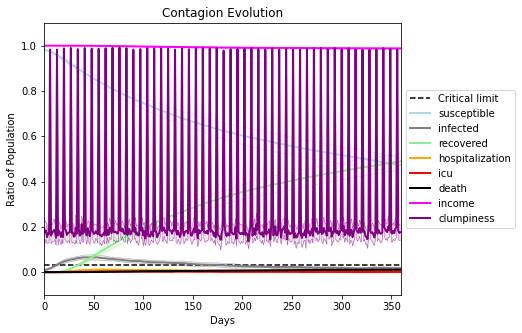

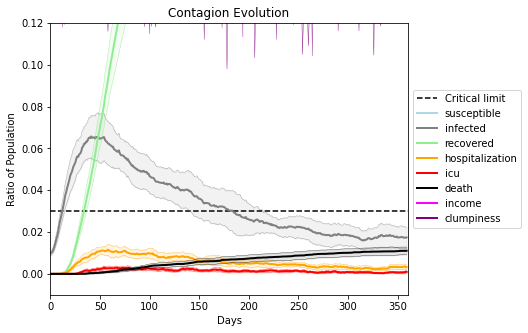

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7054, 7891, 7619, 5737, 1291, 2261, 2053, 4752, 1697, 4454, 7393, 4610, 1237, 4209, 5150, 1551, 6954, 7630, 9054, 6138]
Average similarity between family members is 0.9724399831840799 at temperature -0.999
Average similarity between family and home is 0.999861801179134 at temperature -1
Average similarity between students and their classroom is 0.7401749509273556 at temperature -0.999
Average classroom occupancy is 4.402985074626866 and number classrooms is 67
Average similarity between workers is 0.9569806025215291 at temperature -0.999
Average office occupancy is 3.631284916201117 and number offices is 179
Average friend similarity for adults: 0.8558800992385204 for kids: 0.7250318401185245
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.6640419001535657
avg restaurant similarity 0.642443056292179
avg restaurant similarity 0.6943525447795431
avg restaurant similarity 0.6672750014505644
avg restaurant similarity 0.6259147636173783
avg restaurant similarity 0.6318136792777665
avg restaurant similarity 0.6749899387176244
avg restaurant similarity 0.6280291803484765
avg restaurant similarity 0.6515672159306168
avg restaurant similarity 0.619863572308384
avg restaurant similarity 0.651158379166089
avg restaurant similarity 0.6254927492158463
avg restaurant similarity 0.6245040060217119
avg restaurant similarity 0.6525035633474654
avg restaurant similarity 0.6996362190666009
avg restaurant similarity 0.6316703502947422
avg restaurant similarity 0.6759886023660889
avg restaurant similarity 0.6584387000389214
avg restaurant similarity 0.6249099453420573
avg restaurant similarity 0.5977541460988196
avg restaurant similarity 0.6458396724389444
avg restaurant similarity 0.6718985759380603
avg restauran

avg restaurant similarity 0.6577736555426078
avg restaurant similarity 0.6966787397591687
avg restaurant similarity 0.6374588985663704
avg restaurant similarity 0.6060505040888605
avg restaurant similarity 0.649462423953472
avg restaurant similarity 0.5868672206396571
avg restaurant similarity 0.6831339907264099
avg restaurant similarity 0.6303974580251026
avg restaurant similarity 0.6363574400018848
avg restaurant similarity 0.6334140877113087
avg restaurant similarity 0.6486163224088638
avg restaurant similarity 0.6429213234773614
avg restaurant similarity 0.6865533968474199
avg restaurant similarity 0.63880230308342
avg restaurant similarity 0.6147981146284698
avg restaurant similarity 0.6750422265653419
avg restaurant similarity 0.6446973214803504
avg restaurant similarity 0.6783693256214125
avg restaurant similarity 0.7565202954190164
avg restaurant similarity 0.6627861579741119
avg restaurant similarity 0.6837686204622473
avg restaurant similarity 0.6717535313228471
avg restauran

avg restaurant similarity 0.665676126818941
avg restaurant similarity 0.6729983372019562
avg restaurant similarity 0.670014434062355
avg restaurant similarity 0.6522907378732348
avg restaurant similarity 0.6829010954901679
avg restaurant similarity 0.6330763642062159
avg restaurant similarity 0.684280379760325
avg restaurant similarity 0.6681434115446572
avg restaurant similarity 0.68994349949557
avg restaurant similarity 0.7294969307273392
avg restaurant similarity 0.7051113761398814
avg restaurant similarity 0.7024642491635966
avg restaurant similarity 0.6812672788415293
avg restaurant similarity 0.7050469769122817
avg restaurant similarity 0.6465134706895571
avg restaurant similarity 0.680287486568889
avg restaurant similarity 0.6796756971173527
avg restaurant similarity 0.6553517948771009
avg restaurant similarity 0.6810355601834005
avg restaurant similarity 0.6983831726076688
avg restaurant similarity 0.6922079576395893
avg restaurant similarity 0.6517679727683734
avg restaurant s

avg restaurant similarity 0.65579311961846
avg restaurant similarity 0.6896680240049837
avg restaurant similarity 0.7173416454758023
avg restaurant similarity 0.6511233471974638
avg restaurant similarity 0.67797288527621
avg restaurant similarity 0.6919472127270357
avg restaurant similarity 0.6762186936107026
avg restaurant similarity 0.7084583196470348
avg restaurant similarity 0.6852005386317375
avg restaurant similarity 0.7138357579879968
avg restaurant similarity 0.6902963433116251
avg restaurant similarity 0.6921573476749886
avg restaurant similarity 0.6845721837249482
avg restaurant similarity 0.6961301493130363
avg restaurant similarity 0.7145903043454377
avg restaurant similarity 0.6647526362232464
avg restaurant similarity 0.6869135333302683
avg restaurant similarity 0.6638905322136709
avg restaurant similarity 0.7149591634661508
avg restaurant similarity 0.6871434681921099
avg restaurant similarity 0.6789834184041195
avg restaurant similarity 0.6729388956619184
avg restaurant

avg restaurant similarity 0.6483650387421522
avg restaurant similarity 0.7132650453765252
avg restaurant similarity 0.6688410991619371
avg restaurant similarity 0.6587319914288399
avg restaurant similarity 0.649285736714262
avg restaurant similarity 0.6179754128083539
avg restaurant similarity 0.6235704972877743
avg restaurant similarity 0.7121864547518524
avg restaurant similarity 0.6978218256000468
avg restaurant similarity 0.6852434467037463
avg restaurant similarity 0.6952638282602459
avg restaurant similarity 0.6744310350886598
avg restaurant similarity 0.6385195772538789
avg restaurant similarity 0.6973236504193602
avg restaurant similarity 0.6484849190832503
avg restaurant similarity 0.744829737138093
avg restaurant similarity 0.6769636980972296
avg restaurant similarity 0.6641112835705276
avg restaurant similarity 0.6515813350107504
avg restaurant similarity 0.7191157177720013
avg restaurant similarity 0.7074116734030238
avg restaurant similarity 0.6581686242221311
avg restaura

avg restaurant similarity 0.7153661068958558
avg restaurant similarity 0.6669282483268528
avg restaurant similarity 0.6682483214851476
avg restaurant similarity 0.6151371880499815
avg restaurant similarity 0.7318472219398133
avg restaurant similarity 0.6516108577869133
avg restaurant similarity 0.6711466170374082
avg restaurant similarity 0.7042176910015565
avg restaurant similarity 0.6533525453317058
avg restaurant similarity 0.6394867386781137
avg restaurant similarity 0.6587675077842966
avg restaurant similarity 0.694235419418341
avg restaurant similarity 0.6842406651749294
avg restaurant similarity 0.78368080441989
avg restaurant similarity 0.6663722832431462
avg restaurant similarity 0.6515646951692787
avg restaurant similarity 0.6314648982349851
avg restaurant similarity 0.7105437540817346
avg restaurant similarity 0.7195239230278982
avg restaurant similarity 0.6105373959929931
avg restaurant similarity 0.7004121502358064
avg restaurant similarity 0.7496907309855225
avg restauran

avg restaurant similarity 0.6790624870593693
avg restaurant similarity 0.6584663286958584
avg restaurant similarity 0.6590738336622182
avg restaurant similarity 0.7047533457227677
avg restaurant similarity 0.6831136612379597
avg restaurant similarity 0.7106782690675562
avg restaurant similarity 0.684239825267191
avg restaurant similarity 0.7043476778882382
avg restaurant similarity 0.6837958347680854
avg restaurant similarity 0.6928954140910799
avg restaurant similarity 0.7300664470335528
avg restaurant similarity 0.6645294071619109
avg restaurant similarity 0.6527138882091282
avg restaurant similarity 0.6634430313607406
avg restaurant similarity 0.6966680922448384
avg restaurant similarity 0.6867749241273602
avg restaurant similarity 0.6580105752893605
avg restaurant similarity 0.6538590920696475
avg restaurant similarity 0.6964983376213636
avg restaurant similarity 0.6982598703134816
avg restaurant similarity 0.7229587469110206
avg restaurant similarity 0.6368029202806569
avg restaur

avg restaurant similarity 0.6832333347511512
avg restaurant similarity 0.7203817880610985
avg restaurant similarity 0.679906180612104
avg restaurant similarity 0.6810853126894212
avg restaurant similarity 0.681891316359975
avg restaurant similarity 0.7197453935082345
avg restaurant similarity 0.7008233012908653
avg restaurant similarity 0.7290465121079385
avg restaurant similarity 0.6471745326698424
avg restaurant similarity 0.6318587318358376
avg restaurant similarity 0.7506370399585462
avg restaurant similarity 0.6478722699768251
avg restaurant similarity 0.700452391734381
avg restaurant similarity 0.6762287276061947
avg restaurant similarity 0.6980863115083796
avg restaurant similarity 0.6749132304733073
avg restaurant similarity 0.6651934131714765
avg restaurant similarity 0.6649935167206624
avg restaurant similarity 0.6846496324047612
avg restaurant similarity 0.7158327023558708
avg restaurant similarity 0.7073921647306223
avg restaurant similarity 0.669233293549928
avg restaurant

avg restaurant similarity 0.7121178489647084
avg restaurant similarity 0.7099549398153476
avg restaurant similarity 0.6842998149080229
avg restaurant similarity 0.6888216260999258
avg restaurant similarity 0.7161292832551199
avg restaurant similarity 0.6757910861710947
avg restaurant similarity 0.7328434752859588
avg restaurant similarity 0.7264187225331796
avg restaurant similarity 0.6967122337490459
avg restaurant similarity 0.7088322213001047
avg restaurant similarity 0.7105778312064267
avg restaurant similarity 0.6864465568031884
avg restaurant similarity 0.7027790606587351
avg restaurant similarity 0.7299276130164135
avg restaurant similarity 0.668149134565888
avg restaurant similarity 0.6766190142609866
avg restaurant similarity 0.7071616291567694
avg restaurant similarity 0.6982189841647474
avg restaurant similarity 0.6996503047296007
avg restaurant similarity 0.6752186774924746
avg restaurant similarity 0.6977692859533827
avg restaurant similarity 0.64349192873172
avg restauran

avg restaurant similarity 0.7190015803362608
avg restaurant similarity 0.713014295289502
avg restaurant similarity 0.7000027192718772
avg restaurant similarity 0.6741624876631009
avg restaurant similarity 0.6950286224347156
avg restaurant similarity 0.6906814906582757
avg restaurant similarity 0.7062309206157833
avg restaurant similarity 0.6763721060622373
avg restaurant similarity 0.6968745837801251
avg restaurant similarity 0.6867734483405585
avg restaurant similarity 0.6922910658843927
avg restaurant similarity 0.695804146639926
avg restaurant similarity 0.6966524719014285
avg restaurant similarity 0.693471952501965
avg restaurant similarity 0.6819311911002907
avg restaurant similarity 0.6644591426989677
avg restaurant similarity 0.7018392023425
avg restaurant similarity 0.7291254012961119
avg restaurant similarity 0.7004127909132397
avg restaurant similarity 0.6804627851874544
avg restaurant similarity 0.7050562749056088
avg restaurant similarity 0.6931478954636459
avg restaurant s

avg restaurant similarity 0.6662967667850179
avg restaurant similarity 0.6687470362880837
avg restaurant similarity 0.6368745660577406
avg restaurant similarity 0.6797753295540144
avg restaurant similarity 0.6125911516452308
avg restaurant similarity 0.6618869093969577
avg restaurant similarity 0.6521862386587276
avg restaurant similarity 0.6675947304121116
avg restaurant similarity 0.7255758905831353
avg restaurant similarity 0.6681331831806107
avg restaurant similarity 0.6704553078711618
avg restaurant similarity 0.6782625527480634
avg restaurant similarity 0.6804370188281653
avg restaurant similarity 0.6523917558969881
avg restaurant similarity 0.6762541199283979
avg restaurant similarity 0.7054329803885844
avg restaurant similarity 0.7154117797339011
avg restaurant similarity 0.6285623006916988
avg restaurant similarity 0.6398319501448746
avg restaurant similarity 0.6815837345699232
avg restaurant similarity 0.6156580072904123
avg restaurant similarity 0.6002567997279981
avg restau

avg restaurant similarity 0.614442036055163
avg restaurant similarity 0.687891387144253
avg restaurant similarity 0.6783220486091426
avg restaurant similarity 0.7154173997384073
avg restaurant similarity 0.6487100913903943
avg restaurant similarity 0.6514479716811937
avg restaurant similarity 0.6741761731791425
avg restaurant similarity 0.7191966852034454
avg restaurant similarity 0.6584155539540181
avg restaurant similarity 0.6398887421472719
avg restaurant similarity 0.6936692263236224
avg restaurant similarity 0.6524208226584954
avg restaurant similarity 0.6333393564837786
avg restaurant similarity 0.7262214163813547
avg restaurant similarity 0.624050037625356
avg restaurant similarity 0.6344734485421607
avg restaurant similarity 0.6864349814719967
avg restaurant similarity 0.6782264623343304
avg restaurant similarity 0.6456104361088668
avg restaurant similarity 0.6526109030781526
avg restaurant similarity 0.6455274142281813
avg restaurant similarity 0.6306950908823417
avg restauran

avg restaurant similarity 0.6962435891485133
avg restaurant similarity 0.688968974193423
avg restaurant similarity 0.6629685030482598
avg restaurant similarity 0.6687618379310196
avg restaurant similarity 0.7251477319601679
avg restaurant similarity 0.6761232367453631
avg restaurant similarity 0.6485122375919044
avg restaurant similarity 0.743880762726826
avg restaurant similarity 0.6616160010622391
avg restaurant similarity 0.7424101403685711
avg restaurant similarity 0.6357307268615527
avg restaurant similarity 0.6653323697681996
avg restaurant similarity 0.7442563819059373
avg restaurant similarity 0.6404103287551576
avg restaurant similarity 0.7041744373334735
avg restaurant similarity 0.6771327758794642
avg restaurant similarity 0.7193890107227163
avg restaurant similarity 0.7311015741296811
avg restaurant similarity 0.7246252302498658
avg restaurant similarity 0.6982774527523457
avg restaurant similarity 0.6848102424283475
avg restaurant similarity 0.7204377464715723
avg restaura

avg restaurant similarity 0.7176031457933675
avg restaurant similarity 0.7159801601887142
avg restaurant similarity 0.6600080600065095
avg restaurant similarity 0.7462194819834683
avg restaurant similarity 0.6885321770817447
avg restaurant similarity 0.7218612882398853
avg restaurant similarity 0.6362749835181881
avg restaurant similarity 0.6612304036578862
avg restaurant similarity 0.7630686016586945
avg restaurant similarity 0.7378028366516137
avg restaurant similarity 0.7531255382762484
avg restaurant similarity 0.688064777152085
avg restaurant similarity 0.6887118328261016
avg restaurant similarity 0.6973304080256322
avg restaurant similarity 0.7060738870315373
avg restaurant similarity 0.7006460825087715
avg restaurant similarity 0.6809443503183166
avg restaurant similarity 0.7155874179373496
avg restaurant similarity 0.6780583082465703
avg restaurant similarity 0.7343146422080493
avg restaurant similarity 0.7075456647797111
avg restaurant similarity 0.6909346086770152
avg restaur

avg restaurant similarity 0.7027599217178606
avg restaurant similarity 0.6478986274149867
avg restaurant similarity 0.6726293447661111
avg restaurant similarity 0.7101980876243363
avg restaurant similarity 0.6406301258090853
avg restaurant similarity 0.6703020076268887
avg restaurant similarity 0.7024707386840647
avg restaurant similarity 0.5760224246799216
avg restaurant similarity 0.6498445758868857
avg restaurant similarity 0.6632003557437958
avg restaurant similarity 0.6806426617488366
avg restaurant similarity 0.5735133041883388
avg restaurant similarity 0.6446849208242892
avg restaurant similarity 0.6399896837832081
avg restaurant similarity 0.6238950425206473
avg restaurant similarity 0.6939657932082424
avg restaurant similarity 0.5827178348163216
avg restaurant similarity 0.6776097621955077
avg restaurant similarity 0.6969685626677891
avg restaurant similarity 0.675412522149804
avg restaurant similarity 0.6681421066257963
avg restaurant similarity 0.6556146462846448
avg restaur

avg restaurant similarity 0.6528157118478926
avg restaurant similarity 0.679635115384287
avg restaurant similarity 0.5817246778707262
avg restaurant similarity 0.6015004235038138
avg restaurant similarity 0.6510204644253168
avg restaurant similarity 0.6130194224475694
avg restaurant similarity 0.6962101865071834
avg restaurant similarity 0.6366369053742079
avg restaurant similarity 0.71702603937783
avg restaurant similarity 0.665828271598477
avg restaurant similarity 0.651033633676026
avg restaurant similarity 0.6670932577446863
avg restaurant similarity 0.620336063140942
avg restaurant similarity 0.668706751590784
avg restaurant similarity 0.664345793478549
avg restaurant similarity 0.6894103205910853
avg restaurant similarity 0.6988804239382838
avg restaurant similarity 0.612888125843128
avg restaurant similarity 0.6464566469355276
avg restaurant similarity 0.6623178618776159
avg restaurant similarity 0.6421243616700452
avg restaurant similarity 0.6385962820515976
avg restaurant simi

avg restaurant similarity 0.6681137381261207
avg restaurant similarity 0.6705839116887081
avg restaurant similarity 0.6908552156420447
avg restaurant similarity 0.6241772093136223
avg restaurant similarity 0.613537935237038
avg restaurant similarity 0.6987203020648426
avg restaurant similarity 0.7252406876572777
avg restaurant similarity 0.6128521821675339
avg restaurant similarity 0.6126464044293213
avg restaurant similarity 0.6843342641973181
avg restaurant similarity 0.6530773437760194
avg restaurant similarity 0.6767354621805548
avg restaurant similarity 0.6494514760237976
avg restaurant similarity 0.6357098256396955
avg restaurant similarity 0.620071857722777
avg restaurant similarity 0.7174022855113343
avg restaurant similarity 0.6842042428629795
avg restaurant similarity 0.6696973559579209
avg restaurant similarity 0.6405079374985493
avg restaurant similarity 0.59641680729482
avg restaurant similarity 0.6774832096132742
avg restaurant similarity 0.6707811389872022
avg restaurant

avg restaurant similarity 0.5821468603374785
avg restaurant similarity 0.6751007284237227
avg restaurant similarity 0.6665396675628984
avg restaurant similarity 0.6613465884961497
avg restaurant similarity 0.6428114623043332
avg restaurant similarity 0.6678068462169723
avg restaurant similarity 0.6070605722923289
avg restaurant similarity 0.6421728228135601
avg restaurant similarity 0.6381138973496567
avg restaurant similarity 0.6412642478980344
avg restaurant similarity 0.6698778514331724
avg restaurant similarity 0.6476255421045906
avg restaurant similarity 0.6768091385698739
avg restaurant similarity 0.6608089648723323
avg restaurant similarity 0.6832095582675901
avg restaurant similarity 0.671242498993791
avg restaurant similarity 0.6637898527553304
avg restaurant similarity 0.6618365957129092
avg restaurant similarity 0.6677476071244467
avg restaurant similarity 0.6229398729574255
avg restaurant similarity 0.7283377084916459
avg restaurant similarity 0.635367054133962
avg restaura

avg restaurant similarity 0.7022815789480914
avg restaurant similarity 0.6524471684882628
avg restaurant similarity 0.7024555570814829
avg restaurant similarity 0.6431770889269325
avg restaurant similarity 0.6530435538945223
avg restaurant similarity 0.6334518429306341
avg restaurant similarity 0.6641674725510104
avg restaurant similarity 0.6675432009249122
avg restaurant similarity 0.658033483801584
avg restaurant similarity 0.6441261026040956
avg restaurant similarity 0.6414679090870589
avg restaurant similarity 0.7109120503724476
avg restaurant similarity 0.7116542561871632
avg restaurant similarity 0.650537724861693
avg restaurant similarity 0.6806920477078237
avg restaurant similarity 0.6628372592156251
avg restaurant similarity 0.6380539828406199
avg restaurant similarity 0.6592106152968672
avg restaurant similarity 0.6510181863729183
avg restaurant similarity 0.6246971088339403
avg restaurant similarity 0.6151522437564855
avg restaurant similarity 0.6549407126841104
avg restaura

avg restaurant similarity 0.6792847270136624
avg restaurant similarity 0.7162718138008708
avg restaurant similarity 0.6714623336284656
avg restaurant similarity 0.6490445238702881
avg restaurant similarity 0.6484378431315733
avg restaurant similarity 0.6378472673277426
avg restaurant similarity 0.6538502906407957
avg restaurant similarity 0.6080628687066326
avg restaurant similarity 0.6834511835316422
avg restaurant similarity 0.628594603352958
avg restaurant similarity 0.659541953051098
avg restaurant similarity 0.6729677544219933
avg restaurant similarity 0.6818028307571903
avg restaurant similarity 0.6565951315886445
avg restaurant similarity 0.6574137319482949
avg restaurant similarity 0.6559883040568579
avg restaurant similarity 0.6837922667799867
avg restaurant similarity 0.700547814742104
avg restaurant similarity 0.6447747312161463
avg restaurant similarity 0.6912964505165827
avg restaurant similarity 0.6729906486789062
avg restaurant similarity 0.6493214466122365
avg restauran

avg restaurant similarity 0.6888626457482864
avg restaurant similarity 0.6970034598223572
avg restaurant similarity 0.712566097597337
avg restaurant similarity 0.7512084799369301
avg restaurant similarity 0.6862023827897892
avg restaurant similarity 0.6886591085101658
avg restaurant similarity 0.7118174352483385
avg restaurant similarity 0.6872637040101155
avg restaurant similarity 0.685643511134427
avg restaurant similarity 0.6949805617740262
avg restaurant similarity 0.7146207450194909
avg restaurant similarity 0.7274869395793608
avg restaurant similarity 0.6657381591739316
avg restaurant similarity 0.7495482033562187
avg restaurant similarity 0.6717696349690103
avg restaurant similarity 0.6796008596506702
avg restaurant similarity 0.7599407981524267
avg restaurant similarity 0.7271314183337726
avg restaurant similarity 0.7073951674421725
avg restaurant similarity 0.6816422876197519
avg restaurant similarity 0.6892074634701555
avg restaurant similarity 0.6931198158140605
avg restaura

avg restaurant similarity 0.7402361766256242
avg restaurant similarity 0.6740897716768044
avg restaurant similarity 0.6960661713058257
avg restaurant similarity 0.7266189841542414
avg restaurant similarity 0.7283242741527213
avg restaurant similarity 0.7108634662265706
avg restaurant similarity 0.7137222392084972
avg restaurant similarity 0.658968347915525
avg restaurant similarity 0.7123394699285217
avg restaurant similarity 0.711141027691634
avg restaurant similarity 0.7062873473677518
avg restaurant similarity 0.7509459090666994
avg restaurant similarity 0.685431523821008
avg restaurant similarity 0.7343085593389558
avg restaurant similarity 0.7016543077157759
avg restaurant similarity 0.7118872142292878
avg restaurant similarity 0.7203578091594541
avg restaurant similarity 0.726942523919432
avg restaurant similarity 0.6770073516861673
avg restaurant similarity 0.6874061601934331
avg restaurant similarity 0.7034348589627764
avg restaurant similarity 0.7138392788455946
avg restaurant

avg restaurant similarity 0.669965767104675
avg restaurant similarity 0.6299279886093975
avg restaurant similarity 0.612718482974325
avg restaurant similarity 0.6288336475664895
avg restaurant similarity 0.6676868401237531
avg restaurant similarity 0.6313364123903308
avg restaurant similarity 0.6831850066176661
avg restaurant similarity 0.6709589337553472
avg restaurant similarity 0.651231066450049
avg restaurant similarity 0.6499186301222921
avg restaurant similarity 0.6475674953040463
avg restaurant similarity 0.6779859173320957
avg restaurant similarity 0.6508951610628704
avg restaurant similarity 0.6005927676773996
avg restaurant similarity 0.6490951005804799
avg restaurant similarity 0.6431278565382865
avg restaurant similarity 0.6353968172004901
avg restaurant similarity 0.637286694867343
avg restaurant similarity 0.6330106985965159
avg restaurant similarity 0.6250098163081044
avg restaurant similarity 0.681685034694226
avg restaurant similarity 0.6435049087858591
avg restaurant 

avg restaurant similarity 0.6616853834035858
avg restaurant similarity 0.6442540904323167
avg restaurant similarity 0.666542583740369
avg restaurant similarity 0.6535007124935253
avg restaurant similarity 0.6375114886934932
avg restaurant similarity 0.6473371656218665
avg restaurant similarity 0.7178250964582429
avg restaurant similarity 0.5733922419176227
avg restaurant similarity 0.6013531808547343
avg restaurant similarity 0.6540724608442198
avg restaurant similarity 0.6324856410258027
avg restaurant similarity 0.6251004381639133
avg restaurant similarity 0.6194496955478761
avg restaurant similarity 0.5944057591896961
avg restaurant similarity 0.6707322158936933
avg restaurant similarity 0.6601614764236007
avg restaurant similarity 0.6507661619618352
avg restaurant similarity 0.7186561534314052
avg restaurant similarity 0.6653233489610275
avg restaurant similarity 0.6370438926024112
avg restaurant similarity 0.6452471882612028
avg restaurant similarity 0.6383148311022285
avg restaur

avg restaurant similarity 0.637806676212977
avg restaurant similarity 0.6996665293458819
avg restaurant similarity 0.6216468284764339
avg restaurant similarity 0.701022313864362
avg restaurant similarity 0.6650555170431738
avg restaurant similarity 0.7046912641173139
avg restaurant similarity 0.6903504296159199
avg restaurant similarity 0.711852859939753
avg restaurant similarity 0.6609126450311383
avg restaurant similarity 0.6531634576268852
avg restaurant similarity 0.6356728806028475
avg restaurant similarity 0.6336860029165396
avg restaurant similarity 0.7266894955498846
avg restaurant similarity 0.7107065686955147
avg restaurant similarity 0.6556820769682802
avg restaurant similarity 0.6488690783091429
avg restaurant similarity 0.7001189571937753
avg restaurant similarity 0.7086203247229108
avg restaurant similarity 0.6815941893107232
avg restaurant similarity 0.6621618061947504
avg restaurant similarity 0.6874567386273089
avg restaurant similarity 0.6381585505717388
avg restauran

avg restaurant similarity 0.6560401394935734
avg restaurant similarity 0.6578110160552882
avg restaurant similarity 0.6731316934713477
avg restaurant similarity 0.6964799481684374
avg restaurant similarity 0.6783789213648523
avg restaurant similarity 0.6463220999222815
avg restaurant similarity 0.6705173160659643
avg restaurant similarity 0.648975452367717
avg restaurant similarity 0.6433090087420965
avg restaurant similarity 0.6647498137504105
avg restaurant similarity 0.6741687289444263
avg restaurant similarity 0.637242860715569
avg restaurant similarity 0.6356061150414564
avg restaurant similarity 0.6540564146349915
avg restaurant similarity 0.6553324854290219
avg restaurant similarity 0.6773344426046204
avg restaurant similarity 0.6690641239894489
avg restaurant similarity 0.6008861285779785
avg restaurant similarity 0.66230299198239
avg restaurant similarity 0.6683514995539988
avg restaurant similarity 0.7234938087639334
avg restaurant similarity 0.6713500715013664
avg restaurant

avg restaurant similarity 0.713423436209897
avg restaurant similarity 0.6537952825033807
avg restaurant similarity 0.6681110111181451
avg restaurant similarity 0.6921143683353527
avg restaurant similarity 0.6513949472703287
avg restaurant similarity 0.689184758982793
avg restaurant similarity 0.6530619310907554
avg restaurant similarity 0.6287910962449216
avg restaurant similarity 0.6493646429580209
avg restaurant similarity 0.6662760671368755
avg restaurant similarity 0.6319055351475288
avg restaurant similarity 0.6782972043251797
avg restaurant similarity 0.5964472852286311
avg restaurant similarity 0.6630555649163832
avg restaurant similarity 0.5742718302788231
avg restaurant similarity 0.6681525600634421
avg restaurant similarity 0.721103317131697
avg restaurant similarity 0.6069745845185742
avg restaurant similarity 0.6117528087946543
avg restaurant similarity 0.6666074072323024
avg restaurant similarity 0.6166055058843646
avg restaurant similarity 0.628222180907717
avg restaurant

avg restaurant similarity 0.6363013686499049
avg restaurant similarity 0.7334803640811238
avg restaurant similarity 0.5987034263304105
avg restaurant similarity 0.6910449191851016
avg restaurant similarity 0.6270364893148704
avg restaurant similarity 0.6397198716555964
avg restaurant similarity 0.7182670145086141
avg restaurant similarity 0.7003447161686258
avg restaurant similarity 0.6638695029817779
avg restaurant similarity 0.7181020364705789
avg restaurant similarity 0.6477248542208872
avg restaurant similarity 0.6369789135616254
avg restaurant similarity 0.6646125871858858
avg restaurant similarity 0.6583365176439312
avg restaurant similarity 0.6706335467639368
avg restaurant similarity 0.643925595448625
avg restaurant similarity 0.6744093899575245
avg restaurant similarity 0.6678933877302433
avg restaurant similarity 0.687194755583802
avg restaurant similarity 0.6702967086463021
avg restaurant similarity 0.6830814447570304
avg restaurant similarity 0.6650958085860382
avg restaura

avg restaurant similarity 0.6436795179797011
avg restaurant similarity 0.5426604722140036
avg restaurant similarity 0.5739637180183621
avg restaurant similarity 0.5780953495504635
avg restaurant similarity 0.5599831729881427
avg restaurant similarity 0.5542549045520055
avg restaurant similarity 0.58628765108764
avg restaurant similarity 0.6381878374426231
avg restaurant similarity 0.6513978990211285
avg restaurant similarity 0.6232925203510032
avg restaurant similarity 0.5659122970155811
avg restaurant similarity 0.5913865218740794
avg restaurant similarity 0.5851053229718072
avg restaurant similarity 0.6351908621209368
avg restaurant similarity 0.6145555209493708
avg restaurant similarity 0.6114604351643607
avg restaurant similarity 0.5955247025461203
avg restaurant similarity 0.5579660227483476
avg restaurant similarity 0.6162337642239302
avg restaurant similarity 0.5860165930375878
avg restaurant similarity 0.6016514669085116
avg restaurant similarity 0.6388081047618768
avg restaura

avg restaurant similarity 0.5819151828748035
avg restaurant similarity 0.5688006846773751
avg restaurant similarity 0.6050279272773089
avg restaurant similarity 0.5992312845101704
avg restaurant similarity 0.6282689189484542
avg restaurant similarity 0.5708260697295715
avg restaurant similarity 0.6084472399869433
avg restaurant similarity 0.5977840695813293
avg restaurant similarity 0.5995233161898387
avg restaurant similarity 0.5522426965773338
avg restaurant similarity 0.5719811021118353
avg restaurant similarity 0.6036908436639687
avg restaurant similarity 0.5316502735785242
avg restaurant similarity 0.5498165547257174
avg restaurant similarity 0.5413266815174385
avg restaurant similarity 0.6012567428259225
avg restaurant similarity 0.5767807769785558
avg restaurant similarity 0.5642908532005002
avg restaurant similarity 0.5920365986469169
avg restaurant similarity 0.615285873348159
avg restaurant similarity 0.6171001517074243
avg restaurant similarity 0.6230329292097571
avg restaur

avg restaurant similarity 0.6416396330405846
avg restaurant similarity 0.6398924068921659
avg restaurant similarity 0.6390095303415405
avg restaurant similarity 0.6294335612816421
avg restaurant similarity 0.6349282917208225
avg restaurant similarity 0.6678735904693668
avg restaurant similarity 0.6232415240664099
avg restaurant similarity 0.6203354565892389
avg restaurant similarity 0.6284481941892909
avg restaurant similarity 0.6213326156133642
avg restaurant similarity 0.6253958949600057
avg restaurant similarity 0.6358127603430267
avg restaurant similarity 0.6631045778573829
avg restaurant similarity 0.6417617379201322
avg restaurant similarity 0.6493392590244103
avg restaurant similarity 0.6554131944968699
avg restaurant similarity 0.6200945846933676
avg restaurant similarity 0.6225183563847316
avg restaurant similarity 0.5950619922611395
avg restaurant similarity 0.5965149049865921
avg restaurant similarity 0.6504748555982695
avg restaurant similarity 0.6079926820607506
avg restau

avg restaurant similarity 0.6775764412029859
avg restaurant similarity 0.6173333442523569
avg restaurant similarity 0.6447988639503636
avg restaurant similarity 0.6176078706823901
avg restaurant similarity 0.5956349880991332
avg restaurant similarity 0.629495918423547
avg restaurant similarity 0.6291967585570238
avg restaurant similarity 0.6437102073650378
avg restaurant similarity 0.6552264409642061
avg restaurant similarity 0.61883349535989
avg restaurant similarity 0.6096611575364818
avg restaurant similarity 0.6384857269541447
avg restaurant similarity 0.6350374683467394
avg restaurant similarity 0.6602164757195745
avg restaurant similarity 0.6519777750772497
avg restaurant similarity 0.617930854091059
avg restaurant similarity 0.6506781611019928
avg restaurant similarity 0.6007055853710498
avg restaurant similarity 0.6197075006224608
avg restaurant similarity 0.6247255758341473
avg restaurant similarity 0.629925883191592
avg restaurant similarity 0.6485752390192485
avg restaurant 

avg restaurant similarity 0.6585178922607904
avg restaurant similarity 0.5901607217540527
avg restaurant similarity 0.7167661880576873
avg restaurant similarity 0.6776298091439412
avg restaurant similarity 0.6727280214802681
avg restaurant similarity 0.6949233687639707
avg restaurant similarity 0.657880893976971
avg restaurant similarity 0.6921810196436945
avg restaurant similarity 0.6799099389446461
avg restaurant similarity 0.6464325020464643
avg restaurant similarity 0.6147311433729259
avg restaurant similarity 0.6557557375338938
avg restaurant similarity 0.6990198680536945
avg restaurant similarity 0.6199235795524903
avg restaurant similarity 0.6651032797066665
avg restaurant similarity 0.6546209483306268
avg restaurant similarity 0.6877541258380586
avg restaurant similarity 0.689330056333305
avg restaurant similarity 0.6633429642634203
avg restaurant similarity 0.6617962876069892
avg restaurant similarity 0.6169194996936032
avg restaurant similarity 0.6283771832524009
avg restaura

avg restaurant similarity 0.6501855027479072
avg restaurant similarity 0.6747730566056037
avg restaurant similarity 0.608980568692981
avg restaurant similarity 0.6204941781970603
avg restaurant similarity 0.6235228849851139
avg restaurant similarity 0.6026910707917547
avg restaurant similarity 0.6326891163774766
avg restaurant similarity 0.6524325888525293
avg restaurant similarity 0.675708738566084
avg restaurant similarity 0.6387278497049353
avg restaurant similarity 0.6277129080773025
avg restaurant similarity 0.6719669996110362
avg restaurant similarity 0.6597555762414568
avg restaurant similarity 0.6207671439553748
avg restaurant similarity 0.6374422583645448
avg restaurant similarity 0.6194869061851285
avg restaurant similarity 0.6184408969429254
avg restaurant similarity 0.6697485339347307
avg restaurant similarity 0.6601416463952496
avg restaurant similarity 0.59703517897089
avg restaurant similarity 0.664282122342546
avg restaurant similarity 0.6161991470821496
avg restaurant 

avg restaurant similarity 0.6770622795512456
avg restaurant similarity 0.6950265366516122
avg restaurant similarity 0.66639795335942
avg restaurant similarity 0.6502339052087398
avg restaurant similarity 0.6404219059333198
avg restaurant similarity 0.673882636448227
avg restaurant similarity 0.6437531239544941
avg restaurant similarity 0.6420681287062319
avg restaurant similarity 0.6792833996371354
avg restaurant similarity 0.6526170367346739
avg restaurant similarity 0.6753958825929897
avg restaurant similarity 0.6503801809028629
avg restaurant similarity 0.6455693555004861
avg restaurant similarity 0.6433162120576661
avg restaurant similarity 0.6536394369966542
avg restaurant similarity 0.6215123140492784
avg restaurant similarity 0.6815810763270913
avg restaurant similarity 0.6179461112340416
avg restaurant similarity 0.5956701884632866
avg restaurant similarity 0.6955123741117388
avg restaurant similarity 0.662471552346975
avg restaurant similarity 0.6477883637860612
avg restaurant

avg restaurant similarity 0.6212869149070365
avg restaurant similarity 0.6460405372741717
avg restaurant similarity 0.6976955073503187
avg restaurant similarity 0.696255667559065
avg restaurant similarity 0.6090632027812596
avg restaurant similarity 0.6386069682588043
avg restaurant similarity 0.6375946012176826
avg restaurant similarity 0.6398068207101065
avg restaurant similarity 0.6752950915301684
avg restaurant similarity 0.6890000901353263
avg restaurant similarity 0.6636781481625372
avg restaurant similarity 0.6522267038539612
avg restaurant similarity 0.6580730882654523
avg restaurant similarity 0.5693613499017579
avg restaurant similarity 0.686466127458946
avg restaurant similarity 0.6184289452075159
avg restaurant similarity 0.6332676551804022
avg restaurant similarity 0.7046842855919013
avg restaurant similarity 0.6856476809163746
avg restaurant similarity 0.645460695154082
avg restaurant similarity 0.6099720736604625
avg restaurant similarity 0.6825459412222736
avg restauran

avg restaurant similarity 0.6842684766876582
avg restaurant similarity 0.6795515411953175
avg restaurant similarity 0.6022653884340021
avg restaurant similarity 0.693820643881406
avg restaurant similarity 0.6367241462728394
avg restaurant similarity 0.5814595045942202
avg restaurant similarity 0.5784276669244574
avg restaurant similarity 0.6791640994767715
avg restaurant similarity 0.6175410850924011
avg restaurant similarity 0.6628658301380531
avg restaurant similarity 0.6076164909993482
avg restaurant similarity 0.6380548404398805
avg restaurant similarity 0.6276083877183202
avg restaurant similarity 0.7128776378684424
avg restaurant similarity 0.6314125106764329
avg restaurant similarity 0.668568036457034
avg restaurant similarity 0.5951386156619796
avg restaurant similarity 0.650768499299409
avg restaurant similarity 0.7055882994936921
avg restaurant similarity 0.6556276305990851
avg restaurant similarity 0.6181332653914665
avg restaurant similarity 0.5981080408302037
avg restauran

avg restaurant similarity 0.6270992633962869
avg restaurant similarity 0.6660163378250412
avg restaurant similarity 0.6394179553392674
avg restaurant similarity 0.6644691808390288
avg restaurant similarity 0.6791399163442446
avg restaurant similarity 0.639072040556334
avg restaurant similarity 0.6355024208047426
avg restaurant similarity 0.6831022061946307
avg restaurant similarity 0.6074620180117637
avg restaurant similarity 0.7321130817166773
avg restaurant similarity 0.6591281091922496
avg restaurant similarity 0.6552551377553665
avg restaurant similarity 0.6144716828925515
avg restaurant similarity 0.6440465348765416
avg restaurant similarity 0.6211242029363171
avg restaurant similarity 0.5963949200110856
avg restaurant similarity 0.6164550306937836
avg restaurant similarity 0.6853952221850416
avg restaurant similarity 0.6260094836719156
avg restaurant similarity 0.6142454998124401
avg restaurant similarity 0.6417367607782694
avg restaurant similarity 0.6362267388891659
avg restaur

avg restaurant similarity 0.6523973631717318
avg restaurant similarity 0.6023579089467893
avg restaurant similarity 0.6746811852275395
avg restaurant similarity 0.6835690304739812
avg restaurant similarity 0.6920880134545453
avg restaurant similarity 0.6261382718313957
avg restaurant similarity 0.71829619502247
avg restaurant similarity 0.6296443514900085
avg restaurant similarity 0.6903566831151954
avg restaurant similarity 0.6527941351163781
avg restaurant similarity 0.6672986284747631
avg restaurant similarity 0.6192279595986409
avg restaurant similarity 0.5961512612275501
avg restaurant similarity 0.640738889765837
avg restaurant similarity 0.6726586690009625
avg restaurant similarity 0.6666190870925683
avg restaurant similarity 0.626926471009758
avg restaurant similarity 0.66211096439645
avg restaurant similarity 0.632031040619503
avg restaurant similarity 0.6356541922177957
avg restaurant similarity 0.6456633364820901
avg restaurant similarity 0.6181522995003355
avg restaurant si

avg restaurant similarity 0.6490394337766753
avg restaurant similarity 0.6123103886325615
avg restaurant similarity 0.6139957123561905
avg restaurant similarity 0.6234078939268246
avg restaurant similarity 0.6427145928681451
avg restaurant similarity 0.6584621970145559
avg restaurant similarity 0.6576482719124431
avg restaurant similarity 0.6115438909679705
avg restaurant similarity 0.6582214200984126
avg restaurant similarity 0.6379074011183218
avg restaurant similarity 0.6202099594109336
avg restaurant similarity 0.6358493406376305
avg restaurant similarity 0.6376309049548468
avg restaurant similarity 0.5832084098384475
avg restaurant similarity 0.5970158389245351
avg restaurant similarity 0.6743094047379546
avg restaurant similarity 0.5982225470047879
avg restaurant similarity 0.6292549686125449
avg restaurant similarity 0.6160613622231038
avg restaurant similarity 0.6319196234575374
avg restaurant similarity 0.6449413071032255
avg restaurant similarity 0.6429828853514289
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

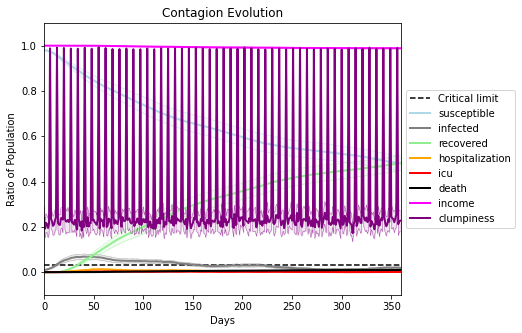

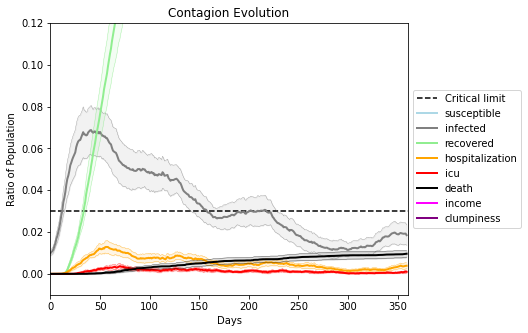

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7353, 444, 3484, 4625, 5518, 8580, 87, 598, 5406, 216, 3099, 1915, 2726, 6630, 6449, 4369, 6638, 6602, 1056, 9582]
Average similarity between family members is 0.9740524795005931 at temperature -0.998
Average similarity between family and home is 0.9998515266780456 at temperature -1
Average similarity between students and their classroom is 0.7324521865993372 at temperature -0.998
Average classroom occupancy is 4.647058823529412 and number classrooms is 68
Average similarity between workers is 0.9606783766607934 at temperature -0.998
Average office occupancy is 3.5166666666666666 and number offices is 180
Average friend similarity for adults: 0.8441642091564866 for kids: 0.7227101300285492
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.811175583338633
avg restaurant similarity 0.6815917544926502
avg restaurant similarity 0.7312195863406956
avg restaurant similarity 0.7180617890860476
avg restaurant similarity 0.7439398555554332
avg restaurant similarity 0.7229238391112427
avg restaurant similarity 0.7472915087348129
avg restaurant similarity 0.7257254813422379
avg restaurant similarity 0.7549509959297671
avg restaurant similarity 0.674630189096629
avg restaurant similarity 0.7076584491259188
avg restaurant similarity 0.6817514738969641
avg restaurant similarity 0.7054290850874502
avg restaurant similarity 0.7225593137658245
avg restaurant similarity 0.7193997337282015
avg restaurant similarity 0.677143875040206
avg restaurant similarity 0.7820046444387159
avg restaurant similarity 0.7397998909797279
avg restaurant similarity 0.7719184190586801
avg restaurant similarity 0.7293111506051165
avg restaurant similarity 0.7024030752694833
avg restaurant similarity 0.6233798398901523
avg restauran

avg restaurant similarity 0.700412448072461
avg restaurant similarity 0.6827733873928414
avg restaurant similarity 0.6132930228543358
avg restaurant similarity 0.676889702671185
avg restaurant similarity 0.7265303016584382
avg restaurant similarity 0.6674377820320626
avg restaurant similarity 0.7596498812454036
avg restaurant similarity 0.7243358918220775
avg restaurant similarity 0.7663207095484912
avg restaurant similarity 0.7246018028263138
avg restaurant similarity 0.6946542520457812
avg restaurant similarity 0.7088369210215185
avg restaurant similarity 0.6771760223638875
avg restaurant similarity 0.7040485080505011
avg restaurant similarity 0.7766370204466634
avg restaurant similarity 0.6941673081983188
avg restaurant similarity 0.6600384654077591
avg restaurant similarity 0.7155956653703152
avg restaurant similarity 0.7304272359039209
avg restaurant similarity 0.6775470785109764
avg restaurant similarity 0.6919645904142728
avg restaurant similarity 0.686324420868219
avg restauran

avg restaurant similarity 0.6799096705522512
avg restaurant similarity 0.636320992713485
avg restaurant similarity 0.7041416110451989
avg restaurant similarity 0.7207313870086005
avg restaurant similarity 0.7023845858464928
avg restaurant similarity 0.6615826257969352
avg restaurant similarity 0.652103502736769
avg restaurant similarity 0.672958505039793
avg restaurant similarity 0.6326311187708334
avg restaurant similarity 0.6915878641766388
avg restaurant similarity 0.6690331608148524
avg restaurant similarity 0.6484897649237027
avg restaurant similarity 0.6089440829030404
avg restaurant similarity 0.6649026724126169
avg restaurant similarity 0.6881990785346654
avg restaurant similarity 0.6530739946182196
avg restaurant similarity 0.6649817393572565
avg restaurant similarity 0.6483895151893795
avg restaurant similarity 0.746715617934035
avg restaurant similarity 0.7114128713238149
avg restaurant similarity 0.6403681079330936
avg restaurant similarity 0.6759157265695843
avg restaurant

avg restaurant similarity 0.6606262489823717
avg restaurant similarity 0.6546367836103186
avg restaurant similarity 0.7144271066587086
avg restaurant similarity 0.6825862469423891
avg restaurant similarity 0.7301907250079551
avg restaurant similarity 0.6665511932096632
avg restaurant similarity 0.7347608410851142
avg restaurant similarity 0.6757100034345322
avg restaurant similarity 0.6765874643877047
avg restaurant similarity 0.6842614899603785
avg restaurant similarity 0.6709621403178733
avg restaurant similarity 0.6777009439359771
avg restaurant similarity 0.7004102398962386
avg restaurant similarity 0.6716935302296527
avg restaurant similarity 0.6532663399272087
avg restaurant similarity 0.6784371648417593
avg restaurant similarity 0.6966831117735992
avg restaurant similarity 0.6940735588832486
avg restaurant similarity 0.650887305588229
avg restaurant similarity 0.6591616838584912
avg restaurant similarity 0.6476447440633867
avg restaurant similarity 0.6034182963114066
avg restaur

avg restaurant similarity 0.7000679318767862
avg restaurant similarity 0.6210894755577426
avg restaurant similarity 0.6449861762899954
avg restaurant similarity 0.6653321453139618
avg restaurant similarity 0.6779635768216775
avg restaurant similarity 0.6444721487444924
avg restaurant similarity 0.7391027340952884
avg restaurant similarity 0.7504567441807033
avg restaurant similarity 0.6707039520433725
avg restaurant similarity 0.625981660017377
avg restaurant similarity 0.6519130548126509
avg restaurant similarity 0.680028591048835
avg restaurant similarity 0.666664301237264
avg restaurant similarity 0.6890083626924153
avg restaurant similarity 0.7078941714435549
avg restaurant similarity 0.6757423025493804
avg restaurant similarity 0.6852778465408416
avg restaurant similarity 0.7044678595370704
avg restaurant similarity 0.650033455528265
avg restaurant similarity 0.6659927015703059
avg restaurant similarity 0.6248317649267375
avg restaurant similarity 0.6617698340906263
avg restaurant

avg restaurant similarity 0.6849600712924309
avg restaurant similarity 0.6738694657395907
avg restaurant similarity 0.6853388608522585
avg restaurant similarity 0.6720097392678036
avg restaurant similarity 0.7078431828663316
avg restaurant similarity 0.6705812967958267
avg restaurant similarity 0.673702848621448
avg restaurant similarity 0.6702062099294681
avg restaurant similarity 0.621682520560833
avg restaurant similarity 0.6820200609787797
avg restaurant similarity 0.6720960443282421
avg restaurant similarity 0.6649090098031647
avg restaurant similarity 0.6947162622771588
avg restaurant similarity 0.6524184779822454
avg restaurant similarity 0.6772623538413971
avg restaurant similarity 0.7164533770521516
avg restaurant similarity 0.6369234258323465
avg restaurant similarity 0.7092830969596116
avg restaurant similarity 0.6916457775997928
avg restaurant similarity 0.6905167023254604
avg restaurant similarity 0.7104504032826836
avg restaurant similarity 0.6707628359964364
avg restaura

avg restaurant similarity 0.6489381682137784
avg restaurant similarity 0.6346365058532137
avg restaurant similarity 0.6367367123045514
avg restaurant similarity 0.6681838560844435
avg restaurant similarity 0.653489048719473
avg restaurant similarity 0.7035533092181316
avg restaurant similarity 0.6129412355491443
avg restaurant similarity 0.6561767335711406
avg restaurant similarity 0.6925957256197178
avg restaurant similarity 0.6564368305891523
avg restaurant similarity 0.6799768277915509
avg restaurant similarity 0.6807984628324272
avg restaurant similarity 0.674907603085017
avg restaurant similarity 0.6667424338197498
avg restaurant similarity 0.6798295612311707
avg restaurant similarity 0.6685729410131928
avg restaurant similarity 0.6919090630031877
avg restaurant similarity 0.6217452763702462
avg restaurant similarity 0.6380037875712543
avg restaurant similarity 0.6457237477713026
avg restaurant similarity 0.6716250094737931
avg restaurant similarity 0.6345013919596384
avg restaura

avg restaurant similarity 0.6448401464609045
avg restaurant similarity 0.5858594672039584
avg restaurant similarity 0.6752051551632542
avg restaurant similarity 0.6634181159886045
avg restaurant similarity 0.6694806354289249
avg restaurant similarity 0.6672328590990549
avg restaurant similarity 0.6256948447963883
avg restaurant similarity 0.6383261944957116
avg restaurant similarity 0.6663485437130222
avg restaurant similarity 0.5928353797056065
avg restaurant similarity 0.6152254075252371
avg restaurant similarity 0.6777133602936083
avg restaurant similarity 0.6776259568069757
avg restaurant similarity 0.6287545701979996
avg restaurant similarity 0.6644904456836344
avg restaurant similarity 0.6929971006605445
avg restaurant similarity 0.6857319373449772
avg restaurant similarity 0.6660623829393553
avg restaurant similarity 0.6539257170934262
avg restaurant similarity 0.6551864176179769
avg restaurant similarity 0.6745403630024541
avg restaurant similarity 0.6667437326261494
avg restau

avg restaurant similarity 0.6558438602816948
avg restaurant similarity 0.645471042182323
avg restaurant similarity 0.69633307831064
avg restaurant similarity 0.6916347910892027
avg restaurant similarity 0.632192539972039
avg restaurant similarity 0.7050366514212512
avg restaurant similarity 0.6969954201670663
avg restaurant similarity 0.7072976881477251
avg restaurant similarity 0.6335663709336073
avg restaurant similarity 0.6593929845560941
avg restaurant similarity 0.6602118990948335
avg restaurant similarity 0.6597361057418701
avg restaurant similarity 0.6935407122784327
avg restaurant similarity 0.7265982959018336
avg restaurant similarity 0.6427690721803443
avg restaurant similarity 0.6737607772101835
avg restaurant similarity 0.6416196222950009
avg restaurant similarity 0.6779285062795088
avg restaurant similarity 0.6796789954289949
avg restaurant similarity 0.5960244377709111
avg restaurant similarity 0.7094586373558199
avg restaurant similarity 0.6736686271152588
avg restaurant

avg restaurant similarity 0.6323511266081431
avg restaurant similarity 0.6588197791550059
avg restaurant similarity 0.592145202499679
avg restaurant similarity 0.7257954655980625
avg restaurant similarity 0.6752206600640445
avg restaurant similarity 0.6727862186071015
avg restaurant similarity 0.6429565918823702
avg restaurant similarity 0.6884840151606554
avg restaurant similarity 0.6652553059465048
avg restaurant similarity 0.6793175418037238
avg restaurant similarity 0.66186335402022
avg restaurant similarity 0.6548668853609223
avg restaurant similarity 0.6673186020598818
avg restaurant similarity 0.656603147305083
avg restaurant similarity 0.6447870423141993
avg restaurant similarity 0.6521006838311358
avg restaurant similarity 0.6909514724009884
avg restaurant similarity 0.6452393525963938
avg restaurant similarity 0.7224962351519626
avg restaurant similarity 0.685897140011349
avg restaurant similarity 0.6831950206078551
avg restaurant similarity 0.7448133073529708
avg restaurant 

avg restaurant similarity 0.6761209007311568
avg restaurant similarity 0.6710312152319492
avg restaurant similarity 0.6622537417127008
avg restaurant similarity 0.6718959629648518
avg restaurant similarity 0.6670814335161088
avg restaurant similarity 0.6831771180050228
avg restaurant similarity 0.6688123157393373
avg restaurant similarity 0.6433759676856264
avg restaurant similarity 0.6977603461975758
avg restaurant similarity 0.647565410123519
avg restaurant similarity 0.6800431547266926
avg restaurant similarity 0.6583546659032207
avg restaurant similarity 0.6587470257545749
avg restaurant similarity 0.6846908179332206
avg restaurant similarity 0.677611210069356
avg restaurant similarity 0.595483818226693
avg restaurant similarity 0.6999532510587329
avg restaurant similarity 0.6674911022487632
avg restaurant similarity 0.6885452016013666
avg restaurant similarity 0.6879345926285421
avg restaurant similarity 0.6456814617665875
avg restaurant similarity 0.6711146697041248
avg restauran

avg restaurant similarity 0.6568684196013342
avg restaurant similarity 0.6535609616144971
avg restaurant similarity 0.6913624557086707
avg restaurant similarity 0.6506675058629187
avg restaurant similarity 0.6617223337407491
avg restaurant similarity 0.6676162030266691
avg restaurant similarity 0.6500217155953889
avg restaurant similarity 0.6909707976113769
avg restaurant similarity 0.6480522049616839
avg restaurant similarity 0.7057286900911238
avg restaurant similarity 0.6807279600253483
avg restaurant similarity 0.6680487638434119
avg restaurant similarity 0.6031061511052768
avg restaurant similarity 0.7217165317288102
avg restaurant similarity 0.6513164435378069
avg restaurant similarity 0.6893395232760496
avg restaurant similarity 0.6727308873347697
avg restaurant similarity 0.6672272950164273
avg restaurant similarity 0.7009457980161794
avg restaurant similarity 0.7289755169527867
avg restaurant similarity 0.6796230986044732
avg restaurant similarity 0.6667302578677591
avg restau

avg restaurant similarity 0.6912203303347524
avg restaurant similarity 0.6190261969054444
avg restaurant similarity 0.6843507144527974
avg restaurant similarity 0.6605982740005185
avg restaurant similarity 0.6510086908615556
avg restaurant similarity 0.671908175773148
avg restaurant similarity 0.6503777870113305
avg restaurant similarity 0.6764875330813377
avg restaurant similarity 0.6267049798923169
avg restaurant similarity 0.6724503160456455
avg restaurant similarity 0.6294214870208686
avg restaurant similarity 0.6765469945275085
avg restaurant similarity 0.7118318616797191
avg restaurant similarity 0.6593548953261743
avg restaurant similarity 0.6596767615868981
avg restaurant similarity 0.68296965413739
avg restaurant similarity 0.5770327637277354
avg restaurant similarity 0.6485375526976623
avg restaurant similarity 0.6928773670751673
avg restaurant similarity 0.6619861231867656
avg restaurant similarity 0.6552992480288733
avg restaurant similarity 0.6767167320913853
avg restauran

avg restaurant similarity 0.6185631022422725
avg restaurant similarity 0.6349350736120063
avg restaurant similarity 0.6421254223355578
avg restaurant similarity 0.6741532783781701
avg restaurant similarity 0.6104120685369955
avg restaurant similarity 0.605568714524933
avg restaurant similarity 0.6303683654640188
avg restaurant similarity 0.6533927431389918
avg restaurant similarity 0.6235172055943483
avg restaurant similarity 0.6016507581069552
avg restaurant similarity 0.6611949373890623
avg restaurant similarity 0.6820878246643846
avg restaurant similarity 0.6733685232827809
avg restaurant similarity 0.5915031853633406
avg restaurant similarity 0.7049318396505635
avg restaurant similarity 0.6889585412976932
avg restaurant similarity 0.6767453645721702
avg restaurant similarity 0.6431346008742884
avg restaurant similarity 0.7309968572729818
avg restaurant similarity 0.6871621305780115
avg restaurant similarity 0.6654893543823085
avg restaurant similarity 0.6802079002532908
avg restaur

avg restaurant similarity 0.6115191703123432
avg restaurant similarity 0.5935466367717485
avg restaurant similarity 0.666434468498492
avg restaurant similarity 0.6657164489951155
avg restaurant similarity 0.6183110431517583
avg restaurant similarity 0.6258343900355237
avg restaurant similarity 0.6394162268794699
avg restaurant similarity 0.6698953670946387
avg restaurant similarity 0.6641168180061774
avg restaurant similarity 0.6143302561423898
avg restaurant similarity 0.6354083256342195
avg restaurant similarity 0.5671351059816716
avg restaurant similarity 0.6349292937408937
avg restaurant similarity 0.6496845493969449
avg restaurant similarity 0.6106584975912712
avg restaurant similarity 0.6075184622695593
avg restaurant similarity 0.6179120532910373
avg restaurant similarity 0.607622886207817
avg restaurant similarity 0.6209439575611988
avg restaurant similarity 0.5993289827671809
avg restaurant similarity 0.5906287492960309
avg restaurant similarity 0.6706988944201325
avg restaura

avg restaurant similarity 0.6358785669130529
avg restaurant similarity 0.6361358134616087
avg restaurant similarity 0.6441103946447477
avg restaurant similarity 0.647799342656423
avg restaurant similarity 0.5980815287813677
avg restaurant similarity 0.6093632805915012
avg restaurant similarity 0.6213126402107043
avg restaurant similarity 0.6146764184923836
avg restaurant similarity 0.6228447572512983
avg restaurant similarity 0.6524476602538541
avg restaurant similarity 0.59637442490112
avg restaurant similarity 0.6321265472782109
avg restaurant similarity 0.6342103897939644
avg restaurant similarity 0.6413699809999642
avg restaurant similarity 0.5975870767890255
avg restaurant similarity 0.6305974991242335
avg restaurant similarity 0.6405387606890176
avg restaurant similarity 0.6696703507563547
avg restaurant similarity 0.6125280632277833
avg restaurant similarity 0.6622301962734295
avg restaurant similarity 0.6508460034524878
avg restaurant similarity 0.6418548505993711
avg restauran

avg restaurant similarity 0.6547784466420847
avg restaurant similarity 0.6810684970633605
avg restaurant similarity 0.6808386559635982
avg restaurant similarity 0.6274806049144723
avg restaurant similarity 0.6305306816131364
avg restaurant similarity 0.6422596641034216
avg restaurant similarity 0.6268334227281719
avg restaurant similarity 0.6571429693879172
avg restaurant similarity 0.6321812124395978
avg restaurant similarity 0.627183628390904
avg restaurant similarity 0.541534453022046
avg restaurant similarity 0.6712544553223774
avg restaurant similarity 0.6698496315805954
avg restaurant similarity 0.6479595865572878
avg restaurant similarity 0.6153365070781367
avg restaurant similarity 0.6106170583928752
avg restaurant similarity 0.6426938301218986
avg restaurant similarity 0.6248008054662403
avg restaurant similarity 0.694406423638399
avg restaurant similarity 0.6777655023612335
avg restaurant similarity 0.6820541183600127
avg restaurant similarity 0.6020180196170136
avg restauran

avg restaurant similarity 0.6636919462809174
avg restaurant similarity 0.6393598333329322
avg restaurant similarity 0.6872178649692581
avg restaurant similarity 0.6979483069035031
avg restaurant similarity 0.6518179404792895
avg restaurant similarity 0.6632271058080935
avg restaurant similarity 0.5820228104723575
avg restaurant similarity 0.6689409168830098
avg restaurant similarity 0.6738201229686187
avg restaurant similarity 0.64904256828021
avg restaurant similarity 0.6350361915944659
avg restaurant similarity 0.6241334033479342
avg restaurant similarity 0.6495757841653562
avg restaurant similarity 0.6805178880275103
avg restaurant similarity 0.6598334563754966
avg restaurant similarity 0.6502460859223693
avg restaurant similarity 0.659098847626375
avg restaurant similarity 0.6244843686778054
avg restaurant similarity 0.7144438053002352
avg restaurant similarity 0.6816927645156342
avg restaurant similarity 0.6822094956728336
avg restaurant similarity 0.6316060874229688
avg restauran

avg restaurant similarity 0.6398604931318572
avg restaurant similarity 0.6448556900112313
avg restaurant similarity 0.617129118838014
avg restaurant similarity 0.6525046927132039
avg restaurant similarity 0.6655477117826938
avg restaurant similarity 0.6479692489264088
avg restaurant similarity 0.6480686845198993
avg restaurant similarity 0.6214562054816958
avg restaurant similarity 0.6883091091613249
avg restaurant similarity 0.6482313553044858
avg restaurant similarity 0.6505414456405826
avg restaurant similarity 0.6492023687212458
avg restaurant similarity 0.6840936808727083
avg restaurant similarity 0.6422089596321294
avg restaurant similarity 0.6850711308128403
avg restaurant similarity 0.6438786851136563
avg restaurant similarity 0.6278332889442181
avg restaurant similarity 0.662626304290198
avg restaurant similarity 0.6803228284016697
avg restaurant similarity 0.6276158605028329
avg restaurant similarity 0.7085670873657629
avg restaurant similarity 0.6383149913974441
avg restaura

avg restaurant similarity 0.6827556108299588
avg restaurant similarity 0.6902199820964204
avg restaurant similarity 0.6344306217147246
avg restaurant similarity 0.6502463259809019
avg restaurant similarity 0.6388207915781446
avg restaurant similarity 0.6618817107391943
avg restaurant similarity 0.6599611311202386
avg restaurant similarity 0.6807297135135214
avg restaurant similarity 0.64212814523857
avg restaurant similarity 0.659028946612769
avg restaurant similarity 0.6528973863445758
avg restaurant similarity 0.6383767883112148
avg restaurant similarity 0.6417565383431811
avg restaurant similarity 0.7071909806047146
avg restaurant similarity 0.6626993604933554
avg restaurant similarity 0.6578646520969836
avg restaurant similarity 0.6042353269769997
avg restaurant similarity 0.6571330023850221
avg restaurant similarity 0.641081552391386
avg restaurant similarity 0.6460338569073999
avg restaurant similarity 0.6852765617300571
avg restaurant similarity 0.7011029011253086
avg restaurant

avg restaurant similarity 0.6214827216300327
avg restaurant similarity 0.6078436621175006
avg restaurant similarity 0.6872259541068325
avg restaurant similarity 0.6753010620696553
avg restaurant similarity 0.6520394087171101
avg restaurant similarity 0.6758198460115805
avg restaurant similarity 0.7067672030892822
avg restaurant similarity 0.6331886770637646
avg restaurant similarity 0.6586022974678639
avg restaurant similarity 0.6557858350946616
avg restaurant similarity 0.6831489427960599
avg restaurant similarity 0.692999893331914
avg restaurant similarity 0.6262178679450016
avg restaurant similarity 0.6957171414993091
avg restaurant similarity 0.6295940353771236
avg restaurant similarity 0.7550551682700468
avg restaurant similarity 0.6334435031959185
avg restaurant similarity 0.6803918418170153
avg restaurant similarity 0.6785340075845054
avg restaurant similarity 0.6715981258539024
avg restaurant similarity 0.6926536956210184
avg restaurant similarity 0.6722377183409677
avg restaur

avg restaurant similarity 0.6978958491388957
avg restaurant similarity 0.6300469805226231
avg restaurant similarity 0.6487389108681937
avg restaurant similarity 0.6237021873445149
avg restaurant similarity 0.6812233274273612
avg restaurant similarity 0.7098034602343014
avg restaurant similarity 0.6657721843172825
avg restaurant similarity 0.5805161764535334
avg restaurant similarity 0.6387715563370513
avg restaurant similarity 0.682734576440991
avg restaurant similarity 0.6676868761926397
avg restaurant similarity 0.7177473515392363
avg restaurant similarity 0.685657845662658
avg restaurant similarity 0.6776486577040312
avg restaurant similarity 0.6470123444154227
avg restaurant similarity 0.7845710143292173
avg restaurant similarity 0.6279880153128443
avg restaurant similarity 0.7008349081664331
avg restaurant similarity 0.6507128099785485
avg restaurant similarity 0.7591135731877945
avg restaurant similarity 0.6780577973087475
avg restaurant similarity 0.6332654304008569
avg restaura

avg restaurant similarity 0.6714196158866941
avg restaurant similarity 0.6922351608767086
avg restaurant similarity 0.6691239156883516
avg restaurant similarity 0.6002269004255371
avg restaurant similarity 0.6734658395060678
avg restaurant similarity 0.6642717680956579
avg restaurant similarity 0.6857071100353065
avg restaurant similarity 0.6857812429268585
avg restaurant similarity 0.6628662252748907
avg restaurant similarity 0.6324333183319221
avg restaurant similarity 0.691368516157492
avg restaurant similarity 0.720939095099848
avg restaurant similarity 0.7244847489905945
avg restaurant similarity 0.6997362937290881
avg restaurant similarity 0.7154278505093015
avg restaurant similarity 0.7112383235870938
avg restaurant similarity 0.6618854931412035
avg restaurant similarity 0.7449546793754049
avg restaurant similarity 0.6544307531174994
avg restaurant similarity 0.6229368101212831
avg restaurant similarity 0.6640161082162414
avg restaurant similarity 0.6875664636639751
avg restaura

avg restaurant similarity 0.6738155031732497
avg restaurant similarity 0.6774883296145268
avg restaurant similarity 0.7118737372602779
avg restaurant similarity 0.6841236253260063
avg restaurant similarity 0.6519267670640572
avg restaurant similarity 0.6593813360285491
avg restaurant similarity 0.6144061423787943
avg restaurant similarity 0.6442167794637336
avg restaurant similarity 0.6490096884812473
avg restaurant similarity 0.709588523548109
avg restaurant similarity 0.6104479403114358
avg restaurant similarity 0.6567431220198989
avg restaurant similarity 0.6895192200245764
avg restaurant similarity 0.7178923686660696
avg restaurant similarity 0.6350978149377605
avg restaurant similarity 0.6398660043954097
avg restaurant similarity 0.6314034268602605
avg restaurant similarity 0.6905198801449366
avg restaurant similarity 0.5918092700339166
avg restaurant similarity 0.6754125871158012
avg restaurant similarity 0.672109714514997
avg restaurant similarity 0.663563084105063
avg restauran

avg restaurant similarity 0.6382461434019329
avg restaurant similarity 0.6518858826159831
avg restaurant similarity 0.6436114722197561
avg restaurant similarity 0.6005079400377383
avg restaurant similarity 0.667183174658957
avg restaurant similarity 0.6454353450071838
avg restaurant similarity 0.607140998421707
avg restaurant similarity 0.67263637335028
avg restaurant similarity 0.6996013585374979
avg restaurant similarity 0.6572787545259241
avg restaurant similarity 0.6053734558573113
avg restaurant similarity 0.5810069708103776
avg restaurant similarity 0.60426254772246
avg restaurant similarity 0.6451837198518053
avg restaurant similarity 0.634206702101071
avg restaurant similarity 0.5866874750464329
avg restaurant similarity 0.6814811347438302
avg restaurant similarity 0.6465671616057708
avg restaurant similarity 0.6548202398377531
avg restaurant similarity 0.6624911622810613
avg restaurant similarity 0.6428022521799628
avg restaurant similarity 0.6645013556081746
avg restaurant si

avg restaurant similarity 0.643924241342156
avg restaurant similarity 0.6464917629065183
avg restaurant similarity 0.6646845485156788
avg restaurant similarity 0.6297172707019261
avg restaurant similarity 0.6218306841113106
avg restaurant similarity 0.6645232788978299
avg restaurant similarity 0.6656596824937596
avg restaurant similarity 0.6199786353190294
avg restaurant similarity 0.6546099131889491
avg restaurant similarity 0.6676102471387977
avg restaurant similarity 0.6591848571525832
avg restaurant similarity 0.6406504958108084
avg restaurant similarity 0.6611285068147865
avg restaurant similarity 0.6789701846910225
avg restaurant similarity 0.668801871239151
avg restaurant similarity 0.672008623696789
avg restaurant similarity 0.6251537407964304
avg restaurant similarity 0.6354762668048258
avg restaurant similarity 0.6569659274224058
avg restaurant similarity 0.6483714975956348
avg restaurant similarity 0.675706163278945
avg restaurant similarity 0.6633305269926927
avg restaurant

avg restaurant similarity 0.6758155163270544
avg restaurant similarity 0.6309237551852649
avg restaurant similarity 0.7031648106790238
avg restaurant similarity 0.7293186745626957
avg restaurant similarity 0.6678324781081689
avg restaurant similarity 0.7102956194176543
avg restaurant similarity 0.6581170892524437
avg restaurant similarity 0.682046849350041
avg restaurant similarity 0.7201288221128898
avg restaurant similarity 0.6594146810539036
avg restaurant similarity 0.6555969862359122
avg restaurant similarity 0.6743816756127529
avg restaurant similarity 0.6847015878173687
avg restaurant similarity 0.6756653504534142
avg restaurant similarity 0.5956484747815305
avg restaurant similarity 0.7072585836014456
avg restaurant similarity 0.7075678358580252
avg restaurant similarity 0.6761417738647312
avg restaurant similarity 0.6378910908807433
avg restaurant similarity 0.6134417958202031
avg restaurant similarity 0.6910040978106559
avg restaurant similarity 0.7238294747049776
avg restaur

avg restaurant similarity 0.6354809531088293
avg restaurant similarity 0.6745445927067759
avg restaurant similarity 0.6757388603934311
avg restaurant similarity 0.7159128489438272
avg restaurant similarity 0.7622720550227842
avg restaurant similarity 0.6886531255139375
avg restaurant similarity 0.6830579182612632
avg restaurant similarity 0.666170922372006
avg restaurant similarity 0.6892779690851141
avg restaurant similarity 0.664535558298424
avg restaurant similarity 0.6849595771503173
avg restaurant similarity 0.6923420299869425
avg restaurant similarity 0.6766925038819334
avg restaurant similarity 0.7059815429045159
avg restaurant similarity 0.7685223211128689
avg restaurant similarity 0.7108409722525206
avg restaurant similarity 0.7009510813638216
avg restaurant similarity 0.6964920049140084
avg restaurant similarity 0.7126713615815141
avg restaurant similarity 0.6957843911018552
avg restaurant similarity 0.639052603119002
avg restaurant similarity 0.6388803654649399
avg restauran

avg restaurant similarity 0.6078507605864671
avg restaurant similarity 0.5786041590892828
avg restaurant similarity 0.6204773042725623
avg restaurant similarity 0.5586463002785473
avg restaurant similarity 0.622780613386651
avg restaurant similarity 0.6379798164795855
avg restaurant similarity 0.6273955880060198
avg restaurant similarity 0.6329855747861137
avg restaurant similarity 0.6020390654625835
avg restaurant similarity 0.6139133918571698
avg restaurant similarity 0.6296558293510272
avg restaurant similarity 0.6033140056583913
avg restaurant similarity 0.6259276482053903
avg restaurant similarity 0.636189431257008
avg restaurant similarity 0.6000100958311749
avg restaurant similarity 0.6336839102595262
avg restaurant similarity 0.5915271014550822
avg restaurant similarity 0.6227399941858714
avg restaurant similarity 0.6274074205302244
avg restaurant similarity 0.6482732434605051
avg restaurant similarity 0.585266870852059
avg restaurant similarity 0.5701770703543488
avg restauran

avg restaurant similarity 0.6377134705715409
avg restaurant similarity 0.6390841097507358
avg restaurant similarity 0.6111078841609553
avg restaurant similarity 0.631477003703981
avg restaurant similarity 0.5668087694778188
avg restaurant similarity 0.557041578679896
avg restaurant similarity 0.6783112454183152
avg restaurant similarity 0.6726253675370226
avg restaurant similarity 0.6308799180943132
avg restaurant similarity 0.666143914493443
avg restaurant similarity 0.6911623490499393
avg restaurant similarity 0.6067502149142449
avg restaurant similarity 0.5944487482216368
avg restaurant similarity 0.6304238464194873
avg restaurant similarity 0.5700405039477922
avg restaurant similarity 0.6738298175371187
avg restaurant similarity 0.631114327405931
avg restaurant similarity 0.6005817624445011
avg restaurant similarity 0.5999642534264401
avg restaurant similarity 0.6273807278373755
avg restaurant similarity 0.6035773828523072
avg restaurant similarity 0.5809287184018969
avg restaurant

avg restaurant similarity 0.6209356401880199
avg restaurant similarity 0.6894948811118654
avg restaurant similarity 0.666205069450264
avg restaurant similarity 0.6393632583172578
avg restaurant similarity 0.6002974575041224
avg restaurant similarity 0.6329340904638932
avg restaurant similarity 0.6805815679667849
avg restaurant similarity 0.6408353217484122
avg restaurant similarity 0.6730337076361507
avg restaurant similarity 0.6187887838207196
avg restaurant similarity 0.637755773216284
avg restaurant similarity 0.6352292669672593
avg restaurant similarity 0.6125173091386524
avg restaurant similarity 0.6616766069822148
avg restaurant similarity 0.623763644672408
avg restaurant similarity 0.6016940566499526
avg restaurant similarity 0.6058694134968411
avg restaurant similarity 0.635847934266038
avg restaurant similarity 0.6199523988953455
avg restaurant similarity 0.6682309658285723
avg restaurant similarity 0.6035301408747219
avg restaurant similarity 0.6444010423919719
avg restaurant

avg restaurant similarity 0.6357455541592001
avg restaurant similarity 0.6167744958641007
avg restaurant similarity 0.6644194629262167
avg restaurant similarity 0.65539513475715
avg restaurant similarity 0.6242900701247444
avg restaurant similarity 0.6557474283106856
avg restaurant similarity 0.6348651950902183
avg restaurant similarity 0.6266406604713136
avg restaurant similarity 0.6437603586763183
avg restaurant similarity 0.5776171673420121
avg restaurant similarity 0.6773394607761424
avg restaurant similarity 0.6683600947105973
avg restaurant similarity 0.5910781910608427
avg restaurant similarity 0.6333682688552508
avg restaurant similarity 0.6108679527382064
avg restaurant similarity 0.6575845327566064
avg restaurant similarity 0.6529190118400675
avg restaurant similarity 0.5901610744052807
avg restaurant similarity 0.6098019772371643
avg restaurant similarity 0.6457467609044311
avg restaurant similarity 0.6646290583529686
avg restaurant similarity 0.6689199343227021
avg restaura

avg restaurant similarity 0.6712016779310129
avg restaurant similarity 0.6593548951586536
avg restaurant similarity 0.6604203212549115
avg restaurant similarity 0.7130609043062894
avg restaurant similarity 0.6840360777410395
avg restaurant similarity 0.7178508400417748
avg restaurant similarity 0.7388325193225317
avg restaurant similarity 0.6920417073368845
avg restaurant similarity 0.7174340245679547
avg restaurant similarity 0.7381369242580359
avg restaurant similarity 0.7353346881112313
avg restaurant similarity 0.6702890850082373
avg restaurant similarity 0.7068266679936442
avg restaurant similarity 0.7272295509876787
avg restaurant similarity 0.6887622351261744
avg restaurant similarity 0.7169409735823351
avg restaurant similarity 0.7058844783839179
avg restaurant similarity 0.6827148849879021
avg restaurant similarity 0.6945724794074977
avg restaurant similarity 0.6661778058768916
avg restaurant similarity 0.7210070017357862
avg restaurant similarity 0.6559336473124914
avg restau

avg restaurant similarity 0.662832891981344
avg restaurant similarity 0.6981203813726884
avg restaurant similarity 0.7246054451490768
avg restaurant similarity 0.7353295289737909
avg restaurant similarity 0.685968830248695
avg restaurant similarity 0.7156955278286109
avg restaurant similarity 0.7333092923176006
avg restaurant similarity 0.7203671058674155
avg restaurant similarity 0.7196961198780992
avg restaurant similarity 0.6821408156923588
avg restaurant similarity 0.6675092592027078
avg restaurant similarity 0.6922375242202047
avg restaurant similarity 0.6750212785452713
avg restaurant similarity 0.6752206350823624
avg restaurant similarity 0.7278156596424386
avg restaurant similarity 0.6515303898822672
avg restaurant similarity 0.721199212370756
avg restaurant similarity 0.6378689675499919
avg restaurant similarity 0.6741622536685874
avg restaurant similarity 0.7046302492921037
avg restaurant similarity 0.7166576676587484
avg restaurant similarity 0.7234003302946946
avg restauran

avg restaurant similarity 0.6926318240263506
avg restaurant similarity 0.719018160225676
avg restaurant similarity 0.7215771543465207
avg restaurant similarity 0.6291794348143989
avg restaurant similarity 0.6365481125497467
avg restaurant similarity 0.6819856275759776
avg restaurant similarity 0.6587237050615286
avg restaurant similarity 0.6750842950733347
avg restaurant similarity 0.6245669912131708
avg restaurant similarity 0.6510889879245411
avg restaurant similarity 0.7133780040760118
avg restaurant similarity 0.6390336371248255
avg restaurant similarity 0.6864792934641353
avg restaurant similarity 0.6439684671718253
avg restaurant similarity 0.6403086430129851
avg restaurant similarity 0.665708414820527
avg restaurant similarity 0.6757723196366787
avg restaurant similarity 0.707590943275844
avg restaurant similarity 0.633391471175117
avg restaurant similarity 0.5847173408094681
avg restaurant similarity 0.6452264752318835
avg restaurant similarity 0.6819721559716247
avg restaurant

avg restaurant similarity 0.6983325265069776
avg restaurant similarity 0.6675814402380432
avg restaurant similarity 0.6845039875091717
avg restaurant similarity 0.6735753516953846
avg restaurant similarity 0.6774361886848512
avg restaurant similarity 0.5872700407294532
avg restaurant similarity 0.7315558505618435
avg restaurant similarity 0.6936387811593898
avg restaurant similarity 0.6827582668498792
avg restaurant similarity 0.6776432117811818
avg restaurant similarity 0.6535894297230984
avg restaurant similarity 0.6745440239127507
avg restaurant similarity 0.6828763958419751
avg restaurant similarity 0.7061925930684206
avg restaurant similarity 0.6625931264751583
avg restaurant similarity 0.6927102561010351
avg restaurant similarity 0.6573038722614701
avg restaurant similarity 0.6303772364636617
avg restaurant similarity 0.6971086895871811
avg restaurant similarity 0.6411808827876144
avg restaurant similarity 0.646017017528528
avg restaurant similarity 0.6824455168311421
avg restaur

avg restaurant similarity 0.6659829391061923
avg restaurant similarity 0.6305354930270444
avg restaurant similarity 0.6406538993166236
avg restaurant similarity 0.6818581891652848
avg restaurant similarity 0.5917704349457765
avg restaurant similarity 0.6345595277194866
avg restaurant similarity 0.661105026267513
avg restaurant similarity 0.6572510270561719
avg restaurant similarity 0.5727790588708546
avg restaurant similarity 0.5879438477328526
avg restaurant similarity 0.664802019243146
avg restaurant similarity 0.6840061912090039
avg restaurant similarity 0.5532495176840402
avg restaurant similarity 0.6426557554854382
avg restaurant similarity 0.6073284348883153
avg restaurant similarity 0.6191721772643064
avg restaurant similarity 0.6953905740287164
avg restaurant similarity 0.6369058784085226
avg restaurant similarity 0.6835543632369065
avg restaurant similarity 0.602605660981798
avg restaurant similarity 0.6183478993129224
avg restaurant similarity 0.6322882732995343
avg restauran

avg restaurant similarity 0.7028439464894766
avg restaurant similarity 0.702404335816225
avg restaurant similarity 0.6220380211474995
avg restaurant similarity 0.726315305111211
avg restaurant similarity 0.6579137127152662
avg restaurant similarity 0.5925526978672339
avg restaurant similarity 0.6690267869966277
avg restaurant similarity 0.673241444297289
avg restaurant similarity 0.6385199284323605
avg restaurant similarity 0.6210396345075297
avg restaurant similarity 0.6368509065747889
avg restaurant similarity 0.7120909726951475
avg restaurant similarity 0.6602442728647331
avg restaurant similarity 0.6805143239777208
avg restaurant similarity 0.6849424512434528
avg restaurant similarity 0.6817258689651604
avg restaurant similarity 0.7268582162343687
avg restaurant similarity 0.6264350913948916
avg restaurant similarity 0.6312644605853017
avg restaurant similarity 0.7010039758125804
avg restaurant similarity 0.6791852734015553
avg restaurant similarity 0.6350861475302128
avg restauran

avg restaurant similarity 0.6634050198180376
avg restaurant similarity 0.6814624692776986
avg restaurant similarity 0.6651807895753796
avg restaurant similarity 0.7237846422909155
avg restaurant similarity 0.6693682653790105
avg restaurant similarity 0.6190255727169638
avg restaurant similarity 0.6269892941795402
avg restaurant similarity 0.6637629523905094
avg restaurant similarity 0.7028572921798396
avg restaurant similarity 0.6616011043093037
avg restaurant similarity 0.645301720321258
avg restaurant similarity 0.6358346700868484
avg restaurant similarity 0.6556502028174357
avg restaurant similarity 0.6744967564430471
avg restaurant similarity 0.6543615003919836
avg restaurant similarity 0.6528040277717346
avg restaurant similarity 0.6160209285294348
avg restaurant similarity 0.6297431764455702
avg restaurant similarity 0.6886998665659596
avg restaurant similarity 0.6901940182450347
avg restaurant similarity 0.6771858892733347
avg restaurant similarity 0.6937498231603302
avg restaur

avg restaurant similarity 0.6155943776993642
avg restaurant similarity 0.660817302811581
avg restaurant similarity 0.6273592894091023
avg restaurant similarity 0.6383303143162434
avg restaurant similarity 0.6566990585388826
avg restaurant similarity 0.711861080762419
avg restaurant similarity 0.6426850839951732
avg restaurant similarity 0.6308502928911511
avg restaurant similarity 0.6605874774208601
avg restaurant similarity 0.6673922943193442
avg restaurant similarity 0.6577661455227435
avg restaurant similarity 0.7329604705158371
avg restaurant similarity 0.6351233694553265
avg restaurant similarity 0.6142726006979914
avg restaurant similarity 0.637713037964317
avg restaurant similarity 0.6760904958988342
avg restaurant similarity 0.6643179178088477
avg restaurant similarity 0.6451027059369725
avg restaurant similarity 0.6392624105149249
avg restaurant similarity 0.669495438457284
avg restaurant similarity 0.6792720508707261
avg restaurant similarity 0.5818117503922361
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

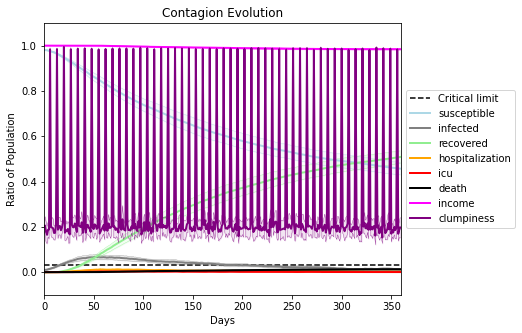

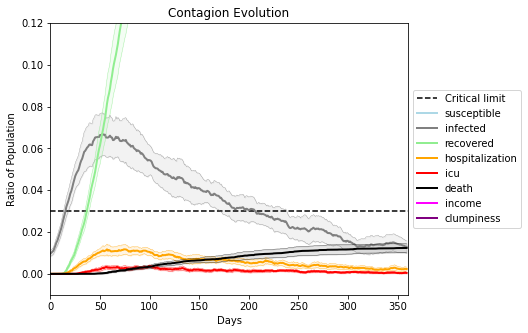

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5944, 8147, 6706, 2775, 707, 3066, 9657, 4604, 8044, 768, 8191, 1846, 2999, 7343, 4982, 882, 5166, 6330, 1336, 5591]
Average similarity between family members is 0.959103454083701 at temperature -0.9975
Average similarity between family and home is 0.9998575710821703 at temperature -1
Average similarity between students and their classroom is 0.641841381129647 at temperature -0.9975
Average classroom occupancy is 4.223880597014926 and number classrooms is 67
Average similarity between workers is 0.9182908425788069 at temperature -0.9975
Average office occupancy is 3.502645502645503 and number offices is 189
Average friend similarity for adults: 0.8506259578651301 for kids: 0.7006080375332255
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6218160779845137
avg restaurant similarity 0.5963838037211295
avg restaurant similarity 0.6719518181956343
avg restaurant similarity 0.6308567575148557
avg restaurant similarity 0.5806342271068541
avg restaurant similarity 0.5808723591427619
avg restaurant similarity 0.6003987677825828
avg restaurant similarity 0.5563521045759257
avg restaurant similarity 0.612808722541664
avg restaurant similarity 0.5875822893207938
avg restaurant similarity 0.6204072797056736
avg restaurant similarity 0.630815660071838
avg restaurant similarity 0.5911221386647203
avg restaurant similarity 0.583290445864728
avg restaurant similarity 0.6202648482345586
avg restaurant similarity 0.5758006246164129
avg restaurant similarity 0.6027808325633544
avg restaurant similarity 0.6020988393745862
avg restaurant similarity 0.5506208306904461
avg restaurant similarity 0.6290215716209591
avg restaurant similarity 0.6406600891072276
avg restaurant similarity 0.5854713390524414
avg restauran

avg restaurant similarity 0.5669413818149811
avg restaurant similarity 0.659736272719718
avg restaurant similarity 0.568744061700895
avg restaurant similarity 0.6198759170024047
avg restaurant similarity 0.6055529506766446
avg restaurant similarity 0.5508944482105764
avg restaurant similarity 0.6155011458244699
avg restaurant similarity 0.623813418388212
avg restaurant similarity 0.6297699977349431
avg restaurant similarity 0.6249834813277586
avg restaurant similarity 0.6262209435400398
avg restaurant similarity 0.5644812647801333
avg restaurant similarity 0.6212373276944285
avg restaurant similarity 0.6293139558841842
avg restaurant similarity 0.553687928626858
avg restaurant similarity 0.5689879552668129
avg restaurant similarity 0.5929813744398367
avg restaurant similarity 0.590584497099956
avg restaurant similarity 0.6394171771742184
avg restaurant similarity 0.5989851115201692
avg restaurant similarity 0.592200920752601
avg restaurant similarity 0.552290984946615
avg restaurant si

avg restaurant similarity 0.629210320593796
avg restaurant similarity 0.660926909746445
avg restaurant similarity 0.645182774845986
avg restaurant similarity 0.6131488274463729
avg restaurant similarity 0.7036559576582347
avg restaurant similarity 0.6983491995318261
avg restaurant similarity 0.6268035392131734
avg restaurant similarity 0.6450304992901389
avg restaurant similarity 0.5928831225333521
avg restaurant similarity 0.6129615806817827
avg restaurant similarity 0.5907077044984946
avg restaurant similarity 0.6369546553315331
avg restaurant similarity 0.6106862329986994
avg restaurant similarity 0.690876340067298
avg restaurant similarity 0.6004088482719196
avg restaurant similarity 0.6426444890373617
avg restaurant similarity 0.673391675398862
avg restaurant similarity 0.5968030485416056
avg restaurant similarity 0.6592494989655001
avg restaurant similarity 0.6224733813349301
avg restaurant similarity 0.6974667533287014
avg restaurant similarity 0.6539477308898797
avg restaurant 

avg restaurant similarity 0.6206309363790584
avg restaurant similarity 0.6785864045383161
avg restaurant similarity 0.6586996712362426
avg restaurant similarity 0.6779047371316139
avg restaurant similarity 0.685990738262992
avg restaurant similarity 0.6354937908323841
avg restaurant similarity 0.6426982265943797
avg restaurant similarity 0.6248594600668615
avg restaurant similarity 0.6475913658106667
avg restaurant similarity 0.6214936576556813
avg restaurant similarity 0.6395007809637631
avg restaurant similarity 0.6530046234604081
avg restaurant similarity 0.6091624764917796
avg restaurant similarity 0.6527530108594578
avg restaurant similarity 0.6937398867279292
avg restaurant similarity 0.6343547503133151
avg restaurant similarity 0.6570071733800079
avg restaurant similarity 0.5693362982643257
avg restaurant similarity 0.6736405568609708
avg restaurant similarity 0.6362769603123631
avg restaurant similarity 0.6833026462510627
avg restaurant similarity 0.6130705018296676
avg restaur

avg restaurant similarity 0.6209036487558778
avg restaurant similarity 0.637028098256843
avg restaurant similarity 0.5955419993369078
avg restaurant similarity 0.689646874605832
avg restaurant similarity 0.6269018032627678
avg restaurant similarity 0.5843238907282019
avg restaurant similarity 0.6368744611837147
avg restaurant similarity 0.5468921839044354
avg restaurant similarity 0.6941588368925213
avg restaurant similarity 0.6142850115941287
avg restaurant similarity 0.6081966125780169
avg restaurant similarity 0.5328148499054429
avg restaurant similarity 0.6123762407879523
avg restaurant similarity 0.6307878877982169
avg restaurant similarity 0.6154408512508254
avg restaurant similarity 0.6202709114197074
avg restaurant similarity 0.6028776388610294
avg restaurant similarity 0.6495654625667628
avg restaurant similarity 0.5853150941511197
avg restaurant similarity 0.5983398592103149
avg restaurant similarity 0.5997232598213509
avg restaurant similarity 0.6162084871474441
avg restaura

avg restaurant similarity 0.6341360288234416
avg restaurant similarity 0.5786947540015169
avg restaurant similarity 0.6251176366563036
avg restaurant similarity 0.5946800036113512
avg restaurant similarity 0.6370127647263549
avg restaurant similarity 0.6186208338531753
avg restaurant similarity 0.5946763508993202
avg restaurant similarity 0.6104281257991838
avg restaurant similarity 0.5732853723836314
avg restaurant similarity 0.6085356789150346
avg restaurant similarity 0.6052785335444189
avg restaurant similarity 0.6155107445957245
avg restaurant similarity 0.6261038493880657
avg restaurant similarity 0.5536060178141217
avg restaurant similarity 0.6271806787230271
avg restaurant similarity 0.6813635305224924
avg restaurant similarity 0.6064260665452629
avg restaurant similarity 0.678578551564392
avg restaurant similarity 0.5872724238828841
avg restaurant similarity 0.6457113562562555
avg restaurant similarity 0.5837734289493662
avg restaurant similarity 0.5975743375537346
avg restaur

avg restaurant similarity 0.6002388338867748
avg restaurant similarity 0.6462365355710293
avg restaurant similarity 0.5685521412224129
avg restaurant similarity 0.6678060993683232
avg restaurant similarity 0.5880278235265549
avg restaurant similarity 0.5870408831692623
avg restaurant similarity 0.5664605799516732
avg restaurant similarity 0.5963445859116013
avg restaurant similarity 0.5728595864821526
avg restaurant similarity 0.6133550555128265
avg restaurant similarity 0.6065751524610827
avg restaurant similarity 0.5393082978257863
avg restaurant similarity 0.5768709481177898
avg restaurant similarity 0.5425682898932317
avg restaurant similarity 0.6785134044224175
avg restaurant similarity 0.5992766223228001
avg restaurant similarity 0.6207335704168367
avg restaurant similarity 0.5609299746419983
avg restaurant similarity 0.6506011799320599
avg restaurant similarity 0.6071569099108868
avg restaurant similarity 0.6519832864684959
avg restaurant similarity 0.6393400937401603
avg restau

avg restaurant similarity 0.6113579182649999
avg restaurant similarity 0.5771218870914784
avg restaurant similarity 0.6273764379781
avg restaurant similarity 0.6441785340354783
avg restaurant similarity 0.5583633001746156
avg restaurant similarity 0.640349698718915
avg restaurant similarity 0.6321827445054765
avg restaurant similarity 0.5941995254375417
avg restaurant similarity 0.620829848466257
avg restaurant similarity 0.5961634705911744
avg restaurant similarity 0.6104467340783426
avg restaurant similarity 0.6661072917713284
avg restaurant similarity 0.5940697616477582
avg restaurant similarity 0.6048206148256999
avg restaurant similarity 0.6038833388568888
avg restaurant similarity 0.5951254379971487
avg restaurant similarity 0.612290903927934
avg restaurant similarity 0.6537033893518368
avg restaurant similarity 0.6232425503778183
avg restaurant similarity 0.5889726081331038
avg restaurant similarity 0.6292632873823829
avg restaurant similarity 0.6562936058844226
avg restaurant s

avg restaurant similarity 0.6276565393883411
avg restaurant similarity 0.5941734463720622
avg restaurant similarity 0.5924246202315894
avg restaurant similarity 0.5943071159123212
avg restaurant similarity 0.6425383497608472
avg restaurant similarity 0.6154476174671127
avg restaurant similarity 0.5895944585837317
avg restaurant similarity 0.6003138797672654
avg restaurant similarity 0.6452021248808681
avg restaurant similarity 0.6120983456593947
avg restaurant similarity 0.6082630807448213
avg restaurant similarity 0.5837337547323629
avg restaurant similarity 0.5846071937905624
avg restaurant similarity 0.6091984814676964
avg restaurant similarity 0.5797868667621603
avg restaurant similarity 0.6059613932238639
avg restaurant similarity 0.6181976420038624
avg restaurant similarity 0.6274416616218369
avg restaurant similarity 0.5866465435512567
avg restaurant similarity 0.5978757980739702
avg restaurant similarity 0.6219476118552631
avg restaurant similarity 0.6451028727001102
avg restau

avg restaurant similarity 0.5910886979922475
avg restaurant similarity 0.6378053098742921
avg restaurant similarity 0.6330828379653666
avg restaurant similarity 0.6050494502473621
avg restaurant similarity 0.6253576895970796
avg restaurant similarity 0.5952673477548427
avg restaurant similarity 0.6350038143103317
avg restaurant similarity 0.5670089703187363
avg restaurant similarity 0.5901199625540786
avg restaurant similarity 0.5770655597504486
avg restaurant similarity 0.6215688937963476
avg restaurant similarity 0.5842928896555916
avg restaurant similarity 0.6082237210720778
avg restaurant similarity 0.628799899045345
avg restaurant similarity 0.6256675690996784
avg restaurant similarity 0.6488447841364723
avg restaurant similarity 0.59402112393768
avg restaurant similarity 0.600716971339326
avg restaurant similarity 0.6109757672349544
avg restaurant similarity 0.6040046780204759
avg restaurant similarity 0.5823120648755362
avg restaurant similarity 0.6035843143004993
avg restaurant

avg restaurant similarity 0.5943769129689059
avg restaurant similarity 0.59632633787691
avg restaurant similarity 0.6121719264970095
avg restaurant similarity 0.6621723007169409
avg restaurant similarity 0.6100415651613438
avg restaurant similarity 0.5814744597127707
avg restaurant similarity 0.6600634405315142
avg restaurant similarity 0.6416835404451173
avg restaurant similarity 0.5936470856078813
avg restaurant similarity 0.594761274517239
avg restaurant similarity 0.6503626928784358
avg restaurant similarity 0.6502975739607849
avg restaurant similarity 0.5936449100692295
avg restaurant similarity 0.5880854159994091
avg restaurant similarity 0.6262734484742019
avg restaurant similarity 0.6121221656826153
avg restaurant similarity 0.5666211149312578
avg restaurant similarity 0.5935251546591661
avg restaurant similarity 0.6189255829270094
avg restaurant similarity 0.5566212200066383
avg restaurant similarity 0.6493161573198398
avg restaurant similarity 0.5810958429407037
avg restauran

avg restaurant similarity 0.6281632829020338
avg restaurant similarity 0.6546414357861196
avg restaurant similarity 0.6180877794783939
avg restaurant similarity 0.6262152020139691
avg restaurant similarity 0.6298737068450104
avg restaurant similarity 0.5956780681119463
avg restaurant similarity 0.5511527470959066
avg restaurant similarity 0.5844811106760388
avg restaurant similarity 0.6161301249395355
avg restaurant similarity 0.6175815854641404
avg restaurant similarity 0.6134066567967797
avg restaurant similarity 0.6151979559439105
avg restaurant similarity 0.6085907094411105
avg restaurant similarity 0.629350056238228
avg restaurant similarity 0.6250961725165688
avg restaurant similarity 0.5532477893160972
avg restaurant similarity 0.5703190888641684
avg restaurant similarity 0.6083134796666136
avg restaurant similarity 0.5650247572400103
avg restaurant similarity 0.5944876532019846
avg restaurant similarity 0.5999388543604953
avg restaurant similarity 0.6438308625246213
avg restaur

avg restaurant similarity 0.5999068648286543
avg restaurant similarity 0.6266239314313737
avg restaurant similarity 0.6633171005131214
avg restaurant similarity 0.6214081261157222
avg restaurant similarity 0.6674526352995094
avg restaurant similarity 0.6285633832189159
avg restaurant similarity 0.6257368874797896
avg restaurant similarity 0.6150178896563606
avg restaurant similarity 0.6879744744365233
avg restaurant similarity 0.6257714485629569
avg restaurant similarity 0.6581261554603204
avg restaurant similarity 0.6311861762793299
avg restaurant similarity 0.6634341880186072
avg restaurant similarity 0.6321197975647482
avg restaurant similarity 0.6551431731310048
avg restaurant similarity 0.6656495157822686
avg restaurant similarity 0.6502157534440949
avg restaurant similarity 0.6557215977050541
avg restaurant similarity 0.6323177810180272
avg restaurant similarity 0.6594119554726524
avg restaurant similarity 0.6268946536330694
avg restaurant similarity 0.5993816623222304
avg restau

avg restaurant similarity 0.6296366536695067
avg restaurant similarity 0.6306740421968849
avg restaurant similarity 0.6864137608148269
avg restaurant similarity 0.6482253666723753
avg restaurant similarity 0.6963256623148186
avg restaurant similarity 0.6521437726106288
avg restaurant similarity 0.6215577482171389
avg restaurant similarity 0.6304706926908181
avg restaurant similarity 0.6430659853095281
avg restaurant similarity 0.6646858675564132
avg restaurant similarity 0.6460680492314104
avg restaurant similarity 0.6007723030456432
avg restaurant similarity 0.6852192956327438
avg restaurant similarity 0.5855806228592169
avg restaurant similarity 0.645468551946427
avg restaurant similarity 0.5908590487967541
avg restaurant similarity 0.6231624404040652
avg restaurant similarity 0.6017266931951729
avg restaurant similarity 0.6275262085963369
avg restaurant similarity 0.6135349239810407
avg restaurant similarity 0.6505720791342516
avg restaurant similarity 0.6473322686178223
avg restaur

avg restaurant similarity 0.6294634103122679
avg restaurant similarity 0.5688193489268696
avg restaurant similarity 0.6307185852695311
avg restaurant similarity 0.553722905679984
avg restaurant similarity 0.5518677503758289
avg restaurant similarity 0.6549897146029281
avg restaurant similarity 0.5598516433993785
avg restaurant similarity 0.6229453588239461
avg restaurant similarity 0.5632238280119587
avg restaurant similarity 0.5924857308087441
avg restaurant similarity 0.5824702616895173
avg restaurant similarity 0.5940410387466115
avg restaurant similarity 0.5987326599781773
avg restaurant similarity 0.592831324540478
avg restaurant similarity 0.657542567537051
avg restaurant similarity 0.6247113223784716
avg restaurant similarity 0.6134529614980115
avg restaurant similarity 0.6043972612260555
avg restaurant similarity 0.5810840422091976
avg restaurant similarity 0.5872743731339921
avg restaurant similarity 0.624590147548633
avg restaurant similarity 0.6171987740649709
avg restaurant

avg restaurant similarity 0.651053037487235
avg restaurant similarity 0.599183394350454
avg restaurant similarity 0.604634978361066
avg restaurant similarity 0.6777988599024406
avg restaurant similarity 0.6241412823450884
avg restaurant similarity 0.615536655598022
avg restaurant similarity 0.5829363986791073
avg restaurant similarity 0.6588670714824525
avg restaurant similarity 0.6144503926367206
avg restaurant similarity 0.6264290790167403
avg restaurant similarity 0.6161736625701167
avg restaurant similarity 0.5845486794601445
avg restaurant similarity 0.5474600947314664
avg restaurant similarity 0.5878197824972922
avg restaurant similarity 0.6417489596580775
avg restaurant similarity 0.6383380198650497
avg restaurant similarity 0.6050074386673971
avg restaurant similarity 0.5839133129757015
avg restaurant similarity 0.6187816822696439
avg restaurant similarity 0.6144710069653263
avg restaurant similarity 0.6733013849790243
avg restaurant similarity 0.6105300195409287
avg restaurant

avg restaurant similarity 0.6164784809355837
avg restaurant similarity 0.5798625461508019
avg restaurant similarity 0.6230590111544329
avg restaurant similarity 0.6394837627076695
avg restaurant similarity 0.5837790885127921
avg restaurant similarity 0.5835580363526004
avg restaurant similarity 0.5841701895796358
avg restaurant similarity 0.6368175698696158
avg restaurant similarity 0.6064177454761621
avg restaurant similarity 0.6565858670939723
avg restaurant similarity 0.5875428429080687
avg restaurant similarity 0.604883744465042
avg restaurant similarity 0.5695416066500828
avg restaurant similarity 0.5691355774766417
avg restaurant similarity 0.6291340187702863
avg restaurant similarity 0.6168148088658404
avg restaurant similarity 0.58410151012756
avg restaurant similarity 0.6382064855857806
avg restaurant similarity 0.642046586323981
avg restaurant similarity 0.6681058196113024
avg restaurant similarity 0.5765577310023338
avg restaurant similarity 0.6348129361442018
avg restaurant

avg restaurant similarity 0.6252265592293934
avg restaurant similarity 0.622896732804403
avg restaurant similarity 0.6308924514906649
avg restaurant similarity 0.5190448671494834
avg restaurant similarity 0.5940948628651985
avg restaurant similarity 0.609141613484306
avg restaurant similarity 0.5943991910514478
avg restaurant similarity 0.643665680322929
avg restaurant similarity 0.5601445810490479
avg restaurant similarity 0.5681146854184662
avg restaurant similarity 0.6235429304352591
avg restaurant similarity 0.579820999600065
avg restaurant similarity 0.5767791530917473
avg restaurant similarity 0.6116625657987131
avg restaurant similarity 0.5659380339683531
avg restaurant similarity 0.6326207669154098
avg restaurant similarity 0.5964407527712539
avg restaurant similarity 0.6723084782597468
avg restaurant similarity 0.603605826300199
avg restaurant similarity 0.5869032745568351
avg restaurant similarity 0.5985401001303221
avg restaurant similarity 0.6240131162633027
avg restaurant 

avg restaurant similarity 0.646766065059843
avg restaurant similarity 0.6068687548011813
avg restaurant similarity 0.6423553409984942
avg restaurant similarity 0.6363365025997437
avg restaurant similarity 0.6614697026260644
avg restaurant similarity 0.6340053345895806
avg restaurant similarity 0.6459995372357463
avg restaurant similarity 0.6160514306254866
avg restaurant similarity 0.6940619842758063
avg restaurant similarity 0.6552881416017764
avg restaurant similarity 0.6256715745521627
avg restaurant similarity 0.6086180294715501
avg restaurant similarity 0.6570991074660338
avg restaurant similarity 0.5934025755536662
avg restaurant similarity 0.6170092408423905
avg restaurant similarity 0.6846371070414451
avg restaurant similarity 0.6434574004487632
avg restaurant similarity 0.6180030037214825
avg restaurant similarity 0.5982158976521723
avg restaurant similarity 0.6842671809955159
avg restaurant similarity 0.6375576975758107
avg restaurant similarity 0.5962279720788279
avg restaur

avg restaurant similarity 0.5713907973228329
avg restaurant similarity 0.5932037833449528
avg restaurant similarity 0.5573151749591868
avg restaurant similarity 0.5742132805984178
avg restaurant similarity 0.6305471829808681
avg restaurant similarity 0.6457290776231526
avg restaurant similarity 0.6434254182851536
avg restaurant similarity 0.6395995200889018
avg restaurant similarity 0.5874053204721045
avg restaurant similarity 0.6525035596974549
avg restaurant similarity 0.6482946066178732
avg restaurant similarity 0.6349542969021473
avg restaurant similarity 0.6857772127195175
avg restaurant similarity 0.6287523170284266
avg restaurant similarity 0.6327099897687243
avg restaurant similarity 0.567562781046457
avg restaurant similarity 0.6387792320799188
avg restaurant similarity 0.6353192686661066
avg restaurant similarity 0.5781921660941359
avg restaurant similarity 0.6626719014107039
avg restaurant similarity 0.6023215625682534
avg restaurant similarity 0.6539448161808831
avg restaur

avg restaurant similarity 0.612680810146776
avg restaurant similarity 0.6079678542154625
avg restaurant similarity 0.6218704109406036
avg restaurant similarity 0.6031464105746032
avg restaurant similarity 0.609786990092536
avg restaurant similarity 0.6042370470009113
avg restaurant similarity 0.5868829923164216
avg restaurant similarity 0.673328265830146
avg restaurant similarity 0.6249936401769213
avg restaurant similarity 0.6088308037500909
avg restaurant similarity 0.6767764448512441
avg restaurant similarity 0.571393626152877
avg restaurant similarity 0.6393032689335404
avg restaurant similarity 0.6225690616971157
avg restaurant similarity 0.6303137610930715
avg restaurant similarity 0.6094329643524029
avg restaurant similarity 0.5916424908933423
avg restaurant similarity 0.6055705445274435
avg restaurant similarity 0.5829291585495108
avg restaurant similarity 0.5673997095583894
avg restaurant similarity 0.6202835489653986
avg restaurant similarity 0.6063268793671696
avg restaurant

avg restaurant similarity 0.6044526704481822
avg restaurant similarity 0.6145860639517835
avg restaurant similarity 0.6201169282502662
avg restaurant similarity 0.6852913132104831
avg restaurant similarity 0.6077977820014014
avg restaurant similarity 0.6291343008407582
avg restaurant similarity 0.5628976802806939
avg restaurant similarity 0.656034898686562
avg restaurant similarity 0.6027061222200837
avg restaurant similarity 0.6312257335626184
avg restaurant similarity 0.5652476156775992
avg restaurant similarity 0.6131622416428287
avg restaurant similarity 0.6143331455243448
avg restaurant similarity 0.6179635205632225
avg restaurant similarity 0.6073817352690332
avg restaurant similarity 0.5896282485323562
avg restaurant similarity 0.5641009398541965
avg restaurant similarity 0.670764193431476
avg restaurant similarity 0.6226411115776865
avg restaurant similarity 0.6020347047649641
avg restaurant similarity 0.6353934482614146
avg restaurant similarity 0.6097950675888204
avg restaura

avg restaurant similarity 0.6489354067240484
avg restaurant similarity 0.602976842955909
avg restaurant similarity 0.6267904765440653
avg restaurant similarity 0.6748501889956819
avg restaurant similarity 0.588133150507104
avg restaurant similarity 0.6037295195371644
avg restaurant similarity 0.6440728881401856
avg restaurant similarity 0.6255775637087229
avg restaurant similarity 0.6266722415932582
avg restaurant similarity 0.6026828701937877
avg restaurant similarity 0.6518041335859505
avg restaurant similarity 0.6380575812708924
avg restaurant similarity 0.6336314380052455
avg restaurant similarity 0.6031489008404763
avg restaurant similarity 0.6109426991100362
avg restaurant similarity 0.5942288221895909
avg restaurant similarity 0.6557840154345802
avg restaurant similarity 0.5990496351703672
avg restaurant similarity 0.6091490797778353
avg restaurant similarity 0.606372623560667
avg restaurant similarity 0.58935209063867
avg restaurant similarity 0.5728458754371273
avg restaurant 

avg restaurant similarity 0.6386685994862982
avg restaurant similarity 0.5934292734134905
avg restaurant similarity 0.6203344018668104
avg restaurant similarity 0.6051342769161057
avg restaurant similarity 0.6634991728841897
avg restaurant similarity 0.6364188576941056
avg restaurant similarity 0.6763252074028347
avg restaurant similarity 0.6373802955567873
avg restaurant similarity 0.6033200337180427
avg restaurant similarity 0.5849034752232386
avg restaurant similarity 0.641187701826328
avg restaurant similarity 0.704892021379268
avg restaurant similarity 0.6454385309056473
avg restaurant similarity 0.6445965188746032
avg restaurant similarity 0.6138673523004902
avg restaurant similarity 0.6812894162326956
avg restaurant similarity 0.6552075543018469
avg restaurant similarity 0.6245928374375328
avg restaurant similarity 0.6656968863186323
avg restaurant similarity 0.571406332616802
avg restaurant similarity 0.662266169701297
avg restaurant similarity 0.6599216583104588
avg restaurant

avg restaurant similarity 0.6150076779062984
avg restaurant similarity 0.6488346205430262
avg restaurant similarity 0.6679276255078134
avg restaurant similarity 0.6136503862260942
avg restaurant similarity 0.6217425404942474
avg restaurant similarity 0.6690198662595039
avg restaurant similarity 0.6873421946986469
avg restaurant similarity 0.6296764449808453
avg restaurant similarity 0.6335229325734603
avg restaurant similarity 0.5715246583221467
avg restaurant similarity 0.5788279929014974
avg restaurant similarity 0.617110745604499
avg restaurant similarity 0.6618106992294792
avg restaurant similarity 0.5736996902317775
avg restaurant similarity 0.6116639361999073
avg restaurant similarity 0.6413520256893106
avg restaurant similarity 0.6186032763522549
avg restaurant similarity 0.6166664854546237
avg restaurant similarity 0.6469413889641472
avg restaurant similarity 0.6309494726604996
avg restaurant similarity 0.6154037847288097
avg restaurant similarity 0.6209067529296177
avg restaur

avg restaurant similarity 0.6833839664415542
avg restaurant similarity 0.5977667834601035
avg restaurant similarity 0.6368637787155998
avg restaurant similarity 0.6561878356262671
avg restaurant similarity 0.6028297573505272
avg restaurant similarity 0.6188225802961651
avg restaurant similarity 0.5957342777042184
avg restaurant similarity 0.6112448300539045
avg restaurant similarity 0.6797862447149331
avg restaurant similarity 0.6342933210107727
avg restaurant similarity 0.6201520160293019
avg restaurant similarity 0.5808660828125064
avg restaurant similarity 0.5455006591553725
avg restaurant similarity 0.6210763358020324
avg restaurant similarity 0.6139761728541683
avg restaurant similarity 0.6433944396401858
avg restaurant similarity 0.6215630011543973
avg restaurant similarity 0.6441782472349151
avg restaurant similarity 0.619092920225949
avg restaurant similarity 0.6648460433974274
avg restaurant similarity 0.594559546838423
avg restaurant similarity 0.5850132600886084
avg restaura

avg restaurant similarity 0.6464682922971023
avg restaurant similarity 0.6530585458935632
avg restaurant similarity 0.5865896410894305
avg restaurant similarity 0.6230580091197037
avg restaurant similarity 0.6520069152490374
avg restaurant similarity 0.6248664286171616
avg restaurant similarity 0.6250041585033254
avg restaurant similarity 0.6284469513277888
avg restaurant similarity 0.6137608315557896
avg restaurant similarity 0.6664841239659227
avg restaurant similarity 0.6051874624370085
avg restaurant similarity 0.5969420225670848
avg restaurant similarity 0.6352795326563772
avg restaurant similarity 0.6468014987277426
avg restaurant similarity 0.6471210822530183
avg restaurant similarity 0.6420349421053605
avg restaurant similarity 0.6504565085031818
avg restaurant similarity 0.6504183382676288
avg restaurant similarity 0.5942237540790425
avg restaurant similarity 0.6241902319873549
avg restaurant similarity 0.6228384426671147
avg restaurant similarity 0.6340365025195438
avg restau

avg restaurant similarity 0.6248676031296477
avg restaurant similarity 0.645357493034822
avg restaurant similarity 0.5894261848216859
avg restaurant similarity 0.6222214270239241
avg restaurant similarity 0.5783045542147309
avg restaurant similarity 0.6304292850499977
avg restaurant similarity 0.602586142152646
avg restaurant similarity 0.6381823919654046
avg restaurant similarity 0.6158555398292804
avg restaurant similarity 0.6173875957195947
avg restaurant similarity 0.5918374023686697
avg restaurant similarity 0.6051583671495374
avg restaurant similarity 0.5812834213091614
avg restaurant similarity 0.642273484273904
avg restaurant similarity 0.683799544713001
avg restaurant similarity 0.6141747394328185
avg restaurant similarity 0.6225349581409643
avg restaurant similarity 0.621078476971969
avg restaurant similarity 0.6266563025002987
avg restaurant similarity 0.646932890207354
avg restaurant similarity 0.5767694723776664
avg restaurant similarity 0.6205139686660609
avg restaurant s

avg restaurant similarity 0.6169735512429136
avg restaurant similarity 0.5879713299653249
avg restaurant similarity 0.592259248231953
avg restaurant similarity 0.6212542093363159
avg restaurant similarity 0.5807416995694464
avg restaurant similarity 0.6374430352330354
avg restaurant similarity 0.6389420529029993
avg restaurant similarity 0.593170404731578
avg restaurant similarity 0.6666267546279934
avg restaurant similarity 0.5851882659842813
avg restaurant similarity 0.6233343854434835
avg restaurant similarity 0.6813938861248031
avg restaurant similarity 0.6048256076018185
avg restaurant similarity 0.6403132881057059
avg restaurant similarity 0.6769856193336999
avg restaurant similarity 0.6256019442190905
avg restaurant similarity 0.6179156434293729
avg restaurant similarity 0.6192054400250209
avg restaurant similarity 0.6045319974437167
avg restaurant similarity 0.6069584515176861
avg restaurant similarity 0.6105991475949943
avg restaurant similarity 0.705867420375167
avg restauran

avg restaurant similarity 0.632785630201521
avg restaurant similarity 0.6329330021384543
avg restaurant similarity 0.6383678974248915
avg restaurant similarity 0.672357277769251
avg restaurant similarity 0.6379626906920441
avg restaurant similarity 0.6270700911498193
avg restaurant similarity 0.5657655943333265
avg restaurant similarity 0.625649957030667
avg restaurant similarity 0.6053198061636443
avg restaurant similarity 0.6444626217079003
avg restaurant similarity 0.6363160538931254
avg restaurant similarity 0.6572551529591167
avg restaurant similarity 0.617742263972866
avg restaurant similarity 0.6284911732172613
avg restaurant similarity 0.6121023274234861
avg restaurant similarity 0.6035637772167904
avg restaurant similarity 0.6201125141923419
avg restaurant similarity 0.6352920293646023
avg restaurant similarity 0.6346312242578246
avg restaurant similarity 0.6148207438911103
avg restaurant similarity 0.6468194430078136
avg restaurant similarity 0.6252795845823713
avg restaurant

avg restaurant similarity 0.6239288320291674
avg restaurant similarity 0.6557307886060403
avg restaurant similarity 0.6312816666382534
avg restaurant similarity 0.6933641047877899
avg restaurant similarity 0.6412497768880095
avg restaurant similarity 0.6493347291255529
avg restaurant similarity 0.6871256333559048
avg restaurant similarity 0.6665841511155869
avg restaurant similarity 0.664054539038863
avg restaurant similarity 0.6865624884862686
avg restaurant similarity 0.6153718460610199
avg restaurant similarity 0.6545908274635565
avg restaurant similarity 0.6589575180854083
avg restaurant similarity 0.6749422322686178
avg restaurant similarity 0.6604486671951314
avg restaurant similarity 0.6891965739017697
avg restaurant similarity 0.6514908169410157
avg restaurant similarity 0.6696967697134835
avg restaurant similarity 0.6317721440277189
avg restaurant similarity 0.6258311149719649
avg restaurant similarity 0.643002836868206
avg restaurant similarity 0.6672595888872241
avg restaura

avg restaurant similarity 0.6125873533140067
avg restaurant similarity 0.6358134829139558
avg restaurant similarity 0.643328634579687
avg restaurant similarity 0.7192295087467614
avg restaurant similarity 0.6458093139942707
avg restaurant similarity 0.6406623540681466
avg restaurant similarity 0.6331826748412867
avg restaurant similarity 0.7098888107731435
avg restaurant similarity 0.666764466636847
avg restaurant similarity 0.6604955028458441
avg restaurant similarity 0.6324798827952098
avg restaurant similarity 0.6419158567626166
avg restaurant similarity 0.6739013537443719
avg restaurant similarity 0.6255897244359567
avg restaurant similarity 0.6568668826435121
avg restaurant similarity 0.6655119960824838
avg restaurant similarity 0.6880090165705971
avg restaurant similarity 0.6788246004297214
avg restaurant similarity 0.6741212358878467
avg restaurant similarity 0.6778526855517718
avg restaurant similarity 0.6609718805468663
avg restaurant similarity 0.6946646228951067
avg restaura

avg restaurant similarity 0.6632994290071692
avg restaurant similarity 0.6460188008197212
avg restaurant similarity 0.6273091709182268
avg restaurant similarity 0.6519386864205203
avg restaurant similarity 0.622911260369762
avg restaurant similarity 0.6074125407402812
avg restaurant similarity 0.649189864321827
avg restaurant similarity 0.5976418686147368
avg restaurant similarity 0.6573531070033183
avg restaurant similarity 0.6523858193380773
avg restaurant similarity 0.6581611767525796
avg restaurant similarity 0.6721075515817452
avg restaurant similarity 0.5959737018324059
avg restaurant similarity 0.6188580607775233
avg restaurant similarity 0.6843633482247093
avg restaurant similarity 0.6446751532483797
avg restaurant similarity 0.6717666590814572
avg restaurant similarity 0.6684462734495347
avg restaurant similarity 0.6122250616724506
avg restaurant similarity 0.6550397345809412
avg restaurant similarity 0.6639968157872429
avg restaurant similarity 0.6567052617605228
avg restaura

avg restaurant similarity 0.6414839473623087
avg restaurant similarity 0.6331918137511166
avg restaurant similarity 0.6130460625347367
avg restaurant similarity 0.682636295376863
avg restaurant similarity 0.6506847769578004
avg restaurant similarity 0.6349034165832996
avg restaurant similarity 0.6830197172039715
avg restaurant similarity 0.6655860347226181
avg restaurant similarity 0.6152484325176827
avg restaurant similarity 0.604269781463528
avg restaurant similarity 0.6689129057295249
avg restaurant similarity 0.6284919516254925
avg restaurant similarity 0.6628822814762919
avg restaurant similarity 0.647081827160209
avg restaurant similarity 0.6124647399155533
avg restaurant similarity 0.671552848709678
avg restaurant similarity 0.6370991570302337
avg restaurant similarity 0.6278480492736873
avg restaurant similarity 0.6531751235940976
avg restaurant similarity 0.631343220285684
avg restaurant similarity 0.669730976301519
avg restaurant similarity 0.6242274481609458
avg restaurant s

avg restaurant similarity 0.5869757427325479
avg restaurant similarity 0.6175317394288165
avg restaurant similarity 0.6340943356655095
avg restaurant similarity 0.593108379127203
avg restaurant similarity 0.6486424344636321
avg restaurant similarity 0.6061198881003513
avg restaurant similarity 0.5872983733447329
avg restaurant similarity 0.5794854119809932
avg restaurant similarity 0.595694579983012
avg restaurant similarity 0.6500843949123138
avg restaurant similarity 0.6542749870751005
avg restaurant similarity 0.6406998240763528
avg restaurant similarity 0.5890525859653317
avg restaurant similarity 0.5838565824890598
avg restaurant similarity 0.591537388079404
avg restaurant similarity 0.6019051749202412
avg restaurant similarity 0.6536642848718218
avg restaurant similarity 0.6666438620637449
avg restaurant similarity 0.6286104583402958
avg restaurant similarity 0.6468526254576826
avg restaurant similarity 0.6480010771073886
avg restaurant similarity 0.6013703316373538
avg restauran

avg restaurant similarity 0.648645364352979
avg restaurant similarity 0.612416302972321
avg restaurant similarity 0.582016942264252
avg restaurant similarity 0.6153173171276723
avg restaurant similarity 0.6257039621151798
avg restaurant similarity 0.6749227308314871
avg restaurant similarity 0.631249369048324
avg restaurant similarity 0.6380488109663319
avg restaurant similarity 0.6314782022213442
avg restaurant similarity 0.6222993113423376
avg restaurant similarity 0.6257493244659059
avg restaurant similarity 0.6292255328673052
avg restaurant similarity 0.561274743194459
avg restaurant similarity 0.628201569527194
avg restaurant similarity 0.6439762455948448
avg restaurant similarity 0.6777092239673503
avg restaurant similarity 0.6311550071398636
avg restaurant similarity 0.545313900173454
avg restaurant similarity 0.6794568279598895
avg restaurant similarity 0.6316319752840903
avg restaurant similarity 0.5916992256607295
avg restaurant similarity 0.619968343830986
avg restaurant sim

avg restaurant similarity 0.6264784950665232
avg restaurant similarity 0.6077139396677297
avg restaurant similarity 0.6114980746780064
avg restaurant similarity 0.610427688670482
avg restaurant similarity 0.6686277772740348
avg restaurant similarity 0.6289775610364282
avg restaurant similarity 0.6338612962418503
avg restaurant similarity 0.6032582049853036
avg restaurant similarity 0.6542868306274903
avg restaurant similarity 0.6311383835296546
avg restaurant similarity 0.6196105083121416
avg restaurant similarity 0.583071273823103
avg restaurant similarity 0.6243710367731723
avg restaurant similarity 0.6121304027700407
avg restaurant similarity 0.6343059787586843
avg restaurant similarity 0.5610052302707276
avg restaurant similarity 0.6070308861763585
avg restaurant similarity 0.5611308007892611
avg restaurant similarity 0.6245241084086633
avg restaurant similarity 0.5543376637432547
avg restaurant similarity 0.5904471978878223
avg restaurant similarity 0.6161120512156955
avg restaura

avg restaurant similarity 0.6779142195995129
avg restaurant similarity 0.6265571144631249
avg restaurant similarity 0.5836698581884516
avg restaurant similarity 0.5785836683052362
avg restaurant similarity 0.5988950896137452
avg restaurant similarity 0.6130149461083597
avg restaurant similarity 0.6357042983981714
avg restaurant similarity 0.5854335885222647
avg restaurant similarity 0.5922171153891468
avg restaurant similarity 0.6152124129433304
avg restaurant similarity 0.6440095754910812
avg restaurant similarity 0.6165669987662759
avg restaurant similarity 0.6076036442107403
avg restaurant similarity 0.6378872797609518
avg restaurant similarity 0.5747865092010513
avg restaurant similarity 0.6509768704219252
avg restaurant similarity 0.5894142960898394
avg restaurant similarity 0.6309299960502336
avg restaurant similarity 0.6515214465877353
avg restaurant similarity 0.6341640347400854
avg restaurant similarity 0.6090755859555701
avg restaurant similarity 0.6158936775605778
avg restau

avg restaurant similarity 0.6865178732099602
avg restaurant similarity 0.6393585235944051
avg restaurant similarity 0.5963501111665781
avg restaurant similarity 0.6354157009425068
avg restaurant similarity 0.6045410163778584
avg restaurant similarity 0.6760108555286777
avg restaurant similarity 0.5768870719268344
avg restaurant similarity 0.5602458204674916
avg restaurant similarity 0.6255179364052093
avg restaurant similarity 0.5922316934392138
avg restaurant similarity 0.6606150818779735
avg restaurant similarity 0.6355610896097258
avg restaurant similarity 0.5885060267811237
avg restaurant similarity 0.6665343697550266
avg restaurant similarity 0.5708986872369967
avg restaurant similarity 0.6088442182463358
avg restaurant similarity 0.6819574863743696
avg restaurant similarity 0.6514980634445524
avg restaurant similarity 0.6293174442173219
avg restaurant similarity 0.5818934876323123
avg restaurant similarity 0.6392838360708021
avg restaurant similarity 0.5606141549035831
avg restau

avg restaurant similarity 0.648295654739028
avg restaurant similarity 0.6062596554037424
avg restaurant similarity 0.6272220257889963
avg restaurant similarity 0.632369044283349
avg restaurant similarity 0.5469467857065501
avg restaurant similarity 0.6767830262280372
avg restaurant similarity 0.6098780340896062
avg restaurant similarity 0.6238932394632821
avg restaurant similarity 0.5797702016315309
avg restaurant similarity 0.5871921918997042
avg restaurant similarity 0.6166457529417708
avg restaurant similarity 0.6635275765067493
avg restaurant similarity 0.6659488199221556
avg restaurant similarity 0.6089953778780514
avg restaurant similarity 0.6147543365073861
avg restaurant similarity 0.6365096978019689
avg restaurant similarity 0.5944825173397463
avg restaurant similarity 0.5956807780630282
avg restaurant similarity 0.5757848475934331
avg restaurant similarity 0.6369599823233821
avg restaurant similarity 0.6036549933590283
avg restaurant similarity 0.5795071396956923
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

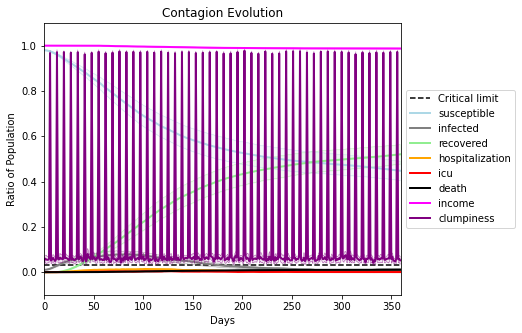

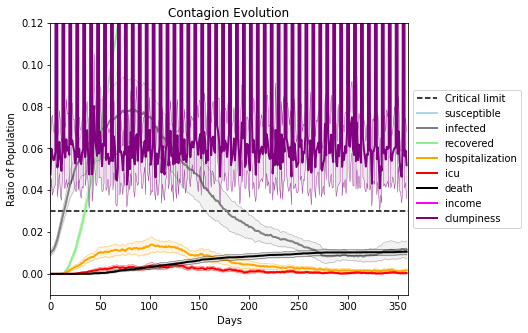

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8360, 8218, 7811, 4867, 4284, 6361, 6566, 9553, 8111, 5708, 8285, 736, 8370, 5912, 1381, 7340, 2837, 6950, 7617, 7414]
Average similarity between family members is 0.9541391728693466 at temperature -0.997
Average similarity between family and home is 0.9998481391592975 at temperature -1
Average similarity between students and their classroom is 0.6719440669543493 at temperature -0.997
Average classroom occupancy is 4.041666666666667 and number classrooms is 72
Average similarity between workers is 0.9203715066452576 at temperature -0.997
Average office occupancy is 3.3418367346938775 and number offices is 196
Average friend similarity for adults: 0.8479546851441133 for kids: 0.7055375053501896
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6109109703425766
avg restaurant similarity 0.6080679259972583
avg restaurant similarity 0.5608651250029963
avg restaurant similarity 0.6072895376675526
avg restaurant similarity 0.6509209759059433
avg restaurant similarity 0.6466469024199957
avg restaurant similarity 0.6205807655561575
avg restaurant similarity 0.6633381471910643
avg restaurant similarity 0.6227809135789444
avg restaurant similarity 0.6180833574196585
avg restaurant similarity 0.6762543976126453
avg restaurant similarity 0.644737265965544
avg restaurant similarity 0.6017209125699668
avg restaurant similarity 0.590575131619194
avg restaurant similarity 0.5817978610176732
avg restaurant similarity 0.6405151463189849
avg restaurant similarity 0.675846328186576
avg restaurant similarity 0.5928402499283968
avg restaurant similarity 0.6299422956979716
avg restaurant similarity 0.6171303937336393
avg restaurant similarity 0.572298958335968
avg restaurant similarity 0.6297732610141151
avg restaurant

avg restaurant similarity 0.6597874932730029
avg restaurant similarity 0.6392980761846696
avg restaurant similarity 0.6431422542812436
avg restaurant similarity 0.6431430476976705
avg restaurant similarity 0.6128412022915382
avg restaurant similarity 0.6088836685421813
avg restaurant similarity 0.6904637751254609
avg restaurant similarity 0.6082831053440969
avg restaurant similarity 0.6547705955411647
avg restaurant similarity 0.6545729632122246
avg restaurant similarity 0.6075131763315499
avg restaurant similarity 0.6698491024506316
avg restaurant similarity 0.5755047980952203
avg restaurant similarity 0.6432126275309752
avg restaurant similarity 0.6284404215661811
avg restaurant similarity 0.6197585155248931
avg restaurant similarity 0.6893687964158957
avg restaurant similarity 0.5795467362422827
avg restaurant similarity 0.6335973356783177
avg restaurant similarity 0.6933420319244373
avg restaurant similarity 0.6159394974642223
avg restaurant similarity 0.6301039652869255
avg restau

avg restaurant similarity 0.6454451586726416
avg restaurant similarity 0.6179398871564917
avg restaurant similarity 0.6082218604914208
avg restaurant similarity 0.6241827623109989
avg restaurant similarity 0.6091896544085069
avg restaurant similarity 0.6075557586254902
avg restaurant similarity 0.5847580844545237
avg restaurant similarity 0.5697457629949818
avg restaurant similarity 0.617471761195164
avg restaurant similarity 0.5952350616302328
avg restaurant similarity 0.663213554632125
avg restaurant similarity 0.6594880690342712
avg restaurant similarity 0.6047025643219179
avg restaurant similarity 0.6153775410670859
avg restaurant similarity 0.6124446649119812
avg restaurant similarity 0.6037351076784735
avg restaurant similarity 0.649889562710545
avg restaurant similarity 0.5834574157550548
avg restaurant similarity 0.5845581961294217
avg restaurant similarity 0.6672287705579901
avg restaurant similarity 0.5916688660619505
avg restaurant similarity 0.640720865485105
avg restaurant

avg restaurant similarity 0.6639793064880826
avg restaurant similarity 0.6202571150484645
avg restaurant similarity 0.6306118272861787
avg restaurant similarity 0.5884043702657779
avg restaurant similarity 0.5561798274933898
avg restaurant similarity 0.5830828254182766
avg restaurant similarity 0.624549419351065
avg restaurant similarity 0.5990441866102033
avg restaurant similarity 0.6076670972269201
avg restaurant similarity 0.6307794413324717
avg restaurant similarity 0.6456226204853678
avg restaurant similarity 0.6006058173785187
avg restaurant similarity 0.6608689578163403
avg restaurant similarity 0.6810444174199461
avg restaurant similarity 0.6740894923320008
avg restaurant similarity 0.6089329261142844
avg restaurant similarity 0.6393978881109472
avg restaurant similarity 0.6769926623425057
avg restaurant similarity 0.6387214117347132
avg restaurant similarity 0.6644453099205724
avg restaurant similarity 0.5321654462737242
avg restaurant similarity 0.6355251879935963
avg restaur

avg restaurant similarity 0.5421313699732792
avg restaurant similarity 0.6332740640472122
avg restaurant similarity 0.6363762649382044
avg restaurant similarity 0.5752267135580879
avg restaurant similarity 0.6262250810467791
avg restaurant similarity 0.6233437835170748
avg restaurant similarity 0.574098611947655
avg restaurant similarity 0.5674203210092736
avg restaurant similarity 0.6347190215002269
avg restaurant similarity 0.6152682059643487
avg restaurant similarity 0.5561994963956605
avg restaurant similarity 0.6120429874076148
avg restaurant similarity 0.5856824438138928
avg restaurant similarity 0.547547924433824
avg restaurant similarity 0.5651864662518097
avg restaurant similarity 0.5822226678542501
avg restaurant similarity 0.6164165994950336
avg restaurant similarity 0.6252596288421821
avg restaurant similarity 0.6222923341759296
avg restaurant similarity 0.6070340223702428
avg restaurant similarity 0.5545722122620412
avg restaurant similarity 0.5981414485243757
avg restaura

avg restaurant similarity 0.5467603287630968
avg restaurant similarity 0.6041253334623679
avg restaurant similarity 0.5634600644255562
avg restaurant similarity 0.5906786442367548
avg restaurant similarity 0.6129154934055147
avg restaurant similarity 0.6807789348022752
avg restaurant similarity 0.6400850577997907
avg restaurant similarity 0.6525661555219708
avg restaurant similarity 0.611310208549413
avg restaurant similarity 0.6035899058034141
avg restaurant similarity 0.5924560115678332
avg restaurant similarity 0.6086189534168609
avg restaurant similarity 0.5874343746437851
avg restaurant similarity 0.5816116135077422
avg restaurant similarity 0.5795893309090222
avg restaurant similarity 0.5679779734172871
avg restaurant similarity 0.5964095340473836
avg restaurant similarity 0.5888686142491087
avg restaurant similarity 0.5919246118181276
avg restaurant similarity 0.6764489156266157
avg restaurant similarity 0.585972802395276
avg restaurant similarity 0.5616057229401916
avg restaura

avg restaurant similarity 0.6392742301488622
avg restaurant similarity 0.6141586763931832
avg restaurant similarity 0.5954490905650098
avg restaurant similarity 0.6669385115290624
avg restaurant similarity 0.5957816079753884
avg restaurant similarity 0.6263156148052204
avg restaurant similarity 0.6875601436463975
avg restaurant similarity 0.6467495191393561
avg restaurant similarity 0.6553846963363077
avg restaurant similarity 0.6192380996617244
avg restaurant similarity 0.6657133906447554
avg restaurant similarity 0.6325458748513104
avg restaurant similarity 0.6749576923512047
avg restaurant similarity 0.6294116020835909
avg restaurant similarity 0.6318461502559316
avg restaurant similarity 0.6685085513308409
avg restaurant similarity 0.6051825421841129
avg restaurant similarity 0.6258180627546801
avg restaurant similarity 0.6310876314840873
avg restaurant similarity 0.6705439628181415
avg restaurant similarity 0.6200982534253354
avg restaurant similarity 0.612528302645238
avg restaur

avg restaurant similarity 0.6212191679153036
avg restaurant similarity 0.6277417097551562
avg restaurant similarity 0.6271645814536229
avg restaurant similarity 0.6377326798014311
avg restaurant similarity 0.6331751350008978
avg restaurant similarity 0.641120644090532
avg restaurant similarity 0.6288339727629523
avg restaurant similarity 0.6516953560021456
avg restaurant similarity 0.6584355972878054
avg restaurant similarity 0.6044551556537515
avg restaurant similarity 0.6070518070088335
avg restaurant similarity 0.6523778988183835
avg restaurant similarity 0.6425593980263926
avg restaurant similarity 0.6294163002975189
avg restaurant similarity 0.6408158726727358
avg restaurant similarity 0.6189777632169439
avg restaurant similarity 0.5999338640505733
avg restaurant similarity 0.6465651014459218
avg restaurant similarity 0.612450771615465
avg restaurant similarity 0.6477318807788783
avg restaurant similarity 0.6708190775724404
avg restaurant similarity 0.645557184893506
avg restauran

avg restaurant similarity 0.6111452389954735
avg restaurant similarity 0.5605403196299548
avg restaurant similarity 0.551262578001537
avg restaurant similarity 0.616181726190058
avg restaurant similarity 0.5941299481953778
avg restaurant similarity 0.5700194952756106
avg restaurant similarity 0.6013429800512993
avg restaurant similarity 0.6364188020651922
avg restaurant similarity 0.6241463269898899
avg restaurant similarity 0.5996440478374417
avg restaurant similarity 0.6189134010501023
avg restaurant similarity 0.6077496409711957
avg restaurant similarity 0.6453343559306048
avg restaurant similarity 0.6000338545347829
avg restaurant similarity 0.5720349126855286
avg restaurant similarity 0.5810903396492089
avg restaurant similarity 0.5461745557479222
avg restaurant similarity 0.5898739089495819
avg restaurant similarity 0.5905086323559068
avg restaurant similarity 0.6327266244570501
avg restaurant similarity 0.5781792469384374
avg restaurant similarity 0.593371111347651
avg restauran

avg restaurant similarity 0.615393665714858
avg restaurant similarity 0.6419088384068399
avg restaurant similarity 0.6177157353656934
avg restaurant similarity 0.5974721561475297
avg restaurant similarity 0.6001536993270558
avg restaurant similarity 0.6137162986572542
avg restaurant similarity 0.6018609846681664
avg restaurant similarity 0.6367653498626837
avg restaurant similarity 0.5791637823811101
avg restaurant similarity 0.6107508324862836
avg restaurant similarity 0.6258491624359612
avg restaurant similarity 0.5872735533736493
avg restaurant similarity 0.6061186563661312
avg restaurant similarity 0.5693256400547793
avg restaurant similarity 0.6156568247649391
avg restaurant similarity 0.5885134713713086
avg restaurant similarity 0.5590880277021901
avg restaurant similarity 0.5915637116303513
avg restaurant similarity 0.582529829948862
avg restaurant similarity 0.6048651267055484
avg restaurant similarity 0.6253989685275466
avg restaurant similarity 0.5808316955464227
avg restaura

avg restaurant similarity 0.6261643902420867
avg restaurant similarity 0.6373494367026008
avg restaurant similarity 0.5931293967746122
avg restaurant similarity 0.6044596342749581
avg restaurant similarity 0.5716680040058492
avg restaurant similarity 0.6079795866023423
avg restaurant similarity 0.6429469380414417
avg restaurant similarity 0.5994511470389484
avg restaurant similarity 0.604340535027749
avg restaurant similarity 0.6092893385898805
avg restaurant similarity 0.6488508581301904
avg restaurant similarity 0.5553358546021289
avg restaurant similarity 0.6246550407742949
avg restaurant similarity 0.6281359571386502
avg restaurant similarity 0.5713159636785927
avg restaurant similarity 0.6678141563256901
avg restaurant similarity 0.6606603134693773
avg restaurant similarity 0.5954768642266008
avg restaurant similarity 0.6464878857962268
avg restaurant similarity 0.6429696387571975
avg restaurant similarity 0.5714022811512437
avg restaurant similarity 0.557331539697548
avg restaura

avg restaurant similarity 0.6543471262601188
avg restaurant similarity 0.666094887853945
avg restaurant similarity 0.5967544264358081
avg restaurant similarity 0.5900748158979835
avg restaurant similarity 0.5826145242521017
avg restaurant similarity 0.5746694282801711
avg restaurant similarity 0.6308801899697559
avg restaurant similarity 0.6435048944839182
avg restaurant similarity 0.580321365944498
avg restaurant similarity 0.5953831743887588
avg restaurant similarity 0.6369022265443053
avg restaurant similarity 0.6586427396905494
avg restaurant similarity 0.657019617922282
avg restaurant similarity 0.6185798604300432
avg restaurant similarity 0.6010460921961208
avg restaurant similarity 0.5727452512294894
avg restaurant similarity 0.6496170718184282
avg restaurant similarity 0.6574090954549907
avg restaurant similarity 0.5885476520120148
avg restaurant similarity 0.5416648265594973
avg restaurant similarity 0.6199853050194529
avg restaurant similarity 0.6065822496042746
avg restauran

avg restaurant similarity 0.6825428225705563
avg restaurant similarity 0.6461779350155021
avg restaurant similarity 0.6100873543439363
avg restaurant similarity 0.6251267929735724
avg restaurant similarity 0.6462673579942435
avg restaurant similarity 0.6558028686693518
avg restaurant similarity 0.6555867016743849
avg restaurant similarity 0.6394780159490605
avg restaurant similarity 0.6497131251189231
avg restaurant similarity 0.6180977681051765
avg restaurant similarity 0.614464187440451
avg restaurant similarity 0.6459883777843963
avg restaurant similarity 0.6513837175392592
avg restaurant similarity 0.6106159351042577
avg restaurant similarity 0.6628774200631335
avg restaurant similarity 0.666757288982889
avg restaurant similarity 0.6461199513957763
avg restaurant similarity 0.6567217544461477
avg restaurant similarity 0.6441144216912086
avg restaurant similarity 0.6744768085464151
avg restaurant similarity 0.6874135462283106
avg restaurant similarity 0.6831481904613671
avg restaura

avg restaurant similarity 0.6318978260694468
avg restaurant similarity 0.6449616590014244
avg restaurant similarity 0.6768833839537254
avg restaurant similarity 0.6836622519016049
avg restaurant similarity 0.6798773931376115
avg restaurant similarity 0.6318009267136686
avg restaurant similarity 0.7035054240746816
avg restaurant similarity 0.6527651046490409
avg restaurant similarity 0.6084643101741208
avg restaurant similarity 0.6199851478318064
avg restaurant similarity 0.6480237308467158
avg restaurant similarity 0.6360339770141618
avg restaurant similarity 0.6390880764715714
avg restaurant similarity 0.6365362505524401
avg restaurant similarity 0.6633701758001288
avg restaurant similarity 0.6127985022517741
avg restaurant similarity 0.6400757184961542
avg restaurant similarity 0.6564385799058216
avg restaurant similarity 0.646710179039756
avg restaurant similarity 0.6155658913504003
avg restaurant similarity 0.6995409849428489
avg restaurant similarity 0.6615546251675477
avg restaur

avg restaurant similarity 0.5854754287922391
avg restaurant similarity 0.5235673831556503
avg restaurant similarity 0.585829320738489
avg restaurant similarity 0.6063808425063831
avg restaurant similarity 0.5472140985907844
avg restaurant similarity 0.6019713819681083
avg restaurant similarity 0.6222737794983895
avg restaurant similarity 0.6151216422295905
avg restaurant similarity 0.5393744742489761
avg restaurant similarity 0.5783910584302202
avg restaurant similarity 0.5513289367377552
avg restaurant similarity 0.6051755001968416
avg restaurant similarity 0.5992876247907334
avg restaurant similarity 0.5635725355165899
avg restaurant similarity 0.5696924397226999
avg restaurant similarity 0.6223812651756949
avg restaurant similarity 0.6042250962722991
avg restaurant similarity 0.5681651149736134
avg restaurant similarity 0.5977536612786883
avg restaurant similarity 0.6111539916663474
avg restaurant similarity 0.5602620495038532
avg restaurant similarity 0.6381023352139726
avg restaur

avg restaurant similarity 0.579018437125998
avg restaurant similarity 0.588146149253259
avg restaurant similarity 0.5857835129386297
avg restaurant similarity 0.6118104652550653
avg restaurant similarity 0.5410805868370665
avg restaurant similarity 0.5292350797537463
avg restaurant similarity 0.6427493655217307
avg restaurant similarity 0.6244771032688234
avg restaurant similarity 0.5907683699788221
avg restaurant similarity 0.6369507335481017
avg restaurant similarity 0.6305638328327053
avg restaurant similarity 0.5546623045952245
avg restaurant similarity 0.5377149033152722
avg restaurant similarity 0.5798280541641072
avg restaurant similarity 0.5672072754777461
avg restaurant similarity 0.5855991852468239
avg restaurant similarity 0.5864215887260854
avg restaurant similarity 0.6390435743785251
avg restaurant similarity 0.6249186499526059
avg restaurant similarity 0.629710768497605
avg restaurant similarity 0.6212721750098633
avg restaurant similarity 0.5816179647914725
avg restauran

avg restaurant similarity 0.6159096187891775
avg restaurant similarity 0.6248968354511274
avg restaurant similarity 0.6369113943289579
avg restaurant similarity 0.6702256055080539
avg restaurant similarity 0.6246473312178781
avg restaurant similarity 0.6502856318624505
avg restaurant similarity 0.6609828876654469
avg restaurant similarity 0.5988539942021737
avg restaurant similarity 0.6438163884324438
avg restaurant similarity 0.6080770410905755
avg restaurant similarity 0.5852832317015304
avg restaurant similarity 0.6628771502379949
avg restaurant similarity 0.6109050834150339
avg restaurant similarity 0.6165871187301659
avg restaurant similarity 0.6703301548177951
avg restaurant similarity 0.6902686369706061
avg restaurant similarity 0.6117194308737224
avg restaurant similarity 0.6192610775609693
avg restaurant similarity 0.6067510468662902
avg restaurant similarity 0.6537291037545016
avg restaurant similarity 0.5860872658092818
avg restaurant similarity 0.5837009157454183
avg restau

avg restaurant similarity 0.6164858462569949
avg restaurant similarity 0.6176637018467576
avg restaurant similarity 0.6030450094428328
avg restaurant similarity 0.6283743368032556
avg restaurant similarity 0.6415026401947885
avg restaurant similarity 0.6079703425273518
avg restaurant similarity 0.6259754702131065
avg restaurant similarity 0.6159667703889858
avg restaurant similarity 0.6417359812370813
avg restaurant similarity 0.6970021639885801
avg restaurant similarity 0.6317352500778156
avg restaurant similarity 0.6590644965057152
avg restaurant similarity 0.6226727669710889
avg restaurant similarity 0.5904286433117021
avg restaurant similarity 0.6243716626945465
avg restaurant similarity 0.670379465376769
avg restaurant similarity 0.6674710570692896
avg restaurant similarity 0.6230659819236466
avg restaurant similarity 0.6618740541056866
avg restaurant similarity 0.6632143042105034
avg restaurant similarity 0.6681117071900557
avg restaurant similarity 0.6702839715105592
avg restaur

avg restaurant similarity 0.6317913601228455
avg restaurant similarity 0.6012842362277897
avg restaurant similarity 0.6139369843382604
avg restaurant similarity 0.6314131365931124
avg restaurant similarity 0.5854006702469823
avg restaurant similarity 0.619941715208991
avg restaurant similarity 0.6505700888244695
avg restaurant similarity 0.6387051437209689
avg restaurant similarity 0.6239538256810102
avg restaurant similarity 0.6454383542381248
avg restaurant similarity 0.6426225448774832
avg restaurant similarity 0.624763030568567
avg restaurant similarity 0.6172994246431434
avg restaurant similarity 0.6426470222181366
avg restaurant similarity 0.6640343715227115
avg restaurant similarity 0.635084842839318
avg restaurant similarity 0.6359331572723904
avg restaurant similarity 0.6543837821029137
avg restaurant similarity 0.6728544459065419
avg restaurant similarity 0.7003068518291639
avg restaurant similarity 0.6242455098933563
avg restaurant similarity 0.6273735082608639
avg restauran

avg restaurant similarity 0.5949825858151493
avg restaurant similarity 0.635350144240698
avg restaurant similarity 0.6161485931011844
avg restaurant similarity 0.6148672700560514
avg restaurant similarity 0.6233190217367212
avg restaurant similarity 0.6290372652051497
avg restaurant similarity 0.6462611971618689
avg restaurant similarity 0.6595364958862419
avg restaurant similarity 0.6399576618508193
avg restaurant similarity 0.6419975424458253
avg restaurant similarity 0.6451548762472518
avg restaurant similarity 0.6013993456090012
avg restaurant similarity 0.6111904417370763
avg restaurant similarity 0.6632638142650833
avg restaurant similarity 0.642410261015529
avg restaurant similarity 0.6221650053904805
avg restaurant similarity 0.6424254306233945
avg restaurant similarity 0.6108062000047555
avg restaurant similarity 0.6193087272858918
avg restaurant similarity 0.6606988921378693
avg restaurant similarity 0.6322507154059588
avg restaurant similarity 0.6639014338266477
avg restaura

avg restaurant similarity 0.5614286009961867
avg restaurant similarity 0.6449987865193526
avg restaurant similarity 0.6245583207976546
avg restaurant similarity 0.5978119076724246
avg restaurant similarity 0.6380954113908811
avg restaurant similarity 0.5673870228055014
avg restaurant similarity 0.6178174545839435
avg restaurant similarity 0.5904096799966648
avg restaurant similarity 0.5896191933965306
avg restaurant similarity 0.5794269282352382
avg restaurant similarity 0.587282253577733
avg restaurant similarity 0.5901217350220657
avg restaurant similarity 0.5631853857396532
avg restaurant similarity 0.627182712710012
avg restaurant similarity 0.6082089741507252
avg restaurant similarity 0.5953861060801563
avg restaurant similarity 0.5826845740063605
avg restaurant similarity 0.5867746739671674
avg restaurant similarity 0.5726999871735752
avg restaurant similarity 0.6189165840111325
avg restaurant similarity 0.6111180733556034
avg restaurant similarity 0.5877855482131645
avg restaura

avg restaurant similarity 0.5937718741286536
avg restaurant similarity 0.6262770770455277
avg restaurant similarity 0.5602964062464527
avg restaurant similarity 0.553969683569632
avg restaurant similarity 0.6114603360351909
avg restaurant similarity 0.5346296594198826
avg restaurant similarity 0.5769736578685576
avg restaurant similarity 0.5567362358402885
avg restaurant similarity 0.5780932729042457
avg restaurant similarity 0.5651038056648224
avg restaurant similarity 0.5731107072087085
avg restaurant similarity 0.6485400110335632
avg restaurant similarity 0.6073181880224418
avg restaurant similarity 0.5314013231747702
avg restaurant similarity 0.5525897352509398
avg restaurant similarity 0.5707068403522441
avg restaurant similarity 0.5733765070651328
avg restaurant similarity 0.5848913595315351
avg restaurant similarity 0.5667790564303908
avg restaurant similarity 0.6207239469979036
avg restaurant similarity 0.6256213272725726
avg restaurant similarity 0.5747588969708034
avg restaur

avg restaurant similarity 0.6541970698012839
avg restaurant similarity 0.5693447369997362
avg restaurant similarity 0.644714146239396
avg restaurant similarity 0.6207802347011488
avg restaurant similarity 0.6350152547698114
avg restaurant similarity 0.6302510992400847
avg restaurant similarity 0.5698466845209422
avg restaurant similarity 0.6321786671727645
avg restaurant similarity 0.6246099343450914
avg restaurant similarity 0.6499994126134246
avg restaurant similarity 0.5544476097484268
avg restaurant similarity 0.6166896278438706
avg restaurant similarity 0.6360771860610315
avg restaurant similarity 0.5752533025372392
avg restaurant similarity 0.6425939830481758
avg restaurant similarity 0.6525631476488774
avg restaurant similarity 0.583366953440685
avg restaurant similarity 0.5701916709605505
avg restaurant similarity 0.6957388014576212
avg restaurant similarity 0.6348534055885263
avg restaurant similarity 0.568753133397097
avg restaurant similarity 0.5541364934328654
avg restauran

avg restaurant similarity 0.6542824381959618
avg restaurant similarity 0.7036733271499518
avg restaurant similarity 0.6435596268910526
avg restaurant similarity 0.596049249998792
avg restaurant similarity 0.5813095960704014
avg restaurant similarity 0.6051884659025356
avg restaurant similarity 0.6140115852875572
avg restaurant similarity 0.6413412254623564
avg restaurant similarity 0.6204709825852842
avg restaurant similarity 0.6194088825839684
avg restaurant similarity 0.6381227954728543
avg restaurant similarity 0.6375448610605211
avg restaurant similarity 0.6689509519814298
avg restaurant similarity 0.5643871409073878
avg restaurant similarity 0.6478120054696261
avg restaurant similarity 0.6107656443657608
avg restaurant similarity 0.607658704702062
avg restaurant similarity 0.6882610262224795
avg restaurant similarity 0.6196097571882632
avg restaurant similarity 0.6307949023688804
avg restaurant similarity 0.5581425184327128
avg restaurant similarity 0.6255669936816265
avg restaura

avg restaurant similarity 0.6079066901468868
avg restaurant similarity 0.5927295978827228
avg restaurant similarity 0.556502533332876
avg restaurant similarity 0.5579262498208538
avg restaurant similarity 0.6172144351957917
avg restaurant similarity 0.607422264174887
avg restaurant similarity 0.6130825226269774
avg restaurant similarity 0.5848942205661114
avg restaurant similarity 0.5774687835620995
avg restaurant similarity 0.6158941369503151
avg restaurant similarity 0.5631525068738809
avg restaurant similarity 0.6045652318284317
avg restaurant similarity 0.6054147197436056
avg restaurant similarity 0.549003409626555
avg restaurant similarity 0.555907278379093
avg restaurant similarity 0.60727429135808
avg restaurant similarity 0.6338826902433862
avg restaurant similarity 0.522500543483627
avg restaurant similarity 0.5945178794317802
avg restaurant similarity 0.5395353394604331
avg restaurant similarity 0.5624933192034971
avg restaurant similarity 0.5850169607935355
avg restaurant si

avg restaurant similarity 0.6316553107935189
avg restaurant similarity 0.5905146908324151
avg restaurant similarity 0.5949217676088645
avg restaurant similarity 0.5352322457410705
avg restaurant similarity 0.6367775650429227
avg restaurant similarity 0.529287871007272
avg restaurant similarity 0.5807961216015044
avg restaurant similarity 0.5612853207339089
avg restaurant similarity 0.602937062462875
avg restaurant similarity 0.5927786517404653
avg restaurant similarity 0.606233215794402
avg restaurant similarity 0.619126375251529
avg restaurant similarity 0.5531887807992075
avg restaurant similarity 0.588979367010946
avg restaurant similarity 0.5798702350211699
avg restaurant similarity 0.5698140784696746
avg restaurant similarity 0.5397864220304173
avg restaurant similarity 0.6312294535347904
avg restaurant similarity 0.5962840262206863
avg restaurant similarity 0.5764652644933814
avg restaurant similarity 0.5438739897882904
avg restaurant similarity 0.587474829838968
avg restaurant s

avg restaurant similarity 0.6632456350216245
avg restaurant similarity 0.5897101850284396
avg restaurant similarity 0.6241319195708255
avg restaurant similarity 0.6755877730458338
avg restaurant similarity 0.6499915937998297
avg restaurant similarity 0.5683842889232901
avg restaurant similarity 0.6620855368585614
avg restaurant similarity 0.6185276762603268
avg restaurant similarity 0.6160676418413622
avg restaurant similarity 0.7234996850210595
avg restaurant similarity 0.5929686116451739
avg restaurant similarity 0.5607365123380604
avg restaurant similarity 0.6084329786793494
avg restaurant similarity 0.5995503315985394
avg restaurant similarity 0.6857572249984648
avg restaurant similarity 0.623782938608076
avg restaurant similarity 0.6756174822746279
avg restaurant similarity 0.5742777204087285
avg restaurant similarity 0.5733251146681696
avg restaurant similarity 0.6397033419026878
avg restaurant similarity 0.6004068590190845
avg restaurant similarity 0.5808529900318967
avg restaur

avg restaurant similarity 0.6094692578622245
avg restaurant similarity 0.6434653777525668
avg restaurant similarity 0.6698099555258392
avg restaurant similarity 0.6163024411078011
avg restaurant similarity 0.6414279699684668
avg restaurant similarity 0.6050020740950978
avg restaurant similarity 0.6332645321132426
avg restaurant similarity 0.6379250899902208
avg restaurant similarity 0.6085668701802758
avg restaurant similarity 0.6203194445096836
avg restaurant similarity 0.6200526015830201
avg restaurant similarity 0.7000118318210585
avg restaurant similarity 0.6653093120022344
avg restaurant similarity 0.6407969089697277
avg restaurant similarity 0.6829762726963857
avg restaurant similarity 0.5807274614576177
avg restaurant similarity 0.6557452246222109
avg restaurant similarity 0.6059084458808931
avg restaurant similarity 0.6149140145162082
avg restaurant similarity 0.6208927087581662
avg restaurant similarity 0.6452139675322074
avg restaurant similarity 0.6059215051458712
avg restau

avg restaurant similarity 0.6701061346523182
avg restaurant similarity 0.6024861269738001
avg restaurant similarity 0.5703948445432273
avg restaurant similarity 0.5665490191579073
avg restaurant similarity 0.576858386365917
avg restaurant similarity 0.6581514688612332
avg restaurant similarity 0.6725815223724126
avg restaurant similarity 0.688823428625226
avg restaurant similarity 0.6191092847074918
avg restaurant similarity 0.6273345972078462
avg restaurant similarity 0.562011734653421
avg restaurant similarity 0.6396157451784807
avg restaurant similarity 0.6256754485263774
avg restaurant similarity 0.7075928042425913
avg restaurant similarity 0.6069623541977716
avg restaurant similarity 0.5894896274039251
avg restaurant similarity 0.6334631636379808
avg restaurant similarity 0.6022610393611724
avg restaurant similarity 0.609581410853751
avg restaurant similarity 0.5780605954208757
avg restaurant similarity 0.6950760276282553
avg restaurant similarity 0.6415951085961574
avg restaurant

avg restaurant similarity 0.6416977741880852
avg restaurant similarity 0.6230697702001238
avg restaurant similarity 0.5991602591726567
avg restaurant similarity 0.6522884634722798
avg restaurant similarity 0.6487096238959429
avg restaurant similarity 0.6071774417733625
avg restaurant similarity 0.6125533175954666
avg restaurant similarity 0.6184833427843346
avg restaurant similarity 0.6159449944550267
avg restaurant similarity 0.6365688918013809
avg restaurant similarity 0.6200750048795828
avg restaurant similarity 0.6708379306504979
avg restaurant similarity 0.6558494321660038
avg restaurant similarity 0.6031782546977809
avg restaurant similarity 0.6252502468886334
avg restaurant similarity 0.6180877971969675
avg restaurant similarity 0.6463446841567522
avg restaurant similarity 0.6455097615209513
avg restaurant similarity 0.5942028270658691
avg restaurant similarity 0.6401498948970126
avg restaurant similarity 0.5496390467126586
avg restaurant similarity 0.6469376653622079
avg restau

avg restaurant similarity 0.5821025452704486
avg restaurant similarity 0.602757303421442
avg restaurant similarity 0.6242851311112739
avg restaurant similarity 0.5998682035568136
avg restaurant similarity 0.5738827654878693
avg restaurant similarity 0.6329333920920546
avg restaurant similarity 0.5927775141459724
avg restaurant similarity 0.6316853792978129
avg restaurant similarity 0.5859818306762715
avg restaurant similarity 0.5735999716880466
avg restaurant similarity 0.5944857128850206
avg restaurant similarity 0.575933433847603
avg restaurant similarity 0.5638611069548227
avg restaurant similarity 0.6300845476380276
avg restaurant similarity 0.6032346794531412
avg restaurant similarity 0.6145015274726771
avg restaurant similarity 0.6283942618135072
avg restaurant similarity 0.5836450901412201
avg restaurant similarity 0.5724918963252517
avg restaurant similarity 0.609520655444646
avg restaurant similarity 0.5715111914423062
avg restaurant similarity 0.6004975375905671
avg restauran

avg restaurant similarity 0.6049095523524152
avg restaurant similarity 0.5516382979001921
avg restaurant similarity 0.5738252770964505
avg restaurant similarity 0.5823024400732724
avg restaurant similarity 0.6231288752444357
avg restaurant similarity 0.5864460946125042
avg restaurant similarity 0.5995745374537241
avg restaurant similarity 0.6376371073736805
avg restaurant similarity 0.5942928635439662
avg restaurant similarity 0.6022097801931154
avg restaurant similarity 0.5889186213547538
avg restaurant similarity 0.5695253248581743
avg restaurant similarity 0.5761218876253412
avg restaurant similarity 0.590856503967273
avg restaurant similarity 0.6099740285785896
avg restaurant similarity 0.5872273711271857
avg restaurant similarity 0.6206646087311868
avg restaurant similarity 0.6184982778215873
avg restaurant similarity 0.5983908470355713
avg restaurant similarity 0.5372954087202307
avg restaurant similarity 0.6093893425789888
avg restaurant similarity 0.6283068324961488
avg restaur

avg restaurant similarity 0.5772043102167073
avg restaurant similarity 0.5640860810208013
avg restaurant similarity 0.5492864783754453
avg restaurant similarity 0.6104373497817794
avg restaurant similarity 0.5613945250812303
avg restaurant similarity 0.5350142812649444
avg restaurant similarity 0.5804970623464588
avg restaurant similarity 0.5873911554060585
avg restaurant similarity 0.56292509163408
avg restaurant similarity 0.5804695832866288
avg restaurant similarity 0.5890730579636325
avg restaurant similarity 0.5785460205421057
avg restaurant similarity 0.5991594008737099
avg restaurant similarity 0.5658855144794198
avg restaurant similarity 0.5619315442050156
avg restaurant similarity 0.6053640059495773
avg restaurant similarity 0.5633717440638031
avg restaurant similarity 0.5819625637757398
avg restaurant similarity 0.5458670639595762
avg restaurant similarity 0.5743645284577283
avg restaurant similarity 0.5399019860978631
avg restaurant similarity 0.5962017442895927
avg restaura

avg restaurant similarity 0.6407862165191233
avg restaurant similarity 0.5782368207329958
avg restaurant similarity 0.577891053794333
avg restaurant similarity 0.5532573701859432
avg restaurant similarity 0.5307072804874462
avg restaurant similarity 0.5807310409901253
avg restaurant similarity 0.5569220767120514
avg restaurant similarity 0.5355243402158769
avg restaurant similarity 0.5803333697883122
avg restaurant similarity 0.6323593187554303
avg restaurant similarity 0.5451945983488686
avg restaurant similarity 0.6173525328275463
avg restaurant similarity 0.5801920480883094
avg restaurant similarity 0.5762213872249717
avg restaurant similarity 0.5912495871726423
avg restaurant similarity 0.5903783157896964
avg restaurant similarity 0.5871345563335866
avg restaurant similarity 0.5876859206636852
avg restaurant similarity 0.6300269822656452
avg restaurant similarity 0.5462541184416613
avg restaurant similarity 0.6321109093729184
avg restaurant similarity 0.5550332076742341
avg restaur

avg restaurant similarity 0.5760832751883798
avg restaurant similarity 0.5511068609000165
avg restaurant similarity 0.6118849052185419
avg restaurant similarity 0.6332874182127082
avg restaurant similarity 0.5575323889709366
avg restaurant similarity 0.6576113756087242
avg restaurant similarity 0.6439717533160385
avg restaurant similarity 0.6325673367012495
avg restaurant similarity 0.578543408334723
avg restaurant similarity 0.5722705189874008
avg restaurant similarity 0.5863890448873247
avg restaurant similarity 0.5794383351836324
avg restaurant similarity 0.6425578943964232
avg restaurant similarity 0.6028267492485735
avg restaurant similarity 0.6300496945475483
avg restaurant similarity 0.5786928350041846
avg restaurant similarity 0.5732652664883402
avg restaurant similarity 0.6610804266210315
avg restaurant similarity 0.5647797868685218
avg restaurant similarity 0.5693645023471237
avg restaurant similarity 0.5786972020689253
avg restaurant similarity 0.5980285324384378
avg restaur

avg restaurant similarity 0.6101754027360904
avg restaurant similarity 0.579677579000119
avg restaurant similarity 0.5952301084750369
avg restaurant similarity 0.6328213704774411
avg restaurant similarity 0.5886530275628088
avg restaurant similarity 0.6842393237077542
avg restaurant similarity 0.5600539630324651
avg restaurant similarity 0.627487934679925
avg restaurant similarity 0.6381877450306289
avg restaurant similarity 0.5922739426363478
avg restaurant similarity 0.5465604941858215
avg restaurant similarity 0.5662780944226924
avg restaurant similarity 0.6021768863524258
avg restaurant similarity 0.6292273939596015
avg restaurant similarity 0.6369055133974917
avg restaurant similarity 0.645849402573856
avg restaurant similarity 0.586432560580215
avg restaurant similarity 0.6078667233419459
avg restaurant similarity 0.6142080155216818
avg restaurant similarity 0.5858836150993734
avg restaurant similarity 0.5769668683840803
avg restaurant similarity 0.6250857132022554
avg restaurant

avg restaurant similarity 0.5851280322815359
avg restaurant similarity 0.6100640145160787
avg restaurant similarity 0.630153226193353
avg restaurant similarity 0.5794667193730761
avg restaurant similarity 0.5926900410986781
avg restaurant similarity 0.5934087791173488
avg restaurant similarity 0.5689321755152117
avg restaurant similarity 0.6038154994551211
avg restaurant similarity 0.632815277052013
avg restaurant similarity 0.5853910524209736
avg restaurant similarity 0.5975842358870067
avg restaurant similarity 0.5776071405854004
avg restaurant similarity 0.5880961651923557
avg restaurant similarity 0.5810513118096895
avg restaurant similarity 0.6157737854292911
avg restaurant similarity 0.6037331684333179
avg restaurant similarity 0.5566383566751683
avg restaurant similarity 0.5826282674687158
avg restaurant similarity 0.6138846955953491
avg restaurant similarity 0.5979326713536893
avg restaurant similarity 0.5754078498672865
avg restaurant similarity 0.5845756906022488
avg restaura

avg restaurant similarity 0.6341777320410791
avg restaurant similarity 0.5388962493636599
avg restaurant similarity 0.6502618599892608
avg restaurant similarity 0.6750849550249242
avg restaurant similarity 0.6126329568129707
avg restaurant similarity 0.5953066028256041
avg restaurant similarity 0.6498103002845204
avg restaurant similarity 0.6200283177146579
avg restaurant similarity 0.6116958949028599
avg restaurant similarity 0.5885950242657759
avg restaurant similarity 0.6132439233317432
avg restaurant similarity 0.6101712954505286
avg restaurant similarity 0.5989811016044359
avg restaurant similarity 0.6277519272101403
avg restaurant similarity 0.6140014245898264
avg restaurant similarity 0.6035255333079652
avg restaurant similarity 0.5979404626064263
avg restaurant similarity 0.6164433730069907
avg restaurant similarity 0.6117555172436798
avg restaurant similarity 0.6007421180235046
avg restaurant similarity 0.5714123285862437
avg restaurant similarity 0.6123474667437637
avg restau

avg restaurant similarity 0.5890718347947304
avg restaurant similarity 0.6018056287469118
avg restaurant similarity 0.6057475342328325
avg restaurant similarity 0.600356664171805
avg restaurant similarity 0.5710573725092714
avg restaurant similarity 0.601858913501834
avg restaurant similarity 0.5905636390884957
avg restaurant similarity 0.5755810875835461
avg restaurant similarity 0.6606042692628405
avg restaurant similarity 0.5915782943120711
avg restaurant similarity 0.5992340687125619
avg restaurant similarity 0.6065842156146046
avg restaurant similarity 0.6053447467127273
avg restaurant similarity 0.6406764333084691
avg restaurant similarity 0.6115455396444979
avg restaurant similarity 0.5816818073937111
avg restaurant similarity 0.613684454633557
avg restaurant similarity 0.5841858064023236
avg restaurant similarity 0.6016952848467658
avg restaurant similarity 0.5419919649874158
avg restaurant similarity 0.5838625211239225
avg restaurant similarity 0.6246082450972147
avg restauran

avg restaurant similarity 0.6409073546583869
avg restaurant similarity 0.6508518440928655
avg restaurant similarity 0.5642922624092434
avg restaurant similarity 0.5936866590992473
avg restaurant similarity 0.6040156524158178
avg restaurant similarity 0.6446066730931466
avg restaurant similarity 0.6273962616694025
avg restaurant similarity 0.6056414617670672
avg restaurant similarity 0.6463055507025413
avg restaurant similarity 0.606208196492582
avg restaurant similarity 0.5901528240650271
avg restaurant similarity 0.6025287022235449
avg restaurant similarity 0.6004139649974527
avg restaurant similarity 0.622396337605742
avg restaurant similarity 0.6398079875351927
avg restaurant similarity 0.5919305936422811
avg restaurant similarity 0.6036986654997619
avg restaurant similarity 0.570639567068844
avg restaurant similarity 0.651620268790631
avg restaurant similarity 0.5998396929054493
avg restaurant similarity 0.6490246060915352
avg restaurant similarity 0.6162832406123716
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

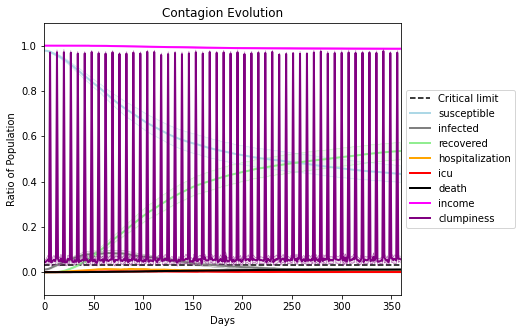

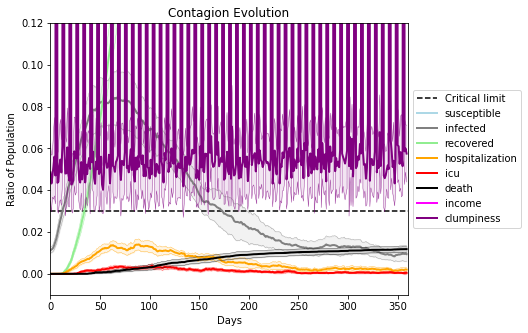

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7968, 7902, 7300, 9989, 1240, 1401, 1725, 3506, 5773, 5486, 3854, 9736, 522, 2187, 8132, 5403, 8275, 4418, 8531, 4887]
Average similarity between family members is 0.9588395055044008 at temperature -0.996
Average similarity between family and home is 0.9998500273657459 at temperature -1
Average similarity between students and their classroom is 0.6672619664321537 at temperature -0.996
Average classroom occupancy is 4.279411764705882 and number classrooms is 68
Average similarity between workers is 0.9225781283046719 at temperature -0.996
Average office occupancy is 3.3645833333333335 and number offices is 192
Average friend similarity for adults: 0.8521617635201851 for kids: 0.7057318096862595
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.562478109729583
avg restaurant similarity 0.5727799201425081
avg restaurant similarity 0.5859260873481801
avg restaurant similarity 0.6460525322679406
avg restaurant similarity 0.5867681669825578
avg restaurant similarity 0.6512960278636201
avg restaurant similarity 0.6509968250292536
avg restaurant similarity 0.5447332414532714
avg restaurant similarity 0.5674569550116704
avg restaurant similarity 0.6256972201372147
avg restaurant similarity 0.5948800115699612
avg restaurant similarity 0.582660754655121
avg restaurant similarity 0.5773314061959657
avg restaurant similarity 0.6402894689846385
avg restaurant similarity 0.5845325009668184
avg restaurant similarity 0.6113498126573381
avg restaurant similarity 0.5938279326927696
avg restaurant similarity 0.5997349411116614
avg restaurant similarity 0.6090746746282687
avg restaurant similarity 0.5979787459378657
avg restaurant similarity 0.5665926369004669
avg restaurant similarity 0.5972002199631665
avg restaura

avg restaurant similarity 0.6020118093863334
avg restaurant similarity 0.5913850986972043
avg restaurant similarity 0.6019415522479328
avg restaurant similarity 0.5942767949466837
avg restaurant similarity 0.5468110812216985
avg restaurant similarity 0.5597170000384858
avg restaurant similarity 0.5914832917215224
avg restaurant similarity 0.578713376146638
avg restaurant similarity 0.6131345137264582
avg restaurant similarity 0.6409132755192745
avg restaurant similarity 0.5923112011142652
avg restaurant similarity 0.6056395051242964
avg restaurant similarity 0.6222700017858112
avg restaurant similarity 0.552616378140486
avg restaurant similarity 0.6087836129285412
avg restaurant similarity 0.5910422044997757
avg restaurant similarity 0.5801737288314881
avg restaurant similarity 0.5762750136385015
avg restaurant similarity 0.6388158947125873
avg restaurant similarity 0.5787924004740381
avg restaurant similarity 0.6213576024534267
avg restaurant similarity 0.5890780395031698
avg restaura

avg restaurant similarity 0.6501634529437785
avg restaurant similarity 0.6729766530301512
avg restaurant similarity 0.6555453699919873
avg restaurant similarity 0.6284859885283232
avg restaurant similarity 0.6626504898771169
avg restaurant similarity 0.6615077720976172
avg restaurant similarity 0.671147889567499
avg restaurant similarity 0.6400362682078664
avg restaurant similarity 0.6170700436501505
avg restaurant similarity 0.6031206628547549
avg restaurant similarity 0.6384403965928928
avg restaurant similarity 0.6473846685539626
avg restaurant similarity 0.6729994440027801
avg restaurant similarity 0.6595047486853995
avg restaurant similarity 0.6575230665583449
avg restaurant similarity 0.6047815713345933
avg restaurant similarity 0.6633405650689672
avg restaurant similarity 0.641464860401127
avg restaurant similarity 0.6603017295619056
avg restaurant similarity 0.5976913128902699
avg restaurant similarity 0.5947273858384755
avg restaurant similarity 0.636812657916842
avg restauran

avg restaurant similarity 0.6115686185368816
avg restaurant similarity 0.608857709834221
avg restaurant similarity 0.6646819495603529
avg restaurant similarity 0.6681782418270851
avg restaurant similarity 0.6185344691719177
avg restaurant similarity 0.6087676182371324
avg restaurant similarity 0.5892082411447741
avg restaurant similarity 0.6252725822185183
avg restaurant similarity 0.6747127424254102
avg restaurant similarity 0.5879886695497598
avg restaurant similarity 0.6783533544255633
avg restaurant similarity 0.6624668956213624
avg restaurant similarity 0.6594797724731507
avg restaurant similarity 0.6351976537557376
avg restaurant similarity 0.667877847505663
avg restaurant similarity 0.6867589872575277
avg restaurant similarity 0.6651935471303195
avg restaurant similarity 0.6512697663718134
avg restaurant similarity 0.6333980560343915
avg restaurant similarity 0.6117750298530604
avg restaurant similarity 0.6855025760256513
avg restaurant similarity 0.6283999418849661
avg restaura

avg restaurant similarity 0.6307988129555836
avg restaurant similarity 0.6558799940120866
avg restaurant similarity 0.6479605225914055
avg restaurant similarity 0.5957021238565974
avg restaurant similarity 0.6107523845825029
avg restaurant similarity 0.6504333522425875
avg restaurant similarity 0.6413481943927336
avg restaurant similarity 0.6201870273502122
avg restaurant similarity 0.6438734068357729
avg restaurant similarity 0.5964267007066666
avg restaurant similarity 0.5790454419996796
avg restaurant similarity 0.6631057936377971
avg restaurant similarity 0.6064115126984191
avg restaurant similarity 0.6693489967643129
avg restaurant similarity 0.6550347270382515
avg restaurant similarity 0.6084299736414084
avg restaurant similarity 0.6345731150624108
avg restaurant similarity 0.6155755638547852
avg restaurant similarity 0.6116852966752718
avg restaurant similarity 0.6192606417213979
avg restaurant similarity 0.6265297604599077
avg restaurant similarity 0.5631674570030284
avg restau

avg restaurant similarity 0.6695869868288736
avg restaurant similarity 0.6557457480921735
avg restaurant similarity 0.6489695265300678
avg restaurant similarity 0.6262565992056948
avg restaurant similarity 0.6190454069692816
avg restaurant similarity 0.6413564776427109
avg restaurant similarity 0.6458148755172345
avg restaurant similarity 0.5908508278515467
avg restaurant similarity 0.6271290568726505
avg restaurant similarity 0.6117374709300689
avg restaurant similarity 0.6269475308123728
avg restaurant similarity 0.6167034107637217
avg restaurant similarity 0.6104682820187413
avg restaurant similarity 0.6663245225142083
avg restaurant similarity 0.5985985200065808
avg restaurant similarity 0.6446639253311826
avg restaurant similarity 0.6223718193987755
avg restaurant similarity 0.589935996491793
avg restaurant similarity 0.5601841638592081
avg restaurant similarity 0.6307416536861036
avg restaurant similarity 0.6028174769756159
avg restaurant similarity 0.6365738240940977
avg restaur

avg restaurant similarity 0.6131354611424006
avg restaurant similarity 0.5699538652599458
avg restaurant similarity 0.627476637923427
avg restaurant similarity 0.5605387890250081
avg restaurant similarity 0.6146177541717605
avg restaurant similarity 0.6264559092300913
avg restaurant similarity 0.603233964413969
avg restaurant similarity 0.5776304391866162
avg restaurant similarity 0.577798814353833
avg restaurant similarity 0.5652002407638412
avg restaurant similarity 0.6213419322687634
avg restaurant similarity 0.6129329922604558
avg restaurant similarity 0.6135594493638257
avg restaurant similarity 0.6010315683435206
avg restaurant similarity 0.5713078736739643
avg restaurant similarity 0.6362001715660999
avg restaurant similarity 0.5968463781593293
avg restaurant similarity 0.589727389072064
avg restaurant similarity 0.582652391628097
avg restaurant similarity 0.5909035164980136
avg restaurant similarity 0.6885293697426773
avg restaurant similarity 0.6192937629358057
avg restaurant 

avg restaurant similarity 0.6372313767098591
avg restaurant similarity 0.6081900190910597
avg restaurant similarity 0.594816941105449
avg restaurant similarity 0.6261361363449118
avg restaurant similarity 0.5731029913347306
avg restaurant similarity 0.6100887354533227
avg restaurant similarity 0.6348775796629792
avg restaurant similarity 0.6179227432651903
avg restaurant similarity 0.6366299229397062
avg restaurant similarity 0.5545595253841182
avg restaurant similarity 0.6479677963741953
avg restaurant similarity 0.6215363814154101
avg restaurant similarity 0.5994738660981747
avg restaurant similarity 0.5677125556292264
avg restaurant similarity 0.6452060841264475
avg restaurant similarity 0.6172671573477521
avg restaurant similarity 0.6212449053855512
avg restaurant similarity 0.601172486582571
avg restaurant similarity 0.5953527993575951
avg restaurant similarity 0.6113608814449022
avg restaurant similarity 0.6300426274589136
avg restaurant similarity 0.5698441220956194
avg restaura

avg restaurant similarity 0.6324481783858421
avg restaurant similarity 0.6329054885743969
avg restaurant similarity 0.6770007888950902
avg restaurant similarity 0.6106232446128573
avg restaurant similarity 0.5894974324199128
avg restaurant similarity 0.63374909303562
avg restaurant similarity 0.6326574464347133
avg restaurant similarity 0.6802421482675147
avg restaurant similarity 0.6153590687964317
avg restaurant similarity 0.6671901377758562
avg restaurant similarity 0.6420929908539473
avg restaurant similarity 0.6046871529189132
avg restaurant similarity 0.6463494552628052
avg restaurant similarity 0.6563559375417475
avg restaurant similarity 0.6018462848186007
avg restaurant similarity 0.6189248604650827
avg restaurant similarity 0.6002737346039262
avg restaurant similarity 0.6196140958697971
avg restaurant similarity 0.6018971658046767
avg restaurant similarity 0.6272243220844637
avg restaurant similarity 0.6180790680523844
avg restaurant similarity 0.5862049937164202
avg restaura

avg restaurant similarity 0.6548671123245486
avg restaurant similarity 0.5724397324970093
avg restaurant similarity 0.5914305472842545
avg restaurant similarity 0.6039695860230037
avg restaurant similarity 0.6127085267420551
avg restaurant similarity 0.5910964714931667
avg restaurant similarity 0.6249076305978741
avg restaurant similarity 0.6651121198164177
avg restaurant similarity 0.6631073203350464
avg restaurant similarity 0.6423121412008471
avg restaurant similarity 0.6332798980404635
avg restaurant similarity 0.6487917987111641
avg restaurant similarity 0.6347314844721443
avg restaurant similarity 0.6187729297944746
avg restaurant similarity 0.5993469578363514
avg restaurant similarity 0.5910342693192044
avg restaurant similarity 0.6596321778542188
avg restaurant similarity 0.6166593703941825
avg restaurant similarity 0.6287947150122931
avg restaurant similarity 0.5982456942304489
avg restaurant similarity 0.6247859592434685
avg restaurant similarity 0.5975094965182871
avg restau

avg restaurant similarity 0.6091807615359174
avg restaurant similarity 0.704591228917729
avg restaurant similarity 0.6431235582684468
avg restaurant similarity 0.6007065267895678
avg restaurant similarity 0.5862116843140258
avg restaurant similarity 0.5677848904098881
avg restaurant similarity 0.6765624178032278
avg restaurant similarity 0.6311403463565263
avg restaurant similarity 0.6639548843662051
avg restaurant similarity 0.6140299015134554
avg restaurant similarity 0.5997022890438902
avg restaurant similarity 0.5742627616512753
avg restaurant similarity 0.6106634419373149
avg restaurant similarity 0.7309879317393562
avg restaurant similarity 0.5796398711070223
avg restaurant similarity 0.6057420973493046
avg restaurant similarity 0.5945441734755395
avg restaurant similarity 0.6116907396916949
avg restaurant similarity 0.6384381726051416
avg restaurant similarity 0.6030461502900188
avg restaurant similarity 0.6400239808674463
avg restaurant similarity 0.5613728524359053
avg restaur

avg restaurant similarity 0.6416970441947135
avg restaurant similarity 0.6576991117697214
avg restaurant similarity 0.6590583428094925
avg restaurant similarity 0.5854618033223644
avg restaurant similarity 0.6022216367741244
avg restaurant similarity 0.6097475610567279
avg restaurant similarity 0.557153537921735
avg restaurant similarity 0.6917993917023975
avg restaurant similarity 0.6183485640924539
avg restaurant similarity 0.603060107750301
avg restaurant similarity 0.6867988457271716
avg restaurant similarity 0.6295226327154986
avg restaurant similarity 0.5492870055869831
avg restaurant similarity 0.6626512237612697
avg restaurant similarity 0.5853407592982869
avg restaurant similarity 0.6332570759284918
avg restaurant similarity 0.691998684878638
avg restaurant similarity 0.6731624726610443
avg restaurant similarity 0.587853746333479
avg restaurant similarity 0.6500799248912876
avg restaurant similarity 0.607481703251108
avg restaurant similarity 0.6669198180692733
avg restaurant 

avg restaurant similarity 0.63332326992871
avg restaurant similarity 0.6210263655059293
avg restaurant similarity 0.6003312080371478
avg restaurant similarity 0.6119686867707199
avg restaurant similarity 0.6043846808413359
avg restaurant similarity 0.6282845396575686
avg restaurant similarity 0.6158064706526951
avg restaurant similarity 0.6356637423485436
avg restaurant similarity 0.556111567873418
avg restaurant similarity 0.6232072953309551
avg restaurant similarity 0.5955275061330947
avg restaurant similarity 0.578257844951342
avg restaurant similarity 0.6379254645706369
avg restaurant similarity 0.5626292606684564
avg restaurant similarity 0.6022050332828711
avg restaurant similarity 0.5445925173374008
avg restaurant similarity 0.5856311404176913
avg restaurant similarity 0.6037256930155491
avg restaurant similarity 0.5785237053257078
avg restaurant similarity 0.6403835780715543
avg restaurant similarity 0.5946322629520078
avg restaurant similarity 0.6260267516718795
avg restaurant

avg restaurant similarity 0.6267867006078415
avg restaurant similarity 0.6650478960803566
avg restaurant similarity 0.5784851170373814
avg restaurant similarity 0.6209794698523953
avg restaurant similarity 0.664439203751628
avg restaurant similarity 0.6428139387537614
avg restaurant similarity 0.6027112059594031
avg restaurant similarity 0.5371266454873661
avg restaurant similarity 0.6281397169063782
avg restaurant similarity 0.6335449770547618
avg restaurant similarity 0.620586011340961
avg restaurant similarity 0.6141908593168798
avg restaurant similarity 0.6089331166909968
avg restaurant similarity 0.6517245053908323
avg restaurant similarity 0.5980645720457205
avg restaurant similarity 0.6086798355489313
avg restaurant similarity 0.5882587738169898
avg restaurant similarity 0.6113678076154712
avg restaurant similarity 0.5732273809774873
avg restaurant similarity 0.5884779919301552
avg restaurant similarity 0.5717087332216383
avg restaurant similarity 0.6356001700109855
avg restaura

avg restaurant similarity 0.6199008622922272
avg restaurant similarity 0.6215436790816516
avg restaurant similarity 0.5930336264293194
avg restaurant similarity 0.6179293853971337
avg restaurant similarity 0.5829165925521477
avg restaurant similarity 0.5883532532342447
avg restaurant similarity 0.5918513566211451
avg restaurant similarity 0.5814943352111213
avg restaurant similarity 0.6323592252866075
avg restaurant similarity 0.6018969059511365
avg restaurant similarity 0.5522637957493192
avg restaurant similarity 0.6029485309759877
avg restaurant similarity 0.6103452595465237
avg restaurant similarity 0.5938020709045533
avg restaurant similarity 0.5929501951627447
avg restaurant similarity 0.6417105968089907
avg restaurant similarity 0.6067736926441942
avg restaurant similarity 0.5790814583163774
avg restaurant similarity 0.551182504849328
avg restaurant similarity 0.5843726057224328
avg restaurant similarity 0.5776575188720667
avg restaurant similarity 0.577376390145671
avg restaura

avg restaurant similarity 0.6022102053910064
avg restaurant similarity 0.5988445530895415
avg restaurant similarity 0.6166005176367549
avg restaurant similarity 0.5565175445201401
avg restaurant similarity 0.6237285769822972
avg restaurant similarity 0.5921786933144012
avg restaurant similarity 0.6001467764047946
avg restaurant similarity 0.5912349157661527
avg restaurant similarity 0.5965941923007221
avg restaurant similarity 0.5562136227942005
avg restaurant similarity 0.5919520382079299
avg restaurant similarity 0.6162523437091043
avg restaurant similarity 0.5722166032934062
avg restaurant similarity 0.6037665679551103
avg restaurant similarity 0.6106195820682727
avg restaurant similarity 0.6504387618197244
avg restaurant similarity 0.6316512150290388
avg restaurant similarity 0.5997318251564099
avg restaurant similarity 0.5881529827612176
avg restaurant similarity 0.6292361011909967
avg restaurant similarity 0.6359910732600014
avg restaurant similarity 0.5973780281961909
avg restau

avg restaurant similarity 0.614454793003531
avg restaurant similarity 0.6219206973664784
avg restaurant similarity 0.5962340783328919
avg restaurant similarity 0.571694067325017
avg restaurant similarity 0.6216698245545765
avg restaurant similarity 0.6430843587582622
avg restaurant similarity 0.5823470738457945
avg restaurant similarity 0.6170720620967233
avg restaurant similarity 0.6172586076423415
avg restaurant similarity 0.5755648271451871
avg restaurant similarity 0.5681204092828693
avg restaurant similarity 0.6157384083286684
avg restaurant similarity 0.6563458627785692
avg restaurant similarity 0.6263545236150597
avg restaurant similarity 0.5746506176664067
avg restaurant similarity 0.5523241931128018
avg restaurant similarity 0.6383277811334718
avg restaurant similarity 0.5040775683262992
avg restaurant similarity 0.6099052269625191
avg restaurant similarity 0.6351822810031607
avg restaurant similarity 0.6150683885317414
avg restaurant similarity 0.5550933184983
avg restaurant 

avg restaurant similarity 0.6055713337830281
avg restaurant similarity 0.6322801693210313
avg restaurant similarity 0.5164143987527897
avg restaurant similarity 0.6244360144543746
avg restaurant similarity 0.6074824347549947
avg restaurant similarity 0.5645599188383963
avg restaurant similarity 0.6187984699587065
avg restaurant similarity 0.6304722699253622
avg restaurant similarity 0.6742590140338693
avg restaurant similarity 0.6726958474649107
avg restaurant similarity 0.5921870364713082
avg restaurant similarity 0.5773380698569857
avg restaurant similarity 0.6696772832050665
avg restaurant similarity 0.5983844834083235
avg restaurant similarity 0.527931878975167
avg restaurant similarity 0.6330019561083294
avg restaurant similarity 0.6123167432384535
avg restaurant similarity 0.616920639352716
avg restaurant similarity 0.6060710929690233
avg restaurant similarity 0.6461969772266948
avg restaurant similarity 0.6166498446013022
avg restaurant similarity 0.6059047400110811
avg restaura

avg restaurant similarity 0.565492197924182
avg restaurant similarity 0.6257081856836133
avg restaurant similarity 0.6537525628169675
avg restaurant similarity 0.6289987213670954
avg restaurant similarity 0.5921595762361962
avg restaurant similarity 0.6171514001154502
avg restaurant similarity 0.6321423467335425
avg restaurant similarity 0.5708133953338254
avg restaurant similarity 0.6278976886904
avg restaurant similarity 0.6300856250719025
avg restaurant similarity 0.5928789595663578
avg restaurant similarity 0.6984901495824675
avg restaurant similarity 0.5737267858761942
avg restaurant similarity 0.6323881900533319
avg restaurant similarity 0.6505439286543254
avg restaurant similarity 0.6105726391222078
avg restaurant similarity 0.6747978175713081
avg restaurant similarity 0.6023511158136647
avg restaurant similarity 0.6571770527406026
avg restaurant similarity 0.7027051868147497
avg restaurant similarity 0.6726461738994496
avg restaurant similarity 0.5891888037821208
avg restaurant

avg restaurant similarity 0.6604275429233651
avg restaurant similarity 0.5955995059096552
avg restaurant similarity 0.6448445905112914
avg restaurant similarity 0.6120738815579193
avg restaurant similarity 0.6172623424849027
avg restaurant similarity 0.6075182215080291
avg restaurant similarity 0.6226503047943154
avg restaurant similarity 0.635857548329936
avg restaurant similarity 0.6334524469284748
avg restaurant similarity 0.6327134090916496
avg restaurant similarity 0.628168601405283
avg restaurant similarity 0.613169354976114
avg restaurant similarity 0.6190638796541988
avg restaurant similarity 0.665584986410344
avg restaurant similarity 0.6395166002735438
avg restaurant similarity 0.644232834223167
avg restaurant similarity 0.5713525503543417
avg restaurant similarity 0.5707268323925403
avg restaurant similarity 0.6524375874016848
avg restaurant similarity 0.644813569359636
avg restaurant similarity 0.6363226755443304
avg restaurant similarity 0.6770178307000885
avg restaurant s

avg restaurant similarity 0.6442200795070853
avg restaurant similarity 0.6268338961125935
avg restaurant similarity 0.6145373019081674
avg restaurant similarity 0.6481234685753863
avg restaurant similarity 0.6358005151052384
avg restaurant similarity 0.6245353765201976
avg restaurant similarity 0.644754055746165
avg restaurant similarity 0.6267223290904518
avg restaurant similarity 0.6266067932156669
avg restaurant similarity 0.579431451018517
avg restaurant similarity 0.6045582988142691
avg restaurant similarity 0.6133664806343319
avg restaurant similarity 0.6188474722338321
avg restaurant similarity 0.6625997431942908
avg restaurant similarity 0.6040980273415936
avg restaurant similarity 0.6340249587601854
avg restaurant similarity 0.6154178332438998
avg restaurant similarity 0.6816888433757974
avg restaurant similarity 0.5929142614274728
avg restaurant similarity 0.6217188536238796
avg restaurant similarity 0.5965950124522873
avg restaurant similarity 0.6567028621892579
avg restaura

avg restaurant similarity 0.6388259160486802
avg restaurant similarity 0.5595597848870332
avg restaurant similarity 0.6296022807489782
avg restaurant similarity 0.6486314625878501
avg restaurant similarity 0.5991357637860918
avg restaurant similarity 0.6386308333097578
avg restaurant similarity 0.6560765590738348
avg restaurant similarity 0.6450727775299318
avg restaurant similarity 0.6135587343824079
avg restaurant similarity 0.6025381025858132
avg restaurant similarity 0.6322859532854476
avg restaurant similarity 0.6446085725900205
avg restaurant similarity 0.5976741595148533
avg restaurant similarity 0.6110561176536197
avg restaurant similarity 0.6297858678672766
avg restaurant similarity 0.6255738100996634
avg restaurant similarity 0.6218337630763718
avg restaurant similarity 0.6279131921021431
avg restaurant similarity 0.6432022426444304
avg restaurant similarity 0.6297948061110539
avg restaurant similarity 0.6080008036533164
avg restaurant similarity 0.592786134398913
avg restaur

avg restaurant similarity 0.635690038123044
avg restaurant similarity 0.6274963380182339
avg restaurant similarity 0.6072415943713689
avg restaurant similarity 0.6232144524476253
avg restaurant similarity 0.6509309938621534
avg restaurant similarity 0.6424823694323183
avg restaurant similarity 0.6225714566115278
avg restaurant similarity 0.5716735347739137
avg restaurant similarity 0.6296052727538848
avg restaurant similarity 0.6749021817540807
avg restaurant similarity 0.6278286864613347
avg restaurant similarity 0.636644070213451
avg restaurant similarity 0.7122461276710957
avg restaurant similarity 0.6438236971410747
avg restaurant similarity 0.624759921959037
avg restaurant similarity 0.6222762826244973
avg restaurant similarity 0.6315706028238784
avg restaurant similarity 0.6255622392097198
avg restaurant similarity 0.633628333428238
avg restaurant similarity 0.56547795258158
avg restaurant similarity 0.6162369101891095
avg restaurant similarity 0.6299211916377309
avg restaurant s

avg restaurant similarity 0.6051712359244724
avg restaurant similarity 0.6412571917082064
avg restaurant similarity 0.5746563069805949
avg restaurant similarity 0.6181876035341255
avg restaurant similarity 0.6202838750580866
avg restaurant similarity 0.6450636914567082
avg restaurant similarity 0.6234669174174101
avg restaurant similarity 0.6317974795909785
avg restaurant similarity 0.613613275976922
avg restaurant similarity 0.6026997680016788
avg restaurant similarity 0.6643807696106825
avg restaurant similarity 0.6396435157916264
avg restaurant similarity 0.6931530093180137
avg restaurant similarity 0.6402968645781428
avg restaurant similarity 0.6364024275671725
avg restaurant similarity 0.6408028542352573
avg restaurant similarity 0.6768224082138766
avg restaurant similarity 0.6173987309389388
avg restaurant similarity 0.638817238278709
avg restaurant similarity 0.6104727905076874
avg restaurant similarity 0.6092451834697096
avg restaurant similarity 0.667904390280078
avg restauran

avg restaurant similarity 0.6155117376244829
avg restaurant similarity 0.6787134003466583
avg restaurant similarity 0.659120780247593
avg restaurant similarity 0.6987691823578843
avg restaurant similarity 0.6185317483204688
avg restaurant similarity 0.6457271383187828
avg restaurant similarity 0.6201325183228106
avg restaurant similarity 0.6476250123493139
avg restaurant similarity 0.6096687819679902
avg restaurant similarity 0.6491328710768107
avg restaurant similarity 0.6576041032575647
avg restaurant similarity 0.62669302474693
avg restaurant similarity 0.6467086944615629
avg restaurant similarity 0.6457891445075583
avg restaurant similarity 0.6616181676611742
avg restaurant similarity 0.6518180892462275
avg restaurant similarity 0.6348374965794921
avg restaurant similarity 0.6038750309695594
avg restaurant similarity 0.6275759477112485
avg restaurant similarity 0.6275783421457374
avg restaurant similarity 0.6200890358514263
avg restaurant similarity 0.6555276161351754
avg restauran

avg restaurant similarity 0.6573713088570087
avg restaurant similarity 0.6349419498363916
avg restaurant similarity 0.647182515882899
avg restaurant similarity 0.6369980084956441
avg restaurant similarity 0.6350377787952223
avg restaurant similarity 0.6049668430411675
avg restaurant similarity 0.6127899373032888
avg restaurant similarity 0.6525301002082213
avg restaurant similarity 0.6321880673744961
avg restaurant similarity 0.6520857519990252
avg restaurant similarity 0.6140217023086413
avg restaurant similarity 0.642208800629236
avg restaurant similarity 0.6408489848214092
avg restaurant similarity 0.6784940228239182
avg restaurant similarity 0.6154393660020028
avg restaurant similarity 0.664225256633666
avg restaurant similarity 0.6243218502438141
avg restaurant similarity 0.625361544649975
avg restaurant similarity 0.605984339375762
avg restaurant similarity 0.6086327854888834
avg restaurant similarity 0.6642700671046153
avg restaurant similarity 0.6292078839947584
avg restaurant 

avg restaurant similarity 0.6138068307442283
avg restaurant similarity 0.6271471042569964
avg restaurant similarity 0.5808977970997731
avg restaurant similarity 0.6457912976570658
avg restaurant similarity 0.6111543797951353
avg restaurant similarity 0.561076739627586
avg restaurant similarity 0.6047023583537802
avg restaurant similarity 0.6097019911951639
avg restaurant similarity 0.6151583109459721
avg restaurant similarity 0.6266348637910816
avg restaurant similarity 0.5731221469570758
avg restaurant similarity 0.6392035566233056
avg restaurant similarity 0.6325309327765279
avg restaurant similarity 0.5785619729512983
avg restaurant similarity 0.5812598318766501
avg restaurant similarity 0.5881504100846529
avg restaurant similarity 0.5992849612455186
avg restaurant similarity 0.6114916727460543
avg restaurant similarity 0.5896309777154884
avg restaurant similarity 0.5670155108459793
avg restaurant similarity 0.5999900842794369
avg restaurant similarity 0.6337043231233697
avg restaur

avg restaurant similarity 0.615252571523481
avg restaurant similarity 0.5930492413213768
avg restaurant similarity 0.6125703950476482
avg restaurant similarity 0.623985131881725
avg restaurant similarity 0.638638243638965
avg restaurant similarity 0.6404103424669185
avg restaurant similarity 0.6113664450674068
avg restaurant similarity 0.5938940299493095
avg restaurant similarity 0.6268612405414923
avg restaurant similarity 0.6147521323925383
avg restaurant similarity 0.6052654727572896
avg restaurant similarity 0.6038729129705638
avg restaurant similarity 0.6353566595295922
avg restaurant similarity 0.6034962585240714
avg restaurant similarity 0.6396530441977086
avg restaurant similarity 0.6497669458081091
avg restaurant similarity 0.6551901024965237
avg restaurant similarity 0.5351197040004901
avg restaurant similarity 0.6420219442551774
avg restaurant similarity 0.5781984922974671
avg restaurant similarity 0.6349830351504022
avg restaurant similarity 0.5733851576474682
avg restauran

avg restaurant similarity 0.669992678728354
avg restaurant similarity 0.6619652324442329
avg restaurant similarity 0.6282330702692319
avg restaurant similarity 0.620517004095481
avg restaurant similarity 0.6496022310132886
avg restaurant similarity 0.6097943188828433
avg restaurant similarity 0.6266571021004479
avg restaurant similarity 0.606588477336429
avg restaurant similarity 0.6080972624325199
avg restaurant similarity 0.6421255973439058
avg restaurant similarity 0.6136953342636693
avg restaurant similarity 0.6076051689856655
avg restaurant similarity 0.6425804152642328
avg restaurant similarity 0.5916994742221546
avg restaurant similarity 0.6560304558995761
avg restaurant similarity 0.6059828393035924
avg restaurant similarity 0.6516126385487223
avg restaurant similarity 0.6373847003402309
avg restaurant similarity 0.6296148852335735
avg restaurant similarity 0.6041007153303254
avg restaurant similarity 0.6302601145976628
avg restaurant similarity 0.6051209500356193
avg restauran

avg restaurant similarity 0.6429910276629907
avg restaurant similarity 0.6096850588981084
avg restaurant similarity 0.5930905415142608
avg restaurant similarity 0.6903788325287287
avg restaurant similarity 0.6120767477337418
avg restaurant similarity 0.6083762572282357
avg restaurant similarity 0.6143964680481067
avg restaurant similarity 0.6206328964636589
avg restaurant similarity 0.619888039005367
avg restaurant similarity 0.6076016127196912
avg restaurant similarity 0.6283383829987725
avg restaurant similarity 0.6944875517895293
avg restaurant similarity 0.6027857019242772
avg restaurant similarity 0.6769767591195182
avg restaurant similarity 0.6042525446729174
avg restaurant similarity 0.6086362465480395
avg restaurant similarity 0.6338311298868974
avg restaurant similarity 0.6969733101552589
avg restaurant similarity 0.6389953949412085
avg restaurant similarity 0.7016923192479105
avg restaurant similarity 0.5880296828004543
avg restaurant similarity 0.6279502221239399
avg restaur

avg restaurant similarity 0.5845913795569521
avg restaurant similarity 0.6285733357018379
avg restaurant similarity 0.5994275326459442
avg restaurant similarity 0.5693963247124549
avg restaurant similarity 0.6026678359925126
avg restaurant similarity 0.578531249913726
avg restaurant similarity 0.5960913405360948
avg restaurant similarity 0.6323743273391655
avg restaurant similarity 0.5672906005082453
avg restaurant similarity 0.5539052870458099
avg restaurant similarity 0.5684760260756503
avg restaurant similarity 0.6461333130127499
avg restaurant similarity 0.5808672969420787
avg restaurant similarity 0.6127797084675457
avg restaurant similarity 0.5638746782621658
avg restaurant similarity 0.5762627523509136
avg restaurant similarity 0.5903629264514376
avg restaurant similarity 0.6290809153134105
avg restaurant similarity 0.6530955947862424
avg restaurant similarity 0.597245426745124
avg restaurant similarity 0.5866832734510158
avg restaurant similarity 0.6163711774569859
avg restaura

avg restaurant similarity 0.6122832636131188
avg restaurant similarity 0.5255158889896747
avg restaurant similarity 0.5772570044384205
avg restaurant similarity 0.5543912854352712
avg restaurant similarity 0.5850761229120139
avg restaurant similarity 0.5475380558397029
avg restaurant similarity 0.6034735296850476
avg restaurant similarity 0.5757574143950024
avg restaurant similarity 0.5848958081406177
avg restaurant similarity 0.6365360474859482
avg restaurant similarity 0.6228234416101246
avg restaurant similarity 0.5948066930429059
avg restaurant similarity 0.5882118928511687
avg restaurant similarity 0.6154885080922547
avg restaurant similarity 0.5582104044012792
avg restaurant similarity 0.5351447194987085
avg restaurant similarity 0.5604671925905453
avg restaurant similarity 0.6066277165593368
avg restaurant similarity 0.6035279685949675
avg restaurant similarity 0.6328993546867901
avg restaurant similarity 0.6007101643407224
avg restaurant similarity 0.5989680297884782
avg restau

avg restaurant similarity 0.6184792215207819
avg restaurant similarity 0.5974130767160305
avg restaurant similarity 0.5952311051021821
avg restaurant similarity 0.5455182722026917
avg restaurant similarity 0.5670793165308748
avg restaurant similarity 0.6371260728288707
avg restaurant similarity 0.5951743607486691
avg restaurant similarity 0.5975637182710978
avg restaurant similarity 0.5788431897217943
avg restaurant similarity 0.6440417051827277
avg restaurant similarity 0.610233305162965
avg restaurant similarity 0.619281338104477
avg restaurant similarity 0.6040306891213575
avg restaurant similarity 0.5504298697379741
avg restaurant similarity 0.5794574661714265
avg restaurant similarity 0.59068373527497
avg restaurant similarity 0.5998356173871253
avg restaurant similarity 0.6155632902980004
avg restaurant similarity 0.5281135942867846
avg restaurant similarity 0.599279789591053
avg restaurant similarity 0.6103550848317737
avg restaurant similarity 0.6348614179419272
avg restaurant 

avg restaurant similarity 0.6441812147051139
avg restaurant similarity 0.5946413371534097
avg restaurant similarity 0.6028626447598119
avg restaurant similarity 0.6444993643344694
avg restaurant similarity 0.612772619846402
avg restaurant similarity 0.5926828412859363
avg restaurant similarity 0.6023998461003356
avg restaurant similarity 0.6243287474553854
avg restaurant similarity 0.6525010550871957
avg restaurant similarity 0.6169733745159564
avg restaurant similarity 0.5660500952373184
avg restaurant similarity 0.6212270798216928
avg restaurant similarity 0.6562232667575563
avg restaurant similarity 0.6123294442252502
avg restaurant similarity 0.5935766733579119
avg restaurant similarity 0.5664580959915301
avg restaurant similarity 0.5935534315566823
avg restaurant similarity 0.5935096697198362
avg restaurant similarity 0.6409158105743266
avg restaurant similarity 0.6208397216016823
avg restaurant similarity 0.6041039273851554
avg restaurant similarity 0.6011170086543086
avg restaur

avg restaurant similarity 0.6884514496409447
avg restaurant similarity 0.6170492663197341
avg restaurant similarity 0.7074380302619298
avg restaurant similarity 0.7105567090248333
avg restaurant similarity 0.6500544414196054
avg restaurant similarity 0.6384869354221631
avg restaurant similarity 0.6177602559307245
avg restaurant similarity 0.6649963751320667
avg restaurant similarity 0.6539260301709182
avg restaurant similarity 0.636346865288174
avg restaurant similarity 0.6855098033744981
avg restaurant similarity 0.6987480217934529
avg restaurant similarity 0.6414232364960556
avg restaurant similarity 0.6278453130530351
avg restaurant similarity 0.7345800478458699
avg restaurant similarity 0.6486397821443267
avg restaurant similarity 0.655050643931825
avg restaurant similarity 0.6788834512842712
avg restaurant similarity 0.6654690453168836
avg restaurant similarity 0.6325825328963953
avg restaurant similarity 0.6446719532239858
avg restaurant similarity 0.6475950319115682
avg restaura

avg restaurant similarity 0.6382655527742046
avg restaurant similarity 0.6695998117605544
avg restaurant similarity 0.6744199191382613
avg restaurant similarity 0.6588954123383158
avg restaurant similarity 0.6772050018178826
avg restaurant similarity 0.5997687851925315
avg restaurant similarity 0.6208770421756085
avg restaurant similarity 0.659189111260107
avg restaurant similarity 0.6263058008375818
avg restaurant similarity 0.6227483643179609
avg restaurant similarity 0.6810660914565612
avg restaurant similarity 0.6255012686827166
avg restaurant similarity 0.672955056027342
avg restaurant similarity 0.7043402712951947
avg restaurant similarity 0.6880657363171679
avg restaurant similarity 0.5892999261164297
avg restaurant similarity 0.6117699968573106
avg restaurant similarity 0.6100294176637797
avg restaurant similarity 0.6299611482581834
avg restaurant similarity 0.6576022569006083
avg restaurant similarity 0.6867121077876155
avg restaurant similarity 0.6594226433432389
avg restaura

avg restaurant similarity 0.5871791848508531
avg restaurant similarity 0.6567219834783862
avg restaurant similarity 0.6145854558345725
avg restaurant similarity 0.6804912620353795
avg restaurant similarity 0.6720062928401691
avg restaurant similarity 0.6344590845387477
avg restaurant similarity 0.5928904918864107
avg restaurant similarity 0.5410823339432902
avg restaurant similarity 0.654811381100115
avg restaurant similarity 0.6780912857549367
avg restaurant similarity 0.5925361760138934
avg restaurant similarity 0.6426320437073362
avg restaurant similarity 0.678628234401157
avg restaurant similarity 0.640680702063623
avg restaurant similarity 0.6411812185198188
avg restaurant similarity 0.5889149210359532
avg restaurant similarity 0.5871528820507662
avg restaurant similarity 0.6009203403025191
avg restaurant similarity 0.6291212627921056
avg restaurant similarity 0.7088584641924147
avg restaurant similarity 0.5973523018721523
avg restaurant similarity 0.6393874730817446
avg restauran

avg restaurant similarity 0.5959168489130848
avg restaurant similarity 0.6347404180628456
avg restaurant similarity 0.6672866807911543
avg restaurant similarity 0.6028491557021696
avg restaurant similarity 0.6304293698717344
avg restaurant similarity 0.6237427932122445
avg restaurant similarity 0.6525443499456608
avg restaurant similarity 0.5901014900452489
avg restaurant similarity 0.6032473358340994
avg restaurant similarity 0.6701202095148047
avg restaurant similarity 0.6567043620927564
avg restaurant similarity 0.6052259459823238
avg restaurant similarity 0.6085782047807801
avg restaurant similarity 0.5294922345391815
avg restaurant similarity 0.6245076121775793
avg restaurant similarity 0.610281587062049
avg restaurant similarity 0.6385618997700032
avg restaurant similarity 0.5502952773717322
avg restaurant similarity 0.5784121777151215
avg restaurant similarity 0.6322015698577728
avg restaurant similarity 0.5956378864554235
avg restaurant similarity 0.616367573259105
avg restaura

avg restaurant similarity 0.6068846880078039
avg restaurant similarity 0.6726856025074075
avg restaurant similarity 0.6704688939381299
avg restaurant similarity 0.6677572770568286
avg restaurant similarity 0.5668934898289326
avg restaurant similarity 0.6332973413718767
avg restaurant similarity 0.6593581663032708
avg restaurant similarity 0.6273945624149347
avg restaurant similarity 0.6225522043173677
avg restaurant similarity 0.6022127112755702
avg restaurant similarity 0.5958044698469652
avg restaurant similarity 0.6342449660430136
avg restaurant similarity 0.6837295558629964
avg restaurant similarity 0.6332210863300121
avg restaurant similarity 0.6013555487960759
avg restaurant similarity 0.5974090152841527
avg restaurant similarity 0.6040026342804926
avg restaurant similarity 0.5872927405190889
avg restaurant similarity 0.6185198198301101
avg restaurant similarity 0.6473267195532844
avg restaurant similarity 0.5856705499992229
avg restaurant similarity 0.6270911509204267
avg restau

avg restaurant similarity 0.5951224185046167
avg restaurant similarity 0.6542489166854522
avg restaurant similarity 0.6495611802726956
avg restaurant similarity 0.6112807439642454
avg restaurant similarity 0.6276877693597016
avg restaurant similarity 0.6142620063318622
avg restaurant similarity 0.6592304123878671
avg restaurant similarity 0.5969310963239863
avg restaurant similarity 0.6706027990237419
avg restaurant similarity 0.5784258039667627
avg restaurant similarity 0.6549713624149122
avg restaurant similarity 0.597972471604842
avg restaurant similarity 0.664097890426075
avg restaurant similarity 0.6373739979786108
avg restaurant similarity 0.6570999906828068
avg restaurant similarity 0.6304634143468558
avg restaurant similarity 0.6355604380474638
avg restaurant similarity 0.609933312102521
avg restaurant similarity 0.6600792769612284
avg restaurant similarity 0.6250475050294774
avg restaurant similarity 0.6488396044376327
avg restaurant similarity 0.6406350547509795
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

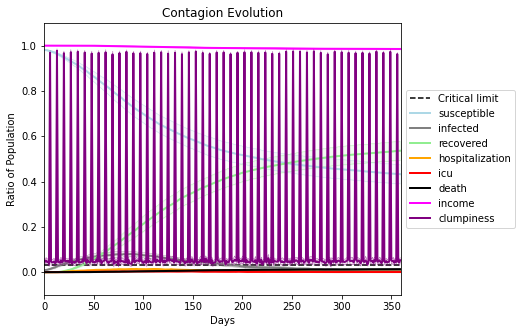

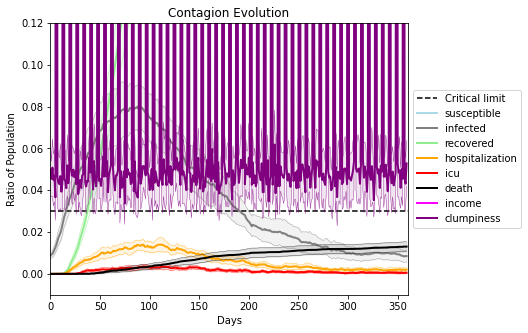

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1151, 5894, 4562, 2863, 4617, 2106, 3423, 4518, 7280, 211, 8243, 5061, 2109, 3354, 7828, 6681, 3132, 5579, 2956, 5828]
Average similarity between family members is 0.9350864997114338 at temperature -0.995
Average similarity between family and home is 0.9998500304993787 at temperature -1
Average similarity between students and their classroom is 0.5670218618972028 at temperature -0.995
Average classroom occupancy is 4.071428571428571 and number classrooms is 70
Average similarity between workers is 0.9049420023721765 at temperature -0.995
Average office occupancy is 3.417525773195876 and number offices is 194
Average friend similarity for adults: 0.8566023334383049 for kids: 0.6751126707397049
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.6529735877010201
avg restaurant similarity 0.5451375767634633
avg restaurant similarity 0.6397309151509669
avg restaurant similarity 0.5779769799832264
avg restaurant similarity 0.5709317431074271
avg restaurant similarity 0.6026921348358586
avg restaurant similarity 0.61744574430797
avg restaurant similarity 0.5954129241959758
avg restaurant similarity 0.5343539811124342
avg restaurant similarity 0.6527600507382176
avg restaurant similarity 0.5984762276124314
avg restaurant similarity 0.5949256911268369
avg restaurant similarity 0.6466095643984271
avg restaurant similarity 0.5176231219797727
avg restaurant similarity 0.5767055735606867
avg restaurant similarity 0.6028895111338987
avg restaurant similarity 0.6855918893311032
avg restaurant similarity 0.5750285118631735
avg restaurant similarity 0.65838223740998
avg restaurant similarity 0.5954153389813502
avg restaurant similarity 0.5922724000506066
avg restaurant similarity 0.5971234640358348
avg restaurant

avg restaurant similarity 0.6102288613706269
avg restaurant similarity 0.5313581465090039
avg restaurant similarity 0.6144989449443202
avg restaurant similarity 0.607540915623647
avg restaurant similarity 0.6495462987497567
avg restaurant similarity 0.6535063089273916
avg restaurant similarity 0.5382663489564516
avg restaurant similarity 0.5176171672296467
avg restaurant similarity 0.5526347390361332
avg restaurant similarity 0.5628702709289972
avg restaurant similarity 0.5990023040335957
avg restaurant similarity 0.5558802525875695
avg restaurant similarity 0.5769500578721292
avg restaurant similarity 0.6130969239083428
avg restaurant similarity 0.5433526694975326
avg restaurant similarity 0.5775652528425221
avg restaurant similarity 0.6423349499381175
avg restaurant similarity 0.6248096506998245
avg restaurant similarity 0.5816159365071274
avg restaurant similarity 0.5849464890443349
avg restaurant similarity 0.5934257594801922
avg restaurant similarity 0.6119232454098211
avg restaur

avg restaurant similarity 0.5391900238571454
avg restaurant similarity 0.5003186964233729
avg restaurant similarity 0.5801565289221986
avg restaurant similarity 0.5366904441628431
avg restaurant similarity 0.567947580422978
avg restaurant similarity 0.5306341109763982
avg restaurant similarity 0.5728489614224381
avg restaurant similarity 0.5750734952772277
avg restaurant similarity 0.6102015321023764
avg restaurant similarity 0.5377200063391621
avg restaurant similarity 0.5729761750270138
avg restaurant similarity 0.5534568681216762
avg restaurant similarity 0.5486478967482761
avg restaurant similarity 0.6393596181471638
avg restaurant similarity 0.5970794471915598
avg restaurant similarity 0.6183464512431187
avg restaurant similarity 0.5479556792644843
avg restaurant similarity 0.5594905379390736
avg restaurant similarity 0.6084089298804708
avg restaurant similarity 0.6203527357782479
avg restaurant similarity 0.6122877064532519
avg restaurant similarity 0.6006978107880097
avg restaur

avg restaurant similarity 0.5972221187111797
avg restaurant similarity 0.5560021260911533
avg restaurant similarity 0.5502913459697044
avg restaurant similarity 0.6083005135759598
avg restaurant similarity 0.5969014593744106
avg restaurant similarity 0.6054364956945776
avg restaurant similarity 0.6048142164079315
avg restaurant similarity 0.5813488426777083
avg restaurant similarity 0.5463534625383402
avg restaurant similarity 0.648023458219377
avg restaurant similarity 0.6048261513913199
avg restaurant similarity 0.5695295581479116
avg restaurant similarity 0.555119232823866
avg restaurant similarity 0.549115268444642
avg restaurant similarity 0.5404684866830461
avg restaurant similarity 0.603636169722393
avg restaurant similarity 0.5587512610518514
avg restaurant similarity 0.5723348839184729
avg restaurant similarity 0.5492582739484279
avg restaurant similarity 0.5643847302386858
avg restaurant similarity 0.5593505600278454
avg restaurant similarity 0.6041023073824571
avg restaurant

avg restaurant similarity 0.5977167967247284
avg restaurant similarity 0.5812778340896928
avg restaurant similarity 0.5763796588901956
avg restaurant similarity 0.5836704608208252
avg restaurant similarity 0.6327314579469578
avg restaurant similarity 0.6442374037447253
avg restaurant similarity 0.6307828269789664
avg restaurant similarity 0.6216856744924182
avg restaurant similarity 0.5683879910460489
avg restaurant similarity 0.6045983925811979
avg restaurant similarity 0.576193823879021
avg restaurant similarity 0.5819566183036878
avg restaurant similarity 0.5890918192124641
avg restaurant similarity 0.5908062686123409
avg restaurant similarity 0.5738706804917447
avg restaurant similarity 0.6025036167489034
avg restaurant similarity 0.5966988738311693
avg restaurant similarity 0.5842811995583376
avg restaurant similarity 0.5818908549330947
avg restaurant similarity 0.6193133828601466
avg restaurant similarity 0.5867384694081955
avg restaurant similarity 0.6482299000606488
avg restaur

avg restaurant similarity 0.5180504310918255
avg restaurant similarity 0.5680795816443095
avg restaurant similarity 0.6246135293331444
avg restaurant similarity 0.6240911749239264
avg restaurant similarity 0.5740057655751467
avg restaurant similarity 0.5717365411474125
avg restaurant similarity 0.6049526166749898
avg restaurant similarity 0.5877741231785273
avg restaurant similarity 0.5721882217055393
avg restaurant similarity 0.5945757900455818
avg restaurant similarity 0.5975447369218406
avg restaurant similarity 0.6210982657143242
avg restaurant similarity 0.596453283461957
avg restaurant similarity 0.630554922804039
avg restaurant similarity 0.5836145780514268
avg restaurant similarity 0.5945766528817417
avg restaurant similarity 0.625883047256348
avg restaurant similarity 0.5844112095439639
avg restaurant similarity 0.5744770501798183
avg restaurant similarity 0.5919088720575213
avg restaurant similarity 0.6113822071686313
avg restaurant similarity 0.5910853180354119
avg restauran

avg restaurant similarity 0.6257514221357945
avg restaurant similarity 0.5738172622616796
avg restaurant similarity 0.5100206170182545
avg restaurant similarity 0.616226955748
avg restaurant similarity 0.5913303841303311
avg restaurant similarity 0.5353925625956265
avg restaurant similarity 0.612300503638875
avg restaurant similarity 0.5077387573082611
avg restaurant similarity 0.5375737183025229
avg restaurant similarity 0.5588525170492762
avg restaurant similarity 0.569483573458516
avg restaurant similarity 0.5072827643130108
avg restaurant similarity 0.5692608529421445
avg restaurant similarity 0.5258563300089907
avg restaurant similarity 0.5848323298291564
avg restaurant similarity 0.571184758555092
avg restaurant similarity 0.5491071680743702
avg restaurant similarity 0.6002666613974931
avg restaurant similarity 0.5738681763420042
avg restaurant similarity 0.5335476463842567
avg restaurant similarity 0.5623299182126374
avg restaurant similarity 0.5896342351180124
avg restaurant si

avg restaurant similarity 0.6320268294346502
avg restaurant similarity 0.5839547131881263
avg restaurant similarity 0.6088512520136465
avg restaurant similarity 0.5887409577146718
avg restaurant similarity 0.5689975648230223
avg restaurant similarity 0.5735510064660894
avg restaurant similarity 0.554788401656286
avg restaurant similarity 0.5985404705422109
avg restaurant similarity 0.6179829554075517
avg restaurant similarity 0.5495241979615291
avg restaurant similarity 0.574873232191438
avg restaurant similarity 0.6080396899419876
avg restaurant similarity 0.6240953555679548
avg restaurant similarity 0.5829628375471502
avg restaurant similarity 0.6123135458904547
avg restaurant similarity 0.5408213037622641
avg restaurant similarity 0.5477551862942294
avg restaurant similarity 0.5708283920302087
avg restaurant similarity 0.6209073940842141
avg restaurant similarity 0.5867643203268483
avg restaurant similarity 0.5900733437595062
avg restaurant similarity 0.6528792006325896
avg restaura

avg restaurant similarity 0.6288312177854022
avg restaurant similarity 0.5903211346183944
avg restaurant similarity 0.5953500520670365
avg restaurant similarity 0.6003996395841699
avg restaurant similarity 0.548240195241574
avg restaurant similarity 0.5826439696800475
avg restaurant similarity 0.6618140301950962
avg restaurant similarity 0.6196489227273926
avg restaurant similarity 0.6458655583425654
avg restaurant similarity 0.593233317677649
avg restaurant similarity 0.5790251163350328
avg restaurant similarity 0.6512303113028962
avg restaurant similarity 0.5471974080970435
avg restaurant similarity 0.5920253614201291
avg restaurant similarity 0.6418163438331567
avg restaurant similarity 0.5501084451524436
avg restaurant similarity 0.5603278199668856
avg restaurant similarity 0.6297683968864952
avg restaurant similarity 0.624175062083454
avg restaurant similarity 0.6285471827223035
avg restaurant similarity 0.6301227191732858
avg restaurant similarity 0.5104480660049472
avg restauran

avg restaurant similarity 0.5993063110877286
avg restaurant similarity 0.5604070607561258
avg restaurant similarity 0.6120474203712285
avg restaurant similarity 0.6281584848011117
avg restaurant similarity 0.5794911802366716
avg restaurant similarity 0.49717385786286156
avg restaurant similarity 0.5833621549713497
avg restaurant similarity 0.5562549213620019
avg restaurant similarity 0.6551239852142432
avg restaurant similarity 0.6510289693714152
avg restaurant similarity 0.5812658105778916
avg restaurant similarity 0.6286952397546286
avg restaurant similarity 0.6043453027409053
avg restaurant similarity 0.5618172777192771
avg restaurant similarity 0.5481485555595763
avg restaurant similarity 0.601100702868901
avg restaurant similarity 0.6459672324649366
avg restaurant similarity 0.5923683303255836
avg restaurant similarity 0.6262067142625003
avg restaurant similarity 0.5697342923960477
avg restaurant similarity 0.6017699486861436
avg restaurant similarity 0.5578121817907267
avg restau

avg restaurant similarity 0.5616380192389081
avg restaurant similarity 0.5808966003262378
avg restaurant similarity 0.6422497653199135
avg restaurant similarity 0.6414512101994683
avg restaurant similarity 0.5987650767873232
avg restaurant similarity 0.6281121054987215
avg restaurant similarity 0.5902904918823683
avg restaurant similarity 0.5780096982373043
avg restaurant similarity 0.5676337607023442
avg restaurant similarity 0.6288461325845668
avg restaurant similarity 0.6377683666418134
avg restaurant similarity 0.6004333957341174
avg restaurant similarity 0.6386195048106489
avg restaurant similarity 0.6132583884108336
avg restaurant similarity 0.5595787047086865
avg restaurant similarity 0.6269119388453582
avg restaurant similarity 0.5818497581374718
avg restaurant similarity 0.5964396031595448
avg restaurant similarity 0.6257019633486999
avg restaurant similarity 0.6139586246131903
avg restaurant similarity 0.626846849845876
avg restaurant similarity 0.5821665336060532
avg restaur

avg restaurant similarity 0.6244083801162488
avg restaurant similarity 0.6467807558724661
avg restaurant similarity 0.6165155482798392
avg restaurant similarity 0.5665316096963064
avg restaurant similarity 0.5955189971133872
avg restaurant similarity 0.5854800490707807
avg restaurant similarity 0.6078677793845088
avg restaurant similarity 0.5872789498421236
avg restaurant similarity 0.6471155704623242
avg restaurant similarity 0.6186829324207518
avg restaurant similarity 0.5482199384897418
avg restaurant similarity 0.5700380198966835
avg restaurant similarity 0.5944452690758926
avg restaurant similarity 0.5588099735351123
avg restaurant similarity 0.6023064957628481
avg restaurant similarity 0.5731614404815008
avg restaurant similarity 0.636249341732417
avg restaurant similarity 0.605140762798586
avg restaurant similarity 0.6271688300543906
avg restaurant similarity 0.5642478061838133
avg restaurant similarity 0.5688977495134215
avg restaurant similarity 0.6097428958236824
avg restaura

avg restaurant similarity 0.5496496452194637
avg restaurant similarity 0.5286037800993523
avg restaurant similarity 0.6433039658680068
avg restaurant similarity 0.5617409573161078
avg restaurant similarity 0.5773892288245193
avg restaurant similarity 0.5555011552149429
avg restaurant similarity 0.5946824763306304
avg restaurant similarity 0.589741898737411
avg restaurant similarity 0.5284937292820566
avg restaurant similarity 0.5672048294911841
avg restaurant similarity 0.5866300130006421
avg restaurant similarity 0.5743654655588756
avg restaurant similarity 0.5869593959238231
avg restaurant similarity 0.6060486254467622
avg restaurant similarity 0.5495076351867455
avg restaurant similarity 0.5868238756913339
avg restaurant similarity 0.5637163372162999
avg restaurant similarity 0.5791727128369882
avg restaurant similarity 0.5657481595099475
avg restaurant similarity 0.5248013583439144
avg restaurant similarity 0.576802766672655
avg restaurant similarity 0.5697530002699375
avg restaura

avg restaurant similarity 0.5717459645032109
avg restaurant similarity 0.568099075274837
avg restaurant similarity 0.533862141647971
avg restaurant similarity 0.5926921112073305
avg restaurant similarity 0.5295934382763103
avg restaurant similarity 0.5915115611811267
avg restaurant similarity 0.598014350566455
avg restaurant similarity 0.6141999038311021
avg restaurant similarity 0.5335714696442546
avg restaurant similarity 0.5618682438155804
avg restaurant similarity 0.5820495897846872
avg restaurant similarity 0.6190261838253653
avg restaurant similarity 0.5841922746665719
avg restaurant similarity 0.5374014461689611
avg restaurant similarity 0.5579292922483643
avg restaurant similarity 0.6125634288040287
avg restaurant similarity 0.5723081200985947
avg restaurant similarity 0.5913102494052499
avg restaurant similarity 0.5323891677675717
avg restaurant similarity 0.5277521294581724
avg restaurant similarity 0.5580936140064977
avg restaurant similarity 0.5884831129436116
avg restauran

avg restaurant similarity 0.6206561319475947
avg restaurant similarity 0.5517025313107691
avg restaurant similarity 0.5724612858277685
avg restaurant similarity 0.6120282160213656
avg restaurant similarity 0.6271969847429157
avg restaurant similarity 0.5738256041252343
avg restaurant similarity 0.6189691800487245
avg restaurant similarity 0.6120234293058229
avg restaurant similarity 0.5672361970894068
avg restaurant similarity 0.5810888063291844
avg restaurant similarity 0.5654130835284847
avg restaurant similarity 0.6313649043318704
avg restaurant similarity 0.6231034674478096
avg restaurant similarity 0.5559537018845429
avg restaurant similarity 0.6318802397783323
avg restaurant similarity 0.6581519173595449
avg restaurant similarity 0.6987928804138379
avg restaurant similarity 0.6457120751896435
avg restaurant similarity 0.5620595382259925
avg restaurant similarity 0.5965303308178773
avg restaurant similarity 0.5872208771300261
avg restaurant similarity 0.6663164580931997
avg restau

avg restaurant similarity 0.6091086036123171
avg restaurant similarity 0.6313451843334202
avg restaurant similarity 0.6294675024977483
avg restaurant similarity 0.6078716620988355
avg restaurant similarity 0.604513483549855
avg restaurant similarity 0.6179685145010114
avg restaurant similarity 0.5922134569038113
avg restaurant similarity 0.6051264306380757
avg restaurant similarity 0.665873639099381
avg restaurant similarity 0.6021362063770939
avg restaurant similarity 0.5916400094208986
avg restaurant similarity 0.632599948297006
avg restaurant similarity 0.663586885673271
avg restaurant similarity 0.5663303676622171
avg restaurant similarity 0.6406782343402524
avg restaurant similarity 0.6057243082816841
avg restaurant similarity 0.5627948451964069
avg restaurant similarity 0.6162922359840056
avg restaurant similarity 0.6186003766919844
avg restaurant similarity 0.5472391331791161
avg restaurant similarity 0.617552515606292
avg restaurant similarity 0.6051631794180488
avg restaurant 

avg restaurant similarity 0.5887611684452867
avg restaurant similarity 0.5804608793162812
avg restaurant similarity 0.6015744225460933
avg restaurant similarity 0.5862732148109436
avg restaurant similarity 0.5604938110731332
avg restaurant similarity 0.5803097346643143
avg restaurant similarity 0.6156469342461598
avg restaurant similarity 0.5904910634191842
avg restaurant similarity 0.6035060384097924
avg restaurant similarity 0.5655358891331809
avg restaurant similarity 0.5985582594452509
avg restaurant similarity 0.5506355586967503
avg restaurant similarity 0.6097688782798659
avg restaurant similarity 0.5768963849132037
avg restaurant similarity 0.6263056075102508
avg restaurant similarity 0.5884932170604082
avg restaurant similarity 0.5972926072842878
avg restaurant similarity 0.545677154517165
avg restaurant similarity 0.5824190578386094
avg restaurant similarity 0.5781060738809851
avg restaurant similarity 0.5686044365687405
avg restaurant similarity 0.6278924723378662
avg restaur

avg restaurant similarity 0.5844877067590696
avg restaurant similarity 0.5964281166310832
avg restaurant similarity 0.5847426839260174
avg restaurant similarity 0.5301862379016108
avg restaurant similarity 0.588030773800156
avg restaurant similarity 0.5583663994721175
avg restaurant similarity 0.597469846476345
avg restaurant similarity 0.5294067488541477
avg restaurant similarity 0.5738491196527221
avg restaurant similarity 0.6095257441691919
avg restaurant similarity 0.5777853362105909
avg restaurant similarity 0.5562810604482549
avg restaurant similarity 0.5736803662118698
avg restaurant similarity 0.5794662351269957
avg restaurant similarity 0.5986329581993713
avg restaurant similarity 0.5580498885187115
avg restaurant similarity 0.5449749027439926
avg restaurant similarity 0.5322722980260705
avg restaurant similarity 0.5764261875521832
avg restaurant similarity 0.6069911629088215
avg restaurant similarity 0.6089788506192466
avg restaurant similarity 0.6028075509057065
avg restaura

avg restaurant similarity 0.5713866638269377
avg restaurant similarity 0.5877399919086276
avg restaurant similarity 0.5736016778148948
avg restaurant similarity 0.5831506528472864
avg restaurant similarity 0.6056023929684093
avg restaurant similarity 0.5780842822803719
avg restaurant similarity 0.6204217601360981
avg restaurant similarity 0.6101187284474033
avg restaurant similarity 0.565323918367969
avg restaurant similarity 0.552468691407162
avg restaurant similarity 0.6208893249134991
avg restaurant similarity 0.5262274749891402
avg restaurant similarity 0.5518326808428848
avg restaurant similarity 0.5710809644755888
avg restaurant similarity 0.6726433874167721
avg restaurant similarity 0.6488915818666845
avg restaurant similarity 0.5645762504418981
avg restaurant similarity 0.5948220341615463
avg restaurant similarity 0.5586200238656565
avg restaurant similarity 0.5854912247107137
avg restaurant similarity 0.5770007507782305
avg restaurant similarity 0.5539484648669224
avg restaura

avg restaurant similarity 0.5379955785805509
avg restaurant similarity 0.5703784628750711
avg restaurant similarity 0.5820672101362839
avg restaurant similarity 0.5706104022938461
avg restaurant similarity 0.5829908472098653
avg restaurant similarity 0.6154713592463308
avg restaurant similarity 0.578509414408034
avg restaurant similarity 0.570088692730485
avg restaurant similarity 0.5384984421256261
avg restaurant similarity 0.63157397156659
avg restaurant similarity 0.5386504446758562
avg restaurant similarity 0.5849008492752454
avg restaurant similarity 0.5388375630059825
avg restaurant similarity 0.5326037520866985
avg restaurant similarity 0.5401515405118048
avg restaurant similarity 0.5716021517825481
avg restaurant similarity 0.530376316711853
avg restaurant similarity 0.5492860756406838
avg restaurant similarity 0.6053842868785488
avg restaurant similarity 0.5538279694093364
avg restaurant similarity 0.5827722879696023
avg restaurant similarity 0.5828855411640071
avg restaurant 

avg restaurant similarity 0.5832195931205799
avg restaurant similarity 0.5696138822999636
avg restaurant similarity 0.6316661192085552
avg restaurant similarity 0.5430197074217806
avg restaurant similarity 0.6034531042991748
avg restaurant similarity 0.6161589777349225
avg restaurant similarity 0.5545561080110454
avg restaurant similarity 0.5536271303983958
avg restaurant similarity 0.5459370086579616
avg restaurant similarity 0.6138709123814199
avg restaurant similarity 0.5304301733727791
avg restaurant similarity 0.545379023839805
avg restaurant similarity 0.5740961976645075
avg restaurant similarity 0.5331454337489112
avg restaurant similarity 0.6343656124831646
avg restaurant similarity 0.543353734070451
avg restaurant similarity 0.6444102384647303
avg restaurant similarity 0.5671517979851054
avg restaurant similarity 0.6032941413647342
avg restaurant similarity 0.5505620488532843
avg restaurant similarity 0.5960058887359083
avg restaurant similarity 0.6532076525986185
avg restaura

avg restaurant similarity 0.6180995234018783
avg restaurant similarity 0.6142720204709354
avg restaurant similarity 0.5861713325736865
avg restaurant similarity 0.5870657851640257
avg restaurant similarity 0.5646790193811962
avg restaurant similarity 0.5249840138116342
avg restaurant similarity 0.5702460639314586
avg restaurant similarity 0.5751925703874309
avg restaurant similarity 0.5759390845711897
avg restaurant similarity 0.6208048155402779
avg restaurant similarity 0.5873203016635644
avg restaurant similarity 0.5931574154347323
avg restaurant similarity 0.5163349063498932
avg restaurant similarity 0.5430646975238478
avg restaurant similarity 0.5703988485889196
avg restaurant similarity 0.5366650973808952
avg restaurant similarity 0.5267500333441287
avg restaurant similarity 0.5549833987924286
avg restaurant similarity 0.5768942507835878
avg restaurant similarity 0.5578632728844536
avg restaurant similarity 0.5867819355824085
avg restaurant similarity 0.6073730385830111
avg restau

avg restaurant similarity 0.5414693040143971
avg restaurant similarity 0.5480692376136911
avg restaurant similarity 0.552577724522928
avg restaurant similarity 0.6018274059671906
avg restaurant similarity 0.5773705125196885
avg restaurant similarity 0.5666191809987069
avg restaurant similarity 0.6300771170754984
avg restaurant similarity 0.572711142575575
avg restaurant similarity 0.5537883425295916
avg restaurant similarity 0.5699964266745218
avg restaurant similarity 0.5604193849855907
avg restaurant similarity 0.5458351370765429
avg restaurant similarity 0.5393300889532753
avg restaurant similarity 0.5877106388489419
avg restaurant similarity 0.617951915028903
avg restaurant similarity 0.5697366608783928
avg restaurant similarity 0.5892619604216579
avg restaurant similarity 0.5863222674458066
avg restaurant similarity 0.5998434438015612
avg restaurant similarity 0.6558952686250995
avg restaurant similarity 0.5337094695788029
avg restaurant similarity 0.5665398206483708
avg restauran

avg restaurant similarity 0.5994860376751918
avg restaurant similarity 0.5671750042789256
avg restaurant similarity 0.6006514559031769
avg restaurant similarity 0.5736343337424396
avg restaurant similarity 0.5754868333228114
avg restaurant similarity 0.5292177682158871
avg restaurant similarity 0.6117659184948454
avg restaurant similarity 0.5766157883967425
avg restaurant similarity 0.5947851534545561
avg restaurant similarity 0.613175056072667
avg restaurant similarity 0.580976339815171
avg restaurant similarity 0.6166851747476453
avg restaurant similarity 0.5681696036585461
avg restaurant similarity 0.5166590951927584
avg restaurant similarity 0.5553121349772608
avg restaurant similarity 0.6167111217113281
avg restaurant similarity 0.6279309251591195
avg restaurant similarity 0.5825661123551519
avg restaurant similarity 0.6013771241102417
avg restaurant similarity 0.528627198077931
avg restaurant similarity 0.5597577095786812
avg restaurant similarity 0.5385045366165806
avg restauran

avg restaurant similarity 0.5633555984688002
avg restaurant similarity 0.5840829456665981
avg restaurant similarity 0.5971220563157553
avg restaurant similarity 0.6044823262677247
avg restaurant similarity 0.6009002368461135
avg restaurant similarity 0.6302868152795955
avg restaurant similarity 0.5790105026822233
avg restaurant similarity 0.5519803477858517
avg restaurant similarity 0.5895487261690919
avg restaurant similarity 0.5962928211376943
avg restaurant similarity 0.6215641300262702
avg restaurant similarity 0.5539959524324821
avg restaurant similarity 0.5788243172555029
avg restaurant similarity 0.5517997793210804
avg restaurant similarity 0.610607515673768
avg restaurant similarity 0.5698775816426159
avg restaurant similarity 0.5582827354225945
avg restaurant similarity 0.5888721792589483
avg restaurant similarity 0.6083091404466017
avg restaurant similarity 0.5837314646292097
avg restaurant similarity 0.6359380237308057
avg restaurant similarity 0.6748805241115736
avg restaur

avg restaurant similarity 0.5830695275882469
avg restaurant similarity 0.6275621177263104
avg restaurant similarity 0.6157288530230889
avg restaurant similarity 0.5973801568207933
avg restaurant similarity 0.5961467025441707
avg restaurant similarity 0.5607147166379481
avg restaurant similarity 0.6171332696251554
avg restaurant similarity 0.5942147949730342
avg restaurant similarity 0.6093325061333289
avg restaurant similarity 0.6260723747523884
avg restaurant similarity 0.5691461192234681
avg restaurant similarity 0.5678905988189339
avg restaurant similarity 0.560220915429228
avg restaurant similarity 0.548990558938542
avg restaurant similarity 0.5889475869243764
avg restaurant similarity 0.5898924061237485
avg restaurant similarity 0.576763675752568
avg restaurant similarity 0.5951762137758
avg restaurant similarity 0.6248674024062039
avg restaurant similarity 0.5788456098542643
avg restaurant similarity 0.5750497257618125
avg restaurant similarity 0.6001727825848128
avg restaurant s

avg restaurant similarity 0.6044128934387494
avg restaurant similarity 0.5566251999572247
avg restaurant similarity 0.5230040075554485
avg restaurant similarity 0.5803652117337533
avg restaurant similarity 0.5623196722494972
avg restaurant similarity 0.5984083759521418
avg restaurant similarity 0.5890830866782532
avg restaurant similarity 0.6138237064863602
avg restaurant similarity 0.5755924031941332
avg restaurant similarity 0.5626831533022959
avg restaurant similarity 0.5842782182906254
avg restaurant similarity 0.5658573748981327
avg restaurant similarity 0.6161535906178278
avg restaurant similarity 0.5815478745035773
avg restaurant similarity 0.5653946208107498
avg restaurant similarity 0.5729545457714471
avg restaurant similarity 0.5896185171527343
avg restaurant similarity 0.5450744423508039
avg restaurant similarity 0.5372752901365546
avg restaurant similarity 0.5719643004405801
avg restaurant similarity 0.5894849253654163
avg restaurant similarity 0.5084664200705176
avg restau

avg restaurant similarity 0.5593095810985342
avg restaurant similarity 0.5621157485368555
avg restaurant similarity 0.5180572183304096
avg restaurant similarity 0.5608567283024425
avg restaurant similarity 0.552375852317269
avg restaurant similarity 0.5236842644493279
avg restaurant similarity 0.5309414179443105
avg restaurant similarity 0.5519523476869419
avg restaurant similarity 0.5915249820533487
avg restaurant similarity 0.5491877558142968
avg restaurant similarity 0.609972952731399
avg restaurant similarity 0.6318709459389482
avg restaurant similarity 0.6088202918695341
avg restaurant similarity 0.5526332838051108
avg restaurant similarity 0.5284052411247421
avg restaurant similarity 0.5460157853601312
avg restaurant similarity 0.5489142270664145
avg restaurant similarity 0.5627420845157141
avg restaurant similarity 0.555589955425289
avg restaurant similarity 0.5604376432274544
avg restaurant similarity 0.5311618815720756
avg restaurant similarity 0.5342555394863534
avg restauran

avg restaurant similarity 0.5884831794463835
avg restaurant similarity 0.5433683305711394
avg restaurant similarity 0.5799668915096702
avg restaurant similarity 0.5986802382968385
avg restaurant similarity 0.5768378800008687
avg restaurant similarity 0.5624949753040498
avg restaurant similarity 0.6377861137110842
avg restaurant similarity 0.5308428462219824
avg restaurant similarity 0.6185986609707721
avg restaurant similarity 0.5625642880579834
avg restaurant similarity 0.5693369211004462
avg restaurant similarity 0.5670658325865592
avg restaurant similarity 0.5831633354059714
avg restaurant similarity 0.5880244016229229
avg restaurant similarity 0.5976284450536796
avg restaurant similarity 0.5173273525136458
avg restaurant similarity 0.6262546248154479
avg restaurant similarity 0.580461792534634
avg restaurant similarity 0.6017523777532995
avg restaurant similarity 0.5964992800211646
avg restaurant similarity 0.5868061334945422
avg restaurant similarity 0.5469328455997735
avg restaur

avg restaurant similarity 0.555877516621452
avg restaurant similarity 0.5877492479163606
avg restaurant similarity 0.5677994646476432
avg restaurant similarity 0.5243246986102342
avg restaurant similarity 0.5787648605927082
avg restaurant similarity 0.5461748258536537
avg restaurant similarity 0.5093077276464928
avg restaurant similarity 0.54640079483448
avg restaurant similarity 0.5421890608006534
avg restaurant similarity 0.5791077745055797
avg restaurant similarity 0.5778077767943289
avg restaurant similarity 0.5547549180322977
avg restaurant similarity 0.5478769261737676
avg restaurant similarity 0.5341835666236242
avg restaurant similarity 0.5196222815123688
avg restaurant similarity 0.5857495141694893
avg restaurant similarity 0.5843838180167029
avg restaurant similarity 0.5706035397996992
avg restaurant similarity 0.6089092683538921
avg restaurant similarity 0.5540541755934336
avg restaurant similarity 0.5435895346156512
avg restaurant similarity 0.5205471153220771
avg restauran

avg restaurant similarity 0.5833425362754189
avg restaurant similarity 0.6153454168457339
avg restaurant similarity 0.6366031042093973
avg restaurant similarity 0.6108399064849757
avg restaurant similarity 0.5899590552564802
avg restaurant similarity 0.629697390785176
avg restaurant similarity 0.6069650261043509
avg restaurant similarity 0.6256944487136471
avg restaurant similarity 0.6156266782316309
avg restaurant similarity 0.6298071460232152
avg restaurant similarity 0.6630303142279997
avg restaurant similarity 0.6116217255967705
avg restaurant similarity 0.5771812772859006
avg restaurant similarity 0.5552643768184686
avg restaurant similarity 0.6261892364951981
avg restaurant similarity 0.583292822217562
avg restaurant similarity 0.6182418075297235
avg restaurant similarity 0.6469705579101208
avg restaurant similarity 0.6896329607625762
avg restaurant similarity 0.5574153928590284
avg restaurant similarity 0.6553974795653944
avg restaurant similarity 0.6718434607356522
avg restaura

avg restaurant similarity 0.5647145450744604
avg restaurant similarity 0.631706316674277
avg restaurant similarity 0.6273613544341171
avg restaurant similarity 0.6268662201478772
avg restaurant similarity 0.5704871541949081
avg restaurant similarity 0.6233418701807194
avg restaurant similarity 0.6218814590525152
avg restaurant similarity 0.5905181104712771
avg restaurant similarity 0.5476025579470242
avg restaurant similarity 0.5880571722774349
avg restaurant similarity 0.6409815195274006
avg restaurant similarity 0.6374635764319051
avg restaurant similarity 0.6054061718887216
avg restaurant similarity 0.6456704837535219
avg restaurant similarity 0.6197875882339285
avg restaurant similarity 0.6587185845781184
avg restaurant similarity 0.6051454091070142
avg restaurant similarity 0.5828310982680144
avg restaurant similarity 0.6102205157194688
avg restaurant similarity 0.5718961684231499
avg restaurant similarity 0.6366270520506493
avg restaurant similarity 0.6206927288092686
avg restaur

avg restaurant similarity 0.6046983870599026
avg restaurant similarity 0.6213782695903938
avg restaurant similarity 0.563665376592214
avg restaurant similarity 0.6223366743404642
avg restaurant similarity 0.5573472927158757
avg restaurant similarity 0.6344357614555581
avg restaurant similarity 0.6070077330543184
avg restaurant similarity 0.5498755409910883
avg restaurant similarity 0.6352008475119901
avg restaurant similarity 0.543861831747019
avg restaurant similarity 0.5992715039886253
avg restaurant similarity 0.602766723401961
avg restaurant similarity 0.6109648223476576
avg restaurant similarity 0.6291890538605823
avg restaurant similarity 0.6027745872361646
avg restaurant similarity 0.5926865809704774
avg restaurant similarity 0.6342525861205603
avg restaurant similarity 0.5698198784887318
avg restaurant similarity 0.6531563893141158
avg restaurant similarity 0.5907358461535839
avg restaurant similarity 0.5910333877667766
avg restaurant similarity 0.5669346787471453
avg restauran

avg restaurant similarity 0.6237776151004257
avg restaurant similarity 0.6123480016850918
avg restaurant similarity 0.6240301820385055
avg restaurant similarity 0.6204587869843758
avg restaurant similarity 0.6409189815412498
avg restaurant similarity 0.5700210074812313
avg restaurant similarity 0.6093184448614344
avg restaurant similarity 0.694859283801594
avg restaurant similarity 0.6017443389506524
avg restaurant similarity 0.6810032804766949
avg restaurant similarity 0.5723755550356106
avg restaurant similarity 0.5794500865428287
avg restaurant similarity 0.648296492929049
avg restaurant similarity 0.6368991222463479
avg restaurant similarity 0.5914746876761805
avg restaurant similarity 0.5967804628372091
avg restaurant similarity 0.5987056658041534
avg restaurant similarity 0.5597642105680306
avg restaurant similarity 0.5769149767880051
avg restaurant similarity 0.5766124971875578
avg restaurant similarity 0.6281057338145755
avg restaurant similarity 0.5736251479997502
avg restaura

avg restaurant similarity 0.5347507525728398
avg restaurant similarity 0.5909675974006924
avg restaurant similarity 0.6152533796920314
avg restaurant similarity 0.6197176998833333
avg restaurant similarity 0.6201180374982791
avg restaurant similarity 0.5615372144518053
avg restaurant similarity 0.6055400622977466
avg restaurant similarity 0.5723243615937752
avg restaurant similarity 0.5981849518040632
avg restaurant similarity 0.5477859346914544
avg restaurant similarity 0.6471641025729242
avg restaurant similarity 0.5825385715257066
avg restaurant similarity 0.580254433433753
avg restaurant similarity 0.5857928825791732
avg restaurant similarity 0.5847058571693085
avg restaurant similarity 0.5809237999055836
avg restaurant similarity 0.5327060247733554
avg restaurant similarity 0.6050413196032506
avg restaurant similarity 0.5878578862317103
avg restaurant similarity 0.6009781920264161
avg restaurant similarity 0.5152083139394134
avg restaurant similarity 0.5701479577787701
avg restaur

avg restaurant similarity 0.6075422123057085
avg restaurant similarity 0.5968274574957396
avg restaurant similarity 0.6178608645926814
avg restaurant similarity 0.6005764902486814
avg restaurant similarity 0.6044908275415015
avg restaurant similarity 0.5652282965046962
avg restaurant similarity 0.589905899763026
avg restaurant similarity 0.5944037071831119
avg restaurant similarity 0.6237526967185585
avg restaurant similarity 0.5418043552951557
avg restaurant similarity 0.5538971473716257
avg restaurant similarity 0.6294744885855678
avg restaurant similarity 0.5430951784791762
avg restaurant similarity 0.6404710654930964
avg restaurant similarity 0.5769870516439409
avg restaurant similarity 0.5867983663155993
avg restaurant similarity 0.6020478920836195
avg restaurant similarity 0.5795943439368553
avg restaurant similarity 0.5647770301131259
avg restaurant similarity 0.5943040926272141
avg restaurant similarity 0.600034745134376
avg restaurant similarity 0.5738679796197006
avg restaura

avg restaurant similarity 0.6116754617742299
avg restaurant similarity 0.5784287134962891
avg restaurant similarity 0.5875746368883007
avg restaurant similarity 0.6157400400765756
avg restaurant similarity 0.6116760833963715
avg restaurant similarity 0.6054494067832877
avg restaurant similarity 0.6097165760289337
avg restaurant similarity 0.5844123698991224
avg restaurant similarity 0.6139558728909167
avg restaurant similarity 0.5729175392216398
avg restaurant similarity 0.6000684993250378
avg restaurant similarity 0.6334516160768611
avg restaurant similarity 0.622894105855878
avg restaurant similarity 0.5938454105629797
avg restaurant similarity 0.6106531115914792
avg restaurant similarity 0.6150266239205948
avg restaurant similarity 0.6140592972848768
avg restaurant similarity 0.5592211569469488
avg restaurant similarity 0.6313422269146592
avg restaurant similarity 0.6237513188193996
avg restaurant similarity 0.5884037120196158
avg restaurant similarity 0.576773284059795
avg restaura

avg restaurant similarity 0.5658651596553194
avg restaurant similarity 0.5895480102468182
avg restaurant similarity 0.5778437176463224
avg restaurant similarity 0.599066997543028
avg restaurant similarity 0.58313719634675
avg restaurant similarity 0.5320286239400662
avg restaurant similarity 0.6227239219952032
avg restaurant similarity 0.5554141149732557
avg restaurant similarity 0.6131161112682498
avg restaurant similarity 0.585284123319799
avg restaurant similarity 0.5585312676048877
avg restaurant similarity 0.6376305315641839
avg restaurant similarity 0.5960747782945679
avg restaurant similarity 0.5635541266104407
avg restaurant similarity 0.5927211616686763
avg restaurant similarity 0.590978883695464
avg restaurant similarity 0.5930694462097914
avg restaurant similarity 0.5555074845568946
avg restaurant similarity 0.5778640550566152
avg restaurant similarity 0.5552174159755429
avg restaurant similarity 0.5698271317245177
avg restaurant similarity 0.5494939016625066
avg restaurant 

avg restaurant similarity 0.583300658105018
avg restaurant similarity 0.5792670110178955
avg restaurant similarity 0.6294343732140979
avg restaurant similarity 0.6095726825648027
avg restaurant similarity 0.628650980905531
avg restaurant similarity 0.5665758133465523
avg restaurant similarity 0.6038626096090282
avg restaurant similarity 0.5949443807978493
avg restaurant similarity 0.623245165170195
avg restaurant similarity 0.5732487723716961
avg restaurant similarity 0.6392771201303529
avg restaurant similarity 0.6175013266965118
avg restaurant similarity 0.5859077318249556
avg restaurant similarity 0.5709630271760829
avg restaurant similarity 0.5636776883692846
avg restaurant similarity 0.5937864034570522
avg restaurant similarity 0.6079808621939128
avg restaurant similarity 0.5565475547602662
avg restaurant similarity 0.5757219769087434
avg restaurant similarity 0.6019549125077508
avg restaurant similarity 0.5825525028489067
avg restaurant similarity 0.5807080958270839
avg restauran

avg restaurant similarity 0.583756944676075
avg restaurant similarity 0.6109129417990407
avg restaurant similarity 0.6145317437006812
avg restaurant similarity 0.6189363298804534
avg restaurant similarity 0.5705528492520827
avg restaurant similarity 0.6061096525236848
avg restaurant similarity 0.5875912718033692
avg restaurant similarity 0.6389446872196124
avg restaurant similarity 0.6353044633919366
avg restaurant similarity 0.5740674363569749
avg restaurant similarity 0.5752436350349375
avg restaurant similarity 0.6065535789788367
avg restaurant similarity 0.6102773134426169
avg restaurant similarity 0.6236319530126576
avg restaurant similarity 0.5988962565826244
avg restaurant similarity 0.5737292081976826
avg restaurant similarity 0.57834292569209
avg restaurant similarity 0.6165345312683398
avg restaurant similarity 0.619549093656305
avg restaurant similarity 0.6178571139654089
avg restaurant similarity 0.6263011795302386
avg restaurant similarity 0.6461213977521872
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

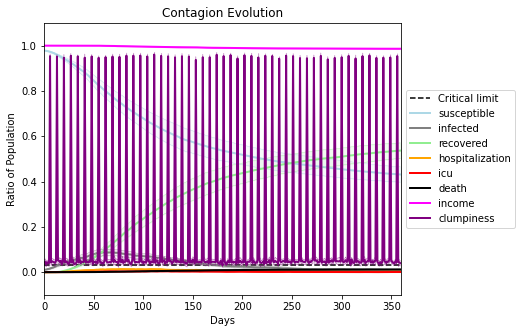

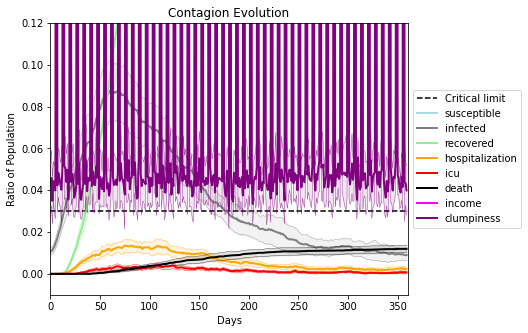

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6198, 2469, 4836, 4394, 7173, 7303, 4368, 7101, 3999, 4422, 741, 2267, 2304, 9898, 5929, 7349, 386, 7408, 3571, 9005]
Average similarity between family members is 0.9422786122733906 at temperature -0.994
Average similarity between family and home is 0.9998559743399097 at temperature -1
Average similarity between students and their classroom is 0.5440445783516505 at temperature -0.994
Average classroom occupancy is 4.090909090909091 and number classrooms is 66
Average similarity between workers is 0.8791531476570348 at temperature -0.994
Average office occupancy is 3.3300492610837438 and number offices is 203
Average friend similarity for adults: 0.8490953556186986 for kids: 0.6740469927204826
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.5829476715118871
avg restaurant similarity 0.6154726230362654
avg restaurant similarity 0.5151610814916664
avg restaurant similarity 0.5784566151162007
avg restaurant similarity 0.5959323305012209
avg restaurant similarity 0.5967144229037294
avg restaurant similarity 0.5722977408362183
avg restaurant similarity 0.5959602359026188
avg restaurant similarity 0.5944315801818714
avg restaurant similarity 0.5731638363527565
avg restaurant similarity 0.5656251506267688
avg restaurant similarity 0.5549386520106029
avg restaurant similarity 0.5873544916846113
avg restaurant similarity 0.6259801270705201
avg restaurant similarity 0.5966196810860516
avg restaurant similarity 0.5820444803769252
avg restaurant similarity 0.5936307468625561
avg restaurant similarity 0.51629241027568
avg restaurant similarity 0.6072398674092379
avg restaurant similarity 0.5795066138269036
avg restaurant similarity 0.5426372375403188
avg restaurant similarity 0.5187633307772347
avg restaura

avg restaurant similarity 0.5343131827638017
avg restaurant similarity 0.5923972484448573
avg restaurant similarity 0.5601189466637287
avg restaurant similarity 0.5276213600415603
avg restaurant similarity 0.5832192222021649
avg restaurant similarity 0.5898827409495534
avg restaurant similarity 0.6289967014566518
avg restaurant similarity 0.5714351735023216
avg restaurant similarity 0.5732506622258665
avg restaurant similarity 0.5392571051185583
avg restaurant similarity 0.5719297677362536
avg restaurant similarity 0.5598270732125027
avg restaurant similarity 0.5912615532601025
avg restaurant similarity 0.5862881276112485
avg restaurant similarity 0.5708371491788627
avg restaurant similarity 0.6016881382361511
avg restaurant similarity 0.6046315921969827
avg restaurant similarity 0.6172744235653106
avg restaurant similarity 0.6013606621256545
avg restaurant similarity 0.5984461885637161
avg restaurant similarity 0.5656077141547761
avg restaurant similarity 0.5301639339340528
avg restau

avg restaurant similarity 0.520700985563116
avg restaurant similarity 0.55531462049562
avg restaurant similarity 0.5301349172488278
avg restaurant similarity 0.5539322291014045
avg restaurant similarity 0.5513543566844267
avg restaurant similarity 0.5424829237059958
avg restaurant similarity 0.5421387654141416
avg restaurant similarity 0.5723989229728997
avg restaurant similarity 0.5323754456110381
avg restaurant similarity 0.5126430290479028
avg restaurant similarity 0.5386965091129245
avg restaurant similarity 0.6120557009165316
avg restaurant similarity 0.6135079271569096
avg restaurant similarity 0.636438279728969
avg restaurant similarity 0.5244338401632411
avg restaurant similarity 0.563962135762357
avg restaurant similarity 0.5443745159885869
avg restaurant similarity 0.590459373050486
avg restaurant similarity 0.5136736148851024
avg restaurant similarity 0.6052176884907038
avg restaurant similarity 0.5788761566827425
avg restaurant similarity 0.5326349737001157
avg restaurant s

avg restaurant similarity 0.5284854115586294
avg restaurant similarity 0.5459427384138713
avg restaurant similarity 0.5374190139030666
avg restaurant similarity 0.5570763880230875
avg restaurant similarity 0.575767774321263
avg restaurant similarity 0.5662334032148517
avg restaurant similarity 0.5640918494730472
avg restaurant similarity 0.5924937273152976
avg restaurant similarity 0.6074685640897486
avg restaurant similarity 0.5492610888431079
avg restaurant similarity 0.6218950229246207
avg restaurant similarity 0.5575023247457455
avg restaurant similarity 0.5854866234082445
avg restaurant similarity 0.6071651817267678
avg restaurant similarity 0.550521347575682
avg restaurant similarity 0.512868722846665
avg restaurant similarity 0.5734884543790632
avg restaurant similarity 0.5349825508889656
avg restaurant similarity 0.5382958948064714
avg restaurant similarity 0.575157631069111
avg restaurant similarity 0.6053295711600275
avg restaurant similarity 0.5665515111221381
avg restaurant

avg restaurant similarity 0.5434066747512766
avg restaurant similarity 0.5540441986127682
avg restaurant similarity 0.6427378015660989
avg restaurant similarity 0.6095042640394936
avg restaurant similarity 0.5957413619350145
avg restaurant similarity 0.6029072607281487
avg restaurant similarity 0.6133761740653161
avg restaurant similarity 0.621778222883444
avg restaurant similarity 0.5916598549385995
avg restaurant similarity 0.5393576663746363
avg restaurant similarity 0.5909785545733527
avg restaurant similarity 0.6035747438000066
avg restaurant similarity 0.5760901920242844
avg restaurant similarity 0.5781636562177696
avg restaurant similarity 0.5578200486258692
avg restaurant similarity 0.5740723756905035
avg restaurant similarity 0.6312471246600615
avg restaurant similarity 0.5632856691949005
avg restaurant similarity 0.6298257193149752
avg restaurant similarity 0.5743967471266498
avg restaurant similarity 0.5494496759922592
avg restaurant similarity 0.6376438361033292
avg restaur

avg restaurant similarity 0.5915332863498033
avg restaurant similarity 0.5741400172575138
avg restaurant similarity 0.5788599309767878
avg restaurant similarity 0.5746710428949652
avg restaurant similarity 0.6021711238163939
avg restaurant similarity 0.6333893683598733
avg restaurant similarity 0.6003377672793315
avg restaurant similarity 0.5883339252774809
avg restaurant similarity 0.5996372369798408
avg restaurant similarity 0.5954917343551719
avg restaurant similarity 0.64585237471027
avg restaurant similarity 0.5628931896679962
avg restaurant similarity 0.5515975992489108
avg restaurant similarity 0.5994796690253846
avg restaurant similarity 0.6417357601044211
avg restaurant similarity 0.574167696528246
avg restaurant similarity 0.5937465717263096
avg restaurant similarity 0.5884297216884221
avg restaurant similarity 0.62739406515883
avg restaurant similarity 0.6188283583106602
avg restaurant similarity 0.6303406452049667
avg restaurant similarity 0.657688796571803
avg restaurant s

avg restaurant similarity 0.5917936875526636
avg restaurant similarity 0.5563255246387557
avg restaurant similarity 0.6190448575520203
avg restaurant similarity 0.6029547253411021
avg restaurant similarity 0.5517059155678773
avg restaurant similarity 0.5425005579270622
avg restaurant similarity 0.5499205200478683
avg restaurant similarity 0.5953467741252808
avg restaurant similarity 0.5317506709846133
avg restaurant similarity 0.5748020760931659
avg restaurant similarity 0.4902175060254169
avg restaurant similarity 0.632596619097336
avg restaurant similarity 0.5511580163859773
avg restaurant similarity 0.450176040980275
avg restaurant similarity 0.5982123288958064
avg restaurant similarity 0.5973964919234144
avg restaurant similarity 0.5476282808902008
avg restaurant similarity 0.5590438586921678
avg restaurant similarity 0.538688198916858
avg restaurant similarity 0.5375061770795202
avg restaurant similarity 0.49802712043274405
avg restaurant similarity 0.4761632331742346
avg restaura

avg restaurant similarity 0.5544575498754801
avg restaurant similarity 0.5848636560242005
avg restaurant similarity 0.5913337755416879
avg restaurant similarity 0.545200944368426
avg restaurant similarity 0.5802235730573331
avg restaurant similarity 0.6373769357441782
avg restaurant similarity 0.5619078378138429
avg restaurant similarity 0.5755587652708002
avg restaurant similarity 0.6120361680463094
avg restaurant similarity 0.5884765815467896
avg restaurant similarity 0.5527604074098325
avg restaurant similarity 0.57538785668839
avg restaurant similarity 0.5246425962998064
avg restaurant similarity 0.5753652229665264
avg restaurant similarity 0.5704377919850355
avg restaurant similarity 0.5345934855337493
avg restaurant similarity 0.55812303006022
avg restaurant similarity 0.5321947369754155
avg restaurant similarity 0.6308619225385826
avg restaurant similarity 0.5433831608888987
avg restaurant similarity 0.5747175694723361
avg restaurant similarity 0.6187940844856433
avg restaurant 

avg restaurant similarity 0.6479275805549246
avg restaurant similarity 0.6605562687269168
avg restaurant similarity 0.59200320084303
avg restaurant similarity 0.652266033383782
avg restaurant similarity 0.5963557779746814
avg restaurant similarity 0.6515590677776808
avg restaurant similarity 0.6142283384087062
avg restaurant similarity 0.6015183547298919
avg restaurant similarity 0.6312142626349092
avg restaurant similarity 0.6220036531541712
avg restaurant similarity 0.589415644967221
avg restaurant similarity 0.620114415256694
avg restaurant similarity 0.6319114516350437
avg restaurant similarity 0.6545760510393995
avg restaurant similarity 0.6783873905205334
avg restaurant similarity 0.6322775475199073
avg restaurant similarity 0.6058513534475789
avg restaurant similarity 0.6350559755818191
avg restaurant similarity 0.600597691561762
avg restaurant similarity 0.6327302436837109
avg restaurant similarity 0.6500841757763131
avg restaurant similarity 0.5794586442018983
avg restaurant s

avg restaurant similarity 0.5737933732341731
avg restaurant similarity 0.5815981953826815
avg restaurant similarity 0.5666609505849286
avg restaurant similarity 0.6764690712170092
avg restaurant similarity 0.6034343119950516
avg restaurant similarity 0.6783578494731654
avg restaurant similarity 0.626684420459546
avg restaurant similarity 0.636179705077383
avg restaurant similarity 0.6582566815799306
avg restaurant similarity 0.6180663722169591
avg restaurant similarity 0.648716403298771
avg restaurant similarity 0.621260806400831
avg restaurant similarity 0.5907672016526894
avg restaurant similarity 0.5534741032314047
avg restaurant similarity 0.6113069253005557
avg restaurant similarity 0.5984987340204918
avg restaurant similarity 0.6056597345499477
avg restaurant similarity 0.6079405010931928
avg restaurant similarity 0.6468675325681275
avg restaurant similarity 0.6096932476812725
avg restaurant similarity 0.5800886568842267
avg restaurant similarity 0.6141436336207085
avg restaurant

avg restaurant similarity 0.5710885769710959
avg restaurant similarity 0.5668221341456311
avg restaurant similarity 0.587077216954417
avg restaurant similarity 0.6175533094896714
avg restaurant similarity 0.5587665425158675
avg restaurant similarity 0.559125751275003
avg restaurant similarity 0.5511214598096791
avg restaurant similarity 0.6260108517099681
avg restaurant similarity 0.5632909590823578
avg restaurant similarity 0.5367869311069626
avg restaurant similarity 0.5581619409743652
avg restaurant similarity 0.5313928009706033
avg restaurant similarity 0.6264859515053612
avg restaurant similarity 0.5763658099180453
avg restaurant similarity 0.610694642984893
avg restaurant similarity 0.5866353074182685
avg restaurant similarity 0.5899805592156211
avg restaurant similarity 0.4919566401832982
avg restaurant similarity 0.5564086534154183
avg restaurant similarity 0.5359710638201778
avg restaurant similarity 0.5493063487599577
avg restaurant similarity 0.5477410977034555
avg restauran

avg restaurant similarity 0.6612808322183821
avg restaurant similarity 0.5227906601042053
avg restaurant similarity 0.5721471425941391
avg restaurant similarity 0.5389945388327707
avg restaurant similarity 0.5662668804946186
avg restaurant similarity 0.5959510902329859
avg restaurant similarity 0.5994526191618722
avg restaurant similarity 0.5568451810872086
avg restaurant similarity 0.5585519244816518
avg restaurant similarity 0.6191542776653141
avg restaurant similarity 0.5728620937472274
avg restaurant similarity 0.5694780240768955
avg restaurant similarity 0.5826995623031516
avg restaurant similarity 0.5632606157893623
avg restaurant similarity 0.6064263013026227
avg restaurant similarity 0.5469934680320195
avg restaurant similarity 0.488525058295096
avg restaurant similarity 0.5852193579178014
avg restaurant similarity 0.6388822011142242
avg restaurant similarity 0.5869475442934072
avg restaurant similarity 0.5791801040472573
avg restaurant similarity 0.5458132201473733
avg restaur

avg restaurant similarity 0.5906241098876982
avg restaurant similarity 0.5582199125288386
avg restaurant similarity 0.5688271391779474
avg restaurant similarity 0.5215738101812671
avg restaurant similarity 0.5572112469612623
avg restaurant similarity 0.6016999987927952
avg restaurant similarity 0.5497591056965075
avg restaurant similarity 0.5255839232655982
avg restaurant similarity 0.5282505140546013
avg restaurant similarity 0.5315435056565678
avg restaurant similarity 0.5611144188112945
avg restaurant similarity 0.6018242425607345
avg restaurant similarity 0.5797552010395407
avg restaurant similarity 0.5327822695591296
avg restaurant similarity 0.517876036438578
avg restaurant similarity 0.532209330890997
avg restaurant similarity 0.5774684823944777
avg restaurant similarity 0.5645927326337805
avg restaurant similarity 0.5578835224017192
avg restaurant similarity 0.5908695697413886
avg restaurant similarity 0.5313485757390275
avg restaurant similarity 0.5602187593624561
avg restaura

avg restaurant similarity 0.5337346337070806
avg restaurant similarity 0.5853622841093395
avg restaurant similarity 0.5433328953478115
avg restaurant similarity 0.5645965739790579
avg restaurant similarity 0.5777804473325627
avg restaurant similarity 0.5597923324194898
avg restaurant similarity 0.5702384749594338
avg restaurant similarity 0.560677951950277
avg restaurant similarity 0.5408764251886773
avg restaurant similarity 0.5686728080665984
avg restaurant similarity 0.6154622408970286
avg restaurant similarity 0.6201270431208354
avg restaurant similarity 0.5612818065817746
avg restaurant similarity 0.5370760617464674
avg restaurant similarity 0.5908725335564243
avg restaurant similarity 0.5720887143688251
avg restaurant similarity 0.5572122783090349
avg restaurant similarity 0.5848593520293917
avg restaurant similarity 0.5358850064572775
avg restaurant similarity 0.5923375594860006
avg restaurant similarity 0.5539840288015316
avg restaurant similarity 0.5761423207676755
avg restaur

avg restaurant similarity 0.5456229302778286
avg restaurant similarity 0.6210626665394906
avg restaurant similarity 0.5394310890300817
avg restaurant similarity 0.5296623712365254
avg restaurant similarity 0.5560067486377226
avg restaurant similarity 0.5403345759848373
avg restaurant similarity 0.5610891927335935
avg restaurant similarity 0.5887360015546266
avg restaurant similarity 0.6070057280695909
avg restaurant similarity 0.618518444725422
avg restaurant similarity 0.5954239820890758
avg restaurant similarity 0.6532929243093634
avg restaurant similarity 0.5728169079648127
avg restaurant similarity 0.5727338134761707
avg restaurant similarity 0.5495078507974036
avg restaurant similarity 0.5847629559646891
avg restaurant similarity 0.5628446170960808
avg restaurant similarity 0.5275617508854635
avg restaurant similarity 0.5650806237972948
avg restaurant similarity 0.570529732419875
avg restaurant similarity 0.6024295747141943
avg restaurant similarity 0.5911761149449796
avg restaura

avg restaurant similarity 0.5712338106727252
avg restaurant similarity 0.591261520337106
avg restaurant similarity 0.5558769941493249
avg restaurant similarity 0.5633111539626628
avg restaurant similarity 0.5755044244909581
avg restaurant similarity 0.5611932372102667
avg restaurant similarity 0.5584839893398027
avg restaurant similarity 0.5951686424798682
avg restaurant similarity 0.5660025262690377
avg restaurant similarity 0.5232756626659728
avg restaurant similarity 0.5424718576063554
avg restaurant similarity 0.5542369525105251
avg restaurant similarity 0.5489593947689281
avg restaurant similarity 0.5925684774702055
avg restaurant similarity 0.5825478030882532
avg restaurant similarity 0.5943443823331473
avg restaurant similarity 0.5822314408496718
avg restaurant similarity 0.6269685545878516
avg restaurant similarity 0.6120461723533892
avg restaurant similarity 0.5541799023342948
avg restaurant similarity 0.5655262440423242
avg restaurant similarity 0.5531137717392034
avg restaur

avg restaurant similarity 0.5706004916452604
avg restaurant similarity 0.531516221963093
avg restaurant similarity 0.576143538284054
avg restaurant similarity 0.5765693738510488
avg restaurant similarity 0.5799482064351901
avg restaurant similarity 0.575267606562603
avg restaurant similarity 0.577929100753404
avg restaurant similarity 0.5647550201394153
avg restaurant similarity 0.5875294467866499
avg restaurant similarity 0.6031815083900686
avg restaurant similarity 0.540714233994736
avg restaurant similarity 0.4721803512392898
avg restaurant similarity 0.6098075487398245
avg restaurant similarity 0.5249249346128431
avg restaurant similarity 0.552322511325026
avg restaurant similarity 0.5110442360716191
avg restaurant similarity 0.5246039112453796
avg restaurant similarity 0.6429039410972932
avg restaurant similarity 0.5641621583476903
avg restaurant similarity 0.48831474291970184
avg restaurant similarity 0.5850431093188279
avg restaurant similarity 0.4510327778183616
avg restaurant 

avg restaurant similarity 0.5717917382056239
avg restaurant similarity 0.5669440277732803
avg restaurant similarity 0.5344584581320017
avg restaurant similarity 0.48851345149545955
avg restaurant similarity 0.5469168875116774
avg restaurant similarity 0.5171528804138632
avg restaurant similarity 0.5622028892278444
avg restaurant similarity 0.5936908805629808
avg restaurant similarity 0.5133488321215477
avg restaurant similarity 0.5614864110739299
avg restaurant similarity 0.5551062927764324
avg restaurant similarity 0.5489657402615222
avg restaurant similarity 0.6305128566857656
avg restaurant similarity 0.5490329569905178
avg restaurant similarity 0.5583389562314975
avg restaurant similarity 0.5663008090835364
avg restaurant similarity 0.5581803479115713
avg restaurant similarity 0.5386925459285306
avg restaurant similarity 0.579968007621958
avg restaurant similarity 0.6347702261462235
avg restaurant similarity 0.5821389132670366
avg restaurant similarity 0.5319361707471533
avg restau

avg restaurant similarity 0.5635525382389289
avg restaurant similarity 0.5984206883959621
avg restaurant similarity 0.53834754989656
avg restaurant similarity 0.5625939956321423
avg restaurant similarity 0.5766504035441621
avg restaurant similarity 0.5847287531453996
avg restaurant similarity 0.576476541613633
avg restaurant similarity 0.5502484789977501
avg restaurant similarity 0.5577778844508771
avg restaurant similarity 0.5887070978948933
avg restaurant similarity 0.5554770282353766
avg restaurant similarity 0.4942204903435444
avg restaurant similarity 0.5827514236677395
avg restaurant similarity 0.5818813367979895
avg restaurant similarity 0.6071775101451233
avg restaurant similarity 0.5291908154871204
avg restaurant similarity 0.6414804742573317
avg restaurant similarity 0.5507024411560765
avg restaurant similarity 0.5243238005563327
avg restaurant similarity 0.5385371649364048
avg restaurant similarity 0.593046553640323
avg restaurant similarity 0.5624868692831225
avg restaurant

avg restaurant similarity 0.577935832971253
avg restaurant similarity 0.5423871553486835
avg restaurant similarity 0.5866396907395929
avg restaurant similarity 0.535554802249948
avg restaurant similarity 0.5788537291710557
avg restaurant similarity 0.557634872020458
avg restaurant similarity 0.5522442658848006
avg restaurant similarity 0.5138934279789299
avg restaurant similarity 0.5202778280795335
avg restaurant similarity 0.5645494023968394
avg restaurant similarity 0.5470554530746891
avg restaurant similarity 0.540924994774442
avg restaurant similarity 0.5549350612180752
avg restaurant similarity 0.5676341553122033
avg restaurant similarity 0.5529572784691661
avg restaurant similarity 0.6062597324252401
avg restaurant similarity 0.5985540909285669
avg restaurant similarity 0.5326617869650434
avg restaurant similarity 0.5173247427636488
avg restaurant similarity 0.5539032742079255
avg restaurant similarity 0.5882740633206847
avg restaurant similarity 0.5698495112301767
avg restaurant

avg restaurant similarity 0.5585413453215863
avg restaurant similarity 0.5780523782337704
avg restaurant similarity 0.5967022702286134
avg restaurant similarity 0.5959050847579445
avg restaurant similarity 0.5923030752601042
avg restaurant similarity 0.6237805007898851
avg restaurant similarity 0.5957949954663497
avg restaurant similarity 0.5630637420693552
avg restaurant similarity 0.5438460073357765
avg restaurant similarity 0.6086096692518427
avg restaurant similarity 0.6044294390341161
avg restaurant similarity 0.5516531233164513
avg restaurant similarity 0.5841642720551808
avg restaurant similarity 0.622319820286745
avg restaurant similarity 0.59304643396423
avg restaurant similarity 0.5618911399330492
avg restaurant similarity 0.5476305661680253
avg restaurant similarity 0.5613454420312666
avg restaurant similarity 0.5654141766106155
avg restaurant similarity 0.6100230983582977
avg restaurant similarity 0.6029594331953005
avg restaurant similarity 0.5819446867897168
avg restauran

avg restaurant similarity 0.5520653452769693
avg restaurant similarity 0.6296349563983478
avg restaurant similarity 0.6104772398541167
avg restaurant similarity 0.6211192350032169
avg restaurant similarity 0.5799938954642275
avg restaurant similarity 0.5483802310362926
avg restaurant similarity 0.5770970732372126
avg restaurant similarity 0.6045265810732345
avg restaurant similarity 0.5988204864125074
avg restaurant similarity 0.6521350504790314
avg restaurant similarity 0.5551438219083722
avg restaurant similarity 0.610159773563279
avg restaurant similarity 0.5729728481630224
avg restaurant similarity 0.5545833885052498
avg restaurant similarity 0.5948899927621738
avg restaurant similarity 0.6265068290271903
avg restaurant similarity 0.5535481314953483
avg restaurant similarity 0.5718998208747925
avg restaurant similarity 0.5647464938634732
avg restaurant similarity 0.536912691464409
avg restaurant similarity 0.5325247339579712
avg restaurant similarity 0.5800586032079794
avg restaura

avg restaurant similarity 0.574943746868155
avg restaurant similarity 0.5572315867650289
avg restaurant similarity 0.5496876697677492
avg restaurant similarity 0.5854570365655672
avg restaurant similarity 0.6015267353426847
avg restaurant similarity 0.5164237753918923
avg restaurant similarity 0.6760716395944247
avg restaurant similarity 0.6171742549541424
avg restaurant similarity 0.6004951721900004
avg restaurant similarity 0.5524921853996624
avg restaurant similarity 0.6238810035826184
avg restaurant similarity 0.5537891907436056
avg restaurant similarity 0.6079655183130849
avg restaurant similarity 0.5494648096034527
avg restaurant similarity 0.5848362600137607
avg restaurant similarity 0.4723288547859171
avg restaurant similarity 0.5906747334989543
avg restaurant similarity 0.5044049948028124
avg restaurant similarity 0.5770371511591407
avg restaurant similarity 0.6344147871337835
avg restaurant similarity 0.5545516314673601
avg restaurant similarity 0.6900096736911967
avg restaur

avg restaurant similarity 0.580665704389701
avg restaurant similarity 0.5680618272929575
avg restaurant similarity 0.5933735001057036
avg restaurant similarity 0.5832238494986719
avg restaurant similarity 0.6252645723051523
avg restaurant similarity 0.5634112919210408
avg restaurant similarity 0.5971642319008206
avg restaurant similarity 0.5828492161220048
avg restaurant similarity 0.6125593431791343
avg restaurant similarity 0.5589702334819117
avg restaurant similarity 0.634061646663357
avg restaurant similarity 0.6073133639972138
avg restaurant similarity 0.6196242465497337
avg restaurant similarity 0.5904900015465802
avg restaurant similarity 0.5721553346315353
avg restaurant similarity 0.5651619517211588
avg restaurant similarity 0.6207750491065055
avg restaurant similarity 0.654247411601045
avg restaurant similarity 0.6184671541460233
avg restaurant similarity 0.6472622719255408
avg restaurant similarity 0.6144043048427817
avg restaurant similarity 0.5318196473978758
avg restauran

avg restaurant similarity 0.5697827584167567
avg restaurant similarity 0.5389205269629905
avg restaurant similarity 0.5364137506530617
avg restaurant similarity 0.5860631200458505
avg restaurant similarity 0.5592149273622539
avg restaurant similarity 0.589073512630136
avg restaurant similarity 0.5012270877624898
avg restaurant similarity 0.5590994821128208
avg restaurant similarity 0.5203062457354313
avg restaurant similarity 0.5672537792286896
avg restaurant similarity 0.5480885330097642
avg restaurant similarity 0.6069582203219944
avg restaurant similarity 0.5352633202358802
avg restaurant similarity 0.5550364925903856
avg restaurant similarity 0.5233847498425152
avg restaurant similarity 0.5399968572021517
avg restaurant similarity 0.456835181621034
avg restaurant similarity 0.5008916546149534
avg restaurant similarity 0.4889062853817355
avg restaurant similarity 0.5301296068446016
avg restaurant similarity 0.555279155322674
avg restaurant similarity 0.563222761095964
avg restaurant

avg restaurant similarity 0.5084919540480428
avg restaurant similarity 0.576230663327399
avg restaurant similarity 0.5241936642609428
avg restaurant similarity 0.5346987572376107
avg restaurant similarity 0.5943488575767271
avg restaurant similarity 0.565230990561517
avg restaurant similarity 0.47433200429869393
avg restaurant similarity 0.5070015099722026
avg restaurant similarity 0.5293854387148278
avg restaurant similarity 0.5419020919341694
avg restaurant similarity 0.5286331261397935
avg restaurant similarity 0.530736018222245
avg restaurant similarity 0.5319808561578131
avg restaurant similarity 0.544377047584972
avg restaurant similarity 0.5578616018721598
avg restaurant similarity 0.5866845617472232
avg restaurant similarity 0.5819816732147868
avg restaurant similarity 0.5951752178029116
avg restaurant similarity 0.5447190141474062
avg restaurant similarity 0.5424719048495169
avg restaurant similarity 0.5640903963510927
avg restaurant similarity 0.5202756949913749
avg restauran

avg restaurant similarity 0.566039062231295
avg restaurant similarity 0.5526278724387726
avg restaurant similarity 0.52126431283307
avg restaurant similarity 0.571706347779316
avg restaurant similarity 0.5766599103104767
avg restaurant similarity 0.5836523106687704
avg restaurant similarity 0.5503387586466232
avg restaurant similarity 0.5620575597465324
avg restaurant similarity 0.503540062311125
avg restaurant similarity 0.5912751353566329
avg restaurant similarity 0.5813325017259439
avg restaurant similarity 0.6120598271386086
avg restaurant similarity 0.58640955809167
avg restaurant similarity 0.6172633601118535
avg restaurant similarity 0.5558566615109942
avg restaurant similarity 0.5586620661749553
avg restaurant similarity 0.5845906068965571
avg restaurant similarity 0.5726471383098962
avg restaurant similarity 0.5359688878754836
avg restaurant similarity 0.5880256023040951
avg restaurant similarity 0.5612409823454156
avg restaurant similarity 0.5419188696475532
avg restaurant si

avg restaurant similarity 0.5282130441881676
avg restaurant similarity 0.5017837651993038
avg restaurant similarity 0.5671354788227441
avg restaurant similarity 0.5522743877009626
avg restaurant similarity 0.5534934618789622
avg restaurant similarity 0.5519493482913657
avg restaurant similarity 0.5659475433791934
avg restaurant similarity 0.550026565680797
avg restaurant similarity 0.6053493058399643
avg restaurant similarity 0.5114853319356697
avg restaurant similarity 0.6332485833648311
avg restaurant similarity 0.5286297999412455
avg restaurant similarity 0.5742645613967826
avg restaurant similarity 0.5398260734364271
avg restaurant similarity 0.5937522413265779
avg restaurant similarity 0.5917462351148906
avg restaurant similarity 0.5215319446313608
avg restaurant similarity 0.5515406566048952
avg restaurant similarity 0.5702115898409671
avg restaurant similarity 0.5618169993565062
avg restaurant similarity 0.4994341456209028
avg restaurant similarity 0.5449087920284301
avg restaur

avg restaurant similarity 0.614826329572811
avg restaurant similarity 0.615845317700583
avg restaurant similarity 0.5578636383800188
avg restaurant similarity 0.6081055780249489
avg restaurant similarity 0.6153085229192345
avg restaurant similarity 0.5358925560496581
avg restaurant similarity 0.6391147145738493
avg restaurant similarity 0.6058772364644094
avg restaurant similarity 0.6092445033360643
avg restaurant similarity 0.644438549594168
avg restaurant similarity 0.5869819940160111
avg restaurant similarity 0.6262282208649748
avg restaurant similarity 0.60369094620786
avg restaurant similarity 0.5250678133116371
avg restaurant similarity 0.5683300260066524
avg restaurant similarity 0.6008595950017047
avg restaurant similarity 0.6217113177006219
avg restaurant similarity 0.5766798655566534
avg restaurant similarity 0.5948360657781353
avg restaurant similarity 0.6007386522752008
avg restaurant similarity 0.5896498661340115
avg restaurant similarity 0.573717705794203
avg restaurant s

avg restaurant similarity 0.5930087704857951
avg restaurant similarity 0.6025818576528097
avg restaurant similarity 0.609706008449385
avg restaurant similarity 0.5696361691610531
avg restaurant similarity 0.5870210181128878
avg restaurant similarity 0.5603693490426858
avg restaurant similarity 0.5708684940758686
avg restaurant similarity 0.6003416633904821
avg restaurant similarity 0.5929516899360391
avg restaurant similarity 0.5886248129341424
avg restaurant similarity 0.5892186437207101
avg restaurant similarity 0.5590888746598837
avg restaurant similarity 0.6044094945472828
avg restaurant similarity 0.5351530593221859
avg restaurant similarity 0.5899158584476524
avg restaurant similarity 0.6214511427726613
avg restaurant similarity 0.5861544946227167
avg restaurant similarity 0.5628169742551835
avg restaurant similarity 0.5348023881273228
avg restaurant similarity 0.6121519787643015
avg restaurant similarity 0.5384917306489507
avg restaurant similarity 0.5564212196960208
avg restaur

avg restaurant similarity 0.5500647781272548
avg restaurant similarity 0.5205785350210205
avg restaurant similarity 0.5673016617095826
avg restaurant similarity 0.5693375353106825
avg restaurant similarity 0.5468355111466887
avg restaurant similarity 0.5953208957060929
avg restaurant similarity 0.5634944293713087
avg restaurant similarity 0.6033541375619973
avg restaurant similarity 0.5283022252940736
avg restaurant similarity 0.5160264670455276
avg restaurant similarity 0.5569784856824793
avg restaurant similarity 0.5413175676907144
avg restaurant similarity 0.5222773504988254
avg restaurant similarity 0.5847064102897791
avg restaurant similarity 0.5997447927157851
avg restaurant similarity 0.5595173265886091
avg restaurant similarity 0.579053238751971
avg restaurant similarity 0.5709938075676136
avg restaurant similarity 0.5651644227016099
avg restaurant similarity 0.5282853470999355
avg restaurant similarity 0.5914067483226559
avg restaurant similarity 0.5795845018220007
avg restaur

avg restaurant similarity 0.553877753599799
avg restaurant similarity 0.5435941190720752
avg restaurant similarity 0.5405674865537314
avg restaurant similarity 0.589658107527141
avg restaurant similarity 0.5139524094421114
avg restaurant similarity 0.5588905537998264
avg restaurant similarity 0.5558958372141376
avg restaurant similarity 0.5714362806024729
avg restaurant similarity 0.6077040955734939
avg restaurant similarity 0.5338828695359732
avg restaurant similarity 0.5877506779862606
avg restaurant similarity 0.5545465548776644
avg restaurant similarity 0.5996466731391323
avg restaurant similarity 0.5592260798426983
avg restaurant similarity 0.5442789205675183
avg restaurant similarity 0.5697687135020568
avg restaurant similarity 0.5338321172600204
avg restaurant similarity 0.5644016016964123
avg restaurant similarity 0.5753843389173977
avg restaurant similarity 0.5655266300935676
avg restaurant similarity 0.5720739970805213
avg restaurant similarity 0.5966050697061227
avg restaura

avg restaurant similarity 0.6380593532080987
avg restaurant similarity 0.5859451456994422
avg restaurant similarity 0.580053787039879
avg restaurant similarity 0.5488291341640986
avg restaurant similarity 0.5928457322914802
avg restaurant similarity 0.6016106998368068
avg restaurant similarity 0.5527591988895292
avg restaurant similarity 0.6259471126003642
avg restaurant similarity 0.5267439515887128
avg restaurant similarity 0.5819632019369313
avg restaurant similarity 0.5769718599140333
avg restaurant similarity 0.5766085319242161
avg restaurant similarity 0.6220883441783849
avg restaurant similarity 0.5814272399404458
avg restaurant similarity 0.5465054792452044
avg restaurant similarity 0.6476123959365427
avg restaurant similarity 0.5492151048814595
avg restaurant similarity 0.6042850946679843
avg restaurant similarity 0.5282863638654288
avg restaurant similarity 0.5721574915903282
avg restaurant similarity 0.587709527764169
avg restaurant similarity 0.5748573582376606
avg restaura

avg restaurant similarity 0.5659205661998199
avg restaurant similarity 0.5962124460113648
avg restaurant similarity 0.5818467938176272
avg restaurant similarity 0.5478048777155176
avg restaurant similarity 0.5754626430084473
avg restaurant similarity 0.5995187679359465
avg restaurant similarity 0.5939084686312108
avg restaurant similarity 0.5786265492649865
avg restaurant similarity 0.6084384617836796
avg restaurant similarity 0.5484320119519863
avg restaurant similarity 0.6144720925125401
avg restaurant similarity 0.588635987497461
avg restaurant similarity 0.5423559690362469
avg restaurant similarity 0.5768461005787388
avg restaurant similarity 0.6106916550261131
avg restaurant similarity 0.5728172792476053
avg restaurant similarity 0.5386113433232029
avg restaurant similarity 0.5890822736248227
avg restaurant similarity 0.5886838320593294
avg restaurant similarity 0.5316792633613285
avg restaurant similarity 0.5774096734724352
avg restaurant similarity 0.5976933674219984
avg restaur

avg restaurant similarity 0.5648672839666093
avg restaurant similarity 0.5578652304826002
avg restaurant similarity 0.5534712049469266
avg restaurant similarity 0.5967664484489887
avg restaurant similarity 0.5157349338701548
avg restaurant similarity 0.5388863140969714
avg restaurant similarity 0.5952563415012424
avg restaurant similarity 0.5473898086068347
avg restaurant similarity 0.5773356505571178
avg restaurant similarity 0.6103759018049748
avg restaurant similarity 0.5887160742632834
avg restaurant similarity 0.60568404599657
avg restaurant similarity 0.5403097248059264
avg restaurant similarity 0.6040985327863804
avg restaurant similarity 0.5717429548515822
avg restaurant similarity 0.6192579155841905
avg restaurant similarity 0.569265765955967
avg restaurant similarity 0.5348020961073738
avg restaurant similarity 0.5359383666170778
avg restaurant similarity 0.5425104503053836
avg restaurant similarity 0.5439231794358982
avg restaurant similarity 0.5474757912513487
avg restauran

avg restaurant similarity 0.5930238223879692
avg restaurant similarity 0.5906828455391171
avg restaurant similarity 0.5888394038795656
avg restaurant similarity 0.5674518556351651
avg restaurant similarity 0.5723689700028356
avg restaurant similarity 0.5477512436544894
avg restaurant similarity 0.5487776767987826
avg restaurant similarity 0.5597020405329601
avg restaurant similarity 0.5850874484567634
avg restaurant similarity 0.6171512988635501
avg restaurant similarity 0.514872066722106
avg restaurant similarity 0.5902806385277876
avg restaurant similarity 0.5432455154766701
avg restaurant similarity 0.5861623719161518
avg restaurant similarity 0.5624162777991891
avg restaurant similarity 0.5498599032062694
avg restaurant similarity 0.5209104287823926
avg restaurant similarity 0.5490227148139543
avg restaurant similarity 0.5813870006673008
avg restaurant similarity 0.546513309603021
avg restaurant similarity 0.6017740001296524
avg restaurant similarity 0.5655097486813505
avg restaura

avg restaurant similarity 0.5878883210829989
avg restaurant similarity 0.5784163543570907
avg restaurant similarity 0.5909751849614954
avg restaurant similarity 0.5301689137320512
avg restaurant similarity 0.5484987555674478
avg restaurant similarity 0.5652744135089316
avg restaurant similarity 0.6085802939779493
avg restaurant similarity 0.5934892164015444
avg restaurant similarity 0.5828546863845878
avg restaurant similarity 0.5638565868393695
avg restaurant similarity 0.5019843267488173
avg restaurant similarity 0.6267453315528246
avg restaurant similarity 0.5969533498607066
avg restaurant similarity 0.5481930488341819
avg restaurant similarity 0.5707634251278153
avg restaurant similarity 0.5783101154129701
avg restaurant similarity 0.628849813283124
avg restaurant similarity 0.616642073028517
avg restaurant similarity 0.602689446013051
avg restaurant similarity 0.5227997018888478
avg restaurant similarity 0.5608648133271044
avg restaurant similarity 0.5382646454456367
avg restauran

avg restaurant similarity 0.5943899218730886
avg restaurant similarity 0.5878684742440301
avg restaurant similarity 0.5423412445123075
avg restaurant similarity 0.6023083440830468
avg restaurant similarity 0.585246986630344
avg restaurant similarity 0.5720163616209348
avg restaurant similarity 0.6345637040005265
avg restaurant similarity 0.5618346420440576
avg restaurant similarity 0.592010421577479
avg restaurant similarity 0.5730724580193557
avg restaurant similarity 0.5739801771153922
avg restaurant similarity 0.5392039842681032
avg restaurant similarity 0.5840019883041558
avg restaurant similarity 0.5501233407555107
avg restaurant similarity 0.5475419630326034
avg restaurant similarity 0.5962179189497485
avg restaurant similarity 0.5401199728200384
avg restaurant similarity 0.6154044629488126
avg restaurant similarity 0.5986716274356106
avg restaurant similarity 0.5964400672981816
avg restaurant similarity 0.6291558300195423
avg restaurant similarity 0.5918874712850316
avg restaura

avg restaurant similarity 0.582106620720399
avg restaurant similarity 0.5675611319468475
avg restaurant similarity 0.5651797242792136
avg restaurant similarity 0.613201404043396
avg restaurant similarity 0.5443514002649452
avg restaurant similarity 0.621420280449838
avg restaurant similarity 0.5621183252905582
avg restaurant similarity 0.6360432018241011
avg restaurant similarity 0.6000095342244058
avg restaurant similarity 0.6298502217831706
avg restaurant similarity 0.6107274775782143
avg restaurant similarity 0.5528796022287457
avg restaurant similarity 0.5534036375517722
avg restaurant similarity 0.577825830507819
avg restaurant similarity 0.548384678038754
avg restaurant similarity 0.5990673767949452
avg restaurant similarity 0.5932604818531911
avg restaurant similarity 0.6343228404824001
avg restaurant similarity 0.6091863644626453
avg restaurant similarity 0.6288932936376038
avg restaurant similarity 0.5603146144634944
avg restaurant similarity 0.5647955513432099
avg restaurant 

avg restaurant similarity 0.5663972769388658
avg restaurant similarity 0.5974457265897725
avg restaurant similarity 0.623967095287156
avg restaurant similarity 0.5551920335340691
avg restaurant similarity 0.5026861413783178
avg restaurant similarity 0.5500609973788456
avg restaurant similarity 0.6000731367685388
avg restaurant similarity 0.5678478562172219
avg restaurant similarity 0.6050729802948749
avg restaurant similarity 0.5779976469952463
avg restaurant similarity 0.5567677831721115
avg restaurant similarity 0.6039324350474847
avg restaurant similarity 0.5979492875086055
avg restaurant similarity 0.5667056235264272
avg restaurant similarity 0.5935078267869962
avg restaurant similarity 0.5868016144289662
avg restaurant similarity 0.6672773161171998
avg restaurant similarity 0.6032643351439481
avg restaurant similarity 0.5585243660633685
avg restaurant similarity 0.5646238566474098
avg restaurant similarity 0.5914047050954061
avg restaurant similarity 0.5849343397697478
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

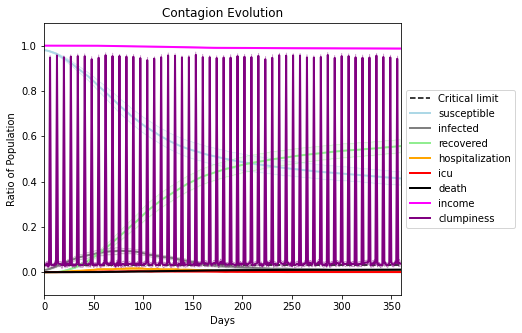

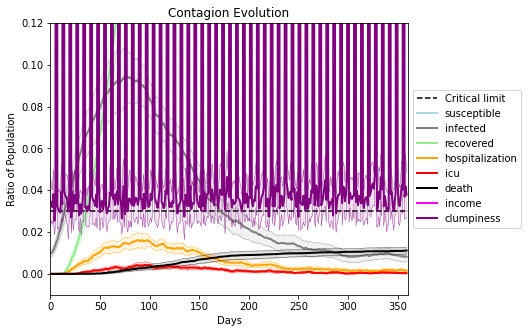

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7563, 2518, 6179, 3906, 7921, 9201, 1662, 8759, 1461, 3448, 2999, 567, 2699, 5389, 7092, 537, 6163, 3263, 2908, 4312]
Average similarity between family members is 0.9330734516039174 at temperature -0.993
Average similarity between family and home is 0.9998569255831852 at temperature -1
Average similarity between students and their classroom is 0.560216721847487 at temperature -0.993
Average classroom occupancy is 4.285714285714286 and number classrooms is 70
Average similarity between workers is 0.8905046184316264 at temperature -0.993
Average office occupancy is 3.3626943005181347 and number offices is 193
Average friend similarity for adults: 0.8563675286085844 for kids: 0.6776927199824324
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5332245393529607
avg restaurant similarity 0.5518809370753125
avg restaurant similarity 0.514180349928704
avg restaurant similarity 0.5336927976296097
avg restaurant similarity 0.5173784319539038
avg restaurant similarity 0.5146727707586836
avg restaurant similarity 0.5444119929127486
avg restaurant similarity 0.5579781191799439
avg restaurant similarity 0.5849031290623112
avg restaurant similarity 0.6098642938279407
avg restaurant similarity 0.5324187109368168
avg restaurant similarity 0.5743163997631582
avg restaurant similarity 0.5758760861502005
avg restaurant similarity 0.5897429274957448
avg restaurant similarity 0.5144364947465063
avg restaurant similarity 0.5534352997320954
avg restaurant similarity 0.5588239315716277
avg restaurant similarity 0.5648942838564064
avg restaurant similarity 0.4932314529670855
avg restaurant similarity 0.5353597983089375
avg restaurant similarity 0.5474888867081765
avg restaurant similarity 0.564208622135808
avg restaura

avg restaurant similarity 0.5924434027881479
avg restaurant similarity 0.5684777175347605
avg restaurant similarity 0.6011620513924525
avg restaurant similarity 0.570529850893546
avg restaurant similarity 0.5282744693773382
avg restaurant similarity 0.5768044122478928
avg restaurant similarity 0.5753280472263527
avg restaurant similarity 0.534097896879013
avg restaurant similarity 0.5777719997685944
avg restaurant similarity 0.5696298416146904
avg restaurant similarity 0.6077638465832155
avg restaurant similarity 0.5927322672257948
avg restaurant similarity 0.5455167685735283
avg restaurant similarity 0.5408381352248465
avg restaurant similarity 0.5647432652565588
avg restaurant similarity 0.5721574585371342
avg restaurant similarity 0.5739365994494509
avg restaurant similarity 0.54496917245361
avg restaurant similarity 0.5953682164003273
avg restaurant similarity 0.6133330906344706
avg restaurant similarity 0.5197471796612707
avg restaurant similarity 0.5691585826154909
avg restaurant

avg restaurant similarity 0.5551361131285981
avg restaurant similarity 0.568627230442126
avg restaurant similarity 0.5920185480625832
avg restaurant similarity 0.5594542573477957
avg restaurant similarity 0.49517521102637685
avg restaurant similarity 0.5862531312682436
avg restaurant similarity 0.5377139163655473
avg restaurant similarity 0.5619044615616611
avg restaurant similarity 0.5594201972576387
avg restaurant similarity 0.5858990877711239
avg restaurant similarity 0.6047218465773914
avg restaurant similarity 0.5891396165985273
avg restaurant similarity 0.5755412474568516
avg restaurant similarity 0.5397641382089237
avg restaurant similarity 0.5543264069964997
avg restaurant similarity 0.5209697332906054
avg restaurant similarity 0.4862247047825119
avg restaurant similarity 0.5456962119864583
avg restaurant similarity 0.537620285435271
avg restaurant similarity 0.5557343374355869
avg restaurant similarity 0.5329078957436655
avg restaurant similarity 0.5859491456148408
avg restaur

avg restaurant similarity 0.5265713598256744
avg restaurant similarity 0.576824381237745
avg restaurant similarity 0.5526664762305968
avg restaurant similarity 0.5581673672112799
avg restaurant similarity 0.5195968138220507
avg restaurant similarity 0.5388276451287646
avg restaurant similarity 0.6449720468733766
avg restaurant similarity 0.5541688746205039
avg restaurant similarity 0.5887858827918002
avg restaurant similarity 0.547532701205483
avg restaurant similarity 0.5581725378499441
avg restaurant similarity 0.5635409652943071
avg restaurant similarity 0.5844367058529775
avg restaurant similarity 0.5797660910692944
avg restaurant similarity 0.5372897017745449
avg restaurant similarity 0.5297110380533381
avg restaurant similarity 0.5383652101564301
avg restaurant similarity 0.5812600953550219
avg restaurant similarity 0.5461821823167592
avg restaurant similarity 0.5689062843181416
avg restaurant similarity 0.5309982503509838
avg restaurant similarity 0.6226822650613147
avg restaura

avg restaurant similarity 0.5689124364587255
avg restaurant similarity 0.5186461289232233
avg restaurant similarity 0.5426953997967497
avg restaurant similarity 0.5958092932555875
avg restaurant similarity 0.6287287096670537
avg restaurant similarity 0.5706369284872258
avg restaurant similarity 0.6094471032218639
avg restaurant similarity 0.5361603769207642
avg restaurant similarity 0.5538524004223684
avg restaurant similarity 0.5569171907878312
avg restaurant similarity 0.5296922372498032
avg restaurant similarity 0.5070605138260107
avg restaurant similarity 0.6205341487213791
avg restaurant similarity 0.53402737999764
avg restaurant similarity 0.6113412731633963
avg restaurant similarity 0.5937139912631414
avg restaurant similarity 0.5509094166748576
avg restaurant similarity 0.6066694344937459
avg restaurant similarity 0.571222794498327
avg restaurant similarity 0.5751728763102741
avg restaurant similarity 0.6280032212555532
avg restaurant similarity 0.5754609856976849
avg restauran

avg restaurant similarity 0.5498181489466379
avg restaurant similarity 0.5463079379219632
avg restaurant similarity 0.5744914696413012
avg restaurant similarity 0.5993084070341412
avg restaurant similarity 0.5160113184044205
avg restaurant similarity 0.6015888946966376
avg restaurant similarity 0.6036263792287532
avg restaurant similarity 0.5930272696986107
avg restaurant similarity 0.5478327950868697
avg restaurant similarity 0.562990958485149
avg restaurant similarity 0.634229092234765
avg restaurant similarity 0.5711227232412464
avg restaurant similarity 0.567787974101803
avg restaurant similarity 0.6072306115104598
avg restaurant similarity 0.598030462489533
avg restaurant similarity 0.6046563922447681
avg restaurant similarity 0.6071689602685026
avg restaurant similarity 0.5068436834471043
avg restaurant similarity 0.615772384016741
avg restaurant similarity 0.5693887903688846
avg restaurant similarity 0.5012153643085163
avg restaurant similarity 0.5449331312239473
avg restaurant 

avg restaurant similarity 0.5597095156933078
avg restaurant similarity 0.5274396158960689
avg restaurant similarity 0.5411436951741926
avg restaurant similarity 0.5901489708880455
avg restaurant similarity 0.5758455507272918
avg restaurant similarity 0.5469854210890199
avg restaurant similarity 0.529996156239564
avg restaurant similarity 0.5392430621528842
avg restaurant similarity 0.5824972745422652
avg restaurant similarity 0.5589691623276203
avg restaurant similarity 0.5896794353968359
avg restaurant similarity 0.5297327931621599
avg restaurant similarity 0.5252877936316186
avg restaurant similarity 0.5576485962711536
avg restaurant similarity 0.5858530596700467
avg restaurant similarity 0.6126117444031174
avg restaurant similarity 0.5210175080454003
avg restaurant similarity 0.5036651657390312
avg restaurant similarity 0.522277969579847
avg restaurant similarity 0.5461021125929483
avg restaurant similarity 0.5383952227073533
avg restaurant similarity 0.5598394174439284
avg restaura

avg restaurant similarity 0.5047037795280737
avg restaurant similarity 0.48944184887913034
avg restaurant similarity 0.5538799737234258
avg restaurant similarity 0.5677940028973566
avg restaurant similarity 0.5473882401600945
avg restaurant similarity 0.5237052979432745
avg restaurant similarity 0.5083296048037267
avg restaurant similarity 0.5497572858129697
avg restaurant similarity 0.5350964892900686
avg restaurant similarity 0.5751339885145026
avg restaurant similarity 0.5583749986696976
avg restaurant similarity 0.5395020292933533
avg restaurant similarity 0.5537387543933392
avg restaurant similarity 0.5616290957707575
avg restaurant similarity 0.5584047246241886
avg restaurant similarity 0.4936834567196923
avg restaurant similarity 0.5550747874638546
avg restaurant similarity 0.5706019061226749
avg restaurant similarity 0.5794655611039462
avg restaurant similarity 0.5629421937775646
avg restaurant similarity 0.4914440252260858
avg restaurant similarity 0.5542974811572747
avg resta

avg restaurant similarity 0.5574057874371899
avg restaurant similarity 0.5692308563977375
avg restaurant similarity 0.6193773575004494
avg restaurant similarity 0.5710903014682682
avg restaurant similarity 0.5614103338833806
avg restaurant similarity 0.5316283642547942
avg restaurant similarity 0.5909570218982819
avg restaurant similarity 0.5780005613361455
avg restaurant similarity 0.5621340765123072
avg restaurant similarity 0.5616494701150169
avg restaurant similarity 0.580587626561549
avg restaurant similarity 0.5857225451215022
avg restaurant similarity 0.5884832278271693
avg restaurant similarity 0.6058577728813701
avg restaurant similarity 0.5713564207512342
avg restaurant similarity 0.5817132025909273
avg restaurant similarity 0.5942856196161623
avg restaurant similarity 0.5701295910308836
avg restaurant similarity 0.5760107916096974
avg restaurant similarity 0.5531724050796114
avg restaurant similarity 0.5704895578628916
avg restaurant similarity 0.5554947865492353
avg restaur

avg restaurant similarity 0.5529618515681683
avg restaurant similarity 0.5204193649779401
avg restaurant similarity 0.6006991549427365
avg restaurant similarity 0.5829576315182892
avg restaurant similarity 0.5173392668127953
avg restaurant similarity 0.6096924342128794
avg restaurant similarity 0.5580171327570546
avg restaurant similarity 0.539811376831231
avg restaurant similarity 0.6040675113051556
avg restaurant similarity 0.6138444087119275
avg restaurant similarity 0.6009099493457609
avg restaurant similarity 0.5603722008608879
avg restaurant similarity 0.5965488506569793
avg restaurant similarity 0.6014192091155264
avg restaurant similarity 0.6148292685372512
avg restaurant similarity 0.5786215348665568
avg restaurant similarity 0.5496550534317598
avg restaurant similarity 0.5850490218972512
avg restaurant similarity 0.49822240659453765
avg restaurant similarity 0.578622933145418
avg restaurant similarity 0.5552548752842252
avg restaurant similarity 0.6012348348641243
avg restaur

avg restaurant similarity 0.624873269714263
avg restaurant similarity 0.5421905260626391
avg restaurant similarity 0.5678987080203295
avg restaurant similarity 0.552726112687499
avg restaurant similarity 0.574394284948564
avg restaurant similarity 0.6462346528939333
avg restaurant similarity 0.5433596006891039
avg restaurant similarity 0.6294680069863979
avg restaurant similarity 0.5883940549675685
avg restaurant similarity 0.6776047445747961
avg restaurant similarity 0.6326156435325841
avg restaurant similarity 0.5761124903138367
avg restaurant similarity 0.5218993257956587
avg restaurant similarity 0.5861576852056101
avg restaurant similarity 0.5321383287255984
avg restaurant similarity 0.6129300785246936
avg restaurant similarity 0.564955185273843
avg restaurant similarity 0.6029675740935475
avg restaurant similarity 0.5897182424901088
avg restaurant similarity 0.6065913673675464
avg restaurant similarity 0.5509835479687468
avg restaurant similarity 0.5245292730566612
avg restaurant

avg restaurant similarity 0.6361333423361023
avg restaurant similarity 0.5904274392955559
avg restaurant similarity 0.5106596887224193
avg restaurant similarity 0.6245912965068976
avg restaurant similarity 0.5555803891963201
avg restaurant similarity 0.6212045394248602
avg restaurant similarity 0.5579656049179598
avg restaurant similarity 0.5617567516513957
avg restaurant similarity 0.6116453637396204
avg restaurant similarity 0.518807586052773
avg restaurant similarity 0.6192913916150806
avg restaurant similarity 0.6134511637836467
avg restaurant similarity 0.5399512947047936
avg restaurant similarity 0.5128179541838276
avg restaurant similarity 0.5735810177973613
avg restaurant similarity 0.5422944998186641
avg restaurant similarity 0.6254349694066902
avg restaurant similarity 0.5717118450074433
avg restaurant similarity 0.572373643593633
avg restaurant similarity 0.5625071688025763
avg restaurant similarity 0.5579234809224689
avg restaurant similarity 0.5794331082857697
avg restaura

avg restaurant similarity 0.5572794185897298
avg restaurant similarity 0.5727282039530341
avg restaurant similarity 0.49649784552227866
avg restaurant similarity 0.5204038609798493
avg restaurant similarity 0.5411904513836888
avg restaurant similarity 0.5267786795402997
avg restaurant similarity 0.546245927371372
avg restaurant similarity 0.5094104629217036
avg restaurant similarity 0.5829077934809506
avg restaurant similarity 0.5439511610277491
avg restaurant similarity 0.5528291643211029
avg restaurant similarity 0.6040789525594913
avg restaurant similarity 0.5664145994305972
avg restaurant similarity 0.5374631132111215
avg restaurant similarity 0.620716887393108
avg restaurant similarity 0.5604845524508393
avg restaurant similarity 0.5373330145690464
avg restaurant similarity 0.5362826802883586
avg restaurant similarity 0.5300566200518891
avg restaurant similarity 0.568646554701798
avg restaurant similarity 0.5399415155271962
avg restaurant similarity 0.5291701735923302
avg restaura

avg restaurant similarity 0.5834491851482628
avg restaurant similarity 0.486101359276427
avg restaurant similarity 0.5459329691759072
avg restaurant similarity 0.5086093385982523
avg restaurant similarity 0.5809443974617765
avg restaurant similarity 0.5080386018679602
avg restaurant similarity 0.5745887943842781
avg restaurant similarity 0.47979207266774876
avg restaurant similarity 0.5160019944596672
avg restaurant similarity 0.5516071317773398
avg restaurant similarity 0.5430298796477608
avg restaurant similarity 0.5454620941190964
avg restaurant similarity 0.5707949197478032
avg restaurant similarity 0.5284980760373922
avg restaurant similarity 0.5397524578689573
avg restaurant similarity 0.5641379352567404
avg restaurant similarity 0.5384216834681629
avg restaurant similarity 0.5360126925940266
avg restaurant similarity 0.5604338949015196
avg restaurant similarity 0.5038289650868927
avg restaurant similarity 0.5788750682103955
avg restaurant similarity 0.5418102367723838
avg restau

avg restaurant similarity 0.5342630775512784
avg restaurant similarity 0.5497150928142763
avg restaurant similarity 0.566470261243261
avg restaurant similarity 0.5859517387466001
avg restaurant similarity 0.552378377989696
avg restaurant similarity 0.5808232075680108
avg restaurant similarity 0.5425659356863557
avg restaurant similarity 0.5528046316661022
avg restaurant similarity 0.5180309767298805
avg restaurant similarity 0.5531998956239296
avg restaurant similarity 0.5425302444903229
avg restaurant similarity 0.5458133682609188
avg restaurant similarity 0.5587300066545611
avg restaurant similarity 0.5782337957008797
avg restaurant similarity 0.5335357311432246
avg restaurant similarity 0.5566849470079166
avg restaurant similarity 0.5349117828661636
avg restaurant similarity 0.6157381257269922
avg restaurant similarity 0.49104264737433195
avg restaurant similarity 0.5252660265031251
avg restaurant similarity 0.562557749625148
avg restaurant similarity 0.509463469692311
avg restauran

avg restaurant similarity 0.6156223130081964
avg restaurant similarity 0.5724704952545772
avg restaurant similarity 0.5983740598683548
avg restaurant similarity 0.5968619957598043
avg restaurant similarity 0.5684048008421682
avg restaurant similarity 0.5716367299018696
avg restaurant similarity 0.5974106280427639
avg restaurant similarity 0.6106946823628597
avg restaurant similarity 0.5606925587962426
avg restaurant similarity 0.4862351045739902
avg restaurant similarity 0.5836141278833099
avg restaurant similarity 0.5525836137393265
avg restaurant similarity 0.589749745020164
avg restaurant similarity 0.5905157928547995
avg restaurant similarity 0.5368451548611153
avg restaurant similarity 0.5543970925969192
avg restaurant similarity 0.5612678208640541
avg restaurant similarity 0.5588975479426791
avg restaurant similarity 0.5772920274857668
avg restaurant similarity 0.5566533179708739
avg restaurant similarity 0.5286129227546154
avg restaurant similarity 0.5667977714338988
avg restaur

avg restaurant similarity 0.5752361725257088
avg restaurant similarity 0.5768821614266253
avg restaurant similarity 0.5181305349378421
avg restaurant similarity 0.5727642931620577
avg restaurant similarity 0.6117395143787187
avg restaurant similarity 0.538313504755684
avg restaurant similarity 0.5628404163141453
avg restaurant similarity 0.554274346925707
avg restaurant similarity 0.5405498956403485
avg restaurant similarity 0.5819889318614043
avg restaurant similarity 0.5898531565045538
avg restaurant similarity 0.5323057275207287
avg restaurant similarity 0.5136815586467666
avg restaurant similarity 0.5939306630740527
avg restaurant similarity 0.5512897602682654
avg restaurant similarity 0.5608075382120845
avg restaurant similarity 0.5529415729681295
avg restaurant similarity 0.5814694276614674
avg restaurant similarity 0.5569080456704002
avg restaurant similarity 0.5892320821830892
avg restaurant similarity 0.5325329267088523
avg restaurant similarity 0.5138216021193648
avg restaura

avg restaurant similarity 0.5515352562755902
avg restaurant similarity 0.5588299075395483
avg restaurant similarity 0.5338441670359858
avg restaurant similarity 0.5950844637917007
avg restaurant similarity 0.5950528666258795
avg restaurant similarity 0.575576103734218
avg restaurant similarity 0.5607758551272082
avg restaurant similarity 0.5481645170272651
avg restaurant similarity 0.5649479736787437
avg restaurant similarity 0.5659716332294017
avg restaurant similarity 0.5444387673651462
avg restaurant similarity 0.5539273405989261
avg restaurant similarity 0.5599053878063261
avg restaurant similarity 0.5549337652202444
avg restaurant similarity 0.5554869282700559
avg restaurant similarity 0.5268691712819579
avg restaurant similarity 0.5614868508593837
avg restaurant similarity 0.552240210783408
avg restaurant similarity 0.5744746337343823
avg restaurant similarity 0.5799374090979099
avg restaurant similarity 0.5839709332897149
avg restaurant similarity 0.5691402551763698
avg restaura

avg restaurant similarity 0.515205353434716
avg restaurant similarity 0.5208786704148183
avg restaurant similarity 0.5886527527039613
avg restaurant similarity 0.5193068837324697
avg restaurant similarity 0.5750935945491835
avg restaurant similarity 0.5093232771909973
avg restaurant similarity 0.5290647223564828
avg restaurant similarity 0.5638351651476852
avg restaurant similarity 0.609554600023629
avg restaurant similarity 0.5806279349972333
avg restaurant similarity 0.5100922020638711
avg restaurant similarity 0.5576623044594602
avg restaurant similarity 0.5859315126482226
avg restaurant similarity 0.5674123969330356
avg restaurant similarity 0.5519096447350371
avg restaurant similarity 0.5205507337842333
avg restaurant similarity 0.6088319414866785
avg restaurant similarity 0.5003889676822301
avg restaurant similarity 0.5381657692593055
avg restaurant similarity 0.5462131170115122
avg restaurant similarity 0.537629576610431
avg restaurant similarity 0.5671674806711928
avg restauran

avg restaurant similarity 0.556030591379166
avg restaurant similarity 0.5016761015571126
avg restaurant similarity 0.5504720027208179
avg restaurant similarity 0.5465073347955635
avg restaurant similarity 0.5683030947104359
avg restaurant similarity 0.5545537087706058
avg restaurant similarity 0.5176570146821948
avg restaurant similarity 0.5358910502488053
avg restaurant similarity 0.5606236030982809
avg restaurant similarity 0.5323307227429009
avg restaurant similarity 0.5059133242682017
avg restaurant similarity 0.5228368146428832
avg restaurant similarity 0.488139663861812
avg restaurant similarity 0.5312432581663264
avg restaurant similarity 0.5913904612970913
avg restaurant similarity 0.6208032880631151
avg restaurant similarity 0.5537594455667987
avg restaurant similarity 0.6028953227069909
avg restaurant similarity 0.5328471599679204
avg restaurant similarity 0.5729170240898669
avg restaurant similarity 0.5519769443984913
avg restaurant similarity 0.5279611495825756
avg restaura

avg restaurant similarity 0.5628991883043413
avg restaurant similarity 0.5332003924410254
avg restaurant similarity 0.5223081193883157
avg restaurant similarity 0.5857847798171065
avg restaurant similarity 0.5819865768701151
avg restaurant similarity 0.5984427571620483
avg restaurant similarity 0.5199326859931105
avg restaurant similarity 0.512596164444032
avg restaurant similarity 0.4968879132054878
avg restaurant similarity 0.5146383442146836
avg restaurant similarity 0.5313919052887529
avg restaurant similarity 0.5693376744293588
avg restaurant similarity 0.5121224986296011
avg restaurant similarity 0.5261340186535798
avg restaurant similarity 0.5743345884883464
avg restaurant similarity 0.5232692101494066
avg restaurant similarity 0.550333795657258
avg restaurant similarity 0.5675237255753077
avg restaurant similarity 0.55065109913032
avg restaurant similarity 0.518130872579348
avg restaurant similarity 0.5709994127642449
avg restaurant similarity 0.5228635081472712
avg restaurant 

avg restaurant similarity 0.5361967650146924
avg restaurant similarity 0.5158046353295407
avg restaurant similarity 0.5603084326385982
avg restaurant similarity 0.6300575914789165
avg restaurant similarity 0.5451955649800907
avg restaurant similarity 0.5487059737299788
avg restaurant similarity 0.5734057686845133
avg restaurant similarity 0.5504185491948831
avg restaurant similarity 0.5697714614256333
avg restaurant similarity 0.5080034213652626
avg restaurant similarity 0.5478372887411175
avg restaurant similarity 0.5498633052618408
avg restaurant similarity 0.4814331014507328
avg restaurant similarity 0.5731247240769233
avg restaurant similarity 0.5271202508552001
avg restaurant similarity 0.4894868903361509
avg restaurant similarity 0.4857916917542003
avg restaurant similarity 0.530690994204583
avg restaurant similarity 0.4884265781477977
avg restaurant similarity 0.5049312452649367
avg restaurant similarity 0.5537008948322782
avg restaurant similarity 0.5543113079422359
avg restaur

avg restaurant similarity 0.6001205081624815
avg restaurant similarity 0.6092998540258382
avg restaurant similarity 0.5551445399935644
avg restaurant similarity 0.5316301457056487
avg restaurant similarity 0.4965860897954169
avg restaurant similarity 0.5545718993864371
avg restaurant similarity 0.5995505790891461
avg restaurant similarity 0.5317171368493073
avg restaurant similarity 0.6027793745415913
avg restaurant similarity 0.4975235231241991
avg restaurant similarity 0.5812396402519924
avg restaurant similarity 0.5063575096457179
avg restaurant similarity 0.5242691333509298
avg restaurant similarity 0.5524355567391963
avg restaurant similarity 0.5771481687973434
avg restaurant similarity 0.5670265340723156
avg restaurant similarity 0.5081709026244422
avg restaurant similarity 0.5463904011430976
avg restaurant similarity 0.5680346429789542
avg restaurant similarity 0.5349530644526492
avg restaurant similarity 0.5544760552751941
avg restaurant similarity 0.5898349888142196
avg restau

avg restaurant similarity 0.5179695268220317
avg restaurant similarity 0.5682612951481165
avg restaurant similarity 0.5441724378401245
avg restaurant similarity 0.5796708241870967
avg restaurant similarity 0.5614127305515927
avg restaurant similarity 0.5278874418786359
avg restaurant similarity 0.5683640116792698
avg restaurant similarity 0.5656826856825801
avg restaurant similarity 0.4964837768990697
avg restaurant similarity 0.5136771912883159
avg restaurant similarity 0.5596918721014491
avg restaurant similarity 0.5522591395151764
avg restaurant similarity 0.5198627307446071
avg restaurant similarity 0.48926166167598084
avg restaurant similarity 0.538773958504545
avg restaurant similarity 0.5883306714170622
avg restaurant similarity 0.5837441661784611
avg restaurant similarity 0.5660497917291739
avg restaurant similarity 0.5736821502027116
avg restaurant similarity 0.5464194048905011
avg restaurant similarity 0.5637319910438103
avg restaurant similarity 0.5912288751665546
avg restau

avg restaurant similarity 0.5379799214539737
avg restaurant similarity 0.5709006449125412
avg restaurant similarity 0.5025864211762349
avg restaurant similarity 0.4842013072697054
avg restaurant similarity 0.5430792424836861
avg restaurant similarity 0.5681534611263098
avg restaurant similarity 0.5124858424644178
avg restaurant similarity 0.5035938636153392
avg restaurant similarity 0.5489376112559552
avg restaurant similarity 0.5460269939448805
avg restaurant similarity 0.5672330965118053
avg restaurant similarity 0.5526986889901796
avg restaurant similarity 0.5820814031533333
avg restaurant similarity 0.586276913081642
avg restaurant similarity 0.5734258955661604
avg restaurant similarity 0.5080810128820006
avg restaurant similarity 0.5852792176602378
avg restaurant similarity 0.5859089594290329
avg restaurant similarity 0.5543237282790264
avg restaurant similarity 0.5423405239869038
avg restaurant similarity 0.5072871344231941
avg restaurant similarity 0.5418475253921675
avg restaur

avg restaurant similarity 0.5534904853510554
avg restaurant similarity 0.5416586914610794
avg restaurant similarity 0.5274264832449518
avg restaurant similarity 0.5473202454264862
avg restaurant similarity 0.5426525385920467
avg restaurant similarity 0.5672968427811645
avg restaurant similarity 0.5064195773422522
avg restaurant similarity 0.5585580380058465
avg restaurant similarity 0.562881860586647
avg restaurant similarity 0.536711531563339
avg restaurant similarity 0.534810667694116
avg restaurant similarity 0.5409827438289799
avg restaurant similarity 0.4913615060871607
avg restaurant similarity 0.5204618740078601
avg restaurant similarity 0.5750494764227235
avg restaurant similarity 0.5297374400970652
avg restaurant similarity 0.5382751291076727
avg restaurant similarity 0.5378107668111267
avg restaurant similarity 0.5537167937928666
avg restaurant similarity 0.5119952612797893
avg restaurant similarity 0.5779895875354514
avg restaurant similarity 0.5439644351656737
avg restauran

avg restaurant similarity 0.5525146519616261
avg restaurant similarity 0.5532098940183666
avg restaurant similarity 0.5795818617803791
avg restaurant similarity 0.58299931248329
avg restaurant similarity 0.5827378168129081
avg restaurant similarity 0.5369023487272031
avg restaurant similarity 0.5333134232989929
avg restaurant similarity 0.5681351722401237
avg restaurant similarity 0.5798207089639427
avg restaurant similarity 0.5467009608520362
avg restaurant similarity 0.5455019849483136
avg restaurant similarity 0.5485960695935391
avg restaurant similarity 0.5550346492642193
avg restaurant similarity 0.5606900251365586
avg restaurant similarity 0.5472873345963747
avg restaurant similarity 0.5345007369188531
avg restaurant similarity 0.5846477303700073
avg restaurant similarity 0.5709692813869686
avg restaurant similarity 0.5564144935230966
avg restaurant similarity 0.520866268656647
avg restaurant similarity 0.5655261969270428
avg restaurant similarity 0.5468594034224562
avg restauran

avg restaurant similarity 0.5822749728642959
avg restaurant similarity 0.5384398737522716
avg restaurant similarity 0.5898864797186776
avg restaurant similarity 0.5251129876431453
avg restaurant similarity 0.6025043603075655
avg restaurant similarity 0.6070903218630647
avg restaurant similarity 0.5361408851126832
avg restaurant similarity 0.5671434670903055
avg restaurant similarity 0.5867891260330792
avg restaurant similarity 0.5519878785924329
avg restaurant similarity 0.5723317646091598
avg restaurant similarity 0.5877694334793716
avg restaurant similarity 0.5600908095105345
avg restaurant similarity 0.5422037350831481
avg restaurant similarity 0.5522715769840176
avg restaurant similarity 0.5364614590853803
avg restaurant similarity 0.5500187634841806
avg restaurant similarity 0.5396353730403054
avg restaurant similarity 0.5769888032910817
avg restaurant similarity 0.5429862726385636
avg restaurant similarity 0.5942289519293291
avg restaurant similarity 0.5001384137395726
avg restau

avg restaurant similarity 0.5051855026318084
avg restaurant similarity 0.48822988129309286
avg restaurant similarity 0.4664128717752843
avg restaurant similarity 0.5169865216890385
avg restaurant similarity 0.4855333729688479
avg restaurant similarity 0.5172623479911809
avg restaurant similarity 0.587578964308459
avg restaurant similarity 0.5701657153349098
avg restaurant similarity 0.5066430677221927
avg restaurant similarity 0.560105014202482
avg restaurant similarity 0.4929732400939974
avg restaurant similarity 0.5431675866286558
avg restaurant similarity 0.5173926545020752
avg restaurant similarity 0.5239638430711776
avg restaurant similarity 0.5519135517080569
avg restaurant similarity 0.5287918915131854
avg restaurant similarity 0.5141201661680378
avg restaurant similarity 0.5159178868452694
avg restaurant similarity 0.5343138616780166
avg restaurant similarity 0.5284795731779423
avg restaurant similarity 0.5424831301837446
avg restaurant similarity 0.47231564226320427
avg restau

avg restaurant similarity 0.560390773338609
avg restaurant similarity 0.5291535471780315
avg restaurant similarity 0.49567479482196347
avg restaurant similarity 0.4988131336847009
avg restaurant similarity 0.5203395382461734
avg restaurant similarity 0.5415410520943176
avg restaurant similarity 0.5327131575720918
avg restaurant similarity 0.5470163744298431
avg restaurant similarity 0.5105926983517476
avg restaurant similarity 0.5349091527276123
avg restaurant similarity 0.536750933229232
avg restaurant similarity 0.5364945233061038
avg restaurant similarity 0.5353282497947093
avg restaurant similarity 0.5645413160381996
avg restaurant similarity 0.49811937361188996
avg restaurant similarity 0.494437876087913
avg restaurant similarity 0.510814128892653
avg restaurant similarity 0.4842293203951256
avg restaurant similarity 0.5522026650891859
avg restaurant similarity 0.4759365748777246
avg restaurant similarity 0.49391510879326767
avg restaurant similarity 0.550585319387265
avg restaura

avg restaurant similarity 0.5293583824763346
avg restaurant similarity 0.5440408904766912
avg restaurant similarity 0.5420941370641822
avg restaurant similarity 0.5624892860602168
avg restaurant similarity 0.5896685227052427
avg restaurant similarity 0.5163709690437138
avg restaurant similarity 0.534595088168783
avg restaurant similarity 0.5229728602852965
avg restaurant similarity 0.5266256919695088
avg restaurant similarity 0.5976053744159822
avg restaurant similarity 0.5260117162685524
avg restaurant similarity 0.5321128465666513
avg restaurant similarity 0.5083133368843161
avg restaurant similarity 0.5429410794486783
avg restaurant similarity 0.5288549283702839
avg restaurant similarity 0.5292602031318492
avg restaurant similarity 0.532113638939732
avg restaurant similarity 0.5601921275695926
avg restaurant similarity 0.5798121700612401
avg restaurant similarity 0.5395537700460459
avg restaurant similarity 0.5174094849138641
avg restaurant similarity 0.5349324891469354
avg restaura

avg restaurant similarity 0.5577787738266236
avg restaurant similarity 0.5567279955494513
avg restaurant similarity 0.563324135557199
avg restaurant similarity 0.5741992495143904
avg restaurant similarity 0.5665550617557382
avg restaurant similarity 0.5606971445292751
avg restaurant similarity 0.5661714528607699
avg restaurant similarity 0.5564855789587181
avg restaurant similarity 0.5420237685314108
avg restaurant similarity 0.5385889711125593
avg restaurant similarity 0.54583092574468
avg restaurant similarity 0.5302164257171785
avg restaurant similarity 0.537779622532703
avg restaurant similarity 0.5863698243956869
avg restaurant similarity 0.5519755849097123
avg restaurant similarity 0.562040502986802
avg restaurant similarity 0.5464792192135671
avg restaurant similarity 0.5563297116573046
avg restaurant similarity 0.5436743386362657
avg restaurant similarity 0.5517486017131316
avg restaurant similarity 0.4941169678591629
avg restaurant similarity 0.5526485611852384
avg restaurant 

avg restaurant similarity 0.5878931365563645
avg restaurant similarity 0.5694894471940083
avg restaurant similarity 0.6052272216423958
avg restaurant similarity 0.5450608921289514
avg restaurant similarity 0.5939229649323877
avg restaurant similarity 0.5039398700149574
avg restaurant similarity 0.5534865860113395
avg restaurant similarity 0.558111194532522
avg restaurant similarity 0.5727071889567843
avg restaurant similarity 0.5874595856173744
avg restaurant similarity 0.5737226043070415
avg restaurant similarity 0.58303632157407
avg restaurant similarity 0.5871214777963067
avg restaurant similarity 0.5482183171028576
avg restaurant similarity 0.5638371745397669
avg restaurant similarity 0.5408274864709259
avg restaurant similarity 0.6073744495419541
avg restaurant similarity 0.5917383026768638
avg restaurant similarity 0.5699376761454552
avg restaurant similarity 0.5760463397338734
avg restaurant similarity 0.5546811888565626
avg restaurant similarity 0.5541157215680711
avg restauran

avg restaurant similarity 0.5339807705897671
avg restaurant similarity 0.596531101570213
avg restaurant similarity 0.5905747413851158
avg restaurant similarity 0.5104974309795787
avg restaurant similarity 0.6122429757051603
avg restaurant similarity 0.5920666653288539
avg restaurant similarity 0.5701452539267612
avg restaurant similarity 0.6089883681691135
avg restaurant similarity 0.5593181563987435
avg restaurant similarity 0.6573984507885496
avg restaurant similarity 0.5516402849871784
avg restaurant similarity 0.544468475429168
avg restaurant similarity 0.5559265916037405
avg restaurant similarity 0.5115115453894529
avg restaurant similarity 0.5500666917172469
avg restaurant similarity 0.56079327230184
avg restaurant similarity 0.5638075593557869
avg restaurant similarity 0.6046990240587604
avg restaurant similarity 0.5363909182564834
avg restaurant similarity 0.5492091222817082
avg restaurant similarity 0.5708096774854413
avg restaurant similarity 0.5619213931754881
avg restaurant

avg restaurant similarity 0.5789103209019946
avg restaurant similarity 0.5842003777370284
avg restaurant similarity 0.5437608183127645
avg restaurant similarity 0.5429338842130421
avg restaurant similarity 0.5726887653713882
avg restaurant similarity 0.5961965285623408
avg restaurant similarity 0.5827488458134236
avg restaurant similarity 0.5992173381890111
avg restaurant similarity 0.5758728585122829
avg restaurant similarity 0.626219650741141
avg restaurant similarity 0.5627444084615295
avg restaurant similarity 0.5467479325131226
avg restaurant similarity 0.5862167108765607
avg restaurant similarity 0.5750300532210344
avg restaurant similarity 0.6151222989102483
avg restaurant similarity 0.583822297136265
avg restaurant similarity 0.5543138948221641
avg restaurant similarity 0.6074614457491573
avg restaurant similarity 0.5844951077815727
avg restaurant similarity 0.5852142415921155
avg restaurant similarity 0.5439411458989121
avg restaurant similarity 0.5818087871431136
avg restaura

avg restaurant similarity 0.5904982683550578
avg restaurant similarity 0.5603204513710421
avg restaurant similarity 0.6254548630198771
avg restaurant similarity 0.5760300244091774
avg restaurant similarity 0.5526914320861689
avg restaurant similarity 0.6497333568052985
avg restaurant similarity 0.5964185786220848
avg restaurant similarity 0.5705857893413746
avg restaurant similarity 0.5535150638158759
avg restaurant similarity 0.5478606166777048
avg restaurant similarity 0.5852208236244957
avg restaurant similarity 0.5599968338559531
avg restaurant similarity 0.560098348821881
avg restaurant similarity 0.5741557439650382
avg restaurant similarity 0.5843785536309725
avg restaurant similarity 0.5576820620702705
avg restaurant similarity 0.519481727213472
avg restaurant similarity 0.54752445265789
avg restaurant similarity 0.5868752388303047
avg restaurant similarity 0.5813988779822434
avg restaurant similarity 0.6117719589091815
avg restaurant similarity 0.5860445580365266
avg restaurant

avg restaurant similarity 0.5389834893819386
avg restaurant similarity 0.4914697263299186
avg restaurant similarity 0.5515851868445066
avg restaurant similarity 0.5448279536121714
avg restaurant similarity 0.6163318699506397
avg restaurant similarity 0.5409993766848822
avg restaurant similarity 0.5429436667402983
avg restaurant similarity 0.5277607994474481
avg restaurant similarity 0.5535056837888983
avg restaurant similarity 0.5373093991447604
avg restaurant similarity 0.5719689962965697
avg restaurant similarity 0.5896695028345237
avg restaurant similarity 0.5339492469681089
avg restaurant similarity 0.5697859239280532
avg restaurant similarity 0.553061191606816
avg restaurant similarity 0.5297764178808729
avg restaurant similarity 0.58475748553884
avg restaurant similarity 0.5334739596023806
avg restaurant similarity 0.5686137414539217
avg restaurant similarity 0.5261471965535783
avg restaurant similarity 0.5303136277352613
avg restaurant similarity 0.558703387368966
avg restaurant

avg restaurant similarity 0.5417033313832995
avg restaurant similarity 0.5099640693825118
avg restaurant similarity 0.5408970806390182
avg restaurant similarity 0.5317743987164486
avg restaurant similarity 0.5608660902648593
avg restaurant similarity 0.5653463066289439
avg restaurant similarity 0.5373771630932394
avg restaurant similarity 0.5811833149172163
avg restaurant similarity 0.5320821745874301
avg restaurant similarity 0.5314279492759162
avg restaurant similarity 0.539969724534949
avg restaurant similarity 0.5522105975201151
avg restaurant similarity 0.540160601046598
avg restaurant similarity 0.5747642286084983
avg restaurant similarity 0.5397859896265105
avg restaurant similarity 0.5403552998823938
avg restaurant similarity 0.5725182153344106
avg restaurant similarity 0.5686546817486791
avg restaurant similarity 0.5541157346072478
avg restaurant similarity 0.5572031754702655
avg restaurant similarity 0.5049839720849588
avg restaurant similarity 0.578326559043337
avg restauran

avg restaurant similarity 0.5697846123907191
avg restaurant similarity 0.5156599200651919
avg restaurant similarity 0.5322243579751875
avg restaurant similarity 0.5628684909190121
avg restaurant similarity 0.5703798210252851
avg restaurant similarity 0.5790991925665349
avg restaurant similarity 0.5674024682661353
avg restaurant similarity 0.5295560954640467
avg restaurant similarity 0.465227059271692
avg restaurant similarity 0.5356711606506551
avg restaurant similarity 0.5044634004768479
avg restaurant similarity 0.5389465190882177
avg restaurant similarity 0.49600216599001856
avg restaurant similarity 0.5944413965208606
avg restaurant similarity 0.5869962655686674
avg restaurant similarity 0.5366104612062226
avg restaurant similarity 0.521967128314411
avg restaurant similarity 0.5894343035196389
avg restaurant similarity 0.5984266767874611
avg restaurant similarity 0.4886213448801502
avg restaurant similarity 0.5139016352243524
avg restaurant similarity 0.48448659583972953
avg restau

avg restaurant similarity 0.5142970843353037
avg restaurant similarity 0.5276149874525007
avg restaurant similarity 0.5542768053783018
avg restaurant similarity 0.5761840451310143
avg restaurant similarity 0.5562241086252832
avg restaurant similarity 0.5652441591940021
avg restaurant similarity 0.503837882598173
avg restaurant similarity 0.5306191035504721
avg restaurant similarity 0.5632028105661149
avg restaurant similarity 0.5257379239951744
avg restaurant similarity 0.49829791259521583
avg restaurant similarity 0.605992740092449
avg restaurant similarity 0.5082226130526225
avg restaurant similarity 0.556330195555289
avg restaurant similarity 0.4762452443897866
avg restaurant similarity 0.5833352093527382
avg restaurant similarity 0.5112850262077686
avg restaurant similarity 0.5785775770245385
avg restaurant similarity 0.4937079742924456
avg restaurant similarity 0.5873105512315986
avg restaurant similarity 0.5535462589077828
avg restaurant similarity 0.4903522659017469
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

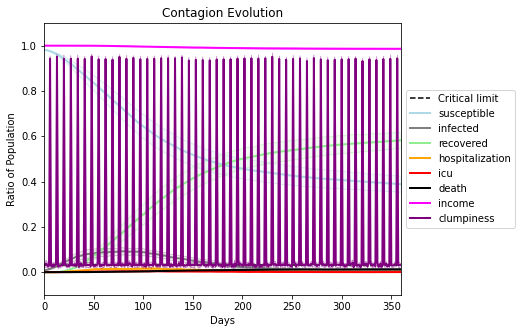

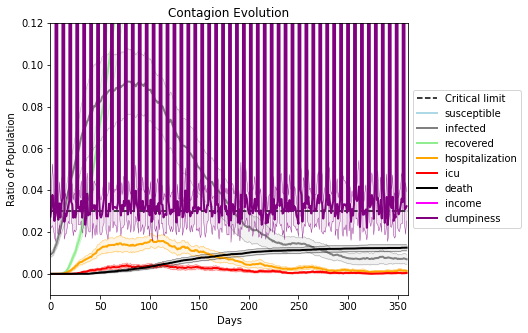

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8023, 661, 164, 8896, 1829, 4788, 2607, 4899, 8991, 7438, 9751, 9951, 8499, 5054, 2854, 4001, 722, 4353, 9137, 2279]
Average similarity between family members is 0.9197002106994115 at temperature -0.992
Average similarity between family and home is 0.999839685309532 at temperature -1
Average similarity between students and their classroom is 0.5108791519630743 at temperature -0.992
Average classroom occupancy is 4.318840579710145 and number classrooms is 69
Average similarity between workers is 0.8585831295478094 at temperature -0.992
Average office occupancy is 3.3435897435897437 and number offices is 195
Average friend similarity for adults: 0.8542648856291436 for kids: 0.6685865865545276
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5047696409334389
avg restaurant similarity 0.506449819802338
avg restaurant similarity 0.5848259028911448
avg restaurant similarity 0.5452508367125027
avg restaurant similarity 0.4968031946531437
avg restaurant similarity 0.5024364341162215
avg restaurant similarity 0.531355876330501
avg restaurant similarity 0.565220423865913
avg restaurant similarity 0.5130098795027378
avg restaurant similarity 0.5673089294417614
avg restaurant similarity 0.5154938652778037
avg restaurant similarity 0.4599404477384955
avg restaurant similarity 0.5886003703914948
avg restaurant similarity 0.49555343559970016
avg restaurant similarity 0.5512375669859808
avg restaurant similarity 0.5507193125825112
avg restaurant similarity 0.5495673772614235
avg restaurant similarity 0.4607960076358248
avg restaurant similarity 0.5324658150785507
avg restaurant similarity 0.4873523923299214
avg restaurant similarity 0.4965303350048123
avg restaurant similarity 0.5059784115893142
avg restaura

avg restaurant similarity 0.5350686266965692
avg restaurant similarity 0.43954520580375944
avg restaurant similarity 0.5221740193339887
avg restaurant similarity 0.4909462166861851
avg restaurant similarity 0.5678910430678925
avg restaurant similarity 0.5197604562792436
avg restaurant similarity 0.5421905243958974
avg restaurant similarity 0.5458029510139843
avg restaurant similarity 0.5296130804023458
avg restaurant similarity 0.5566103969744461
avg restaurant similarity 0.571342635538883
avg restaurant similarity 0.5018994074313259
avg restaurant similarity 0.5240511332063751
avg restaurant similarity 0.5129596493978267
avg restaurant similarity 0.48309712399467347
avg restaurant similarity 0.5096632043800743
avg restaurant similarity 0.5070857789224901
avg restaurant similarity 0.49375524885069216
avg restaurant similarity 0.5183944128018865
avg restaurant similarity 0.49996226773478325
avg restaurant similarity 0.5963352308181717
avg restaurant similarity 0.5566008146994132
avg res

avg restaurant similarity 0.5054725272383095
avg restaurant similarity 0.5168815738667782
avg restaurant similarity 0.5318249791475759
avg restaurant similarity 0.512446068140515
avg restaurant similarity 0.46639545097762014
avg restaurant similarity 0.46866535499844886
avg restaurant similarity 0.5375728934450467
avg restaurant similarity 0.4349317079204065
avg restaurant similarity 0.516597904232139
avg restaurant similarity 0.4258782839472578
avg restaurant similarity 0.4793185028536432
avg restaurant similarity 0.5302545155170475
avg restaurant similarity 0.4818202928457327
avg restaurant similarity 0.5467785874997878
avg restaurant similarity 0.5094846246826458
avg restaurant similarity 0.46134928505816675
avg restaurant similarity 0.5715688729454098
avg restaurant similarity 0.5651621064267889
avg restaurant similarity 0.5293576073028222
avg restaurant similarity 0.5438724448552599
avg restaurant similarity 0.5147787575163186
avg restaurant similarity 0.5005990064490906
avg resta

avg restaurant similarity 0.5322097817107485
avg restaurant similarity 0.49491970691124637
avg restaurant similarity 0.4834707055627285
avg restaurant similarity 0.5556479295119707
avg restaurant similarity 0.5061618860570221
avg restaurant similarity 0.5333438804921667
avg restaurant similarity 0.5319843725384905
avg restaurant similarity 0.4865961495593992
avg restaurant similarity 0.541622426731137
avg restaurant similarity 0.511132621837393
avg restaurant similarity 0.5823032903444629
avg restaurant similarity 0.5500009781290531
avg restaurant similarity 0.5261782436885346
avg restaurant similarity 0.5277798664227318
avg restaurant similarity 0.5269058234009423
avg restaurant similarity 0.5135798231947772
avg restaurant similarity 0.5687450525641568
avg restaurant similarity 0.5268895877824523
avg restaurant similarity 0.503942187941616
avg restaurant similarity 0.5439946124802006
avg restaurant similarity 0.5129245993452813
avg restaurant similarity 0.5022910714560901
avg restaura

avg restaurant similarity 0.5209754012102065
avg restaurant similarity 0.547009146873113
avg restaurant similarity 0.546295995018595
avg restaurant similarity 0.5499736667700428
avg restaurant similarity 0.5165424854531578
avg restaurant similarity 0.49580196545683614
avg restaurant similarity 0.5085694814363503
avg restaurant similarity 0.5301986988311261
avg restaurant similarity 0.5664978235398674
avg restaurant similarity 0.5742404241221325
avg restaurant similarity 0.5845891181376329
avg restaurant similarity 0.5071397393531116
avg restaurant similarity 0.5288858885295896
avg restaurant similarity 0.5660278644330805
avg restaurant similarity 0.5306747280157085
avg restaurant similarity 0.5126203352110962
avg restaurant similarity 0.5128998700756211
avg restaurant similarity 0.5608250753609748
avg restaurant similarity 0.4809943248155604
avg restaurant similarity 0.5008805201714075
avg restaurant similarity 0.5132361347887472
avg restaurant similarity 0.5631818729648445
avg restaur

avg restaurant similarity 0.519325865712039
avg restaurant similarity 0.5144888907291985
avg restaurant similarity 0.49603914115350434
avg restaurant similarity 0.5300544662817275
avg restaurant similarity 0.5327542082258516
avg restaurant similarity 0.5236100965810678
avg restaurant similarity 0.5017877539469585
avg restaurant similarity 0.5288777182218024
avg restaurant similarity 0.5447752606008959
avg restaurant similarity 0.5570078373756785
avg restaurant similarity 0.5919222632772245
avg restaurant similarity 0.580943020716907
avg restaurant similarity 0.5449028466739791
avg restaurant similarity 0.5470066859044473
avg restaurant similarity 0.5350380839175907
avg restaurant similarity 0.5497644413294228
avg restaurant similarity 0.4928243892797081
avg restaurant similarity 0.5500604973432761
avg restaurant similarity 0.5210112941385489
avg restaurant similarity 0.4876381749505638
avg restaurant similarity 0.5161305877477826
avg restaurant similarity 0.5367360699348803
avg restaur

avg restaurant similarity 0.5550137943958394
avg restaurant similarity 0.4990014172480115
avg restaurant similarity 0.5244059535330255
avg restaurant similarity 0.500214138559169
avg restaurant similarity 0.5185225018176224
avg restaurant similarity 0.525664518028337
avg restaurant similarity 0.46948999760048726
avg restaurant similarity 0.5550427186602203
avg restaurant similarity 0.5290663251599762
avg restaurant similarity 0.5456353123416813
avg restaurant similarity 0.5307512477278383
avg restaurant similarity 0.6001228334463911
avg restaurant similarity 0.5480054601682353
avg restaurant similarity 0.5133868178424142
avg restaurant similarity 0.5255558176003253
avg restaurant similarity 0.5337780947448515
avg restaurant similarity 0.5319248711231371
avg restaurant similarity 0.5568328891114501
avg restaurant similarity 0.4982790487883178
avg restaurant similarity 0.5448187016438739
avg restaurant similarity 0.5666019345983893
avg restaurant similarity 0.5265354092646076
avg restaur

avg restaurant similarity 0.5104538077054185
avg restaurant similarity 0.5082615239362283
avg restaurant similarity 0.5275977812627473
avg restaurant similarity 0.5524097080878583
avg restaurant similarity 0.46489624747797403
avg restaurant similarity 0.5100521048395922
avg restaurant similarity 0.5403385741038867
avg restaurant similarity 0.5080259871518747
avg restaurant similarity 0.48852000649083965
avg restaurant similarity 0.5008412458476116
avg restaurant similarity 0.5073406266564057
avg restaurant similarity 0.5093286297666874
avg restaurant similarity 0.5009383079654779
avg restaurant similarity 0.5195105670382499
avg restaurant similarity 0.4828664199622663
avg restaurant similarity 0.5639172257704024
avg restaurant similarity 0.5093221591344191
avg restaurant similarity 0.4991593672024475
avg restaurant similarity 0.5100173189109382
avg restaurant similarity 0.5409288460113157
avg restaurant similarity 0.4655630667742805
avg restaurant similarity 0.5186748305765411
avg rest

avg restaurant similarity 0.462614663911983
avg restaurant similarity 0.4594395811762755
avg restaurant similarity 0.5095826067144236
avg restaurant similarity 0.4763264689154538
avg restaurant similarity 0.5298567465972333
avg restaurant similarity 0.5040787940183243
avg restaurant similarity 0.5270704434329471
avg restaurant similarity 0.4767860813837147
avg restaurant similarity 0.5010709953640159
avg restaurant similarity 0.5054216738754362
avg restaurant similarity 0.486282719124789
avg restaurant similarity 0.43839098401580573
avg restaurant similarity 0.5420978019760965
avg restaurant similarity 0.4715761381745507
avg restaurant similarity 0.40631032443038806
avg restaurant similarity 0.5068879097842985
avg restaurant similarity 0.4886037035168126
avg restaurant similarity 0.4759422006760228
avg restaurant similarity 0.45573101014899203
avg restaurant similarity 0.5437396905754718
avg restaurant similarity 0.4913117411314825
avg restaurant similarity 0.490575664011435
avg restau

avg restaurant similarity 0.4607912803238368
avg restaurant similarity 0.5397166317869335
avg restaurant similarity 0.5068809005684691
avg restaurant similarity 0.5466022893348524
avg restaurant similarity 0.4761766404921766
avg restaurant similarity 0.4802518265256609
avg restaurant similarity 0.49712497522415205
avg restaurant similarity 0.4758338513333928
avg restaurant similarity 0.47426049944338394
avg restaurant similarity 0.452242963214596
avg restaurant similarity 0.5915632077420263
avg restaurant similarity 0.5129200225109516
avg restaurant similarity 0.4945729400934594
avg restaurant similarity 0.5038177981122857
avg restaurant similarity 0.4464263908457626
avg restaurant similarity 0.5133979282737763
avg restaurant similarity 0.5230996227934902
avg restaurant similarity 0.5478269764368178
avg restaurant similarity 0.4924905702616428
avg restaurant similarity 0.49958836897557685
avg restaurant similarity 0.4948350206634888
avg restaurant similarity 0.46731680028363987
avg res

avg restaurant similarity 0.5598449689354285
avg restaurant similarity 0.5193435626087535
avg restaurant similarity 0.4950577282490473
avg restaurant similarity 0.49869730658484784
avg restaurant similarity 0.48823684170645304
avg restaurant similarity 0.46482231225621184
avg restaurant similarity 0.49313384709416663
avg restaurant similarity 0.524695592870037
avg restaurant similarity 0.5666768527974284
avg restaurant similarity 0.5589176471234937
avg restaurant similarity 0.5648728301204208
avg restaurant similarity 0.534129837541347
avg restaurant similarity 0.5439939392333702
avg restaurant similarity 0.5421441603601254
avg restaurant similarity 0.5304549257383981
avg restaurant similarity 0.5612445434756433
avg restaurant similarity 0.5773739524123837
avg restaurant similarity 0.5510155454921408
avg restaurant similarity 0.5544511235481184
avg restaurant similarity 0.571410200913673
avg restaurant similarity 0.513050953574144
avg restaurant similarity 0.5551358123592843
avg restau

avg restaurant similarity 0.5635598274058266
avg restaurant similarity 0.5175975516722588
avg restaurant similarity 0.558839819467848
avg restaurant similarity 0.5459029649989077
avg restaurant similarity 0.5822346347015912
avg restaurant similarity 0.5077506320146724
avg restaurant similarity 0.53590435297334
avg restaurant similarity 0.5480855686693714
avg restaurant similarity 0.5892708079837775
avg restaurant similarity 0.6060776241706857
avg restaurant similarity 0.5402352146644295
avg restaurant similarity 0.5232558399910994
avg restaurant similarity 0.5615704156820228
avg restaurant similarity 0.56803825308251
avg restaurant similarity 0.5365591580544434
avg restaurant similarity 0.5445390802748441
avg restaurant similarity 0.4561978565909081
avg restaurant similarity 0.5396867538662815
avg restaurant similarity 0.6234600587572249
avg restaurant similarity 0.5595074376277457
avg restaurant similarity 0.5022404004434923
avg restaurant similarity 0.6214322536625757
avg restaurant 

avg restaurant similarity 0.5495304145553402
avg restaurant similarity 0.5648763155160799
avg restaurant similarity 0.545192090036222
avg restaurant similarity 0.5278482633696674
avg restaurant similarity 0.5191495622002277
avg restaurant similarity 0.5201714204832546
avg restaurant similarity 0.5463148685930775
avg restaurant similarity 0.5466849608567794
avg restaurant similarity 0.561094998092547
avg restaurant similarity 0.542856763312062
avg restaurant similarity 0.5643655585258633
avg restaurant similarity 0.5163902863931994
avg restaurant similarity 0.5352610963865111
avg restaurant similarity 0.553572791331828
avg restaurant similarity 0.5924264256657108
avg restaurant similarity 0.5388123154017052
avg restaurant similarity 0.5247454992401746
avg restaurant similarity 0.5671087049404937
avg restaurant similarity 0.5795800139438894
avg restaurant similarity 0.4761287866628354
avg restaurant similarity 0.5771445927774188
avg restaurant similarity 0.5049733580878656
avg restaurant

avg restaurant similarity 0.5419795700842264
avg restaurant similarity 0.5392599686377926
avg restaurant similarity 0.5801996943006463
avg restaurant similarity 0.5599058862687074
avg restaurant similarity 0.513034195859413
avg restaurant similarity 0.5519878755224008
avg restaurant similarity 0.5283241364251439
avg restaurant similarity 0.5309210308743346
avg restaurant similarity 0.5575351256489814
avg restaurant similarity 0.5324954914013202
avg restaurant similarity 0.5742352079376899
avg restaurant similarity 0.5182345402037514
avg restaurant similarity 0.5229352420497444
avg restaurant similarity 0.5483940482520284
avg restaurant similarity 0.5833933313439107
avg restaurant similarity 0.519962146582702
avg restaurant similarity 0.5191578682411125
avg restaurant similarity 0.48864630596807784
avg restaurant similarity 0.5616175398369024
avg restaurant similarity 0.4965555063771975
avg restaurant similarity 0.5498265853096578
avg restaurant similarity 0.552216759707264
avg restaura

avg restaurant similarity 0.588840325030479
avg restaurant similarity 0.5540989614230226
avg restaurant similarity 0.5148074903529041
avg restaurant similarity 0.5335324078105951
avg restaurant similarity 0.5373174893840166
avg restaurant similarity 0.6113944813835677
avg restaurant similarity 0.5811125847016783
avg restaurant similarity 0.5356952795860929
avg restaurant similarity 0.5582920274300592
avg restaurant similarity 0.522946528109553
avg restaurant similarity 0.5633557253572088
avg restaurant similarity 0.5534950887346347
avg restaurant similarity 0.5370465860261777
avg restaurant similarity 0.5896445552649208
avg restaurant similarity 0.5499624505424172
avg restaurant similarity 0.5414083035110687
avg restaurant similarity 0.5748199008247619
avg restaurant similarity 0.5345351774393257
avg restaurant similarity 0.5115315418421262
avg restaurant similarity 0.5618717715395349
avg restaurant similarity 0.5715150764079788
avg restaurant similarity 0.522987174123679
avg restauran

avg restaurant similarity 0.5057127789175144
avg restaurant similarity 0.5751402104144847
avg restaurant similarity 0.5906438794588533
avg restaurant similarity 0.5577540206431294
avg restaurant similarity 0.5315565379522587
avg restaurant similarity 0.5217297573660561
avg restaurant similarity 0.5858761105307183
avg restaurant similarity 0.5462265245922048
avg restaurant similarity 0.5679933485670743
avg restaurant similarity 0.5198444495107166
avg restaurant similarity 0.5532445168773505
avg restaurant similarity 0.6669772758550953
avg restaurant similarity 0.5738411823539741
avg restaurant similarity 0.5153725834577036
avg restaurant similarity 0.5449797617483751
avg restaurant similarity 0.6213075379654942
avg restaurant similarity 0.5299709377837868
avg restaurant similarity 0.5661784356098358
avg restaurant similarity 0.6220269886504806
avg restaurant similarity 0.543553627496189
avg restaurant similarity 0.6000030047039911
avg restaurant similarity 0.5546830454700433
avg restaur

avg restaurant similarity 0.5317813029903122
avg restaurant similarity 0.5983270992697627
avg restaurant similarity 0.5862773942371904
avg restaurant similarity 0.571103940160086
avg restaurant similarity 0.544980890918276
avg restaurant similarity 0.5510128357071898
avg restaurant similarity 0.5670012882529188
avg restaurant similarity 0.5493238447117045
avg restaurant similarity 0.5056197129586143
avg restaurant similarity 0.5411189393320697
avg restaurant similarity 0.5387745025981304
avg restaurant similarity 0.5160160567837699
avg restaurant similarity 0.540734473268989
avg restaurant similarity 0.5492771406215603
avg restaurant similarity 0.578579822214096
avg restaurant similarity 0.5330996179714665
avg restaurant similarity 0.5103132756922455
avg restaurant similarity 0.5504524100221004
avg restaurant similarity 0.5187004477156244
avg restaurant similarity 0.5365041973569423
avg restaurant similarity 0.5610202802816787
avg restaurant similarity 0.5663049529655597
avg restaurant

avg restaurant similarity 0.5861269957147879
avg restaurant similarity 0.5249844774653943
avg restaurant similarity 0.5619322695243373
avg restaurant similarity 0.558097850683591
avg restaurant similarity 0.581823352223032
avg restaurant similarity 0.5679221494692879
avg restaurant similarity 0.5679059328149669
avg restaurant similarity 0.5675719229555453
avg restaurant similarity 0.6249677872221723
avg restaurant similarity 0.5218512998306722
avg restaurant similarity 0.5394485033654886
avg restaurant similarity 0.540385143338508
avg restaurant similarity 0.5910738634500979
avg restaurant similarity 0.5766946547318534
avg restaurant similarity 0.5735123880147234
avg restaurant similarity 0.61017269184932
avg restaurant similarity 0.5434582901578452
avg restaurant similarity 0.5215904862554591
avg restaurant similarity 0.5618032325193543
avg restaurant similarity 0.595733581837615
avg restaurant similarity 0.5368078473208631
avg restaurant similarity 0.5815930287435105
avg restaurant s

avg restaurant similarity 0.5520794670769754
avg restaurant similarity 0.531422905068762
avg restaurant similarity 0.5439507696425897
avg restaurant similarity 0.5244135773868165
avg restaurant similarity 0.4785647700060794
avg restaurant similarity 0.5278148617791119
avg restaurant similarity 0.580455527586109
avg restaurant similarity 0.52957599605819
avg restaurant similarity 0.5352814806837305
avg restaurant similarity 0.5503055618144729
avg restaurant similarity 0.5076614172987598
avg restaurant similarity 0.5222437374975463
avg restaurant similarity 0.5618770249627372
avg restaurant similarity 0.4981557178496447
avg restaurant similarity 0.5525910735661306
avg restaurant similarity 0.5687785544877559
avg restaurant similarity 0.5520934185140769
avg restaurant similarity 0.5748428411769013
avg restaurant similarity 0.5400535702661369
avg restaurant similarity 0.5678083022197031
avg restaurant similarity 0.529021924120898
avg restaurant similarity 0.54325979673524
avg restaurant si

avg restaurant similarity 0.49846720355367846
avg restaurant similarity 0.6063838635473306
avg restaurant similarity 0.52616470020113
avg restaurant similarity 0.5680795324022161
avg restaurant similarity 0.5595489684557367
avg restaurant similarity 0.5102602304305286
avg restaurant similarity 0.5326310785794685
avg restaurant similarity 0.4978085718587981
avg restaurant similarity 0.4922330549585909
avg restaurant similarity 0.5676657288672231
avg restaurant similarity 0.5630126451432701
avg restaurant similarity 0.5477238183624827
avg restaurant similarity 0.531361890836581
avg restaurant similarity 0.543255879802121
avg restaurant similarity 0.5366518575568313
avg restaurant similarity 0.5371524886893517
avg restaurant similarity 0.570312632100491
avg restaurant similarity 0.5734286225860131
avg restaurant similarity 0.5816795798350572
avg restaurant similarity 0.5451475841524365
avg restaurant similarity 0.5592132411734366
avg restaurant similarity 0.5313600202850495
avg restaurant

avg restaurant similarity 0.5328916917595611
avg restaurant similarity 0.5534753893735459
avg restaurant similarity 0.5285225426697737
avg restaurant similarity 0.5838897333122596
avg restaurant similarity 0.46919355302743565
avg restaurant similarity 0.5565815169072054
avg restaurant similarity 0.5857221222166239
avg restaurant similarity 0.4957722890816936
avg restaurant similarity 0.5032431448332647
avg restaurant similarity 0.5250665075576886
avg restaurant similarity 0.5110410096289144
avg restaurant similarity 0.5725658315223271
avg restaurant similarity 0.5692681608545824
avg restaurant similarity 0.5401664028524994
avg restaurant similarity 0.5248605207746279
avg restaurant similarity 0.5666997632507311
avg restaurant similarity 0.5339171920426997
avg restaurant similarity 0.46813500284735793
avg restaurant similarity 0.5611787994122623
avg restaurant similarity 0.5580536294496683
avg restaurant similarity 0.5863473961166068
avg restaurant similarity 0.47723962650091895
avg res

avg restaurant similarity 0.5236562373530927
avg restaurant similarity 0.4993383670860649
avg restaurant similarity 0.5442159702856937
avg restaurant similarity 0.5176229214316614
avg restaurant similarity 0.5605006114950156
avg restaurant similarity 0.5153860692454477
avg restaurant similarity 0.48060637848549903
avg restaurant similarity 0.5422962389040784
avg restaurant similarity 0.47815022691879056
avg restaurant similarity 0.5228594030178196
avg restaurant similarity 0.5386284386617656
avg restaurant similarity 0.4351265897712414
avg restaurant similarity 0.5404218684354067
avg restaurant similarity 0.5129924020254297
avg restaurant similarity 0.5476983127401682
avg restaurant similarity 0.5317152225476236
avg restaurant similarity 0.5280113885517279
avg restaurant similarity 0.532760600189258
avg restaurant similarity 0.5096277831407177
avg restaurant similarity 0.5597320515870555
avg restaurant similarity 0.537091817251345
avg restaurant similarity 0.4655109049517319
avg restau

avg restaurant similarity 0.5373421198292193
avg restaurant similarity 0.5429783253764547
avg restaurant similarity 0.5670285832898027
avg restaurant similarity 0.5242397683808918
avg restaurant similarity 0.5449785631653112
avg restaurant similarity 0.5255364471699825
avg restaurant similarity 0.5090795431823463
avg restaurant similarity 0.5715712940756184
avg restaurant similarity 0.5157698253418911
avg restaurant similarity 0.5162371767344535
avg restaurant similarity 0.5550374044997787
avg restaurant similarity 0.5251744147607991
avg restaurant similarity 0.5002511171407303
avg restaurant similarity 0.4749858536932591
avg restaurant similarity 0.5171283431860088
avg restaurant similarity 0.5402411235317846
avg restaurant similarity 0.554214276926037
avg restaurant similarity 0.527171487981277
avg restaurant similarity 0.4892160496351508
avg restaurant similarity 0.5298263003484271
avg restaurant similarity 0.5603580855107777
avg restaurant similarity 0.5075134867504982
avg restaura

avg restaurant similarity 0.5468939307387242
avg restaurant similarity 0.5576363914881977
avg restaurant similarity 0.4945097722464942
avg restaurant similarity 0.5469948102904754
avg restaurant similarity 0.568693772498936
avg restaurant similarity 0.5123351445197664
avg restaurant similarity 0.5432767157575822
avg restaurant similarity 0.4965475615497345
avg restaurant similarity 0.5307736189521983
avg restaurant similarity 0.5775455801164856
avg restaurant similarity 0.5418020921396137
avg restaurant similarity 0.5553160796429151
avg restaurant similarity 0.5387762475845229
avg restaurant similarity 0.5778235420536663
avg restaurant similarity 0.5597440599573656
avg restaurant similarity 0.5524072700996893
avg restaurant similarity 0.5425627855942582
avg restaurant similarity 0.5566685507055259
avg restaurant similarity 0.5495534857278758
avg restaurant similarity 0.5406165468162436
avg restaurant similarity 0.546267567458042
avg restaurant similarity 0.5275883751178503
avg restaura

avg restaurant similarity 0.5753038365118605
avg restaurant similarity 0.5580267898809925
avg restaurant similarity 0.5098234155551491
avg restaurant similarity 0.5723095426788876
avg restaurant similarity 0.47723619806779183
avg restaurant similarity 0.5116880417513188
avg restaurant similarity 0.44833567560132065
avg restaurant similarity 0.4843479586467877
avg restaurant similarity 0.5386411208114353
avg restaurant similarity 0.5718722444924048
avg restaurant similarity 0.5754643945929484
avg restaurant similarity 0.5351254644784335
avg restaurant similarity 0.5752413670359275
avg restaurant similarity 0.5395452226953482
avg restaurant similarity 0.5026588634753073
avg restaurant similarity 0.5345604277820142
avg restaurant similarity 0.5187040702367307
avg restaurant similarity 0.5666475845251998
avg restaurant similarity 0.5045559455263048
avg restaurant similarity 0.5493641843292785
avg restaurant similarity 0.5413237347414148
avg restaurant similarity 0.5159803235665077
avg rest

avg restaurant similarity 0.5543169772719398
avg restaurant similarity 0.5293111065647159
avg restaurant similarity 0.4722872706627257
avg restaurant similarity 0.5536856324678733
avg restaurant similarity 0.4921383344592326
avg restaurant similarity 0.5748639324723362
avg restaurant similarity 0.607698437364614
avg restaurant similarity 0.5450736734473912
avg restaurant similarity 0.5631809541100702
avg restaurant similarity 0.5372145845227481
avg restaurant similarity 0.5130368450631113
avg restaurant similarity 0.541639064000364
avg restaurant similarity 0.5432331729901821
avg restaurant similarity 0.5494532310708365
avg restaurant similarity 0.5349617502292807
avg restaurant similarity 0.5359183989926796
avg restaurant similarity 0.4801429765279575
avg restaurant similarity 0.5799695564788038
avg restaurant similarity 0.5225024439241585
avg restaurant similarity 0.491051490516187
avg restaurant similarity 0.5265110301559094
avg restaurant similarity 0.539222712620101
avg restaurant

avg restaurant similarity 0.5642649800180729
avg restaurant similarity 0.5555509853432026
avg restaurant similarity 0.5483466443739536
avg restaurant similarity 0.541415814021069
avg restaurant similarity 0.5555082345430035
avg restaurant similarity 0.5392513259471231
avg restaurant similarity 0.5637056676333835
avg restaurant similarity 0.543103392993995
avg restaurant similarity 0.548740311607517
avg restaurant similarity 0.5666375479743335
avg restaurant similarity 0.5142073081449215
avg restaurant similarity 0.5552657418481991
avg restaurant similarity 0.5757454700133418
avg restaurant similarity 0.585238718761662
avg restaurant similarity 0.5573697126955505
avg restaurant similarity 0.5865180423432919
avg restaurant similarity 0.6116186192874669
avg restaurant similarity 0.4973910141319527
avg restaurant similarity 0.546729939142652
avg restaurant similarity 0.5477294598501228
avg restaurant similarity 0.5702934578428251
avg restaurant similarity 0.5344421924218551
avg restaurant 

avg restaurant similarity 0.5472362747108451
avg restaurant similarity 0.5369657985598341
avg restaurant similarity 0.5806936766692987
avg restaurant similarity 0.5523958708565494
avg restaurant similarity 0.5771151190382094
avg restaurant similarity 0.5376763650208419
avg restaurant similarity 0.5251445028339516
avg restaurant similarity 0.554457147745225
avg restaurant similarity 0.5342183298276872
avg restaurant similarity 0.5581156582094202
avg restaurant similarity 0.5368699236416334
avg restaurant similarity 0.549358795826018
avg restaurant similarity 0.5695107573274737
avg restaurant similarity 0.47047045091560835
avg restaurant similarity 0.5783187219147141
avg restaurant similarity 0.5242626479336053
avg restaurant similarity 0.583598643996939
avg restaurant similarity 0.5225389648889501
avg restaurant similarity 0.5487807406995614
avg restaurant similarity 0.5348285422110225
avg restaurant similarity 0.49471363347274566
avg restaurant similarity 0.5238468824602018
avg restaur

avg restaurant similarity 0.5201510251530458
avg restaurant similarity 0.5928497990443798
avg restaurant similarity 0.5720716018724962
avg restaurant similarity 0.5668146630567032
avg restaurant similarity 0.5318311777867816
avg restaurant similarity 0.6042091467101365
avg restaurant similarity 0.6099502414162876
avg restaurant similarity 0.5834656703790878
avg restaurant similarity 0.5194256250517305
avg restaurant similarity 0.5541419795755753
avg restaurant similarity 0.5378992593226035
avg restaurant similarity 0.5395775126299617
avg restaurant similarity 0.522311270131545
avg restaurant similarity 0.5220169223941534
avg restaurant similarity 0.588078361052859
avg restaurant similarity 0.5364680830926772
avg restaurant similarity 0.5808663777111518
avg restaurant similarity 0.4999954244735022
avg restaurant similarity 0.5668527253357749
avg restaurant similarity 0.5395185214401632
avg restaurant similarity 0.5648948229522402
avg restaurant similarity 0.4986247662845102
avg restaura

avg restaurant similarity 0.5629510699739803
avg restaurant similarity 0.6041501911494972
avg restaurant similarity 0.5364784354511006
avg restaurant similarity 0.5320493605187574
avg restaurant similarity 0.5813196083683158
avg restaurant similarity 0.5595027954153585
avg restaurant similarity 0.5749922404076204
avg restaurant similarity 0.5328824003638277
avg restaurant similarity 0.5203843623826128
avg restaurant similarity 0.4873551877978525
avg restaurant similarity 0.5579136551573243
avg restaurant similarity 0.5773897589246996
avg restaurant similarity 0.5359553680070913
avg restaurant similarity 0.5607519227918951
avg restaurant similarity 0.5167756502557894
avg restaurant similarity 0.5889546562100383
avg restaurant similarity 0.5724642855261923
avg restaurant similarity 0.5273591189760111
avg restaurant similarity 0.49900637383515867
avg restaurant similarity 0.5548644548275952
avg restaurant similarity 0.5539679711830535
avg restaurant similarity 0.5422697271592103
avg resta

avg restaurant similarity 0.6018417175045507
avg restaurant similarity 0.6347312044612524
avg restaurant similarity 0.551643067937685
avg restaurant similarity 0.5882283720082137
avg restaurant similarity 0.5406446570217578
avg restaurant similarity 0.562559233893896
avg restaurant similarity 0.6060479522544875
avg restaurant similarity 0.5483601330320217
avg restaurant similarity 0.5789491953740223
avg restaurant similarity 0.5798640828383875
avg restaurant similarity 0.46714980016715185
avg restaurant similarity 0.5004972293865051
avg restaurant similarity 0.5518453183136364
avg restaurant similarity 0.532263685835922
avg restaurant similarity 0.584663051582811
avg restaurant similarity 0.5958020826528659
avg restaurant similarity 0.5623222072327676
avg restaurant similarity 0.583245162746747
avg restaurant similarity 0.5465239319662311
avg restaurant similarity 0.5380976757069093
avg restaurant similarity 0.599681479126395
avg restaurant similarity 0.5689849541074459
avg restaurant 

avg restaurant similarity 0.5749802307621188
avg restaurant similarity 0.6069197956765523
avg restaurant similarity 0.5174650172550961
avg restaurant similarity 0.5905490036050587
avg restaurant similarity 0.5228173921152414
avg restaurant similarity 0.5440512207440839
avg restaurant similarity 0.5223227983543428
avg restaurant similarity 0.5072785610893349
avg restaurant similarity 0.5390033749955744
avg restaurant similarity 0.603600637937939
avg restaurant similarity 0.6092990129657417
avg restaurant similarity 0.5447520863121224
avg restaurant similarity 0.5768182212927209
avg restaurant similarity 0.5911698045851413
avg restaurant similarity 0.5558221442132835
avg restaurant similarity 0.5613457068054821
avg restaurant similarity 0.5984831514193529
avg restaurant similarity 0.5067407999470545
avg restaurant similarity 0.5879262268464934
avg restaurant similarity 0.5874170363236129
avg restaurant similarity 0.6125082797379124
avg restaurant similarity 0.5359599419307368
avg restaur

avg restaurant similarity 0.5952853808485624
avg restaurant similarity 0.5442832023442402
avg restaurant similarity 0.515852597454899
avg restaurant similarity 0.4884608633556531
avg restaurant similarity 0.49200187949507906
avg restaurant similarity 0.5588763782762856
avg restaurant similarity 0.4743098315367399
avg restaurant similarity 0.48927503492951124
avg restaurant similarity 0.47750956006878703
avg restaurant similarity 0.5223574338472269
avg restaurant similarity 0.5154783539622642
avg restaurant similarity 0.5763719309530382
avg restaurant similarity 0.5015952526086799
avg restaurant similarity 0.52662614655773
avg restaurant similarity 0.534326426192771
avg restaurant similarity 0.5300396966677186
avg restaurant similarity 0.5064153289562144
avg restaurant similarity 0.5729014709468169
avg restaurant similarity 0.552267610509168
avg restaurant similarity 0.5133242470363516
avg restaurant similarity 0.5292611073317433
avg restaurant similarity 0.4826266810430376
avg restaura

avg restaurant similarity 0.5116459759576609
avg restaurant similarity 0.5004979743606158
avg restaurant similarity 0.5781318867567572
avg restaurant similarity 0.5533349651757125
avg restaurant similarity 0.5114201323984622
avg restaurant similarity 0.5146999213845576
avg restaurant similarity 0.5266252039852318
avg restaurant similarity 0.5567277750068943
avg restaurant similarity 0.5440316074000644
avg restaurant similarity 0.5170932800749602
avg restaurant similarity 0.5044547293368042
avg restaurant similarity 0.5479012957447535
avg restaurant similarity 0.5649003631512375
avg restaurant similarity 0.5183017952645768
avg restaurant similarity 0.5190728103154613
avg restaurant similarity 0.5788090485195465
avg restaurant similarity 0.5439554295075786
avg restaurant similarity 0.531894665470307
avg restaurant similarity 0.49797053704220295
avg restaurant similarity 0.4925943740790892
avg restaurant similarity 0.5700198166514789
avg restaurant similarity 0.5443492661036233
avg restau

avg restaurant similarity 0.5877895925574927
avg restaurant similarity 0.5775183382677588
avg restaurant similarity 0.5273493557763709
avg restaurant similarity 0.5746331616941648
avg restaurant similarity 0.5850459358495762
avg restaurant similarity 0.5502884071317229
avg restaurant similarity 0.5564929979350914
avg restaurant similarity 0.5729386334529223
avg restaurant similarity 0.5241021705906022
avg restaurant similarity 0.594683394309187
avg restaurant similarity 0.5772986046532517
avg restaurant similarity 0.5425939424534855
avg restaurant similarity 0.5467676609908927
avg restaurant similarity 0.5782987868197264
avg restaurant similarity 0.5776464409307678
avg restaurant similarity 0.5212327963443165
avg restaurant similarity 0.5463525045214614
avg restaurant similarity 0.5612583298143725
avg restaurant similarity 0.5895038976039239
avg restaurant similarity 0.5352038299273366
avg restaurant similarity 0.5493471003091599
avg restaurant similarity 0.49703854891415866
avg restau

avg restaurant similarity 0.5685395369337747
avg restaurant similarity 0.5211134273050019
avg restaurant similarity 0.5611744299039096
avg restaurant similarity 0.6073054462045181
avg restaurant similarity 0.48695617782163686
avg restaurant similarity 0.5608122043607849
avg restaurant similarity 0.5622895153099102
avg restaurant similarity 0.48870183169519893
avg restaurant similarity 0.5160546510105479
avg restaurant similarity 0.553356105425187
avg restaurant similarity 0.5565966532326446
avg restaurant similarity 0.5521108504318989
avg restaurant similarity 0.557947642293752
avg restaurant similarity 0.5552072521749473
avg restaurant similarity 0.5488279436283251
avg restaurant similarity 0.5603784568697043
avg restaurant similarity 0.556115258445475
avg restaurant similarity 0.5324930149058321
avg restaurant similarity 0.5106490632534787
avg restaurant similarity 0.5395471461036911
avg restaurant similarity 0.5980755837674466
avg restaurant similarity 0.5706371714205203
avg restaur

avg restaurant similarity 0.5048659902772795
avg restaurant similarity 0.5876112155651458
avg restaurant similarity 0.5410037704677825
avg restaurant similarity 0.5050735068812942
avg restaurant similarity 0.5762082418332966
avg restaurant similarity 0.5236531324027244
avg restaurant similarity 0.4894998802454578
avg restaurant similarity 0.5743617147561425
avg restaurant similarity 0.5655018594391225
avg restaurant similarity 0.5412733986685035
avg restaurant similarity 0.5165415460899629
avg restaurant similarity 0.576419370436286
avg restaurant similarity 0.5871937980932751
avg restaurant similarity 0.6062703102897475
avg restaurant similarity 0.5487297520366928
avg restaurant similarity 0.49254650360720875
avg restaurant similarity 0.4891771380782981
avg restaurant similarity 0.5483369172782673
avg restaurant similarity 0.5065100495636305
avg restaurant similarity 0.5645907744498058
avg restaurant similarity 0.5724251460092251
avg restaurant similarity 0.5179893500649044
avg restau

avg restaurant similarity 0.5132434168492376
avg restaurant similarity 0.5213308805623605
avg restaurant similarity 0.4784257903395273
avg restaurant similarity 0.5749631464941278
avg restaurant similarity 0.5911491008026214
avg restaurant similarity 0.5505993369374672
avg restaurant similarity 0.5455215681313749
avg restaurant similarity 0.5339948826328929
avg restaurant similarity 0.5561630071603806
avg restaurant similarity 0.5567101768624214
avg restaurant similarity 0.5328173579579872
avg restaurant similarity 0.4842945660298663
avg restaurant similarity 0.5136076981138482
avg restaurant similarity 0.57769410432714
avg restaurant similarity 0.556686207907866
avg restaurant similarity 0.5296430301895029
avg restaurant similarity 0.4929040843378564
avg restaurant similarity 0.5207838420991077
avg restaurant similarity 0.5931350539534027
avg restaurant similarity 0.495556866294197
avg restaurant similarity 0.55615370169392
avg restaurant similarity 0.5597714296343421
avg restaurant s

avg restaurant similarity 0.531561539983093
avg restaurant similarity 0.5320430014417226
avg restaurant similarity 0.5662619200023995
avg restaurant similarity 0.5168938689587407
avg restaurant similarity 0.5257944424329294
avg restaurant similarity 0.486107132298516
avg restaurant similarity 0.5403625051428655
avg restaurant similarity 0.47196120918859297
avg restaurant similarity 0.5241127251674176
avg restaurant similarity 0.48344601775184204
avg restaurant similarity 0.5007719718962435
avg restaurant similarity 0.47435658568331507
avg restaurant similarity 0.4621685199246741
avg restaurant similarity 0.4725804851152833
avg restaurant similarity 0.5183651391977994
avg restaurant similarity 0.4905284459888592
avg restaurant similarity 0.5047511229823634
avg restaurant similarity 0.46571009840040534
avg restaurant similarity 0.5043140865193867
avg restaurant similarity 0.4696955601642867
avg restaurant similarity 0.54809599827165
avg restaurant similarity 0.45649139212699585
avg resta

avg restaurant similarity 0.5157807240264332
avg restaurant similarity 0.536619027823932
avg restaurant similarity 0.48355643286572725
avg restaurant similarity 0.46940489918059
avg restaurant similarity 0.4787979077453509
avg restaurant similarity 0.4473071544754181
avg restaurant similarity 0.5063082528307117
avg restaurant similarity 0.5057821615301362
avg restaurant similarity 0.5357631241692448
avg restaurant similarity 0.494519605551267
avg restaurant similarity 0.5034174017629467
avg restaurant similarity 0.48109667466645584
avg restaurant similarity 0.48464088964346574
avg restaurant similarity 0.5458359519289396
avg restaurant similarity 0.464210137095621
avg restaurant similarity 0.4660684404166076
avg restaurant similarity 0.5179122648068314
avg restaurant similarity 0.5179583374405204
avg restaurant similarity 0.5072115882780094
avg restaurant similarity 0.46727382394579875
avg restaurant similarity 0.5123779539602255
avg restaurant similarity 0.4870568763579154
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

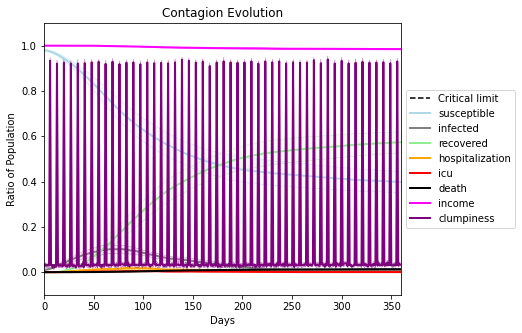

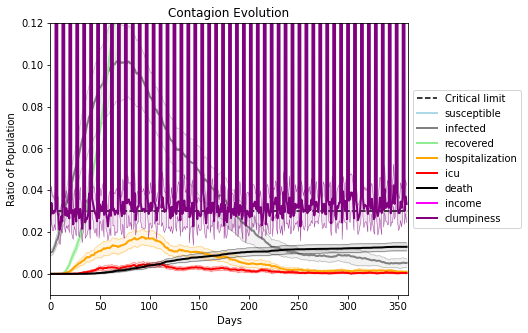

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6568, 7784, 3189, 5585, 9998, 7844, 2904, 8316, 9687, 6253, 4626, 6515, 3909, 6796, 5438, 8245, 9641, 5404, 6446, 1167]
Average similarity between family members is 0.9123562182939993 at temperature -0.991
Average similarity between family and home is 0.9998572793326368 at temperature -1
Average similarity between students and their classroom is 0.5242913807079471 at temperature -0.991
Average classroom occupancy is 4.0588235294117645 and number classrooms is 68
Average similarity between workers is 0.8367828461633042 at temperature -0.991
Average office occupancy is 3.5077720207253886 and number offices is 193
Average friend similarity for adults: 0.8312049131065096 for kids: 0.6478526387558554
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.4764743790153114
avg restaurant similarity 0.49887784888599335
avg restaurant similarity 0.5533341801098248
avg restaurant similarity 0.5471552286976552
avg restaurant similarity 0.558999449517886
avg restaurant similarity 0.4542888517355552
avg restaurant similarity 0.5276079586794259
avg restaurant similarity 0.5432415446854961
avg restaurant similarity 0.534806859165229
avg restaurant similarity 0.5627156274038809
avg restaurant similarity 0.5186274872363835
avg restaurant similarity 0.49838824098111717
avg restaurant similarity 0.5161950647529161
avg restaurant similarity 0.547616789761339
avg restaurant similarity 0.49552222230665965
avg restaurant similarity 0.49924624765751174
avg restaurant similarity 0.4869466235816812
avg restaurant similarity 0.578565448120725
avg restaurant similarity 0.5669796451295305
avg restaurant similarity 0.4988927733367812
avg restaurant similarity 0.5255951088120435
avg restaurant similarity 0.5534875770887372
avg restau

avg restaurant similarity 0.5041388906785732
avg restaurant similarity 0.522884224858865
avg restaurant similarity 0.5328854928371507
avg restaurant similarity 0.5180344913459445
avg restaurant similarity 0.49432602083586635
avg restaurant similarity 0.5586080778625335
avg restaurant similarity 0.4812951107536607
avg restaurant similarity 0.48149549526508134
avg restaurant similarity 0.5221461080180013
avg restaurant similarity 0.47286677681355477
avg restaurant similarity 0.4877655292590973
avg restaurant similarity 0.5532324103763538
avg restaurant similarity 0.4998532970841192
avg restaurant similarity 0.5456234606007536
avg restaurant similarity 0.5721200375301622
avg restaurant similarity 0.5514467099904868
avg restaurant similarity 0.5638855817351619
avg restaurant similarity 0.5431227575759903
avg restaurant similarity 0.5816787302762823
avg restaurant similarity 0.5300323702097514
avg restaurant similarity 0.561352045532873
avg restaurant similarity 0.5720002823140483
avg resta

avg restaurant similarity 0.5367006912674008
avg restaurant similarity 0.5418256245478092
avg restaurant similarity 0.5347674398781173
avg restaurant similarity 0.5132259546665443
avg restaurant similarity 0.5125522710678897
avg restaurant similarity 0.5238727780587932
avg restaurant similarity 0.5289687664337948
avg restaurant similarity 0.5960306922829501
avg restaurant similarity 0.5160245500671758
avg restaurant similarity 0.5186930661362129
avg restaurant similarity 0.5935760617764694
avg restaurant similarity 0.540449641069948
avg restaurant similarity 0.5087947946166196
avg restaurant similarity 0.5054305597685991
avg restaurant similarity 0.5537007960828508
avg restaurant similarity 0.5915282780592952
avg restaurant similarity 0.5880736592010637
avg restaurant similarity 0.5418311846307949
avg restaurant similarity 0.5039406254208587
avg restaurant similarity 0.5163075169682501
avg restaurant similarity 0.532884479090269
avg restaurant similarity 0.5209510338670786
avg restaura

avg restaurant similarity 0.5203225390937153
avg restaurant similarity 0.5781153677082569
avg restaurant similarity 0.5409643281521896
avg restaurant similarity 0.5415991289764948
avg restaurant similarity 0.5740461980927486
avg restaurant similarity 0.5590223504909545
avg restaurant similarity 0.4759963877408967
avg restaurant similarity 0.5018805931951901
avg restaurant similarity 0.504052126825858
avg restaurant similarity 0.5148029186230685
avg restaurant similarity 0.5412985019852552
avg restaurant similarity 0.5409680600178792
avg restaurant similarity 0.5116517713407764
avg restaurant similarity 0.5348371473353669
avg restaurant similarity 0.5148775417431736
avg restaurant similarity 0.5213831280752328
avg restaurant similarity 0.5479450745483136
avg restaurant similarity 0.5664071949147582
avg restaurant similarity 0.5701880922094515
avg restaurant similarity 0.5538261816140793
avg restaurant similarity 0.5269313972733269
avg restaurant similarity 0.593932247359314
avg restaura

avg restaurant similarity 0.5583552732579661
avg restaurant similarity 0.5591572133960173
avg restaurant similarity 0.5394371320062555
avg restaurant similarity 0.5359915723393065
avg restaurant similarity 0.49689293476228436
avg restaurant similarity 0.4995179512476627
avg restaurant similarity 0.5798534444678256
avg restaurant similarity 0.5469060093202568
avg restaurant similarity 0.5363806745375266
avg restaurant similarity 0.47529750801799747
avg restaurant similarity 0.5240490603858764
avg restaurant similarity 0.5242052385002255
avg restaurant similarity 0.5234274518550002
avg restaurant similarity 0.5794959045979565
avg restaurant similarity 0.5438739821375688
avg restaurant similarity 0.5448310573627921
avg restaurant similarity 0.5555226402344352
avg restaurant similarity 0.5147115806966578
avg restaurant similarity 0.5061728260976478
avg restaurant similarity 0.5218358524832121
avg restaurant similarity 0.5322281733336117
avg restaurant similarity 0.5525640530213728
avg rest

avg restaurant similarity 0.5815016669481254
avg restaurant similarity 0.4822376122653851
avg restaurant similarity 0.5483224467125928
avg restaurant similarity 0.5103987648133319
avg restaurant similarity 0.5345868136878567
avg restaurant similarity 0.5226650435176914
avg restaurant similarity 0.5553362652828774
avg restaurant similarity 0.5756375035572261
avg restaurant similarity 0.5444236611524063
avg restaurant similarity 0.5426941678302082
avg restaurant similarity 0.5264718731495465
avg restaurant similarity 0.5362216784828042
avg restaurant similarity 0.562471279031596
avg restaurant similarity 0.5347769819522854
avg restaurant similarity 0.5424291296143045
avg restaurant similarity 0.5116009007734846
avg restaurant similarity 0.5391441940586424
avg restaurant similarity 0.5437398875502354
avg restaurant similarity 0.5393999940121168
avg restaurant similarity 0.5557133839683794
avg restaurant similarity 0.5605232351896586
avg restaurant similarity 0.5330081826057608
avg restaur

avg restaurant similarity 0.5455407172942527
avg restaurant similarity 0.5152417759202849
avg restaurant similarity 0.48680460704580203
avg restaurant similarity 0.5420849214116994
avg restaurant similarity 0.5222408269166378
avg restaurant similarity 0.5359698074044832
avg restaurant similarity 0.5307737540252783
avg restaurant similarity 0.543143252183419
avg restaurant similarity 0.5405056628553027
avg restaurant similarity 0.5568291065807992
avg restaurant similarity 0.5705347558100624
avg restaurant similarity 0.49810581828239325
avg restaurant similarity 0.4874260040035567
avg restaurant similarity 0.5667564100590162
avg restaurant similarity 0.5613965069312916
avg restaurant similarity 0.5302799575792263
avg restaurant similarity 0.5839740979500408
avg restaurant similarity 0.5661989871616007
avg restaurant similarity 0.5337571694560282
avg restaurant similarity 0.5453766364111428
avg restaurant similarity 0.5245180030077919
avg restaurant similarity 0.5518303013709526
avg resta

avg restaurant similarity 0.575467476963955
avg restaurant similarity 0.47475740493555174
avg restaurant similarity 0.5356901026136578
avg restaurant similarity 0.5249349719141961
avg restaurant similarity 0.5772633644760718
avg restaurant similarity 0.5525004150473589
avg restaurant similarity 0.5957672544081719
avg restaurant similarity 0.5772223480677444
avg restaurant similarity 0.5739137359718347
avg restaurant similarity 0.47189022474486997
avg restaurant similarity 0.4987600379615939
avg restaurant similarity 0.5898571187717216
avg restaurant similarity 0.5130690982478303
avg restaurant similarity 0.5214386946623859
avg restaurant similarity 0.5673038234718127
avg restaurant similarity 0.573168618546275
avg restaurant similarity 0.4936477593814931
avg restaurant similarity 0.5576880785850075
avg restaurant similarity 0.5783894484304778
avg restaurant similarity 0.49797624596119106
avg restaurant similarity 0.5465415397656849
avg restaurant similarity 0.5013813329022305
avg resta

avg restaurant similarity 0.506137628828665
avg restaurant similarity 0.5018444536219455
avg restaurant similarity 0.5251438679982525
avg restaurant similarity 0.49749010629639784
avg restaurant similarity 0.4612334477628834
avg restaurant similarity 0.565076641440153
avg restaurant similarity 0.5420618521381757
avg restaurant similarity 0.5204826238419515
avg restaurant similarity 0.4590151546324979
avg restaurant similarity 0.513382687147991
avg restaurant similarity 0.5248265366409126
avg restaurant similarity 0.5211706318207752
avg restaurant similarity 0.5016888184513155
avg restaurant similarity 0.5195672759243081
avg restaurant similarity 0.526035597985272
avg restaurant similarity 0.5164070283049501
avg restaurant similarity 0.48273191385807995
avg restaurant similarity 0.5189350705389206
avg restaurant similarity 0.5103149668401908
avg restaurant similarity 0.4972152908194631
avg restaurant similarity 0.4956587260002452
avg restaurant similarity 0.5020543893474455
avg restaura

avg restaurant similarity 0.5490831598075622
avg restaurant similarity 0.5085914691273729
avg restaurant similarity 0.5205970543653887
avg restaurant similarity 0.524889976674397
avg restaurant similarity 0.5072858565884177
avg restaurant similarity 0.49955418880857944
avg restaurant similarity 0.5127485229207033
avg restaurant similarity 0.5332876815442094
avg restaurant similarity 0.5554616306255434
avg restaurant similarity 0.5537599467135524
avg restaurant similarity 0.5415790180799047
avg restaurant similarity 0.546275609280215
avg restaurant similarity 0.5322851932220604
avg restaurant similarity 0.46741689880505644
avg restaurant similarity 0.5425175521231479
avg restaurant similarity 0.5163049924210622
avg restaurant similarity 0.5223159288294447
avg restaurant similarity 0.46988981257140117
avg restaurant similarity 0.5545793539955958
avg restaurant similarity 0.5246378892331245
avg restaurant similarity 0.48718300262687436
avg restaurant similarity 0.5727386550944802
avg rest

avg restaurant similarity 0.4987334306827286
avg restaurant similarity 0.5128458997694616
avg restaurant similarity 0.5340181152250049
avg restaurant similarity 0.4847323916685333
avg restaurant similarity 0.508940765314689
avg restaurant similarity 0.5291887521730861
avg restaurant similarity 0.5132523426427587
avg restaurant similarity 0.49039551272282367
avg restaurant similarity 0.5217062614841665
avg restaurant similarity 0.5154131232481283
avg restaurant similarity 0.4878951006496922
avg restaurant similarity 0.5191649861143176
avg restaurant similarity 0.5249443784584473
avg restaurant similarity 0.5050876977383649
avg restaurant similarity 0.43596994304980563
avg restaurant similarity 0.5140057172093524
avg restaurant similarity 0.46348927413125884
avg restaurant similarity 0.49641891233863006
avg restaurant similarity 0.4596880209691435
avg restaurant similarity 0.5320304225296729
avg restaurant similarity 0.4826986612500257
avg restaurant similarity 0.4540574539025509
avg res

avg restaurant similarity 0.5246581529454738
avg restaurant similarity 0.5007759702260896
avg restaurant similarity 0.47833055903620847
avg restaurant similarity 0.4902377207803074
avg restaurant similarity 0.49142298209859264
avg restaurant similarity 0.4511516978202391
avg restaurant similarity 0.48051682247597916
avg restaurant similarity 0.4848020773396825
avg restaurant similarity 0.46991203831441425
avg restaurant similarity 0.5232196100577713
avg restaurant similarity 0.466291420892095
avg restaurant similarity 0.5349297877036028
avg restaurant similarity 0.5412624076727279
avg restaurant similarity 0.47905608445187076
avg restaurant similarity 0.5023817753066426
avg restaurant similarity 0.41163074283724244
avg restaurant similarity 0.4937848871059605
avg restaurant similarity 0.49103339562541454
avg restaurant similarity 0.5211464725465127
avg restaurant similarity 0.5107445829759437
avg restaurant similarity 0.5367119231528625
avg restaurant similarity 0.47440455282012817
avg

avg restaurant similarity 0.5760059917328058
avg restaurant similarity 0.5804113551842389
avg restaurant similarity 0.4798566480240658
avg restaurant similarity 0.5284291245366838
avg restaurant similarity 0.5673028418591427
avg restaurant similarity 0.48401090910428646
avg restaurant similarity 0.5941418021940716
avg restaurant similarity 0.5542832875632213
avg restaurant similarity 0.5604365084277073
avg restaurant similarity 0.5221118204283639
avg restaurant similarity 0.5592593611294707
avg restaurant similarity 0.5841870869944609
avg restaurant similarity 0.5440750668500899
avg restaurant similarity 0.5364004399062521
avg restaurant similarity 0.49908756045960034
avg restaurant similarity 0.48805457880838227
avg restaurant similarity 0.5652297041892407
avg restaurant similarity 0.5621275877226252
avg restaurant similarity 0.5851887141292866
avg restaurant similarity 0.49510931389427065
avg restaurant similarity 0.4802633848367458
avg restaurant similarity 0.6021290288971518
avg re

avg restaurant similarity 0.5438394039533341
avg restaurant similarity 0.5386382739620299
avg restaurant similarity 0.5331054732780527
avg restaurant similarity 0.5051008878766235
avg restaurant similarity 0.5332808225020853
avg restaurant similarity 0.5139653104430415
avg restaurant similarity 0.5380697734534148
avg restaurant similarity 0.5183852030758089
avg restaurant similarity 0.514259075612571
avg restaurant similarity 0.5327550986687392
avg restaurant similarity 0.5684778261728571
avg restaurant similarity 0.5468656994362554
avg restaurant similarity 0.5361709926562805
avg restaurant similarity 0.6372750127373425
avg restaurant similarity 0.5087699537952906
avg restaurant similarity 0.5296442353544678
avg restaurant similarity 0.4900784379535857
avg restaurant similarity 0.5206877990865653
avg restaurant similarity 0.4965345479146465
avg restaurant similarity 0.49768087356999
avg restaurant similarity 0.5983489991575843
avg restaurant similarity 0.5379741725803711
avg restauran

avg restaurant similarity 0.5384898275945567
avg restaurant similarity 0.4899886321946718
avg restaurant similarity 0.49890968830609905
avg restaurant similarity 0.47496260865502227
avg restaurant similarity 0.46864706017563923
avg restaurant similarity 0.5489401387264906
avg restaurant similarity 0.5300666935486369
avg restaurant similarity 0.4906348698077644
avg restaurant similarity 0.5366389501905415
avg restaurant similarity 0.5092792267145645
avg restaurant similarity 0.5679029115619804
avg restaurant similarity 0.5102666701056439
avg restaurant similarity 0.510872414921695
avg restaurant similarity 0.5245425404996044
avg restaurant similarity 0.5395560051590593
avg restaurant similarity 0.4724615613283036
avg restaurant similarity 0.5264565053818554
avg restaurant similarity 0.5429170382660417
avg restaurant similarity 0.5487490266744744
avg restaurant similarity 0.5275901985055544
avg restaurant similarity 0.5111227745966818
avg restaurant similarity 0.533236766217567
avg resta

avg restaurant similarity 0.5310226627605862
avg restaurant similarity 0.5175363723098628
avg restaurant similarity 0.44077255056109915
avg restaurant similarity 0.5125263040012112
avg restaurant similarity 0.5176268802583578
avg restaurant similarity 0.5509696502822362
avg restaurant similarity 0.5382311551552867
avg restaurant similarity 0.5130398929775462
avg restaurant similarity 0.5528246611510685
avg restaurant similarity 0.5154623986385618
avg restaurant similarity 0.5263977727857713
avg restaurant similarity 0.4633842861452437
avg restaurant similarity 0.49479537340308083
avg restaurant similarity 0.4865083434073977
avg restaurant similarity 0.5068281286918974
avg restaurant similarity 0.48986880344690203
avg restaurant similarity 0.49438708376640905
avg restaurant similarity 0.4623216235002656
avg restaurant similarity 0.5352986445486929
avg restaurant similarity 0.5189368813412295
avg restaurant similarity 0.5367494925178847
avg restaurant similarity 0.5108098746055738
avg re

avg restaurant similarity 0.4509588624305171
avg restaurant similarity 0.49335384022124684
avg restaurant similarity 0.5114247957707817
avg restaurant similarity 0.521783912267025
avg restaurant similarity 0.5197770077468169
avg restaurant similarity 0.4627509992577287
avg restaurant similarity 0.4947064821283086
avg restaurant similarity 0.5124662876964977
avg restaurant similarity 0.5018734714453632
avg restaurant similarity 0.5165093048757539
avg restaurant similarity 0.5419482376958731
avg restaurant similarity 0.5023408569021581
avg restaurant similarity 0.5367380945036186
avg restaurant similarity 0.4957338876675537
avg restaurant similarity 0.5260939846115441
avg restaurant similarity 0.5152314331869398
avg restaurant similarity 0.48491538695112807
avg restaurant similarity 0.5117019108313852
avg restaurant similarity 0.5616869882059694
avg restaurant similarity 0.560909136218461
avg restaurant similarity 0.4826399295312767
avg restaurant similarity 0.481229715361359
avg restaur

avg restaurant similarity 0.481657252327216
avg restaurant similarity 0.5139214140326468
avg restaurant similarity 0.5068283577917492
avg restaurant similarity 0.46378834433609883
avg restaurant similarity 0.5114535597747751
avg restaurant similarity 0.4519554488906558
avg restaurant similarity 0.5174449826447838
avg restaurant similarity 0.4847852870227273
avg restaurant similarity 0.49923480849106
avg restaurant similarity 0.537414308440068
avg restaurant similarity 0.49867756489812815
avg restaurant similarity 0.5758671393868323
avg restaurant similarity 0.4868787271208985
avg restaurant similarity 0.5036304193603608
avg restaurant similarity 0.5020630586626448
avg restaurant similarity 0.45344392612294787
avg restaurant similarity 0.5060344276581454
avg restaurant similarity 0.5325433567042395
avg restaurant similarity 0.5459669897640383
avg restaurant similarity 0.501775126204443
avg restaurant similarity 0.4546657919717967
avg restaurant similarity 0.46770790015467484
avg restaur

avg restaurant similarity 0.5042129392841791
avg restaurant similarity 0.534616387502359
avg restaurant similarity 0.52487467120985
avg restaurant similarity 0.595946913891467
avg restaurant similarity 0.5835977514800449
avg restaurant similarity 0.5270521456062692
avg restaurant similarity 0.6017487539014346
avg restaurant similarity 0.5138498080715851
avg restaurant similarity 0.5255210446888928
avg restaurant similarity 0.5531342746305474
avg restaurant similarity 0.5596186014224209
avg restaurant similarity 0.5614735638455455
avg restaurant similarity 0.5432407685616942
avg restaurant similarity 0.5381218581453827
avg restaurant similarity 0.5965127885254194
avg restaurant similarity 0.5372912009002523
avg restaurant similarity 0.5159959717725804
avg restaurant similarity 0.5739701661428771
avg restaurant similarity 0.532187704706792
avg restaurant similarity 0.5708555700909951
avg restaurant similarity 0.5773528221766704
avg restaurant similarity 0.6174390010110824
avg restaurant 

avg restaurant similarity 0.5287204709287474
avg restaurant similarity 0.5202802277734827
avg restaurant similarity 0.5441172579596102
avg restaurant similarity 0.5556208846037957
avg restaurant similarity 0.6105596665854727
avg restaurant similarity 0.5249653198052193
avg restaurant similarity 0.5909214475234571
avg restaurant similarity 0.4940828940522821
avg restaurant similarity 0.5930628437473803
avg restaurant similarity 0.5252018201750043
avg restaurant similarity 0.529354605438346
avg restaurant similarity 0.5826108803149384
avg restaurant similarity 0.5156543952160023
avg restaurant similarity 0.5685911804077977
avg restaurant similarity 0.5821356249366775
avg restaurant similarity 0.6455537306009996
avg restaurant similarity 0.5038140116093104
avg restaurant similarity 0.5460970754988217
avg restaurant similarity 0.5394734561436378
avg restaurant similarity 0.5436959317883744
avg restaurant similarity 0.5352824534184234
avg restaurant similarity 0.5646353071044583
avg restaur

avg restaurant similarity 0.49440704117337114
avg restaurant similarity 0.5174131984309259
avg restaurant similarity 0.5366324967310051
avg restaurant similarity 0.5061882790753981
avg restaurant similarity 0.5004564121059779
avg restaurant similarity 0.5068957459216218
avg restaurant similarity 0.5583559045128308
avg restaurant similarity 0.5095781891578401
avg restaurant similarity 0.501733529181122
avg restaurant similarity 0.4938970828740057
avg restaurant similarity 0.5229984726079049
avg restaurant similarity 0.45478114619106225
avg restaurant similarity 0.5335386879736841
avg restaurant similarity 0.48758665370524995
avg restaurant similarity 0.5442250013612489
avg restaurant similarity 0.49291656742581247
avg restaurant similarity 0.5335855227659823
avg restaurant similarity 0.5548415171995551
avg restaurant similarity 0.4866949568644435
avg restaurant similarity 0.5153100271662368
avg restaurant similarity 0.5278949558867162
avg restaurant similarity 0.5406379182601123
avg res

avg restaurant similarity 0.47400094951018046
avg restaurant similarity 0.5073183368672983
avg restaurant similarity 0.4617476458542429
avg restaurant similarity 0.5419453874940108
avg restaurant similarity 0.5068480872989183
avg restaurant similarity 0.5515025400233776
avg restaurant similarity 0.4531369033815599
avg restaurant similarity 0.5132767087933152
avg restaurant similarity 0.5337380809934613
avg restaurant similarity 0.5241233698135919
avg restaurant similarity 0.5095385307641518
avg restaurant similarity 0.5460037056441116
avg restaurant similarity 0.5267319616842708
avg restaurant similarity 0.49455033667948256
avg restaurant similarity 0.5092658657155037
avg restaurant similarity 0.4947626236868285
avg restaurant similarity 0.46600938875760456
avg restaurant similarity 0.5286929623570875
avg restaurant similarity 0.5185593623953861
avg restaurant similarity 0.5422721622000996
avg restaurant similarity 0.5314760076602789
avg restaurant similarity 0.5064139672365732
avg res

avg restaurant similarity 0.5199552483350863
avg restaurant similarity 0.5255132053362213
avg restaurant similarity 0.5700487200494314
avg restaurant similarity 0.5153812671622926
avg restaurant similarity 0.526879766935503
avg restaurant similarity 0.5068393763859269
avg restaurant similarity 0.5754179057711616
avg restaurant similarity 0.5395593030016191
avg restaurant similarity 0.5434890677163849
avg restaurant similarity 0.4952694622000836
avg restaurant similarity 0.5298480460042061
avg restaurant similarity 0.5320602434868946
avg restaurant similarity 0.5205418642119606
avg restaurant similarity 0.47409846693530155
avg restaurant similarity 0.5280810847925523
avg restaurant similarity 0.5452704113051698
avg restaurant similarity 0.5839077551354674
avg restaurant similarity 0.5354732105881377
avg restaurant similarity 0.532119124701106
avg restaurant similarity 0.4948799343237325
avg restaurant similarity 0.5164810887864741
avg restaurant similarity 0.5315490502087313
avg restaur

avg restaurant similarity 0.49907244222100916
avg restaurant similarity 0.5083299873690694
avg restaurant similarity 0.5870234724427654
avg restaurant similarity 0.4903231222220811
avg restaurant similarity 0.46441868617365384
avg restaurant similarity 0.5810455590704958
avg restaurant similarity 0.549858519485756
avg restaurant similarity 0.5367642719785168
avg restaurant similarity 0.5641622063932376
avg restaurant similarity 0.5249712573008619
avg restaurant similarity 0.5510764388897893
avg restaurant similarity 0.507969301870265
avg restaurant similarity 0.6068529486158245
avg restaurant similarity 0.5307347171566444
avg restaurant similarity 0.5221971995826025
avg restaurant similarity 0.503497737292275
avg restaurant similarity 0.5158649022063833
avg restaurant similarity 0.48229218517338396
avg restaurant similarity 0.5453368972209223
avg restaurant similarity 0.5381092267046514
avg restaurant similarity 0.5427953569864616
avg restaurant similarity 0.5377275564850226
avg restau

avg restaurant similarity 0.48868205945130777
avg restaurant similarity 0.5359034634172137
avg restaurant similarity 0.5101838299236101
avg restaurant similarity 0.5223164558477692
avg restaurant similarity 0.5359419697646707
avg restaurant similarity 0.5465783915860333
avg restaurant similarity 0.537016749112258
avg restaurant similarity 0.4858803668018532
avg restaurant similarity 0.5116985864254486
avg restaurant similarity 0.4684841284140382
avg restaurant similarity 0.4879299233512207
avg restaurant similarity 0.5571142564489759
avg restaurant similarity 0.5330438070335333
avg restaurant similarity 0.5399696644068388
avg restaurant similarity 0.5339738593315527
avg restaurant similarity 0.5345887572093233
avg restaurant similarity 0.4915823195848398
avg restaurant similarity 0.5048713870810856
avg restaurant similarity 0.5439964375092059
avg restaurant similarity 0.5098495988192733
avg restaurant similarity 0.49034661967390936
avg restaurant similarity 0.5418049935133807
avg resta

avg restaurant similarity 0.5206049164889741
avg restaurant similarity 0.523188837611935
avg restaurant similarity 0.5451809902100836
avg restaurant similarity 0.4929394943747589
avg restaurant similarity 0.5238545625045976
avg restaurant similarity 0.5140480704708241
avg restaurant similarity 0.5006516274209689
avg restaurant similarity 0.5216008109172965
avg restaurant similarity 0.4938768511128252
avg restaurant similarity 0.4980190234704501
avg restaurant similarity 0.5147322542664535
avg restaurant similarity 0.5219227299878524
avg restaurant similarity 0.5128445899726665
avg restaurant similarity 0.5363904820307429
avg restaurant similarity 0.5084166408501549
avg restaurant similarity 0.5262770276503842
avg restaurant similarity 0.5153785029634776
avg restaurant similarity 0.5253818594804798
avg restaurant similarity 0.49278369413677037
avg restaurant similarity 0.5378712767207445
avg restaurant similarity 0.5000156465239717
avg restaurant similarity 0.5037293753662404
avg restau

avg restaurant similarity 0.48748865109926104
avg restaurant similarity 0.5563665790438708
avg restaurant similarity 0.4643045810373242
avg restaurant similarity 0.5564118840218728
avg restaurant similarity 0.5606829893969516
avg restaurant similarity 0.5385982640801275
avg restaurant similarity 0.5765133168998177
avg restaurant similarity 0.5232057282613475
avg restaurant similarity 0.5243385419958791
avg restaurant similarity 0.4754041808172408
avg restaurant similarity 0.552062329248678
avg restaurant similarity 0.5328728547889353
avg restaurant similarity 0.5199756590055329
avg restaurant similarity 0.5328256116889863
avg restaurant similarity 0.5452790823449245
avg restaurant similarity 0.5420614876099302
avg restaurant similarity 0.5218436570697571
avg restaurant similarity 0.5700493943198764
avg restaurant similarity 0.5220542276330441
avg restaurant similarity 0.5438563281271539
avg restaurant similarity 0.6382496323008893
avg restaurant similarity 0.47584438262387363
avg resta

avg restaurant similarity 0.5277534122949415
avg restaurant similarity 0.5798003268514077
avg restaurant similarity 0.5795166189886022
avg restaurant similarity 0.5260571710541369
avg restaurant similarity 0.5068479645398112
avg restaurant similarity 0.48894312716575755
avg restaurant similarity 0.521626634620646
avg restaurant similarity 0.5288744752279576
avg restaurant similarity 0.5239811347905954
avg restaurant similarity 0.5608843300134305
avg restaurant similarity 0.5120025541104807
avg restaurant similarity 0.5743136948975305
avg restaurant similarity 0.5366131857124937
avg restaurant similarity 0.5345408381491277
avg restaurant similarity 0.5156172295581037
avg restaurant similarity 0.5786362378224525
avg restaurant similarity 0.56379756302959
avg restaurant similarity 0.5327468846288521
avg restaurant similarity 0.5605275977240745
avg restaurant similarity 0.5697724147103683
avg restaurant similarity 0.5236921232654504
avg restaurant similarity 0.5832381910496458
avg restaura

avg restaurant similarity 0.5317903410825615
avg restaurant similarity 0.571750979862935
avg restaurant similarity 0.5614262725565157
avg restaurant similarity 0.5536253826254366
avg restaurant similarity 0.4987482272802093
avg restaurant similarity 0.4378751848038958
avg restaurant similarity 0.5143920760617128
avg restaurant similarity 0.5111264415320537
avg restaurant similarity 0.5604140298252327
avg restaurant similarity 0.5469612320180003
avg restaurant similarity 0.4841162724941975
avg restaurant similarity 0.5259138587569432
avg restaurant similarity 0.5375786159760056
avg restaurant similarity 0.49814051747908544
avg restaurant similarity 0.5342951611444952
avg restaurant similarity 0.5170928393810738
avg restaurant similarity 0.4689472341600962
avg restaurant similarity 0.5843786674947222
avg restaurant similarity 0.5390292558658805
avg restaurant similarity 0.5438037514573315
avg restaurant similarity 0.5387217423956978
avg restaurant similarity 0.46169624845112806
avg resta

avg restaurant similarity 0.5176131498262813
avg restaurant similarity 0.5098819515249909
avg restaurant similarity 0.48225591263329887
avg restaurant similarity 0.5209305889643768
avg restaurant similarity 0.5193058817300025
avg restaurant similarity 0.5335107000199744
avg restaurant similarity 0.4471527353109114
avg restaurant similarity 0.5620059378238562
avg restaurant similarity 0.5092621178502339
avg restaurant similarity 0.5160509344647248
avg restaurant similarity 0.464855317982782
avg restaurant similarity 0.5269898830239219
avg restaurant similarity 0.5294545650541141
avg restaurant similarity 0.4574709050497705
avg restaurant similarity 0.5211935677834155
avg restaurant similarity 0.5313066115184099
avg restaurant similarity 0.5404187389064555
avg restaurant similarity 0.5676106457726888
avg restaurant similarity 0.5305643705762719
avg restaurant similarity 0.5254832681126782
avg restaurant similarity 0.533574673597602
avg restaurant similarity 0.5399162136991432
avg restaur

avg restaurant similarity 0.4989552689218317
avg restaurant similarity 0.5375232629664038
avg restaurant similarity 0.5401820848662142
avg restaurant similarity 0.5844506248518951
avg restaurant similarity 0.5610604602803024
avg restaurant similarity 0.48872757237620884
avg restaurant similarity 0.48070559230412857
avg restaurant similarity 0.5055298494730782
avg restaurant similarity 0.49662321386901387
avg restaurant similarity 0.5093245235467456
avg restaurant similarity 0.5185551867612047
avg restaurant similarity 0.5776073452154229
avg restaurant similarity 0.5432627014783082
avg restaurant similarity 0.5165206347772593
avg restaurant similarity 0.5136785352204272
avg restaurant similarity 0.5618016753876642
avg restaurant similarity 0.5178405117867951
avg restaurant similarity 0.5486832714930183
avg restaurant similarity 0.519293121672624
avg restaurant similarity 0.5161257738816601
avg restaurant similarity 0.5531956533842857
avg restaurant similarity 0.6164570003250761
avg rest

avg restaurant similarity 0.518493119348471
avg restaurant similarity 0.5721863351720033
avg restaurant similarity 0.5558803412216821
avg restaurant similarity 0.5340917783881232
avg restaurant similarity 0.5355407314878755
avg restaurant similarity 0.4880493752636438
avg restaurant similarity 0.4794320941483777
avg restaurant similarity 0.5180485397394715
avg restaurant similarity 0.5020552805644701
avg restaurant similarity 0.5373325318874024
avg restaurant similarity 0.48179338443011444
avg restaurant similarity 0.5915532661111782
avg restaurant similarity 0.5076857014172639
avg restaurant similarity 0.5288703957536541
avg restaurant similarity 0.5207875318415424
avg restaurant similarity 0.537395939083815
avg restaurant similarity 0.5565967146932473
avg restaurant similarity 0.5194709156714375
avg restaurant similarity 0.49820598973154673
avg restaurant similarity 0.5405617459155779
avg restaurant similarity 0.5550049105153537
avg restaurant similarity 0.5002056291558289
avg restau

avg restaurant similarity 0.4689281125418882
avg restaurant similarity 0.5450133705531166
avg restaurant similarity 0.4921864354093232
avg restaurant similarity 0.5103332428911267
avg restaurant similarity 0.5027588984996686
avg restaurant similarity 0.5254439517790642
avg restaurant similarity 0.5141697700141888
avg restaurant similarity 0.5301436911833747
avg restaurant similarity 0.5539909682960238
avg restaurant similarity 0.536953851451325
avg restaurant similarity 0.5020075131410864
avg restaurant similarity 0.5201493015658762
avg restaurant similarity 0.5066859390276011
avg restaurant similarity 0.48545480772682176
avg restaurant similarity 0.5258231045914874
avg restaurant similarity 0.5390551349643117
avg restaurant similarity 0.5415907191500174
avg restaurant similarity 0.4986303183810068
avg restaurant similarity 0.5318671791925706
avg restaurant similarity 0.46142645907633506
avg restaurant similarity 0.4733371346923588
avg restaurant similarity 0.4824417916723349
avg resta

avg restaurant similarity 0.5303031360627575
avg restaurant similarity 0.4947654743718577
avg restaurant similarity 0.583253058455155
avg restaurant similarity 0.48878731501106476
avg restaurant similarity 0.5048846754203317
avg restaurant similarity 0.4639117767226096
avg restaurant similarity 0.5226166977118908
avg restaurant similarity 0.527590590726543
avg restaurant similarity 0.49688447083500453
avg restaurant similarity 0.49422491655398726
avg restaurant similarity 0.4995580736176025
avg restaurant similarity 0.5268537935573636
avg restaurant similarity 0.506056478057759
avg restaurant similarity 0.52317919755326
avg restaurant similarity 0.5428665975410296
avg restaurant similarity 0.5568150945171493
avg restaurant similarity 0.5021300763406964
avg restaurant similarity 0.499942919775101
avg restaurant similarity 0.5183112996382296
avg restaurant similarity 0.4996944810779609
avg restaurant similarity 0.5073863039331437
avg restaurant similarity 0.5368204294593072
avg restauran

avg restaurant similarity 0.43107004058567566
avg restaurant similarity 0.4588823047197039
avg restaurant similarity 0.4755341784100163
avg restaurant similarity 0.5016834354813393
avg restaurant similarity 0.481991382535008
avg restaurant similarity 0.4859755709953039
avg restaurant similarity 0.4504834423475481
avg restaurant similarity 0.4602590533412237
avg restaurant similarity 0.5217317887744625
avg restaurant similarity 0.4931949163883795
avg restaurant similarity 0.46955541649519794
avg restaurant similarity 0.4743886439486689
avg restaurant similarity 0.48681694845539564
avg restaurant similarity 0.45782202376677633
avg restaurant similarity 0.45858612932885945
avg restaurant similarity 0.497369604932997
avg restaurant similarity 0.5757592707122311
avg restaurant similarity 0.49555523416226543
avg restaurant similarity 0.49366881353331526
avg restaurant similarity 0.46694375188674436
avg restaurant similarity 0.4605066662477107
avg restaurant similarity 0.45994188652491513
avg

avg restaurant similarity 0.5002554614015028
avg restaurant similarity 0.4921055070225723
avg restaurant similarity 0.4332421861579129
avg restaurant similarity 0.5128107206213205
avg restaurant similarity 0.45797311007086533
avg restaurant similarity 0.49343568727177795
avg restaurant similarity 0.505346581027766
avg restaurant similarity 0.4073652914292113
avg restaurant similarity 0.48711382603880493
avg restaurant similarity 0.4751332990321481
avg restaurant similarity 0.4440465133848516
avg restaurant similarity 0.4755814087488883
avg restaurant similarity 0.47425242769522347
avg restaurant similarity 0.46162438658258614
avg restaurant similarity 0.4686492356917286
avg restaurant similarity 0.49635297050912663
avg restaurant similarity 0.4670084975325407
avg restaurant similarity 0.5216634707402849
avg restaurant similarity 0.522634574520074
avg restaurant similarity 0.47696445560201595
avg restaurant similarity 0.3962325245269166
avg restaurant similarity 0.42019762111776104
avg 

avg restaurant similarity 0.5757759894710054
avg restaurant similarity 0.5319607855781396
avg restaurant similarity 0.5465950474599511
avg restaurant similarity 0.5081405983518207
avg restaurant similarity 0.5536440204842612
avg restaurant similarity 0.5130163407846084
avg restaurant similarity 0.5831352084314697
avg restaurant similarity 0.4710223207090466
avg restaurant similarity 0.5281094082493751
avg restaurant similarity 0.470504095769978
avg restaurant similarity 0.5936846691195058
avg restaurant similarity 0.4965837707742074
avg restaurant similarity 0.5012028067234211
avg restaurant similarity 0.5121065300777972
avg restaurant similarity 0.48018111513648964
avg restaurant similarity 0.555787524131773
avg restaurant similarity 0.4817577033201926
avg restaurant similarity 0.4443431569843463
avg restaurant similarity 0.49158062423327925
avg restaurant similarity 0.497886350492844
avg restaurant similarity 0.5735302513424473
avg restaurant similarity 0.5282261136596508
avg restaur

avg restaurant similarity 0.51618494762511
avg restaurant similarity 0.4635991936520585
avg restaurant similarity 0.589008778811807
avg restaurant similarity 0.5082643485725546
avg restaurant similarity 0.5212635917467886
avg restaurant similarity 0.4693752369330218
avg restaurant similarity 0.503812285928511
avg restaurant similarity 0.4877057173420382
avg restaurant similarity 0.4896315663594606
avg restaurant similarity 0.5982661157483842
avg restaurant similarity 0.5456393468328831
avg restaurant similarity 0.486377773373082
avg restaurant similarity 0.5206917262188637
avg restaurant similarity 0.5106779674843879
avg restaurant similarity 0.6215959245863875
avg restaurant similarity 0.5488598307392029
avg restaurant similarity 0.5009589836009906
avg restaurant similarity 0.5452445748948683
avg restaurant similarity 0.4931234634986666
avg restaurant similarity 0.508554311457518
avg restaurant similarity 0.5104381169719916
avg restaurant similarity 0.4648773469450878
avg restaurant s

avg restaurant similarity 0.574851344716586
avg restaurant similarity 0.5004285818213361
avg restaurant similarity 0.5178648289982161
avg restaurant similarity 0.5071979809044007
avg restaurant similarity 0.5268984976375325
avg restaurant similarity 0.5595259159714714
avg restaurant similarity 0.5298950712228047
avg restaurant similarity 0.5324345780718972
avg restaurant similarity 0.4761162944188455
avg restaurant similarity 0.5605333200027692
avg restaurant similarity 0.5669027854390417
avg restaurant similarity 0.4966769857581561
avg restaurant similarity 0.5083069819733882
avg restaurant similarity 0.583413050778963
avg restaurant similarity 0.5267794233876201
avg restaurant similarity 0.5525572386823056
avg restaurant similarity 0.4923831206420731
avg restaurant similarity 0.49657393431714963
avg restaurant similarity 0.5729733755111064
avg restaurant similarity 0.5502096201132957
avg restaurant similarity 0.5481105587434286
avg restaurant similarity 0.5306227181637658
avg restaur

avg restaurant similarity 0.5471913259401655
avg restaurant similarity 0.5048237707575389
avg restaurant similarity 0.4354522097661223
avg restaurant similarity 0.48921683958544077
avg restaurant similarity 0.4934249437143807
avg restaurant similarity 0.5445637195742916
avg restaurant similarity 0.5284437430632938
avg restaurant similarity 0.5365252760408155
avg restaurant similarity 0.5162371618858369
avg restaurant similarity 0.5193190817436744
avg restaurant similarity 0.5390040002492952
avg restaurant similarity 0.5082486121413925
avg restaurant similarity 0.539205226138299
avg restaurant similarity 0.5642241006075059
avg restaurant similarity 0.537839305830069
avg restaurant similarity 0.5146070103296038
avg restaurant similarity 0.5406676589907741
avg restaurant similarity 0.5502833989128096
avg restaurant similarity 0.5465530995975314
avg restaurant similarity 0.5180292518260868
avg restaurant similarity 0.5629358979700027
avg restaurant similarity 0.5344495241920754
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

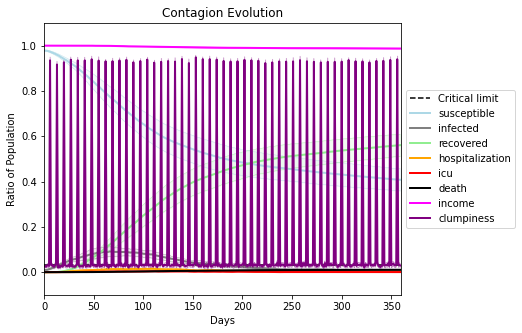

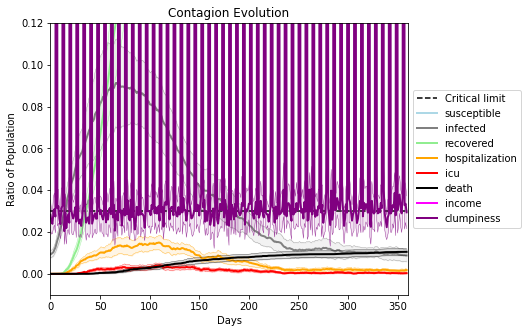

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6605, 1755, 5853, 5481, 7767, 4100, 9756, 4697, 7263, 8358, 1217, 3463, 6807, 8229, 487, 6380, 6862, 2144, 2001, 8743]
Average similarity between family members is 0.9080772659321928 at temperature -0.99
Average similarity between family and home is 0.9998548621151825 at temperature -1
Average similarity between students and their classroom is 0.4654837174487761 at temperature -0.99
Average classroom occupancy is 4.2898550724637685 and number classrooms is 69
Average similarity between workers is 0.8096297937077187 at temperature -0.99
Average office occupancy is 3.4166666666666665 and number offices is 192
Average friend similarity for adults: 0.8257166675609416 for kids: 0.6349388013754742
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5273307229984644
avg restaurant similarity 0.553175285316753
avg restaurant similarity 0.5654117024916201
avg restaurant similarity 0.5412783807404289
avg restaurant similarity 0.46909880372159757
avg restaurant similarity 0.5312202546195546
avg restaurant similarity 0.5546829014431505
avg restaurant similarity 0.44603900835073307
avg restaurant similarity 0.5758757016310719
avg restaurant similarity 0.5193710822442597
avg restaurant similarity 0.5104073161628049
avg restaurant similarity 0.5687558539209078
avg restaurant similarity 0.5548189947475854
avg restaurant similarity 0.5469973240805005
avg restaurant similarity 0.5214052099566446
avg restaurant similarity 0.5250921213007415
avg restaurant similarity 0.46794732391566657
avg restaurant similarity 0.6163072567485977
avg restaurant similarity 0.5519167710146242
avg restaurant similarity 0.5187967464716536
avg restaurant similarity 0.5035430436646142
avg restaurant similarity 0.480518425510931
avg resta

avg restaurant similarity 0.48590977224281057
avg restaurant similarity 0.5963900985889257
avg restaurant similarity 0.4924975271904407
avg restaurant similarity 0.478942674941016
avg restaurant similarity 0.49223609994483636
avg restaurant similarity 0.45408085801821574
avg restaurant similarity 0.4840325697324873
avg restaurant similarity 0.4825023844042506
avg restaurant similarity 0.5394533001046705
avg restaurant similarity 0.49418246022544526
avg restaurant similarity 0.5008159170518391
avg restaurant similarity 0.5061156058152139
avg restaurant similarity 0.4929549436105509
avg restaurant similarity 0.4675151160287575
avg restaurant similarity 0.553514788609539
avg restaurant similarity 0.49702493643234213
avg restaurant similarity 0.46727999789542585
avg restaurant similarity 0.51701892497819
avg restaurant similarity 0.5048356179141862
avg restaurant similarity 0.5043347089958227
avg restaurant similarity 0.5318864312201064
avg restaurant similarity 0.5150065373406296
avg rest

avg restaurant similarity 0.5188178973117505
avg restaurant similarity 0.497313302192596
avg restaurant similarity 0.5459271398647494
avg restaurant similarity 0.5005832422550253
avg restaurant similarity 0.5170689455345351
avg restaurant similarity 0.5030872794666551
avg restaurant similarity 0.5293163243400756
avg restaurant similarity 0.4860568720268224
avg restaurant similarity 0.4498084575715595
avg restaurant similarity 0.45499095532068284
avg restaurant similarity 0.4782446339544977
avg restaurant similarity 0.48353211691974257
avg restaurant similarity 0.547732656883505
avg restaurant similarity 0.4887670919870756
avg restaurant similarity 0.4899384661458041
avg restaurant similarity 0.5002550970107604
avg restaurant similarity 0.540386465307182
avg restaurant similarity 0.4717850047929271
avg restaurant similarity 0.5279312616461405
avg restaurant similarity 0.5712655103699739
avg restaurant similarity 0.43286431325286306
avg restaurant similarity 0.5447624776853969
avg restau

avg restaurant similarity 0.5458855337357754
avg restaurant similarity 0.5020702921622133
avg restaurant similarity 0.433727682673719
avg restaurant similarity 0.4637727414698478
avg restaurant similarity 0.5344961843341374
avg restaurant similarity 0.5648390493023869
avg restaurant similarity 0.5100598772937376
avg restaurant similarity 0.4688495340091401
avg restaurant similarity 0.49826287250605794
avg restaurant similarity 0.5433590426816323
avg restaurant similarity 0.4785374566383569
avg restaurant similarity 0.503650324814145
avg restaurant similarity 0.5292437831541906
avg restaurant similarity 0.5918229750003983
avg restaurant similarity 0.5393637748413608
avg restaurant similarity 0.45595088384764915
avg restaurant similarity 0.4721924791517059
avg restaurant similarity 0.5100379977018548
avg restaurant similarity 0.4656270902653661
avg restaurant similarity 0.552223841241684
avg restaurant similarity 0.4756290134599488
avg restaurant similarity 0.49593236469933516
avg restau

avg restaurant similarity 0.5262781099444992
avg restaurant similarity 0.4969707239920769
avg restaurant similarity 0.4892422296413566
avg restaurant similarity 0.475314397513389
avg restaurant similarity 0.5441937981305605
avg restaurant similarity 0.5000394762297089
avg restaurant similarity 0.5136429131229304
avg restaurant similarity 0.45535963015688247
avg restaurant similarity 0.4573177413379412
avg restaurant similarity 0.47756452783930436
avg restaurant similarity 0.5629091351394502
avg restaurant similarity 0.5004866603375657
avg restaurant similarity 0.5503518384740236
avg restaurant similarity 0.51779439562891
avg restaurant similarity 0.46848851609655695
avg restaurant similarity 0.5273816101441525
avg restaurant similarity 0.5347318504815511
avg restaurant similarity 0.46589402584375367
avg restaurant similarity 0.4639126313945343
avg restaurant similarity 0.48736753970507013
avg restaurant similarity 0.4309453768428435
avg restaurant similarity 0.5115767541231955
avg rest

avg restaurant similarity 0.49842920083504355
avg restaurant similarity 0.5262317881864255
avg restaurant similarity 0.49993330140915965
avg restaurant similarity 0.4774491101803038
avg restaurant similarity 0.47115625485146767
avg restaurant similarity 0.5258902117484103
avg restaurant similarity 0.5452901971063494
avg restaurant similarity 0.5000561357795862
avg restaurant similarity 0.5189579692031976
avg restaurant similarity 0.4671628324011052
avg restaurant similarity 0.5617747963685247
avg restaurant similarity 0.5296791303272148
avg restaurant similarity 0.5332854226865033
avg restaurant similarity 0.512342180773381
avg restaurant similarity 0.48412936732404627
avg restaurant similarity 0.4819355598628429
avg restaurant similarity 0.4776083424098043
avg restaurant similarity 0.5085250109057113
avg restaurant similarity 0.47507187292394715
avg restaurant similarity 0.518682027294879
avg restaurant similarity 0.49604654698336664
avg restaurant similarity 0.4949482305554464
avg re

avg restaurant similarity 0.4766454623198414
avg restaurant similarity 0.548669148318932
avg restaurant similarity 0.5371433169374358
avg restaurant similarity 0.5526039578338671
avg restaurant similarity 0.519171529570857
avg restaurant similarity 0.5214148079548613
avg restaurant similarity 0.49419921467371425
avg restaurant similarity 0.5120959483264068
avg restaurant similarity 0.5015052057617355
avg restaurant similarity 0.4606088499856882
avg restaurant similarity 0.544397689768383
avg restaurant similarity 0.463374996984973
avg restaurant similarity 0.49541629576700275
avg restaurant similarity 0.49037975317730653
avg restaurant similarity 0.5042935313079641
avg restaurant similarity 0.5071492489709145
avg restaurant similarity 0.41917205210519337
avg restaurant similarity 0.5080132149549784
avg restaurant similarity 0.5137266036346719
avg restaurant similarity 0.5519249787142494
avg restaurant similarity 0.449959696972163
avg restaurant similarity 0.4639798086448152
avg restaur

avg restaurant similarity 0.4911503556278229
avg restaurant similarity 0.4733008643125507
avg restaurant similarity 0.5068171950967303
avg restaurant similarity 0.4528651652703044
avg restaurant similarity 0.5024171072895258
avg restaurant similarity 0.5137351133217398
avg restaurant similarity 0.4820824160731768
avg restaurant similarity 0.5176153202028377
avg restaurant similarity 0.5188335955903088
avg restaurant similarity 0.5329081610359346
avg restaurant similarity 0.491417095733226
avg restaurant similarity 0.5243930779778928
avg restaurant similarity 0.472683435188537
avg restaurant similarity 0.4768131743458544
avg restaurant similarity 0.46276788101513433
avg restaurant similarity 0.4260706749182727
avg restaurant similarity 0.5149168943324839
avg restaurant similarity 0.5475596988887904
avg restaurant similarity 0.5392029532279888
avg restaurant similarity 0.512907067940946
avg restaurant similarity 0.4966846872475436
avg restaurant similarity 0.601776696809276
avg restauran

avg restaurant similarity 0.5386094562292064
avg restaurant similarity 0.4732362486565622
avg restaurant similarity 0.48283533895251335
avg restaurant similarity 0.50501252073137
avg restaurant similarity 0.4569441228493654
avg restaurant similarity 0.5077083495233687
avg restaurant similarity 0.46258616393817825
avg restaurant similarity 0.4927333239647656
avg restaurant similarity 0.5042177927439333
avg restaurant similarity 0.49065418453141163
avg restaurant similarity 0.5639867213211512
avg restaurant similarity 0.4982933888123061
avg restaurant similarity 0.5050957520432344
avg restaurant similarity 0.4955457977685994
avg restaurant similarity 0.4640626837739174
avg restaurant similarity 0.5493774462039853
avg restaurant similarity 0.5365246855000403
avg restaurant similarity 0.4809332796468578
avg restaurant similarity 0.507909468056941
avg restaurant similarity 0.43385671082284677
avg restaurant similarity 0.5107443806008976
avg restaurant similarity 0.4884028145728523
avg resta

avg restaurant similarity 0.5124227512445668
avg restaurant similarity 0.45830946922103866
avg restaurant similarity 0.5174912872716327
avg restaurant similarity 0.446811156958539
avg restaurant similarity 0.5566852057368062
avg restaurant similarity 0.509079472535388
avg restaurant similarity 0.49842648562908837
avg restaurant similarity 0.5062239041964907
avg restaurant similarity 0.5148723788690439
avg restaurant similarity 0.5333503726979908
avg restaurant similarity 0.5107978334716187
avg restaurant similarity 0.47798918111169314
avg restaurant similarity 0.4993145061119124
avg restaurant similarity 0.4783924845599755
avg restaurant similarity 0.4819734139998712
avg restaurant similarity 0.479940437059732
avg restaurant similarity 0.4922582385199592
avg restaurant similarity 0.5187018149655511
avg restaurant similarity 0.4846194567584234
avg restaurant similarity 0.5210696431687394
avg restaurant similarity 0.5356125186555035
avg restaurant similarity 0.49935476956967845
avg resta

avg restaurant similarity 0.499356877620004
avg restaurant similarity 0.5112391763001988
avg restaurant similarity 0.4996394405272132
avg restaurant similarity 0.4845232360797079
avg restaurant similarity 0.5329947436244058
avg restaurant similarity 0.5055032839757928
avg restaurant similarity 0.43644702842858524
avg restaurant similarity 0.5164166959137477
avg restaurant similarity 0.4469101472685443
avg restaurant similarity 0.4640703826883982
avg restaurant similarity 0.49710553040854466
avg restaurant similarity 0.5168537526033132
avg restaurant similarity 0.5169583986549717
avg restaurant similarity 0.5345141791556307
avg restaurant similarity 0.5310594599869273
avg restaurant similarity 0.5064978822782306
avg restaurant similarity 0.5163652544268085
avg restaurant similarity 0.5133887631383229
avg restaurant similarity 0.5327370701314298
avg restaurant similarity 0.5385981601234648
avg restaurant similarity 0.47980362838438406
avg restaurant similarity 0.4920022620305074
avg rest

avg restaurant similarity 0.4651430305645049
avg restaurant similarity 0.47982512233662544
avg restaurant similarity 0.5176091674413452
avg restaurant similarity 0.5319895127218955
avg restaurant similarity 0.5036079939700384
avg restaurant similarity 0.46930440416157115
avg restaurant similarity 0.5475664276968963
avg restaurant similarity 0.512647008140365
avg restaurant similarity 0.5298593480099075
avg restaurant similarity 0.49178968846492727
avg restaurant similarity 0.49558311072835276
avg restaurant similarity 0.5120533031238947
avg restaurant similarity 0.47768903778139576
avg restaurant similarity 0.4913720862575535
avg restaurant similarity 0.5386837578950302
avg restaurant similarity 0.541386266984719
avg restaurant similarity 0.5081056054624802
avg restaurant similarity 0.48142652057435065
avg restaurant similarity 0.531696979361409
avg restaurant similarity 0.4860824179093993
avg restaurant similarity 0.47818897409860145
avg restaurant similarity 0.5048050696848022
avg re

avg restaurant similarity 0.5348456423249395
avg restaurant similarity 0.4838445542565077
avg restaurant similarity 0.45075289328331275
avg restaurant similarity 0.4820260732175755
avg restaurant similarity 0.47601262289761204
avg restaurant similarity 0.4661809107520283
avg restaurant similarity 0.5128320693594407
avg restaurant similarity 0.5176166852372965
avg restaurant similarity 0.4929742322038249
avg restaurant similarity 0.45211475087229874
avg restaurant similarity 0.512758746494943
avg restaurant similarity 0.5317609408781675
avg restaurant similarity 0.45034810989923835
avg restaurant similarity 0.5319547598779544
avg restaurant similarity 0.5781775981949154
avg restaurant similarity 0.48274206146476145
avg restaurant similarity 0.4713641518845806
avg restaurant similarity 0.46630354778992184
avg restaurant similarity 0.5241719275777313
avg restaurant similarity 0.5201066333622953
avg restaurant similarity 0.54345218310822
avg restaurant similarity 0.45687210989412824
avg re

avg restaurant similarity 0.5214674259197413
avg restaurant similarity 0.439818134737757
avg restaurant similarity 0.5164090650544221
avg restaurant similarity 0.559434439288453
avg restaurant similarity 0.4862511358421564
avg restaurant similarity 0.4874347487108278
avg restaurant similarity 0.48362210978453396
avg restaurant similarity 0.5171009907549019
avg restaurant similarity 0.46416902997693393
avg restaurant similarity 0.5079741791602177
avg restaurant similarity 0.46843148060946715
avg restaurant similarity 0.45660751498096724
avg restaurant similarity 0.49410370418816585
avg restaurant similarity 0.5367124556152476
avg restaurant similarity 0.5499188577410384
avg restaurant similarity 0.5509536851271221
avg restaurant similarity 0.5101794227471356
avg restaurant similarity 0.47913208269799473
avg restaurant similarity 0.4908870187379013
avg restaurant similarity 0.5492172750974907
avg restaurant similarity 0.4949798663607442
avg restaurant similarity 0.4833636705151634
avg re

avg restaurant similarity 0.5175297190928426
avg restaurant similarity 0.5711123620544973
avg restaurant similarity 0.5382568073965528
avg restaurant similarity 0.5010500033222854
avg restaurant similarity 0.490071478772673
avg restaurant similarity 0.5080428975703217
avg restaurant similarity 0.5238836875281935
avg restaurant similarity 0.4828501098783591
avg restaurant similarity 0.5116677640313657
avg restaurant similarity 0.4629686702113394
avg restaurant similarity 0.4870056987372294
avg restaurant similarity 0.5285263719863675
avg restaurant similarity 0.5253474202230684
avg restaurant similarity 0.44987607543349656
avg restaurant similarity 0.5199535311732252
avg restaurant similarity 0.4937505472504044
avg restaurant similarity 0.5094960968603671
avg restaurant similarity 0.5566721656099978
avg restaurant similarity 0.4446397507714519
avg restaurant similarity 0.506919793218315
avg restaurant similarity 0.5084455592069798
avg restaurant similarity 0.5504435492068795
avg restaur

avg restaurant similarity 0.5037124354638554
avg restaurant similarity 0.4628894644987434
avg restaurant similarity 0.5084905295583007
avg restaurant similarity 0.5035418659498123
avg restaurant similarity 0.5183099308926609
avg restaurant similarity 0.4991249970636126
avg restaurant similarity 0.5103757906085894
avg restaurant similarity 0.5270451812072732
avg restaurant similarity 0.5356740076235259
avg restaurant similarity 0.5935921501187894
avg restaurant similarity 0.47043201186870537
avg restaurant similarity 0.5180239461444943
avg restaurant similarity 0.5251518345402758
avg restaurant similarity 0.503427305436831
avg restaurant similarity 0.5275019237254279
avg restaurant similarity 0.5164188592037504
avg restaurant similarity 0.4971809423120951
avg restaurant similarity 0.5103465449047176
avg restaurant similarity 0.5181622413968128
avg restaurant similarity 0.4964253322744302
avg restaurant similarity 0.4939155783920991
avg restaurant similarity 0.5363782237480553
avg restau

avg restaurant similarity 0.535524510838135
avg restaurant similarity 0.41576119827354563
avg restaurant similarity 0.5067128065615375
avg restaurant similarity 0.4636464840760546
avg restaurant similarity 0.514199754369783
avg restaurant similarity 0.5567057848980226
avg restaurant similarity 0.4748247462707629
avg restaurant similarity 0.4525835969030523
avg restaurant similarity 0.5200805929940223
avg restaurant similarity 0.48967913818631004
avg restaurant similarity 0.45715217624410515
avg restaurant similarity 0.46746157001736366
avg restaurant similarity 0.5125833472913756
avg restaurant similarity 0.5408054494333826
avg restaurant similarity 0.5568997738795369
avg restaurant similarity 0.46744534856595366
avg restaurant similarity 0.5226787444930917
avg restaurant similarity 0.5263091188511926
avg restaurant similarity 0.5081444812223488
avg restaurant similarity 0.5083620701620531
avg restaurant similarity 0.48393634709450395
avg restaurant similarity 0.5401216518796031
avg re

avg restaurant similarity 0.4077698137927549
avg restaurant similarity 0.44166331214191284
avg restaurant similarity 0.5631616599742032
avg restaurant similarity 0.5074438969449147
avg restaurant similarity 0.5360690931307612
avg restaurant similarity 0.48970852532457193
avg restaurant similarity 0.46082463390679035
avg restaurant similarity 0.5111896993483008
avg restaurant similarity 0.49705725281218904
avg restaurant similarity 0.5624768803652314
avg restaurant similarity 0.46108357266125716
avg restaurant similarity 0.5596324527726864
avg restaurant similarity 0.5234709303030662
avg restaurant similarity 0.4816844077867647
avg restaurant similarity 0.5277583525199091
avg restaurant similarity 0.45562852321016833
avg restaurant similarity 0.5496273533981103
avg restaurant similarity 0.5145308815871614
avg restaurant similarity 0.5381365067984485
avg restaurant similarity 0.5211717398110336
avg restaurant similarity 0.529523008465307
avg restaurant similarity 0.4970207692676323
avg r

avg restaurant similarity 0.5547288907288525
avg restaurant similarity 0.4894049080568488
avg restaurant similarity 0.575034660585991
avg restaurant similarity 0.5167596656445569
avg restaurant similarity 0.5334994138270954
avg restaurant similarity 0.5147624483917365
avg restaurant similarity 0.5044391537622599
avg restaurant similarity 0.4755406709546476
avg restaurant similarity 0.469950061399902
avg restaurant similarity 0.5237916214437905
avg restaurant similarity 0.511625624129424
avg restaurant similarity 0.445787964922586
avg restaurant similarity 0.43786932345859625
avg restaurant similarity 0.49021592685196885
avg restaurant similarity 0.5519848493920577
avg restaurant similarity 0.44395068200202004
avg restaurant similarity 0.5546911342568414
avg restaurant similarity 0.49832473301482694
avg restaurant similarity 0.5024644964022885
avg restaurant similarity 0.4521006959868686
avg restaurant similarity 0.4946227836090664
avg restaurant similarity 0.5591983072621839
avg restau

avg restaurant similarity 0.4775677573600638
avg restaurant similarity 0.4916560018067665
avg restaurant similarity 0.5341685524381172
avg restaurant similarity 0.557070622746472
avg restaurant similarity 0.5175587038095035
avg restaurant similarity 0.5329502363195879
avg restaurant similarity 0.4987931033681622
avg restaurant similarity 0.4387712138288526
avg restaurant similarity 0.5549883973572056
avg restaurant similarity 0.4725012723110241
avg restaurant similarity 0.42750437210157566
avg restaurant similarity 0.4499960465055199
avg restaurant similarity 0.4279633811918576
avg restaurant similarity 0.5100117198616124
avg restaurant similarity 0.5005179470597508
avg restaurant similarity 0.4637675484321029
avg restaurant similarity 0.5329799345084922
avg restaurant similarity 0.5062362835518819
avg restaurant similarity 0.4317152218564249
avg restaurant similarity 0.49700046532645714
avg restaurant similarity 0.5468885036989448
avg restaurant similarity 0.6141743945508871
avg resta

avg restaurant similarity 0.5186310797596971
avg restaurant similarity 0.4553137807135177
avg restaurant similarity 0.4804799850898163
avg restaurant similarity 0.49330322677794103
avg restaurant similarity 0.5319647301182765
avg restaurant similarity 0.519213590776028
avg restaurant similarity 0.48585080030441263
avg restaurant similarity 0.4290321969738853
avg restaurant similarity 0.4954641554980422
avg restaurant similarity 0.4931403855644207
avg restaurant similarity 0.5065457674219194
avg restaurant similarity 0.5396187154774702
avg restaurant similarity 0.5381015591008603
avg restaurant similarity 0.4566203493719946
avg restaurant similarity 0.46170659494689825
avg restaurant similarity 0.504061364342425
avg restaurant similarity 0.5465622038682858
avg restaurant similarity 0.49024414571904523
avg restaurant similarity 0.42756173337296915
avg restaurant similarity 0.486651610432027
avg restaurant similarity 0.4770644956190392
avg restaurant similarity 0.49167892330479945
avg res

avg restaurant similarity 0.46594596801445026
avg restaurant similarity 0.4506601349887341
avg restaurant similarity 0.4785210356306721
avg restaurant similarity 0.4203952450446428
avg restaurant similarity 0.48585742733952164
avg restaurant similarity 0.5697128122810942
avg restaurant similarity 0.5096496198344799
avg restaurant similarity 0.4745597481988974
avg restaurant similarity 0.4897361947316751
avg restaurant similarity 0.4540496232870768
avg restaurant similarity 0.48895652825512087
avg restaurant similarity 0.4668629920281589
avg restaurant similarity 0.4851393428673308
avg restaurant similarity 0.48846195549099575
avg restaurant similarity 0.468468165414392
avg restaurant similarity 0.5006487957861147
avg restaurant similarity 0.4263547888230973
avg restaurant similarity 0.5392112816937253
avg restaurant similarity 0.4827217067314137
avg restaurant similarity 0.47699415402634415
avg restaurant similarity 0.5007036712505177
avg restaurant similarity 0.5600015817341688
avg re

avg restaurant similarity 0.5208965250351802
avg restaurant similarity 0.5517045630086007
avg restaurant similarity 0.5002480552922801
avg restaurant similarity 0.5316471238471089
avg restaurant similarity 0.5136315680074811
avg restaurant similarity 0.5462419562569006
avg restaurant similarity 0.5549475727998125
avg restaurant similarity 0.5094885453678288
avg restaurant similarity 0.5070948426280874
avg restaurant similarity 0.5503169184839841
avg restaurant similarity 0.49864723769932784
avg restaurant similarity 0.5439496253997961
avg restaurant similarity 0.5540335813428688
avg restaurant similarity 0.465083429552177
avg restaurant similarity 0.544992969742779
avg restaurant similarity 0.46620317753212903
avg restaurant similarity 0.5251170213813486
avg restaurant similarity 0.45502760545648796
avg restaurant similarity 0.5495692973782595
avg restaurant similarity 0.48874574457981684
avg restaurant similarity 0.5420625941932595
avg restaurant similarity 0.5191050983698777
avg rest

avg restaurant similarity 0.5599875085797466
avg restaurant similarity 0.5175089719877537
avg restaurant similarity 0.5105170181373248
avg restaurant similarity 0.47157525422798996
avg restaurant similarity 0.5243242789235767
avg restaurant similarity 0.5215525663460417
avg restaurant similarity 0.5381433029684604
avg restaurant similarity 0.5072408880078078
avg restaurant similarity 0.49876316298376583
avg restaurant similarity 0.48644893540621426
avg restaurant similarity 0.49095126204163025
avg restaurant similarity 0.5148605600414514
avg restaurant similarity 0.5324817782420396
avg restaurant similarity 0.5376739846956096
avg restaurant similarity 0.5266230530957663
avg restaurant similarity 0.48391232512183263
avg restaurant similarity 0.5055369624553322
avg restaurant similarity 0.4828681879857657
avg restaurant similarity 0.5283933119114202
avg restaurant similarity 0.5182735724157419
avg restaurant similarity 0.4644131157720555
avg restaurant similarity 0.5538662288893343
avg r

avg restaurant similarity 0.4304470978139132
avg restaurant similarity 0.5381421237980886
avg restaurant similarity 0.534330229781088
avg restaurant similarity 0.5154808896155693
avg restaurant similarity 0.48561643926071896
avg restaurant similarity 0.5017746412776765
avg restaurant similarity 0.5347944699720493
avg restaurant similarity 0.5057372073322659
avg restaurant similarity 0.4900479624722806
avg restaurant similarity 0.5361997215433049
avg restaurant similarity 0.5285667077623541
avg restaurant similarity 0.48500223087497485
avg restaurant similarity 0.4707906203016521
avg restaurant similarity 0.5397771464158789
avg restaurant similarity 0.5460950166423255
avg restaurant similarity 0.5354616618526855
avg restaurant similarity 0.4600621139468545
avg restaurant similarity 0.5058506411027267
avg restaurant similarity 0.548366475648736
avg restaurant similarity 0.5045057181763642
avg restaurant similarity 0.4730569039512594
avg restaurant similarity 0.4392709082372611
avg restau

avg restaurant similarity 0.5389333964413459
avg restaurant similarity 0.5335385235312815
avg restaurant similarity 0.5027390781657698
avg restaurant similarity 0.571166700839743
avg restaurant similarity 0.4033175392618313
avg restaurant similarity 0.5138136933626604
avg restaurant similarity 0.5027572287705957
avg restaurant similarity 0.43461536967187875
avg restaurant similarity 0.4841840481007922
avg restaurant similarity 0.5126095240629658
avg restaurant similarity 0.48492401549109526
avg restaurant similarity 0.49857437701993695
avg restaurant similarity 0.4647499498842824
avg restaurant similarity 0.45263222680532195
avg restaurant similarity 0.5121837250692188
avg restaurant similarity 0.569538158458366
avg restaurant similarity 0.4869397802966366
avg restaurant similarity 0.5079828106030507
avg restaurant similarity 0.4762477827471635
avg restaurant similarity 0.4529655174669444
avg restaurant similarity 0.4815040346510339
avg restaurant similarity 0.4882339193858934
avg rest

avg restaurant similarity 0.5287515412629418
avg restaurant similarity 0.49748404350151887
avg restaurant similarity 0.5249526208943242
avg restaurant similarity 0.5741317595825679
avg restaurant similarity 0.5270097503863749
avg restaurant similarity 0.4895391554235838
avg restaurant similarity 0.5199828224132794
avg restaurant similarity 0.5111508246475778
avg restaurant similarity 0.499943572274686
avg restaurant similarity 0.5053592695601007
avg restaurant similarity 0.4929111911147662
avg restaurant similarity 0.5522524340102565
avg restaurant similarity 0.528389208583525
avg restaurant similarity 0.5267031566382357
avg restaurant similarity 0.48459184797447225
avg restaurant similarity 0.5089591009575157
avg restaurant similarity 0.4905220933940135
avg restaurant similarity 0.4846323396008398
avg restaurant similarity 0.5148765141764824
avg restaurant similarity 0.5276855574025423
avg restaurant similarity 0.509953541207225
avg restaurant similarity 0.48806376921267913
avg restau

avg restaurant similarity 0.5049582796109295
avg restaurant similarity 0.5114072998614586
avg restaurant similarity 0.5124728889743893
avg restaurant similarity 0.5245917980767499
avg restaurant similarity 0.5169007386844733
avg restaurant similarity 0.5220660251222864
avg restaurant similarity 0.49303320185768457
avg restaurant similarity 0.5185079866498165
avg restaurant similarity 0.5220934917117678
avg restaurant similarity 0.46937060117910145
avg restaurant similarity 0.5687770352979719
avg restaurant similarity 0.5105613226717197
avg restaurant similarity 0.5263843463635506
avg restaurant similarity 0.547535418081953
avg restaurant similarity 0.5154756337704228
avg restaurant similarity 0.5680796443965196
avg restaurant similarity 0.5296175177379562
avg restaurant similarity 0.5116041010798941
avg restaurant similarity 0.5533913393271462
avg restaurant similarity 0.5599415076518254
avg restaurant similarity 0.519856546028672
avg restaurant similarity 0.5128582483161283
avg restau

avg restaurant similarity 0.4662645198504135
avg restaurant similarity 0.48615499221382824
avg restaurant similarity 0.508057771548254
avg restaurant similarity 0.5141472807718924
avg restaurant similarity 0.531156842208611
avg restaurant similarity 0.49744314278125745
avg restaurant similarity 0.45051516563634136
avg restaurant similarity 0.4839736186129617
avg restaurant similarity 0.522969334863758
avg restaurant similarity 0.5442193600513255
avg restaurant similarity 0.4814979416792029
avg restaurant similarity 0.47109349569320463
avg restaurant similarity 0.4966539005927395
avg restaurant similarity 0.5701239901450863
avg restaurant similarity 0.5288272234849704
avg restaurant similarity 0.46190016606297585
avg restaurant similarity 0.5188043230378556
avg restaurant similarity 0.5250189953341508
avg restaurant similarity 0.43247658312850495
avg restaurant similarity 0.48773226668275
avg restaurant similarity 0.5127655829338988
avg restaurant similarity 0.43745740778140674
avg rest

avg restaurant similarity 0.4709798296012806
avg restaurant similarity 0.4747523876705573
avg restaurant similarity 0.5462678238186344
avg restaurant similarity 0.48126519970195314
avg restaurant similarity 0.4866989653253215
avg restaurant similarity 0.5011217921150487
avg restaurant similarity 0.4696753340655201
avg restaurant similarity 0.4723574785105042
avg restaurant similarity 0.5026385027044794
avg restaurant similarity 0.47341171918769104
avg restaurant similarity 0.4908396183628392
avg restaurant similarity 0.5052431366377154
avg restaurant similarity 0.45040146301778106
avg restaurant similarity 0.4939201224775809
avg restaurant similarity 0.5136164380686069
avg restaurant similarity 0.5029929120040921
avg restaurant similarity 0.5164006246991119
avg restaurant similarity 0.517338991308251
avg restaurant similarity 0.47084694434248164
avg restaurant similarity 0.4697596074860951
avg restaurant similarity 0.493394007826166
avg restaurant similarity 0.46521696410114055
avg res

avg restaurant similarity 0.44238583290209
avg restaurant similarity 0.49354563231409215
avg restaurant similarity 0.4879117816031628
avg restaurant similarity 0.4994667894925295
avg restaurant similarity 0.461779965419737
avg restaurant similarity 0.4742423804484467
avg restaurant similarity 0.484081631015767
avg restaurant similarity 0.4632783840492791
avg restaurant similarity 0.4835997679384337
avg restaurant similarity 0.47851948490889584
avg restaurant similarity 0.5237399639508283
avg restaurant similarity 0.5292280901166236
avg restaurant similarity 0.5051942854222666
avg restaurant similarity 0.4530868463885287
avg restaurant similarity 0.4829447392876005
avg restaurant similarity 0.5263469554402792
avg restaurant similarity 0.5257139461985002
avg restaurant similarity 0.4649043754180303
avg restaurant similarity 0.4502741693272317
avg restaurant similarity 0.5595516838498031
avg restaurant similarity 0.5241175019337845
avg restaurant similarity 0.5080878704592955
avg restaura

avg restaurant similarity 0.49867862638333804
avg restaurant similarity 0.5232673925502889
avg restaurant similarity 0.4923526196327726
avg restaurant similarity 0.45941635038068174
avg restaurant similarity 0.5037837209852626
avg restaurant similarity 0.4776433933519255
avg restaurant similarity 0.4824632397648458
avg restaurant similarity 0.4801615397982667
avg restaurant similarity 0.5175452646716603
avg restaurant similarity 0.5267883822442162
avg restaurant similarity 0.6307299163405067
avg restaurant similarity 0.590634130848407
avg restaurant similarity 0.4748832742021496
avg restaurant similarity 0.4858263741380814
avg restaurant similarity 0.5636105663164133
avg restaurant similarity 0.5238137560556069
avg restaurant similarity 0.49228362824821265
avg restaurant similarity 0.49082994335712427
avg restaurant similarity 0.47460290004647987
avg restaurant similarity 0.49829571855899574
avg restaurant similarity 0.5251204837453988
avg restaurant similarity 0.4925589117497953
avg r

avg restaurant similarity 0.5992470908451065
avg restaurant similarity 0.5615879252067529
avg restaurant similarity 0.5665883160977095
avg restaurant similarity 0.5255727501041976
avg restaurant similarity 0.5582419465350039
avg restaurant similarity 0.5126396324790122
avg restaurant similarity 0.5504363567594683
avg restaurant similarity 0.48242108481745627
avg restaurant similarity 0.5595265970497574
avg restaurant similarity 0.5545167554598797
avg restaurant similarity 0.5079462865570457
avg restaurant similarity 0.48887886489197435
avg restaurant similarity 0.5398566948851137
avg restaurant similarity 0.504971896263019
avg restaurant similarity 0.5155056691236297
avg restaurant similarity 0.5290490571978967
avg restaurant similarity 0.5207969563656097
avg restaurant similarity 0.5273200994057039
avg restaurant similarity 0.549059909082957
avg restaurant similarity 0.4966033019390146
avg restaurant similarity 0.5571861902416367
avg restaurant similarity 0.5499677435257474
avg restau

avg restaurant similarity 0.4716542341879948
avg restaurant similarity 0.5592312654089714
avg restaurant similarity 0.4873406569873996
avg restaurant similarity 0.5454288210252247
avg restaurant similarity 0.5112987511742729
avg restaurant similarity 0.5291800485303404
avg restaurant similarity 0.536045655305519
avg restaurant similarity 0.5261794340272431
avg restaurant similarity 0.5410337112597037
avg restaurant similarity 0.5270813885462632
avg restaurant similarity 0.5296860999107523
avg restaurant similarity 0.5306992147698284
avg restaurant similarity 0.48154828474632266
avg restaurant similarity 0.5275532720288604
avg restaurant similarity 0.5808550794772588
avg restaurant similarity 0.5340187140367504
avg restaurant similarity 0.5237029241204644
avg restaurant similarity 0.5412924976335022
avg restaurant similarity 0.5350324101374843
avg restaurant similarity 0.4698928540445838
avg restaurant similarity 0.5235349822582446
avg restaurant similarity 0.5138929664549348
avg restau

avg restaurant similarity 0.4539623873857072
avg restaurant similarity 0.45411947834838157
avg restaurant similarity 0.535415236384288
avg restaurant similarity 0.503614286145748
avg restaurant similarity 0.5380043286263289
avg restaurant similarity 0.5158824307085826
avg restaurant similarity 0.5110899357450497
avg restaurant similarity 0.5304784471439596
avg restaurant similarity 0.4871659846466212
avg restaurant similarity 0.47304235519158805
avg restaurant similarity 0.5332661105579338
avg restaurant similarity 0.550343962710158
avg restaurant similarity 0.5419852483021684
avg restaurant similarity 0.4633096397297442
avg restaurant similarity 0.5080661404579567
avg restaurant similarity 0.5476630117462817
avg restaurant similarity 0.4843970099943951
avg restaurant similarity 0.49556490991257734
avg restaurant similarity 0.4888377139369855
avg restaurant similarity 0.5134790352603432
avg restaurant similarity 0.5009025396106043
avg restaurant similarity 0.547999312701385
avg restaur

avg restaurant similarity 0.5133366921179935
avg restaurant similarity 0.5618091485645587
avg restaurant similarity 0.5494490216595203
avg restaurant similarity 0.5087150359321805
avg restaurant similarity 0.5339343374546907
avg restaurant similarity 0.500256829580103
avg restaurant similarity 0.5145467901870081
avg restaurant similarity 0.5217888677181787
avg restaurant similarity 0.5417017056104411
avg restaurant similarity 0.4717287835450537
avg restaurant similarity 0.5376285367368335
avg restaurant similarity 0.48995855957795653
avg restaurant similarity 0.5354966536451212
avg restaurant similarity 0.5162998526178211
avg restaurant similarity 0.5181131365939239
avg restaurant similarity 0.49300795723852875
avg restaurant similarity 0.5227557007242994
avg restaurant similarity 0.49429452344243935
avg restaurant similarity 0.5252978763508159
avg restaurant similarity 0.5358987831483507
avg restaurant similarity 0.48211994527155816
avg restaurant similarity 0.5654498640345977
avg res

avg restaurant similarity 0.5101308671296744
avg restaurant similarity 0.5051131839398748
avg restaurant similarity 0.5221504984646886
avg restaurant similarity 0.5224365670171932
avg restaurant similarity 0.4900338868544474
avg restaurant similarity 0.5325518993936237
avg restaurant similarity 0.49262771737672834
avg restaurant similarity 0.5323526482636037
avg restaurant similarity 0.4659945240153535
avg restaurant similarity 0.5032132682099247
avg restaurant similarity 0.4976442319200319
avg restaurant similarity 0.5353915686832104
avg restaurant similarity 0.5370014604341972
avg restaurant similarity 0.4497452190975507
avg restaurant similarity 0.4648596066827857
avg restaurant similarity 0.549068816706192
avg restaurant similarity 0.539664909032113
avg restaurant similarity 0.4891500818270845
avg restaurant similarity 0.4837932658168354
avg restaurant similarity 0.5074338842709424
avg restaurant similarity 0.47989904714332027
avg restaurant similarity 0.4919105844147898
avg restau

avg restaurant similarity 0.5382443139213435
avg restaurant similarity 0.5417294279550868
avg restaurant similarity 0.5184521888466533
avg restaurant similarity 0.532635502102564
avg restaurant similarity 0.5092764655956126
avg restaurant similarity 0.4981176227817114
avg restaurant similarity 0.45050149463680933
avg restaurant similarity 0.5136721562521082
avg restaurant similarity 0.515431016563311
avg restaurant similarity 0.41797628720764474
avg restaurant similarity 0.5004831655067787
avg restaurant similarity 0.49175022466014834
avg restaurant similarity 0.5542881215628135
avg restaurant similarity 0.5437649871977083
avg restaurant similarity 0.5314595426031817
avg restaurant similarity 0.4527650043526729
avg restaurant similarity 0.4855623745250909
avg restaurant similarity 0.47039907831959304
avg restaurant similarity 0.5092892420741911
avg restaurant similarity 0.5047545540660079
avg restaurant similarity 0.47802971965251584
avg restaurant similarity 0.5200524639033282
avg res

avg restaurant similarity 0.5460322850385176
avg restaurant similarity 0.5109290449988421
avg restaurant similarity 0.4618794332078072
avg restaurant similarity 0.4998874819391749
avg restaurant similarity 0.5288784537678815
avg restaurant similarity 0.5453804083570161
avg restaurant similarity 0.5481471446662314
avg restaurant similarity 0.49514842177224805
avg restaurant similarity 0.4931256362440668
avg restaurant similarity 0.5694054182683096
avg restaurant similarity 0.5176020677741755
avg restaurant similarity 0.5155440952993247
avg restaurant similarity 0.5719625885885673
avg restaurant similarity 0.5293823629954958
avg restaurant similarity 0.5141681969682865
avg restaurant similarity 0.5537866778132968
avg restaurant similarity 0.5116711467357931
avg restaurant similarity 0.4976167451134481
avg restaurant similarity 0.4948921612996357
avg restaurant similarity 0.4977679061586982
avg restaurant similarity 0.49751287185526305
avg restaurant similarity 0.47479357187052673
avg res

avg restaurant similarity 0.5380363017496743
avg restaurant similarity 0.46346903634338527
avg restaurant similarity 0.46732369287828757
avg restaurant similarity 0.5195592071078242
avg restaurant similarity 0.5177332831719802
avg restaurant similarity 0.45203137866348553
avg restaurant similarity 0.5139395538038148
avg restaurant similarity 0.5211802515105438
avg restaurant similarity 0.49599284498870244
avg restaurant similarity 0.48174734316305556
avg restaurant similarity 0.4593433603061986
avg restaurant similarity 0.4964341859034606
avg restaurant similarity 0.5572662907396447
avg restaurant similarity 0.45742470240045013
avg restaurant similarity 0.5246069899348789
avg restaurant similarity 0.5313420295063087
avg restaurant similarity 0.4125755249410296
avg restaurant similarity 0.5510493290658407
avg restaurant similarity 0.45647588524662447
avg restaurant similarity 0.5243162633765922
avg restaurant similarity 0.5229846353319209
avg restaurant similarity 0.5305678940506032
avg

(<function dict.items>, <function dict.items>, <function dict.items>)

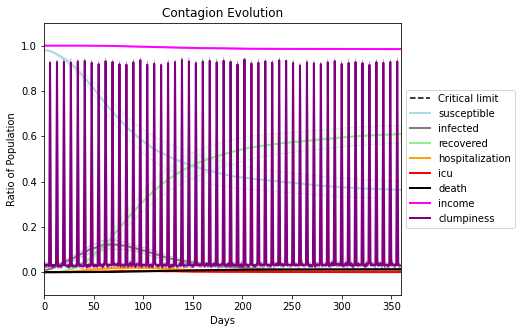

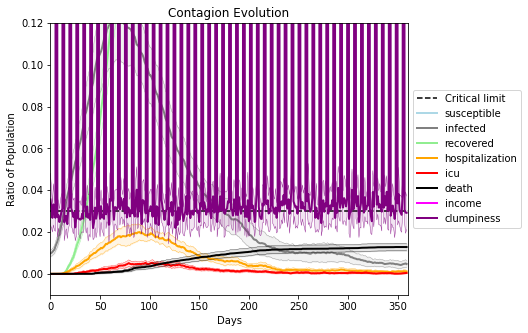

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[7374, 390, 4959, 1562, 9879, 5494, 5201, 7479, 3829, 5295, 1709, 4862, 3634, 8288, 2133, 6782, 3247, 3849, 7846, 243]
Average similarity between family members is 0.5432181198113519 at temperature -0.9
Average similarity between family and home is 0.9998578734908081 at temperature -1
Average similarity between students and their classroom is 0.1709078711619761 at temperature -0.9
Average classroom occupancy is 3.9014084507042255 and number classrooms is 71
Average similarity between workers is 0.4542850448129712 at temperature -0.9
Average office occupancy is 3.3034825870646767 and number offices is 201
Average friend similarity for adults: 0.5977027345080368 for kids: 0.44464196100265735
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.16746052509324624
avg restaurant similarity 0.09594469344556425
avg restaurant similarity 0.056683405805791585
avg restaurant similarity 0.05279915199199611
avg restaurant similarity 0.1377460390133855
avg restaurant similarity 0.09571767160729593
avg restaurant similarity 0.15364679407060883
avg restaurant similarity 0.1138517327002991
avg restaurant similarity 0.11103451358744508
avg restaurant similarity 0.17666099700643012
avg restaurant similarity 0.10003332764137794
avg restaurant similarity 0.08979400343297105
avg restaurant similarity 0.1437204645903278
avg restaurant similarity 0.11100991369324906
avg restaurant similarity 0.09682216425045431
avg restaurant similarity 0.035751020785459414
avg restaurant similarity 0.1414251922189548
avg restaurant similarity 0.15206322586495638
avg restaurant similarity 0.05855713561398695
avg restaurant similarity 0.05126533073627667
avg restaurant similarity 0.12780214582891494
avg restaurant similarity 0.09293391

avg restaurant similarity 0.11126415353829779
avg restaurant similarity 0.17528867265321005
avg restaurant similarity 0.07861270888167057
avg restaurant similarity 0.05419466721936628
avg restaurant similarity 0.04040850646006742
avg restaurant similarity 0.1446689092176163
avg restaurant similarity 0.1375103519906643
avg restaurant similarity 0.1477499739651315
avg restaurant similarity 0.09813155000758786
avg restaurant similarity 0.22026120261593202
avg restaurant similarity 0.10020501097604906
avg restaurant similarity 0.1335838770733615
avg restaurant similarity 0.11784708441142686
avg restaurant similarity 0.11746883554411475
avg restaurant similarity 0.14562070318396803
avg restaurant similarity 0.1076104472541642
avg restaurant similarity 0.12746333679993438
avg restaurant similarity 0.10966308665290024
avg restaurant similarity 0.12320111265284142
avg restaurant similarity 0.14263773806249835
avg restaurant similarity 0.13117569880636407
avg restaurant similarity 0.04670390778

avg restaurant similarity 0.08935503675209262
avg restaurant similarity 0.12283832123375725
avg restaurant similarity 0.11518612228335214
avg restaurant similarity 0.10472884453042275
avg restaurant similarity 0.1186234931911579
avg restaurant similarity 0.13367194771583862
avg restaurant similarity 0.07900315726111304
avg restaurant similarity 0.09098758658345521
avg restaurant similarity 0.1475654902373777
avg restaurant similarity 0.1398588542131726
avg restaurant similarity 0.09612706684903449
avg restaurant similarity 0.09193914501195244
avg restaurant similarity 0.11036160838366249
avg restaurant similarity 0.10206761898344517
avg restaurant similarity 0.14267923461238963
avg restaurant similarity 0.05817886190556562
avg restaurant similarity 0.11378730966370654
avg restaurant similarity 0.14232949228729105
avg restaurant similarity 0.15952226177500664
avg restaurant similarity 0.16050042191644887
avg restaurant similarity 0.09284011250148365
avg restaurant similarity 0.131210477

avg restaurant similarity 0.11281193637711094
avg restaurant similarity 0.17944728418312816
avg restaurant similarity 0.11781826200421121
avg restaurant similarity 0.11773917784538566
avg restaurant similarity 0.11656464247785212
avg restaurant similarity 0.1259295782463563
avg restaurant similarity 0.142221959158501
avg restaurant similarity 0.1041327431820221
avg restaurant similarity 0.09662759763311034
avg restaurant similarity 0.08940611687997325
avg restaurant similarity 0.16269016310720572
avg restaurant similarity 0.13533750141764334
avg restaurant similarity 0.09249147976710236
avg restaurant similarity 0.08278435768287085
avg restaurant similarity 0.11045571952409401
avg restaurant similarity 0.12416608372530706
avg restaurant similarity 0.09376935448757351
avg restaurant similarity 0.13349368425100422
avg restaurant similarity 0.12408852980931138
avg restaurant similarity 0.11113294600397934
avg restaurant similarity 0.10923092685339619
avg restaurant similarity 0.1060747251

avg restaurant similarity 0.08342915115819369
avg restaurant similarity 0.10452898624631568
avg restaurant similarity 0.10627962544063392
avg restaurant similarity 0.14119532359394177
avg restaurant similarity 0.10912436419181622
avg restaurant similarity 0.08956505538103292
avg restaurant similarity 0.11265242303457744
avg restaurant similarity 0.06808807119511713
avg restaurant similarity 0.053682067298355236
avg restaurant similarity 0.09524596663219928
avg restaurant similarity 0.03170015036802106
avg restaurant similarity 0.09596932826000439
avg restaurant similarity 0.11127282872361499
avg restaurant similarity 0.049649248512439445
avg restaurant similarity 0.11090021125547014
avg restaurant similarity 0.07650890987364482
avg restaurant similarity 0.09736348993501723
avg restaurant similarity 0.10573527210226169
avg restaurant similarity 0.13317195487434053
avg restaurant similarity 0.09374925785614995
avg restaurant similarity 0.047891150056679106
avg restaurant similarity 0.116

avg restaurant similarity 0.10155066740016201
avg restaurant similarity 0.0076645698278636
avg restaurant similarity 0.08780823772346556
avg restaurant similarity 0.027730688745906312
avg restaurant similarity 0.0636898140654179
avg restaurant similarity 0.09263711923680791
avg restaurant similarity 0.10704063226812152
avg restaurant similarity 0.08363070704891419
avg restaurant similarity 0.09852878577232534
avg restaurant similarity 0.10491471583262006
avg restaurant similarity 0.048065154583983125
avg restaurant similarity 0.06021201572005502
avg restaurant similarity 0.07992873105799114
avg restaurant similarity 0.0608939806111554
avg restaurant similarity 0.0591045247958216
avg restaurant similarity 0.09235889211034919
avg restaurant similarity 0.048428277811209314
avg restaurant similarity 0.052839390523614645
avg restaurant similarity 0.03343275922647099
avg restaurant similarity 0.06638525728644472
avg restaurant similarity 0.05821325703669764
avg restaurant similarity 0.040245

avg restaurant similarity 0.04106957449065986
avg restaurant similarity 0.14314929715583175
avg restaurant similarity 0.07015394698627145
avg restaurant similarity 0.08691590545932153
avg restaurant similarity 0.056901914269114805
avg restaurant similarity 0.11782409941458225
avg restaurant similarity 0.12539460692158136
avg restaurant similarity 0.0611627836686817
avg restaurant similarity 0.07839531277927178
avg restaurant similarity 0.023579512150736837
avg restaurant similarity 0.1946508204616456
avg restaurant similarity 0.09250598482649083
avg restaurant similarity 0.05276005399214157
avg restaurant similarity 0.15112295263606
avg restaurant similarity 0.17813385331013337
avg restaurant similarity 0.15855151210592386
avg restaurant similarity 0.19167420065386553
avg restaurant similarity 0.14586462556097674
avg restaurant similarity 0.07656725005282174
avg restaurant similarity 0.12664285066957182
avg restaurant similarity 0.08356541530473346
avg restaurant similarity 0.060491605

avg restaurant similarity 0.014782317199077081
avg restaurant similarity 0.13274127328949503
avg restaurant similarity 0.13431668839841157
avg restaurant similarity 0.08925252460175175
avg restaurant similarity 0.15991054619548556
avg restaurant similarity -0.0009123236828146437
avg restaurant similarity 0.13537262306717665
avg restaurant similarity 0.15921372304730474
avg restaurant similarity 0.08129463527892282
avg restaurant similarity 0.09928727840156594
avg restaurant similarity 0.04004186470569941
avg restaurant similarity 0.09769103826073901
avg restaurant similarity 0.08070604931110535
avg restaurant similarity 0.1575643474259266
avg restaurant similarity 0.008687755357783556
avg restaurant similarity 0.05238934698042073
avg restaurant similarity 0.05352078064316676
avg restaurant similarity 0.10316930329560578
avg restaurant similarity 0.13105420962334582
avg restaurant similarity 0.08916577848344705
avg restaurant similarity 0.11188917316324863
avg restaurant similarity 0.07

avg restaurant similarity 0.13990736661011444
avg restaurant similarity 0.11755396495243552
avg restaurant similarity 0.08064057842938624
avg restaurant similarity 0.08190215730531619
avg restaurant similarity 0.08828722032526676
avg restaurant similarity 0.07700863962220943
avg restaurant similarity 0.04298104597346381
avg restaurant similarity 0.12416354989590675
avg restaurant similarity 0.03727516353786544
avg restaurant similarity 0.16737859684472597
avg restaurant similarity 0.11689145330241686
avg restaurant similarity 0.04353117306945341
avg restaurant similarity 0.04961468377790522
avg restaurant similarity 0.08310475802549193
avg restaurant similarity 0.11115886188403196
avg restaurant similarity 0.16870334528715042
avg restaurant similarity 0.10084185068059492
avg restaurant similarity 0.13140586692567682
avg restaurant similarity 0.10856828030430664
avg restaurant similarity 0.07321455834708704
avg restaurant similarity 0.09459784882809748
avg restaurant similarity 0.028660

avg restaurant similarity 0.10842234641901463
avg restaurant similarity 0.07581206403258514
avg restaurant similarity 0.06617393559404648
avg restaurant similarity -0.012792925042152925
avg restaurant similarity 0.06419621154533042
avg restaurant similarity 0.16308706487532
avg restaurant similarity 0.06030162777483075
avg restaurant similarity 0.14047995904896612
avg restaurant similarity 0.08666779450742787
avg restaurant similarity 0.1050219510169966
avg restaurant similarity 0.12018079765385156
avg restaurant similarity 0.12046796129305783
avg restaurant similarity 0.031496165456560046
avg restaurant similarity 0.1047020309747247
avg restaurant similarity 0.1041703391987044
avg restaurant similarity 0.10375970580747199
avg restaurant similarity 0.054487707057558704
avg restaurant similarity 0.19074988405870505
avg restaurant similarity 0.13146886257884288
avg restaurant similarity 0.11943420751333408
avg restaurant similarity 0.18305372045256188
avg restaurant similarity 0.06269599

avg restaurant similarity 0.13047067716656785
avg restaurant similarity 0.0642552406031695
avg restaurant similarity 0.0815514646513457
avg restaurant similarity 0.13060302222980782
avg restaurant similarity 0.09853441267892829
avg restaurant similarity 0.19247090942089556
avg restaurant similarity 0.1179025823325288
avg restaurant similarity 0.18305372004293533
avg restaurant similarity 0.09764072789809368
avg restaurant similarity 0.10041350319961219
avg restaurant similarity 0.13662719955816235
avg restaurant similarity 0.11761651230838958
avg restaurant similarity 0.0630296615953064
avg restaurant similarity 0.12411231757348157
avg restaurant similarity 0.12436090665433008
avg restaurant similarity 0.12612799880113262
avg restaurant similarity 0.12904118667742115
avg restaurant similarity 0.12090765638983839
avg restaurant similarity 0.12911471333926616
avg restaurant similarity 0.05382303828987512
avg restaurant similarity 0.09098192895412414
avg restaurant similarity 0.1125507537

avg restaurant similarity 0.18448307976603823
avg restaurant similarity 0.09705434912441085
avg restaurant similarity 0.07407022488863693
avg restaurant similarity 0.17035434300314367
avg restaurant similarity 0.07349268698207992
avg restaurant similarity 0.09278573761473126
avg restaurant similarity 0.12934815907325806
avg restaurant similarity 0.11859759218397696
avg restaurant similarity 0.09675960953799641
avg restaurant similarity 0.1369141530947613
avg restaurant similarity 0.16436143239325404
avg restaurant similarity 0.1270799982817201
avg restaurant similarity 0.062375846170246586
avg restaurant similarity 0.05933325067051971
avg restaurant similarity 0.17334197424048856
avg restaurant similarity 0.09121041915610685
avg restaurant similarity 0.12884994737454075
avg restaurant similarity 0.1420644510199203
avg restaurant similarity 0.08834465117755512
avg restaurant similarity 0.15617113277997227
avg restaurant similarity 0.05020776108681454
avg restaurant similarity 0.08081791

avg restaurant similarity 0.15657757736207775
avg restaurant similarity 0.06249178252156924
avg restaurant similarity 0.07394099157522209
avg restaurant similarity 0.08615270652550265
avg restaurant similarity 0.11096732448586043
avg restaurant similarity 0.07080584273536208
avg restaurant similarity 0.14929139254081053
avg restaurant similarity 0.08275893403560551
avg restaurant similarity 0.09273885334061273
avg restaurant similarity 0.09223904769185036
avg restaurant similarity 0.1405724502964538
avg restaurant similarity 0.14208811060393525
avg restaurant similarity 0.13233945705641756
avg restaurant similarity 0.1028931542436776
avg restaurant similarity 0.1301620933140438
avg restaurant similarity 0.13951789111017637
avg restaurant similarity 0.11860754667507907
avg restaurant similarity 0.10448670301327968
avg restaurant similarity 0.09745486769024839
avg restaurant similarity 0.13367854779421307
avg restaurant similarity 0.14089794121103122
avg restaurant similarity 0.127653297

avg restaurant similarity 0.1144460163833248
avg restaurant similarity 0.081343518012442
avg restaurant similarity 0.13391255759538853
avg restaurant similarity 0.03181762030916602
avg restaurant similarity 0.08275864772566521
avg restaurant similarity 0.11665571969560407
avg restaurant similarity 0.11857482384986198
avg restaurant similarity 0.08456286317769446
avg restaurant similarity 0.078126095541202
avg restaurant similarity 0.15531691863606775
avg restaurant similarity 0.07898652901119958
avg restaurant similarity 0.11660444242846688
avg restaurant similarity 0.12423642499706074
avg restaurant similarity 0.12773908401520753
avg restaurant similarity 0.10225110363695498
avg restaurant similarity 0.127180159115576
avg restaurant similarity 0.1684180970350045
avg restaurant similarity 0.13877032026937916
avg restaurant similarity 0.13419436848056976
avg restaurant similarity 0.13751827953563045
avg restaurant similarity 0.06735129950956506
avg restaurant similarity 0.12611740620974

avg restaurant similarity 0.04770860310397978
avg restaurant similarity 0.08668977963941484
avg restaurant similarity 0.05814326351322944
avg restaurant similarity 0.07605632342632407
avg restaurant similarity 0.09018668307612276
avg restaurant similarity 0.08085630034263343
avg restaurant similarity 0.11044546602866619
avg restaurant similarity 0.11654855901186721
avg restaurant similarity 0.09166194158244487
avg restaurant similarity 0.07755167179120408
avg restaurant similarity 0.15544348274712824
avg restaurant similarity 0.06537369799763819
avg restaurant similarity 0.11126554491563681
avg restaurant similarity 0.07188558279499659
avg restaurant similarity 0.15836945297655097
avg restaurant similarity 0.08988445380549523
avg restaurant similarity 0.14490166624909998
avg restaurant similarity 0.14456266522198769
avg restaurant similarity 0.12338846651763881
avg restaurant similarity 0.11878472071431487
avg restaurant similarity 0.12561645804920685
avg restaurant similarity 0.150898

avg restaurant similarity 0.12254123728548243
avg restaurant similarity 0.08003463415413341
avg restaurant similarity 0.21844449901478405
avg restaurant similarity 0.11496753894094507
avg restaurant similarity 0.1597398206410762
avg restaurant similarity 0.048593409072911604
avg restaurant similarity 0.1262504097271249
avg restaurant similarity 0.11440234946287418
avg restaurant similarity 0.0625493072289319
avg restaurant similarity 0.08529283571694585
avg restaurant similarity 0.16203182505129776
avg restaurant similarity 0.17321526160113462
avg restaurant similarity 0.052762231605120606
avg restaurant similarity 0.07023310406062978
avg restaurant similarity 0.12350667978145574
avg restaurant similarity 0.1456671133795689
avg restaurant similarity 0.05246630570928235
avg restaurant similarity 0.15369117021780884
avg restaurant similarity 0.19679194731965738
avg restaurant similarity 0.037204079064977885
avg restaurant similarity 0.09735772444855716
avg restaurant similarity 0.0980251

avg restaurant similarity 0.12940800282288134
avg restaurant similarity 0.08503039021841534
avg restaurant similarity 0.02075276275534547
avg restaurant similarity 0.12655253113773526
avg restaurant similarity 0.1268067445747952
avg restaurant similarity 0.1325158080699426
avg restaurant similarity 0.12647109712957835
avg restaurant similarity 0.1109185613123585
avg restaurant similarity 0.09143712420307445
avg restaurant similarity 0.060921829566927266
avg restaurant similarity 0.15294620652723717
avg restaurant similarity 0.1270989591996124
avg restaurant similarity 0.13526377541903056
avg restaurant similarity 0.022684892948242597
avg restaurant similarity 0.06185895631869906
avg restaurant similarity 0.08935373366342703
avg restaurant similarity 0.07713392585398628
avg restaurant similarity 0.09992989568952088
avg restaurant similarity 0.16877624330266444
avg restaurant similarity 0.031055836575394
avg restaurant similarity 0.08805085712955661
avg restaurant similarity 0.0890727039

avg restaurant similarity 0.11527508985397956
avg restaurant similarity 0.09483628742339137
avg restaurant similarity 0.10461577069663985
avg restaurant similarity 0.13121639330174656
avg restaurant similarity 0.0991943580737484
avg restaurant similarity 0.17718179780135535
avg restaurant similarity 0.09775459803618472
avg restaurant similarity 0.1489001747628467
avg restaurant similarity 0.09397637413982025
avg restaurant similarity 0.09954363560824246
avg restaurant similarity 0.10199416701508163
avg restaurant similarity 0.13731899915738352
avg restaurant similarity 0.11087376614838257
avg restaurant similarity 0.10012206819067646
avg restaurant similarity 0.07343716845939299
avg restaurant similarity 0.17038635136110822
avg restaurant similarity 0.09509833347273952
avg restaurant similarity 0.049503270104004946
avg restaurant similarity 0.11855234447940519
avg restaurant similarity 0.1722602936692124
avg restaurant similarity 0.11591378612846616
avg restaurant similarity 0.11214433

avg restaurant similarity 0.10279854088367907
avg restaurant similarity 0.03837416634555964
avg restaurant similarity 0.07723884900734353
avg restaurant similarity 0.11772698899136205
avg restaurant similarity 0.15674158617505365
avg restaurant similarity 0.16658649174483642
avg restaurant similarity 0.12397239643465927
avg restaurant similarity 0.06765855149756102
avg restaurant similarity 0.15135772541098788
avg restaurant similarity 0.08450876183781768
avg restaurant similarity 0.09950722140273861
avg restaurant similarity 0.12332693242955248
avg restaurant similarity 0.08226850701464986
avg restaurant similarity 0.09278772870366213
avg restaurant similarity 0.03371712962708926
avg restaurant similarity 0.08719490051964018
avg restaurant similarity 0.152247979450196
avg restaurant similarity 0.09777062530000019
avg restaurant similarity 0.1282646196133773
avg restaurant similarity 0.06392944871622451
avg restaurant similarity 0.1359283864327348
avg restaurant similarity 0.1087891715

avg restaurant similarity 0.04240119929605416
avg restaurant similarity 0.15779638731736337
avg restaurant similarity 0.1029798328064319
avg restaurant similarity 0.12850571942286146
avg restaurant similarity 0.12627825659679867
avg restaurant similarity 0.03059356235357387
avg restaurant similarity 0.18210928442072216
avg restaurant similarity 0.08355171515556443
avg restaurant similarity 0.060005871654858524
avg restaurant similarity 0.12792041730499643
avg restaurant similarity 0.026514279840196164
avg restaurant similarity 0.07092408512414024
avg restaurant similarity 0.06896208677799494
avg restaurant similarity 0.08236065528351924
avg restaurant similarity 0.06145199881826938
avg restaurant similarity 0.12465764092608542
avg restaurant similarity 0.10576155464661262
avg restaurant similarity 0.07429520684227091
avg restaurant similarity 0.06971759235446227
avg restaurant similarity 0.05200719164283339
avg restaurant similarity 0.05753709835312031
avg restaurant similarity 0.16767

avg restaurant similarity 0.16585176526202255
avg restaurant similarity 0.15106550005332794
avg restaurant similarity 0.10681713082662309
avg restaurant similarity 0.03422905096446001
avg restaurant similarity 0.14610725809534852
avg restaurant similarity 0.08704861031651612
avg restaurant similarity 0.057878551814289574
avg restaurant similarity 0.13259013048594295
avg restaurant similarity 0.09439394419944155
avg restaurant similarity 0.0934847575750928
avg restaurant similarity 0.10483340528984474
avg restaurant similarity 0.05345808338743305
avg restaurant similarity 0.05970062491454815
avg restaurant similarity 0.13173247768663518
avg restaurant similarity 0.055078710345653016
avg restaurant similarity 0.08419437219168001
avg restaurant similarity 0.12237626106949746
avg restaurant similarity 0.15461522476589315
avg restaurant similarity 0.08175459600340895
avg restaurant similarity 0.09588615266867653
avg restaurant similarity 0.10211427495294906
avg restaurant similarity 0.08719

avg restaurant similarity 0.0918592931198392
avg restaurant similarity 0.02440987709152271
avg restaurant similarity 0.049625853056447455
avg restaurant similarity 0.0691353984166835
avg restaurant similarity 0.08554224160689679
avg restaurant similarity 0.10327174306632532
avg restaurant similarity 0.09766834574129925
avg restaurant similarity 0.074670082814489
avg restaurant similarity 0.04784314214948504
avg restaurant similarity 0.09278902162393243
avg restaurant similarity 0.08342045533727876
avg restaurant similarity 0.06927442109092041
avg restaurant similarity 0.11236994495503352
avg restaurant similarity 0.1135591169238565
avg restaurant similarity 0.07497425667801505
avg restaurant similarity 0.08684145434663729
avg restaurant similarity 0.07203146163840222
avg restaurant similarity 0.06986801033806857
avg restaurant similarity 0.06990870533509416
avg restaurant similarity 0.09999641997146962
avg restaurant similarity 0.11167943701667778
avg restaurant similarity 0.1365103513

avg restaurant similarity 0.10786615585228562
avg restaurant similarity 0.041696189045789235
avg restaurant similarity 0.09560946557214443
avg restaurant similarity 0.14293680998237118
avg restaurant similarity 0.07956773892626752
avg restaurant similarity 0.06631341481922788
avg restaurant similarity 0.014070033270868431
avg restaurant similarity 0.06331729336603291
avg restaurant similarity 0.08438907427416094
avg restaurant similarity 0.0501578606234752
avg restaurant similarity 0.08360203179680716
avg restaurant similarity 0.09440074895357807
avg restaurant similarity 0.07496651450467866
avg restaurant similarity 0.13226875503464522
avg restaurant similarity -0.013196609711535344
avg restaurant similarity 0.0699515521360401
avg restaurant similarity 0.1317752262231136
avg restaurant similarity 0.08596381880335865
avg restaurant similarity 0.11160375295556134
avg restaurant similarity 0.10436822737403327
avg restaurant similarity 0.08779382653933057
avg restaurant similarity 0.14119

avg restaurant similarity 0.14815171452018164
avg restaurant similarity 0.021536915136521256
avg restaurant similarity 0.14399148517007326
avg restaurant similarity 0.15200250379320357
avg restaurant similarity 0.12933260880543312
avg restaurant similarity 0.16920321197967064
avg restaurant similarity 0.11716468516332045
avg restaurant similarity 0.07815958774339571
avg restaurant similarity 0.14686731975295464
avg restaurant similarity 0.17536356350508217
avg restaurant similarity 0.06765624729857009
avg restaurant similarity 0.06668115963765638
avg restaurant similarity 0.044501636080232956
avg restaurant similarity 0.0758227383578346
avg restaurant similarity 0.12435988358989422
avg restaurant similarity 0.02721399592516134
avg restaurant similarity 0.18337595132564347
avg restaurant similarity 0.06343584023137888
avg restaurant similarity 0.1112092338745622
avg restaurant similarity 0.0926677619607214
avg restaurant similarity 0.09369132533610025
avg restaurant similarity 0.1702703

avg restaurant similarity 0.09980980109726538
avg restaurant similarity 0.06068183200304749
avg restaurant similarity 0.09939961321222109
avg restaurant similarity 0.05573139669150127
avg restaurant similarity 0.0788457228207359
avg restaurant similarity 0.14090229169435045
avg restaurant similarity 0.11318859576163406
avg restaurant similarity 0.08045679254712877
avg restaurant similarity 0.18717011735157735
avg restaurant similarity 0.12003460921076776
avg restaurant similarity 0.037524617745178124
avg restaurant similarity 0.09211326296712409
avg restaurant similarity 0.08360423090654222
avg restaurant similarity 0.06220728050682266
avg restaurant similarity 0.0916165680763064
avg restaurant similarity 0.05458349446346664
avg restaurant similarity 0.13049606959284016
avg restaurant similarity 0.1406153049950577
avg restaurant similarity 0.12964691985937096
avg restaurant similarity 0.06112499251367836
avg restaurant similarity 0.10881047058888854
avg restaurant similarity 0.10632842

avg restaurant similarity 0.05266491004612688
avg restaurant similarity 0.16653782930249855
avg restaurant similarity 0.07394751685514599
avg restaurant similarity 0.11281447338214227
avg restaurant similarity 0.09918618840200819
avg restaurant similarity 0.08041405757094555
avg restaurant similarity 0.15112325515669403
avg restaurant similarity 0.07268079039533658
avg restaurant similarity -0.004333607156221513
avg restaurant similarity 0.08113970064985168
avg restaurant similarity 0.14792453362619898
avg restaurant similarity 0.09761087041975204
avg restaurant similarity 0.0842672020260133
avg restaurant similarity 0.06843811774749167
avg restaurant similarity 0.08735815833935524
avg restaurant similarity 0.09551345591720174
avg restaurant similarity 0.10137713778030816
avg restaurant similarity 0.10693383654371068
avg restaurant similarity 0.050975750293239946
avg restaurant similarity 0.10826191710258594
avg restaurant similarity 0.09842843320614218
avg restaurant similarity 0.1538

avg restaurant similarity 0.1589897376817382
avg restaurant similarity 0.06615874786043591
avg restaurant similarity 0.17910251876243363
avg restaurant similarity 0.12469371053378495
avg restaurant similarity 0.12115048389137757
avg restaurant similarity 0.18896411803416213
avg restaurant similarity 0.047195694926810444
avg restaurant similarity 0.05008718066928406
avg restaurant similarity 0.11077960861028104
avg restaurant similarity 0.13724047765103095
avg restaurant similarity 0.15350945848665704
avg restaurant similarity 0.12922011664307012
avg restaurant similarity 0.1105225510892169
avg restaurant similarity 0.15076199302595036
avg restaurant similarity 0.12866375756254633
avg restaurant similarity 0.13419165629613505
avg restaurant similarity 0.1720726387624927
avg restaurant similarity 0.1722978932075301
avg restaurant similarity 0.11074322264952569
avg restaurant similarity 0.10996336082806252
avg restaurant similarity 0.004070337718988124
avg restaurant similarity 0.16880838

avg restaurant similarity 0.04999832293624041
avg restaurant similarity 0.15440830252906718
avg restaurant similarity 0.13915646542260915
avg restaurant similarity 0.0825192924006902
avg restaurant similarity 0.20593306461191996
avg restaurant similarity 0.1068124097329605
avg restaurant similarity 0.13566573441951027
avg restaurant similarity 0.15174523654186473
avg restaurant similarity 0.08412770612039597
avg restaurant similarity 0.13747385024318662
avg restaurant similarity 0.11094494794400425
avg restaurant similarity 0.1938622528526328
avg restaurant similarity 0.0702888645305928
avg restaurant similarity 0.13050093726630607
avg restaurant similarity 0.1412615981528549
avg restaurant similarity 0.08356913586695053
avg restaurant similarity 0.08699170855521689
avg restaurant similarity 0.16152695426285926
avg restaurant similarity 0.13951108397734757
avg restaurant similarity 0.08422628432704896
avg restaurant similarity 0.15182796777490143
avg restaurant similarity 0.10845571199

avg restaurant similarity 0.06933512409300291
avg restaurant similarity 0.1561882028431996
avg restaurant similarity 0.08278787264983939
avg restaurant similarity 0.1269116873173267
avg restaurant similarity 0.08446366057656389
avg restaurant similarity 0.08866085955363093
avg restaurant similarity 0.11707951308134511
avg restaurant similarity 0.04599644759851403
avg restaurant similarity 0.07937177342657051
avg restaurant similarity 0.10531440761497822
avg restaurant similarity 0.060999947962001935
avg restaurant similarity 0.07882567192734455
avg restaurant similarity 0.089400813724756
avg restaurant similarity 0.1062597096394779
avg restaurant similarity 0.09599777871776906
avg restaurant similarity 0.106662786443201
avg restaurant similarity 0.10734127490880765
avg restaurant similarity 0.0843637337319107
avg restaurant similarity 0.10879195179823087
avg restaurant similarity 0.11532035480518728
avg restaurant similarity 0.033217586955220764
avg restaurant similarity 0.158937809465

avg restaurant similarity 0.12318009297591845
avg restaurant similarity 0.04334424127792686
avg restaurant similarity 0.07904083680259914
avg restaurant similarity 0.04786711953218951
avg restaurant similarity 0.07026165893745022
avg restaurant similarity 0.06272386845653687
avg restaurant similarity 0.11453597028016993
avg restaurant similarity 0.09803181813377791
avg restaurant similarity 0.07435710480094648
avg restaurant similarity 0.12966186896008883
avg restaurant similarity 0.1025683534614418
avg restaurant similarity 0.08938528271430675
avg restaurant similarity 0.0799009111868801
avg restaurant similarity 0.09287671580363738
avg restaurant similarity 0.05870168943733179
avg restaurant similarity 0.08986223541433347
avg restaurant similarity 0.07372022480947887
avg restaurant similarity 0.022834210346879477
avg restaurant similarity 0.06757981953854629
avg restaurant similarity 0.05107563141475554
avg restaurant similarity 0.07830036348978991
avg restaurant similarity 0.0808287

avg restaurant similarity 0.19033135804492285
avg restaurant similarity 0.1992113078632548
avg restaurant similarity 0.17087535655683858
avg restaurant similarity 0.12691167035958406
avg restaurant similarity 0.15386747588452546
avg restaurant similarity 0.09481497679777735
avg restaurant similarity 0.15326057119507272
avg restaurant similarity 0.13670981988444386
avg restaurant similarity 0.13821407114595746
avg restaurant similarity 0.11914139414862954
avg restaurant similarity 0.09001872356642282
avg restaurant similarity 0.11650165211783152
avg restaurant similarity 0.10268514181193994
avg restaurant similarity 0.08485686986203378
avg restaurant similarity 0.12203644719745126
avg restaurant similarity 0.1272560685790119
avg restaurant similarity 0.1450291400912253
avg restaurant similarity 0.12611002805774768
avg restaurant similarity 0.17985128348748428
avg restaurant similarity 0.09340667331785615
avg restaurant similarity 0.11495236156903516
avg restaurant similarity 0.041521771

avg restaurant similarity 0.1896338324133017
avg restaurant similarity 0.1658244208024491
avg restaurant similarity 0.09957038798251586
avg restaurant similarity 0.10149188880110634
avg restaurant similarity 0.1946698948107093
avg restaurant similarity 0.057566743446361264
avg restaurant similarity 0.09811903433333169
avg restaurant similarity 0.14173529648068625
avg restaurant similarity 0.06532422537869333
avg restaurant similarity 0.16226931912527878
avg restaurant similarity 0.05042690580723314
avg restaurant similarity 0.15054385534206996
avg restaurant similarity 0.17332000118250407
avg restaurant similarity 0.2028262356034399
avg restaurant similarity 0.17972120534463648
avg restaurant similarity 0.18140349840991027
avg restaurant similarity 0.10608094032970339
avg restaurant similarity 0.13650184606016263
avg restaurant similarity 0.11126250230821341
avg restaurant similarity 0.06536706960518408
avg restaurant similarity 0.09891312144073612
avg restaurant similarity 0.142402357

avg restaurant similarity 0.13537779268341166
avg restaurant similarity 0.12599522737523983
avg restaurant similarity 0.09673039303826352
avg restaurant similarity 0.06729154434683696
avg restaurant similarity 0.10436568277031592
avg restaurant similarity 0.11639690537409557
avg restaurant similarity 0.10294875661509667
avg restaurant similarity 0.12744667174768504
avg restaurant similarity 0.12484594797653588
avg restaurant similarity 0.07424924090218933
avg restaurant similarity 0.1661737232103064
avg restaurant similarity 0.12736903060466265
avg restaurant similarity 0.0934281353174937
avg restaurant similarity 0.08443584101448781
avg restaurant similarity 0.21822622771860262
avg restaurant similarity 0.1031104652811745
avg restaurant similarity 0.13054107870631435
avg restaurant similarity 0.10578942875184659
avg restaurant similarity 0.06554306651927923
avg restaurant similarity 0.16667303969069044
avg restaurant similarity 0.1489452339136446
avg restaurant similarity 0.1231908101

avg restaurant similarity 0.11765612492319819
avg restaurant similarity 0.05920866095036519
avg restaurant similarity 0.09960532803894302
avg restaurant similarity 0.13573351474790826
avg restaurant similarity 0.0901379584534824
avg restaurant similarity 0.1518927843893805
avg restaurant similarity 0.11442852053677632
avg restaurant similarity 0.11918564694202345
avg restaurant similarity 0.09058711472554944
avg restaurant similarity 0.17813601479984323
avg restaurant similarity 0.15140637995423573
avg restaurant similarity 0.15312240809426209
avg restaurant similarity 0.08211760348682498
avg restaurant similarity 0.1961314418849777
avg restaurant similarity 0.11584707733613375
avg restaurant similarity 0.13469030636152712
avg restaurant similarity 0.13657987248017056
avg restaurant similarity 0.1262796564069994
avg restaurant similarity 0.1538503439645638
avg restaurant similarity 0.13068762590910002
avg restaurant similarity 0.11038257535805336
avg restaurant similarity 0.14270797793

avg restaurant similarity 0.06727070516555778
avg restaurant similarity 0.07822116879735191
avg restaurant similarity 0.15059747559993852
avg restaurant similarity 0.05781128446537152
avg restaurant similarity 0.09671356645042718
avg restaurant similarity 0.10995518978834261
avg restaurant similarity 0.08914398809039126
avg restaurant similarity 0.15707713923599734
avg restaurant similarity 0.055893691469320717
avg restaurant similarity 0.05202360432305487
avg restaurant similarity 0.11967411622438202
avg restaurant similarity 0.10246138085393205
avg restaurant similarity 0.09542636192354625
avg restaurant similarity 0.11846846626889815
avg restaurant similarity 0.15172116265030136
avg restaurant similarity 0.16993699120768166
avg restaurant similarity 0.10253979807441704
avg restaurant similarity 0.07316785389536189
avg restaurant similarity 0.09953133986249678
avg restaurant similarity 0.07593964526329808
avg restaurant similarity 0.1807832427897931
avg restaurant similarity 0.139555

avg restaurant similarity 0.12377582190790028
avg restaurant similarity 0.14481758212064352
avg restaurant similarity 0.12371568592678493
avg restaurant similarity 0.15529338497329925
avg restaurant similarity 0.10129017961314558
avg restaurant similarity 0.08193166195219741
avg restaurant similarity 0.08247409437450832
avg restaurant similarity 0.0998533946689259
avg restaurant similarity 0.12575105420238414
avg restaurant similarity 0.10168230757866353
avg restaurant similarity 0.11172974452272617
avg restaurant similarity 0.027115192590638534
avg restaurant similarity 0.08194398314883511
avg restaurant similarity 0.09631255113308292
avg restaurant similarity 0.14213168635185056
avg restaurant similarity 0.1098474089981572
avg restaurant similarity 0.14976400646109306
avg restaurant similarity 0.11226761234817123
avg restaurant similarity 0.05476797962243953
avg restaurant similarity 0.09677148506231424
avg restaurant similarity 0.1187614342198201
avg restaurant similarity 0.18334407

avg restaurant similarity 0.07182167866082123
avg restaurant similarity 0.04205510968970781
avg restaurant similarity 0.18006610169902304
avg restaurant similarity 0.07741899454781102
avg restaurant similarity 0.12836592686883716
avg restaurant similarity 0.13189074730458614
avg restaurant similarity 0.10145340003774095
avg restaurant similarity 0.04847664212773573
avg restaurant similarity 0.09624088550632291
avg restaurant similarity 0.11993028757316354
avg restaurant similarity 0.12721634282667293
avg restaurant similarity 0.19292285344996302
avg restaurant similarity 0.12195393139154709
avg restaurant similarity 0.05863045483795327
avg restaurant similarity 0.08629094568594539
avg restaurant similarity 0.1053852858139537
avg restaurant similarity 0.12956647130700422
avg restaurant similarity 0.04003017328989376
avg restaurant similarity 0.059364024277958685
avg restaurant similarity 0.05949366431152865
avg restaurant similarity 0.06351521309155453
avg restaurant similarity 0.068546

avg restaurant similarity 0.06833801103723668
avg restaurant similarity 0.08115511706722817
avg restaurant similarity 0.051914876697481516
avg restaurant similarity 0.10189770461202768
avg restaurant similarity 0.07373725505600896
avg restaurant similarity 0.035590700565664525
avg restaurant similarity 0.10117399600146278
avg restaurant similarity 0.09756381162736595
avg restaurant similarity 0.06990387085816654
avg restaurant similarity 0.09667186340100055
avg restaurant similarity 0.08749958574332886
avg restaurant similarity 0.03486676103272079
avg restaurant similarity 0.07054878688464884
avg restaurant similarity 0.10950056613172911
avg restaurant similarity 0.07776390016161734
avg restaurant similarity 0.09726505824714198
avg restaurant similarity 0.10338667489251024
avg restaurant similarity 0.09268677604577685
avg restaurant similarity 0.09564497118722129
avg restaurant similarity 0.10618904612054679
avg restaurant similarity 0.08079272380557584
avg restaurant similarity 0.0843

avg restaurant similarity 0.064269570038774
avg restaurant similarity 0.10749411809379017
avg restaurant similarity 0.11118914817579682
avg restaurant similarity 0.04772487973978787
avg restaurant similarity 0.07183892265302623
avg restaurant similarity 0.08615367709591734
avg restaurant similarity 0.14188717415479601
avg restaurant similarity 0.07703485047417882
avg restaurant similarity 0.09682575989636569
avg restaurant similarity 0.07185036858926729
avg restaurant similarity 0.04908776478147742
avg restaurant similarity 0.11760205836599517
avg restaurant similarity 0.027404458365861216
avg restaurant similarity 0.08046435153355218
avg restaurant similarity 0.12096544466379962
avg restaurant similarity 0.14427232260734116
avg restaurant similarity 0.07407745163636936
avg restaurant similarity 0.10032262852282861
avg restaurant similarity 0.06759197007596597
avg restaurant similarity -0.002153933702972564
avg restaurant similarity 0.11696833929982534
avg restaurant similarity 0.14803

avg restaurant similarity 0.10648990902227141
avg restaurant similarity 0.08421436355914291
avg restaurant similarity 0.08930016818352904
avg restaurant similarity 0.10819044077419752
avg restaurant similarity 0.07149932543441773
avg restaurant similarity 0.11582985299060443
avg restaurant similarity 0.08326009562162302
avg restaurant similarity 0.09579022791596542
avg restaurant similarity 0.09216440663857914
avg restaurant similarity 0.05840165601237028
avg restaurant similarity 0.06554329803800815
avg restaurant similarity 0.08847870131296048
avg restaurant similarity 0.09532171505607578
avg restaurant similarity 0.07082673950657849
avg restaurant similarity 0.17694850945352747
avg restaurant similarity 0.19088046617442514
avg restaurant similarity 0.08447261783722773
avg restaurant similarity 0.05993562188987135
avg restaurant similarity 0.10454360112835138
avg restaurant similarity 0.1310288267979605
avg restaurant similarity 0.09915630948130617
avg restaurant similarity 0.1190537

(<function dict.items>, <function dict.items>, <function dict.items>)

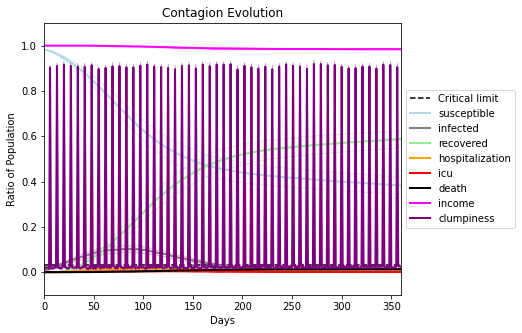

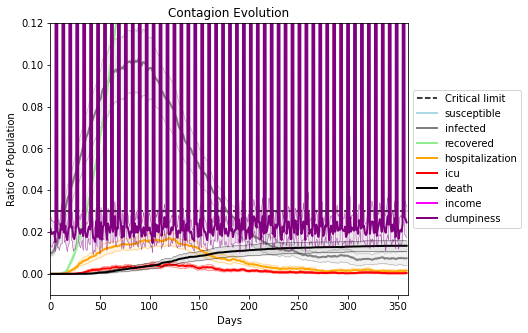

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9714, 5616, 5618, 9310, 6851, 9188, 4345, 9233, 3234, 2308, 7841, 9068, 6897, 8677, 1764, 8289, 4312, 9979, 2633, 7455]
Average similarity between family members is 0.4301469697994807 at temperature -0.8
Average similarity between family and home is 0.999861858404061 at temperature -1
Average similarity between students and their classroom is 0.15717563947566796 at temperature -0.8
Average classroom occupancy is 4.166666666666667 and number classrooms is 72
Average similarity between workers is 0.27970748701360637 at temperature -0.8
Average office occupancy is 3.1584158415841586 and number offices is 202
Average friend similarity for adults: 0.49490237261402925 for kids: 0.35492594687501083
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.052091203818929635
avg restaurant similarity 0.03622511940123403
avg restaurant similarity 0.07641421561872637
avg restaurant similarity 0.09964214300094609
avg restaurant similarity 0.10344591903288348
avg restaurant similarity 0.07183951335220584
avg restaurant similarity 0.08163074479055102
avg restaurant similarity 0.04560726306386967
avg restaurant similarity 0.12557186509626644
avg restaurant similarity 0.10219554562164448
avg restaurant similarity 0.09651117353940201
avg restaurant similarity 0.09132985099430836
avg restaurant similarity 0.0861209188095615
avg restaurant similarity 0.07607603386440129
avg restaurant similarity 0.029968986552717614
avg restaurant similarity 0.07200740641172973
avg restaurant similarity 0.10431273145565663
avg restaurant similarity 0.1508661705666279
avg restaurant similarity 0.07357876586436791
avg restaurant similarity 0.09759564888488245
avg restaurant similarity 0.0656995007515255
avg restaurant similarity 0.1245544

avg restaurant similarity 0.0862104232511881
avg restaurant similarity 0.1296594523607201
avg restaurant similarity 0.08523309363191628
avg restaurant similarity 0.1515677953256146
avg restaurant similarity 0.1009513497222874
avg restaurant similarity 0.07500651268669772
avg restaurant similarity 0.08097792198173331
avg restaurant similarity 0.11003669668132389
avg restaurant similarity 0.1552943758536864
avg restaurant similarity 0.10038393482826691
avg restaurant similarity 0.14499556353725374
avg restaurant similarity 0.15209640585470416
avg restaurant similarity 0.15651716214213796
avg restaurant similarity 0.10941802747789726
avg restaurant similarity 0.07714044461635058
avg restaurant similarity 0.10919730157595321
avg restaurant similarity 0.0329207436014122
avg restaurant similarity 0.09239673882702848
avg restaurant similarity 0.12047229210395252
avg restaurant similarity 0.05022551350304981
avg restaurant similarity 0.0814618047695166
avg restaurant similarity 0.0328564246937

avg restaurant similarity 0.08689923895390234
avg restaurant similarity 0.07985830396588645
avg restaurant similarity 0.06325645528201745
avg restaurant similarity 0.11686030837465212
avg restaurant similarity 0.11107831874949817
avg restaurant similarity 0.11154625886148481
avg restaurant similarity 0.05688452344755248
avg restaurant similarity 0.044430159553642344
avg restaurant similarity 0.08612576250870488
avg restaurant similarity 0.12004318599589095
avg restaurant similarity 0.07365896458489835
avg restaurant similarity 0.13257105983136863
avg restaurant similarity 0.1510936498104503
avg restaurant similarity 0.0751195923620613
avg restaurant similarity 0.07581769621678774
avg restaurant similarity 0.11044849748767499
avg restaurant similarity 0.06065304356532127
avg restaurant similarity 0.07406810579563099
avg restaurant similarity 0.054899512414508383
avg restaurant similarity 0.028372808527117772
avg restaurant similarity 0.062305281223618114
avg restaurant similarity 0.1120

avg restaurant similarity 0.004159903712893126
avg restaurant similarity 0.06180923902763581
avg restaurant similarity 0.09165960010498762
avg restaurant similarity 0.1036797512814074
avg restaurant similarity 0.044488330513762796
avg restaurant similarity 0.10709499046280516
avg restaurant similarity 0.09723394969002583
avg restaurant similarity 0.08002127951484066
avg restaurant similarity 0.07796362519143314
avg restaurant similarity 0.08253721775564911
avg restaurant similarity 0.11687272758397055
avg restaurant similarity 0.11499892307147078
avg restaurant similarity 0.05101874573442777
avg restaurant similarity 0.018233985365783766
avg restaurant similarity 0.08622270474143208
avg restaurant similarity 0.10840963807965431
avg restaurant similarity 0.10775118346625483
avg restaurant similarity 0.08879281521305726
avg restaurant similarity 0.08219249564591295
avg restaurant similarity 0.08313641806147319
avg restaurant similarity 0.1364566238430992
avg restaurant similarity 0.02928

avg restaurant similarity 0.12349970709176784
avg restaurant similarity 0.10453587317910608
avg restaurant similarity 0.13376303227392136
avg restaurant similarity 0.07112545601254876
avg restaurant similarity 0.08801364038554856
avg restaurant similarity 0.08280147034402396
avg restaurant similarity 0.0799717012025958
avg restaurant similarity 0.08353282976727107
avg restaurant similarity 0.026000650083668517
avg restaurant similarity 0.11959686495199634
avg restaurant similarity 0.10480886558626319
avg restaurant similarity 0.0908149457529125
avg restaurant similarity 0.07087710217475611
avg restaurant similarity 0.07911159460056454
avg restaurant similarity 0.09932117639077556
avg restaurant similarity 0.12887068221442127
avg restaurant similarity 0.10342534854261412
avg restaurant similarity 0.05212925631355302
avg restaurant similarity 0.10051842861666092
avg restaurant similarity 0.11775392404270583
avg restaurant similarity 0.1043813653854158
avg restaurant similarity 0.03316751

avg restaurant similarity 0.12385536282097591
avg restaurant similarity 0.11673989287194647
avg restaurant similarity 0.050415795748284836
avg restaurant similarity 0.09027956292598448
avg restaurant similarity 0.021174644399494222
avg restaurant similarity 0.03948948973904491
avg restaurant similarity 0.08659235261856513
avg restaurant similarity 0.09457241446955088
avg restaurant similarity 0.09976689932316742
avg restaurant similarity 0.1287351159979578
avg restaurant similarity 0.08349975098618764
avg restaurant similarity 0.06482175658513474
avg restaurant similarity 0.10763473105695102
avg restaurant similarity 0.08607706623483241
avg restaurant similarity 0.06698479088920627
avg restaurant similarity 0.10799166052021515
avg restaurant similarity 0.13727234233296265
avg restaurant similarity 0.16682538401231992
avg restaurant similarity 0.12196868925761338
avg restaurant similarity 0.06966931599699437
avg restaurant similarity 0.11613979536067234
avg restaurant similarity 0.13790

avg restaurant similarity 0.06431406294457563
avg restaurant similarity 0.08305618575662971
avg restaurant similarity 0.09013321072478814
avg restaurant similarity 0.06157826298443222
avg restaurant similarity 0.07148596982247019
avg restaurant similarity 0.08775123241497422
avg restaurant similarity 0.05284268436087746
avg restaurant similarity 0.14454683881996852
avg restaurant similarity 0.08947393745022095
avg restaurant similarity 0.058397913571964985
avg restaurant similarity 0.11280617724278795
avg restaurant similarity 0.09253935149039719
avg restaurant similarity 0.08820254685747458
avg restaurant similarity 0.11074857668448866
avg restaurant similarity 0.11360853027844665
avg restaurant similarity 0.09470413359360128
avg restaurant similarity 0.10319562535813136
avg restaurant similarity 0.12202005041859872
avg restaurant similarity 0.11045268975644301
avg restaurant similarity 0.08248067831617598
avg restaurant similarity 0.11947884523662372
avg restaurant similarity 0.08015

avg restaurant similarity 0.04279624524274824
avg restaurant similarity 0.14657518256811405
avg restaurant similarity 0.06469636973850384
avg restaurant similarity 0.060128368879356214
avg restaurant similarity 0.08541276768665382
avg restaurant similarity 0.0765868994541051
avg restaurant similarity 0.12574108879823243
avg restaurant similarity 0.08051284061312956
avg restaurant similarity 0.09685429040382297
avg restaurant similarity 0.10266953778634656
avg restaurant similarity 0.14739119704501114
avg restaurant similarity 0.1268556826908825
avg restaurant similarity 0.08384972313099669
avg restaurant similarity 0.06414019384357707
avg restaurant similarity 0.06853078923812458
avg restaurant similarity 0.09673173615917198
avg restaurant similarity 0.04680785136970239
avg restaurant similarity 0.09703999008348818
avg restaurant similarity 0.07699455288426785
avg restaurant similarity 0.12605674872360295
avg restaurant similarity 0.11278316930326007
avg restaurant similarity 0.0462383

avg restaurant similarity 0.10282486011148483
avg restaurant similarity 0.07079008954039129
avg restaurant similarity 0.07996820454051047
avg restaurant similarity 0.09122407028013099
avg restaurant similarity 0.056614550363890924
avg restaurant similarity 0.0595962343417921
avg restaurant similarity 0.12361490820385461
avg restaurant similarity 0.10016986741080734
avg restaurant similarity 0.04707891188910205
avg restaurant similarity 0.16671191156954393
avg restaurant similarity -0.019805400337918017
avg restaurant similarity 0.10251218752260167
avg restaurant similarity 0.07824613917165968
avg restaurant similarity 0.0925416321217221
avg restaurant similarity 0.04265832780838646
avg restaurant similarity 0.07851458057895085
avg restaurant similarity 0.06838840834347151
avg restaurant similarity 0.10734219042207822
avg restaurant similarity 0.030208079855624514
avg restaurant similarity 0.040122312253651066
avg restaurant similarity 0.05715489858424552
avg restaurant similarity 0.087

avg restaurant similarity 0.0893149741236028
avg restaurant similarity 0.09549835079017491
avg restaurant similarity 0.077575058340692
avg restaurant similarity 0.10318403160902659
avg restaurant similarity 0.08417674868406613
avg restaurant similarity 0.13975694008489048
avg restaurant similarity 0.11319622726257461
avg restaurant similarity 0.07954615136950786
avg restaurant similarity 0.05667737333006614
avg restaurant similarity 0.09456976308034773
avg restaurant similarity 0.1084994251673228
avg restaurant similarity 0.07351001478480776
avg restaurant similarity 0.09430400343690379
avg restaurant similarity 0.08621823369178022
avg restaurant similarity 0.13742229944151885
avg restaurant similarity 0.10913528183346168
avg restaurant similarity 0.12187348383706348
avg restaurant similarity 0.03937942779422254
avg restaurant similarity 0.08175867185148389
avg restaurant similarity -0.016523047100689935
avg restaurant similarity -0.03520403750649587
avg restaurant similarity 0.1181354

avg restaurant similarity 0.04879207282957532
avg restaurant similarity 0.06783215296051988
avg restaurant similarity 0.08372558776640934
avg restaurant similarity 0.027641001600364118
avg restaurant similarity 0.08041730433207284
avg restaurant similarity 0.06873942442485667
avg restaurant similarity 0.08979745075111839
avg restaurant similarity 0.09765209858849719
avg restaurant similarity 0.06525247905550405
avg restaurant similarity 0.05512439101569316
avg restaurant similarity 0.11046676518381114
avg restaurant similarity 0.04088026304734656
avg restaurant similarity 0.1530031855994484
avg restaurant similarity 0.07512130812717388
avg restaurant similarity 0.01185372989982288
avg restaurant similarity 0.13055764795550842
avg restaurant similarity 0.1009674576522318
avg restaurant similarity 0.03867386725999269
avg restaurant similarity 0.03197256191738177
avg restaurant similarity 0.029154476728246163
avg restaurant similarity 0.06495471034123451
avg restaurant similarity 0.092120

avg restaurant similarity 0.10643340503122382
avg restaurant similarity 0.06564681352421504
avg restaurant similarity 0.08367976957584848
avg restaurant similarity 0.0886776533456525
avg restaurant similarity 0.09458130925348511
avg restaurant similarity 0.03587407580977378
avg restaurant similarity 0.06600101233154157
avg restaurant similarity 0.11152390201341122
avg restaurant similarity 0.049935109308306434
avg restaurant similarity 0.052555253721220524
avg restaurant similarity 0.12129226545641907
avg restaurant similarity 0.0981783705576961
avg restaurant similarity 0.07972989299433367
avg restaurant similarity 0.0897003609525377
avg restaurant similarity 0.05688729156546998
avg restaurant similarity 0.0976671210965866
avg restaurant similarity 0.0899440787973853
avg restaurant similarity 0.01134113490365819
avg restaurant similarity 0.11714367447319914
avg restaurant similarity 0.05776547560676231
avg restaurant similarity 0.11628526575387899
avg restaurant similarity 0.100451278

avg restaurant similarity 0.11301491016980088
avg restaurant similarity 0.041784802243691695
avg restaurant similarity 0.08143844694720981
avg restaurant similarity 0.09239264261614318
avg restaurant similarity 0.07095733029850997
avg restaurant similarity 0.0006982020735260883
avg restaurant similarity 0.012605230143960358
avg restaurant similarity 0.028407724129619335
avg restaurant similarity 0.05144728509448403
avg restaurant similarity 0.021293817545698715
avg restaurant similarity 0.10435737095555551
avg restaurant similarity 0.08820063585243791
avg restaurant similarity 0.02225728372214177
avg restaurant similarity 0.07197809847767717
avg restaurant similarity 0.11655820174291974
avg restaurant similarity 0.050687910789263935
avg restaurant similarity 0.06373282066565784
avg restaurant similarity 0.04971742372652115
avg restaurant similarity 0.04011688446526763
avg restaurant similarity 0.05953777476322359
avg restaurant similarity 0.05035868708697246
avg restaurant similarity 0

avg restaurant similarity 0.08090691085808652
avg restaurant similarity 0.02463421181793014
avg restaurant similarity 0.06868877540189716
avg restaurant similarity 0.10203649914862112
avg restaurant similarity 0.10386830457362943
avg restaurant similarity 0.06270355094055187
avg restaurant similarity 0.07778832419854453
avg restaurant similarity 0.03285848819943766
avg restaurant similarity 0.05342393036519025
avg restaurant similarity 0.0878146791048387
avg restaurant similarity 0.048116002676093665
avg restaurant similarity 0.04145672888378049
avg restaurant similarity 0.021494761884044707
avg restaurant similarity 0.06538047246886668
avg restaurant similarity 0.06693658444226687
avg restaurant similarity 0.08982631390446888
avg restaurant similarity 0.08469027885247767
avg restaurant similarity 0.08007112316435509
avg restaurant similarity 0.11365713156613344
avg restaurant similarity 0.059564209862789194
avg restaurant similarity 0.09389191139777867
avg restaurant similarity 0.0719

avg restaurant similarity 0.09447048678069074
avg restaurant similarity 0.16358478247702107
avg restaurant similarity 0.15671520391573562
avg restaurant similarity 0.08243752840451594
avg restaurant similarity 0.1222194378571573
avg restaurant similarity 0.0853949273135123
avg restaurant similarity 0.0886364151793526
avg restaurant similarity 0.10722647474485213
avg restaurant similarity 0.059919592906670774
avg restaurant similarity 0.19175700995365935
avg restaurant similarity 0.18747183822849212
avg restaurant similarity 0.16924454557872914
avg restaurant similarity 0.0883462203755323
avg restaurant similarity 0.14127314188127
avg restaurant similarity 0.12785866782943725
avg restaurant similarity 0.15139911242555282
avg restaurant similarity 0.14418052310594756
avg restaurant similarity 0.1691840949559598
avg restaurant similarity 0.20862466102766056
avg restaurant similarity 0.15097827828382857
avg restaurant similarity 0.14027016840178846
avg restaurant similarity 0.1264144908978

avg restaurant similarity 0.15335765203869986
avg restaurant similarity 0.11694238853348263
avg restaurant similarity 0.1033417724134606
avg restaurant similarity 0.1642781489827533
avg restaurant similarity 0.10007265318623594
avg restaurant similarity 0.17049921064728657
avg restaurant similarity 0.08316832085297142
avg restaurant similarity 0.07811716040364917
avg restaurant similarity 0.032269093029118304
avg restaurant similarity 0.0725910197034913
avg restaurant similarity 0.14677239514891274
avg restaurant similarity 0.15303906222750516
avg restaurant similarity 0.14760699967959534
avg restaurant similarity 0.1103715305214497
avg restaurant similarity 0.10167776166526579
avg restaurant similarity 0.09344625803332139
avg restaurant similarity 0.10515849373858471
avg restaurant similarity 0.1251282886333376
avg restaurant similarity 0.13056225263637744
avg restaurant similarity 0.0762189288452399
avg restaurant similarity 0.1309871976765944
avg restaurant similarity 0.069371813201

avg restaurant similarity 0.08556718158645536
avg restaurant similarity 0.12466988356684157
avg restaurant similarity 0.12169751723585263
avg restaurant similarity 0.05059294403474798
avg restaurant similarity 0.1373270876484124
avg restaurant similarity 0.09124532048251963
avg restaurant similarity 0.07911338788672237
avg restaurant similarity 0.09648186649863862
avg restaurant similarity 0.11052096164852612
avg restaurant similarity 0.1462560854445998
avg restaurant similarity 0.08317235879386677
avg restaurant similarity 0.1145363558404858
avg restaurant similarity 0.106192508025063
avg restaurant similarity 0.0696342050594571
avg restaurant similarity 0.05116375352310646
avg restaurant similarity 0.15845903461262145
avg restaurant similarity 0.0801033150693132
avg restaurant similarity 0.154493852348565
avg restaurant similarity 0.09657604204819766
avg restaurant similarity 0.11378825466246995
avg restaurant similarity 0.14094188403004082
avg restaurant similarity 0.020987529151931

avg restaurant similarity 0.11092514931903837
avg restaurant similarity 0.0719094939209958
avg restaurant similarity 0.04547066470963101
avg restaurant similarity 0.06974511889705945
avg restaurant similarity 0.1387242374113109
avg restaurant similarity 0.13226098444178985
avg restaurant similarity 0.10306954334192572
avg restaurant similarity 0.12928931776665673
avg restaurant similarity 0.075744980820874
avg restaurant similarity 0.12182749340839713
avg restaurant similarity 0.13501540072137094
avg restaurant similarity 0.06815308144043666
avg restaurant similarity 0.12719360260164014
avg restaurant similarity 0.08104995044115194
avg restaurant similarity 0.10995603628263456
avg restaurant similarity 0.1164964346681758
avg restaurant similarity 0.14255760749468427
avg restaurant similarity 0.10003501818270545
avg restaurant similarity 0.09533126013781992
avg restaurant similarity 0.04205146511940971
avg restaurant similarity 0.07091478141320115
avg restaurant similarity 0.12922402037

avg restaurant similarity 0.042248467685526724
avg restaurant similarity 0.015508769160573338
avg restaurant similarity 0.05817247802298967
avg restaurant similarity 0.019244202432761415
avg restaurant similarity 0.09369484990646802
avg restaurant similarity 0.08054118676193177
avg restaurant similarity 0.14702914546747292
avg restaurant similarity 0.036539344396288885
avg restaurant similarity 0.0497717481793173
avg restaurant similarity 0.029336429229147268
avg restaurant similarity 0.011924835430028018
avg restaurant similarity 0.038624492748261886
avg restaurant similarity 0.021814034603026628
avg restaurant similarity 0.08039599040414445
avg restaurant similarity 0.08436688249608429
avg restaurant similarity 0.06166873205343059
avg restaurant similarity 0.07232787950461525
avg restaurant similarity -0.013721027609071918
avg restaurant similarity 0.0541400874738593
avg restaurant similarity 0.0762363039401252
avg restaurant similarity 0.12017846301445063
avg restaurant similarity 0

avg restaurant similarity 0.06567720343497124
avg restaurant similarity 0.0052000138022332085
avg restaurant similarity 0.14545123767087018
avg restaurant similarity 0.028151062234937546
avg restaurant similarity -0.0299114500197646
avg restaurant similarity 0.02518031488729931
avg restaurant similarity 0.05286958605051039
avg restaurant similarity 0.06610795573243561
avg restaurant similarity 0.05779040953442629
avg restaurant similarity 0.07460781497108683
avg restaurant similarity 0.062398719085970895
avg restaurant similarity 0.011613846823121205
avg restaurant similarity 0.03369126436216188
avg restaurant similarity 0.054503928593849116
avg restaurant similarity 0.05496278721582405
avg restaurant similarity 0.01038683057121727
avg restaurant similarity -0.007489294104244704
avg restaurant similarity 0.1018699713079165
avg restaurant similarity 0.0024644224552433894
avg restaurant similarity 0.03925127146086162
avg restaurant similarity 0.02271642827981989
avg restaurant similarity

avg restaurant similarity 0.10343094342703522
avg restaurant similarity 0.057416441102194224
avg restaurant similarity 0.11838726196566178
avg restaurant similarity 0.10719874161186886
avg restaurant similarity 0.1586554132868219
avg restaurant similarity 0.06480463758224979
avg restaurant similarity 0.11336800291892901
avg restaurant similarity 0.0939919797944051
avg restaurant similarity 0.1358390028291721
avg restaurant similarity 0.08272882886205808
avg restaurant similarity 0.11589659383738435
avg restaurant similarity 0.09989712176852729
avg restaurant similarity 0.06894194902197538
avg restaurant similarity 0.10687843449307605
avg restaurant similarity 0.12381550758557454
avg restaurant similarity 0.08721109086220524
avg restaurant similarity 0.09128480759707668
avg restaurant similarity 0.135677570494531
avg restaurant similarity 0.09832034363932206
avg restaurant similarity 0.13300623317105134
avg restaurant similarity 0.11063474863767062
avg restaurant similarity 0.1053934704

avg restaurant similarity 0.15640070436822812
avg restaurant similarity 0.12005194637322221
avg restaurant similarity 0.12523222366853728
avg restaurant similarity 0.11058573720037027
avg restaurant similarity 0.08743550954500334
avg restaurant similarity 0.042148950005246
avg restaurant similarity 0.12093909037715522
avg restaurant similarity 0.0763173611494957
avg restaurant similarity 0.07084420022358359
avg restaurant similarity 0.1405738798064047
avg restaurant similarity 0.10229092271543155
avg restaurant similarity 0.10152779735271336
avg restaurant similarity 0.06394180655369244
avg restaurant similarity 0.07123131704902075
avg restaurant similarity 0.03558288096845823
avg restaurant similarity 0.09049717782186992
avg restaurant similarity 0.10393539982027616
avg restaurant similarity 0.11537374441026255
avg restaurant similarity 0.07995412225343274
avg restaurant similarity 0.13695995626550103
avg restaurant similarity 0.09451145216785829
avg restaurant similarity 0.1269573544

avg restaurant similarity 0.11728494088649863
avg restaurant similarity 0.09525086623218744
avg restaurant similarity 0.015033171653509116
avg restaurant similarity 0.12126882387654958
avg restaurant similarity 0.07803309382478273
avg restaurant similarity 0.09725789600996908
avg restaurant similarity 0.13714303825174373
avg restaurant similarity 0.10471431765982417
avg restaurant similarity 0.04752130239046333
avg restaurant similarity 0.15723629642681797
avg restaurant similarity 0.10719191161933485
avg restaurant similarity 0.10221316236297537
avg restaurant similarity 0.11906232519833167
avg restaurant similarity 0.09288817572002399
avg restaurant similarity 0.07386066392588787
avg restaurant similarity 0.11427982924036596
avg restaurant similarity 0.06697040257423618
avg restaurant similarity 0.06813320544336962
avg restaurant similarity 0.0830616658493109
avg restaurant similarity 0.08514367181550064
avg restaurant similarity 0.054622673686601904
avg restaurant similarity 0.13515

avg restaurant similarity 0.13304316787320355
avg restaurant similarity 0.07843477790645158
avg restaurant similarity 0.024636864745185567
avg restaurant similarity 0.1015268091412203
avg restaurant similarity 0.11362381484694846
avg restaurant similarity 0.03948414994157446
avg restaurant similarity 0.0846747581400715
avg restaurant similarity 0.11475872785475635
avg restaurant similarity 0.12775490675198709
avg restaurant similarity 0.08297010022816424
avg restaurant similarity 0.16373443189181577
avg restaurant similarity 0.0734361966754715
avg restaurant similarity 0.18706850226883556
avg restaurant similarity 0.09187777611112173
avg restaurant similarity 0.11805349311343948
avg restaurant similarity 0.045579858058909635
avg restaurant similarity 0.10610747057971913
avg restaurant similarity 0.05180636851783946
avg restaurant similarity 0.09810752598107553
avg restaurant similarity 0.005646288109262087
avg restaurant similarity 0.0894010397507231
avg restaurant similarity 0.0696918

avg restaurant similarity 0.1055170068950778
avg restaurant similarity 0.10269434755495678
avg restaurant similarity 0.05168230904787325
avg restaurant similarity 0.05854180654623802
avg restaurant similarity 0.1302407905739973
avg restaurant similarity 0.11088906252457342
avg restaurant similarity 0.049197305184645344
avg restaurant similarity 0.07321094840436855
avg restaurant similarity 0.05613913315641526
avg restaurant similarity 0.10129800021574668
avg restaurant similarity 0.06699619990497423
avg restaurant similarity 0.08639479697552314
avg restaurant similarity 0.08990919302619212
avg restaurant similarity 0.07326081409812701
avg restaurant similarity 0.055898729389722526
avg restaurant similarity 0.11336865082990481
avg restaurant similarity 0.07032909179518164
avg restaurant similarity 0.04503269302694109
avg restaurant similarity 0.1257123240995639
avg restaurant similarity 0.13575227062330755
avg restaurant similarity 0.1044282500495664
avg restaurant similarity 0.06925789

avg restaurant similarity 0.09432234461411562
avg restaurant similarity 0.08958266054068575
avg restaurant similarity 0.08083222062503723
avg restaurant similarity 0.06669095843703944
avg restaurant similarity 0.06735924937798406
avg restaurant similarity 0.04977036203659519
avg restaurant similarity 0.06863855826248082
avg restaurant similarity 0.04739740703939591
avg restaurant similarity 0.08377478871055664
avg restaurant similarity 0.07044437168619447
avg restaurant similarity 0.04772860693865604
avg restaurant similarity 0.09903250136477625
avg restaurant similarity 0.05615474796910341
avg restaurant similarity 0.13529071716736926
avg restaurant similarity 0.11792653898726618
avg restaurant similarity 0.046362036707488834
avg restaurant similarity 0.01955113603980109
avg restaurant similarity 0.12452889567935335
avg restaurant similarity 0.07719253191764999
avg restaurant similarity 0.13389535384275197
avg restaurant similarity 0.11791106709128689
avg restaurant similarity 0.03206

avg restaurant similarity 0.09536580597303397
avg restaurant similarity 0.12940714514741683
avg restaurant similarity 0.18791330301310571
avg restaurant similarity 0.12406711621226034
avg restaurant similarity 0.14147721251754533
avg restaurant similarity 0.19649355264534094
avg restaurant similarity 0.08097022984554746
avg restaurant similarity 0.14076525401692538
avg restaurant similarity 0.07933465325427379
avg restaurant similarity 0.129952693745801
avg restaurant similarity 0.1251126453091735
avg restaurant similarity 0.15345152462841546
avg restaurant similarity 0.1448034657277206
avg restaurant similarity 0.14070830616780344
avg restaurant similarity 0.18006181330935733
avg restaurant similarity 0.11637910451126565
avg restaurant similarity 0.2109211012947179
avg restaurant similarity 0.15466920117924288
avg restaurant similarity 0.1515433669461477
avg restaurant similarity 0.18616910659047328
avg restaurant similarity 0.11340232344294496
avg restaurant similarity 0.221356342041

avg restaurant similarity 0.15609362627382486
avg restaurant similarity 0.09651515277327392
avg restaurant similarity 0.10602279025028415
avg restaurant similarity 0.07507717018790314
avg restaurant similarity 0.12774040108460427
avg restaurant similarity 0.13933495575193408
avg restaurant similarity 0.1554775311041829
avg restaurant similarity 0.11519103013102899
avg restaurant similarity 0.12726414786921128
avg restaurant similarity 0.10160465086785966
avg restaurant similarity 0.16361269238983858
avg restaurant similarity 0.1746027284879674
avg restaurant similarity 0.041035824429117136
avg restaurant similarity 0.16685181998417312
avg restaurant similarity 0.14404354875613423
avg restaurant similarity 0.08914880526464816
avg restaurant similarity 0.14739988402996634
avg restaurant similarity 0.18048155796930426
avg restaurant similarity 0.09872161941954458
avg restaurant similarity 0.14138457101813248
avg restaurant similarity 0.13275242224667774
avg restaurant similarity 0.1192410

avg restaurant similarity 0.12824591353149803
avg restaurant similarity 0.08070536650196136
avg restaurant similarity 0.12748147652633124
avg restaurant similarity 0.08262627359121012
avg restaurant similarity 0.14636882690656577
avg restaurant similarity 0.051665442509360046
avg restaurant similarity 0.051280393808114055
avg restaurant similarity 0.0927711870782122
avg restaurant similarity 0.1359778802128578
avg restaurant similarity 0.10767533689147561
avg restaurant similarity 0.09361556896124326
avg restaurant similarity 0.08877925776907382
avg restaurant similarity 0.14831703857209708
avg restaurant similarity 0.04300694231862878
avg restaurant similarity 0.020563695301972773
avg restaurant similarity 0.057530423823793767
avg restaurant similarity 0.05249765319286988
avg restaurant similarity 0.04322310870342407
avg restaurant similarity 0.10598046151292963
avg restaurant similarity 0.08171956421820102
avg restaurant similarity 0.06285603387898897
avg restaurant similarity 0.1036

avg restaurant similarity 0.09439010475571558
avg restaurant similarity 0.03799673499794579
avg restaurant similarity 0.07004903155846874
avg restaurant similarity 0.12224992351106169
avg restaurant similarity 0.03783953897784131
avg restaurant similarity 0.1226826754937896
avg restaurant similarity 0.04852937600645952
avg restaurant similarity 0.14492513100916538
avg restaurant similarity 0.11787736296212105
avg restaurant similarity 0.12888944790525314
avg restaurant similarity 0.07172709374283665
avg restaurant similarity 0.12528151337019577
avg restaurant similarity 0.127061657118375
avg restaurant similarity 0.04393511451323469
avg restaurant similarity 0.0487375319658629
avg restaurant similarity 0.08944001985098635
avg restaurant similarity 0.13581292526697517
avg restaurant similarity 0.03808371058254917
avg restaurant similarity 0.12577001253242562
avg restaurant similarity 0.06947499260102957
avg restaurant similarity 0.07032717055560897
avg restaurant similarity 0.0845455538

avg restaurant similarity 0.15140163601940163
avg restaurant similarity 0.10560776730800384
avg restaurant similarity 0.1371783013077347
avg restaurant similarity 0.09519874520385184
avg restaurant similarity 0.1493920631424381
avg restaurant similarity 0.123330011131134
avg restaurant similarity 0.17027312236841088
avg restaurant similarity 0.08932699948687942
avg restaurant similarity 0.03250458879045524
avg restaurant similarity 0.10157400664198347
avg restaurant similarity 0.15448318743322714
avg restaurant similarity 0.04301865395673333
avg restaurant similarity 0.12692265784335097
avg restaurant similarity 0.09667172379328952
avg restaurant similarity 0.1510751160892556
avg restaurant similarity 0.15596841959395377
avg restaurant similarity 0.10950198564019925
avg restaurant similarity 0.19623599427527305
avg restaurant similarity 0.09336146863494747
avg restaurant similarity 0.09386040214632589
avg restaurant similarity 0.1032206340890781
avg restaurant similarity 0.090264060458

avg restaurant similarity 0.08102313735321405
avg restaurant similarity 0.07006878814232603
avg restaurant similarity 0.176629485739891
avg restaurant similarity 0.05208529499322735
avg restaurant similarity 0.15701554044498925
avg restaurant similarity 0.13885907522001933
avg restaurant similarity 0.14345251851006174
avg restaurant similarity 0.07620860507018476
avg restaurant similarity 0.06260075420113637
avg restaurant similarity 0.09741801496996548
avg restaurant similarity 0.13949442391124114
avg restaurant similarity 0.07142722138023953
avg restaurant similarity 0.034733571896607376
avg restaurant similarity 0.14091887486046606
avg restaurant similarity 0.10932156361521136
avg restaurant similarity 0.11959316335756899
avg restaurant similarity 0.11769150073190608
avg restaurant similarity 0.08704187207393731
avg restaurant similarity 0.08516622229960762
avg restaurant similarity 0.11537474928879204
avg restaurant similarity 0.10535915079299352
avg restaurant similarity 0.1506516

avg restaurant similarity 0.09803813679426511
avg restaurant similarity 0.09218441751114523
avg restaurant similarity 0.09169593678704507
avg restaurant similarity 0.06980866411161854
avg restaurant similarity 0.06148992534307579
avg restaurant similarity 0.046368554744161135
avg restaurant similarity 0.05522771992733197
avg restaurant similarity 0.037180102497294316
avg restaurant similarity 0.05297112006489321
avg restaurant similarity 0.10253403812718932
avg restaurant similarity 0.0440508192240215
avg restaurant similarity 0.07209494579895864
avg restaurant similarity 0.04884386538686397
avg restaurant similarity 0.0696470867011557
avg restaurant similarity 0.06974879477734419
avg restaurant similarity 0.0433258576162211
avg restaurant similarity 0.12109996034206402
avg restaurant similarity 0.1327211252784893
avg restaurant similarity 0.07872450264482374
avg restaurant similarity -0.009401403319785017
avg restaurant similarity 0.039287880509334926
avg restaurant similarity 0.04322

avg restaurant similarity 0.07882416384112048
avg restaurant similarity 0.07013161968699762
avg restaurant similarity 0.07994174520591746
avg restaurant similarity 0.04514064166369565
avg restaurant similarity 0.06882563921412545
avg restaurant similarity 0.05136571180120642
avg restaurant similarity 0.10639105914506321
avg restaurant similarity 0.04340555260635659
avg restaurant similarity 0.06296786915204333
avg restaurant similarity 0.06692987164924113
avg restaurant similarity 0.10553520930213288
avg restaurant similarity 0.06470398001059362
avg restaurant similarity 0.087810221156011
avg restaurant similarity 0.08300251860539443
avg restaurant similarity 0.08658874246447731
avg restaurant similarity 0.11980793801401336
avg restaurant similarity 0.113127360066883
avg restaurant similarity 0.029758056610062155
avg restaurant similarity 0.05420434470070802
avg restaurant similarity -0.015016125439395522
avg restaurant similarity 0.04237654859950907
avg restaurant similarity 0.0514458

avg restaurant similarity 0.09858166099708027
avg restaurant similarity 0.11869790678615712
avg restaurant similarity 0.05142378778892888
avg restaurant similarity 0.053613053060802954
avg restaurant similarity 0.09843481333162496
avg restaurant similarity 0.05651605121759613
avg restaurant similarity 0.09584560396645529
avg restaurant similarity 0.05978092325599391
avg restaurant similarity 0.05972228877712746
avg restaurant similarity 0.040755411622093715
avg restaurant similarity 0.12125143960277569
avg restaurant similarity 0.1227717120905351
avg restaurant similarity 0.05736336069203773
avg restaurant similarity 0.08584528311275545
avg restaurant similarity 0.06653504061842874
avg restaurant similarity 0.14434616789496793
avg restaurant similarity 0.07383452754242009
avg restaurant similarity 0.022712405088325144
avg restaurant similarity 0.09727069531572012
avg restaurant similarity 0.06275029288317874
avg restaurant similarity 0.05023496355832582
avg restaurant similarity 0.1005

avg restaurant similarity 0.07920101110268028
avg restaurant similarity 0.024804200889868063
avg restaurant similarity 0.019504589236655892
avg restaurant similarity 0.1217207218887846
avg restaurant similarity 0.06867773758099341
avg restaurant similarity 0.11521427927907382
avg restaurant similarity 0.12190998135254583
avg restaurant similarity 0.0819420240899217
avg restaurant similarity 0.11554117708378848
avg restaurant similarity 0.10545538165476215
avg restaurant similarity 0.019137791728948833
avg restaurant similarity 0.059177376368125825
avg restaurant similarity 0.07621234046730964
avg restaurant similarity 0.136041383020908
avg restaurant similarity -0.016779106575980654
avg restaurant similarity 0.07975448324648567
avg restaurant similarity 0.09989155636319803
avg restaurant similarity 0.06053179714637849
avg restaurant similarity 0.02744195327645869
avg restaurant similarity 0.06120788217074551
avg restaurant similarity 0.15699264120305462
avg restaurant similarity 0.0790

avg restaurant similarity 0.1105507130562475
avg restaurant similarity 0.07567777587798452
avg restaurant similarity 0.055337705727108645
avg restaurant similarity 0.08179303384071519
avg restaurant similarity 0.14504660699203198
avg restaurant similarity 0.05879189321925071
avg restaurant similarity 0.12316908740646083
avg restaurant similarity 0.11958894726671086
avg restaurant similarity 0.10351422555374722
avg restaurant similarity 0.09702863065089253
avg restaurant similarity 0.05469819993724761
avg restaurant similarity 0.08445187288795289
avg restaurant similarity 0.13008882002083177
avg restaurant similarity 0.07879209129990077
avg restaurant similarity 0.056477772028371676
avg restaurant similarity 0.0420543848975248
avg restaurant similarity 0.1551316290233875
avg restaurant similarity 0.053593236460347145
avg restaurant similarity 0.13974842231181844
avg restaurant similarity 0.15010296887180774
avg restaurant similarity 0.052834176163034124
avg restaurant similarity 0.10686

avg restaurant similarity 0.12175315180294874
avg restaurant similarity 0.07870358058879867
avg restaurant similarity 0.04767215587095152
avg restaurant similarity 0.11123669367225927
avg restaurant similarity 0.07222061573048633
avg restaurant similarity 0.10967705601439352
avg restaurant similarity 0.0677406462475902
avg restaurant similarity 0.11468127356744054
avg restaurant similarity 0.10224984490177633
avg restaurant similarity 0.08038244081758279
avg restaurant similarity 0.08448143018395805
avg restaurant similarity 0.0956985602502307
avg restaurant similarity 0.05818860718760647
avg restaurant similarity 0.07729786654191863
avg restaurant similarity 0.06404078993525045
avg restaurant similarity 0.08836274100314807
avg restaurant similarity 0.13040660154130268
avg restaurant similarity 0.05515275109399854
avg restaurant similarity 0.09770752861272745
avg restaurant similarity 0.08640282801882429
avg restaurant similarity 0.07738668865501781
avg restaurant similarity 0.17438527

avg restaurant similarity 0.054797576307745045
avg restaurant similarity 0.16989112474627707
avg restaurant similarity 0.10717334246333617
avg restaurant similarity 0.13033416531446188
avg restaurant similarity 0.08286936890823547
avg restaurant similarity 0.15327371338485712
avg restaurant similarity 0.08078232661142914
avg restaurant similarity 0.08793516627012504
avg restaurant similarity 0.14153189965041002
avg restaurant similarity 0.0931671240537223
avg restaurant similarity 0.0733223100493212
avg restaurant similarity 0.04994000566507241
avg restaurant similarity 0.12942163085229258
avg restaurant similarity 0.14340632327816252
avg restaurant similarity 0.193109512164637
avg restaurant similarity 0.08780594663976658
avg restaurant similarity 0.09167902196439938
avg restaurant similarity 0.12022238683684287
avg restaurant similarity 0.13437509273226483
avg restaurant similarity 0.08029031832644258
avg restaurant similarity 0.09106629164997117
avg restaurant similarity 0.124146500

avg restaurant similarity 0.09800748389076547
avg restaurant similarity 0.10637107622267339
avg restaurant similarity 0.09044670456395704
avg restaurant similarity 0.07820274405901666
avg restaurant similarity 0.12618500142595154
avg restaurant similarity 0.08935143792373543
avg restaurant similarity 0.09216033199889186
avg restaurant similarity 0.06743615601817204
avg restaurant similarity 0.11344579591648199
avg restaurant similarity 0.09829393164129385
avg restaurant similarity 0.10837094430833343
avg restaurant similarity -0.0011339723635955612
avg restaurant similarity 0.04386791814454885
avg restaurant similarity 0.08786125814318729
avg restaurant similarity 0.012342057444236023
avg restaurant similarity 0.10928737234380255
avg restaurant similarity 0.1293499686897992
avg restaurant similarity 0.005403651311528391
avg restaurant similarity 0.08023404262449949
avg restaurant similarity 0.05351321687485146
avg restaurant similarity 0.10579911375257743
avg restaurant similarity 0.10

(<function dict.items>, <function dict.items>, <function dict.items>)

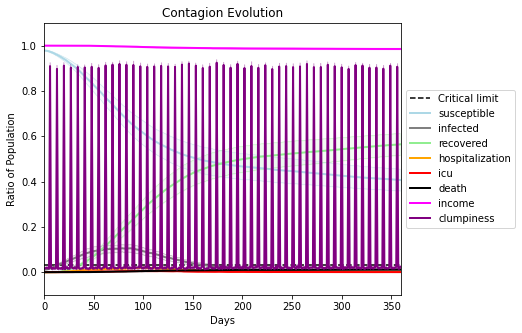

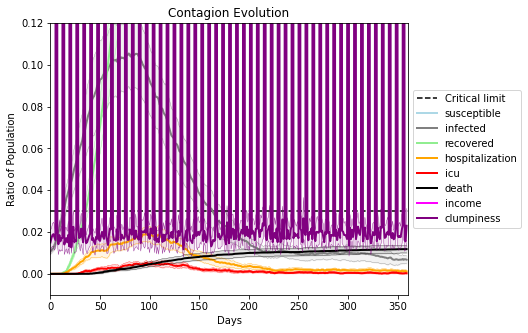

In [31]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2036, 88, 5387, 4824, 5183, 9977, 6346, 1506, 8373, 8984, 2587, 8671, 2535, 1067, 669, 8442, 2712, 5613, 4141, 3989]
Average similarity between family members is 0.3426465006492141 at temperature -0.7
Average similarity between family and home is 0.9998615468955648 at temperature -1
Average similarity between students and their classroom is 0.14076075676982552 at temperature -0.7
Average classroom occupancy is 4.542857142857143 and number classrooms is 70
Average similarity between workers is 0.1828423412269471 at temperature -0.7
Average office occupancy is 3.154228855721393 and number offices is 201
Average friend similarity for adults: 0.42131207398181697 for kids: 0.28918381017333533
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.19422576319261506
avg restaurant similarity 0.0888085749423096
avg restaurant similarity 0.19229504468231062
avg restaurant similarity 0.0978807858701306
avg restaurant similarity 0.0902926038599626
avg restaurant similarity 0.02220053333597711
avg restaurant similarity 0.09254456141772509
avg restaurant similarity 0.05803708661853364
avg restaurant similarity 0.1252370669210431
avg restaurant similarity 0.05484356943368006
avg restaurant similarity 0.0783802111882912
avg restaurant similarity 0.06843896973657386
avg restaurant similarity 0.04767420368861385
avg restaurant similarity 0.0692514148745874
avg restaurant similarity 0.08948904719636006
avg restaurant similarity 0.036238289548745944
avg restaurant similarity 0.09392833421142874
avg restaurant similarity 0.06363451701034258
avg restaurant similarity 0.06290618361047011
avg restaurant similarity 0.10617728513902489
avg restaurant similarity 0.019169643470415252
avg restaurant similarity 0.0739606161

avg restaurant similarity 0.035752305303883486
avg restaurant similarity 0.1350604014405518
avg restaurant similarity 0.03706520769259271
avg restaurant similarity 0.08630087797926966
avg restaurant similarity 0.06356502621427441
avg restaurant similarity 0.11219193662899685
avg restaurant similarity 0.07520867460845318
avg restaurant similarity 0.06131956353792346
avg restaurant similarity 0.13045836852889495
avg restaurant similarity 0.10301095641350139
avg restaurant similarity 0.11275149723587827
avg restaurant similarity 0.13569550392101254
avg restaurant similarity 0.07244640094928771
avg restaurant similarity 0.08067351896938088
avg restaurant similarity 0.0782417792377629
avg restaurant similarity 0.07771460998411711
avg restaurant similarity 0.062286551188829385
avg restaurant similarity 0.07710097470450468
avg restaurant similarity 0.06576690683230887
avg restaurant similarity 0.15590450087043672
avg restaurant similarity 0.10987671708519732
avg restaurant similarity 0.176901

avg restaurant similarity 0.09708383539359915
avg restaurant similarity 0.09411960153019541
avg restaurant similarity 0.07686987081761962
avg restaurant similarity 0.05358161876439571
avg restaurant similarity 0.05535703673956878
avg restaurant similarity 0.07423412433869137
avg restaurant similarity 0.10628283291737295
avg restaurant similarity 0.054381024953543744
avg restaurant similarity 0.09003400609522341
avg restaurant similarity 0.06690886647193961
avg restaurant similarity 0.06096176717841508
avg restaurant similarity 0.0500412426519109
avg restaurant similarity 0.07562238807005985
avg restaurant similarity 0.04371876525040878
avg restaurant similarity 0.08702212288811201
avg restaurant similarity 0.1517866042457809
avg restaurant similarity 0.10419393125916265
avg restaurant similarity 0.08255533086719645
avg restaurant similarity 0.12232036449638818
avg restaurant similarity 0.04443664565630759
avg restaurant similarity 0.061029473411912685
avg restaurant similarity 0.060138

avg restaurant similarity 0.13887426795165583
avg restaurant similarity 0.046889764157648194
avg restaurant similarity 0.04549498476735237
avg restaurant similarity 0.038274051658089656
avg restaurant similarity 0.025366648024346867
avg restaurant similarity 0.1281084918314937
avg restaurant similarity 0.11908038081761936
avg restaurant similarity 0.12445621666676192
avg restaurant similarity 0.048439412819574236
avg restaurant similarity 0.03999992256117228
avg restaurant similarity 0.09558123913312812
avg restaurant similarity 0.07537518280820993
avg restaurant similarity 0.0919776978530664
avg restaurant similarity 0.11562539499290163
avg restaurant similarity 0.05445315877624297
avg restaurant similarity 0.05868444832137873
avg restaurant similarity 0.04370598542012198
avg restaurant similarity 0.027560542593686437
avg restaurant similarity 0.09276772493616826
avg restaurant similarity 0.03712903941554456
avg restaurant similarity 0.06147577417147282
avg restaurant similarity 0.019

avg restaurant similarity 0.10768447856464014
avg restaurant similarity 0.08400466153633784
avg restaurant similarity 0.07416704540118732
avg restaurant similarity 0.04838076331147371
avg restaurant similarity 0.09669662296280096
avg restaurant similarity 0.09263817106935539
avg restaurant similarity 0.0780896662432327
avg restaurant similarity 0.11930342243496338
avg restaurant similarity 0.10796875061344138
avg restaurant similarity 0.07013419062192745
avg restaurant similarity 0.1345971134089331
avg restaurant similarity 0.08695951087414877
avg restaurant similarity 0.051738605916153625
avg restaurant similarity 0.10854849305960292
avg restaurant similarity 0.08744910043338719
avg restaurant similarity 0.092800326855025
avg restaurant similarity 0.035701625541029444
avg restaurant similarity 0.0710563159750402
avg restaurant similarity 0.06773031251024485
avg restaurant similarity 0.0912254576118391
avg restaurant similarity 0.11931888344217474
avg restaurant similarity 0.0606419868

avg restaurant similarity 0.07983071346079791
avg restaurant similarity 0.09557137007282349
avg restaurant similarity 0.04994627896971019
avg restaurant similarity 0.07373026395622223
avg restaurant similarity 0.09476585786425405
avg restaurant similarity 0.130565255576304
avg restaurant similarity 0.06646966472542956
avg restaurant similarity 0.12470946293201306
avg restaurant similarity 0.07557129031028623
avg restaurant similarity 0.07009691647993638
avg restaurant similarity 0.1270914175576095
avg restaurant similarity 0.09607803069013901
avg restaurant similarity 0.13012485670618085
avg restaurant similarity 0.09607578834264759
avg restaurant similarity 0.056747352920257614
avg restaurant similarity 0.14370018939359283
avg restaurant similarity 0.1190951002838326
avg restaurant similarity 0.10954754682948087
avg restaurant similarity 0.052039515444271434
avg restaurant similarity 0.08109769966955287
avg restaurant similarity 0.12988479867981792
avg restaurant similarity 0.13508556

avg restaurant similarity 0.06731326065137525
avg restaurant similarity 0.05032535571548261
avg restaurant similarity 0.09832582948761051
avg restaurant similarity 0.12273188872405502
avg restaurant similarity 0.059371851050498026
avg restaurant similarity 0.05078833010402202
avg restaurant similarity 0.03443855164268762
avg restaurant similarity 0.046926694136372266
avg restaurant similarity 0.12732244074852536
avg restaurant similarity 0.03773443937744781
avg restaurant similarity 0.07620487900823965
avg restaurant similarity 0.04396385852044809
avg restaurant similarity 0.09540891104228295
avg restaurant similarity 0.06553508428261601
avg restaurant similarity 0.04796872152654278
avg restaurant similarity 0.04851803093720463
avg restaurant similarity 0.09040530900029305
avg restaurant similarity 0.01908225422736993
avg restaurant similarity 0.1006302660342209
avg restaurant similarity 0.07381445961008545
avg restaurant similarity 0.08628914926425119
avg restaurant similarity 0.08583

avg restaurant similarity 0.07356859058898871
avg restaurant similarity 0.06445190717786005
avg restaurant similarity 0.043380890978095665
avg restaurant similarity 0.03382326580364387
avg restaurant similarity -0.010202326393914184
avg restaurant similarity 0.048646916111993725
avg restaurant similarity 0.04343680841565968
avg restaurant similarity 0.14571790730771092
avg restaurant similarity 0.053904482207529664
avg restaurant similarity 0.062208380881921224
avg restaurant similarity 0.07171997505153663
avg restaurant similarity 0.05196804002445953
avg restaurant similarity 0.06567666466988199
avg restaurant similarity 0.12741824477676456
avg restaurant similarity 0.06691606187203367
avg restaurant similarity 0.11119558698864786
avg restaurant similarity 0.12088025017186836
avg restaurant similarity 0.12205840326966264
avg restaurant similarity 0.06563550650344172
avg restaurant similarity 0.025793396618477057
avg restaurant similarity 0.07110934578166003
avg restaurant similarity 0

avg restaurant similarity 0.13969471709545753
avg restaurant similarity 0.13071983782005878
avg restaurant similarity 0.05018873198742529
avg restaurant similarity 0.1501775482254497
avg restaurant similarity 0.07418212698301704
avg restaurant similarity 0.1270825433296533
avg restaurant similarity 0.0764418665717413
avg restaurant similarity 0.07553801221820222
avg restaurant similarity 0.09150911358474259
avg restaurant similarity 0.06358954083174895
avg restaurant similarity 0.08603687517792255
avg restaurant similarity 0.053263666300800025
avg restaurant similarity 0.06376675482550893
avg restaurant similarity 0.1332534612140578
avg restaurant similarity 0.05072763551927917
avg restaurant similarity 0.07647782883014294
avg restaurant similarity 0.1051546045675351
avg restaurant similarity -0.01784446905979482
avg restaurant similarity 0.08259709440369552
avg restaurant similarity 0.06889692105603433
avg restaurant similarity 0.1442299924371318
avg restaurant similarity 0.1414656573

avg restaurant similarity 0.15247733805798425
avg restaurant similarity 0.10087202346959184
avg restaurant similarity 0.10698843945256924
avg restaurant similarity 0.1291375422693782
avg restaurant similarity 0.13825698377873769
avg restaurant similarity 0.09980075182582947
avg restaurant similarity 0.07488743849946035
avg restaurant similarity 0.0826089242337938
avg restaurant similarity 0.10898316412136101
avg restaurant similarity 0.07625828330104775
avg restaurant similarity 0.10691823795834672
avg restaurant similarity 0.11836637057673483
avg restaurant similarity 0.14137575964606847
avg restaurant similarity 0.09918701364982213
avg restaurant similarity 0.10886164851820584
avg restaurant similarity 0.12198976726239599
avg restaurant similarity 0.07736874367851423
avg restaurant similarity 0.062235148708427744
avg restaurant similarity 0.10214494494381639
avg restaurant similarity 0.13122240073424776
avg restaurant similarity 0.10064189821862103
avg restaurant similarity 0.0892190

avg restaurant similarity 0.08378839471516454
avg restaurant similarity 0.052913020785973625
avg restaurant similarity 0.09705786655098325
avg restaurant similarity 0.08335383753778935
avg restaurant similarity 0.07570532629966721
avg restaurant similarity 0.12512869988530398
avg restaurant similarity 0.08216226156961817
avg restaurant similarity 0.06074274398340477
avg restaurant similarity 0.0638858629156304
avg restaurant similarity 0.020002287279328946
avg restaurant similarity 0.06692919846439577
avg restaurant similarity 0.09947788559677591
avg restaurant similarity 0.08055126171294721
avg restaurant similarity 0.08080156939125385
avg restaurant similarity 0.1048767048839304
avg restaurant similarity 0.09625301484340705
avg restaurant similarity 0.06168560695092666
avg restaurant similarity 0.06209160448745762
avg restaurant similarity 0.11772039120832373
avg restaurant similarity 0.10864211840532247
avg restaurant similarity 0.11293687696964076
avg restaurant similarity 0.062524

avg restaurant similarity 0.09666817917755866
avg restaurant similarity 0.03527029263155231
avg restaurant similarity 0.09516264719129279
avg restaurant similarity 0.09082952968533467
avg restaurant similarity 0.09372257423597695
avg restaurant similarity 0.058292806229413234
avg restaurant similarity 0.09706389419306137
avg restaurant similarity 0.03604868746440014
avg restaurant similarity 0.069454660448308
avg restaurant similarity 0.009221246796102388
avg restaurant similarity 0.05598807994930298
avg restaurant similarity 0.06033720081732767
avg restaurant similarity 0.11343312682195648
avg restaurant similarity 0.08604946559175813
avg restaurant similarity 0.08984310801633408
avg restaurant similarity 0.10616935417804385
avg restaurant similarity 0.054508242366278305
avg restaurant similarity 0.14370474423591653
avg restaurant similarity 0.060285833065606885
avg restaurant similarity 0.13360691747394907
avg restaurant similarity 0.09772164072473245
avg restaurant similarity 0.1122

avg restaurant similarity 0.073619507031239
avg restaurant similarity 0.07449616423208441
avg restaurant similarity 0.11714486937802195
avg restaurant similarity 0.08704122082315204
avg restaurant similarity 0.1342065812720777
avg restaurant similarity 0.04839068668113108
avg restaurant similarity 0.047768777504270284
avg restaurant similarity 0.06807075656769716
avg restaurant similarity 0.09482572301045343
avg restaurant similarity 0.07487392681641857
avg restaurant similarity 0.05737276892380559
avg restaurant similarity 0.08617821002131275
avg restaurant similarity 0.0739976806143914
avg restaurant similarity 0.04738490502819686
avg restaurant similarity 0.09862275281677772
avg restaurant similarity 0.06401784628583185
avg restaurant similarity 0.06216999162132943
avg restaurant similarity 0.040763319568293696
avg restaurant similarity 0.05917200568312326
avg restaurant similarity 0.0529443548180226
avg restaurant similarity 0.054898840350633187
avg restaurant similarity 0.11561526

avg restaurant similarity 0.03404595566409237
avg restaurant similarity 0.03223179902370251
avg restaurant similarity 0.09543284753676402
avg restaurant similarity 0.05465897126575936
avg restaurant similarity 0.04595826128523699
avg restaurant similarity 0.03407991864859701
avg restaurant similarity 0.11718555730429425
avg restaurant similarity 0.06991644133263415
avg restaurant similarity 0.0859305224040126
avg restaurant similarity 0.08903595600550963
avg restaurant similarity 0.03555632321764523
avg restaurant similarity 0.07521154525297577
avg restaurant similarity 0.0711704496266011
avg restaurant similarity 0.07867819166116172
avg restaurant similarity 0.07484175655545296
avg restaurant similarity 0.08920326546315586
avg restaurant similarity 0.08779841537566001
avg restaurant similarity 0.07219991410715919
avg restaurant similarity 0.0967384919669596
avg restaurant similarity 0.034954176994112796
avg restaurant similarity 0.09877922363138632
avg restaurant similarity 0.10698007

avg restaurant similarity 0.09959934309322206
avg restaurant similarity 0.15289885744578527
avg restaurant similarity 0.10631718828671757
avg restaurant similarity 0.08015992943730602
avg restaurant similarity 0.12819766949160663
avg restaurant similarity 0.05938772338906656
avg restaurant similarity 0.03560476922275709
avg restaurant similarity 0.068002009263782
avg restaurant similarity 0.023498205273783723
avg restaurant similarity 0.07075041149871661
avg restaurant similarity 0.08548821456787283
avg restaurant similarity 0.1223086143235269
avg restaurant similarity 0.06563814660119907
avg restaurant similarity 0.06899473633183612
avg restaurant similarity 0.10139499285267414
avg restaurant similarity 0.05595782959712611
avg restaurant similarity 0.14443777402642274
avg restaurant similarity 0.10695977597907566
avg restaurant similarity 0.05087269615637952
avg restaurant similarity 0.06374456706207823
avg restaurant similarity 0.06461359459732297
avg restaurant similarity 0.07524471

avg restaurant similarity 0.10132920147641963
avg restaurant similarity 0.08425042656941946
avg restaurant similarity 0.0674597719561362
avg restaurant similarity 0.05208128170900056
avg restaurant similarity 0.06990484262272699
avg restaurant similarity 0.006191165102510922
avg restaurant similarity 0.109505523073296
avg restaurant similarity 0.08077170908841057
avg restaurant similarity 0.10433115853089092
avg restaurant similarity 0.08516322752529858
avg restaurant similarity 0.0943598485755998
avg restaurant similarity 0.05610457677706822
avg restaurant similarity 0.08742320324924022
avg restaurant similarity 0.0010476968978301614
avg restaurant similarity 0.06595995688268952
avg restaurant similarity 0.12161329663687938
avg restaurant similarity 0.02615188510728782
avg restaurant similarity 0.06153561841685226
avg restaurant similarity 0.08884598570806378
avg restaurant similarity 0.08646533821439815
avg restaurant similarity 0.056364786496321186
avg restaurant similarity 0.102730

avg restaurant similarity 0.051056688934258444
avg restaurant similarity 0.10634671581571413
avg restaurant similarity 0.10178439440780276
avg restaurant similarity 0.11577082642174903
avg restaurant similarity 0.08501161692717253
avg restaurant similarity 0.12688147872721237
avg restaurant similarity 0.08564534126435612
avg restaurant similarity 0.08429923622141895
avg restaurant similarity 0.09322472917576705
avg restaurant similarity 0.08387943763721174
avg restaurant similarity 0.050146386243918095
avg restaurant similarity 0.09468839538484694
avg restaurant similarity 0.03982618032010347
avg restaurant similarity 0.10532508181949438
avg restaurant similarity 0.11558988977222064
avg restaurant similarity 0.07415323158680406
avg restaurant similarity 0.10289986564962927
avg restaurant similarity 0.05084741496852196
avg restaurant similarity 0.024735936700955845
avg restaurant similarity 0.09942877084649346
avg restaurant similarity 0.06010995308204177
avg restaurant similarity 0.048

avg restaurant similarity 0.107452169733169
avg restaurant similarity 0.13714596106185054
avg restaurant similarity 0.08293232566930007
avg restaurant similarity 0.1473793634256706
avg restaurant similarity 0.0449229124703433
avg restaurant similarity 0.11221726742269282
avg restaurant similarity 0.09673478880167503
avg restaurant similarity -0.02187309516009502
avg restaurant similarity 0.12407391578004798
avg restaurant similarity 0.02374122658450194
avg restaurant similarity 0.03458017961825212
avg restaurant similarity 0.06734801791780139
avg restaurant similarity 0.09166895689664088
avg restaurant similarity 0.08198913836928601
avg restaurant similarity 0.04724640353578661
avg restaurant similarity 0.033926648202340336
avg restaurant similarity 0.01617434063169608
avg restaurant similarity 0.08661087168000682
avg restaurant similarity 0.08113180201120956
avg restaurant similarity 0.05812640300748228
avg restaurant similarity 0.08251589611358631
avg restaurant similarity 0.07877804

avg restaurant similarity 0.06693182771460515
avg restaurant similarity 0.11095835316437891
avg restaurant similarity 0.09261559810974188
avg restaurant similarity 0.10556971890793858
avg restaurant similarity 0.05225591804908146
avg restaurant similarity 0.13580829381618803
avg restaurant similarity 0.07603748454941456
avg restaurant similarity 0.07465929343926618
avg restaurant similarity 0.1748515770074635
avg restaurant similarity 0.12037706927142022
avg restaurant similarity 0.11197139180554605
avg restaurant similarity 0.047020332767075304
avg restaurant similarity 0.12272497201453932
avg restaurant similarity 0.06801415232478025
avg restaurant similarity 0.15599394202569386
avg restaurant similarity 0.10670223360074528
avg restaurant similarity 0.10147295893569046
avg restaurant similarity 0.051481881584127115
avg restaurant similarity 0.027860625958897964
avg restaurant similarity 0.1496689064797888
avg restaurant similarity 0.07542760537075212
avg restaurant similarity 0.10107

avg restaurant similarity 0.13648671584775585
avg restaurant similarity 0.13559076301507647
avg restaurant similarity 0.12086707727290555
avg restaurant similarity 0.07000910308591075
avg restaurant similarity 0.10472642811755632
avg restaurant similarity 0.06121214598139579
avg restaurant similarity 0.05971948457013066
avg restaurant similarity 0.07673192314146791
avg restaurant similarity 0.09166776215693799
avg restaurant similarity 0.1472281335044592
avg restaurant similarity 0.08470565120316648
avg restaurant similarity 0.07082979928160836
avg restaurant similarity 0.09444828229716998
avg restaurant similarity 0.13052763485560312
avg restaurant similarity 0.13002226147571
avg restaurant similarity 0.07314325065090918
avg restaurant similarity 0.09016360056413177
avg restaurant similarity 0.03367240986739142
avg restaurant similarity 0.05696326226289696
avg restaurant similarity 0.06407708918142639
avg restaurant similarity 0.12870091422002222
avg restaurant similarity 0.0408710027

avg restaurant similarity 0.05487918195743381
avg restaurant similarity 0.06794602950096425
avg restaurant similarity 0.09211063923554677
avg restaurant similarity 0.058498026506214995
avg restaurant similarity 0.10015538363284525
avg restaurant similarity 0.11614256719988678
avg restaurant similarity 0.07751055243982387
avg restaurant similarity 0.06811754058255914
avg restaurant similarity 0.11005906565213616
avg restaurant similarity 0.13943952007740432
avg restaurant similarity -0.011247500401969738
avg restaurant similarity 0.053314788417612245
avg restaurant similarity 0.05592614336882117
avg restaurant similarity 0.1301362746275056
avg restaurant similarity 0.11869686428900353
avg restaurant similarity 0.08263305224917415
avg restaurant similarity 0.0429603165306946
avg restaurant similarity 0.059603754575512015
avg restaurant similarity 0.12192607670585473
avg restaurant similarity 0.07225149581263149
avg restaurant similarity 0.11192373613693457
avg restaurant similarity 0.043

avg restaurant similarity 0.08949518398346579
avg restaurant similarity 0.11726862784049692
avg restaurant similarity 0.08223082625574145
avg restaurant similarity 0.1505724876733096
avg restaurant similarity 0.06370332278668443
avg restaurant similarity 0.09327063937129015
avg restaurant similarity 0.10833195908775033
avg restaurant similarity 0.09994290182086935
avg restaurant similarity 0.0954077092333952
avg restaurant similarity 0.1305122057254846
avg restaurant similarity 0.134912475494114
avg restaurant similarity 0.028264866730219208
avg restaurant similarity 0.08017714740960924
avg restaurant similarity -0.008107105864946021
avg restaurant similarity 0.08341953104466962
avg restaurant similarity 0.0940318228182507
avg restaurant similarity 0.080204810921669
avg restaurant similarity 0.11020776928606692
avg restaurant similarity 0.06849476234200662
avg restaurant similarity 0.05459900255520944
avg restaurant similarity 0.08767308560057302
avg restaurant similarity 0.08931535560

avg restaurant similarity 0.10221621282480246
avg restaurant similarity 0.06575211719304214
avg restaurant similarity 0.06922975124679402
avg restaurant similarity 0.09932842772380823
avg restaurant similarity 0.10983833681595494
avg restaurant similarity 0.04159705032822694
avg restaurant similarity 0.1200044729579549
avg restaurant similarity 0.1152586559869465
avg restaurant similarity 0.05486527237530777
avg restaurant similarity 0.08743634388432034
avg restaurant similarity 0.08539755193363326
avg restaurant similarity 0.0844115530310412
avg restaurant similarity 0.07199555132753106
avg restaurant similarity 0.1360616919368298
avg restaurant similarity 0.10770894087767663
avg restaurant similarity 0.05768907437066029
avg restaurant similarity 0.07324665395540451
avg restaurant similarity 0.12489999072177756
avg restaurant similarity 0.05262368861151574
avg restaurant similarity 0.07837194033306227
avg restaurant similarity 0.054279022546447994
avg restaurant similarity 0.048986360

avg restaurant similarity 0.02517272837996989
avg restaurant similarity 0.16382220513538626
avg restaurant similarity 0.08316830341366799
avg restaurant similarity 0.10349215718564904
avg restaurant similarity 0.0437826657023291
avg restaurant similarity 0.08613273927024437
avg restaurant similarity 0.09883333668366649
avg restaurant similarity 0.08510992451401701
avg restaurant similarity 0.12528486070633132
avg restaurant similarity 0.09037357227131264
avg restaurant similarity 0.09181300826073903
avg restaurant similarity 0.09979477432316249
avg restaurant similarity 0.04843904671088668
avg restaurant similarity 0.07727193575389588
avg restaurant similarity 0.12438201117800476
avg restaurant similarity 0.0445766700229365
avg restaurant similarity 0.094388544027571
avg restaurant similarity 0.11572600371912192
avg restaurant similarity 0.07637475958198507
avg restaurant similarity 0.0645063302523043
avg restaurant similarity 0.11591001443335516
avg restaurant similarity 0.10253537662

avg restaurant similarity 0.07771613160062757
avg restaurant similarity 0.05519427490428196
avg restaurant similarity 0.06301021828249827
avg restaurant similarity 0.03553298255411493
avg restaurant similarity 0.08964194905481894
avg restaurant similarity 0.07787841957187917
avg restaurant similarity 0.12068498786737658
avg restaurant similarity 0.048390056198609456
avg restaurant similarity 0.06242065366390612
avg restaurant similarity 0.041093379624232595
avg restaurant similarity 0.06731406649036811
avg restaurant similarity 0.05852903021329312
avg restaurant similarity 0.11884471150799102
avg restaurant similarity 0.08384523126988813
avg restaurant similarity 0.14093348825259813
avg restaurant similarity 0.05787430287330303
avg restaurant similarity 0.08915514653309849
avg restaurant similarity 0.05378807571013888
avg restaurant similarity 0.08484868830219182
avg restaurant similarity 0.08267473992185696
avg restaurant similarity 0.036898167200363895
avg restaurant similarity 0.076

avg restaurant similarity 0.06249721894557341
avg restaurant similarity 0.02530977732319889
avg restaurant similarity 0.06411827457403577
avg restaurant similarity 0.057538338650505255
avg restaurant similarity 0.05036127740167735
avg restaurant similarity 0.060788614891878
avg restaurant similarity 0.08578742992561388
avg restaurant similarity 0.1313818740760647
avg restaurant similarity 0.06664139165605382
avg restaurant similarity 0.07818629524895185
avg restaurant similarity 0.04704200263530279
avg restaurant similarity 0.07853468654342223
avg restaurant similarity 0.1103939039046409
avg restaurant similarity 0.03639654677349775
avg restaurant similarity 0.08909758008993153
avg restaurant similarity 0.07086594594065139
avg restaurant similarity 0.06177171305919979
avg restaurant similarity 0.09195121642134585
avg restaurant similarity 0.08418149401498372
avg restaurant similarity 0.07370310203587448
avg restaurant similarity 0.09451871745753236
avg restaurant similarity 0.069979899

avg restaurant similarity 0.09650980209556663
avg restaurant similarity 0.11193943157578634
avg restaurant similarity 0.07374144505116446
avg restaurant similarity 0.10435680408201396
avg restaurant similarity 0.07251924479859209
avg restaurant similarity 0.1399981464171299
avg restaurant similarity 0.10701140581840003
avg restaurant similarity 0.02863631138278024
avg restaurant similarity 0.1394669446016449
avg restaurant similarity 0.06111641789176346
avg restaurant similarity 0.12094999750184722
avg restaurant similarity 0.06966315006809022
avg restaurant similarity 0.05852035141361393
avg restaurant similarity 0.07378813461846728
avg restaurant similarity 0.03155958769465959
avg restaurant similarity 0.11393660236843728
avg restaurant similarity 0.12850916363724213
avg restaurant similarity 0.132938065025092
avg restaurant similarity 0.07643750361209348
avg restaurant similarity 0.028547817693112414
avg restaurant similarity 0.12265201085611634
avg restaurant similarity 0.085538910

avg restaurant similarity 0.12274513573433528
avg restaurant similarity 0.11443135443458056
avg restaurant similarity 0.06331846691559027
avg restaurant similarity 0.09298221881357724
avg restaurant similarity 0.034546183817711885
avg restaurant similarity 0.16878871348283148
avg restaurant similarity 0.12496726362467231
avg restaurant similarity 0.10918104406559584
avg restaurant similarity 0.05263933591027739
avg restaurant similarity 0.01948029499710133
avg restaurant similarity 0.031123627839801857
avg restaurant similarity 0.10257187591519352
avg restaurant similarity 0.11034872921762623
avg restaurant similarity 0.07149061279966594
avg restaurant similarity 0.08977516992424148
avg restaurant similarity 0.1401246968200064
avg restaurant similarity 0.05207816137993419
avg restaurant similarity 0.09989086793005986
avg restaurant similarity 0.08366421506569391
avg restaurant similarity 0.07913195216445199
avg restaurant similarity 0.03967854985357382
avg restaurant similarity 0.03576

avg restaurant similarity 0.09589936333408267
avg restaurant similarity 0.08351164137898057
avg restaurant similarity 0.06068243319770465
avg restaurant similarity 0.1117074870964657
avg restaurant similarity 0.06204338681696003
avg restaurant similarity 0.031886320502704645
avg restaurant similarity 0.06643366300219901
avg restaurant similarity 0.09263579948792619
avg restaurant similarity 0.030334672244990125
avg restaurant similarity 0.08936768183477786
avg restaurant similarity 0.08264909509028649
avg restaurant similarity 0.07379691329200062
avg restaurant similarity 0.04754395847558263
avg restaurant similarity 0.12797177981312016
avg restaurant similarity 0.08235809713763341
avg restaurant similarity 0.07235675527898329
avg restaurant similarity 0.0698313090978761
avg restaurant similarity 0.08914478535595975
avg restaurant similarity 0.10592183122766888
avg restaurant similarity 0.04752710995496008
avg restaurant similarity 0.14396510392820872
avg restaurant similarity 0.051064

avg restaurant similarity 0.11782584906846325
avg restaurant similarity 0.07690078730608674
avg restaurant similarity 0.08178050975879408
avg restaurant similarity 0.09758532447617221
avg restaurant similarity 0.054040260505466176
avg restaurant similarity 0.049048827188976275
avg restaurant similarity 0.04619650222826774
avg restaurant similarity 0.07533016804881686
avg restaurant similarity 0.047165781373012555
avg restaurant similarity 0.09225783538744788
avg restaurant similarity 0.08273268090722463
avg restaurant similarity 0.08283777398311604
avg restaurant similarity 0.08642394715019279
avg restaurant similarity 0.03546622049336225
avg restaurant similarity 0.05322691685220628
avg restaurant similarity 0.04364721981688476
avg restaurant similarity 0.029258879801134837
avg restaurant similarity 0.12895504375161035
avg restaurant similarity 0.05851031877585258
avg restaurant similarity 0.05303574747765016
avg restaurant similarity 0.09667894800576719
avg restaurant similarity 0.03

avg restaurant similarity 0.07579827165256514
avg restaurant similarity 0.13605200254938393
avg restaurant similarity 0.06216361001070522
avg restaurant similarity 0.11008502089409683
avg restaurant similarity 0.0886111513726448
avg restaurant similarity 0.09504575565911888
avg restaurant similarity 0.08290778293840087
avg restaurant similarity 0.11063473120581638
avg restaurant similarity 0.07934466065675806
avg restaurant similarity 0.07715501925055925
avg restaurant similarity 0.08209835906725214
avg restaurant similarity 0.016388573744064685
avg restaurant similarity 0.06764079289176587
avg restaurant similarity 0.11870798214784858
avg restaurant similarity 0.1581713799273379
avg restaurant similarity 0.10605473855353932
avg restaurant similarity 0.05697622405328063
avg restaurant similarity 0.06279817959547619
avg restaurant similarity 0.12207250050203791
avg restaurant similarity 0.082579155550503
avg restaurant similarity 0.08130300205019415
avg restaurant similarity 0.092234316

avg restaurant similarity 0.10283272842966153
avg restaurant similarity 0.1703692414813716
avg restaurant similarity 0.05512757312624579
avg restaurant similarity 0.0578388613886056
avg restaurant similarity 0.09185813400772687
avg restaurant similarity 0.0714886427546937
avg restaurant similarity 0.10989629025178439
avg restaurant similarity 0.03617444741619435
avg restaurant similarity 0.0605821858362025
avg restaurant similarity 0.0476392859177622
avg restaurant similarity 0.05596360564361684
avg restaurant similarity 0.12259407563295123
avg restaurant similarity 0.07048942312103025
avg restaurant similarity 0.11901343185997458
avg restaurant similarity 0.1143502493395394
avg restaurant similarity 0.1319014882268407
avg restaurant similarity 0.11108915571657411
avg restaurant similarity 0.07423096481211185
avg restaurant similarity 0.08701266517301874
avg restaurant similarity 0.060846422810116534
avg restaurant similarity 0.04605203750249466
avg restaurant similarity 0.075269639554

avg restaurant similarity 0.09241552866266435
avg restaurant similarity 0.12074614701331492
avg restaurant similarity 0.02729362931292177
avg restaurant similarity 0.040588237068687076
avg restaurant similarity 0.08017283592013959
avg restaurant similarity 0.01760972681946124
avg restaurant similarity 0.09472928588156847
avg restaurant similarity 0.0036867063715785597
avg restaurant similarity 0.041834638195781246
avg restaurant similarity 0.07407542534686165
avg restaurant similarity 0.05101385606971214
avg restaurant similarity -0.0023035970029347463
avg restaurant similarity 0.0372855660151875
avg restaurant similarity 0.05256752520775336
avg restaurant similarity 0.03397230794483407
avg restaurant similarity 0.06774817403882927
avg restaurant similarity 0.07757000084186826
avg restaurant similarity 0.0394916779991106
avg restaurant similarity 0.12133596528866178
avg restaurant similarity -0.013948800082545306
avg restaurant similarity 0.014638552284977383
avg restaurant similarity 

avg restaurant similarity 0.06625857650986593
avg restaurant similarity 0.0481026813725612
avg restaurant similarity 0.10949358544861203
avg restaurant similarity 0.04897157759248285
avg restaurant similarity 0.013763137366520932
avg restaurant similarity 0.08892301597464122
avg restaurant similarity 0.09184493972227352
avg restaurant similarity 0.11318900502471972
avg restaurant similarity 0.09088372318707291
avg restaurant similarity 0.04315534433712918
avg restaurant similarity 0.09660596237847467
avg restaurant similarity 0.11589153137985145
avg restaurant similarity 0.06604778148068102
avg restaurant similarity 0.08747579426789945
avg restaurant similarity 0.10390103679989868
avg restaurant similarity 0.0631871869240534
avg restaurant similarity 0.019717289046368346
avg restaurant similarity 0.0932117573554135
avg restaurant similarity 0.05990358694183641
avg restaurant similarity 0.046824150973653465
avg restaurant similarity 0.10463770712928568
avg restaurant similarity 0.048472

avg restaurant similarity 0.1031702911994543
avg restaurant similarity 0.07631672738724868
avg restaurant similarity 0.08967526819209364
avg restaurant similarity 0.12322042279408951
avg restaurant similarity 0.05184550595326521
avg restaurant similarity 0.1351437075573291
avg restaurant similarity 0.07396762573000117
avg restaurant similarity 0.07819181078382442
avg restaurant similarity 0.0543367964585751
avg restaurant similarity 0.03749402090192142
avg restaurant similarity 0.16719198931887305
avg restaurant similarity 0.03826101089975965
avg restaurant similarity -0.015379236145447553
avg restaurant similarity 0.05231724506201709
avg restaurant similarity 0.08385883521430422
avg restaurant similarity 0.10627495404252055
avg restaurant similarity 0.07996723158357485
avg restaurant similarity 0.10221095478864135
avg restaurant similarity 0.07079071564958202
avg restaurant similarity 0.07417311258890379
avg restaurant similarity 0.09134365016712803
avg restaurant similarity 0.0208170

avg restaurant similarity 0.069613692665148
avg restaurant similarity 0.05392415991326819
avg restaurant similarity 0.07341015837432051
avg restaurant similarity 0.0907415424401167
avg restaurant similarity 0.03886313543867619
avg restaurant similarity 0.09871976723554163
avg restaurant similarity 0.09841068362542287
avg restaurant similarity 0.07387174775904075
avg restaurant similarity -0.017355763958782383
avg restaurant similarity 0.035556886966311235
avg restaurant similarity 0.04977936745908259
avg restaurant similarity 0.07800580768873966
avg restaurant similarity 0.15373287757534695
avg restaurant similarity 0.061417786914655464
avg restaurant similarity 0.04858908062714057
avg restaurant similarity 0.07764060542602313
avg restaurant similarity 0.04532189478439504
avg restaurant similarity 0.07460580665649148
avg restaurant similarity 0.09817071487976321
avg restaurant similarity 0.07219593015484978
avg restaurant similarity 0.08894521222238481
avg restaurant similarity 0.07043

avg restaurant similarity 0.13011914562273835
avg restaurant similarity 0.08583684230196797
avg restaurant similarity 0.07723014133418148
avg restaurant similarity 0.0407771397948768
avg restaurant similarity 0.10884701267520386
avg restaurant similarity 0.09034375472646915
avg restaurant similarity 0.04011895999246685
avg restaurant similarity 0.1547785785939282
avg restaurant similarity 0.04640463879773038
avg restaurant similarity 0.08599955982637371
avg restaurant similarity 0.13844607496775618
avg restaurant similarity 0.11528366167995799
avg restaurant similarity 0.0878346422296723
avg restaurant similarity 0.14242323650688798
avg restaurant similarity 0.10390965411632216
avg restaurant similarity 0.07620032810196394
avg restaurant similarity 0.1556636145382996
avg restaurant similarity 0.07666881166201515
avg restaurant similarity 0.10024101014420124
avg restaurant similarity 0.10344095259582732
avg restaurant similarity 0.06747516743464853
avg restaurant similarity 0.1335632134

avg restaurant similarity 0.10790824698667953
avg restaurant similarity 0.062300970947977756
avg restaurant similarity 0.12572178735650766
avg restaurant similarity 0.03809675046847407
avg restaurant similarity 0.06866883064277865
avg restaurant similarity 0.09170365557453895
avg restaurant similarity 0.08991410049753344
avg restaurant similarity 0.10067862314725444
avg restaurant similarity 0.13330526503786944
avg restaurant similarity 0.07123822234015267
avg restaurant similarity 0.08042832803178845
avg restaurant similarity 0.06897200005303407
avg restaurant similarity 0.08843639139134228
avg restaurant similarity 0.10621189140785556
avg restaurant similarity 0.09083169017918619
avg restaurant similarity 0.09466610821643978
avg restaurant similarity 0.05948172267207994
avg restaurant similarity 0.09292313734727388
avg restaurant similarity 0.062385375512139005
avg restaurant similarity 0.1634628222757245
avg restaurant similarity 0.12799953604611014
avg restaurant similarity 0.11235

avg restaurant similarity 0.06910631866484195
avg restaurant similarity 0.10363095843818144
avg restaurant similarity 0.08230175351202217
avg restaurant similarity 0.13131712632865894
avg restaurant similarity 0.063688371595062
avg restaurant similarity 0.14692609632368892
avg restaurant similarity 0.10131355883632107
avg restaurant similarity 0.08971422840851134
avg restaurant similarity 0.1780572923622573
avg restaurant similarity 0.16902483363098525
avg restaurant similarity 0.024286817282093143
avg restaurant similarity 0.06429794339207595
avg restaurant similarity 0.09199151641443763
avg restaurant similarity 0.0343804034970575
avg restaurant similarity 0.10135516309882624
avg restaurant similarity 0.09754057750555381
avg restaurant similarity 0.05150338271632896
avg restaurant similarity 0.035711250909564375
avg restaurant similarity 0.16344084899345368
avg restaurant similarity 0.1248744675824412
avg restaurant similarity 0.10597789971594136
avg restaurant similarity 0.121426864

avg restaurant similarity 0.14735856214623894
avg restaurant similarity 0.06745265679877888
avg restaurant similarity 0.09131265867429852
avg restaurant similarity 0.09208904736785829
avg restaurant similarity 0.1267337239965139
avg restaurant similarity 0.0767322023413767
avg restaurant similarity 0.1749248385582713
avg restaurant similarity 0.11805268573124232
avg restaurant similarity 0.04298293244899244
avg restaurant similarity 0.03859517694908417
avg restaurant similarity 0.15484897818532606
avg restaurant similarity 0.09642958518938317
avg restaurant similarity 0.1468174443378567
avg restaurant similarity 0.12187218035684441
avg restaurant similarity 0.09427354952741547
avg restaurant similarity 0.13219821688767072
avg restaurant similarity 0.13238508279966946
avg restaurant similarity 0.10615581872249251
avg restaurant similarity 0.06503235548348046
avg restaurant similarity 0.1466691623936798
avg restaurant similarity 0.10716040481005121
avg restaurant similarity 0.16586236160

(<function dict.items>, <function dict.items>, <function dict.items>)

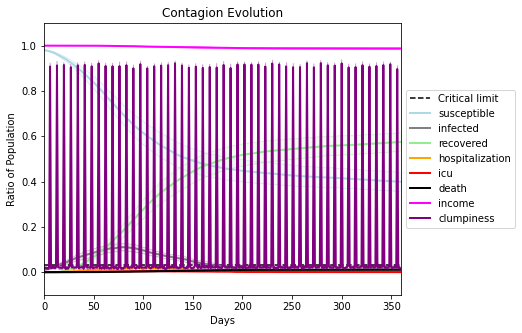

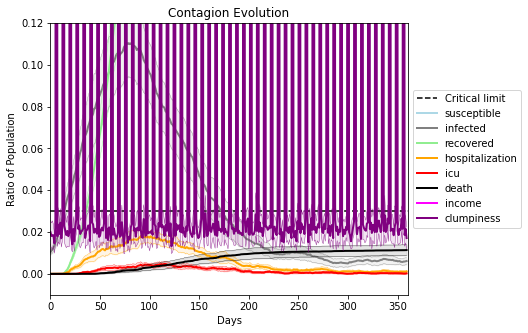

In [33]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[7245, 4754, 9399, 9760, 2104, 422, 3774, 2393, 5204, 8606, 7434, 4823, 9931, 791, 5128, 6953, 8838, 4298, 1204, 8706]
Average similarity between family members is 0.30376875546137894 at temperature -0.6
Average similarity between family and home is 0.9998576975474895 at temperature -1
Average similarity between students and their classroom is 0.14589317709427368 at temperature -0.6
Average classroom occupancy is 4.055555555555555 and number classrooms is 72
Average similarity between workers is 0.16774594202107393 at temperature -0.6
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.37795728487039365 for kids: 0.20915571420326126
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.12910874600783204
avg restaurant similarity 0.06892878424833573
avg restaurant similarity 0.08132839368944178
avg restaurant similarity 0.12221712242929225
avg restaurant similarity 0.16578481294338004
avg restaurant similarity 0.061322186122750824
avg restaurant similarity 0.0849052311417903
avg restaurant similarity 0.0660621436806103
avg restaurant similarity 0.11381098128454256
avg restaurant similarity 0.06507812347582359
avg restaurant similarity 0.09010840793377724
avg restaurant similarity 0.08226920483385897
avg restaurant similarity 0.06808618102491096
avg restaurant similarity 0.11028257882525817
avg restaurant similarity 0.12077109876328743
avg restaurant similarity 0.14716498531202526
avg restaurant similarity 0.07684498433113526
avg restaurant similarity 0.1314459270170047
avg restaurant similarity 0.14941330144069004
avg restaurant similarity 0.13044701793388847
avg restaurant similarity 0.08346048607839104
avg restaurant similarity 0.06046322

avg restaurant similarity 0.06905211260904827
avg restaurant similarity 0.08465459473932137
avg restaurant similarity 0.061926946880175596
avg restaurant similarity 0.11220080220090835
avg restaurant similarity 0.07638730986864116
avg restaurant similarity 0.1041370198233186
avg restaurant similarity 0.06418647477222933
avg restaurant similarity 0.07866201550383624
avg restaurant similarity 0.08628576584367216
avg restaurant similarity 0.0981933123086283
avg restaurant similarity 0.0730006243106086
avg restaurant similarity 0.1595695369406859
avg restaurant similarity 0.13030564442749834
avg restaurant similarity 0.05700671654604863
avg restaurant similarity 0.07071536135075679
avg restaurant similarity 0.0612232266720271
avg restaurant similarity 0.10889670797103593
avg restaurant similarity 0.06666483766645062
avg restaurant similarity 0.1477225217039103
avg restaurant similarity 0.10323064566955716
avg restaurant similarity 0.10985378013252116
avg restaurant similarity 0.10131874690

avg restaurant similarity 0.056668484559450394
avg restaurant similarity 0.10797308447243686
avg restaurant similarity 0.08581794662096048
avg restaurant similarity 0.03462007065787351
avg restaurant similarity 0.11099978744881289
avg restaurant similarity 0.07057411940535108
avg restaurant similarity 0.11079482071500515
avg restaurant similarity 0.10216707531609248
avg restaurant similarity 0.08166935897896303
avg restaurant similarity 0.1003891489982292
avg restaurant similarity 0.08524266316347673
avg restaurant similarity 0.08411046948352362
avg restaurant similarity 0.07089889035109763
avg restaurant similarity 0.12552727965784002
avg restaurant similarity 0.13205809421407344
avg restaurant similarity 0.10402710459775255
avg restaurant similarity 0.06352352634885941
avg restaurant similarity 0.12055468133128822
avg restaurant similarity 0.07254612936494131
avg restaurant similarity 0.07730224986020463
avg restaurant similarity 0.12820332806605556
avg restaurant similarity 0.050364

avg restaurant similarity 0.08428517812763527
avg restaurant similarity 0.10234390391563011
avg restaurant similarity 0.1121940281622812
avg restaurant similarity 0.07604948759271594
avg restaurant similarity 0.04513852720278249
avg restaurant similarity 0.07171366292467231
avg restaurant similarity 0.12882927976027037
avg restaurant similarity 0.058864271817405105
avg restaurant similarity 0.03855668610035664
avg restaurant similarity 0.04415746059639744
avg restaurant similarity 0.07395561258647992
avg restaurant similarity 0.09782275762266196
avg restaurant similarity 0.0778616563257374
avg restaurant similarity 0.0760960301602542
avg restaurant similarity 0.08913808920981843
avg restaurant similarity 0.10511111611624444
avg restaurant similarity 0.08778111850621206
avg restaurant similarity 0.0768306563465026
avg restaurant similarity 0.03320350651671379
avg restaurant similarity 0.05984127114386088
avg restaurant similarity 0.0901286802035623
avg restaurant similarity 0.0762467620

avg restaurant similarity 0.05087664225732856
avg restaurant similarity 0.04427116127774051
avg restaurant similarity 0.05519310419487608
avg restaurant similarity 0.0426792069030512
avg restaurant similarity 0.09182761042126031
avg restaurant similarity 0.07751630233653618
avg restaurant similarity 0.1318725609711819
avg restaurant similarity 0.09921630556066079
avg restaurant similarity 0.061502657559758186
avg restaurant similarity 0.11402944073402622
avg restaurant similarity 0.10160657379510445
avg restaurant similarity 0.06979839670065012
avg restaurant similarity 0.07341995244634643
avg restaurant similarity 0.07676887015671412
avg restaurant similarity 0.10253663834256371
avg restaurant similarity 0.056418541227882396
avg restaurant similarity 0.053960034884413005
avg restaurant similarity 0.10947645275460609
avg restaurant similarity 0.05396695798982089
avg restaurant similarity 0.03277531874974806
avg restaurant similarity 0.054738270328692475
avg restaurant similarity 0.0669

avg restaurant similarity 0.13513052308393675
avg restaurant similarity 0.03965808675716789
avg restaurant similarity 0.06452599557668492
avg restaurant similarity 0.12530238404845367
avg restaurant similarity 0.11023946297561324
avg restaurant similarity 0.046596542329859866
avg restaurant similarity 0.10513507573689343
avg restaurant similarity 0.06061940785350018
avg restaurant similarity 0.027769451817485948
avg restaurant similarity 0.058361749010186835
avg restaurant similarity 0.0294765467543674
avg restaurant similarity 0.07752746162577198
avg restaurant similarity 0.05064731294968412
avg restaurant similarity 0.09792728861367161
avg restaurant similarity 0.054432892048870536
avg restaurant similarity 0.061149269626993775
avg restaurant similarity 0.07778004440850979
avg restaurant similarity 0.07552426197706609
avg restaurant similarity 0.11777930664438348
avg restaurant similarity 0.009012707329601207
avg restaurant similarity 0.060928720187033235
avg restaurant similarity 0.

avg restaurant similarity 0.05033986224634849
avg restaurant similarity 0.08826554313530663
avg restaurant similarity 0.11477115350247
avg restaurant similarity 0.06701032948289544
avg restaurant similarity 0.06849615279368185
avg restaurant similarity 0.09920034728590144
avg restaurant similarity 0.13925296445931598
avg restaurant similarity 0.1046413200534719
avg restaurant similarity 0.060186442075968474
avg restaurant similarity 0.07973876721372476
avg restaurant similarity 0.09445832230457833
avg restaurant similarity 0.16055947168914164
avg restaurant similarity 0.08880048910549802
avg restaurant similarity 0.08910861101268273
avg restaurant similarity 0.11109924338046588
avg restaurant similarity 0.06960098256344607
avg restaurant similarity 0.11499561613729539
avg restaurant similarity 0.09415154667335889
avg restaurant similarity 0.10597732276013627
avg restaurant similarity 0.08427027825901708
avg restaurant similarity 0.06338992255750438
avg restaurant similarity 0.078935892

avg restaurant similarity 0.08080936151172477
avg restaurant similarity 0.14805709063179096
avg restaurant similarity 0.06318190798219002
avg restaurant similarity 0.09358826537802672
avg restaurant similarity 0.07362823073366229
avg restaurant similarity 0.08882490152409066
avg restaurant similarity 0.024295653519978585
avg restaurant similarity 0.0877612145746409
avg restaurant similarity 0.13058855142636305
avg restaurant similarity 0.08033923650030472
avg restaurant similarity 0.12366109009068632
avg restaurant similarity 0.07507425820909923
avg restaurant similarity 0.12763305956221022
avg restaurant similarity 0.07658066292257323
avg restaurant similarity 0.059952322453954716
avg restaurant similarity 0.10206831966766722
avg restaurant similarity 0.07143804683461633
avg restaurant similarity 0.08687081808115163
avg restaurant similarity 0.07495703696376613
avg restaurant similarity 0.09047372493469037
avg restaurant similarity 0.07124410719775628
avg restaurant similarity 0.08088

avg restaurant similarity 0.06827067650094668
avg restaurant similarity 0.10618296567168455
avg restaurant similarity 0.10050021810485577
avg restaurant similarity 0.07966361699721697
avg restaurant similarity 0.05357772620002592
avg restaurant similarity 0.07771420414987577
avg restaurant similarity 0.1089031829559063
avg restaurant similarity 0.07664087420058238
avg restaurant similarity 0.12181521213206489
avg restaurant similarity 0.05550059870962365
avg restaurant similarity 0.08657368558785201
avg restaurant similarity 0.09992654662386198
avg restaurant similarity 0.08033964104187978
avg restaurant similarity 0.11521659587053537
avg restaurant similarity 0.04145842831665199
avg restaurant similarity 0.08259747819190423
avg restaurant similarity 0.038064502216109304
avg restaurant similarity 0.091412601569628
avg restaurant similarity 0.11902669301315603
avg restaurant similarity 0.1530260583839356
avg restaurant similarity 0.061502063513330034
avg restaurant similarity 0.05301177

avg restaurant similarity 0.09688721692981843
avg restaurant similarity 0.12692456939209126
avg restaurant similarity 0.1408926325410534
avg restaurant similarity 0.0829275965994279
avg restaurant similarity 0.061264098739762865
avg restaurant similarity 0.10063771798418877
avg restaurant similarity 0.13583787798347605
avg restaurant similarity 0.08078463746935526
avg restaurant similarity 0.1594085781947524
avg restaurant similarity 0.13793219334645432
avg restaurant similarity 0.1037317049761555
avg restaurant similarity 0.08946368678834986
avg restaurant similarity 0.16686906256457637
avg restaurant similarity 0.10715284038691196
avg restaurant similarity 0.123191709170163
avg restaurant similarity 0.038176310105883425
avg restaurant similarity 0.10360149266136089
avg restaurant similarity 0.15128280366835184
avg restaurant similarity 0.09398320636669225
avg restaurant similarity 0.126689568750895
avg restaurant similarity 0.14851986432781464
avg restaurant similarity 0.122753220981

avg restaurant similarity 0.04329331572377615
avg restaurant similarity 0.07806273878211309
avg restaurant similarity 0.021500911088516223
avg restaurant similarity 0.07816573103218574
avg restaurant similarity 0.027154002302489426
avg restaurant similarity 0.09968085273891772
avg restaurant similarity 0.019108720638641944
avg restaurant similarity 0.0629974129664608
avg restaurant similarity 0.0884889578594275
avg restaurant similarity 0.047411444342035716
avg restaurant similarity 0.01606948462099282
avg restaurant similarity 0.029001363324100752
avg restaurant similarity 0.0924357731742012
avg restaurant similarity 0.06655237377253415
avg restaurant similarity 0.09070816273803836
avg restaurant similarity 0.0906575133383967
avg restaurant similarity 0.10076385613216238
avg restaurant similarity 0.017584775367339885
avg restaurant similarity 0.06831603763470984
avg restaurant similarity 0.11033010373576335
avg restaurant similarity 0.018857991821402666
avg restaurant similarity 0.146

avg restaurant similarity 0.06480936115296446
avg restaurant similarity 0.1067596884359294
avg restaurant similarity 0.11053002649614065
avg restaurant similarity 0.15960033972713966
avg restaurant similarity 0.046294025091482095
avg restaurant similarity 0.09096458381218855
avg restaurant similarity 0.07505982029364142
avg restaurant similarity 0.0743067625517907
avg restaurant similarity 0.0764050372245805
avg restaurant similarity 0.10276843758870521
avg restaurant similarity 0.1424400412112909
avg restaurant similarity 0.06682456107100822
avg restaurant similarity 0.026031792748333768
avg restaurant similarity 0.0918745350267442
avg restaurant similarity 0.08970520502363512
avg restaurant similarity 0.07945878722839142
avg restaurant similarity 0.08453917383610154
avg restaurant similarity 0.1255170907710979
avg restaurant similarity 0.024707909942555735
avg restaurant similarity 0.12293452690200693
avg restaurant similarity 0.04739792794247959
avg restaurant similarity 0.046061595

avg restaurant similarity 0.06221358896172853
avg restaurant similarity 0.047402910123182616
avg restaurant similarity 0.11413151526133723
avg restaurant similarity 0.02873820415352367
avg restaurant similarity 0.18518159006178633
avg restaurant similarity 0.05092314721313703
avg restaurant similarity 0.08631653088992036
avg restaurant similarity 0.06278957442287342
avg restaurant similarity 0.04060856111804921
avg restaurant similarity 0.04606710877835653
avg restaurant similarity 0.0907400402453606
avg restaurant similarity 0.011735706485708975
avg restaurant similarity 0.10950919062316336
avg restaurant similarity 0.14158112820431065
avg restaurant similarity 0.08325511174353091
avg restaurant similarity 0.15036515660248423
avg restaurant similarity 0.11108465385906056
avg restaurant similarity 0.04910621997669041
avg restaurant similarity 0.07707814334303832
avg restaurant similarity 0.06525998769831177
avg restaurant similarity 0.0974529315011258
avg restaurant similarity 0.107547

avg restaurant similarity 0.07780050676824847
avg restaurant similarity 0.10233315431105058
avg restaurant similarity 0.10688896940142335
avg restaurant similarity 0.09630426047585375
avg restaurant similarity 0.09298901592724243
avg restaurant similarity 0.04525960649120158
avg restaurant similarity 0.10509184343129835
avg restaurant similarity 0.07220199398995775
avg restaurant similarity 0.0556820562512565
avg restaurant similarity 0.05646243055686901
avg restaurant similarity 0.061229059284477645
avg restaurant similarity 0.03465286227112276
avg restaurant similarity 0.014349567219257986
avg restaurant similarity 0.07827212972363552
avg restaurant similarity 0.08974879914905488
avg restaurant similarity 0.049786084728389364
avg restaurant similarity 0.0363710430845829
avg restaurant similarity 0.07379920299798963
avg restaurant similarity 0.0859263776983618
avg restaurant similarity 0.03648271440775387
avg restaurant similarity 0.08925202488457583
avg restaurant similarity 0.046608

avg restaurant similarity 0.0641638153012935
avg restaurant similarity 0.030609739992448055
avg restaurant similarity 0.03974486632329194
avg restaurant similarity 0.09589671930659753
avg restaurant similarity 0.026563054473392956
avg restaurant similarity 0.08602761671913846
avg restaurant similarity 0.09705955513741336
avg restaurant similarity 0.06921383051280283
avg restaurant similarity 0.03885396192347813
avg restaurant similarity 0.08310509326356887
avg restaurant similarity 0.026300661001726715
avg restaurant similarity 0.06190422455263608
avg restaurant similarity 0.04111055747790185
avg restaurant similarity 0.06324286974360825
avg restaurant similarity 0.0705418251094787
avg restaurant similarity 0.06599293526214164
avg restaurant similarity 0.053970482583810125
avg restaurant similarity 0.08775497239423838
avg restaurant similarity 0.12276423108478336
avg restaurant similarity 0.007482175704601086
avg restaurant similarity 0.07896760882175763
avg restaurant similarity 0.111

avg restaurant similarity 0.09645258211936548
avg restaurant similarity 0.05405159909127099
avg restaurant similarity 0.09067315894539289
avg restaurant similarity 0.0765933634587915
avg restaurant similarity 0.08757498717549109
avg restaurant similarity 0.06499666365232279
avg restaurant similarity 0.043027637173121414
avg restaurant similarity 0.08079650343078759
avg restaurant similarity 0.08492724443553881
avg restaurant similarity 0.13351660547546784
avg restaurant similarity 0.07740715614516328
avg restaurant similarity 0.06187452883862886
avg restaurant similarity 0.06882769527804758
avg restaurant similarity 0.08358488806487559
avg restaurant similarity 0.07072363530735609
avg restaurant similarity 0.06833233850225984
avg restaurant similarity 0.09033975241239296
avg restaurant similarity 0.09843509519189023
avg restaurant similarity 0.06444036614405906
avg restaurant similarity 0.05635385003247786
avg restaurant similarity 0.05626955969596699
avg restaurant similarity 0.067781

avg restaurant similarity 0.08641523163579212
avg restaurant similarity 0.06583487411270952
avg restaurant similarity 0.05389112680811552
avg restaurant similarity 0.030250477293239816
avg restaurant similarity 0.07310496538636022
avg restaurant similarity 0.002854542925687586
avg restaurant similarity 0.09308226625604174
avg restaurant similarity 0.06367182973382297
avg restaurant similarity 0.10031939922960431
avg restaurant similarity 0.053480861549835466
avg restaurant similarity 0.1158122171429726
avg restaurant similarity 0.11514722988000899
avg restaurant similarity 0.08540858661700647
avg restaurant similarity 0.09491482154950369
avg restaurant similarity 0.08474821724615693
avg restaurant similarity 0.12453366420376692
avg restaurant similarity 0.10556654092568354
avg restaurant similarity 0.06100016581532536
avg restaurant similarity 0.04289626002898878
avg restaurant similarity 0.10256751218265735
avg restaurant similarity 0.015529703429116862
avg restaurant similarity 0.058

avg restaurant similarity 0.03609726568408304
avg restaurant similarity 0.0499163481400453
avg restaurant similarity 0.04905663908029847
avg restaurant similarity 0.09069415314377725
avg restaurant similarity 0.01931846444259737
avg restaurant similarity 0.08413033234208965
avg restaurant similarity 0.08613447550856551
avg restaurant similarity 0.07203580720408309
avg restaurant similarity 0.10345768353821029
avg restaurant similarity 0.09129554885822663
avg restaurant similarity 0.04684643368080581
avg restaurant similarity 0.11302057285492752
avg restaurant similarity 0.042231228021687287
avg restaurant similarity 0.019469208459823525
avg restaurant similarity 0.07596249825597118
avg restaurant similarity 0.02815651194486401
avg restaurant similarity 0.04313325562883521
avg restaurant similarity 0.05141012682869693
avg restaurant similarity 0.10550978808227239
avg restaurant similarity 0.07759691765877383
avg restaurant similarity 0.09581513736797088
avg restaurant similarity 0.11853

avg restaurant similarity 0.07105551238058819
avg restaurant similarity 0.020603823718724226
avg restaurant similarity 0.081161610016473
avg restaurant similarity 0.045093175834287784
avg restaurant similarity 0.06855144720041333
avg restaurant similarity 0.08308175449425019
avg restaurant similarity 0.09116311456490367
avg restaurant similarity 0.027112481268992662
avg restaurant similarity 0.059554914857772485
avg restaurant similarity 0.0758838854346257
avg restaurant similarity 0.09244182104791653
avg restaurant similarity 0.06227813733314259
avg restaurant similarity 0.12055397816850368
avg restaurant similarity 0.04722639668361761
avg restaurant similarity 0.04109736097763833
avg restaurant similarity 0.09658786823723373
avg restaurant similarity 0.08173017140944595
avg restaurant similarity 0.11310619192990831
avg restaurant similarity 0.10582732154574519
avg restaurant similarity 0.060628965350840905
avg restaurant similarity 0.084435227930063
avg restaurant similarity 0.009436

avg restaurant similarity 0.07752688851824706
avg restaurant similarity 0.1260571316463898
avg restaurant similarity 0.046015408566011384
avg restaurant similarity 0.1107021811950709
avg restaurant similarity 0.033390238792319
avg restaurant similarity 0.04334720810474807
avg restaurant similarity 0.013919397557280933
avg restaurant similarity 0.09430243034209235
avg restaurant similarity 0.04881714753158053
avg restaurant similarity 0.11113663626037065
avg restaurant similarity 0.09655332229710947
avg restaurant similarity 0.09731203354660549
avg restaurant similarity 0.033165200087361416
avg restaurant similarity 0.07618211869286459
avg restaurant similarity 0.12455702798480348
avg restaurant similarity 0.11081735579103588
avg restaurant similarity 0.09124455904537321
avg restaurant similarity 0.03467208272135713
avg restaurant similarity 0.07836618099552772
avg restaurant similarity 0.033232206342285825
avg restaurant similarity 0.05308363607570376
avg restaurant similarity 0.065657

avg restaurant similarity 0.0707846611173757
avg restaurant similarity 0.08263605131163909
avg restaurant similarity 0.08960134463686652
avg restaurant similarity 0.0766293910356354
avg restaurant similarity 0.07070155081768685
avg restaurant similarity 0.008533963943286637
avg restaurant similarity 0.12215582395913452
avg restaurant similarity 0.10115220605583616
avg restaurant similarity 0.07854425390712053
avg restaurant similarity 0.053115394803866726
avg restaurant similarity 0.03172127447945814
avg restaurant similarity 0.11075008944000544
avg restaurant similarity 0.08422133049162715
avg restaurant similarity 0.061503459349332226
avg restaurant similarity 0.01671049786759542
avg restaurant similarity 0.08056706927917907
avg restaurant similarity 0.0711812670928093
avg restaurant similarity 0.036534948561801214
avg restaurant similarity 0.1268006200665299
avg restaurant similarity 0.06881053170483438
avg restaurant similarity 0.13108453402923462
avg restaurant similarity 0.069966

avg restaurant similarity 0.08387437000345074
avg restaurant similarity 0.07483064583761961
avg restaurant similarity 0.08784780701165502
avg restaurant similarity 0.05323724854806033
avg restaurant similarity 0.07331794612001213
avg restaurant similarity 0.045327713825498814
avg restaurant similarity 0.0565369089425755
avg restaurant similarity 0.0404490052312787
avg restaurant similarity 0.12294140355416498
avg restaurant similarity 0.09410493911917706
avg restaurant similarity 0.06903852460167757
avg restaurant similarity 0.11006210794305729
avg restaurant similarity 0.08381432693806343
avg restaurant similarity 0.06807178303217966
avg restaurant similarity 0.10993998296444657
avg restaurant similarity 0.0027608402220067464
avg restaurant similarity 0.06458213080462223
avg restaurant similarity 0.04360911022328642
avg restaurant similarity 0.07862665391961375
avg restaurant similarity 0.11468555119302179
avg restaurant similarity 0.07049045566633406
avg restaurant similarity 0.04588

avg restaurant similarity 0.10629530344731326
avg restaurant similarity 0.06080883384275695
avg restaurant similarity 0.02098106494494883
avg restaurant similarity 0.10029597635748144
avg restaurant similarity 0.05055162589975646
avg restaurant similarity 0.05038673490380508
avg restaurant similarity 0.13295983506571704
avg restaurant similarity 0.05310987011859132
avg restaurant similarity 0.044402087166054885
avg restaurant similarity 0.08007551914144324
avg restaurant similarity 0.10297032810521951
avg restaurant similarity 0.0788652246480916
avg restaurant similarity 0.06841337133168693
avg restaurant similarity 0.10280269579304663
avg restaurant similarity 0.127267426518783
avg restaurant similarity 0.15039512468784594
avg restaurant similarity 0.14769817675607888
avg restaurant similarity 0.08833337262535945
avg restaurant similarity 0.06432996411540053
avg restaurant similarity 0.06038956019925978
avg restaurant similarity 0.07811153381654988
avg restaurant similarity 0.05299230

avg restaurant similarity 0.07045751127713752
avg restaurant similarity 0.10037365555842265
avg restaurant similarity 0.0874654411526621
avg restaurant similarity 0.03663409546098624
avg restaurant similarity 0.10525465995053575
avg restaurant similarity 0.08144682933611286
avg restaurant similarity 0.06716057358312764
avg restaurant similarity 0.029707918815446946
avg restaurant similarity 0.09711606565597394
avg restaurant similarity 0.03623293025866658
avg restaurant similarity 0.049354752070323825
avg restaurant similarity 0.0973316157569669
avg restaurant similarity 0.09644071694201635
avg restaurant similarity 0.10447292374840068
avg restaurant similarity 0.10759814724030217
avg restaurant similarity 0.06812178915375026
avg restaurant similarity 0.04762879283786251
avg restaurant similarity 0.12216000008347279
avg restaurant similarity 0.053206162123862276
avg restaurant similarity 0.07245445848608688
avg restaurant similarity 0.07017814875634709
avg restaurant similarity 0.11600

avg restaurant similarity 0.03392497416297518
avg restaurant similarity 0.09334833275012962
avg restaurant similarity 0.09730148000207514
avg restaurant similarity 0.06751501479741566
avg restaurant similarity 0.10318599788534187
avg restaurant similarity 0.034996191746718086
avg restaurant similarity 0.016283335918227438
avg restaurant similarity 0.09982154969535904
avg restaurant similarity 0.08436146506846032
avg restaurant similarity 0.10379804558268944
avg restaurant similarity 0.09035266007757368
avg restaurant similarity 0.07205749603556028
avg restaurant similarity 0.08740572612563507
avg restaurant similarity 0.06749216934951953
avg restaurant similarity 0.08652235284230944
avg restaurant similarity 0.052665275025140304
avg restaurant similarity 0.06699569259486693
avg restaurant similarity 0.01099290601135995
avg restaurant similarity 0.08662505440084475
avg restaurant similarity 0.11073617147544436
avg restaurant similarity 0.09599766541174404
avg restaurant similarity 0.095

avg restaurant similarity 0.09282889820101528
avg restaurant similarity 0.025269671105413827
avg restaurant similarity 0.04554465653850739
avg restaurant similarity 0.1021949029764356
avg restaurant similarity 0.1312889401702382
avg restaurant similarity 0.04264699438408874
avg restaurant similarity 0.04076757692898234
avg restaurant similarity 0.06007039958492418
avg restaurant similarity 0.03178379840034961
avg restaurant similarity 0.008474146844927546
avg restaurant similarity 0.07714893730714667
avg restaurant similarity 0.10601387205713465
avg restaurant similarity 0.09445027176177398
avg restaurant similarity 0.039850894311285634
avg restaurant similarity 0.10752758110861747
avg restaurant similarity 0.044953280434281775
avg restaurant similarity 0.09494697367753781
avg restaurant similarity 0.0173238712464717
avg restaurant similarity 0.07848995565051754
avg restaurant similarity 0.0916249486430697
avg restaurant similarity 0.06398797485690653
avg restaurant similarity 0.106461

avg restaurant similarity 0.09651844036744288
avg restaurant similarity 0.06482224585525158
avg restaurant similarity 0.04287641904933888
avg restaurant similarity 0.06733299770606718
avg restaurant similarity 0.06705787783926304
avg restaurant similarity 0.04668460695225416
avg restaurant similarity 0.08771576504352581
avg restaurant similarity 0.09594741335824482
avg restaurant similarity 0.07608404003843648
avg restaurant similarity 0.03265343517723979
avg restaurant similarity 0.11223045626540912
avg restaurant similarity 0.04420848231851758
avg restaurant similarity 0.052402613610077545
avg restaurant similarity 0.047956355660650325
avg restaurant similarity 0.07325152882130248
avg restaurant similarity 0.06783289856251333
avg restaurant similarity 0.10671608053030576
avg restaurant similarity 0.048931860269205374
avg restaurant similarity 0.11580229438195702
avg restaurant similarity 0.08502783429868886
avg restaurant similarity 0.09018889692234817
avg restaurant similarity 0.076

avg restaurant similarity 0.115343402156969
avg restaurant similarity 0.0886518816473408
avg restaurant similarity 0.017065453386717215
avg restaurant similarity 0.0833549325314419
avg restaurant similarity 0.030175137139267803
avg restaurant similarity 0.056404999152890344
avg restaurant similarity 0.08643863845967312
avg restaurant similarity 0.11507736807368649
avg restaurant similarity 0.08676463582494605
avg restaurant similarity 0.07277336876329736
avg restaurant similarity 0.09220364848407155
avg restaurant similarity 0.09967917123186976
avg restaurant similarity 0.09605390808396322
avg restaurant similarity 0.11631615697505877
avg restaurant similarity 0.12657556286586927
avg restaurant similarity 0.05679206594563202
avg restaurant similarity 0.058289754530722875
avg restaurant similarity 0.060083678740604794
avg restaurant similarity 0.03673885908061952
avg restaurant similarity 0.04165653253182005
avg restaurant similarity 0.05201585684099474
avg restaurant similarity 0.05727

avg restaurant similarity 0.10113101406577991
avg restaurant similarity 0.06722144023650566
avg restaurant similarity 0.020369772383940783
avg restaurant similarity 0.0893613412414642
avg restaurant similarity 0.15266782164196677
avg restaurant similarity 0.10368297641320386
avg restaurant similarity 0.10245692311171871
avg restaurant similarity 0.08314397239073894
avg restaurant similarity 0.1275585874398289
avg restaurant similarity 0.10536802355445003
avg restaurant similarity 0.10384289461560388
avg restaurant similarity 0.1202160291552005
avg restaurant similarity 0.09765844653226062
avg restaurant similarity 0.05424158056249909
avg restaurant similarity 0.11246758692229193
avg restaurant similarity 0.12351590857081349
avg restaurant similarity 0.09373825405847153
avg restaurant similarity 0.11997146000514163
avg restaurant similarity 0.11759782209340065
avg restaurant similarity 0.08331396824303776
avg restaurant similarity 0.15045872043509573
avg restaurant similarity 0.15329879

avg restaurant similarity 0.06608908283992504
avg restaurant similarity 0.10781552153506431
avg restaurant similarity 0.1082890103179679
avg restaurant similarity 0.09460099872578327
avg restaurant similarity 0.09137260391468112
avg restaurant similarity 0.09855051409934662
avg restaurant similarity 0.12163237980851856
avg restaurant similarity 0.09963535598164278
avg restaurant similarity 0.14229861519879075
avg restaurant similarity 0.14564457770580327
avg restaurant similarity 0.11088177161561234
avg restaurant similarity 0.10462025842433018
avg restaurant similarity 0.07710029758074055
avg restaurant similarity 0.06938949220587806
avg restaurant similarity 0.1007141364026536
avg restaurant similarity 0.0733816122383388
avg restaurant similarity 0.04301156300032507
avg restaurant similarity 0.11578463528481611
avg restaurant similarity 0.1325223746907484
avg restaurant similarity 0.1043677016040311
avg restaurant similarity 0.06254483930267793
avg restaurant similarity 0.11262989084

avg restaurant similarity 0.05030864089526429
avg restaurant similarity 0.054032434032248444
avg restaurant similarity -0.0009985345646612005
avg restaurant similarity 0.05942255809989548
avg restaurant similarity 0.05849168651557111
avg restaurant similarity 0.12331269588016619
avg restaurant similarity 0.03778083351240444
avg restaurant similarity 0.06620054012942038
avg restaurant similarity 0.048993742240453664
avg restaurant similarity 0.07008733631947653
avg restaurant similarity 0.10838988301970803
avg restaurant similarity 0.07788985069094222
avg restaurant similarity 0.033959941834478605
avg restaurant similarity 0.08430896561641679
avg restaurant similarity 0.09780616253924619
avg restaurant similarity 0.07198789061502708
avg restaurant similarity 0.0903211650662564
avg restaurant similarity 0.0728294114449927
avg restaurant similarity 0.031030198145851794
avg restaurant similarity 0.05654846661398836
avg restaurant similarity 0.09965891407897379
avg restaurant similarity 0.0

avg restaurant similarity 0.06644888080415538
avg restaurant similarity 0.10722775021036747
avg restaurant similarity 0.0339476629608775
avg restaurant similarity 0.054614833249876524
avg restaurant similarity 0.03645320877358756
avg restaurant similarity 0.0556453132770414
avg restaurant similarity 0.0967163266806571
avg restaurant similarity 0.043606461925716405
avg restaurant similarity 0.06484220122081197
avg restaurant similarity 0.02546705285523167
avg restaurant similarity 0.013389459742674881
avg restaurant similarity 0.07731011122447842
avg restaurant similarity 0.0824440065356964
avg restaurant similarity 0.1041602755290651
avg restaurant similarity 0.0343186646835138
avg restaurant similarity 0.117969148403975
avg restaurant similarity 0.11495339833771666
avg restaurant similarity 0.06880055860471472
avg restaurant similarity 0.061853587921277896
avg restaurant similarity 0.11181207886179861
avg restaurant similarity 0.1018983926488739
avg restaurant similarity 0.06137967007

avg restaurant similarity 0.0642595783242135
avg restaurant similarity 0.09796873677013242
avg restaurant similarity 0.11545040264168333
avg restaurant similarity 0.09059941042588456
avg restaurant similarity 0.10169182309448388
avg restaurant similarity 0.06795674432614299
avg restaurant similarity 0.11387867112293212
avg restaurant similarity 0.10849644397397507
avg restaurant similarity 0.10294978569238615
avg restaurant similarity 0.13997660432374998
avg restaurant similarity 0.12765303123202798
avg restaurant similarity 0.09573354029782126
avg restaurant similarity 0.054130995281822504
avg restaurant similarity 0.03018276951400823
avg restaurant similarity 0.1158976807820752
avg restaurant similarity 0.07278317613018068
avg restaurant similarity 0.09766178394641252
avg restaurant similarity 0.08605553596300336
avg restaurant similarity 0.03902297542215917
avg restaurant similarity 0.109926589954966
avg restaurant similarity 0.11284917575886412
avg restaurant similarity 0.079640400

avg restaurant similarity 0.08919577343640846
avg restaurant similarity 0.067957089609298
avg restaurant similarity 0.09593943156188511
avg restaurant similarity 0.1323902825755599
avg restaurant similarity 0.07773096490048369
avg restaurant similarity 0.12963247105211642
avg restaurant similarity 0.0928752893693938
avg restaurant similarity 0.10832886033681151
avg restaurant similarity 0.1025523743133686
avg restaurant similarity 0.1340917825513878
avg restaurant similarity 0.07808949644344856
avg restaurant similarity 0.13496671815505337
avg restaurant similarity 0.13181301545941743
avg restaurant similarity 0.13240592407188065
avg restaurant similarity 0.04172823306114485
avg restaurant similarity 0.08072279331466906
avg restaurant similarity 0.08936149532064588
avg restaurant similarity 0.0858509089866644
avg restaurant similarity 0.09085806872063473
avg restaurant similarity 0.08523205919494525
avg restaurant similarity 0.1589247614627126
avg restaurant similarity 0.11708880384923

avg restaurant similarity 0.059219731332025814
avg restaurant similarity 0.036658922803458255
avg restaurant similarity 0.06108992018567333
avg restaurant similarity 0.03401378678620197
avg restaurant similarity 0.08789474435201644
avg restaurant similarity 0.03305209105201411
avg restaurant similarity 0.02031530745740419
avg restaurant similarity 0.0651813854982333
avg restaurant similarity 0.036244299759376625
avg restaurant similarity 0.07540156956231368
avg restaurant similarity 0.08123556045332676
avg restaurant similarity 0.08038004959623696
avg restaurant similarity 0.04367979605515901
avg restaurant similarity 0.05542140760018523
avg restaurant similarity 0.026273111311464693
avg restaurant similarity 0.08594813282256397
avg restaurant similarity 0.08104418533091594
avg restaurant similarity 0.03273480849197706
avg restaurant similarity 0.07999189670656796
avg restaurant similarity 0.043654323386463426
avg restaurant similarity 0.06429933477629525
avg restaurant similarity 0.06

avg restaurant similarity 0.014920021450469893
avg restaurant similarity 0.10740176540145743
avg restaurant similarity 0.08043266900707147
avg restaurant similarity 0.04818957677157579
avg restaurant similarity 0.06945465120981087
avg restaurant similarity 0.032307867472525946
avg restaurant similarity 0.03967751808966247
avg restaurant similarity 0.04197060260273079
avg restaurant similarity 0.026328370632716192
avg restaurant similarity 0.04895230317164468
avg restaurant similarity 0.10612939215053789
avg restaurant similarity 0.08976425499509968
avg restaurant similarity 0.08229495076546779
avg restaurant similarity 0.06753898644152907
avg restaurant similarity 0.0824770550029971
avg restaurant similarity 0.0855310568487525
avg restaurant similarity 0.0813679638357875
avg restaurant similarity 0.07183072542442091
avg restaurant similarity 0.004267039016301025
avg restaurant similarity 0.04612743339350029
avg restaurant similarity 0.003957171134237835
avg restaurant similarity -0.010

avg restaurant similarity 0.04985623485606245
avg restaurant similarity 0.06948508997043647
avg restaurant similarity 0.023285669022764747
avg restaurant similarity 0.05950246432838815
avg restaurant similarity 0.07330062345355094
avg restaurant similarity 0.09081003280868412
avg restaurant similarity 0.04834705650249914
avg restaurant similarity -0.014725782483054822
avg restaurant similarity 0.1320689040156734
avg restaurant similarity 0.08540232861900261
avg restaurant similarity 0.05674132901477548
avg restaurant similarity 0.09233937014804611
avg restaurant similarity 0.03450770392339263
avg restaurant similarity 0.08523810593385989
avg restaurant similarity 0.06831873594525435
avg restaurant similarity 0.10666699061415326
avg restaurant similarity 0.07885239857694229
avg restaurant similarity 0.06454109804224734
avg restaurant similarity 0.08796557446516273
avg restaurant similarity 0.07492133528968206
avg restaurant similarity 0.04647709893920234
avg restaurant similarity 0.0878

avg restaurant similarity 0.037400361964845946
avg restaurant similarity 0.035322169113251305
avg restaurant similarity 0.08663109833030479
avg restaurant similarity 0.07267321494133618
avg restaurant similarity 0.0434728567403867
avg restaurant similarity 0.05459924248290653
avg restaurant similarity 0.07313093833809481
avg restaurant similarity 0.12373975377686246
avg restaurant similarity 0.07745670005943213
avg restaurant similarity 0.05411232435338465
avg restaurant similarity 0.09817230534048574
avg restaurant similarity 0.04374439481958016
avg restaurant similarity 0.08547348675018132
avg restaurant similarity 0.059231737068628554
avg restaurant similarity 0.06992346111275813
avg restaurant similarity 0.033443808896940375
avg restaurant similarity 0.0840357038399504
avg restaurant similarity 0.04939124989367825
avg restaurant similarity 0.06840926408649894
avg restaurant similarity 0.06346001842712075
avg restaurant similarity 0.01644938395564123
avg restaurant similarity 0.0866

avg restaurant similarity 0.11860760483646568
avg restaurant similarity 0.08679577496644131
avg restaurant similarity 0.06958333501140045
avg restaurant similarity 0.021991873891124704
avg restaurant similarity 0.02127896517771106
avg restaurant similarity 0.1376426659366989
avg restaurant similarity 0.004977566668306162
avg restaurant similarity 0.021183523738623596
avg restaurant similarity 0.026844891192858534
avg restaurant similarity 0.02052974538876099
avg restaurant similarity 0.05426000540054742
avg restaurant similarity 0.03779401912790165
avg restaurant similarity 0.07561306413129457
avg restaurant similarity -0.022454131819915263
avg restaurant similarity 0.07595178361171313
avg restaurant similarity 0.08825248872618328
avg restaurant similarity 0.08277707844137583
avg restaurant similarity 0.06499203237835292
avg restaurant similarity 0.07443109611868316
avg restaurant similarity 0.1062254080778497
avg restaurant similarity 0.1089242016344075
avg restaurant similarity 0.064

avg restaurant similarity 0.04186352409737495
avg restaurant similarity 0.05074737071246014
avg restaurant similarity 0.08462016153696689
avg restaurant similarity 0.055675544269771164
avg restaurant similarity 0.037083329943036994
avg restaurant similarity 0.0700327193189409
avg restaurant similarity 0.09260979132689368
avg restaurant similarity 0.0436645977657816
avg restaurant similarity 0.050837859180430045
avg restaurant similarity 0.08368225350824292
avg restaurant similarity 0.06126808777944607
avg restaurant similarity -0.011325276153950162
avg restaurant similarity 0.08957635486553765
avg restaurant similarity 0.1359790842320084
avg restaurant similarity 0.11170402436611189
avg restaurant similarity 0.11839882984613491
avg restaurant similarity 0.035159830459072804
avg restaurant similarity 0.08175585303319438
avg restaurant similarity -0.0037640519019276836
avg restaurant similarity 0.06562426722132739
avg restaurant similarity 0.07474400648007226
avg restaurant similarity -0

(<function dict.items>, <function dict.items>, <function dict.items>)

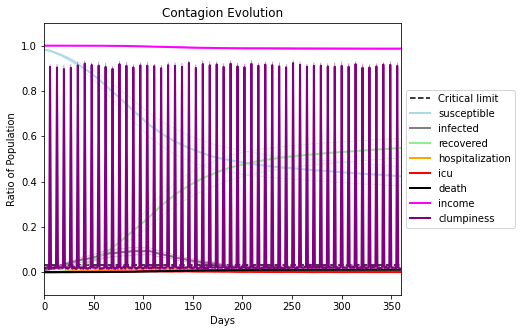

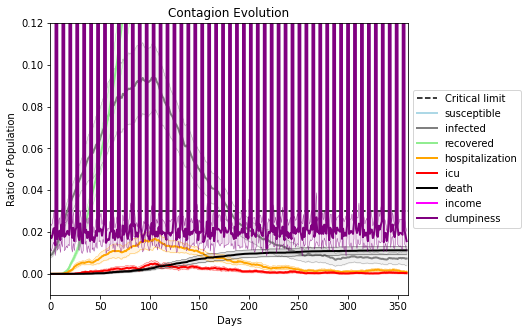

In [35]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8598, 7651, 4878, 8726, 4943, 71, 3502, 2832, 6025, 6136, 1117, 6432, 4717, 91, 8112, 2558, 4349, 9061, 4195, 4155]
Average similarity between family members is 0.2516795646324921 at temperature -0.5
Average similarity between family and home is 0.9998399396753778 at temperature -1
Average similarity between students and their classroom is 0.16325225892731476 at temperature -0.5
Average classroom occupancy is 4.2 and number classrooms is 70
Average similarity between workers is 0.151306835488125 at temperature -0.5
Average office occupancy is 3.232673267326733 and number offices is 202
Average friend similarity for adults: 0.31517286838095837 for kids: 0.1998803073358052
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 

avg restaurant similarity 0.06072996768153625
avg restaurant similarity 0.04068844016616873
avg restaurant similarity 0.022206815636696457
avg restaurant similarity 0.10090277087455908
avg restaurant similarity 0.057780907793347575
avg restaurant similarity 0.07474347245827609
avg restaurant similarity 0.1546629997041939
avg restaurant similarity 0.07446361399383196
avg restaurant similarity 0.12300845744321988
avg restaurant similarity 0.08876998766834485
avg restaurant similarity 0.058228423024031806
avg restaurant similarity 0.07347531193724413
avg restaurant similarity 0.07126171751555681
avg restaurant similarity 0.10944691027461341
avg restaurant similarity 0.09935224874097712
avg restaurant similarity 0.12406902599118702
avg restaurant similarity 0.06035168693601343
avg restaurant similarity 0.04598597037970983
avg restaurant similarity 0.13246627929792185
avg restaurant similarity 0.094976768330725
avg restaurant similarity 0.07487298825927834
avg restaurant similarity 0.094276

avg restaurant similarity 0.1436709033245042
avg restaurant similarity 0.054696465771313714
avg restaurant similarity 0.09040827530222968
avg restaurant similarity 0.05281441826075001
avg restaurant similarity 0.07328377526723069
avg restaurant similarity 0.08069414063681497
avg restaurant similarity 0.0871926378594112
avg restaurant similarity 0.05814755320384888
avg restaurant similarity 0.11984496214281491
avg restaurant similarity 0.10495555110613856
avg restaurant similarity 0.07412385967396774
avg restaurant similarity 0.05095600452843872
avg restaurant similarity 0.0721732596852709
avg restaurant similarity 0.06451801501542603
avg restaurant similarity 0.030554489517067792
avg restaurant similarity 0.07605596244805907
avg restaurant similarity 0.08975141517137972
avg restaurant similarity 0.0810955263132987
avg restaurant similarity 0.08390116189535667
avg restaurant similarity 0.07033990169660889
avg restaurant similarity 0.10415373084855464
avg restaurant similarity 0.09466811

avg restaurant similarity 0.08913116194250228
avg restaurant similarity 0.06552459048599334
avg restaurant similarity 0.09552630786060522
avg restaurant similarity 0.10199337717677319
avg restaurant similarity 0.08749686751026459
avg restaurant similarity 0.0971614193830593
avg restaurant similarity 0.06184678993691002
avg restaurant similarity 0.09093047187127064
avg restaurant similarity 0.06620325019046634
avg restaurant similarity 0.14257970589700394
avg restaurant similarity 0.09047530189880575
avg restaurant similarity 0.03235240739783686
avg restaurant similarity 0.12272110687010074
avg restaurant similarity 0.11592360831435264
avg restaurant similarity 0.10255248096994715
avg restaurant similarity 0.04292288428916204
avg restaurant similarity 0.06805766301858801
avg restaurant similarity 0.08981561774720702
avg restaurant similarity 0.06998869603194724
avg restaurant similarity 0.052544168948056046
avg restaurant similarity 0.07428363127831261
avg restaurant similarity 0.097818

avg restaurant similarity 0.09032534754531613
avg restaurant similarity 0.04531432700930326
avg restaurant similarity 0.052097706103638224
avg restaurant similarity 0.06991796984318906
avg restaurant similarity 0.063909797219413
avg restaurant similarity 0.112412015133345
avg restaurant similarity 0.04272695060622342
avg restaurant similarity 0.057889871417104596
avg restaurant similarity 0.07439509544537996
avg restaurant similarity 0.048822808796272765
avg restaurant similarity 0.1057311438595833
avg restaurant similarity 0.09959258605001907
avg restaurant similarity 0.08367319634252485
avg restaurant similarity 0.09111179983274738
avg restaurant similarity 0.037728581691606554
avg restaurant similarity 0.1097085640244573
avg restaurant similarity 0.07257658103409322
avg restaurant similarity 0.03660014976377869
avg restaurant similarity 0.06740380175109313
avg restaurant similarity 0.021048327127317374
avg restaurant similarity 0.03872202090430872
avg restaurant similarity 0.1118722

avg restaurant similarity 0.11097801269351243
avg restaurant similarity 0.092085202326826
avg restaurant similarity 0.0849673349272287
avg restaurant similarity 0.09631673635805557
avg restaurant similarity 0.11677000548796418
avg restaurant similarity 0.08986532388842698
avg restaurant similarity 0.061738983896827256
avg restaurant similarity 0.10705852182719233
avg restaurant similarity 0.07644997482427841
avg restaurant similarity 0.08359527792981745
avg restaurant similarity 0.05363213729456522
avg restaurant similarity 0.12807899458156463
avg restaurant similarity 0.09928427352941914
avg restaurant similarity 0.04453835567176716
avg restaurant similarity 0.09048348130609198
avg restaurant similarity 0.05242053789907214
avg restaurant similarity 0.08389596537029284
avg restaurant similarity 0.06222894724665692
avg restaurant similarity 0.13009155274839804
avg restaurant similarity 0.12072873238871504
avg restaurant similarity 0.1509829360048633
avg restaurant similarity 0.115024443

avg restaurant similarity 0.12412275079909744
avg restaurant similarity 0.09024866364385033
avg restaurant similarity 0.08971773742665101
avg restaurant similarity 0.06935271109922653
avg restaurant similarity 0.09821190008272547
avg restaurant similarity 0.12273739924990217
avg restaurant similarity 0.12231920018255137
avg restaurant similarity 0.0645198561622838
avg restaurant similarity 0.06698269891322754
avg restaurant similarity 0.07479705399535916
avg restaurant similarity 0.10766048840789207
avg restaurant similarity 0.12745230077031883
avg restaurant similarity 0.059747475824373036
avg restaurant similarity 0.10209629347169895
avg restaurant similarity 0.09694677455046101
avg restaurant similarity 0.12561465957934762
avg restaurant similarity 0.1042859618464263
avg restaurant similarity 0.09388582364831927
avg restaurant similarity 0.0792583894232537
avg restaurant similarity 0.08537768678321667
avg restaurant similarity 0.11855536256528977
avg restaurant similarity 0.11403165

avg restaurant similarity 0.07062751369510746
avg restaurant similarity 0.1597361946786249
avg restaurant similarity 0.05153006735544542
avg restaurant similarity 0.049963528233250586
avg restaurant similarity 0.08634380678985638
avg restaurant similarity 0.06819361762031492
avg restaurant similarity 0.09971062560991996
avg restaurant similarity 0.10725015218277698
avg restaurant similarity 0.0862863023861297
avg restaurant similarity 0.08425578768623995
avg restaurant similarity 0.08706362825080045
avg restaurant similarity 0.03467540815926845
avg restaurant similarity 0.12990953377974002
avg restaurant similarity 0.0735850257825173
avg restaurant similarity 0.12807429815768664
avg restaurant similarity 0.07899826179963382
avg restaurant similarity 0.06506107070921319
avg restaurant similarity 0.09372143419957522
avg restaurant similarity 0.09498139164615822
avg restaurant similarity 0.18033212021850872
avg restaurant similarity 0.11872389125951444
avg restaurant similarity 0.13143896

avg restaurant similarity 0.06933646136056303
avg restaurant similarity 0.079414546188501
avg restaurant similarity 0.08323779010163632
avg restaurant similarity 0.09091067040705447
avg restaurant similarity 0.0891042863761265
avg restaurant similarity 0.10740703077591787
avg restaurant similarity 0.0895867944264901
avg restaurant similarity 0.11076850489594374
avg restaurant similarity 0.1048719699440723
avg restaurant similarity 0.07923206565498274
avg restaurant similarity 0.06513352261863983
avg restaurant similarity 0.08909724141144681
avg restaurant similarity 0.1369366591110329
avg restaurant similarity 0.14847712382133388
avg restaurant similarity 0.09742357653713181
avg restaurant similarity 0.10906124458193796
avg restaurant similarity 0.07892872744610704
avg restaurant similarity 0.11684062745677785
avg restaurant similarity 0.11488289946570518
avg restaurant similarity 0.1212718551922696
avg restaurant similarity 0.10957101899626233
avg restaurant similarity 0.1139673046612

avg restaurant similarity 0.08489537377265048
avg restaurant similarity 0.08202510253308035
avg restaurant similarity 0.10456273207738594
avg restaurant similarity 0.06256250902068353
avg restaurant similarity 0.07477737298258906
avg restaurant similarity 0.0476776187080612
avg restaurant similarity 0.09983949996836114
avg restaurant similarity 0.09819276897771102
avg restaurant similarity 0.05210173466960437
avg restaurant similarity 0.07684185959658103
avg restaurant similarity 0.021514039291083368
avg restaurant similarity 0.1095063863842199
avg restaurant similarity 0.07967982574166096
avg restaurant similarity 0.037393658123545975
avg restaurant similarity 0.11933966046108953
avg restaurant similarity 0.04054277963920249
avg restaurant similarity -0.001773457819660708
avg restaurant similarity 0.07379614181503444
avg restaurant similarity 0.052069527561598675
avg restaurant similarity 0.10615541207665288
avg restaurant similarity 0.13275728147896396
avg restaurant similarity 0.028

avg restaurant similarity 0.10514911464116002
avg restaurant similarity 0.08907026578590511
avg restaurant similarity 0.09912438533488231
avg restaurant similarity 0.0578815307158725
avg restaurant similarity 0.09328369041706944
avg restaurant similarity 0.08177069817645037
avg restaurant similarity 0.0586160303087782
avg restaurant similarity 0.13123135002262412
avg restaurant similarity 0.12067679672122719
avg restaurant similarity 0.13380557018767575
avg restaurant similarity 0.12045977296276167
avg restaurant similarity 0.12819181961632586
avg restaurant similarity 0.08868017077888915
avg restaurant similarity 0.045724068490080656
avg restaurant similarity 0.08752667393290334
avg restaurant similarity 0.14026938948717121
avg restaurant similarity 0.11357295586584323
avg restaurant similarity 0.09941249506856581
avg restaurant similarity 0.10243487204383032
avg restaurant similarity 0.04922328828568029
avg restaurant similarity 0.05576152742297633
avg restaurant similarity 0.0775466

avg restaurant similarity 0.09152649019478125
avg restaurant similarity 0.10742189628710502
avg restaurant similarity 0.05875873147772464
avg restaurant similarity 0.0908766665867208
avg restaurant similarity 0.02026182915138336
avg restaurant similarity 0.03859950853617326
avg restaurant similarity 0.12274662979660711
avg restaurant similarity 0.09917674281830113
avg restaurant similarity 0.08519210355370567
avg restaurant similarity 0.05792814775455788
avg restaurant similarity 0.10931166835878924
avg restaurant similarity 0.043884081625383285
avg restaurant similarity 0.029778931053506277
avg restaurant similarity 0.10466703251188664
avg restaurant similarity 0.1140169030655817
avg restaurant similarity 0.04090820759198111
avg restaurant similarity 0.05967179380163763
avg restaurant similarity 0.09800692015039457
avg restaurant similarity 0.09546571282026445
avg restaurant similarity 0.038236442327863544
avg restaurant similarity 0.10614699870277806
avg restaurant similarity 0.05003

avg restaurant similarity 0.054048995602388565
avg restaurant similarity 0.07165851282533629
avg restaurant similarity 0.10301328009135197
avg restaurant similarity 0.06820340453212899
avg restaurant similarity 0.08705047924505448
avg restaurant similarity 0.07780402662492208
avg restaurant similarity 0.06488354015100056
avg restaurant similarity 0.09407065310751034
avg restaurant similarity 0.08310904250206687
avg restaurant similarity 0.04776862904457612
avg restaurant similarity 0.06442593543049802
avg restaurant similarity 0.08713467907177419
avg restaurant similarity 0.056598047466314166
avg restaurant similarity 0.011996621431628414
avg restaurant similarity 0.0745273408997636
avg restaurant similarity 0.07057901842811012
avg restaurant similarity 0.11147620269823325
avg restaurant similarity 0.05989898635823069
avg restaurant similarity 0.05948871664554164
avg restaurant similarity 0.1042430817536723
avg restaurant similarity 0.09295328443062154
avg restaurant similarity 0.13330

avg restaurant similarity 0.12438442620967165
avg restaurant similarity 0.11347582556740583
avg restaurant similarity 0.04781067904463531
avg restaurant similarity 0.04907452465594536
avg restaurant similarity 0.11057269018043787
avg restaurant similarity 0.015238078217259437
avg restaurant similarity 0.03378697413221463
avg restaurant similarity 0.1272948777114442
avg restaurant similarity 0.07755091254436759
avg restaurant similarity 0.13252564600303565
avg restaurant similarity 0.05001667499692302
avg restaurant similarity 0.10885012907010995
avg restaurant similarity 0.05626564493381961
avg restaurant similarity 0.0981450244764269
avg restaurant similarity 0.0893243898665671
avg restaurant similarity 0.11038525536265173
avg restaurant similarity 0.11366518488093254
avg restaurant similarity 0.07241564126086944
avg restaurant similarity 0.0733769629011553
avg restaurant similarity 0.07958464401523795
avg restaurant similarity 0.09253702995118453
avg restaurant similarity 0.040506971

avg restaurant similarity 0.07992609626178634
avg restaurant similarity 0.09009785073206467
avg restaurant similarity 0.09695219520837346
avg restaurant similarity 0.12800318414964154
avg restaurant similarity 0.03044737473964013
avg restaurant similarity 0.08665000866867562
avg restaurant similarity 0.07097269331255526
avg restaurant similarity 0.1543216831906499
avg restaurant similarity 0.11828007037353036
avg restaurant similarity 0.09274143581045671
avg restaurant similarity 0.05061234260068696
avg restaurant similarity 0.029597926969079782
avg restaurant similarity 0.09733350526509854
avg restaurant similarity 0.07987987668311886
avg restaurant similarity 0.038913189728391334
avg restaurant similarity 0.10976372917755602
avg restaurant similarity 0.01857958430521608
avg restaurant similarity 0.04562243015763097
avg restaurant similarity 0.11274812054479859
avg restaurant similarity 0.08632736197414206
avg restaurant similarity 0.11319459891032813
avg restaurant similarity 0.06882

avg restaurant similarity 0.03330907529455567
avg restaurant similarity 0.0117772196990607
avg restaurant similarity 0.01941485441356598
avg restaurant similarity 0.029758100432987985
avg restaurant similarity 0.06580259351438347
avg restaurant similarity 0.056120516657197965
avg restaurant similarity 0.1007186585659836
avg restaurant similarity 0.053463112832171526
avg restaurant similarity 0.02671362066419352
avg restaurant similarity 0.050366404255437126
avg restaurant similarity 0.0588163187739542
avg restaurant similarity 0.10080428903267971
avg restaurant similarity 0.045100483810638775
avg restaurant similarity 0.034521084986209837
avg restaurant similarity 0.10676359195373546
avg restaurant similarity 0.05943210322571723
avg restaurant similarity 0.07019690238862468
avg restaurant similarity 0.0654108826750954
avg restaurant similarity 0.07357790390233833
avg restaurant similarity 0.08733001561593785
avg restaurant similarity 0.049997950827701816
avg restaurant similarity 0.064

avg restaurant similarity 0.08240899576876257
avg restaurant similarity 0.042734583633287374
avg restaurant similarity 0.016882381092723046
avg restaurant similarity 0.08404018462830817
avg restaurant similarity 0.03359019925478183
avg restaurant similarity 0.07206618571334338
avg restaurant similarity 0.06564986924066263
avg restaurant similarity 0.049304072802620995
avg restaurant similarity 0.020931701342648257
avg restaurant similarity 0.03646402866988406
avg restaurant similarity 0.05287967963476862
avg restaurant similarity 0.05034536742001762
avg restaurant similarity 0.04899006696875958
avg restaurant similarity 0.028502823152493785
avg restaurant similarity 0.05295483840096767
avg restaurant similarity 0.008239122361596357
avg restaurant similarity 0.06546705478923512
avg restaurant similarity 0.08795514195405738
avg restaurant similarity 0.043316884075330256
avg restaurant similarity 0.05998125838752936
avg restaurant similarity 0.036719599917282617
avg restaurant similarity 

avg restaurant similarity 0.05337789820521773
avg restaurant similarity 0.08567504692085628
avg restaurant similarity 0.17491722714709665
avg restaurant similarity 0.07691304307203158
avg restaurant similarity -0.013372660659222253
avg restaurant similarity 0.02147567638016241
avg restaurant similarity 0.058082403181861746
avg restaurant similarity 0.03852439373632056
avg restaurant similarity 0.09459054158933698
avg restaurant similarity 0.03593138919286764
avg restaurant similarity 0.05786283558762897
avg restaurant similarity 0.07553083444194604
avg restaurant similarity 0.0718509833717706
avg restaurant similarity 0.10092738780247208
avg restaurant similarity 0.08727579135280879
avg restaurant similarity 0.0837326857951208
avg restaurant similarity 0.11314561284986596
avg restaurant similarity 0.08953471091267316
avg restaurant similarity 0.10495711474695886
avg restaurant similarity 0.11915435663998697
avg restaurant similarity 0.10929535659723798
avg restaurant similarity 0.09725

avg restaurant similarity 0.05643340090587337
avg restaurant similarity 0.08282625124322311
avg restaurant similarity 0.06820428696214977
avg restaurant similarity 0.046761342049699395
avg restaurant similarity 0.06310843174482207
avg restaurant similarity 0.12669206143202777
avg restaurant similarity 0.10247515393375152
avg restaurant similarity 0.11491171630257249
avg restaurant similarity 0.0890791073728775
avg restaurant similarity 0.06941553392764417
avg restaurant similarity 0.05246423956818141
avg restaurant similarity 0.03294355392282261
avg restaurant similarity 0.08877270188021462
avg restaurant similarity 0.07451915348213857
avg restaurant similarity 0.08146073484441768
avg restaurant similarity 0.08769661631927303
avg restaurant similarity 0.06994436594129769
avg restaurant similarity 0.09260122010246484
avg restaurant similarity 0.055343879247243745
avg restaurant similarity 0.09459195789244522
avg restaurant similarity 0.02982536623750456
avg restaurant similarity 0.09452

avg restaurant similarity 0.06867235337523389
avg restaurant similarity 0.1323041228398239
avg restaurant similarity 0.11896313301721928
avg restaurant similarity 0.08369642922823992
avg restaurant similarity 0.07518551761955303
avg restaurant similarity 0.12379815173284288
avg restaurant similarity 0.06041252542793092
avg restaurant similarity 0.09318388939173343
avg restaurant similarity 0.08900792796313572
avg restaurant similarity 0.07601556684617852
avg restaurant similarity 0.07529831830752248
avg restaurant similarity 0.14573823672981848
avg restaurant similarity 0.07693852247494845
avg restaurant similarity 0.11344927853729689
avg restaurant similarity 0.05978162584466201
avg restaurant similarity 0.09765339080258728
avg restaurant similarity 0.04384872628159281
avg restaurant similarity 0.08542187556369482
avg restaurant similarity 0.07656104619516968
avg restaurant similarity 0.03514140946032663
avg restaurant similarity 0.09130323063679206
avg restaurant similarity 0.0468066

avg restaurant similarity 0.0911748022103537
avg restaurant similarity 0.14798997583562482
avg restaurant similarity 0.06274912755714508
avg restaurant similarity 0.07120312414452626
avg restaurant similarity 0.023939334013725895
avg restaurant similarity 0.0811679169492545
avg restaurant similarity 0.06265539622205364
avg restaurant similarity 0.09887781487414794
avg restaurant similarity 0.07278565993872171
avg restaurant similarity 0.05904348626305074
avg restaurant similarity 0.03658007039244598
avg restaurant similarity 0.06443473398007375
avg restaurant similarity 0.031070061198201052
avg restaurant similarity 0.0557321404521963
avg restaurant similarity 0.0796190055573689
avg restaurant similarity 0.09374347872760841
avg restaurant similarity 0.10090047138332223
avg restaurant similarity 0.06991282242565122
avg restaurant similarity 0.07205469094586939
avg restaurant similarity 0.08602169724958034
avg restaurant similarity 0.11679604547695359
avg restaurant similarity 0.11248465

avg restaurant similarity 0.05006039932661319
avg restaurant similarity 0.038683888544961964
avg restaurant similarity 0.05321858895563396
avg restaurant similarity 0.08595094722731204
avg restaurant similarity 0.058737860263966116
avg restaurant similarity 0.0924064589024305
avg restaurant similarity 0.062274227292631705
avg restaurant similarity 0.05257293018949339
avg restaurant similarity 0.061597708586479
avg restaurant similarity 0.010899102765264299
avg restaurant similarity 0.06982457765825552
avg restaurant similarity 0.08166310247518942
avg restaurant similarity 0.05685237423555666
avg restaurant similarity 0.056860164416926276
avg restaurant similarity 0.05547184526923862
avg restaurant similarity 0.0871597595890794
avg restaurant similarity -0.003950077799433576
avg restaurant similarity -0.0011898108399277926
avg restaurant similarity 0.01932943167040802
avg restaurant similarity 0.024428130483500152
avg restaurant similarity 0.029412309018652737
avg restaurant similarity 

avg restaurant similarity -0.018316165953994063
avg restaurant similarity 0.08198648807342122
avg restaurant similarity 0.019902301626877145
avg restaurant similarity 0.038762746916570924
avg restaurant similarity 0.07698180151211428
avg restaurant similarity 0.026940783240466486
avg restaurant similarity 0.07187088571245961
avg restaurant similarity 0.060823914562843875
avg restaurant similarity 0.04620053405346095
avg restaurant similarity 0.12497496687967376
avg restaurant similarity 0.050366553801229993
avg restaurant similarity 0.058663548096606524
avg restaurant similarity 0.0687951441537664
avg restaurant similarity 0.006798046849692115
avg restaurant similarity 0.047031713331852354
avg restaurant similarity 0.033248530228027026
avg restaurant similarity 0.07365796385123577
avg restaurant similarity 0.10381560406789714
avg restaurant similarity 0.056411460168597945
avg restaurant similarity 0.052727790111213854
avg restaurant similarity 0.0743248504318973
avg restaurant similari

avg restaurant similarity 0.07094466454232076
avg restaurant similarity 0.08608839437823206
avg restaurant similarity 0.06734309099953839
avg restaurant similarity 0.04064823159972986
avg restaurant similarity 0.08406591789092488
avg restaurant similarity 0.07859474110740201
avg restaurant similarity 0.06762496968908356
avg restaurant similarity 0.06944559747809315
avg restaurant similarity 0.0940962573543475
avg restaurant similarity 0.1020125160950344
avg restaurant similarity 0.07274559465152251
avg restaurant similarity 0.07243154274507534
avg restaurant similarity 0.05290895121295003
avg restaurant similarity 0.03213132109971107
avg restaurant similarity 0.1093683526622929
avg restaurant similarity 0.07483711955258374
avg restaurant similarity 0.10452409036150856
avg restaurant similarity 0.0725991878073282
avg restaurant similarity 0.010151119124614852
avg restaurant similarity 0.09433220916098228
avg restaurant similarity 0.045803767095361755
avg restaurant similarity 0.06651263

avg restaurant similarity 0.04733389928762028
avg restaurant similarity 0.08975426470998726
avg restaurant similarity 0.0682709599810617
avg restaurant similarity 0.04800924884580473
avg restaurant similarity 0.04403341170272153
avg restaurant similarity 0.06381382621704715
avg restaurant similarity 0.02718632171708241
avg restaurant similarity 0.0934077239536478
avg restaurant similarity 0.07834127715066513
avg restaurant similarity 0.078333334557292
avg restaurant similarity 0.04648531273813341
avg restaurant similarity 0.10827355400933925
avg restaurant similarity -0.017839377578869955
avg restaurant similarity 0.06038032965902293
avg restaurant similarity 0.08647798769887495
avg restaurant similarity 0.07877210954276591
avg restaurant similarity 0.10431504452181287
avg restaurant similarity 0.08119133197900663
avg restaurant similarity 0.04999101948163825
avg restaurant similarity 0.05888356592175912
avg restaurant similarity 0.13422683709525687
avg restaurant similarity 0.06551527

avg restaurant similarity 0.10536544119994876
avg restaurant similarity 0.12059857352849376
avg restaurant similarity 0.08842185741044478
avg restaurant similarity 0.013522203992729152
avg restaurant similarity 0.15538322245785702
avg restaurant similarity 0.08964910434870108
avg restaurant similarity 0.07149869750776527
avg restaurant similarity 0.07395985499307271
avg restaurant similarity 0.10299549205286217
avg restaurant similarity 0.05683071241125718
avg restaurant similarity 0.09070072799745758
avg restaurant similarity 0.08617403887548593
avg restaurant similarity 0.06504999033780685
avg restaurant similarity 0.08564613439524703
avg restaurant similarity 0.055319951008812526
avg restaurant similarity 0.1335486695659026
avg restaurant similarity 0.14772239445938887
avg restaurant similarity 0.09388408821375785
avg restaurant similarity 0.08069039336155522
avg restaurant similarity 0.08318982472506925
avg restaurant similarity 0.07502551324779609
avg restaurant similarity 0.07163

avg restaurant similarity 0.09567056666621622
avg restaurant similarity 0.0851026268756575
avg restaurant similarity 0.07193560710037364
avg restaurant similarity 0.11937138785724102
avg restaurant similarity 0.01901803725648098
avg restaurant similarity 0.11029921628919845
avg restaurant similarity 0.049894718071958666
avg restaurant similarity 0.13650200512236363
avg restaurant similarity 0.1064821859172234
avg restaurant similarity 0.11604563018273192
avg restaurant similarity 0.07633745177531628
avg restaurant similarity 0.010035545056073054
avg restaurant similarity 0.04271180680311178
avg restaurant similarity 0.038116171946401003
avg restaurant similarity 0.08281587582739285
avg restaurant similarity 0.09183649382748642
avg restaurant similarity 0.04867216135805789
avg restaurant similarity 0.09101466794007533
avg restaurant similarity 0.0891988176914865
avg restaurant similarity 0.07104594544503887
avg restaurant similarity 0.11692468736973081
avg restaurant similarity 0.062316

avg restaurant similarity 0.10546490393700568
avg restaurant similarity 0.02208878693714226
avg restaurant similarity 0.043637035013136
avg restaurant similarity 0.1188743481352212
avg restaurant similarity 0.06221526474424271
avg restaurant similarity 0.08994935431374734
avg restaurant similarity 0.07353197511387052
avg restaurant similarity 0.08916700155979344
avg restaurant similarity 0.12434202145766968
avg restaurant similarity 0.08573627597446105
avg restaurant similarity 0.10269043846244084
avg restaurant similarity 0.06566374983260101
avg restaurant similarity 0.08431895221931725
avg restaurant similarity 0.09761052372819208
avg restaurant similarity 0.05448454838523331
avg restaurant similarity 0.07079475112108836
avg restaurant similarity 0.08252224167700044
avg restaurant similarity 0.07236258540879735
avg restaurant similarity 0.06459970507295945
avg restaurant similarity 0.05624434466361968
avg restaurant similarity 0.021223630012745173
avg restaurant similarity 0.02842966

avg restaurant similarity 0.11145264950604797
avg restaurant similarity 0.09705659838710305
avg restaurant similarity 0.08286577055441491
avg restaurant similarity 0.07221245118724194
avg restaurant similarity 0.09493861364945426
avg restaurant similarity 0.11500054252881708
avg restaurant similarity 0.08568465398147318
avg restaurant similarity 0.0695823748675141
avg restaurant similarity 0.12682426261661567
avg restaurant similarity 0.07377651153879114
avg restaurant similarity 0.08842402265829481
avg restaurant similarity 0.09329492289285403
avg restaurant similarity 0.04803415551152623
avg restaurant similarity 0.0968048235553562
avg restaurant similarity 0.06833878356929157
avg restaurant similarity 0.08931969199564982
avg restaurant similarity 0.07773157770901072
avg restaurant similarity 0.10771815997528983
avg restaurant similarity 0.061656410946754996
avg restaurant similarity 0.09632449535113452
avg restaurant similarity 0.12289645599261248
avg restaurant similarity 0.1160711

avg restaurant similarity 0.10235678013810245
avg restaurant similarity 0.12397827592752661
avg restaurant similarity 0.0631858245063234
avg restaurant similarity 0.06590078797368724
avg restaurant similarity 0.08430208540295538
avg restaurant similarity 0.09074310898996166
avg restaurant similarity 0.12524506550642783
avg restaurant similarity 0.05714820048228984
avg restaurant similarity 0.13007970712518105
avg restaurant similarity 0.04635041043010417
avg restaurant similarity 0.06519589736024368
avg restaurant similarity 0.07108239184760261
avg restaurant similarity 0.08576550551987536
avg restaurant similarity 0.048967596647340086
avg restaurant similarity 0.10872010583651398
avg restaurant similarity 0.020463447847211012
avg restaurant similarity 0.06997438788328367
avg restaurant similarity 0.12847554939904082
avg restaurant similarity 0.06802312276890067
avg restaurant similarity 0.03831088813994925
avg restaurant similarity 0.06228006568451622
avg restaurant similarity 0.09938

avg restaurant similarity 0.09738886533318686
avg restaurant similarity 0.034306291616069386
avg restaurant similarity 0.05868096617410989
avg restaurant similarity 0.11554386953833258
avg restaurant similarity 0.08642815049495782
avg restaurant similarity 0.13247908575519077
avg restaurant similarity 0.09819051127482077
avg restaurant similarity 0.1654483752655277
avg restaurant similarity 0.03183494730934432
avg restaurant similarity 0.04862455855846746
avg restaurant similarity 0.06577541504447355
avg restaurant similarity 0.09416975987349625
avg restaurant similarity 0.08334166210690193
avg restaurant similarity 0.10535816344486794
avg restaurant similarity 0.06488161086371244
avg restaurant similarity 0.09384373117819367
avg restaurant similarity 0.08696986592379534
avg restaurant similarity 0.06768124163576543
avg restaurant similarity 0.07061687767731736
avg restaurant similarity 0.15475081680501504
avg restaurant similarity 0.01616041111066311
avg restaurant similarity 0.058112

avg restaurant similarity 0.06910731349999306
avg restaurant similarity 0.06434485629235592
avg restaurant similarity 0.04011013116372621
avg restaurant similarity 0.08762273569823223
avg restaurant similarity 0.056494398315158206
avg restaurant similarity 0.05473561620872985
avg restaurant similarity 0.09548606236020536
avg restaurant similarity 0.1427720133045405
avg restaurant similarity 0.0197725626314232
avg restaurant similarity 0.043467278112295164
avg restaurant similarity 0.07218497428753214
avg restaurant similarity 0.034312492195975125
avg restaurant similarity 0.03986469739261605
avg restaurant similarity 0.09209828628434848
avg restaurant similarity 0.07881286864808222
avg restaurant similarity 0.05973038376507767
avg restaurant similarity 0.08178718448339993
avg restaurant similarity 0.07130279282920489
avg restaurant similarity 0.08325619249898798
avg restaurant similarity 0.09542745638874817
avg restaurant similarity 0.051404421152657746
avg restaurant similarity 0.0738

avg restaurant similarity 0.0447093416680927
avg restaurant similarity 0.016200559161823554
avg restaurant similarity 0.044161781451417
avg restaurant similarity 0.05698199387981254
avg restaurant similarity 0.055949903620445086
avg restaurant similarity 0.0710183516932256
avg restaurant similarity 0.035900764716192815
avg restaurant similarity 0.08231512711474055
avg restaurant similarity 0.02395786079057791
avg restaurant similarity 0.011950054190269057
avg restaurant similarity 0.06587936052842193
avg restaurant similarity 0.04208891112161597
avg restaurant similarity 0.10201363109190452
avg restaurant similarity 0.05426964966921915
avg restaurant similarity 0.032569444890204406
avg restaurant similarity 0.03144883856769617
avg restaurant similarity 0.09723461575337636
avg restaurant similarity -0.01523573020732059
avg restaurant similarity 0.0540866076664709
avg restaurant similarity 0.0682445373308136
avg restaurant similarity 0.04165514443542945
avg restaurant similarity 0.005542

avg restaurant similarity 0.05320256505667303
avg restaurant similarity 0.06414545479250602
avg restaurant similarity 0.049236193785098144
avg restaurant similarity 0.06613345583928161
avg restaurant similarity 0.027361019790922664
avg restaurant similarity 0.08411609914001039
avg restaurant similarity 0.08170503046306282
avg restaurant similarity 0.07098215235332013
avg restaurant similarity 0.06262558003655497
avg restaurant similarity 0.04165484645814791
avg restaurant similarity 0.09164860806850558
avg restaurant similarity 0.04866962864205103
avg restaurant similarity 0.062247158160527345
avg restaurant similarity 0.015230632646331163
avg restaurant similarity 0.06979527422498799
avg restaurant similarity 0.06735518936258812
avg restaurant similarity 0.08613305977111718
avg restaurant similarity 0.05543086378910882
avg restaurant similarity 0.10524856816935416
avg restaurant similarity 0.08083436502916515
avg restaurant similarity 0.04968937301823705
avg restaurant similarity 0.09

avg restaurant similarity 0.09642605209343354
avg restaurant similarity 0.07827707306866755
avg restaurant similarity 0.03382138192393992
avg restaurant similarity 0.08735398908633558
avg restaurant similarity 0.05987943020599756
avg restaurant similarity 0.08273973907000423
avg restaurant similarity 0.028311470085476898
avg restaurant similarity 0.10209584423396911
avg restaurant similarity 0.08812719426906991
avg restaurant similarity 0.06338640480951588
avg restaurant similarity 0.0864664052277737
avg restaurant similarity 0.09773142103946962
avg restaurant similarity 0.058661074768124676
avg restaurant similarity 0.011519589216544852
avg restaurant similarity 0.031143581411146877
avg restaurant similarity 0.036356912570259976
avg restaurant similarity 0.08106154585772204
avg restaurant similarity 0.04835104367480063
avg restaurant similarity 0.04536320025374145
avg restaurant similarity 0.0444242957663079
avg restaurant similarity 0.07686370004739797
avg restaurant similarity 0.081

avg restaurant similarity 0.06652126014231839
avg restaurant similarity 0.08917992571726335
avg restaurant similarity 0.06715741173338076
avg restaurant similarity 0.10098231364950405
avg restaurant similarity 0.034088285171632704
avg restaurant similarity 0.04851820675478682
avg restaurant similarity 0.08272868733758525
avg restaurant similarity 0.058526205592684837
avg restaurant similarity 0.0850660481478413
avg restaurant similarity 0.04623673769898154
avg restaurant similarity 0.10056160198701744
avg restaurant similarity 0.0933433296646923
avg restaurant similarity 0.0823440648270126
avg restaurant similarity 0.0491421721372644
avg restaurant similarity 0.08859306436103997
avg restaurant similarity 0.04990555101653141
avg restaurant similarity 0.07740051966808506
avg restaurant similarity 0.1152328485391308
avg restaurant similarity 0.05600692215625025
avg restaurant similarity 0.03831359505299991
avg restaurant similarity 0.05563406302055609
avg restaurant similarity 0.148441339

avg restaurant similarity 0.017375520067283344
avg restaurant similarity 0.025289099020109618
avg restaurant similarity 0.12930899921672273
avg restaurant similarity 0.11028764945499295
avg restaurant similarity 0.059590707306474325
avg restaurant similarity 0.06748598570615913
avg restaurant similarity 0.1620894075498578
avg restaurant similarity 0.0391871343827512
avg restaurant similarity 0.12511846833424778
avg restaurant similarity 0.07744373063086836
avg restaurant similarity 0.120796312229923
avg restaurant similarity 0.05459967654328758
avg restaurant similarity 0.10606422066920021
avg restaurant similarity 0.09348348558481945
avg restaurant similarity 0.1483930677579321
avg restaurant similarity 0.018734871067110113
avg restaurant similarity 0.04677126343469542
avg restaurant similarity 0.03796225714972846
avg restaurant similarity 0.07956835968505957
avg restaurant similarity 0.07763719650977817
avg restaurant similarity 0.04687728689494659
avg restaurant similarity 0.0974910

avg restaurant similarity 0.05007808578721712
avg restaurant similarity 0.04831569620212832
avg restaurant similarity 0.074556995773819
avg restaurant similarity 0.02596574117259751
avg restaurant similarity 0.0926653708184605
avg restaurant similarity 0.017044926664282947
avg restaurant similarity 0.06354762970164508
avg restaurant similarity 0.054316495540967985
avg restaurant similarity 0.07796892735557036
avg restaurant similarity 0.06221612503752762
avg restaurant similarity 0.05024955248273348
avg restaurant similarity 0.04358418780783994
avg restaurant similarity 0.06373580205479538
avg restaurant similarity 0.11026253153872571
avg restaurant similarity 0.11431024851788923
avg restaurant similarity 0.07524288564172495
avg restaurant similarity 0.09733328329187832
avg restaurant similarity 0.06749351011286518
avg restaurant similarity 0.06565201502930322
avg restaurant similarity 0.0777090065722376
avg restaurant similarity 0.07386510490817161
avg restaurant similarity 0.10299053

avg restaurant similarity 0.07043635772657245
avg restaurant similarity 0.08178849347332288
avg restaurant similarity 0.05306189752188483
avg restaurant similarity 0.06294134496743319
avg restaurant similarity 0.06462412353461006
avg restaurant similarity 0.0715946367602548
avg restaurant similarity 0.07363665930376757
avg restaurant similarity 0.044105070311637865
avg restaurant similarity 0.0369371018936842
avg restaurant similarity 0.10347733960492458
avg restaurant similarity 0.05351844438904824
avg restaurant similarity 0.028051131567403607
avg restaurant similarity 0.08902263508806922
avg restaurant similarity 0.04877979219340996
avg restaurant similarity 0.07075591339926467
avg restaurant similarity 0.08778032271196783
avg restaurant similarity 0.08384742816601112
avg restaurant similarity 0.08345091812258881
avg restaurant similarity 0.08286192320951082
avg restaurant similarity 0.07301958338149701
avg restaurant similarity 0.04181576968734855
avg restaurant similarity 0.100970

avg restaurant similarity 0.05743052730821481
avg restaurant similarity 0.06847579028018398
avg restaurant similarity 0.07623479328434765
avg restaurant similarity 0.061749382372118945
avg restaurant similarity 0.08075621368824115
avg restaurant similarity 0.07173856430552311
avg restaurant similarity 0.029962670485702315
avg restaurant similarity 0.05798627322295346
avg restaurant similarity 0.030420961108420783
avg restaurant similarity 0.08061829684581003
avg restaurant similarity 0.029980491516284367
avg restaurant similarity 0.07888133119510939
avg restaurant similarity 0.06115596860501399
avg restaurant similarity 0.07475235238325949
avg restaurant similarity 0.05160469037352684
avg restaurant similarity 0.04649433968250102
avg restaurant similarity 0.05839023217910747
avg restaurant similarity 0.04297882406721235
avg restaurant similarity 0.07819517913371198
avg restaurant similarity 0.06963375799345671
avg restaurant similarity 0.10187420502374797
avg restaurant similarity 0.00

avg restaurant similarity 0.0668833141929617
avg restaurant similarity 0.06616882212442035
avg restaurant similarity 0.0573504143072105
avg restaurant similarity 0.065240421957925
avg restaurant similarity 0.037749796301426754
avg restaurant similarity 0.06256579988415002
avg restaurant similarity 0.06728261094023791
avg restaurant similarity 0.01837108612021581
avg restaurant similarity 0.07206527821611598
avg restaurant similarity 0.07930238295033468
avg restaurant similarity 0.015603611575426
avg restaurant similarity 0.05816892126408682
avg restaurant similarity 0.0699556649976787
avg restaurant similarity 0.07868606092120194
avg restaurant similarity 0.0524977842046791
avg restaurant similarity 0.021669709634530056
avg restaurant similarity 0.06558617971928743
avg restaurant similarity 0.04765165402313256
avg restaurant similarity 0.061331963268000736
avg restaurant similarity 0.021680841555104486
avg restaurant similarity 0.05440987650406551
avg restaurant similarity 0.0386633947

(<function dict.items>, <function dict.items>, <function dict.items>)

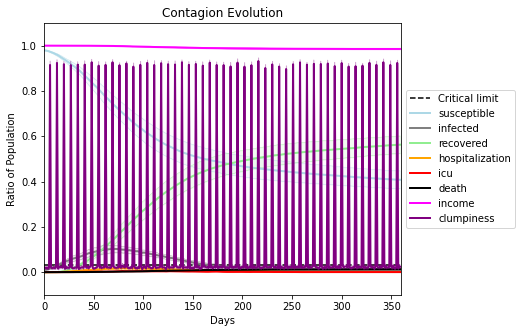

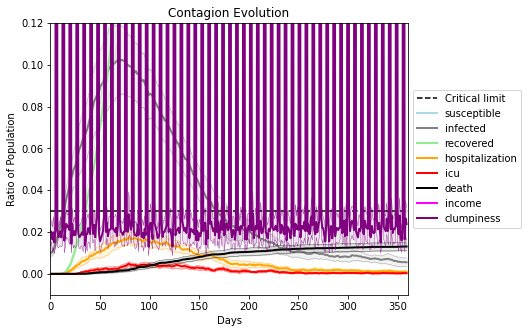

In [36]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4626, 820, 3099, 583, 1950, 1830, 2193, 1346, 5003, 311, 4851, 6350, 382, 7431, 18, 2219, 2172, 5244, 9961, 3165]
Average similarity between family members is 0.2146078554245353 at temperature -0.4
Average similarity between family and home is 0.9998631675972273 at temperature -1
Average similarity between students and their classroom is 0.1474254699134855 at temperature -0.4
Average classroom occupancy is 4.014285714285714 and number classrooms is 70
Average similarity between workers is 0.14293717478916573 at temperature -0.4
Average office occupancy is 3.3316582914572863 and number offices is 199
Average friend similarity for adults: 0.28321250894619365 for kids: 0.19378598090676066
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.04588343146034882
avg restaurant similarity 0.04590515889033672
avg restaurant similarity 0.09861293417854695
avg restaurant similarity 0.07659343995285975
avg restaurant similarity 0.05160706482205572
avg restaurant similarity 0.039415689422589086
avg restaurant similarity 0.07338818445840263
avg restaurant similarity 0.10831017929327788
avg restaurant similarity 0.09646667275828547
avg restaurant similarity 0.051925485598731606
avg restaurant similarity 0.10828872562292426
avg restaurant similarity 0.03353848821824692
avg restaurant similarity 0.046730343175007814
avg restaurant similarity 0.08322267487859303
avg restaurant similarity 0.09063489785397047
avg restaurant similarity 0.10049113117993153
avg restaurant similarity 0.11743710109517115
avg restaurant similarity 0.05972837311669513
avg restaurant similarity 0.09886254856930035
avg restaurant similarity 0.10105117329463546
avg restaurant similarity 0.06662273634662205
avg restaurant similarity 0.084

avg restaurant similarity 0.12477345363016137
avg restaurant similarity 0.06516081043446577
avg restaurant similarity 0.049587947356479735
avg restaurant similarity 0.1026770067969591
avg restaurant similarity 0.038258919804345884
avg restaurant similarity 0.09632991584483047
avg restaurant similarity 0.060877074007094974
avg restaurant similarity 0.05784526542690378
avg restaurant similarity 0.06697199380910972
avg restaurant similarity 0.0835376528182051
avg restaurant similarity 0.04088263695339399
avg restaurant similarity 0.06676274950792035
avg restaurant similarity 0.024422042936962582
avg restaurant similarity 0.060751835653423056
avg restaurant similarity 0.09831422203787692
avg restaurant similarity 0.08161547115929008
avg restaurant similarity 0.06412659249827378
avg restaurant similarity 0.06451717539347279
avg restaurant similarity 0.07175041942169591
avg restaurant similarity 0.07711663974617826
avg restaurant similarity 0.055844555897119695
avg restaurant similarity 0.01

avg restaurant similarity 0.09182287253191418
avg restaurant similarity 0.08417223129324274
avg restaurant similarity 0.14490128881628656
avg restaurant similarity 0.020529470053750734
avg restaurant similarity 0.10540618601658337
avg restaurant similarity 0.09218556431607992
avg restaurant similarity 0.07463513054441642
avg restaurant similarity 0.05297359310495434
avg restaurant similarity 0.16367382691345186
avg restaurant similarity 0.13599825351135106
avg restaurant similarity 0.07284021845740837
avg restaurant similarity 0.051440456770573656
avg restaurant similarity 0.07860256581938516
avg restaurant similarity 0.05246627831958395
avg restaurant similarity 0.11746613981510098
avg restaurant similarity 0.06228864809854202
avg restaurant similarity 0.06884582782372531
avg restaurant similarity 0.07723985467780303
avg restaurant similarity 0.04911398919189826
avg restaurant similarity 0.03268309904326076
avg restaurant similarity 0.06260052093067234
avg restaurant similarity 0.0942

avg restaurant similarity 0.037083901850006026
avg restaurant similarity 0.162063246143371
avg restaurant similarity 0.06374264827573772
avg restaurant similarity 0.08622012254344924
avg restaurant similarity 0.09889140366877526
avg restaurant similarity 0.04154791370266557
avg restaurant similarity 0.11491154409915749
avg restaurant similarity 0.11286605321483122
avg restaurant similarity 0.09642621106008557
avg restaurant similarity 0.055173863997470096
avg restaurant similarity 0.10051836597923944
avg restaurant similarity 0.10458603888516044
avg restaurant similarity 0.08867604252972078
avg restaurant similarity 0.06331281218927232
avg restaurant similarity 0.060851054454134114
avg restaurant similarity 0.09114232777082991
avg restaurant similarity 0.06136184019143838
avg restaurant similarity 0.07661655271087599
avg restaurant similarity 0.1266779018732403
avg restaurant similarity 0.12187997447321991
avg restaurant similarity 0.10329946325738336
avg restaurant similarity 0.082069

avg restaurant similarity 0.05274144267205272
avg restaurant similarity 0.07277757748901892
avg restaurant similarity 0.10841516748670985
avg restaurant similarity 0.04577510350671351
avg restaurant similarity 0.11350785946194167
avg restaurant similarity 0.09465330928803424
avg restaurant similarity -0.007936299925541089
avg restaurant similarity 0.10701623481373002
avg restaurant similarity 0.046868875819903476
avg restaurant similarity 0.06492690852162797
avg restaurant similarity 0.029958188174285017
avg restaurant similarity 0.06962450236009352
avg restaurant similarity 0.07507935202022607
avg restaurant similarity 0.08124986431632653
avg restaurant similarity 0.08789889421067767
avg restaurant similarity 0.07409771360101135
avg restaurant similarity 0.08067868982808882
avg restaurant similarity 0.10112955971104173
avg restaurant similarity 0.09153187199361325
avg restaurant similarity 0.053217817863809885
avg restaurant similarity 0.13132097764371775
avg restaurant similarity 0.1

avg restaurant similarity 0.10708387039644714
avg restaurant similarity -0.010798563899871941
avg restaurant similarity -0.006150399957625705
avg restaurant similarity 0.05005245118741102
avg restaurant similarity 0.08354591947208655
avg restaurant similarity 0.04279039551169419
avg restaurant similarity 0.11874908765603959
avg restaurant similarity 0.1083754588107077
avg restaurant similarity 0.0767499961181195
avg restaurant similarity 0.08440470303496053
avg restaurant similarity 0.06725747136967787
avg restaurant similarity 0.005712916967133351
avg restaurant similarity 0.09244047623954661
avg restaurant similarity 0.0760218319800751
avg restaurant similarity 0.1098726466610568
avg restaurant similarity 0.05305682481603487
avg restaurant similarity 0.06221653798805828
avg restaurant similarity 0.09874801350515894
avg restaurant similarity 0.014434660351789622
avg restaurant similarity 0.09601745905219053
avg restaurant similarity -0.006087001461301216
avg restaurant similarity 0.02

avg restaurant similarity 0.10634675718577329
avg restaurant similarity 0.10294098223077255
avg restaurant similarity 0.02858225438592456
avg restaurant similarity 0.013434725682103797
avg restaurant similarity 0.026104331045669133
avg restaurant similarity 0.07070838176785209
avg restaurant similarity 0.07679858886703916
avg restaurant similarity 0.028954818774557984
avg restaurant similarity 0.054060733926964366
avg restaurant similarity 0.03583934082209002
avg restaurant similarity 0.11768802803081536
avg restaurant similarity 0.06488657115990136
avg restaurant similarity 0.09182347864491194
avg restaurant similarity 0.005107610403315827
avg restaurant similarity 0.10440649094588235
avg restaurant similarity 0.035175823026197414
avg restaurant similarity 0.06013011322593631
avg restaurant similarity 0.08155977740132271
avg restaurant similarity 0.06953044790099783
avg restaurant similarity 0.05333325683061188
avg restaurant similarity 0.052058151401934524
avg restaurant similarity 0

avg restaurant similarity 0.09045380840018094
avg restaurant similarity 0.06308276913937477
avg restaurant similarity 0.04413175340319141
avg restaurant similarity -0.009681891692994311
avg restaurant similarity 0.008968353098968868
avg restaurant similarity 0.09098246639132691
avg restaurant similarity 0.07978357029528213
avg restaurant similarity 0.040704681631400744
avg restaurant similarity 0.08004980109803334
avg restaurant similarity 0.08520054317843678
avg restaurant similarity 0.10428655302347369
avg restaurant similarity 0.05473213238618194
avg restaurant similarity 0.05955452692794459
avg restaurant similarity 0.0777151095636798
avg restaurant similarity 0.0565929463252309
avg restaurant similarity 0.04713975166114925
avg restaurant similarity 0.10420385464340072
avg restaurant similarity 0.04678336537666091
avg restaurant similarity 0.06132609008417174
avg restaurant similarity 0.05299853635417055
avg restaurant similarity 0.07156001532285702
avg restaurant similarity 0.1054

avg restaurant similarity 0.04667657123615262
avg restaurant similarity 0.14111071165115338
avg restaurant similarity 0.12685921703098416
avg restaurant similarity 0.05287844047560404
avg restaurant similarity 0.10449566245898391
avg restaurant similarity 0.09793052245753994
avg restaurant similarity 0.0920318279548953
avg restaurant similarity 0.0464482078929857
avg restaurant similarity 0.04645511670114509
avg restaurant similarity 0.09143183498595821
avg restaurant similarity 0.02529637288880245
avg restaurant similarity 0.10965489008117808
avg restaurant similarity 0.09614522453940845
avg restaurant similarity 0.07915949827449305
avg restaurant similarity 0.121880404875778
avg restaurant similarity 0.13192145789611975
avg restaurant similarity 0.053531625572936725
avg restaurant similarity 0.11162764839050576
avg restaurant similarity 0.08356898741629253
avg restaurant similarity 0.10773309923752777
avg restaurant similarity 0.09453057509961164
avg restaurant similarity 0.074797297

avg restaurant similarity 0.08482564753164026
avg restaurant similarity 0.03253438372231102
avg restaurant similarity 0.09722617043578699
avg restaurant similarity 0.12743173760469662
avg restaurant similarity 0.1313217227858394
avg restaurant similarity 0.10470139417930238
avg restaurant similarity 0.07036806398807807
avg restaurant similarity 0.10734677601952981
avg restaurant similarity 0.04871995262568733
avg restaurant similarity 0.06354167120561442
avg restaurant similarity 0.09185299366527722
avg restaurant similarity 0.12727792792581813
avg restaurant similarity 0.03365259947814902
avg restaurant similarity 0.06896199674020634
avg restaurant similarity 0.0654446992503891
avg restaurant similarity 0.046459802791860426
avg restaurant similarity 0.06630984626857198
avg restaurant similarity -0.01841928836494767
avg restaurant similarity 0.14079249404946886
avg restaurant similarity 0.06348493283068625
avg restaurant similarity 0.057110612800790925
avg restaurant similarity 0.07240

avg restaurant similarity 0.08290988986336033
avg restaurant similarity 0.08941933509860293
avg restaurant similarity 0.0617935011051627
avg restaurant similarity 0.05317425955061636
avg restaurant similarity 0.07715219218472641
avg restaurant similarity 0.030502180778698446
avg restaurant similarity 0.07242983837692547
avg restaurant similarity 0.055895808887921686
avg restaurant similarity 0.06770987512345147
avg restaurant similarity 0.062497342848953426
avg restaurant similarity 0.05358439571487745
avg restaurant similarity 0.08312602920466552
avg restaurant similarity 0.0691510629140925
avg restaurant similarity 0.07812507789670022
avg restaurant similarity 0.022306200222726946
avg restaurant similarity 0.08213280084256493
avg restaurant similarity 0.0833032249653981
avg restaurant similarity 0.07907680764980485
avg restaurant similarity 0.0635681614596
avg restaurant similarity 0.06853815836255346
avg restaurant similarity 0.07011489663217518
avg restaurant similarity 0.112397882

avg restaurant similarity 0.07391194240137719
avg restaurant similarity 0.06396856674153541
avg restaurant similarity 0.06731707459374303
avg restaurant similarity 0.09056448413808775
avg restaurant similarity 0.042872944863594525
avg restaurant similarity 0.0730300115977476
avg restaurant similarity 0.04381706273399761
avg restaurant similarity 0.08379932589364882
avg restaurant similarity 0.06488960794312597
avg restaurant similarity 0.07879935394987238
avg restaurant similarity 0.08405319367735246
avg restaurant similarity 0.06561297988996721
avg restaurant similarity 0.06464799787149726
avg restaurant similarity 0.08769100740723021
avg restaurant similarity 0.03738636205870894
avg restaurant similarity 0.08208726526529773
avg restaurant similarity 0.06937109020024776
avg restaurant similarity 0.07465529962266174
avg restaurant similarity 0.07190544783550495
avg restaurant similarity 0.10979149670498654
avg restaurant similarity 0.08559158828068729
avg restaurant similarity 0.115945

avg restaurant similarity 0.11703345772202577
avg restaurant similarity 0.07886593630844936
avg restaurant similarity 0.029300424115397586
avg restaurant similarity 0.07611913892893386
avg restaurant similarity 0.07672907417842861
avg restaurant similarity 0.04971491362717273
avg restaurant similarity 0.04447100790972118
avg restaurant similarity 0.05419608627484203
avg restaurant similarity 0.0614673094369334
avg restaurant similarity 0.0734042195085873
avg restaurant similarity 0.05268045188155863
avg restaurant similarity 0.05118285870080529
avg restaurant similarity 0.05755228032137167
avg restaurant similarity 0.06983150680449092
avg restaurant similarity 0.08042204694422296
avg restaurant similarity 0.07133911832131273
avg restaurant similarity 0.07745986562232636
avg restaurant similarity 0.10019142479374528
avg restaurant similarity 0.039793141352724264
avg restaurant similarity 0.10419174620884836
avg restaurant similarity 0.0702222334845215
avg restaurant similarity 0.0993943

avg restaurant similarity 0.03147684606470036
avg restaurant similarity 0.0539341789617613
avg restaurant similarity 0.07742341454784608
avg restaurant similarity 0.015404114212407621
avg restaurant similarity 0.09959731517447423
avg restaurant similarity 0.0761739055864843
avg restaurant similarity 0.09127779298297017
avg restaurant similarity 0.02382043105055799
avg restaurant similarity 0.08251987150512757
avg restaurant similarity 0.15120882301129865
avg restaurant similarity 0.06643963250599114
avg restaurant similarity 0.10511558871440982
avg restaurant similarity 0.07827155582752292
avg restaurant similarity 0.0783515196727524
avg restaurant similarity 0.06252577723228582
avg restaurant similarity 0.07938733515166685
avg restaurant similarity 0.042585751700780654
avg restaurant similarity 0.08198569994004402
avg restaurant similarity 0.05599007409751822
avg restaurant similarity 0.09384359414981067
avg restaurant similarity 0.04598030862316048
avg restaurant similarity 0.0749563

avg restaurant similarity 0.024647586995064218
avg restaurant similarity 0.024169462592418135
avg restaurant similarity 0.08024886640608184
avg restaurant similarity 0.06082087994429107
avg restaurant similarity 0.03942166086366191
avg restaurant similarity 0.037045548760477
avg restaurant similarity 0.03840209913649566
avg restaurant similarity 0.061767612471407
avg restaurant similarity 0.06672932788090503
avg restaurant similarity 0.05637235466105374
avg restaurant similarity 0.05315352667300457
avg restaurant similarity 0.0664126659070248
avg restaurant similarity 0.103148832295083
avg restaurant similarity 0.08505473315255721
avg restaurant similarity 0.03676988472806374
avg restaurant similarity 0.05712988357163143
avg restaurant similarity 0.09149367365598417
avg restaurant similarity 0.11528394278654149
avg restaurant similarity 0.09102109278888815
avg restaurant similarity 0.06310247664795593
avg restaurant similarity 0.040836787963410406
avg restaurant similarity 0.0466278816

avg restaurant similarity 0.08945587219729188
avg restaurant similarity 0.09042347646055506
avg restaurant similarity 0.013745225755887576
avg restaurant similarity 0.08557751925061084
avg restaurant similarity 0.06263356955103606
avg restaurant similarity 0.09503043540070705
avg restaurant similarity 0.06471339477420894
avg restaurant similarity 0.060682340762661845
avg restaurant similarity 0.08214349927391018
avg restaurant similarity 0.046560988582327184
avg restaurant similarity 0.056691803984227955
avg restaurant similarity 0.0266212641371766
avg restaurant similarity 0.06802266450338909
avg restaurant similarity 0.06810094045027729
avg restaurant similarity 0.10214538414480216
avg restaurant similarity 0.10817947019288107
avg restaurant similarity 0.04044285166967408
avg restaurant similarity 0.0345686180982815
avg restaurant similarity 0.06849508107456065
avg restaurant similarity 0.059502551257975295
avg restaurant similarity 0.1077080465967186
avg restaurant similarity 0.0613

avg restaurant similarity 0.030526804365604607
avg restaurant similarity 0.07455300788578216
avg restaurant similarity 0.040031290545425854
avg restaurant similarity 0.061361740209799884
avg restaurant similarity 0.0801016067815045
avg restaurant similarity 0.06349845718398245
avg restaurant similarity 0.06943057013366448
avg restaurant similarity 0.0370440226860723
avg restaurant similarity 0.06427149892036292
avg restaurant similarity 0.02766842277201174
avg restaurant similarity 0.0728142255853723
avg restaurant similarity 0.04198260319527165
avg restaurant similarity 0.03903764618565848
avg restaurant similarity 0.12370041035652447
avg restaurant similarity 0.04963059891491925
avg restaurant similarity 0.03458458548915783
avg restaurant similarity 0.057493184999886766
avg restaurant similarity 0.09900553043131538
avg restaurant similarity 0.0878892363141456
avg restaurant similarity 0.01987405407126962
avg restaurant similarity 0.054068700332905645
avg restaurant similarity 0.05941

avg restaurant similarity 0.05531805319882876
avg restaurant similarity 0.053537152774461326
avg restaurant similarity 0.07729561598431975
avg restaurant similarity 0.046827138805416176
avg restaurant similarity 0.06700573992135878
avg restaurant similarity 0.0010248874067472753
avg restaurant similarity 0.01602701832891197
avg restaurant similarity 0.038860663297443504
avg restaurant similarity 0.06790046926972455
avg restaurant similarity 0.0334822785497538
avg restaurant similarity 0.07330950754740599
avg restaurant similarity 0.0650593057437673
avg restaurant similarity 0.0356170449280919
avg restaurant similarity 0.060595801486994116
avg restaurant similarity 0.06033833316046001
avg restaurant similarity 0.019700804353959926
avg restaurant similarity 0.0770393562606814
avg restaurant similarity 0.04319180856410109
avg restaurant similarity 0.08817649116965792
avg restaurant similarity 0.07831707874678497
avg restaurant similarity 0.03930576724887088
avg restaurant similarity 0.025

avg restaurant similarity 0.07717365646542756
avg restaurant similarity 0.039263383142216224
avg restaurant similarity 0.05870459374865896
avg restaurant similarity 0.042272616594294314
avg restaurant similarity 0.06398852439356087
avg restaurant similarity 0.051192119778091426
avg restaurant similarity 0.037524194132346526
avg restaurant similarity 0.04632983047751187
avg restaurant similarity 0.06595943709303456
avg restaurant similarity 0.007908251743923525
avg restaurant similarity 0.06674367496580896
avg restaurant similarity 0.056184651803455214
avg restaurant similarity 0.03539778640496058
avg restaurant similarity 0.09683685323208503
avg restaurant similarity 0.03783486068700045
avg restaurant similarity 0.05320977518371167
avg restaurant similarity 0.08247162834039133
avg restaurant similarity 0.022110498413840947
avg restaurant similarity 0.09024973407147086
avg restaurant similarity 0.09125742101155225
avg restaurant similarity 0.06350720150562603
avg restaurant similarity 0

avg restaurant similarity 0.06691187681802623
avg restaurant similarity 0.050798832586442313
avg restaurant similarity 0.07422636239691946
avg restaurant similarity 0.023819305016649913
avg restaurant similarity 0.0392824868107952
avg restaurant similarity 0.05709506941335327
avg restaurant similarity 0.057960157450635194
avg restaurant similarity 0.07200849825609341
avg restaurant similarity 0.08141395522657431
avg restaurant similarity 0.1105576703880396
avg restaurant similarity 0.0319046232349486
avg restaurant similarity 0.06617616949144355
avg restaurant similarity 0.06367708944407006
avg restaurant similarity 0.06747110949916355
avg restaurant similarity 0.06464884898801551
avg restaurant similarity 0.06615988260865087
avg restaurant similarity 0.03747823429568071
avg restaurant similarity 0.05121303035761565
avg restaurant similarity 0.07358088347010915
avg restaurant similarity 0.08033547653397331
avg restaurant similarity 0.027007409843992233
avg restaurant similarity 0.05904

avg restaurant similarity 0.02258064129177928
avg restaurant similarity 0.04320924852349465
avg restaurant similarity 0.03045135697103191
avg restaurant similarity 0.07031916043009981
avg restaurant similarity 0.04129261175015498
avg restaurant similarity 0.07664276233728301
avg restaurant similarity 0.08166680733017309
avg restaurant similarity 0.039717905231628596
avg restaurant similarity 0.07283990687572407
avg restaurant similarity 0.06731169944509333
avg restaurant similarity 0.1059469936467327
avg restaurant similarity 0.10699137836813324
avg restaurant similarity 0.06417843672697485
avg restaurant similarity 0.07986471194429305
avg restaurant similarity 0.10446449254740679
avg restaurant similarity 0.06664676628525439
avg restaurant similarity 0.06577071630997522
avg restaurant similarity 0.04985384316831247
avg restaurant similarity 0.05340177302227474
avg restaurant similarity 0.06672401975210344
avg restaurant similarity 0.07491471076582684
avg restaurant similarity 0.094068

avg restaurant similarity 0.013844875803347454
avg restaurant similarity 0.1084448884893308
avg restaurant similarity 0.12249771304757882
avg restaurant similarity 0.05827217489001075
avg restaurant similarity 0.0073262392977193735
avg restaurant similarity 0.044038249855019605
avg restaurant similarity 0.06953394733407912
avg restaurant similarity 0.04332575262665619
avg restaurant similarity 0.0917199202292083
avg restaurant similarity 0.058808774410092614
avg restaurant similarity 0.058215410855006165
avg restaurant similarity 0.07174210825486349
avg restaurant similarity 0.06339701475143716
avg restaurant similarity 0.07711805001136525
avg restaurant similarity 0.11464030917325227
avg restaurant similarity 0.0525689184593148
avg restaurant similarity 0.08302128710696154
avg restaurant similarity 0.055967892916115494
avg restaurant similarity 0.0741470321910917
avg restaurant similarity 0.11941978001054242
avg restaurant similarity 0.08754083016181045
avg restaurant similarity 0.126

avg restaurant similarity 0.07430556145381494
avg restaurant similarity 0.05203615391208555
avg restaurant similarity 0.0767834562082621
avg restaurant similarity 0.06017024268019859
avg restaurant similarity 0.0498772454317137
avg restaurant similarity 0.08456103064368925
avg restaurant similarity 0.06199708844544813
avg restaurant similarity 0.07333375361420816
avg restaurant similarity 0.09993265938934516
avg restaurant similarity 0.06358275768330465
avg restaurant similarity 0.05115092732318977
avg restaurant similarity 0.09247481133768597
avg restaurant similarity 0.03327371854063663
avg restaurant similarity 0.07199563641292005
avg restaurant similarity 0.0398502758930166
avg restaurant similarity 0.04863274304107776
avg restaurant similarity 0.07548588482049029
avg restaurant similarity 0.06119978853077956
avg restaurant similarity 0.09477535720388809
avg restaurant similarity 0.03993262764686166
avg restaurant similarity 0.07001978496609552
avg restaurant similarity 0.075630705

avg restaurant similarity 0.002253582428275772
avg restaurant similarity 0.12602676727298887
avg restaurant similarity 0.11804811486718955
avg restaurant similarity 0.06784263675322859
avg restaurant similarity 0.01999408232003285
avg restaurant similarity 0.08275668001271913
avg restaurant similarity 0.07336202833735118
avg restaurant similarity 0.025567842011913533
avg restaurant similarity 0.0349715645840898
avg restaurant similarity 0.08902012281567993
avg restaurant similarity 0.08142070129439569
avg restaurant similarity 0.017680259965247587
avg restaurant similarity 0.07988363356849608
avg restaurant similarity 0.049242151345008554
avg restaurant similarity 0.08368737752557233
avg restaurant similarity 0.04337389455242936
avg restaurant similarity 0.07963648849625965
avg restaurant similarity 0.056317706485700135
avg restaurant similarity 0.03851054995893085
avg restaurant similarity 0.09753164059104398
avg restaurant similarity 0.06107962482186367
avg restaurant similarity 0.08

avg restaurant similarity 0.08883255948738872
avg restaurant similarity 0.006955496520310647
avg restaurant similarity 0.06314321024990298
avg restaurant similarity 0.050428154096561865
avg restaurant similarity 0.04902101557112898
avg restaurant similarity 0.03741089436598343
avg restaurant similarity 0.03654452335408494
avg restaurant similarity 0.04195298357556527
avg restaurant similarity 0.03149381416655806
avg restaurant similarity 0.024653854802562578
avg restaurant similarity 0.021219816742590963
avg restaurant similarity 0.05595658788269966
avg restaurant similarity 0.016435048328942565
avg restaurant similarity 0.05568156856273273
avg restaurant similarity 0.07927263758652857
avg restaurant similarity 0.05933120220139714
avg restaurant similarity 0.1058002011391446
avg restaurant similarity 0.013443732451277774
avg restaurant similarity 0.05716221539843321
avg restaurant similarity -0.0035056756789508727
avg restaurant similarity 0.06150216771824062
avg restaurant similarity 

avg restaurant similarity 0.10118447538504009
avg restaurant similarity 0.07452123438621945
avg restaurant similarity 0.034733325371020696
avg restaurant similarity 0.08572090217768437
avg restaurant similarity 0.02960861507230343
avg restaurant similarity 0.05450131535510094
avg restaurant similarity 0.017569063137913513
avg restaurant similarity 0.06786302651789941
avg restaurant similarity 0.02482252448622988
avg restaurant similarity 0.0450560617605829
avg restaurant similarity 0.009313307001156264
avg restaurant similarity 0.014734034340969435
avg restaurant similarity 0.04599142285910063
avg restaurant similarity 0.05058849274862204
avg restaurant similarity 0.031822437452428805
avg restaurant similarity 0.10340396298440198
avg restaurant similarity 0.03379232791096527
avg restaurant similarity 0.019686102906450963
avg restaurant similarity 0.019350145479630095
avg restaurant similarity 0.07488849060242717
avg restaurant similarity 0.02857846372837417
avg restaurant similarity 0.

avg restaurant similarity 0.07230178823342223
avg restaurant similarity 0.04285653314857168
avg restaurant similarity 0.05398500930661662
avg restaurant similarity 0.04953996228738965
avg restaurant similarity 0.11336956832855638
avg restaurant similarity 0.07328963928742716
avg restaurant similarity 0.05672770302260026
avg restaurant similarity 0.04628441584565334
avg restaurant similarity 0.05886226326299382
avg restaurant similarity 0.10550938911280959
avg restaurant similarity 0.01619712262993223
avg restaurant similarity 0.0840120321557943
avg restaurant similarity 0.06894307594054117
avg restaurant similarity 0.09832212413370248
avg restaurant similarity 0.047027397345585996
avg restaurant similarity 0.09961426493617204
avg restaurant similarity 0.12040939734634075
avg restaurant similarity 0.09343517554434744
avg restaurant similarity 0.05153056784026868
avg restaurant similarity 0.06176157431721318
avg restaurant similarity 0.0753246366228033
avg restaurant similarity 0.0921645

avg restaurant similarity 0.11579442792073923
avg restaurant similarity 0.0805440390338291
avg restaurant similarity 0.08468070381907272
avg restaurant similarity 0.07321095839802501
avg restaurant similarity 0.08536337882955553
avg restaurant similarity 0.012305802273735665
avg restaurant similarity 0.10925044392237933
avg restaurant similarity 0.04203214466478031
avg restaurant similarity 0.08351716085319472
avg restaurant similarity 0.07289876094334592
avg restaurant similarity 0.0712260305914564
avg restaurant similarity 0.08895479643827944
avg restaurant similarity -0.0198806678527582
avg restaurant similarity 0.07173876578343741
avg restaurant similarity 0.11569822381570645
avg restaurant similarity 0.10199431991340874
avg restaurant similarity 0.06204511548481271
avg restaurant similarity 0.13041274804196695
avg restaurant similarity 0.09139333661334005
avg restaurant similarity 0.05905619920408817
avg restaurant similarity 0.03904815624790403
avg restaurant similarity 0.0464125

avg restaurant similarity 0.08583180672995501
avg restaurant similarity 0.08479025397521098
avg restaurant similarity 0.07521115754695447
avg restaurant similarity 0.07804764660284727
avg restaurant similarity 0.06702533452936031
avg restaurant similarity 0.03597578843630748
avg restaurant similarity 0.10085083963986094
avg restaurant similarity 0.05784281617469226
avg restaurant similarity 0.0737946887684132
avg restaurant similarity 0.10779482035564003
avg restaurant similarity 0.07008873485106605
avg restaurant similarity 0.07051247807872173
avg restaurant similarity 0.0732106334136766
avg restaurant similarity 0.09577812272088918
avg restaurant similarity 0.07547214001214154
avg restaurant similarity 0.012291300149952855
avg restaurant similarity 0.0430386287059906
avg restaurant similarity 0.0357024973553042
avg restaurant similarity 0.08796141441653776
avg restaurant similarity 0.06703524982400137
avg restaurant similarity 0.08705041480344147
avg restaurant similarity 0.065419953

avg restaurant similarity 0.10696881233128978
avg restaurant similarity 0.09299429483746219
avg restaurant similarity 0.061432597775526204
avg restaurant similarity 0.021024837256191833
avg restaurant similarity 0.08494165370816964
avg restaurant similarity 0.08870997745269742
avg restaurant similarity 0.08699657510995358
avg restaurant similarity 0.053908421760468055
avg restaurant similarity 0.0895609761994622
avg restaurant similarity 0.09980239440635404
avg restaurant similarity 0.11839831777619658
avg restaurant similarity 0.10022450758538498
avg restaurant similarity 0.04156899908575056
avg restaurant similarity 0.10998026256201107
avg restaurant similarity 0.08361081461214116
avg restaurant similarity 0.06787525384894212
avg restaurant similarity 0.03843141517535109
avg restaurant similarity 0.06946074314488006
avg restaurant similarity 0.11035379074908587
avg restaurant similarity 0.053907327991496716
avg restaurant similarity 0.061540645388360626
avg restaurant similarity 0.07

avg restaurant similarity 0.060484639807674996
avg restaurant similarity 0.037596040736671166
avg restaurant similarity 0.11876981208613827
avg restaurant similarity 0.07936619898397958
avg restaurant similarity 0.11737038317105401
avg restaurant similarity 0.061526215933790325
avg restaurant similarity 0.11715139863755894
avg restaurant similarity 0.11622184716129419
avg restaurant similarity 0.11169263645710016
avg restaurant similarity 0.07042762268077074
avg restaurant similarity 0.08896529794782804
avg restaurant similarity 0.09151902920016314
avg restaurant similarity 0.0937475134715039
avg restaurant similarity 0.1230787499120896
avg restaurant similarity 0.1139614051092599
avg restaurant similarity 0.10006506013868036
avg restaurant similarity 0.05528351796778405
avg restaurant similarity 0.07565599500725854
avg restaurant similarity 0.1294437948464307
avg restaurant similarity 0.08481716733762659
avg restaurant similarity 0.05053959937421612
avg restaurant similarity 0.1468755

avg restaurant similarity 0.1295415327329482
avg restaurant similarity 0.12539114590393952
avg restaurant similarity 0.07236365675194543
avg restaurant similarity 0.1291980714572491
avg restaurant similarity 0.11376819794833376
avg restaurant similarity 0.11047315375439279
avg restaurant similarity 0.04315808393063399
avg restaurant similarity 0.08845973034642882
avg restaurant similarity 0.081761208654774
avg restaurant similarity 0.08722684556021353
avg restaurant similarity 0.06473039302757108
avg restaurant similarity 0.028725075993900465
avg restaurant similarity 0.1175524762335992
avg restaurant similarity 0.06622445510106974
avg restaurant similarity 0.05150264928585098
avg restaurant similarity 0.12354807704383357
avg restaurant similarity 0.04418865914215304
avg restaurant similarity 0.09419104438757708
avg restaurant similarity 0.13165916908884495
avg restaurant similarity 0.09593662078195614
avg restaurant similarity 0.046840882819416285
avg restaurant similarity 0.030989427

avg restaurant similarity 0.02233996346627809
avg restaurant similarity 0.0667046838734312
avg restaurant similarity 0.03757945067206286
avg restaurant similarity 0.08139389556444072
avg restaurant similarity 0.05403533581917985
avg restaurant similarity 0.021871406412849608
avg restaurant similarity 0.10308130895603386
avg restaurant similarity 0.06199711136536044
avg restaurant similarity 0.0736708995597822
avg restaurant similarity 0.10339092817836405
avg restaurant similarity 0.03246775164275161
avg restaurant similarity 0.01888374317024836
avg restaurant similarity 0.07669541658566736
avg restaurant similarity 0.06297182423830332
avg restaurant similarity 0.02315725422839388
avg restaurant similarity 0.09692236079762329
avg restaurant similarity 0.09406453042890102
avg restaurant similarity 0.05054028642409312
avg restaurant similarity 0.0726365636518473
avg restaurant similarity 0.07712272398832921
avg restaurant similarity 0.04913261369519119
avg restaurant similarity 0.01550235

avg restaurant similarity 0.04607730056223732
avg restaurant similarity 0.05383149250446344
avg restaurant similarity 0.058641607487421976
avg restaurant similarity 0.04540458128033771
avg restaurant similarity 0.06466810568863249
avg restaurant similarity 0.048635752410406116
avg restaurant similarity 0.01812805776996567
avg restaurant similarity 0.052729731618315054
avg restaurant similarity 0.04141467345505744
avg restaurant similarity 0.07622353077761918
avg restaurant similarity 0.04936660278876465
avg restaurant similarity 0.0633602254140338
avg restaurant similarity 0.09838004086650463
avg restaurant similarity 0.06933394604092666
avg restaurant similarity 0.0371697141845614
avg restaurant similarity 0.060210541651792585
avg restaurant similarity 0.024965740729752394
avg restaurant similarity 0.04746593319583352
avg restaurant similarity 0.07340114745165341
avg restaurant similarity 0.07821805872115084
avg restaurant similarity 0.07633967220089641
avg restaurant similarity 0.052

avg restaurant similarity 0.06193349485507668
avg restaurant similarity 0.07141463502234695
avg restaurant similarity 0.0788724341575549
avg restaurant similarity 0.11417615711242074
avg restaurant similarity 0.07583501837553716
avg restaurant similarity 0.040110942001235834
avg restaurant similarity 0.06682850422609526
avg restaurant similarity 0.07981311955087347
avg restaurant similarity 0.060810050173822724
avg restaurant similarity 0.03772630333862029
avg restaurant similarity 0.098816575210686
avg restaurant similarity 0.055556212968714165
avg restaurant similarity 0.06253535564389504
avg restaurant similarity 0.030006392951620407
avg restaurant similarity 0.03583636481606341
avg restaurant similarity 0.0438275852101277
avg restaurant similarity -0.002724163648872619
avg restaurant similarity 0.08378001683775771
avg restaurant similarity 0.03912497858128885
avg restaurant similarity 0.06539772679942485
avg restaurant similarity 0.12211138039742021
avg restaurant similarity 0.0907

avg restaurant similarity 0.020581223009295265
avg restaurant similarity 0.08833648982068179
avg restaurant similarity 0.00678801979608515
avg restaurant similarity 0.008499299506538976
avg restaurant similarity 0.05080407499783137
avg restaurant similarity 0.09153646566272602
avg restaurant similarity 0.06472758607376547
avg restaurant similarity 0.05572582379128206
avg restaurant similarity 0.06888492724186622
avg restaurant similarity 0.06311963575782381
avg restaurant similarity 0.11943522947487879
avg restaurant similarity 0.1062192889029884
avg restaurant similarity 0.06241106513023076
avg restaurant similarity 0.04970318817793823
avg restaurant similarity 0.07333969024919004
avg restaurant similarity 0.04282344116148884
avg restaurant similarity 0.05836897593015373
avg restaurant similarity 0.09826368848099601
avg restaurant similarity 0.03888266962897294
avg restaurant similarity 0.09592562133704544
avg restaurant similarity 0.09842740202549037
avg restaurant similarity 0.06511

avg restaurant similarity 0.08220719353223811
avg restaurant similarity 0.037850249789262595
avg restaurant similarity 0.07918758898221726
avg restaurant similarity 0.08409690070905611
avg restaurant similarity 0.07661328383944849
avg restaurant similarity 0.13681723374729285
avg restaurant similarity 0.0359732163716289
avg restaurant similarity 0.061324752042590094
avg restaurant similarity 0.055694184468699996
avg restaurant similarity 0.0676067288060142
avg restaurant similarity 0.07207338315680685
avg restaurant similarity 0.0925172219141838
avg restaurant similarity 0.08310428244432337
avg restaurant similarity 0.08492675043179648
avg restaurant similarity 0.08498729616127204
avg restaurant similarity 0.10158038383077539
avg restaurant similarity 0.11347302324172084
avg restaurant similarity 0.07544907922988164
avg restaurant similarity 0.06002066289932949
avg restaurant similarity 0.11999615844581141
avg restaurant similarity 0.07041255745230802
avg restaurant similarity 0.106801

avg restaurant similarity 0.07254593611075406
avg restaurant similarity 0.03199557232332018
avg restaurant similarity 0.0685262350257028
avg restaurant similarity 0.11523826576810817
avg restaurant similarity 0.1175346131651344
avg restaurant similarity 0.04358776619661326
avg restaurant similarity 0.04913052751090849
avg restaurant similarity 0.06279677600340622
avg restaurant similarity 0.055791176396298076
avg restaurant similarity 0.05846349438392142
avg restaurant similarity 0.05988362737698599
avg restaurant similarity 0.041542111330002116
avg restaurant similarity 0.0751957623920264
avg restaurant similarity 0.07141329697156307
avg restaurant similarity 0.09004822397991498
avg restaurant similarity 0.08764489275644861
avg restaurant similarity 0.08432333832216536
avg restaurant similarity 0.06828339151955293
avg restaurant similarity 0.10615961231587875
avg restaurant similarity 0.05084421352708785
avg restaurant similarity 0.0664774531372612
avg restaurant similarity 0.06605667

avg restaurant similarity 0.014541906792078695
avg restaurant similarity 0.06701023481637397
avg restaurant similarity 0.054436212190722866
avg restaurant similarity 0.0956177555680248
avg restaurant similarity 0.1296247575021447
avg restaurant similarity 0.06397600494453441
avg restaurant similarity 0.055399595259294346
avg restaurant similarity 0.08217928451745932
avg restaurant similarity 0.06411202544100257
avg restaurant similarity 0.1153985472192678
avg restaurant similarity 0.09572084288994988
avg restaurant similarity 0.09000389197819862
avg restaurant similarity 0.11983773622894378
avg restaurant similarity 0.08248694668809402
avg restaurant similarity 0.05251540267032933
avg restaurant similarity 0.06802557990604466
avg restaurant similarity 0.06014135048747234
avg restaurant similarity 0.10970399646235414
avg restaurant similarity 0.05478020145299669
avg restaurant similarity 0.08791974799767045
avg restaurant similarity 0.1324127737008001
avg restaurant similarity 0.0909075

avg restaurant similarity 0.1031049402414048
avg restaurant similarity 0.045629584123649675
avg restaurant similarity 0.07679965482234881
avg restaurant similarity 0.07025868513999349
avg restaurant similarity 0.06120067513104179
avg restaurant similarity 0.0675165997075129
avg restaurant similarity 0.1265079742266054
avg restaurant similarity 0.07935748455805565
avg restaurant similarity 0.08064101370025897
avg restaurant similarity 0.089893724938566
avg restaurant similarity 0.04018189335057197
avg restaurant similarity 0.10254068691437518
avg restaurant similarity 0.12002727252137482
avg restaurant similarity 0.08825856106392486
avg restaurant similarity 0.07809124932733359
avg restaurant similarity 0.10008665000464376
avg restaurant similarity 0.012422943027340568
avg restaurant similarity 0.0852290647260122
avg restaurant similarity 0.053345771682043776
avg restaurant similarity 0.08348037846290389
avg restaurant similarity 0.1123138375688135
avg restaurant similarity 0.1128455101

0.004350000000000001
max:
0.00843878343878344
std:
0.0009434806187112821
mean:
0.006613508309164793
median:
0.006552816550348953
95% confidence interval for the mean:
(0.006160474720772707,0.0070665418975568795)
using average of time series:
stats on icu:
data: [0.002133333333333334, 0.001563888888888889, 0.0017500000000000003, 0.0021922521922521925, 0.0018333333333333335, 0.0015675196632325247, 0.0019516522510534483, 0.0012861111111111114, 0.0019505312084993362, 0.0019694444444444442, 0.0014972222222222223, 0.001902777777777778, 0.001627777777777778, 0.0017177267177267178, 0.001436111111111111, 0.0009305555555555556, 0.0012861111111111111, 0.0016333333333333336, 0.001163888888888889, 0.0020166666666666666]
min:
0.0009305555555555556
max:
0.0021922521922521925
std:
0.0003280201613707819
mean:
0.0016705118794159888
median:
0.0016755300255300257
95% confidence interval for the mean:
(0.0015130055694572981,0.0018280181893746794)
using average of time series:
stats on death:
data: [0.00890

(<function dict.items>, <function dict.items>, <function dict.items>)

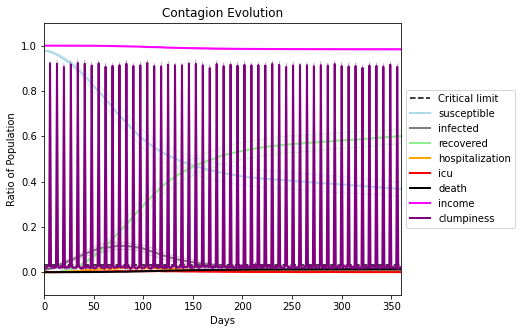

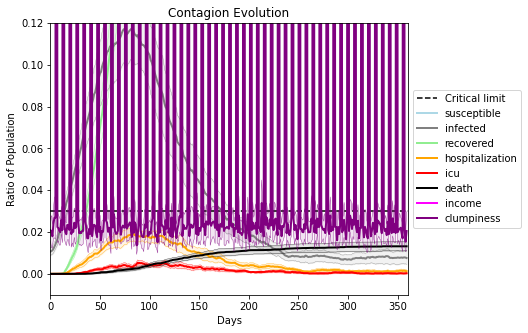

In [37]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1390, 312, 970, 2856, 3463, 6569, 4684, 5339, 876, 6371, 7708, 3811, 8053, 3427, 9429, 3751, 1912, 7556, 3070, 4125]
Average similarity between family members is 0.19023815358801263 at temperature -0.3
Average similarity between family and home is 0.9998508010851263 at temperature -1
Average similarity between students and their classroom is 0.14868368953908553 at temperature -0.3
Average classroom occupancy is 4.027777777777778 and number classrooms is 72
Average similarity between workers is 0.1544681119405454 at temperature -0.3
Average office occupancy is 3.176470588235294 and number offices is 204
Average friend similarity for adults: 0.23548088435474057 for kids: 0.20630135076547232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.06113690725174363
avg restaurant similarity 0.07692780814402399
avg restaurant similarity 0.023429737114962546
avg restaurant similarity 0.07504178713545248
avg restaurant similarity 0.016092374002146626
avg restaurant similarity 0.05314374811962641
avg restaurant similarity 0.08026127090958811
avg restaurant similarity 0.0075975083504567515
avg restaurant similarity 0.061882935867705
avg restaurant similarity 0.05807904479484111
avg restaurant similarity 0.06271006095459214
avg restaurant similarity 0.044263685543651905
avg restaurant similarity 0.05340418657343399
avg restaurant similarity 0.0562984978042734
avg restaurant similarity 0.025133542472595014
avg restaurant similarity 0.012242491594084108
avg restaurant similarity 0.11110252592392499
avg restaurant similarity 0.046172908873469434
avg restaurant similarity 0.10778357660312782
avg restaurant similarity 0.061839612710230446
avg restaurant similarity 0.06379618911971514
avg restaurant similarity 0.

avg restaurant similarity 0.06439132919311305
avg restaurant similarity 0.06313543667212067
avg restaurant similarity 0.08852858542039538
avg restaurant similarity 0.10164234287451335
avg restaurant similarity 0.012136011907008307
avg restaurant similarity 0.02589509022361417
avg restaurant similarity 0.05899931405523408
avg restaurant similarity 0.07528080320014029
avg restaurant similarity 0.05092185644401635
avg restaurant similarity 0.0828567635694616
avg restaurant similarity 0.056283532544163184
avg restaurant similarity 0.01580695712910172
avg restaurant similarity 0.09649973277628703
avg restaurant similarity 0.029282389757079995
avg restaurant similarity 0.03359845087174476
avg restaurant similarity 0.022216118787631255
avg restaurant similarity 0.02210026391872744
avg restaurant similarity 0.07744571464285824
avg restaurant similarity 0.04369394424405131
avg restaurant similarity 0.041096798772566834
avg restaurant similarity 0.05891364681599467
avg restaurant similarity 0.02

avg restaurant similarity 0.044496256492838816
avg restaurant similarity 0.07698771211536685
avg restaurant similarity 0.049311291527100065
avg restaurant similarity 0.11690360744921356
avg restaurant similarity 0.10306288422023087
avg restaurant similarity 0.067184690557389
avg restaurant similarity 0.0884554024617152
avg restaurant similarity -0.004268770351777423
avg restaurant similarity 0.14233634857599153
avg restaurant similarity 0.021530513917287917
avg restaurant similarity 0.11913911003024336
avg restaurant similarity 0.09228907205338711
avg restaurant similarity 0.07734190693845816
avg restaurant similarity 0.020760895521815537
avg restaurant similarity 0.0703670175897873
avg restaurant similarity 0.10341651859702797
avg restaurant similarity 0.12193672634908308
avg restaurant similarity 0.08467148983456078
avg restaurant similarity 0.06269089916635226
avg restaurant similarity 0.021298730624671976
avg restaurant similarity 0.027767168281227925
avg restaurant similarity 0.09

avg restaurant similarity 0.05639326579494698
avg restaurant similarity 0.11682831570480302
avg restaurant similarity 0.0787051188067285
avg restaurant similarity 0.11248763316572236
avg restaurant similarity 0.08845471686019299
avg restaurant similarity 0.11105192002519482
avg restaurant similarity 0.08301556603035354
avg restaurant similarity 0.11415329485987692
avg restaurant similarity 0.04385480212731845
avg restaurant similarity 0.050779737534308485
avg restaurant similarity 0.0783358268159338
avg restaurant similarity 0.11729171421722873
avg restaurant similarity 0.019577659068427854
avg restaurant similarity 0.09269729947511376
avg restaurant similarity 0.08226871065225286
avg restaurant similarity 0.08067097960267007
avg restaurant similarity 0.03557402797571688
avg restaurant similarity 0.06409460456677327
avg restaurant similarity 0.07629208901289686
avg restaurant similarity 0.06196373466777798
avg restaurant similarity 0.0777463982181779
avg restaurant similarity 0.0725705

avg restaurant similarity 0.09360317653697033
avg restaurant similarity 0.09170344322565042
avg restaurant similarity 0.09539797446354843
avg restaurant similarity 0.07934655459057469
avg restaurant similarity 0.027176080380776447
avg restaurant similarity 0.1386208665530704
avg restaurant similarity 0.06288201515782528
avg restaurant similarity 0.051556045665460674
avg restaurant similarity 0.0916227963970673
avg restaurant similarity 0.05520446378548039
avg restaurant similarity 0.006939001003008324
avg restaurant similarity 0.014078822715870954
avg restaurant similarity 0.02268432438984441
avg restaurant similarity 0.11529792276516355
avg restaurant similarity 0.05406303470086689
avg restaurant similarity 0.027501105891268904
avg restaurant similarity 0.08348680436392232
avg restaurant similarity 0.0579673514447665
avg restaurant similarity 0.04443823335691732
avg restaurant similarity 0.10246501527744323
avg restaurant similarity 0.05919475161227058
avg restaurant similarity 0.0434

avg restaurant similarity 0.10106944138505046
avg restaurant similarity 0.046428321696598426
avg restaurant similarity 0.0888198181616108
avg restaurant similarity 0.051339774130404324
avg restaurant similarity 0.04448494726288875
avg restaurant similarity 0.03334083937914662
avg restaurant similarity 0.07694420723980828
avg restaurant similarity 0.03283674330224842
avg restaurant similarity 0.08802264014464699
avg restaurant similarity 0.07855617046503872
avg restaurant similarity 0.10626631798002503
avg restaurant similarity 0.1072723370989831
avg restaurant similarity 0.07402657931050055
avg restaurant similarity 0.09276318854240204
avg restaurant similarity 0.07214414047858175
avg restaurant similarity 0.08061389734304578
avg restaurant similarity 0.04529957094157812
avg restaurant similarity 0.04595085311839263
avg restaurant similarity 0.05330613932633822
avg restaurant similarity 0.08370816828706083
avg restaurant similarity 0.024331486956142984
avg restaurant similarity 0.03523

avg restaurant similarity 0.0440531847324823
avg restaurant similarity 0.050153031188568814
avg restaurant similarity 0.03832411292776384
avg restaurant similarity 0.0889018453393515
avg restaurant similarity 0.024988212570242557
avg restaurant similarity 0.09037724682498088
avg restaurant similarity 0.11540815436285443
avg restaurant similarity 0.11664520809849739
avg restaurant similarity 0.04982248816704651
avg restaurant similarity 0.09457910378797368
avg restaurant similarity 0.047296646049324445
avg restaurant similarity 0.08003375639203558
avg restaurant similarity 0.0892051384604282
avg restaurant similarity 0.0707679768524525
avg restaurant similarity 0.06734922421939021
avg restaurant similarity 0.09768339399338066
avg restaurant similarity 0.07390661101307838
avg restaurant similarity 0.04624993252906768
avg restaurant similarity 0.05790346943097879
avg restaurant similarity 0.12900489628271025
avg restaurant similarity 0.041320764334217795
avg restaurant similarity 0.076664

avg restaurant similarity 0.03943542283137041
avg restaurant similarity 0.08055455430112542
avg restaurant similarity 0.1160688482036396
avg restaurant similarity 0.024350878130849345
avg restaurant similarity 0.09519405443246785
avg restaurant similarity 0.0026670964870392777
avg restaurant similarity 0.1198324416740724
avg restaurant similarity 0.03980686083649992
avg restaurant similarity 0.08614249592481787
avg restaurant similarity 0.12959143862500416
avg restaurant similarity 0.106603338147673
avg restaurant similarity 0.10731923698690074
avg restaurant similarity 0.030304504488192587
avg restaurant similarity 0.10376862515064707
avg restaurant similarity 0.08627052644969484
avg restaurant similarity 0.07960816358906671
avg restaurant similarity 0.07873373935707179
avg restaurant similarity 0.033278881790920624
avg restaurant similarity 0.05113922231081512
avg restaurant similarity 0.09906943958911386
avg restaurant similarity 0.03719259881998533
avg restaurant similarity 0.07648

avg restaurant similarity 0.08617019610533737
avg restaurant similarity 0.010383889148244183
avg restaurant similarity 0.08946915642961345
avg restaurant similarity 0.08188180325192461
avg restaurant similarity 0.06878115845975084
avg restaurant similarity 0.043252458507085104
avg restaurant similarity 0.09380000756234862
avg restaurant similarity 0.06466152215871336
avg restaurant similarity 0.07750047508249695
avg restaurant similarity 0.09166992329068706
avg restaurant similarity 0.07465134901138806
avg restaurant similarity 0.06479273588724975
avg restaurant similarity 0.11164965463654332
avg restaurant similarity 0.06095836472557784
avg restaurant similarity 0.09366439969536627
avg restaurant similarity 0.019948755877968523
avg restaurant similarity 0.08510573262856068
avg restaurant similarity 0.09850823912591682
avg restaurant similarity 0.10387689210311078
avg restaurant similarity 0.10641192698710311
avg restaurant similarity 0.05932239630158029
avg restaurant similarity 0.090

avg restaurant similarity 0.07442011308642021
avg restaurant similarity 0.09996810188327478
avg restaurant similarity 0.12214738040407155
avg restaurant similarity 0.049556144743723635
avg restaurant similarity 0.09400211779637625
avg restaurant similarity 0.06484734081632615
avg restaurant similarity 0.1083875106006813
avg restaurant similarity 0.10548616818666855
avg restaurant similarity 0.08114640626384666
avg restaurant similarity 0.08601785380976994
avg restaurant similarity 0.05676837980455272
avg restaurant similarity 0.10193809888551077
avg restaurant similarity 0.0451601958411685
avg restaurant similarity 0.09649024644903938
avg restaurant similarity 0.10294232027548376
avg restaurant similarity 0.08727315939242607
avg restaurant similarity 0.0871012396840949
avg restaurant similarity 0.06940398875381998
avg restaurant similarity 0.07027593214059255
avg restaurant similarity 0.05898727273795546
avg restaurant similarity 0.04451716153995989
avg restaurant similarity 0.13110815

avg restaurant similarity 0.12937672926189098
avg restaurant similarity 0.06407227780700102
avg restaurant similarity 0.04517637103065328
avg restaurant similarity 0.08701073093520735
avg restaurant similarity 0.09747449247231066
avg restaurant similarity 0.13188068932783759
avg restaurant similarity 0.06757361263132731
avg restaurant similarity 0.07120856404350683
avg restaurant similarity 0.015627183931933183
avg restaurant similarity 0.07632300098346687
avg restaurant similarity 0.04131621484138741
avg restaurant similarity 0.06797813373477953
avg restaurant similarity 0.09718367756982184
avg restaurant similarity 0.06636953828595342
avg restaurant similarity 0.09072825124860469
avg restaurant similarity 0.07736959720190088
avg restaurant similarity 0.06885415383279082
avg restaurant similarity 0.07002173391116151
avg restaurant similarity 0.0632001214127424
avg restaurant similarity 0.08665725306977154
avg restaurant similarity 0.07188018840440448
avg restaurant similarity 0.031016

avg restaurant similarity 0.12529082391526447
avg restaurant similarity 0.09392398130756073
avg restaurant similarity 0.09945373638588294
avg restaurant similarity 0.1060237548500977
avg restaurant similarity 0.07135194851762405
avg restaurant similarity 0.06615668067517884
avg restaurant similarity 0.0570730095787223
avg restaurant similarity 0.09960500059113653
avg restaurant similarity 0.083057052111084
avg restaurant similarity 0.028358355756264567
avg restaurant similarity 0.05121260736468081
avg restaurant similarity 0.0219627955839754
avg restaurant similarity 0.10383640318676568
avg restaurant similarity 0.08775394412240324
avg restaurant similarity 0.08209105474105713
avg restaurant similarity 0.07680645986699794
avg restaurant similarity 0.10111395737221725
avg restaurant similarity 0.10357779103938497
avg restaurant similarity 0.082350260467239
avg restaurant similarity 0.08788887639285041
avg restaurant similarity 0.08372577302766954
avg restaurant similarity 0.107869706579

avg restaurant similarity 0.048509203760442286
avg restaurant similarity 0.07455141928695627
avg restaurant similarity 0.0904210538993178
avg restaurant similarity 0.09587620058282928
avg restaurant similarity 0.06991797090266451
avg restaurant similarity 0.08789282197022501
avg restaurant similarity 0.06546025200314282
avg restaurant similarity 0.09225111566072715
avg restaurant similarity 0.046786109020896326
avg restaurant similarity 0.07323454321361993
avg restaurant similarity 0.07750544482026316
avg restaurant similarity 0.07996780487530837
avg restaurant similarity 0.15100060725197684
avg restaurant similarity 0.08720165002384848
avg restaurant similarity 0.08212418134498223
avg restaurant similarity 0.0782233170982466
avg restaurant similarity 0.034548285159089066
avg restaurant similarity 0.06335832527119653
avg restaurant similarity 0.1196278101148479
avg restaurant similarity 0.07707169689533658
avg restaurant similarity 0.07809995949454346
avg restaurant similarity 0.080370

avg restaurant similarity 0.08118841017071961
avg restaurant similarity 0.042504123113836625
avg restaurant similarity 0.06217966232856835
avg restaurant similarity 0.08282112657163813
avg restaurant similarity 0.13289805660972895
avg restaurant similarity 0.08681099031751671
avg restaurant similarity 0.030161076976203852
avg restaurant similarity 0.13644884070131824
avg restaurant similarity 0.09486040686825023
avg restaurant similarity 0.11606559932180185
avg restaurant similarity 0.04085268643259862
avg restaurant similarity 0.08430495206439644
avg restaurant similarity 0.08421797596508737
avg restaurant similarity 0.10224463925077443
avg restaurant similarity 0.1326799298305974
avg restaurant similarity 0.09112428075850319
avg restaurant similarity 0.08381673530592892
avg restaurant similarity 0.02551336253696097
avg restaurant similarity 0.08212513832707609
avg restaurant similarity 0.0773860642819614
avg restaurant similarity 0.08790116229017782
avg restaurant similarity 0.099259

avg restaurant similarity 0.10530782292040271
avg restaurant similarity 0.06047930178962462
avg restaurant similarity 0.026193431859357595
avg restaurant similarity 0.0673998970427285
avg restaurant similarity 0.03856416954589964
avg restaurant similarity 0.06990567994264134
avg restaurant similarity 0.017413746568573862
avg restaurant similarity 0.06467947692539332
avg restaurant similarity 0.04996833839851587
avg restaurant similarity 0.01847667256840153
avg restaurant similarity 0.04141305948864344
avg restaurant similarity 0.038589603946037346
avg restaurant similarity 0.05813717223908913
avg restaurant similarity 0.09126060252633167
avg restaurant similarity 0.07920927152317163
avg restaurant similarity 0.0557285210738877
avg restaurant similarity 0.04667242005116362
avg restaurant similarity 0.035089132959644026
avg restaurant similarity 0.048009357555936716
avg restaurant similarity 0.06894582637294222
avg restaurant similarity 0.1001425217006755
avg restaurant similarity 0.0788

avg restaurant similarity 0.09710962280280844
avg restaurant similarity 0.07139423297134542
avg restaurant similarity 0.035256139804703705
avg restaurant similarity 0.04921676108990925
avg restaurant similarity 0.05719277985889436
avg restaurant similarity 0.059378832560676734
avg restaurant similarity 0.017845567861020036
avg restaurant similarity 0.03881089210842533
avg restaurant similarity -0.005486822748679007
avg restaurant similarity 0.11212696453799141
avg restaurant similarity 0.010861661486977826
avg restaurant similarity 0.0412814089229174
avg restaurant similarity 0.015140101889779769
avg restaurant similarity 0.05422854746148843
avg restaurant similarity 0.05625829311015013
avg restaurant similarity 0.005179829850458308
avg restaurant similarity 0.06022589870007395
avg restaurant similarity 0.08530015035315318
avg restaurant similarity 0.09063506531242203
avg restaurant similarity 0.06676626896542558
avg restaurant similarity 0.05032165670459607
avg restaurant similarity 0

avg restaurant similarity 0.04364996202901124
avg restaurant similarity 0.11296826268732836
avg restaurant similarity 0.08940316309682997
avg restaurant similarity 0.0827758371025978
avg restaurant similarity 0.09531727982380277
avg restaurant similarity 0.055135968284077116
avg restaurant similarity 0.08215709642283187
avg restaurant similarity 0.05375958882923241
avg restaurant similarity 0.021079366040441614
avg restaurant similarity 0.08927724257650713
avg restaurant similarity 0.04869356117415527
avg restaurant similarity 0.02976541654053621
avg restaurant similarity 0.08907514945382145
avg restaurant similarity 0.10139676910165561
avg restaurant similarity 0.06983058904296217
avg restaurant similarity 0.10245805584927911
avg restaurant similarity 0.08304866518904265
avg restaurant similarity 0.08684773341043159
avg restaurant similarity 0.10414854827238433
avg restaurant similarity 0.08003977892568645
avg restaurant similarity 0.13192722306048746
avg restaurant similarity 0.06805

avg restaurant similarity 0.07229173719296637
avg restaurant similarity 0.09296830446632465
avg restaurant similarity 0.07465013040538798
avg restaurant similarity 0.09579250836899016
avg restaurant similarity 0.027286459628304616
avg restaurant similarity 0.055959997339578064
avg restaurant similarity 0.1426641822057689
avg restaurant similarity 0.08250152242025595
avg restaurant similarity 0.055952995689225904
avg restaurant similarity 0.03997273397261231
avg restaurant similarity 0.0667223344596085
avg restaurant similarity 0.06746580170536576
avg restaurant similarity 0.038046335355437944
avg restaurant similarity 0.11988740029233716
avg restaurant similarity 0.0547814800073799
avg restaurant similarity 0.06807926472670339
avg restaurant similarity 0.11359979948818238
avg restaurant similarity 0.046077265891176895
avg restaurant similarity 0.03516610705263483
avg restaurant similarity 0.0699853693705757
avg restaurant similarity 0.06883662155187066
avg restaurant similarity 0.08997

avg restaurant similarity 0.07304701682850956
avg restaurant similarity 0.09014532251967924
avg restaurant similarity 0.09375753119551938
avg restaurant similarity 0.060268951888184256
avg restaurant similarity 0.04648400368697266
avg restaurant similarity 0.10351701378155095
avg restaurant similarity 0.04481859887078336
avg restaurant similarity 0.06126700237634471
avg restaurant similarity 0.08611001618129971
avg restaurant similarity 0.07389876961883804
avg restaurant similarity 0.08374817855701006
avg restaurant similarity 0.11659049528359954
avg restaurant similarity 0.08218915998735886
avg restaurant similarity 0.07687421681712196
avg restaurant similarity 0.06787879184983713
avg restaurant similarity 0.045618201694351164
avg restaurant similarity 0.09104265204326768
avg restaurant similarity 0.0246020559005079
avg restaurant similarity 0.09087600347237151
avg restaurant similarity 0.08590723617248983
avg restaurant similarity 0.047082351169276476
avg restaurant similarity 0.0317

avg restaurant similarity 0.047242052950998044
avg restaurant similarity 0.0722061056425022
avg restaurant similarity 0.07491680214896763
avg restaurant similarity 0.09463212938671671
avg restaurant similarity 0.04022342952651163
avg restaurant similarity 0.03506798344232872
avg restaurant similarity 0.06834775086176029
avg restaurant similarity 0.049715855936408565
avg restaurant similarity 0.04315000062114132
avg restaurant similarity 0.04551308308308486
avg restaurant similarity 0.044848404875770576
avg restaurant similarity 0.07599216684263124
avg restaurant similarity 0.04258140060156905
avg restaurant similarity 0.05072089827674958
avg restaurant similarity 0.02552892047117588
avg restaurant similarity 0.07924161088992246
avg restaurant similarity 0.09774904826997
avg restaurant similarity 0.06338792884345158
avg restaurant similarity 0.0897376445196884
avg restaurant similarity 0.09228080040081714
avg restaurant similarity 0.0922888375932782
avg restaurant similarity 0.100814162

avg restaurant similarity 0.027449277820332768
avg restaurant similarity 0.04508869764720001
avg restaurant similarity 0.08488633960580462
avg restaurant similarity 0.05919071293515677
avg restaurant similarity 0.02244501837323132
avg restaurant similarity 0.04576289954400558
avg restaurant similarity 0.0628021644108325
avg restaurant similarity 0.06627950325094632
avg restaurant similarity 0.06065108385030503
avg restaurant similarity 0.047225155005291335
avg restaurant similarity 0.05943932752327317
avg restaurant similarity 0.029114566270547853
avg restaurant similarity 0.04325598623739323
avg restaurant similarity 0.06235100971687333
avg restaurant similarity 0.09815082978688477
avg restaurant similarity 0.06948422176310735
avg restaurant similarity 0.06200577696582714
avg restaurant similarity 0.0839469370371443
avg restaurant similarity 0.07646696981253168
avg restaurant similarity 0.0836693083159073
avg restaurant similarity 0.0672388435721154
avg restaurant similarity 0.0729997

avg restaurant similarity 0.05637757122698931
avg restaurant similarity 0.06765248147080767
avg restaurant similarity 0.02457720090218347
avg restaurant similarity 0.08044100819521843
avg restaurant similarity 0.10982958595302648
avg restaurant similarity 0.05495695989161126
avg restaurant similarity 0.0544142012984575
avg restaurant similarity 0.020493662438821104
avg restaurant similarity 0.050185068406334
avg restaurant similarity 0.046179604825048674
avg restaurant similarity 0.054144529046784205
avg restaurant similarity 0.04968347788669898
avg restaurant similarity 0.05898387463601171
avg restaurant similarity 0.0030052014897482115
avg restaurant similarity 0.07572528533000195
avg restaurant similarity 0.05920667445156155
avg restaurant similarity 0.07088432118542226
avg restaurant similarity 0.07605663032784472
avg restaurant similarity 0.10058069644600565
avg restaurant similarity 0.09328743264945609
avg restaurant similarity 0.07453841671526884
avg restaurant similarity 0.0053

avg restaurant similarity 0.07576472011780025
avg restaurant similarity 0.07000297568096382
avg restaurant similarity 0.05573887315227637
avg restaurant similarity 0.02845958671308263
avg restaurant similarity 0.06876149096664969
avg restaurant similarity 0.07099110594062885
avg restaurant similarity 0.08476836877414258
avg restaurant similarity 0.01800566088200752
avg restaurant similarity 0.08643796905295911
avg restaurant similarity 0.06515678772686469
avg restaurant similarity 0.11118717482721081
avg restaurant similarity 0.09577988545583888
avg restaurant similarity 0.08448735184929047
avg restaurant similarity 0.07698269728947027
avg restaurant similarity 0.07855622898673
avg restaurant similarity 0.0907903962470657
avg restaurant similarity 0.10245046396381341
avg restaurant similarity 0.07984162328668311
avg restaurant similarity 0.11199203265918897
avg restaurant similarity 0.06885538946717136
avg restaurant similarity 0.10785786375815369
avg restaurant similarity 0.0613418314

avg restaurant similarity 0.05280244242972651
avg restaurant similarity 0.11566595927248048
avg restaurant similarity 0.12026159171977469
avg restaurant similarity 0.05966742168067601
avg restaurant similarity 0.0612955741809651
avg restaurant similarity 0.052995220528071645
avg restaurant similarity 0.1249201724142769
avg restaurant similarity 0.08956825177406318
avg restaurant similarity 0.04261070003278973
avg restaurant similarity 0.07499445250300645
avg restaurant similarity 0.09307752715333763
avg restaurant similarity 0.09651282080044304
avg restaurant similarity 0.10712481865988589
avg restaurant similarity 0.12709057399688525
avg restaurant similarity 0.10225510719010897
avg restaurant similarity 0.07403855471997545
avg restaurant similarity 0.10194495496019564
avg restaurant similarity 0.07353736345780476
avg restaurant similarity 0.10604175980057401
avg restaurant similarity 0.08225650307738394
avg restaurant similarity 0.11571427721673347
avg restaurant similarity 0.0557880

avg restaurant similarity 0.042894971485441066
avg restaurant similarity 0.03863932296024562
avg restaurant similarity 0.0156323773506612
avg restaurant similarity 0.0751979956942981
avg restaurant similarity 0.02511531993426057
avg restaurant similarity 0.07567791136317745
avg restaurant similarity 0.07113855786274709
avg restaurant similarity 0.07513035522594666
avg restaurant similarity 0.0261922427380043
avg restaurant similarity 0.05047425457396276
avg restaurant similarity 0.06477454302018594
avg restaurant similarity 0.04897994076106446
avg restaurant similarity 0.05577667524795346
avg restaurant similarity 0.04181650300415135
avg restaurant similarity 0.06837769817845066
avg restaurant similarity 0.08357512140445056
avg restaurant similarity 0.055353650616484076
avg restaurant similarity 0.05643741987826824
avg restaurant similarity 0.1056895987453666
avg restaurant similarity 0.08516315330595164
avg restaurant similarity 0.06735028079913298
avg restaurant similarity 0.04228697

avg restaurant similarity 0.022877157770912246
avg restaurant similarity 0.04666024485939371
avg restaurant similarity 0.07247363299688568
avg restaurant similarity 0.09379315020131092
avg restaurant similarity 0.0586851419222805
avg restaurant similarity 0.05500340417732051
avg restaurant similarity 0.0699916227435
avg restaurant similarity 0.039328460671021664
avg restaurant similarity 0.07089672278096916
avg restaurant similarity 0.07568834040377256
avg restaurant similarity 0.03539476854025828
avg restaurant similarity 0.05576906457111235
avg restaurant similarity 0.028805538615604392
avg restaurant similarity 0.08932407732919419
avg restaurant similarity -0.038551061402601214
avg restaurant similarity 0.07040759289347595
avg restaurant similarity 0.089339104942509
avg restaurant similarity 0.08359487533455319
avg restaurant similarity 0.07735715977320547
avg restaurant similarity 0.09201487642514355
avg restaurant similarity 0.02467482665610135
avg restaurant similarity 0.03246945

avg restaurant similarity 0.10737518792514214
avg restaurant similarity 0.05685094683782569
avg restaurant similarity 0.004580671524815639
avg restaurant similarity 0.04305265985929976
avg restaurant similarity 0.06335362352210315
avg restaurant similarity 0.05434793942070027
avg restaurant similarity 0.0777343895679329
avg restaurant similarity 0.055090821551744454
avg restaurant similarity 0.07459267486408706
avg restaurant similarity 0.03586123857413302
avg restaurant similarity 0.07522794068319416
avg restaurant similarity 0.05097623897542966
avg restaurant similarity 0.01043260715401235
avg restaurant similarity 0.07267868583929148
avg restaurant similarity 0.053422578716657114
avg restaurant similarity 0.08725391036864166
avg restaurant similarity 0.08654959887265604
avg restaurant similarity -0.021188248185096382
avg restaurant similarity 0.059750088801268864
avg restaurant similarity 0.027727467733757487
avg restaurant similarity 0.08694154688805497
avg restaurant similarity 0.

avg restaurant similarity 0.05770752940077104
avg restaurant similarity 0.08661299980736067
avg restaurant similarity 0.04571193367545648
avg restaurant similarity 0.05518053389853818
avg restaurant similarity 0.07006862604962664
avg restaurant similarity 0.03137096635561905
avg restaurant similarity 0.055640819666792275
avg restaurant similarity 0.03679473238734103
avg restaurant similarity 0.12894446416340613
avg restaurant similarity 0.06163178645601736
avg restaurant similarity 0.02007667703704288
avg restaurant similarity 0.05267262361445938
avg restaurant similarity 0.09897556573804929
avg restaurant similarity 0.03759309125919844
avg restaurant similarity 0.030989746189995893
avg restaurant similarity 0.0707980800539171
avg restaurant similarity 0.056449747033920306
avg restaurant similarity 0.024974472237392412
avg restaurant similarity 0.02520136220421416
avg restaurant similarity 0.05719990117349973
avg restaurant similarity 0.026017023695514913
avg restaurant similarity 0.01

avg restaurant similarity 0.0648065204694536
avg restaurant similarity 0.06746021486351857
avg restaurant similarity 0.06185520188679641
avg restaurant similarity 0.03580815530315182
avg restaurant similarity 0.0607006188895349
avg restaurant similarity 0.09965216575112504
avg restaurant similarity 0.06621683585753334
avg restaurant similarity 0.048434144876441904
avg restaurant similarity 0.0482867370233824
avg restaurant similarity 0.0754917707516342
avg restaurant similarity 0.0823021494498686
avg restaurant similarity 0.04529081297247104
avg restaurant similarity 0.04431584937744085
avg restaurant similarity 0.07097326317663359
avg restaurant similarity 0.07305234745569165
avg restaurant similarity 0.07555715989313957
avg restaurant similarity 0.07070507472125602
avg restaurant similarity 0.07028763541206254
avg restaurant similarity 0.07344895344311204
avg restaurant similarity 0.07467673931697036
avg restaurant similarity 0.04887287278759145
avg restaurant similarity 0.0450747626

avg restaurant similarity 0.10445931735963908
avg restaurant similarity 0.017111592103801483
avg restaurant similarity 0.03809173843464901
avg restaurant similarity 0.09596789701619542
avg restaurant similarity 0.08417324940485585
avg restaurant similarity 0.04478283489515403
avg restaurant similarity 0.06394207376732106
avg restaurant similarity 0.059926592784213834
avg restaurant similarity 0.09469061666690162
avg restaurant similarity 0.09929669440490464
avg restaurant similarity 0.03224508610982097
avg restaurant similarity 0.05919926606183493
avg restaurant similarity 0.05591014859276768
avg restaurant similarity 0.04665703036232398
avg restaurant similarity 0.06708297063475617
avg restaurant similarity 0.05964511291746678
avg restaurant similarity 0.11290304683292997
avg restaurant similarity 0.07117362207324365
avg restaurant similarity 0.03590381466868268
avg restaurant similarity 0.04105610901513072
avg restaurant similarity 0.07860704758555696
avg restaurant similarity 0.0229

avg restaurant similarity 0.0876866466744244
avg restaurant similarity 0.0661670494956581
avg restaurant similarity 0.11275206769081404
avg restaurant similarity 0.07959388715914835
avg restaurant similarity 0.10898415045028105
avg restaurant similarity 0.09031570016132841
avg restaurant similarity 0.10905594604839855
avg restaurant similarity 0.11014128079105859
avg restaurant similarity 0.10684454442434226
avg restaurant similarity 0.09507159654759684
avg restaurant similarity 0.09080518863931063
avg restaurant similarity 0.07545642698040465
avg restaurant similarity 0.09172715443407022
avg restaurant similarity 0.07437377540581401
avg restaurant similarity 0.05669705520452421
avg restaurant similarity 0.06791387309192612
avg restaurant similarity 0.13472112615903636
avg restaurant similarity 0.09639535844223945
avg restaurant similarity 0.11024349253129181
avg restaurant similarity 0.08741894980133527
avg restaurant similarity 0.07736671945897476
avg restaurant similarity 0.10597150

avg restaurant similarity 0.10292627517079028
avg restaurant similarity 0.12161277043979475
avg restaurant similarity 0.09461495574816588
avg restaurant similarity 0.10091281503295912
avg restaurant similarity 0.09196303907708618
avg restaurant similarity 0.13832936693532671
avg restaurant similarity 0.0691974625971388
avg restaurant similarity 0.083994035684886
avg restaurant similarity 0.07131071058251574
avg restaurant similarity 0.12103258656824449
avg restaurant similarity 0.14438446321248397
avg restaurant similarity 0.08286033204088834
avg restaurant similarity 0.10649114027757499
avg restaurant similarity 0.09320939102657444
avg restaurant similarity 0.10958365200202343
avg restaurant similarity 0.0602727601783437
avg restaurant similarity 0.10753071267678506
avg restaurant similarity 0.06397440194482414
avg restaurant similarity 0.06080111620016788
avg restaurant similarity 0.09434533319129075
avg restaurant similarity 0.07897433217865359
avg restaurant similarity 0.0854944935

avg restaurant similarity 0.07828575506038743
avg restaurant similarity 0.06823076299890464
avg restaurant similarity 0.0569799312430012
avg restaurant similarity 0.07027232688691928
avg restaurant similarity 0.09156708121113417
avg restaurant similarity 0.08738842983089526
avg restaurant similarity 0.0984963044212472
avg restaurant similarity 0.09009698400047907
avg restaurant similarity 0.0540229259411174
avg restaurant similarity 0.05773897499283825
avg restaurant similarity 0.1299086427107273
avg restaurant similarity 0.09138627656839228
avg restaurant similarity 0.11726029278117427
avg restaurant similarity 0.09645191775197884
avg restaurant similarity 0.12607606758005127
avg restaurant similarity 0.0463613481318335
avg restaurant similarity 0.1127365541750218
avg restaurant similarity 0.08757650833889775
avg restaurant similarity 0.0794727251993895
avg restaurant similarity 0.1156036867420801
avg restaurant similarity 0.07416541438721612
avg restaurant similarity 0.09891374072647

avg restaurant similarity 0.11816898814101963
avg restaurant similarity 0.04553921947269914
avg restaurant similarity 0.07458787095645186
avg restaurant similarity 0.05839030669329492
avg restaurant similarity 0.10569003855140108
avg restaurant similarity 0.0780811120686604
avg restaurant similarity 0.11008401912314503
avg restaurant similarity 0.03378996954851401
avg restaurant similarity 0.14499686350244684
avg restaurant similarity 0.08247590589559674
avg restaurant similarity 0.042993942926562834
avg restaurant similarity 0.043701935457676686
avg restaurant similarity 0.08711943172563667
avg restaurant similarity 0.062496484198041755
avg restaurant similarity 0.08794349424361114
avg restaurant similarity 0.10131279981772222
avg restaurant similarity 0.06327578863195411
avg restaurant similarity 0.14561277171011833
avg restaurant similarity 0.05447077823663391
avg restaurant similarity 0.06178404330716522
avg restaurant similarity 0.11997783097380205
avg restaurant similarity 0.0817

avg restaurant similarity 0.08535512122658845
avg restaurant similarity 0.02089114381991661
avg restaurant similarity 0.0256246044892751
avg restaurant similarity 0.06387012373965543
avg restaurant similarity 0.12394125974389865
avg restaurant similarity 0.06319439850594606
avg restaurant similarity 0.07537419348479109
avg restaurant similarity 0.0533514636189179
avg restaurant similarity 0.08218964371150031
avg restaurant similarity 0.05371276416260479
avg restaurant similarity 0.03403236598278334
avg restaurant similarity 0.04250992905196087
avg restaurant similarity 0.08933769689681152
avg restaurant similarity 0.03546534095910579
avg restaurant similarity 0.06456395365879669
avg restaurant similarity 0.08476200054889742
avg restaurant similarity 0.0666360051339625
avg restaurant similarity 0.012344780428135697
avg restaurant similarity 0.01739463414622371
avg restaurant similarity 0.0638030693194764
avg restaurant similarity 0.05180373644618946
avg restaurant similarity 0.051847390

avg restaurant similarity 0.0957724091755564
avg restaurant similarity 0.08106925713630779
avg restaurant similarity 0.04135379536352078
avg restaurant similarity 0.031457081120706325
avg restaurant similarity 0.0903150890047658
avg restaurant similarity 0.07314175198524346
avg restaurant similarity 0.08182723886373504
avg restaurant similarity 0.09628455106270582
avg restaurant similarity 0.06584925733616413
avg restaurant similarity 0.035678755587619
avg restaurant similarity 0.0882681142323814
avg restaurant similarity 0.10558761883532217
avg restaurant similarity 0.024454404375569172
avg restaurant similarity 0.06408957996540275
avg restaurant similarity 0.0584888892044068
avg restaurant similarity 0.06305390149192078
avg restaurant similarity 0.07358634971755507
avg restaurant similarity 0.06771723210605604
avg restaurant similarity 0.04578312121053567
avg restaurant similarity 0.054585308268759694
avg restaurant similarity 0.05005840086170883
avg restaurant similarity 0.077448259

avg restaurant similarity 0.05738007370727327
avg restaurant similarity 0.09790932689886413
avg restaurant similarity 0.025378391603938698
avg restaurant similarity 0.03471739254573324
avg restaurant similarity 0.07758350211820397
avg restaurant similarity 0.028859022244002264
avg restaurant similarity 0.0674486884971497
avg restaurant similarity 0.06616569851715721
avg restaurant similarity 0.10860478315322225
avg restaurant similarity 0.13760504934233267
avg restaurant similarity 0.06677421966257296
avg restaurant similarity 0.08768993294131001
avg restaurant similarity 0.06193641383498424
avg restaurant similarity 0.059927917401016655
avg restaurant similarity 0.034275421825342996
avg restaurant similarity 0.03450893371751212
avg restaurant similarity 0.03918146787210459
avg restaurant similarity 0.06969886440784605
avg restaurant similarity 0.09353131672723032
avg restaurant similarity 0.052205689088943075
avg restaurant similarity 0.04729244038028909
avg restaurant similarity 0.10

avg restaurant similarity 0.013155908694926763
avg restaurant similarity 0.06062306725931405
avg restaurant similarity 0.08474230400501385
avg restaurant similarity 0.01600871699226571
avg restaurant similarity 0.05627045424918457
avg restaurant similarity 0.07363923127654134
avg restaurant similarity 0.09272960511612911
avg restaurant similarity 0.07153073768335548
avg restaurant similarity 0.046721348208809334
avg restaurant similarity 0.057349796586609596
avg restaurant similarity 0.06915444406420185
avg restaurant similarity 0.07271352349318805
avg restaurant similarity 0.09149225654539911
avg restaurant similarity 0.1014891217819958
avg restaurant similarity 0.058091512049208746
avg restaurant similarity 0.030493893958311223
avg restaurant similarity 0.059972433050148787
avg restaurant similarity 0.08056663509250575
avg restaurant similarity 0.06652576284220099
avg restaurant similarity 0.06829350842085316
avg restaurant similarity 0.05538550530284093
avg restaurant similarity 0.0

avg restaurant similarity 0.015394425422532467
avg restaurant similarity 0.05811573658231397
avg restaurant similarity 0.06605614410092862
avg restaurant similarity 0.08448195611881619
avg restaurant similarity 0.028569571418839475
avg restaurant similarity 0.02215893127008437
avg restaurant similarity 0.05319548434756739
avg restaurant similarity 0.035942914100217264
avg restaurant similarity 0.01779900186615019
avg restaurant similarity 0.07248889348473923
avg restaurant similarity 0.06846336409797409
avg restaurant similarity 0.05642612545562403
avg restaurant similarity 0.06481262466251096
avg restaurant similarity 0.09336891781676632
avg restaurant similarity 0.03763316739491939
avg restaurant similarity -0.008541992831937904
avg restaurant similarity 0.048107926993064855
avg restaurant similarity 0.02686424820356008
avg restaurant similarity 0.05860428783778008
avg restaurant similarity 0.04652193248389216
avg restaurant similarity 0.03978347813797909
avg restaurant similarity 0.

avg restaurant similarity 0.05508187896875287
avg restaurant similarity 0.08553722665233104
avg restaurant similarity 0.06253757336998948
avg restaurant similarity 0.08367500443939234
avg restaurant similarity 0.07473668013610754
avg restaurant similarity 0.02677712975635346
avg restaurant similarity 0.03311950552192926
avg restaurant similarity 0.07907077006388016
avg restaurant similarity 0.044321939616886304
avg restaurant similarity 0.07529218527432902
avg restaurant similarity 0.03906983583820698
avg restaurant similarity 0.04360252032409582
avg restaurant similarity 0.06737089827794204
avg restaurant similarity 0.09388036217310569
avg restaurant similarity 0.052703452188092664
avg restaurant similarity 0.06704395531888106
avg restaurant similarity -0.0006436271288589874
avg restaurant similarity 0.032964801476078394
avg restaurant similarity 0.04523430898036967
avg restaurant similarity 0.09987250687514346
avg restaurant similarity 0.0827627914174128
avg restaurant similarity 0.0

(<function dict.items>, <function dict.items>, <function dict.items>)

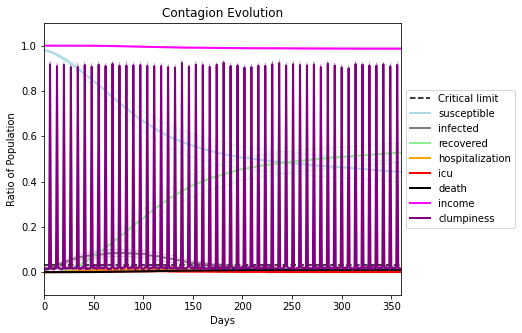

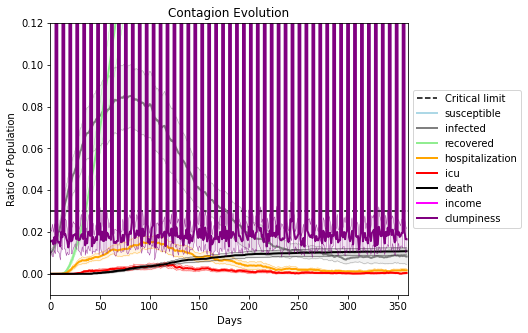

In [38]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6000, 4511, 8304, 9273, 3102, 1248, 3796, 3390, 3019, 2981, 7336, 2253, 2154, 7264, 26, 9413, 3901, 5890, 3913, 9969]
Average similarity between family members is 0.16864151115497175 at temperature -0.2
Average similarity between family and home is 0.9998524791529326 at temperature -1
Average similarity between students and their classroom is 0.15968470611389649 at temperature -0.2
Average classroom occupancy is 3.7746478873239435 and number classrooms is 71
Average similarity between workers is 0.15584809268474925 at temperature -0.2
Average office occupancy is 3.353233830845771 and number offices is 201
Average friend similarity for adults: 0.21075986076121023 for kids: 0.19757406834907856
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.06174831487054915
avg restaurant similarity 0.05435671620392358
avg restaurant similarity 0.10763475751979953
avg restaurant similarity 0.07730311277654155
avg restaurant similarity 0.018198829231736956
avg restaurant similarity 0.040448492828353465
avg restaurant similarity 0.04604301845592609
avg restaurant similarity 0.09422424943771779
avg restaurant similarity 0.03972216593550081
avg restaurant similarity 0.0899863473410991
avg restaurant similarity 0.06819444174937554
avg restaurant similarity 0.03753137903016527
avg restaurant similarity 0.045657541028636214
avg restaurant similarity 0.08592344084358597
avg restaurant similarity 0.05332422282610987
avg restaurant similarity 0.053000187045834105
avg restaurant similarity 0.0437893663131581
avg restaurant similarity 0.08819428084725754
avg restaurant similarity 0.05495970040988047
avg restaurant similarity 0.05285263068444377
avg restaurant similarity 0.10868351122619249
avg restaurant similarity 0.0593

avg restaurant similarity 0.035225626440289606
avg restaurant similarity 0.10848404828121193
avg restaurant similarity 0.06144853486445102
avg restaurant similarity 0.07221536435320848
avg restaurant similarity 0.07936548215697747
avg restaurant similarity 0.04763518118279554
avg restaurant similarity 0.0799072818713778
avg restaurant similarity 0.04204520760597435
avg restaurant similarity 0.045002264567825155
avg restaurant similarity 0.012352499609433671
avg restaurant similarity 0.024541851897409764
avg restaurant similarity 0.033769971898284054
avg restaurant similarity 0.07752005136262541
avg restaurant similarity 0.11437799484503061
avg restaurant similarity 0.06420937798474735
avg restaurant similarity 0.04278437974773557
avg restaurant similarity 0.02550649306576564
avg restaurant similarity 0.019937165585974356
avg restaurant similarity 0.06309831291097509
avg restaurant similarity 0.0014488157199324058
avg restaurant similarity 0.03175018148764184
avg restaurant similarity 0

avg restaurant similarity 0.09684432610382034
avg restaurant similarity 0.03392976248485268
avg restaurant similarity 0.1292174076423884
avg restaurant similarity 0.0764285221211497
avg restaurant similarity 0.03983171587539359
avg restaurant similarity 0.0639183498633224
avg restaurant similarity 0.0817424532782505
avg restaurant similarity 0.09895713406995375
avg restaurant similarity 0.06969314560695652
avg restaurant similarity 0.11107873159017141
avg restaurant similarity 0.10126405186210903
avg restaurant similarity 0.07138413717253042
avg restaurant similarity 0.0981323701422137
avg restaurant similarity 0.12040677095676144
avg restaurant similarity 0.04115369105627042
avg restaurant similarity 0.10113916455490023
avg restaurant similarity 0.06609145930495916
avg restaurant similarity 0.05510047284048829
avg restaurant similarity 0.04229174093571482
avg restaurant similarity 0.05936350954449641
avg restaurant similarity 0.08729093519976706
avg restaurant similarity 0.07970984352

avg restaurant similarity 0.05731737489595022
avg restaurant similarity 0.08132507807260833
avg restaurant similarity 0.10258748274884212
avg restaurant similarity 0.06040375450348621
avg restaurant similarity 0.0454793926884011
avg restaurant similarity 0.1464730243905167
avg restaurant similarity 0.10356165424951753
avg restaurant similarity 0.06989753470912213
avg restaurant similarity 0.07951905231651585
avg restaurant similarity 0.07091477657086612
avg restaurant similarity 0.10023427171963535
avg restaurant similarity 0.07080875960450475
avg restaurant similarity 0.06694707745150325
avg restaurant similarity 0.08600142071618894
avg restaurant similarity 0.044592401652416666
avg restaurant similarity 0.07327273318575081
avg restaurant similarity 0.07671620272158532
avg restaurant similarity 0.04828273153154
avg restaurant similarity 0.10352925674624823
avg restaurant similarity 0.11942327077954831
avg restaurant similarity 0.09725257507528169
avg restaurant similarity 0.0618755758

avg restaurant similarity 0.048722648507761576
avg restaurant similarity 0.005795745001462503
avg restaurant similarity 0.007212572329408545
avg restaurant similarity 0.025800369586852518
avg restaurant similarity 0.04881699330769189
avg restaurant similarity 0.07135492442607107
avg restaurant similarity 0.03936668119350631
avg restaurant similarity 0.010627604895346225
avg restaurant similarity 0.06285621790763231
avg restaurant similarity 0.022258683947397884
avg restaurant similarity 0.007570599128513001
avg restaurant similarity 0.03012836338807818
avg restaurant similarity 0.005030389931534049
avg restaurant similarity 0.03393320390488967
avg restaurant similarity -0.02286891301346864
avg restaurant similarity 0.028105386379610887
avg restaurant similarity 0.046716254968098926
avg restaurant similarity 0.038235054118788046
avg restaurant similarity 0.053709543656633336
avg restaurant similarity 0.04947144877124796
avg restaurant similarity 0.04018066866564851
avg restaurant simila

avg restaurant similarity -0.0078260238464608
avg restaurant similarity 0.017074765054555317
avg restaurant similarity -0.014709298630227277
avg restaurant similarity 0.05938326407031788
avg restaurant similarity 0.02818160877486147
avg restaurant similarity 0.05307084629819707
avg restaurant similarity 0.04617877957906954
avg restaurant similarity 0.03493089879643162
avg restaurant similarity 0.04022329953800838
avg restaurant similarity 0.014475562414019323
avg restaurant similarity 0.06266779125735458
avg restaurant similarity 0.02573896671377421
avg restaurant similarity 0.049145535716568337
avg restaurant similarity 0.03563174612711874
avg restaurant similarity 0.05502832301526778
avg restaurant similarity 0.05308645161540543
avg restaurant similarity -0.017124000890785984
avg restaurant similarity 0.03924269298658108
avg restaurant similarity -0.0033555278585179465
avg restaurant similarity 0.04325577248920485
avg restaurant similarity 0.07138596191800864
avg restaurant similarit

avg restaurant similarity 0.05298242356825566
avg restaurant similarity 0.018086613392223852
avg restaurant similarity 0.04382408794623994
avg restaurant similarity 0.05560693823598627
avg restaurant similarity 0.06448056807866431
avg restaurant similarity 0.05834333675064138
avg restaurant similarity 0.033833663204975536
avg restaurant similarity 0.09179981536785362
avg restaurant similarity 0.0337618758698777
avg restaurant similarity 0.08262748487141719
avg restaurant similarity 0.0551577744586385
avg restaurant similarity 0.07564624980906955
avg restaurant similarity 0.003411802119335578
avg restaurant similarity 0.060245356002618856
avg restaurant similarity 0.06355265707087011
avg restaurant similarity 0.012690238218966607
avg restaurant similarity 0.05187961114205496
avg restaurant similarity 0.09607659484612067
avg restaurant similarity 0.06807880588871434
avg restaurant similarity 0.09545568729457193
avg restaurant similarity 0.0730878150331268
avg restaurant similarity 0.0147

avg restaurant similarity 0.04366057392637586
avg restaurant similarity 0.04033078336056952
avg restaurant similarity 0.06234606978383855
avg restaurant similarity 0.07708899719660994
avg restaurant similarity 0.05470566889875369
avg restaurant similarity 0.09928280068799257
avg restaurant similarity 0.10718894417408166
avg restaurant similarity 0.01393519464275665
avg restaurant similarity 0.0731603425008981
avg restaurant similarity 0.06511239485987137
avg restaurant similarity 0.03624755696242749
avg restaurant similarity 0.05367002030758266
avg restaurant similarity 0.05238768993185682
avg restaurant similarity 0.014477997012653385
avg restaurant similarity 0.02600045950228679
avg restaurant similarity 0.11035292423945926
avg restaurant similarity 0.04770705308693273
avg restaurant similarity 0.05659612449882729
avg restaurant similarity 0.09279093049826392
avg restaurant similarity 0.040797656652029675
avg restaurant similarity 0.08742199312050311
avg restaurant similarity 0.08259

avg restaurant similarity 0.03950716197195712
avg restaurant similarity 0.07522015652560493
avg restaurant similarity 0.034651804333678565
avg restaurant similarity 0.026806406839877787
avg restaurant similarity -0.006780405136131112
avg restaurant similarity 0.029372676169470736
avg restaurant similarity 0.03916489632055454
avg restaurant similarity 0.04607201167727822
avg restaurant similarity 0.07321887420722843
avg restaurant similarity 0.042951602432089314
avg restaurant similarity 0.03227589875753724
avg restaurant similarity 0.049469397398496054
avg restaurant similarity -0.005838617616320593
avg restaurant similarity 0.01581923273120727
avg restaurant similarity 0.08299887113429322
avg restaurant similarity 0.06712988153602456
avg restaurant similarity 0.04717309231819279
avg restaurant similarity 0.030635783605303037
avg restaurant similarity 0.01369793829381482
avg restaurant similarity 0.060668129744268565
avg restaurant similarity 0.022135881292216993
avg restaurant similar

avg restaurant similarity 0.08551511744691971
avg restaurant similarity 0.04862687563418517
avg restaurant similarity 0.06871683712901926
avg restaurant similarity 0.01723303462482779
avg restaurant similarity 0.0994361093482232
avg restaurant similarity 0.07212145837063023
avg restaurant similarity 0.060349684323767395
avg restaurant similarity 0.014280622607310552
avg restaurant similarity 0.02748322851601613
avg restaurant similarity 0.03766543649406134
avg restaurant similarity 0.019878641255314803
avg restaurant similarity 0.006251354523167255
avg restaurant similarity 0.02357816644423715
avg restaurant similarity 0.06442507956245178
avg restaurant similarity 0.05088979573477518
avg restaurant similarity 0.010671636773072979
avg restaurant similarity 0.03780376854793505
avg restaurant similarity 0.029926178869157376
avg restaurant similarity 0.06225303807678282
avg restaurant similarity 0.06561143076984952
avg restaurant similarity 0.035356805585776654
avg restaurant similarity 0.

avg restaurant similarity 0.020304860515071056
avg restaurant similarity 0.07674176348248246
avg restaurant similarity 0.08347291725430324
avg restaurant similarity 0.1360180874321634
avg restaurant similarity 0.10238074798103818
avg restaurant similarity 0.040298737827342515
avg restaurant similarity 0.03924117319980445
avg restaurant similarity 0.1207271597020529
avg restaurant similarity 0.11670123787820712
avg restaurant similarity 0.06673560539609028
avg restaurant similarity 0.05818558338718856
avg restaurant similarity 0.05985691652846948
avg restaurant similarity 0.07203449061813677
avg restaurant similarity 0.09577721293572475
avg restaurant similarity 0.05667142472135784
avg restaurant similarity 0.0685369824483364
avg restaurant similarity 0.07485517930396725
avg restaurant similarity 0.10021094748390665
avg restaurant similarity 0.08444212779600353
avg restaurant similarity 0.08908951470602493
avg restaurant similarity 0.0598119363585354
avg restaurant similarity 0.09418150

avg restaurant similarity 0.05321780661026044
avg restaurant similarity 0.06684083362784206
avg restaurant similarity 0.09270098098011509
avg restaurant similarity 0.055342258967678123
avg restaurant similarity 0.10672972214400783
avg restaurant similarity 0.04023090081671877
avg restaurant similarity 0.09438189224392972
avg restaurant similarity 0.07316827764748847
avg restaurant similarity 0.057244015740284905
avg restaurant similarity 0.06947934257602366
avg restaurant similarity 0.06461511068741731
avg restaurant similarity 0.039470265559585084
avg restaurant similarity 0.05895982714554983
avg restaurant similarity 0.05240265904716654
avg restaurant similarity 0.11270390312938947
avg restaurant similarity 0.09071992263332411
avg restaurant similarity 0.05809587816876511
avg restaurant similarity 0.05808821537587728
avg restaurant similarity 0.09807610117007685
avg restaurant similarity 0.10970726797379783
avg restaurant similarity 0.060942325747958395
avg restaurant similarity 0.06

avg restaurant similarity 0.05792110244568886
avg restaurant similarity 0.11074390264634862
avg restaurant similarity 0.04749968690780591
avg restaurant similarity 0.05613422748127872
avg restaurant similarity -0.006434937560095011
avg restaurant similarity 0.04370588556263515
avg restaurant similarity 0.029864584167901612
avg restaurant similarity 0.029800967428432558
avg restaurant similarity 0.08502598320448561
avg restaurant similarity 0.05546080042040371
avg restaurant similarity 0.062432107349982245
avg restaurant similarity 0.05497172615316924
avg restaurant similarity 0.049389811518288196
avg restaurant similarity 0.08869074003979599
avg restaurant similarity 0.06173317455584877
avg restaurant similarity 0.06113975977725784
avg restaurant similarity 0.07142360000216508
avg restaurant similarity 0.06519633526911782
avg restaurant similarity 0.05380798191430782
avg restaurant similarity 0.058758763766313796
avg restaurant similarity 0.04372841940202648
avg restaurant similarity -

avg restaurant similarity 0.07539568676210784
avg restaurant similarity 0.0028490704581200753
avg restaurant similarity 0.11215622387514403
avg restaurant similarity 0.07843061183928018
avg restaurant similarity 0.07892964669641868
avg restaurant similarity 0.11186765693835508
avg restaurant similarity 0.03334032735067178
avg restaurant similarity -0.0009625555651920429
avg restaurant similarity 0.08018811582573182
avg restaurant similarity 0.016809718473554502
avg restaurant similarity 0.0411324925968118
avg restaurant similarity 0.047375260157535876
avg restaurant similarity 0.07921081000708106
avg restaurant similarity 0.029532253042620752
avg restaurant similarity 0.04407664983254506
avg restaurant similarity 0.09008313527375399
avg restaurant similarity -0.0007036612792978396
avg restaurant similarity 0.05060108889017307
avg restaurant similarity 0.06233173277161943
avg restaurant similarity 0.025284809336893813
avg restaurant similarity -0.022002776707850426
avg restaurant simila

avg restaurant similarity 0.07479778629101076
avg restaurant similarity 0.04591775678129188
avg restaurant similarity 0.011535572109123192
avg restaurant similarity 0.07849676263028571
avg restaurant similarity 0.002367454356692769
avg restaurant similarity 0.009607356070016497
avg restaurant similarity -0.005953717166506475
avg restaurant similarity 0.008201893567891782
avg restaurant similarity 0.04999847465047241
avg restaurant similarity 0.06100402449403046
avg restaurant similarity 0.041921825867826924
avg restaurant similarity 0.036181062729456315
avg restaurant similarity 0.01604289683017758
avg restaurant similarity 0.05843004807599466
avg restaurant similarity 0.04245981366316597
avg restaurant similarity 0.04192256513403225
avg restaurant similarity 0.05756946670968087
avg restaurant similarity 0.047637650922777754
avg restaurant similarity 0.03775446470637886
avg restaurant similarity 0.05273089262005742
avg restaurant similarity 0.053140020277184896
avg restaurant similarit

avg restaurant similarity 0.05391123511460381
avg restaurant similarity 0.046974708924996875
avg restaurant similarity 0.008701992469027175
avg restaurant similarity 0.06375425628707561
avg restaurant similarity 0.05252304120037352
avg restaurant similarity -0.04152466469113617
avg restaurant similarity 0.027417885044583166
avg restaurant similarity 0.07233059269060549
avg restaurant similarity 0.04711943731690572
avg restaurant similarity 0.013316024525813675
avg restaurant similarity 0.005398392182116374
avg restaurant similarity 0.11747762313111487
avg restaurant similarity 0.05422874118850344
avg restaurant similarity 0.05164902665368732
avg restaurant similarity 0.04873248764241018
avg restaurant similarity 0.04382058714177813
avg restaurant similarity 0.02998641867410577
avg restaurant similarity 0.005857928603913806
avg restaurant similarity -0.003007885113133746
avg restaurant similarity 0.055119537358989154
avg restaurant similarity 0.032029662567682256
avg restaurant similari

avg restaurant similarity 0.07102220350738597
avg restaurant similarity 0.054404932889791396
avg restaurant similarity 0.09491247020547378
avg restaurant similarity 0.07160293077187985
avg restaurant similarity 0.07721953052776653
avg restaurant similarity 0.029657853245781966
avg restaurant similarity 0.08006674135322361
avg restaurant similarity 0.0943573405916695
avg restaurant similarity 0.06489046368058123
avg restaurant similarity 0.07155992114162507
avg restaurant similarity 0.031568924432091444
avg restaurant similarity 0.013184734997778504
avg restaurant similarity 0.08288222126506098
avg restaurant similarity 0.05454634395600946
avg restaurant similarity 0.046790751972111966
avg restaurant similarity 0.05272412296200362
avg restaurant similarity 0.027237556226426145
avg restaurant similarity 0.0486665919228757
avg restaurant similarity 0.08801668420772833
avg restaurant similarity 0.040471625289115964
avg restaurant similarity 0.09742456025564634
avg restaurant similarity 0.0

avg restaurant similarity 0.07851890346637339
avg restaurant similarity 0.07232159599755164
avg restaurant similarity 0.027109680993663177
avg restaurant similarity 0.09995693755016608
avg restaurant similarity 0.04116014505283151
avg restaurant similarity 0.09352478647225605
avg restaurant similarity 0.08247036625426736
avg restaurant similarity 0.07526967113968598
avg restaurant similarity 0.02761010375545492
avg restaurant similarity 0.07397160351715584
avg restaurant similarity 0.06798673494509143
avg restaurant similarity 0.07767343533074735
avg restaurant similarity 0.043237548016405336
avg restaurant similarity 0.061170961820687535
avg restaurant similarity 0.08509768551020154
avg restaurant similarity 0.0821107608787218
avg restaurant similarity 0.03724045990630077
avg restaurant similarity 0.10099884151323328
avg restaurant similarity 0.06443659045286532
avg restaurant similarity 0.08678803760884393
avg restaurant similarity 0.0706173604472929
avg restaurant similarity 0.10204

avg restaurant similarity 0.1321289658784752
avg restaurant similarity 0.006368053860443999
avg restaurant similarity 0.07496616715826517
avg restaurant similarity 0.04672726119728317
avg restaurant similarity 0.08148285767753308
avg restaurant similarity 0.04422819877175195
avg restaurant similarity 0.05779772249280831
avg restaurant similarity 0.07851047078859182
avg restaurant similarity 0.05215312613959696
avg restaurant similarity 0.04694503607922125
avg restaurant similarity 0.04254716918749826
avg restaurant similarity 0.03523334750194947
avg restaurant similarity 0.10550336541467127
avg restaurant similarity 0.0860523975869495
avg restaurant similarity 0.07193615273693181
avg restaurant similarity 0.07321261595892795
avg restaurant similarity 0.07483387802091475
avg restaurant similarity 0.05032612959676118
avg restaurant similarity 0.07167436210446157
avg restaurant similarity 0.07521829315250345
avg restaurant similarity 0.07372684580001905
avg restaurant similarity 0.0874952

avg restaurant similarity 0.053976447896289324
avg restaurant similarity -0.002225686209451777
avg restaurant similarity 0.06648264589759507
avg restaurant similarity 0.0875071864082198
avg restaurant similarity 0.08225805340758685
avg restaurant similarity 0.05241251940899029
avg restaurant similarity 0.06116683654139122
avg restaurant similarity 0.029944008403500498
avg restaurant similarity 0.0684995625820796
avg restaurant similarity 0.07780970133360314
avg restaurant similarity 0.09275944255092994
avg restaurant similarity 0.05494081644950272
avg restaurant similarity 0.06129629220632874
avg restaurant similarity 0.04805470674517888
avg restaurant similarity 0.07048640589956771
avg restaurant similarity 0.054586753282950304
avg restaurant similarity 0.00825626321359635
avg restaurant similarity 0.01109614522918333
avg restaurant similarity 0.06384216899881227
avg restaurant similarity 0.05450743915702045
avg restaurant similarity 0.009583398600661971
avg restaurant similarity 0.07

avg restaurant similarity 0.06756459077434487
avg restaurant similarity 0.049679741197616555
avg restaurant similarity 0.11597075483304577
avg restaurant similarity 0.07792061183394748
avg restaurant similarity 0.0617108658773865
avg restaurant similarity 0.1281105148021892
avg restaurant similarity 0.0856411675857924
avg restaurant similarity 0.09294896721419107
avg restaurant similarity 0.07924640251017602
avg restaurant similarity 0.10574604338107628
avg restaurant similarity 0.029742877157143664
avg restaurant similarity 0.054899834008167336
avg restaurant similarity 0.027528410440582494
avg restaurant similarity 0.062311944163523404
avg restaurant similarity 0.05638735315518347
avg restaurant similarity 0.07801081059818621
avg restaurant similarity 0.09762779943722898
avg restaurant similarity 0.10196434297836456
avg restaurant similarity 0.052304305570148604
avg restaurant similarity 0.11793247204345306
avg restaurant similarity 0.03068680113738351
avg restaurant similarity 0.100

avg restaurant similarity 0.0747925505047669
avg restaurant similarity 0.06773181624292979
avg restaurant similarity 0.09337713467779887
avg restaurant similarity 0.045137702940667206
avg restaurant similarity 0.05818729663084946
avg restaurant similarity 0.09106573126279285
avg restaurant similarity 0.03482416237498708
avg restaurant similarity 0.07808080408312801
avg restaurant similarity 0.03587356996446714
avg restaurant similarity 0.061288936310534024
avg restaurant similarity 0.05711015517620696
avg restaurant similarity 0.028564092582090576
avg restaurant similarity 0.0897021831540901
avg restaurant similarity 0.07081698722749857
avg restaurant similarity 0.11367311689299521
avg restaurant similarity 0.08915832789292241
avg restaurant similarity 0.11016733637272845
avg restaurant similarity 0.06943722799529466
avg restaurant similarity 0.09049975929700663
avg restaurant similarity 0.04996557583429901
avg restaurant similarity 0.05068968286499108
avg restaurant similarity 0.07386

avg restaurant similarity 0.09408715324795124
avg restaurant similarity 0.10133542303606566
avg restaurant similarity 0.04925195456364535
avg restaurant similarity 0.07844521739102606
avg restaurant similarity 0.11256152661800699
avg restaurant similarity 0.07100171907099835
avg restaurant similarity 0.08843477039205805
avg restaurant similarity 0.11672383186029574
avg restaurant similarity 0.08382321618732744
avg restaurant similarity 0.0610400134745203
avg restaurant similarity 0.062007660950321494
avg restaurant similarity 0.028243415024922624
avg restaurant similarity 0.07617258456676734
avg restaurant similarity 0.084601601256119
avg restaurant similarity 0.07927393110841885
avg restaurant similarity 0.06429328315920924
avg restaurant similarity 0.07187546487105587
avg restaurant similarity 0.047574815110030116
avg restaurant similarity 0.053908943717376555
avg restaurant similarity 0.06109623339738856
avg restaurant similarity 0.015766246753115935
avg restaurant similarity 0.0346

avg restaurant similarity 0.06485291969739627
avg restaurant similarity 0.0332931075139916
avg restaurant similarity 0.12007538408163974
avg restaurant similarity 0.11828197131003411
avg restaurant similarity 0.07070692056516784
avg restaurant similarity 0.12076731252398064
avg restaurant similarity -0.0006661062643036541
avg restaurant similarity 0.08507515696667681
avg restaurant similarity 0.07960453823798026
avg restaurant similarity 0.1121577935742775
avg restaurant similarity 0.06941031972370873
avg restaurant similarity 0.034090775372265326
avg restaurant similarity 0.1285162362339907
avg restaurant similarity 0.05906639958874062
avg restaurant similarity 0.06984661181912415
avg restaurant similarity 0.092161671745053
avg restaurant similarity 0.055282402664404616
avg restaurant similarity 0.09475271518864814
avg restaurant similarity 0.06372378037051063
avg restaurant similarity 0.05937161073391658
avg restaurant similarity 0.0069164082277301765
avg restaurant similarity 0.0563

avg restaurant similarity 0.011389765621676923
avg restaurant similarity 0.08455655420449226
avg restaurant similarity 0.007058202953508552
avg restaurant similarity 0.021006753678524545
avg restaurant similarity 0.0008085041965986764
avg restaurant similarity 0.027328383941933168
avg restaurant similarity 0.034204817828411845
avg restaurant similarity 0.023323921187753015
avg restaurant similarity 0.04077725845757995
avg restaurant similarity 0.05054966280151711
avg restaurant similarity 0.03526781736546957
avg restaurant similarity 0.04842687867622209
avg restaurant similarity 0.031817643382539056
avg restaurant similarity 0.0980534534471719
avg restaurant similarity 0.06382242367140821
avg restaurant similarity 0.05047094811444504
avg restaurant similarity 0.07865897809181335
avg restaurant similarity 0.0736230740566691
avg restaurant similarity 0.10551000176464034
avg restaurant similarity 0.007613433532433353
avg restaurant similarity 0.04360529857761466
avg restaurant similarity 

avg restaurant similarity 0.025521575968728043
avg restaurant similarity 0.07104394176460353
avg restaurant similarity 0.06909244831394024
avg restaurant similarity 0.06814471290791393
avg restaurant similarity 0.007414285427379383
avg restaurant similarity 0.013955303363277601
avg restaurant similarity 0.052737623254395946
avg restaurant similarity 0.0878274151685481
avg restaurant similarity 0.04610915516036152
avg restaurant similarity 0.07419315748479993
avg restaurant similarity 0.09825252116998498
avg restaurant similarity 0.07532806035720342
avg restaurant similarity 0.019242205861209286
avg restaurant similarity 0.0526969606626611
avg restaurant similarity 0.07297605545859522
avg restaurant similarity 0.07459870744017026
avg restaurant similarity 0.07342976183134997
avg restaurant similarity 0.04732980205362258
avg restaurant similarity 0.033935183588490854
avg restaurant similarity 0.04566083097930285
avg restaurant similarity 0.09003368216811364
avg restaurant similarity 0.03

avg restaurant similarity 0.1272296618335935
avg restaurant similarity 0.08897939266869778
avg restaurant similarity 0.11128849606111232
avg restaurant similarity 0.10552304963608163
avg restaurant similarity 0.048623941947768846
avg restaurant similarity 0.12162495716162999
avg restaurant similarity 0.013065934495676248
avg restaurant similarity 0.06209589378167194
avg restaurant similarity 0.0003608836981199477
avg restaurant similarity 0.024843478964294806
avg restaurant similarity 0.08462191056840461
avg restaurant similarity 0.08429419272718082
avg restaurant similarity 0.07907098368346639
avg restaurant similarity 0.045190579639243
avg restaurant similarity 0.08173767599420913
avg restaurant similarity 0.07000264115176932
avg restaurant similarity 0.09792825115916684
avg restaurant similarity 0.10037572339649842
avg restaurant similarity 0.027370589279586424
avg restaurant similarity 0.09165605744313783
avg restaurant similarity 0.08104190658763796
avg restaurant similarity 0.067

avg restaurant similarity 0.08504341006645062
avg restaurant similarity 0.13468050083729716
avg restaurant similarity 0.019473175907695595
avg restaurant similarity 0.041732105236327185
avg restaurant similarity 0.05947783435201305
avg restaurant similarity 0.07466698338967917
avg restaurant similarity 0.06594963146573318
avg restaurant similarity 0.06784506670721721
avg restaurant similarity 0.09603743919171305
avg restaurant similarity 0.10606573624454782
avg restaurant similarity 0.05927582410934511
avg restaurant similarity 0.10637691585874545
avg restaurant similarity 0.09589281017958674
avg restaurant similarity 0.12093098956781136
avg restaurant similarity 0.11675559658639745
avg restaurant similarity 0.032185526736189365
avg restaurant similarity 0.08978965887095984
avg restaurant similarity 0.1176678888113786
avg restaurant similarity 0.09156295681011056
avg restaurant similarity -0.026054373929065004
avg restaurant similarity 0.06983615764852802
avg restaurant similarity 0.10

avg restaurant similarity 0.03467307111245462
avg restaurant similarity 0.024892798104995183
avg restaurant similarity 0.0831438818147414
avg restaurant similarity 0.07771289305512108
avg restaurant similarity 0.037098865786790884
avg restaurant similarity 0.07635616440932468
avg restaurant similarity 0.03360131090216901
avg restaurant similarity 0.10168553573333346
avg restaurant similarity 0.0496115042987756
avg restaurant similarity 0.032842161597312944
avg restaurant similarity 0.05253332047225657
avg restaurant similarity 0.12839486572554754
avg restaurant similarity 0.06975167964125686
avg restaurant similarity 0.0580115208540092
avg restaurant similarity 0.047195144300391234
avg restaurant similarity 0.02302613478343041
avg restaurant similarity 0.03941745669698603
avg restaurant similarity 0.05238999451457432
avg restaurant similarity 0.030580005391867046
avg restaurant similarity 0.06707298298819325
avg restaurant similarity 0.075880038434106
avg restaurant similarity 0.040014

avg restaurant similarity 0.04565898658217355
avg restaurant similarity 0.010299139946205713
avg restaurant similarity 0.05588474823722066
avg restaurant similarity 0.06019024008902551
avg restaurant similarity 0.047749514049949655
avg restaurant similarity 0.033611229696556305
avg restaurant similarity 0.06735098399356473
avg restaurant similarity 0.071430788861088
avg restaurant similarity 0.026383419411920322
avg restaurant similarity 0.09678771651253136
avg restaurant similarity 0.074670128135315
avg restaurant similarity 0.06727191516216398
avg restaurant similarity 0.0831663298895786
avg restaurant similarity 0.037381413475937375
avg restaurant similarity 0.08793820188306473
avg restaurant similarity 0.0426600319660069
avg restaurant similarity 0.042645236971766975
avg restaurant similarity 0.06337817712822832
avg restaurant similarity 0.027238669483234553
avg restaurant similarity 0.015748293682271045
avg restaurant similarity 0.057054598603753795
avg restaurant similarity 0.045

avg restaurant similarity 0.057180112734881605
avg restaurant similarity 0.048125981726888215
avg restaurant similarity 0.06418738003380561
avg restaurant similarity 0.08700474572546325
avg restaurant similarity 0.056996968121650254
avg restaurant similarity 0.0457570599854729
avg restaurant similarity 0.10940080566915968
avg restaurant similarity 0.08769869010215618
avg restaurant similarity 0.07564691627580541
avg restaurant similarity 0.06598443739662857
avg restaurant similarity 0.1157240068434049
avg restaurant similarity 0.03353400267491784
avg restaurant similarity 0.0579178210872184
avg restaurant similarity 0.1148069241280083
avg restaurant similarity 0.09443409692447645
avg restaurant similarity 0.10973954795515052
avg restaurant similarity 0.07091051967971472
avg restaurant similarity 0.07831423317244962
avg restaurant similarity 0.08059908536227807
avg restaurant similarity 0.0786253715639846
avg restaurant similarity 0.07468349263712033
avg restaurant similarity 0.07417518

avg restaurant similarity 0.05779106416910347
avg restaurant similarity 0.07624436850097191
avg restaurant similarity 0.05423918161276111
avg restaurant similarity 0.08294872957173086
avg restaurant similarity 0.016266297913750165
avg restaurant similarity 0.04226344530676506
avg restaurant similarity 0.07858131410541158
avg restaurant similarity 0.08098265588634623
avg restaurant similarity 0.014376562909181287
avg restaurant similarity 0.040179649167116485
avg restaurant similarity 0.028063662856269062
avg restaurant similarity 0.04564270698733206
avg restaurant similarity 0.11937645870643697
avg restaurant similarity 0.08330871751571826
avg restaurant similarity 0.09670450510454892
avg restaurant similarity 0.11596380003545315
avg restaurant similarity 0.05320294532816484
avg restaurant similarity 0.07026665328267717
avg restaurant similarity 0.06825422015873181
avg restaurant similarity 0.00983520702425397
avg restaurant similarity 0.07676312984057247
avg restaurant similarity 0.03

avg restaurant similarity 0.061509501035028315
avg restaurant similarity 0.02831676374988102
avg restaurant similarity 0.059573851297843934
avg restaurant similarity 0.0498691202569512
avg restaurant similarity 0.04690767364108539
avg restaurant similarity 0.0310277578582471
avg restaurant similarity 0.09911791334805146
avg restaurant similarity 0.04027379674164577
avg restaurant similarity 0.06471258978260751
avg restaurant similarity 0.029822039109484215
avg restaurant similarity 0.05496659363724192
avg restaurant similarity 0.09544565655378376
avg restaurant similarity 0.016939983857931124
avg restaurant similarity 0.055916098458654036
avg restaurant similarity 0.08151498460488323
avg restaurant similarity 0.09990587145267484
avg restaurant similarity 0.08181754453432132
avg restaurant similarity 0.06864760672908264
avg restaurant similarity 0.04410501957097152
avg restaurant similarity 0.04608202602429334
avg restaurant similarity 0.0417156267509925
avg restaurant similarity 0.0857

avg restaurant similarity 0.09247551438414783
avg restaurant similarity 0.04490861612954709
avg restaurant similarity 0.08050855393171033
avg restaurant similarity 0.07439836233294547
avg restaurant similarity 0.10176786201713842
avg restaurant similarity 0.06908760508881573
avg restaurant similarity 0.031971499261169156
avg restaurant similarity 0.0394709344795644
avg restaurant similarity 0.04213268243049329
avg restaurant similarity 0.04124155478740429
avg restaurant similarity 0.043833521384619475
avg restaurant similarity 0.07995882367139026
avg restaurant similarity 0.05154863947753994
avg restaurant similarity 0.07106124030580162
avg restaurant similarity 0.06828207218725725
avg restaurant similarity 0.05151465681521088
avg restaurant similarity 0.03356940966788392
avg restaurant similarity 0.0872793270203016
avg restaurant similarity 0.04392436803637246
avg restaurant similarity 0.022497987117497925
avg restaurant similarity 0.13668433949698805
avg restaurant similarity 0.07598

avg restaurant similarity 0.0750980640530806
avg restaurant similarity 0.05800637850544214
avg restaurant similarity 0.0633997910280315
avg restaurant similarity 0.10328911596985624
avg restaurant similarity 0.052413505002784286
avg restaurant similarity 0.03820954107270795
avg restaurant similarity 0.05047513406298697
avg restaurant similarity 0.0712678193641333
avg restaurant similarity 0.04893615768804517
avg restaurant similarity 0.08054174563078828
avg restaurant similarity 0.09788426661259494
avg restaurant similarity 0.10475054594730782
avg restaurant similarity 0.08151001865140506
avg restaurant similarity 0.09265525999919069
avg restaurant similarity 0.09026067315752026
avg restaurant similarity 0.09227735404264904
avg restaurant similarity 0.10013965174797433
avg restaurant similarity 0.092545894546164
avg restaurant similarity 0.0933430263872043
avg restaurant similarity 0.07376458240618505
avg restaurant similarity 0.07278038336070938
avg restaurant similarity 0.13441495324

avg restaurant similarity 0.0672251186192771
avg restaurant similarity 0.10007175278167275
avg restaurant similarity 0.09062305949989967
avg restaurant similarity 0.043918917603327855
avg restaurant similarity 0.06134412935820138
avg restaurant similarity 0.08281535302818854
avg restaurant similarity 0.032395895458826394
avg restaurant similarity 0.0899953546240566
avg restaurant similarity 0.07800537601800092
avg restaurant similarity 0.08613224027254202
avg restaurant similarity 0.08335046471926606
avg restaurant similarity 0.13763139739032137
avg restaurant similarity 0.058416604625379204
avg restaurant similarity 0.02146938111400225
avg restaurant similarity 0.03672655231609414
avg restaurant similarity -0.0013259440766719161
avg restaurant similarity 0.07057936877143654
avg restaurant similarity 0.04663970032369764
avg restaurant similarity 0.047678353989696665
avg restaurant similarity 0.06506005767980817
avg restaurant similarity 0.07848016630066304
avg restaurant similarity 0.0

avg restaurant similarity 0.06112080859557513
avg restaurant similarity 0.043915538936160306
avg restaurant similarity 0.07293096761850713
avg restaurant similarity 0.05500577282516031
avg restaurant similarity 0.0559134918776437
avg restaurant similarity 0.02780090408364859
avg restaurant similarity 0.06651020930054846
avg restaurant similarity 0.045643784721186256
avg restaurant similarity 0.06787531406689357
avg restaurant similarity 0.06877971160264452
avg restaurant similarity 0.025391505343110254
avg restaurant similarity 0.07122729286502166
avg restaurant similarity 0.02825148489413979
avg restaurant similarity 0.051232233996158484
avg restaurant similarity 0.08254300777026802
avg restaurant similarity 0.03920054548230981
avg restaurant similarity 0.056721110656308416
avg restaurant similarity 0.058191003328760434
avg restaurant similarity 0.08008003751417629
avg restaurant similarity 0.05118997275474795
avg restaurant similarity 0.10056310560209915
avg restaurant similarity 0.0

avg restaurant similarity 0.07521368798026502
avg restaurant similarity 0.11094657939320503
avg restaurant similarity 0.09724539923562074
avg restaurant similarity 0.012194597873603594
avg restaurant similarity 0.03723141057151841
avg restaurant similarity 0.06005212931160303
avg restaurant similarity 0.06635974973114478
avg restaurant similarity 0.08711052343110547
avg restaurant similarity 0.08871773947017438
avg restaurant similarity 0.060920555680880874
avg restaurant similarity 0.06903383925966636
avg restaurant similarity 0.018199763768854176
avg restaurant similarity 0.03408712525912
avg restaurant similarity 0.09444253931955415
avg restaurant similarity 0.0630894453199088
avg restaurant similarity 0.08873000266464871
avg restaurant similarity 0.08718946756162918
avg restaurant similarity 0.07827177085088452
avg restaurant similarity 0.09126840673606812
avg restaurant similarity 0.06005433138902559
avg restaurant similarity 0.1048562710892425
avg restaurant similarity 0.10024980

avg restaurant similarity -0.02900544018311337
avg restaurant similarity 0.04072921812088953
avg restaurant similarity 0.06317285201954906
avg restaurant similarity 0.02653145697452993
avg restaurant similarity 0.07162747725397493
avg restaurant similarity 0.008645935032739244
avg restaurant similarity 0.014309086784995607
avg restaurant similarity 0.04965517390261511
avg restaurant similarity 0.02647394609993715
avg restaurant similarity 0.054648155956088046
avg restaurant similarity 0.03363717636283061
avg restaurant similarity 0.04252875609561386
avg restaurant similarity 0.04225129628618196
avg restaurant similarity 0.03509131085760851
avg restaurant similarity 0.021080738230115848
avg restaurant similarity -0.027003868742397245
avg restaurant similarity 0.07279027153466781
avg restaurant similarity 0.07603813661599813
avg restaurant similarity 0.031197879977396464
avg restaurant similarity 0.044056775655201455
avg restaurant similarity -0.004456945985596602
avg restaurant similari

avg restaurant similarity 0.04241110016346321
avg restaurant similarity 0.09338017738161598
avg restaurant similarity 0.06747938353635087
avg restaurant similarity 0.0370554440304233
avg restaurant similarity 0.016208910444712055
avg restaurant similarity 0.053828444051086916
avg restaurant similarity 0.058115139151181085
avg restaurant similarity 0.02686031616302499
avg restaurant similarity 0.06078726602769927
avg restaurant similarity -0.0009796811689301028
avg restaurant similarity 0.02305937347873754
avg restaurant similarity 0.043742265697429845
avg restaurant similarity 0.045925647507867075
avg restaurant similarity 0.04029952673321521
avg restaurant similarity 0.04243632210597932
avg restaurant similarity 0.04583924557476743
avg restaurant similarity -0.002670915116034087
avg restaurant similarity 0.04622906101684049
avg restaurant similarity 0.0075643980589466375
avg restaurant similarity 0.030726121377528986
avg restaurant similarity 0.037245268580835204
avg restaurant simila

(<function dict.items>, <function dict.items>, <function dict.items>)

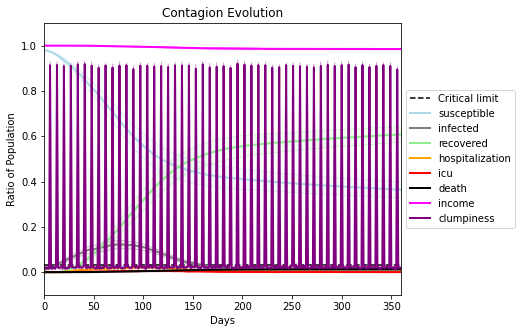

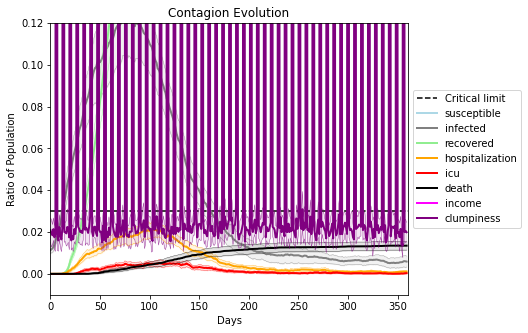

In [39]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[419, 3167, 8391, 9543, 6002, 8539, 8808, 9991, 9765, 7289, 9175, 1595, 969, 9454, 6970, 9058, 5153, 6043, 372, 1615]
Average similarity between family members is 0.16265181290583272 at temperature -0.1
Average similarity between family and home is 0.9998563345178005 at temperature -1
Average similarity between students and their classroom is 0.18052944371885973 at temperature -0.1
Average classroom occupancy is 4.242857142857143 and number classrooms is 70
Average similarity between workers is 0.16367810417543466 at temperature -0.1
Average office occupancy is 3.284974093264249 and number offices is 193
Average friend similarity for adults: 0.2111520292556393 for kids: 0.20378768514928597
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.04502518674355122
avg restaurant similarity 0.030243555200783413
avg restaurant similarity 0.07596528120000454
avg restaurant similarity 0.04274345900804664
avg restaurant similarity 0.06072888339226299
avg restaurant similarity 0.07644805699773873
avg restaurant similarity 0.06520918745215287
avg restaurant similarity 0.06731869359968999
avg restaurant similarity 0.04067485628597523
avg restaurant similarity 0.03669568692809141
avg restaurant similarity 0.07477226920467502
avg restaurant similarity 0.07740459961367069
avg restaurant similarity 0.028300717373095877
avg restaurant similarity 0.03669317451298083
avg restaurant similarity 0.027784505556912184
avg restaurant similarity 0.048588417574338204
avg restaurant similarity 0.03879283006706148
avg restaurant similarity 0.0021171908776611583
avg restaurant similarity 0.07236072259481287
avg restaurant similarity 0.0885515482217511
avg restaurant similarity 0.05051927325915034
avg restaurant similarity 0.0

avg restaurant similarity 0.07056243611506072
avg restaurant similarity 0.04828720069346313
avg restaurant similarity 0.018927790398561534
avg restaurant similarity 0.06210439802522445
avg restaurant similarity 0.030080252378931634
avg restaurant similarity 0.035979599591856246
avg restaurant similarity 0.10128002056307027
avg restaurant similarity 0.06049071114158295
avg restaurant similarity 0.055138515714711456
avg restaurant similarity 0.07491838731788047
avg restaurant similarity 0.07357941798983504
avg restaurant similarity 0.042935372055546664
avg restaurant similarity 0.06275344788849194
avg restaurant similarity 0.04792066977158443
avg restaurant similarity 0.06369047578850781
avg restaurant similarity 0.016550749542273233
avg restaurant similarity 0.04991235339749214
avg restaurant similarity 0.07652382396035043
avg restaurant similarity 0.06429537362510204
avg restaurant similarity 0.048768910615623266
avg restaurant similarity 0.054212188671412045
avg restaurant similarity 

avg restaurant similarity 0.07356635202366084
avg restaurant similarity 0.04983766556807181
avg restaurant similarity 0.027133892705059188
avg restaurant similarity 0.056622705619047656
avg restaurant similarity 0.051740518477365
avg restaurant similarity 0.04436341827409653
avg restaurant similarity 0.04122901353350252
avg restaurant similarity 0.07267721418618994
avg restaurant similarity 0.037610788042221545
avg restaurant similarity 0.012913453027631345
avg restaurant similarity 0.045050230280212426
avg restaurant similarity 0.0349787882031392
avg restaurant similarity 0.102623510388816
avg restaurant similarity 0.10187783158953621
avg restaurant similarity 0.062072217556773376
avg restaurant similarity 0.061948331612325214
avg restaurant similarity 0.08612213451369806
avg restaurant similarity 0.018347862363523523
avg restaurant similarity 0.052584211321151354
avg restaurant similarity 0.06647412983538054
avg restaurant similarity 0.1295996651170316
avg restaurant similarity 0.076

avg restaurant similarity 0.03731893003701814
avg restaurant similarity 0.11229582825939878
avg restaurant similarity 0.05892887045264583
avg restaurant similarity 0.060752918300452666
avg restaurant similarity 0.040894135527634004
avg restaurant similarity 0.03781226687809989
avg restaurant similarity 0.06855804619565999
avg restaurant similarity 0.11768924387227449
avg restaurant similarity 0.09602915801036072
avg restaurant similarity 0.03690300813416445
avg restaurant similarity 0.04631989026358637
avg restaurant similarity 0.03429084288518815
avg restaurant similarity 0.042966549715537185
avg restaurant similarity 0.05812507174732185
avg restaurant similarity 0.04669932606579687
avg restaurant similarity 0.05689068184395739
avg restaurant similarity 0.04651136475656276
avg restaurant similarity 0.06737153789409277
avg restaurant similarity 0.05326904621219817
avg restaurant similarity 0.06632941942673419
avg restaurant similarity 0.03241495572723883
avg restaurant similarity 0.100

avg restaurant similarity 0.06354596692282544
avg restaurant similarity 0.05932139682657586
avg restaurant similarity 0.023609275991614376
avg restaurant similarity 0.09076444600938444
avg restaurant similarity 0.04517032772321706
avg restaurant similarity 0.1358722925217211
avg restaurant similarity 0.05691750528292767
avg restaurant similarity 0.03304997030190612
avg restaurant similarity 0.04962227280535775
avg restaurant similarity 0.06100880201907383
avg restaurant similarity 0.03313836153574746
avg restaurant similarity 0.07334740244624562
avg restaurant similarity 0.07255370354300757
avg restaurant similarity 0.044098516983268124
avg restaurant similarity 0.0856059828963465
avg restaurant similarity 0.05690114556917788
avg restaurant similarity 0.06723191263595149
avg restaurant similarity 0.08533753329591932
avg restaurant similarity 0.09295374149712453
avg restaurant similarity 0.08177039774519923
avg restaurant similarity 0.01990643935446124
avg restaurant similarity 0.045623

avg restaurant similarity 0.04371171745239381
avg restaurant similarity 0.050842510346803656
avg restaurant similarity 0.07775719990634551
avg restaurant similarity 0.04896558192372532
avg restaurant similarity 0.07949760488251625
avg restaurant similarity 0.05911601997570916
avg restaurant similarity 0.05088825496835815
avg restaurant similarity 0.1048675424921723
avg restaurant similarity 0.06966396428453127
avg restaurant similarity 0.05097170906782974
avg restaurant similarity 0.049543363181189466
avg restaurant similarity 0.04209928686390327
avg restaurant similarity 0.06613727952182652
avg restaurant similarity 0.028811487846705893
avg restaurant similarity 0.09610808559950028
avg restaurant similarity 0.04117868850482296
avg restaurant similarity 0.03138007476292674
avg restaurant similarity 0.06363153294948729
avg restaurant similarity 0.039910605508382754
avg restaurant similarity 0.05139855403963212
avg restaurant similarity 0.07003943061481575
avg restaurant similarity 0.071

avg restaurant similarity 0.05709964227592579
avg restaurant similarity 0.06293784187856433
avg restaurant similarity 0.06822157846415682
avg restaurant similarity 0.045973259134984935
avg restaurant similarity 0.05792790435429877
avg restaurant similarity 0.03879080726589285
avg restaurant similarity 0.07659668861193893
avg restaurant similarity 0.09890127431315711
avg restaurant similarity 0.06922177363387863
avg restaurant similarity 0.06993450321277143
avg restaurant similarity 0.030772218816402772
avg restaurant similarity 0.05023841593160752
avg restaurant similarity 0.1047913185709281
avg restaurant similarity 0.10758328193538905
avg restaurant similarity 0.07321624111973767
avg restaurant similarity 0.05782577746014158
avg restaurant similarity 0.02848714211237839
avg restaurant similarity 0.012607913395506324
avg restaurant similarity 0.04811320362590199
avg restaurant similarity 0.07393909871284188
avg restaurant similarity 0.09769792494587118
avg restaurant similarity 0.0917

avg restaurant similarity 0.06312447779237618
avg restaurant similarity 0.05454096322162106
avg restaurant similarity 0.10262056691842514
avg restaurant similarity 0.07628808017152884
avg restaurant similarity 0.08418238027806108
avg restaurant similarity 0.08096179639525355
avg restaurant similarity 0.06889217823928938
avg restaurant similarity 0.004116763694527992
avg restaurant similarity 0.08204060114733712
avg restaurant similarity 0.06386610646132776
avg restaurant similarity 0.0882604193923578
avg restaurant similarity 0.08366873002642561
avg restaurant similarity 0.08593952582044646
avg restaurant similarity 0.0531224155790585
avg restaurant similarity 0.05349102267383553
avg restaurant similarity 0.05421102585672421
avg restaurant similarity 0.04597373071869502
avg restaurant similarity 0.10711927336096197
avg restaurant similarity 0.08673044633426899
avg restaurant similarity 0.023320427713680515
avg restaurant similarity 0.04558022805614861
avg restaurant similarity 0.103812

avg restaurant similarity 0.034440436922976214
avg restaurant similarity 0.02828832444981181
avg restaurant similarity 0.03505474824730804
avg restaurant similarity 0.05431843456026035
avg restaurant similarity 0.09023689347692591
avg restaurant similarity 0.06035711505030106
avg restaurant similarity 0.06834324348231474
avg restaurant similarity 0.0680260250093685
avg restaurant similarity 0.07204248905383101
avg restaurant similarity 0.0739729936001446
avg restaurant similarity 0.03640192377448966
avg restaurant similarity 0.0216058293723186
avg restaurant similarity 0.04156272832363735
avg restaurant similarity 0.09403189212237661
avg restaurant similarity 0.06518311645740081
avg restaurant similarity 0.05140462755074355
avg restaurant similarity 0.10926197772668923
avg restaurant similarity 0.08670243971061575
avg restaurant similarity 0.0549364902611681
avg restaurant similarity 0.006614824293468732
avg restaurant similarity 0.07654544633877275
avg restaurant similarity 0.04407923

avg restaurant similarity 0.016966889548754673
avg restaurant similarity 0.021696843778994182
avg restaurant similarity 0.046665718251224036
avg restaurant similarity 0.041989666615967404
avg restaurant similarity 0.057612955744838205
avg restaurant similarity 0.049635630865758264
avg restaurant similarity 0.08601083882967661
avg restaurant similarity 0.05968777899127028
avg restaurant similarity 0.07706117234614697
avg restaurant similarity 0.10419470260080545
avg restaurant similarity 0.062063829651038294
avg restaurant similarity 0.06326372675249997
avg restaurant similarity 0.03148778475054301
avg restaurant similarity 0.0329117406182534
avg restaurant similarity 0.04925287709177512
avg restaurant similarity 0.05936319584120265
avg restaurant similarity 0.08887545625055805
avg restaurant similarity 0.07066728231312841
avg restaurant similarity 0.04317463387616923
avg restaurant similarity 0.07251191071234023
avg restaurant similarity 0.03063225286519197
avg restaurant similarity 0.

avg restaurant similarity 0.0760311703345402
avg restaurant similarity 0.05468451125731119
avg restaurant similarity 0.03436133044604031
avg restaurant similarity 0.0668373264047937
avg restaurant similarity 0.05414515187588805
avg restaurant similarity 0.07285615698078898
avg restaurant similarity 0.11632391062410452
avg restaurant similarity 0.06364529362244929
avg restaurant similarity 0.05055187610969265
avg restaurant similarity 0.04576504959640259
avg restaurant similarity 0.07528926359842192
avg restaurant similarity 0.0760912418127555
avg restaurant similarity 0.15374841642808015
avg restaurant similarity 0.0639785049657202
avg restaurant similarity 0.11183978275783041
avg restaurant similarity 0.0783260356886146
avg restaurant similarity 0.06495977363678979
avg restaurant similarity 0.04036925321288968
avg restaurant similarity 0.035593856683610973
avg restaurant similarity 0.10596307721375971
avg restaurant similarity 0.053767277342455934
avg restaurant similarity 0.038393741

avg restaurant similarity 0.015988521290971003
avg restaurant similarity 0.05384262008592293
avg restaurant similarity 0.09960105052084389
avg restaurant similarity 0.09720871123314574
avg restaurant similarity 0.10061427376644515
avg restaurant similarity 0.10177553563725077
avg restaurant similarity 0.06801218401942101
avg restaurant similarity 0.06575976302283956
avg restaurant similarity 0.10456338209271133
avg restaurant similarity 0.11767739163917856
avg restaurant similarity 0.0841083096589471
avg restaurant similarity 0.050011640166058476
avg restaurant similarity 0.08638868949732138
avg restaurant similarity 0.07692020880161357
avg restaurant similarity 0.07891730825081962
avg restaurant similarity 0.10869970879145824
avg restaurant similarity 0.09767119380786546
avg restaurant similarity 0.041063700022968455
avg restaurant similarity 0.09192505510713568
avg restaurant similarity 0.04545334651840622
avg restaurant similarity 0.07538080994096458
avg restaurant similarity 0.0741

avg restaurant similarity 0.05875559972776528
avg restaurant similarity 0.08845946318678072
avg restaurant similarity 0.04941441032242015
avg restaurant similarity 0.04458112690413879
avg restaurant similarity 0.014533999991955199
avg restaurant similarity 0.027717188350167295
avg restaurant similarity 0.07734621208932048
avg restaurant similarity 0.06757923037617489
avg restaurant similarity 0.062041793446131
avg restaurant similarity 0.05138098568986684
avg restaurant similarity 0.0063573095418431366
avg restaurant similarity 0.08847614357185438
avg restaurant similarity 0.09108056645974094
avg restaurant similarity 0.07148856681131191
avg restaurant similarity 0.02530539076874877
avg restaurant similarity 0.04843347950982339
avg restaurant similarity 0.05216261228403993
avg restaurant similarity 0.0970292380390041
avg restaurant similarity 0.05249910607167549
avg restaurant similarity -0.00047853438546008716
avg restaurant similarity 0.033852657160286716
avg restaurant similarity 0.

avg restaurant similarity 0.014482282420220085
avg restaurant similarity 0.049954546142190685
avg restaurant similarity 0.06212009476795348
avg restaurant similarity 0.14102074476803153
avg restaurant similarity 0.05363491842804514
avg restaurant similarity 0.0448586482673365
avg restaurant similarity 0.0764532336235163
avg restaurant similarity 0.08027088356734222
avg restaurant similarity 0.02431675551419186
avg restaurant similarity 0.07962261873172681
avg restaurant similarity 0.07691197696006566
avg restaurant similarity 0.05732300320264658
avg restaurant similarity 0.030715767061478823
avg restaurant similarity 0.07203199228963651
avg restaurant similarity -0.00806099648157827
avg restaurant similarity 0.048458393121811036
avg restaurant similarity 0.04699474016973267
avg restaurant similarity 0.0735884873736989
avg restaurant similarity 0.0325571582687946
avg restaurant similarity 0.12117669549503948
avg restaurant similarity 0.10198045675419305
avg restaurant similarity 0.09895

avg restaurant similarity 0.047157256512464926
avg restaurant similarity 0.07637749182685653
avg restaurant similarity 0.05160107265769613
avg restaurant similarity 0.08403338114956879
avg restaurant similarity 0.031077005372298815
avg restaurant similarity 0.051038757971868555
avg restaurant similarity 0.08013634723188705
avg restaurant similarity 0.04606463990809451
avg restaurant similarity 0.044445693491563826
avg restaurant similarity 0.06412067707079758
avg restaurant similarity 0.0918018028737023
avg restaurant similarity 0.033430591280142835
avg restaurant similarity 0.12953193121910891
avg restaurant similarity 0.030549340065244124
avg restaurant similarity 0.11625278358591384
avg restaurant similarity 0.13307130854347124
avg restaurant similarity 0.061492790759744016
avg restaurant similarity 0.020853910077350147
avg restaurant similarity 0.1181173740261964
avg restaurant similarity 0.08560584087814972
avg restaurant similarity 0.05592487730991932
avg restaurant similarity 0.

avg restaurant similarity 0.10598269501401616
avg restaurant similarity 0.04082671964058432
avg restaurant similarity 0.05324984596387345
avg restaurant similarity 0.13707849479975767
avg restaurant similarity 0.11808594406979213
avg restaurant similarity 0.08099273600000524
avg restaurant similarity 0.046308723349469144
avg restaurant similarity 0.06788063960010969
avg restaurant similarity 0.0669496810492331
avg restaurant similarity 0.10962041230823735
avg restaurant similarity 0.08194824910840882
avg restaurant similarity 0.06951028510320806
avg restaurant similarity 0.04564437117073722
avg restaurant similarity 0.10174947213751273
avg restaurant similarity 0.11940212082922681
avg restaurant similarity 0.05631104515431859
avg restaurant similarity 0.0923364004728084
avg restaurant similarity 0.10355895861119728
avg restaurant similarity 0.05844609715107612
avg restaurant similarity 0.08318006019563788
avg restaurant similarity 0.08747808727649778
avg restaurant similarity 0.0486796

avg restaurant similarity 0.056584426915781416
avg restaurant similarity 0.11026456438687826
avg restaurant similarity 0.0774657043659353
avg restaurant similarity 0.03976211122188896
avg restaurant similarity 0.10132849012252676
avg restaurant similarity 0.06829700097256802
avg restaurant similarity 0.06888614539032112
avg restaurant similarity 0.06679461066975015
avg restaurant similarity 0.02397570185485274
avg restaurant similarity 0.07153767598323654
avg restaurant similarity 0.08349289053663865
avg restaurant similarity 0.09965128151182327
avg restaurant similarity 0.1166502441429235
avg restaurant similarity 0.06153567241197001
avg restaurant similarity 0.04732819716583393
avg restaurant similarity 0.02543532049305557
avg restaurant similarity 0.07755580285722298
avg restaurant similarity 0.11441333886595087
avg restaurant similarity 0.047625950266867695
avg restaurant similarity 0.06157367642225483
avg restaurant similarity 0.07688315902654022
avg restaurant similarity 0.097836

avg restaurant similarity 0.049897863005223746
avg restaurant similarity 0.10334717612390239
avg restaurant similarity 0.06685146455922088
avg restaurant similarity 0.0706809640181019
avg restaurant similarity -0.006094183563561766
avg restaurant similarity 0.050746198994876535
avg restaurant similarity 0.0702627872078387
avg restaurant similarity 0.033760358261358
avg restaurant similarity 0.05105098558536758
avg restaurant similarity 0.06464961050395862
avg restaurant similarity 0.06546265209244276
avg restaurant similarity 0.02556918119220641
avg restaurant similarity 0.04528021449491004
avg restaurant similarity 0.06034781741422358
avg restaurant similarity 0.02721511230817148
avg restaurant similarity 0.04195732216925654
avg restaurant similarity 0.09016016563358063
avg restaurant similarity 0.06785536616941239
avg restaurant similarity 0.10203992656268926
avg restaurant similarity 0.04398707274097282
avg restaurant similarity 0.053994877518194644
avg restaurant similarity 0.04746

avg restaurant similarity -0.03168656938161042
avg restaurant similarity 0.013111669045297637
avg restaurant similarity 0.06180054763071814
avg restaurant similarity 0.03825049850761363
avg restaurant similarity 0.009978349875768322
avg restaurant similarity 0.00462294312421598
avg restaurant similarity 0.013723155130762428
avg restaurant similarity 0.03338129284139173
avg restaurant similarity 0.041828234230154034
avg restaurant similarity 0.050258434817464795
avg restaurant similarity 0.038304133851328394
avg restaurant similarity -0.002249460812008363
avg restaurant similarity 0.0729584941211842
avg restaurant similarity 0.023788646180722565
avg restaurant similarity 0.038788807177810636
avg restaurant similarity -0.05673986275222091
avg restaurant similarity 0.11043674282662348
avg restaurant similarity 0.008968006388032298
avg restaurant similarity 0.005730024061310782
avg restaurant similarity 0.05251576729217767
avg restaurant similarity 0.08471904864344376
avg restaurant simila

avg restaurant similarity 0.09282796569343249
avg restaurant similarity -0.02955714164256724
avg restaurant similarity -0.0005333121926021572
avg restaurant similarity 0.07905646497393166
avg restaurant similarity 0.012173547625772286
avg restaurant similarity 0.07766417938621255
avg restaurant similarity 0.06739254923185832
avg restaurant similarity 0.03452503084111654
avg restaurant similarity 0.11908813640325104
avg restaurant similarity 0.0030409506462918076
avg restaurant similarity -0.014022395308354205
avg restaurant similarity 0.0303183405486554
avg restaurant similarity 0.0876851900317402
avg restaurant similarity 0.018765194503091786
avg restaurant similarity 0.07295246034202213
avg restaurant similarity 0.01894528413798895
avg restaurant similarity -0.008601355540133623
avg restaurant similarity 0.08435936286774641
avg restaurant similarity 0.033134867396746905
avg restaurant similarity 0.09854900684667943
avg restaurant similarity 0.05285607104882526
avg restaurant similari

avg restaurant similarity 0.09441776090310157
avg restaurant similarity 0.09058620275081866
avg restaurant similarity 0.025464749553809948
avg restaurant similarity 0.04950774171134026
avg restaurant similarity 0.0864488124420736
avg restaurant similarity 0.06504162814291475
avg restaurant similarity 0.002182821648657481
avg restaurant similarity 0.04256281365715202
avg restaurant similarity 0.06609777601813245
avg restaurant similarity 0.004739076178864336
avg restaurant similarity 0.058749570932880156
avg restaurant similarity 0.02861376371010114
avg restaurant similarity 0.029463819219605242
avg restaurant similarity 0.09147892342866512
avg restaurant similarity 0.08665781952225474
avg restaurant similarity 0.11059464245358028
avg restaurant similarity 0.054436094135609306
avg restaurant similarity 0.05473967476762139
avg restaurant similarity 0.0808566546306755
avg restaurant similarity 0.03351433788719504
avg restaurant similarity 0.02234992816503004
avg restaurant similarity 0.05

avg restaurant similarity 0.06079143484648597
avg restaurant similarity 0.018795379941881327
avg restaurant similarity -0.016139056719261007
avg restaurant similarity -0.01884844183677692
avg restaurant similarity 0.039847716873878426
avg restaurant similarity 0.02917438906283804
avg restaurant similarity 0.05781785744060152
avg restaurant similarity 0.05547300151615964
avg restaurant similarity 0.007373928148239543
avg restaurant similarity 0.04694464193071097
avg restaurant similarity 0.06759071747412318
avg restaurant similarity 0.006602415656038855
avg restaurant similarity 0.061761941140816304
avg restaurant similarity 0.03196483207256459
avg restaurant similarity 0.043776880804086385
avg restaurant similarity 0.01031202091988251
avg restaurant similarity 0.08900036416002152
avg restaurant similarity 0.0818007505654773
avg restaurant similarity 0.0667602535309775
avg restaurant similarity 0.031842813979976105
avg restaurant similarity 0.06777437212038058
avg restaurant similarity 

avg restaurant similarity 0.03841318242582924
avg restaurant similarity 0.0899284877749677
avg restaurant similarity 0.02302143740270134
avg restaurant similarity 0.022019182191819024
avg restaurant similarity 0.05370061876917203
avg restaurant similarity 0.03640593259229102
avg restaurant similarity 0.016173631546495704
avg restaurant similarity 0.033525726874623504
avg restaurant similarity 0.035818249225450564
avg restaurant similarity 0.06462786864530982
avg restaurant similarity 0.058297120930025544
avg restaurant similarity 0.05522952474180553
avg restaurant similarity -0.009622371104974738
avg restaurant similarity 0.04748879594518507
avg restaurant similarity 0.04089982009616878
avg restaurant similarity 0.026879658107371668
avg restaurant similarity 0.08740260219638751
avg restaurant similarity 0.06567620975575705
avg restaurant similarity 0.025671671153450357
avg restaurant similarity 0.005608093020251094
avg restaurant similarity 0.04934267376560137
avg restaurant similarity

avg restaurant similarity 0.018134740247154776
avg restaurant similarity 0.01883028076041733
avg restaurant similarity 0.0470885087405736
avg restaurant similarity 0.025140777046601823
avg restaurant similarity 0.011765624342255117
avg restaurant similarity 0.059776781108444435
avg restaurant similarity 0.04370243353022342
avg restaurant similarity 0.03742636223353238
avg restaurant similarity 0.005128743260839892
avg restaurant similarity 0.017044264073597677
avg restaurant similarity 0.06488152573643727
avg restaurant similarity 0.056987055812874644
avg restaurant similarity -0.029368056399704863
avg restaurant similarity 0.046307092792275545
avg restaurant similarity 0.034588763525115446
avg restaurant similarity 0.04176156221850418
avg restaurant similarity 0.020112163754713766
avg restaurant similarity -0.003487676296187033
avg restaurant similarity 0.051912151489746906
avg restaurant similarity 0.04731839555482337
avg restaurant similarity 0.0914051755265291
avg restaurant simila

avg restaurant similarity 0.045359873217651836
avg restaurant similarity 0.022553623822831315
avg restaurant similarity 0.07126398943855458
avg restaurant similarity 0.0409418411352244
avg restaurant similarity 0.09649722255635307
avg restaurant similarity 0.04650283573099038
avg restaurant similarity -0.014827612868702876
avg restaurant similarity 0.06517712088752625
avg restaurant similarity 0.07307575051731915
avg restaurant similarity 0.05676699959000801
avg restaurant similarity 0.0829298900880251
avg restaurant similarity -0.003587549538198484
avg restaurant similarity 0.058391717676701295
avg restaurant similarity 0.08764897126073523
avg restaurant similarity 0.037637240686161505
avg restaurant similarity 0.020555172418463642
avg restaurant similarity 0.09349368654923498
avg restaurant similarity 0.07307014272849643
avg restaurant similarity 0.011853977373251523
avg restaurant similarity 0.04932083502320723
avg restaurant similarity 0.04454618040265907
avg restaurant similarity 

avg restaurant similarity 0.012600255166422466
avg restaurant similarity 0.1071664225691121
avg restaurant similarity 0.06260294690141764
avg restaurant similarity 0.08324600084317199
avg restaurant similarity 0.0805435924958507
avg restaurant similarity 0.08518190706277477
avg restaurant similarity 0.05950813643942816
avg restaurant similarity 0.052081221954292045
avg restaurant similarity 0.03308738714612194
avg restaurant similarity 0.07848757028799172
avg restaurant similarity 0.0872110092141474
avg restaurant similarity 0.05400560747373192
avg restaurant similarity 0.053654388567150775
avg restaurant similarity 0.08082475229635831
avg restaurant similarity 0.08146732063012652
avg restaurant similarity 0.03849981945609355
avg restaurant similarity 0.03355328951548148
avg restaurant similarity 0.0425554619008651
avg restaurant similarity 0.09098406034659565
avg restaurant similarity 0.06285706781406383
avg restaurant similarity 0.03666412504685001
avg restaurant similarity 0.0445388

avg restaurant similarity 0.034550598763371465
avg restaurant similarity 0.03099128455358014
avg restaurant similarity 0.06586023563871866
avg restaurant similarity 0.001704828575935882
avg restaurant similarity 0.0729698383747813
avg restaurant similarity 0.03884231106295717
avg restaurant similarity 0.03843750301586682
avg restaurant similarity 0.03247548699038349
avg restaurant similarity 0.06995324931351178
avg restaurant similarity 0.02322280969766472
avg restaurant similarity 0.02062643335564439
avg restaurant similarity 0.03366687439617134
avg restaurant similarity 0.06470655673471414
avg restaurant similarity 0.05300498461020089
avg restaurant similarity 0.05253451463354026
avg restaurant similarity 0.04281394629919523
avg restaurant similarity 0.10557460490886347
avg restaurant similarity 0.07356601047799496
avg restaurant similarity 0.0763302736195779
avg restaurant similarity 0.033003782369428684
avg restaurant similarity 0.10824414814049481
avg restaurant similarity 0.04726

avg restaurant similarity 0.024042886643120952
avg restaurant similarity 0.07314730167559624
avg restaurant similarity -0.0005976982767675823
avg restaurant similarity 0.06032279917978604
avg restaurant similarity 0.004094028676473407
avg restaurant similarity 0.04342805336765287
avg restaurant similarity 0.07340260538033921
avg restaurant similarity 0.00990780355699468
avg restaurant similarity 0.004801005066588335
avg restaurant similarity 0.07461250901095484
avg restaurant similarity 0.03168220888228515
avg restaurant similarity 0.002531661923522646
avg restaurant similarity 0.02822226973051875
avg restaurant similarity 0.043595928562695965
avg restaurant similarity 0.0864363790302026
avg restaurant similarity 0.0022513790550168795
avg restaurant similarity 0.02884786145931923
avg restaurant similarity 0.04179086494618283
avg restaurant similarity 0.07615853667135156
avg restaurant similarity 0.04813386201464266
avg restaurant similarity 0.051609847159551595
avg restaurant similarit

avg restaurant similarity 0.0909307725876374
avg restaurant similarity 0.016061366085593297
avg restaurant similarity 0.08918979354099812
avg restaurant similarity 0.06905358558861018
avg restaurant similarity 0.07655130024082328
avg restaurant similarity 0.04334455802651802
avg restaurant similarity 0.05823320901747252
avg restaurant similarity 0.019968091916070678
avg restaurant similarity 0.04911897789795842
avg restaurant similarity 0.06265555242112916
avg restaurant similarity 0.04733218942258232
avg restaurant similarity 0.07388252880208612
avg restaurant similarity 0.07815270996953334
avg restaurant similarity -0.03529516628894934
avg restaurant similarity 0.10798567181799844
avg restaurant similarity 0.09022016429678024
avg restaurant similarity 0.041324936788547796
avg restaurant similarity 0.08896949609894644
avg restaurant similarity 0.07276802469596833
avg restaurant similarity 0.0504268306399562
avg restaurant similarity 0.053527885802702124
avg restaurant similarity 0.046

avg restaurant similarity 0.02172597454366123
avg restaurant similarity 0.07066829412467106
avg restaurant similarity 0.03555397025714625
avg restaurant similarity 0.09002688223473061
avg restaurant similarity 0.06559210496862197
avg restaurant similarity 0.06508154100783747
avg restaurant similarity 0.058054399767552424
avg restaurant similarity 0.06168465994000068
avg restaurant similarity 0.061601071218967844
avg restaurant similarity 0.040430012764593834
avg restaurant similarity 0.039048481221386724
avg restaurant similarity 0.06864001746834153
avg restaurant similarity 0.03770228428588532
avg restaurant similarity 0.04302118358934665
avg restaurant similarity 0.038575418422669025
avg restaurant similarity 0.050160546056593425
avg restaurant similarity -0.04097270705926314
avg restaurant similarity 0.09215282214428777
avg restaurant similarity 0.06469547088080402
avg restaurant similarity 0.06465330502734584
avg restaurant similarity 0.026445116840154048
avg restaurant similarity 

avg restaurant similarity 0.07846730516252708
avg restaurant similarity 0.08002847731191297
avg restaurant similarity 0.08232592709857907
avg restaurant similarity 0.10331346789895138
avg restaurant similarity 0.0628436013358026
avg restaurant similarity 0.07949713123808981
avg restaurant similarity 0.08582817168854899
avg restaurant similarity 0.11445015353709055
avg restaurant similarity 0.06089834965887034
avg restaurant similarity 0.07066578247560695
avg restaurant similarity 0.06733073101046161
avg restaurant similarity 0.08963185057414126
avg restaurant similarity 0.10885267445961172
avg restaurant similarity 0.09757736268792357
avg restaurant similarity 0.07303997307155646
avg restaurant similarity 0.07069923510516342
avg restaurant similarity 0.07417236709199346
avg restaurant similarity 0.06497151513431214
avg restaurant similarity 0.07703434603164291
avg restaurant similarity 0.07601826136249541
avg restaurant similarity 0.030082763977233216
avg restaurant similarity 0.039352

avg restaurant similarity 0.07732311601755902
avg restaurant similarity 0.09732303476782461
avg restaurant similarity 0.08428318160030533
avg restaurant similarity 0.10112608788100073
avg restaurant similarity 0.1031647611301536
avg restaurant similarity 0.08802213120493729
avg restaurant similarity 0.025869886400866085
avg restaurant similarity 0.10372626054658601
avg restaurant similarity 0.08686723056389775
avg restaurant similarity 0.07732691085033834
avg restaurant similarity 0.10520866819087225
avg restaurant similarity 0.06678946032173975
avg restaurant similarity 0.07202619615736257
avg restaurant similarity 0.07595490045039575
avg restaurant similarity 0.06650305180171702
avg restaurant similarity 0.06958914059330232
avg restaurant similarity 0.04365833484615981
avg restaurant similarity 0.07903710317967753
avg restaurant similarity 0.0857024436806479
avg restaurant similarity 0.09096671571870787
avg restaurant similarity 0.07774157135243807
avg restaurant similarity 0.0610016

avg restaurant similarity -0.033274722381991625
avg restaurant similarity 0.09623845881631582
avg restaurant similarity 0.08865232853661191
avg restaurant similarity 0.06772732444821573
avg restaurant similarity 0.06153951001727369
avg restaurant similarity 0.03711410422221983
avg restaurant similarity 0.06919004564647903
avg restaurant similarity 0.07466619528505346
avg restaurant similarity 0.02291824713626681
avg restaurant similarity 0.0838364192182044
avg restaurant similarity -0.0027771458150171306
avg restaurant similarity 0.04699402985207217
avg restaurant similarity 0.028608219334534835
avg restaurant similarity 0.06766174545865011
avg restaurant similarity 0.12025711645266551
avg restaurant similarity 0.09443370429844647
avg restaurant similarity 0.06947305657526422
avg restaurant similarity 0.05431008380530084
avg restaurant similarity 0.008040794017694542
avg restaurant similarity 0.056757768007280295
avg restaurant similarity 0.021034034723912583
avg restaurant similarity 

avg restaurant similarity 0.047547499253988004
avg restaurant similarity 0.046556599021797374
avg restaurant similarity 0.024489092662021088
avg restaurant similarity 0.043057164925301254
avg restaurant similarity 0.030486857411934
avg restaurant similarity 0.012937265267562214
avg restaurant similarity 0.06166711578085777
avg restaurant similarity 0.048649956426838704
avg restaurant similarity 0.06114214820291754
avg restaurant similarity 0.0028782260045311266
avg restaurant similarity 0.0941821356256808
avg restaurant similarity 0.03897510117856869
avg restaurant similarity 0.06742529953814319
avg restaurant similarity 0.054999435836757996
avg restaurant similarity -0.0032478753454648086
avg restaurant similarity 0.07600319635139366
avg restaurant similarity 0.03150005130358803
avg restaurant similarity 0.008344144801893627
avg restaurant similarity 0.030828345560314087
avg restaurant similarity 0.04197146109322907
avg restaurant similarity 0.012259804894281337
avg restaurant similar

avg restaurant similarity 0.07060898396788474
avg restaurant similarity 0.04854105808226117
avg restaurant similarity 0.07605287060179208
avg restaurant similarity 0.05711034588581349
avg restaurant similarity 0.10404239805087218
avg restaurant similarity 0.09806994499997816
avg restaurant similarity 0.051554600727688416
avg restaurant similarity 0.08680005944312871
avg restaurant similarity 0.07043063076689557
avg restaurant similarity 0.06869525525019435
avg restaurant similarity 0.08866565295496172
avg restaurant similarity 0.0417930516856907
avg restaurant similarity 0.07982019321479551
avg restaurant similarity 0.08457296792373258
avg restaurant similarity 0.11088466771321868
avg restaurant similarity 0.07834884703155777
avg restaurant similarity 0.04181013405268212
avg restaurant similarity 0.0752697386724065
avg restaurant similarity 0.08676890940370581
avg restaurant similarity 0.11997994289608367
avg restaurant similarity 0.07451095836084475
avg restaurant similarity 0.0544176

avg restaurant similarity 0.053804141541797544
avg restaurant similarity 0.06971666168277635
avg restaurant similarity 0.05592248717411409
avg restaurant similarity 0.14203882399508883
avg restaurant similarity 0.07291929653892042
avg restaurant similarity 0.06217948080684857
avg restaurant similarity 0.11054780874119223
avg restaurant similarity 0.0670926415034576
avg restaurant similarity 0.0402117717145137
avg restaurant similarity 0.05819384768929149
avg restaurant similarity -0.013468894789783912
avg restaurant similarity 0.08081925108061865
avg restaurant similarity 0.07337077013752784
avg restaurant similarity 0.10972637914688121
avg restaurant similarity 0.03468376769754947
avg restaurant similarity 0.0611638819638996
avg restaurant similarity 0.0518124694085935
avg restaurant similarity 0.07402505269961601
avg restaurant similarity 0.09282647071695954
avg restaurant similarity 0.1029974523481826
avg restaurant similarity 0.0521876086476764
avg restaurant similarity 0.094441864

avg restaurant similarity 0.03127579677379724
avg restaurant similarity 0.12675540501769553
avg restaurant similarity 0.03470174867176458
avg restaurant similarity 0.07126493400423824
avg restaurant similarity 0.050585776193129185
avg restaurant similarity 0.06284207993975824
avg restaurant similarity 0.05804395204790645
avg restaurant similarity 0.05817673313428486
avg restaurant similarity 0.05883986269319719
avg restaurant similarity 0.09064118470913947
avg restaurant similarity 0.11322385948604718
avg restaurant similarity 0.09012564879101917
avg restaurant similarity 0.09098253147836492
avg restaurant similarity 0.10480971961542374
avg restaurant similarity 0.08586536569506198
avg restaurant similarity 0.08357835111816472
avg restaurant similarity 0.05827129533637611
avg restaurant similarity 0.044149880375551634
avg restaurant similarity 0.07587436350609722
avg restaurant similarity 0.03796594280422107
avg restaurant similarity 0.05756853905363164
avg restaurant similarity 0.0573

avg restaurant similarity 0.04848575897475623
avg restaurant similarity 0.0671194248066225
avg restaurant similarity 0.1247939604752009
avg restaurant similarity 0.05848145714686059
avg restaurant similarity 0.10312518520620723
avg restaurant similarity 0.08028362544530536
avg restaurant similarity 0.05274563386210166
avg restaurant similarity 0.0462546767590171
avg restaurant similarity 0.07404831272782603
avg restaurant similarity 0.05019807025448174
avg restaurant similarity -0.005259021597496489
avg restaurant similarity 0.06913204252877367
avg restaurant similarity 0.05646736886118203
avg restaurant similarity 0.07031745801546102
avg restaurant similarity 0.07118059635361594
avg restaurant similarity 0.059377911117063545
avg restaurant similarity 0.10336709111007458
avg restaurant similarity 0.05904796773134479
avg restaurant similarity 0.07668659528478285
avg restaurant similarity 0.1142247404122795
avg restaurant similarity 0.06971190376662963
avg restaurant similarity 0.0727187

avg restaurant similarity 0.025954471001648317
avg restaurant similarity 0.0330517252495664
avg restaurant similarity 0.06749021515295031
avg restaurant similarity 0.02941874905513115
avg restaurant similarity 0.02322187553343876
avg restaurant similarity -0.01879132814117216
avg restaurant similarity 0.03658099745828169
avg restaurant similarity 0.06574927563339199
avg restaurant similarity 0.07887607190475349
avg restaurant similarity 0.10524254743836954
avg restaurant similarity 0.06852801056441883
avg restaurant similarity 0.12705626491211397
avg restaurant similarity 0.07344253646889085
avg restaurant similarity 0.03875341986870596
avg restaurant similarity 0.0872706147271368
avg restaurant similarity 0.03639372880186296
avg restaurant similarity 0.031240289652250286
avg restaurant similarity 0.06732863841124856
avg restaurant similarity 0.030418132582627242
avg restaurant similarity 0.08858795105473626
avg restaurant similarity 0.043357627443381765
avg restaurant similarity 0.068

avg restaurant similarity 0.07852230381080026
avg restaurant similarity 0.04967336529106478
avg restaurant similarity 0.06698885691972521
avg restaurant similarity 0.05822974520136808
avg restaurant similarity 0.11080383738523518
avg restaurant similarity 0.07787531562245438
avg restaurant similarity 0.059720168283032164
avg restaurant similarity 0.07442373595565037
avg restaurant similarity 0.06957650389940016
avg restaurant similarity 0.002376524483869515
avg restaurant similarity 0.08017694626451735
avg restaurant similarity 0.09261700530653491
avg restaurant similarity 0.059889151005416155
avg restaurant similarity 0.03767869262024255
avg restaurant similarity 0.07336245032997095
avg restaurant similarity 0.07626552149578911
avg restaurant similarity 0.03683037770563614
avg restaurant similarity 0.11503050339019427
avg restaurant similarity 0.07302217925824736
avg restaurant similarity 0.029809675405645508
avg restaurant similarity -0.007148086534051602
avg restaurant similarity 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

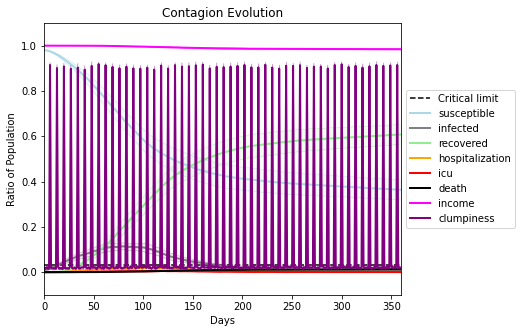

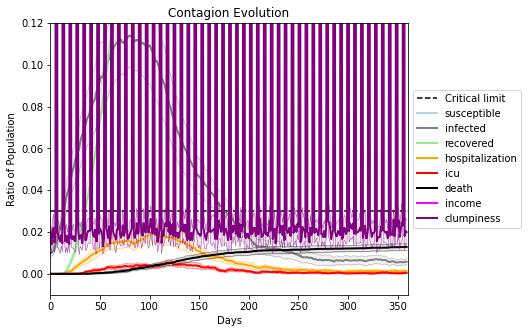

In [40]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3123, 9368, 5914, 2108, 9819, 4273, 4523, 1049, 6683, 8511, 7046, 9089, 2078, 3093, 1360, 7895, 1113, 7105, 2777, 1884]
Average similarity between family members is 0.15454989071983186 at temperature 0
Average similarity between family and home is 0.9998503412616574 at temperature -1
Average similarity between students and their classroom is 0.16327315314285734 at temperature 0
Average classroom occupancy is 3.9571428571428573 and number classrooms is 70
Average similarity between workers is 0.16910658856810692 at temperature 0
Average office occupancy is 3.256038647342995 and number offices is 207
Average friend similarity for adults: 0.20624962610973313 for kids: 0.20519857765341648
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.05223049052027823
avg restaurant similarity 0.09904621896131094
avg restaurant similarity 0.10828106018508545
avg restaurant similarity 0.1117441711998106
avg restaurant similarity 0.059997051315773986
avg restaurant similarity 0.10031898544531814
avg restaurant similarity 0.004014104060115477
avg restaurant similarity 0.09369978641754256
avg restaurant similarity 0.0432575445599766
avg restaurant similarity 0.07538855222648481
avg restaurant similarity 0.1041409105514111
avg restaurant similarity 0.056875523535674204
avg restaurant similarity 0.10487133104254089
avg restaurant similarity 0.011141266127752965
avg restaurant similarity 0.07262440230927646
avg restaurant similarity 0.039665971759856464
avg restaurant similarity 0.07019190224733415
avg restaurant similarity 0.08931079441522147
avg restaurant similarity 0.05637250491796516
avg restaurant similarity 0.07392408059857007
avg restaurant similarity 0.11128655344692089
avg restaurant similarity 0.0496

avg restaurant similarity 0.10496444098488325
avg restaurant similarity 0.031964465367769285
avg restaurant similarity 0.07221098964422167
avg restaurant similarity 0.07129075910273686
avg restaurant similarity 0.08370574454343799
avg restaurant similarity 0.07328815226072252
avg restaurant similarity 0.08883572312811348
avg restaurant similarity 0.015139430085457034
avg restaurant similarity 0.032433123411132525
avg restaurant similarity 0.07634272015743433
avg restaurant similarity 0.12112906881602532
avg restaurant similarity 0.07860749999181713
avg restaurant similarity 0.11032585006530936
avg restaurant similarity 0.017225452396403475
avg restaurant similarity 0.11009555400837477
avg restaurant similarity 0.03473667625592724
avg restaurant similarity 0.09643347217825177
avg restaurant similarity 0.05130976244257588
avg restaurant similarity 0.07466079529997471
avg restaurant similarity 0.06893784274980579
avg restaurant similarity 0.010331271532509272
avg restaurant similarity 0.0

avg restaurant similarity 0.05804087141255756
avg restaurant similarity 0.10433372410367019
avg restaurant similarity 0.041845949633358664
avg restaurant similarity 0.09642101677907502
avg restaurant similarity 0.07808225691691056
avg restaurant similarity 0.02631006580453829
avg restaurant similarity 0.07881890811024432
avg restaurant similarity 0.08461590933981378
avg restaurant similarity 0.04908648003078023
avg restaurant similarity 0.08660981086680351
avg restaurant similarity 0.06337650258579329
avg restaurant similarity 0.08472425774997559
avg restaurant similarity 0.07052827164226799
avg restaurant similarity 0.0781609192577366
avg restaurant similarity 0.06494444474365287
avg restaurant similarity 0.052931537645658264
avg restaurant similarity 0.05727447092613134
avg restaurant similarity 0.0582823428438426
avg restaurant similarity 0.08027796016735572
avg restaurant similarity 0.05448372500459559
avg restaurant similarity 0.00992312763643586
avg restaurant similarity 0.114926

avg restaurant similarity 0.03616232690690155
avg restaurant similarity 0.047618121773315654
avg restaurant similarity 0.06198343622212449
avg restaurant similarity 0.07070433162861534
avg restaurant similarity 0.06612198340895176
avg restaurant similarity 0.01798050309852142
avg restaurant similarity 0.0882243262118025
avg restaurant similarity 0.0314699646610495
avg restaurant similarity 0.04413995912253385
avg restaurant similarity 0.06660911370656687
avg restaurant similarity 0.05814632722581992
avg restaurant similarity 0.11593474999409778
avg restaurant similarity 0.08226646961252611
avg restaurant similarity 0.07252343559549684
avg restaurant similarity 0.10637147088183958
avg restaurant similarity 0.048922213117181125
avg restaurant similarity 0.07224044309880062
avg restaurant similarity 0.09168324447569301
avg restaurant similarity 0.07026840145677782
avg restaurant similarity 0.07255810266372184
avg restaurant similarity 0.08897210999184303
avg restaurant similarity 0.086310

avg restaurant similarity 0.07346980888495079
avg restaurant similarity 0.054769567621164555
avg restaurant similarity 0.0737087915034106
avg restaurant similarity 0.07454459366808072
avg restaurant similarity 0.0766678339852252
avg restaurant similarity 0.07139034650720467
avg restaurant similarity 0.06487215387813966
avg restaurant similarity 0.0623203245116949
avg restaurant similarity 0.08272676439981977
avg restaurant similarity 0.048689988535811114
avg restaurant similarity 0.13337807113616196
avg restaurant similarity 0.11431672608374076
avg restaurant similarity 0.10381858971350778
avg restaurant similarity 0.08912398870740432
avg restaurant similarity 0.0961479119410909
avg restaurant similarity 0.03398287325576767
avg restaurant similarity 0.10191631835296398
avg restaurant similarity 0.07307144639864875
avg restaurant similarity 0.0645218099477548
avg restaurant similarity 0.07642838027488036
avg restaurant similarity 0.08221227954874519
avg restaurant similarity 0.123235734

avg restaurant similarity 0.052178482545908726
avg restaurant similarity 0.047169660222196305
avg restaurant similarity 0.06735334632678983
avg restaurant similarity 0.07087179508604605
avg restaurant similarity 0.032408020621628765
avg restaurant similarity 0.10786806146658345
avg restaurant similarity 0.06687804223463799
avg restaurant similarity 0.02941022908423139
avg restaurant similarity 0.13051101785475094
avg restaurant similarity 0.09445153419224205
avg restaurant similarity 0.056053340820266154
avg restaurant similarity 0.06570183139375858
avg restaurant similarity 0.07239736300198621
avg restaurant similarity 0.11023091684253572
avg restaurant similarity 0.04780951659013704
avg restaurant similarity 0.10324598148653717
avg restaurant similarity 0.06688426348132907
avg restaurant similarity 0.08223871852981514
avg restaurant similarity 0.07321536976484802
avg restaurant similarity 0.02469143319736548
avg restaurant similarity 0.09862096293025242
avg restaurant similarity 0.11

avg restaurant similarity 0.044788185960084055
avg restaurant similarity 0.1143442845675648
avg restaurant similarity 0.0892610146572773
avg restaurant similarity 0.08003855843453504
avg restaurant similarity 0.07721888715221668
avg restaurant similarity 0.02201750660527388
avg restaurant similarity 0.0467106658202535
avg restaurant similarity 0.08078583325907476
avg restaurant similarity 0.06410434149458036
avg restaurant similarity 0.066157605464623
avg restaurant similarity 0.04997718602069625
avg restaurant similarity 0.024966754865173968
avg restaurant similarity 0.04877586104332287
avg restaurant similarity 0.052451310479585636
avg restaurant similarity 0.031138663472683327
avg restaurant similarity 0.05159954969596798
avg restaurant similarity 0.018664750939181532
avg restaurant similarity 0.07453021808931232
avg restaurant similarity 0.07369233057225169
avg restaurant similarity 0.07699055211055582
avg restaurant similarity 0.07588042209930367
avg restaurant similarity 0.030454

avg restaurant similarity 0.03818994497684328
avg restaurant similarity 0.010498629348937085
avg restaurant similarity 0.05199193248429199
avg restaurant similarity 0.048240995986338464
avg restaurant similarity 0.08320118028442308
avg restaurant similarity 0.040049514495535496
avg restaurant similarity 0.07032684655238255
avg restaurant similarity 0.05704629827294638
avg restaurant similarity 0.07969793732250789
avg restaurant similarity 0.09118345465399932
avg restaurant similarity 0.06028580687526063
avg restaurant similarity 0.10032276573785884
avg restaurant similarity 0.11489574139935708
avg restaurant similarity 0.06924857890244997
avg restaurant similarity 0.05402167679868821
avg restaurant similarity 0.04774719649694089
avg restaurant similarity 0.05168618358941648
avg restaurant similarity 0.06968105810877714
avg restaurant similarity 0.08881191711660154
avg restaurant similarity 0.10427264765298111
avg restaurant similarity 0.038695189216128634
avg restaurant similarity 0.07

avg restaurant similarity 0.04184443910357504
avg restaurant similarity 0.06964487420303953
avg restaurant similarity 0.05801140228475646
avg restaurant similarity 0.03005945618308738
avg restaurant similarity 0.028897656847204363
avg restaurant similarity 0.02648872978523543
avg restaurant similarity 0.0730018338569198
avg restaurant similarity 0.08295504298766164
avg restaurant similarity 0.06375245826899524
avg restaurant similarity 0.09447790315187148
avg restaurant similarity 0.07334250885957544
avg restaurant similarity 0.03474794142522081
avg restaurant similarity 0.053628985070341355
avg restaurant similarity 0.013961751449949426
avg restaurant similarity 0.01668099694234939
avg restaurant similarity 0.03933340026203485
avg restaurant similarity 0.04454518500001047
avg restaurant similarity 0.0881163116284772
avg restaurant similarity 0.009411815657533995
avg restaurant similarity 0.014066017129557226
avg restaurant similarity 0.06732478549619758
avg restaurant similarity 0.026

avg restaurant similarity 0.03456126768542722
avg restaurant similarity 0.048716168024260716
avg restaurant similarity 0.04728329540677061
avg restaurant similarity 0.05840293620312916
avg restaurant similarity 0.033665588689773436
avg restaurant similarity 0.08689145511730138
avg restaurant similarity 0.07713347373653655
avg restaurant similarity 0.05515935458897717
avg restaurant similarity 0.04737826469059112
avg restaurant similarity -0.05659615702440308
avg restaurant similarity 0.09812355969184142
avg restaurant similarity 0.09413003621282597
avg restaurant similarity 0.059562061833698395
avg restaurant similarity 0.08334729168384655
avg restaurant similarity 0.04036866643155364
avg restaurant similarity 0.014209422677187342
avg restaurant similarity 0.08672690944002365
avg restaurant similarity 0.0437190175406172
avg restaurant similarity 0.02561204900589209
avg restaurant similarity 0.03174488447734876
avg restaurant similarity 0.05207561805305561
avg restaurant similarity 0.06

avg restaurant similarity 0.07546300081068488
avg restaurant similarity 0.004138718364724653
avg restaurant similarity 0.02435870183166744
avg restaurant similarity 0.0660646262704922
avg restaurant similarity 0.05764849683878422
avg restaurant similarity 0.027382667805862952
avg restaurant similarity 0.07654915875717155
avg restaurant similarity 0.051879532589456344
avg restaurant similarity 0.06456872998063083
avg restaurant similarity 0.06251132883114652
avg restaurant similarity 0.019043520459881752
avg restaurant similarity 0.016744241640247577
avg restaurant similarity 0.05824770667655044
avg restaurant similarity 0.026949198526914023
avg restaurant similarity 0.07978704335073104
avg restaurant similarity 0.07464985729953616
avg restaurant similarity 0.01969649226458248
avg restaurant similarity 0.050225385224412666
avg restaurant similarity 0.037660491899944644
avg restaurant similarity 0.00590183815020994
avg restaurant similarity 0.04017314927612676
avg restaurant similarity 0

avg restaurant similarity 0.04016299503197779
avg restaurant similarity 0.0157632053637062
avg restaurant similarity 0.057096890272820854
avg restaurant similarity 0.03667860572165529
avg restaurant similarity 0.06397366472719848
avg restaurant similarity 0.03296339361174618
avg restaurant similarity 0.018150594980182004
avg restaurant similarity 0.07359184479183585
avg restaurant similarity 0.012041650209825302
avg restaurant similarity 0.10176027303592203
avg restaurant similarity 0.008444110521924411
avg restaurant similarity 0.021730917282223292
avg restaurant similarity -0.005952860459643473
avg restaurant similarity 0.0661570280173625
avg restaurant similarity 0.039668527728195006
avg restaurant similarity 0.03204748259776605
avg restaurant similarity 0.037752387945474676
avg restaurant similarity 0.07188444005858911
avg restaurant similarity 0.06250533282247829
avg restaurant similarity 0.08613646204832251
avg restaurant similarity 0.03947846423914713
avg restaurant similarity 0

avg restaurant similarity 0.0842685668282057
avg restaurant similarity 0.03778354624854269
avg restaurant similarity 0.04573073360668851
avg restaurant similarity 0.044138622539288665
avg restaurant similarity 0.0505740163418718
avg restaurant similarity 0.016810045414029945
avg restaurant similarity 0.04404887136001569
avg restaurant similarity 0.05392331920880845
avg restaurant similarity 0.027167127154557318
avg restaurant similarity 0.09236593380300984
avg restaurant similarity 0.12030373301199629
avg restaurant similarity 0.07542213285528783
avg restaurant similarity 0.0037044271863870943
avg restaurant similarity 0.06420903380517719
avg restaurant similarity 0.05537866875633186
avg restaurant similarity 0.05414498367782119
avg restaurant similarity 0.09412305833613523
avg restaurant similarity 0.1049481152672279
avg restaurant similarity 0.02326851601380227
avg restaurant similarity 0.032797898281660576
avg restaurant similarity 0.0382461363791525
avg restaurant similarity 0.0450

avg restaurant similarity 0.035027884233464875
avg restaurant similarity 0.019925392729125614
avg restaurant similarity 0.08102755125548226
avg restaurant similarity 0.053235968175929266
avg restaurant similarity 0.07611958286941527
avg restaurant similarity 0.058204028784791514
avg restaurant similarity -0.01346672644220852
avg restaurant similarity 0.07948969679892208
avg restaurant similarity 0.07668592999522614
avg restaurant similarity 0.072160151597815
avg restaurant similarity 0.05194060244079518
avg restaurant similarity -0.01041821609961323
avg restaurant similarity 0.07695626169939876
avg restaurant similarity 0.039883692698788484
avg restaurant similarity 0.04902476267177651
avg restaurant similarity 0.06907711718799761
avg restaurant similarity 0.014621884707869504
avg restaurant similarity 0.022175850429051895
avg restaurant similarity 0.07199960628224239
avg restaurant similarity 0.07170940903042043
avg restaurant similarity 0.05528705658225318
avg restaurant similarity 0

avg restaurant similarity 0.019693450170102128
avg restaurant similarity 0.032437322245097294
avg restaurant similarity 0.06124805015645032
avg restaurant similarity 0.0762450990259329
avg restaurant similarity 0.045969512662204046
avg restaurant similarity 0.10967865939836068
avg restaurant similarity 0.060323822860551816
avg restaurant similarity 0.05149959208362276
avg restaurant similarity 0.06575837280608192
avg restaurant similarity 0.034371211263744386
avg restaurant similarity 0.10154958838494317
avg restaurant similarity 0.06434097942091195
avg restaurant similarity 0.10023878970943229
avg restaurant similarity 0.03854166234573131
avg restaurant similarity 0.06772545746221692
avg restaurant similarity 0.04480779357502883
avg restaurant similarity 0.02713834598306443
avg restaurant similarity 0.08538902817481388
avg restaurant similarity 0.020651565160970695
avg restaurant similarity 0.07451762273735088
avg restaurant similarity 0.0717695231393629
avg restaurant similarity 0.07

avg restaurant similarity 0.07290400237955968
avg restaurant similarity 0.058101088834081854
avg restaurant similarity 0.04985639623106154
avg restaurant similarity 0.05569328514018533
avg restaurant similarity 0.11551903774451992
avg restaurant similarity 0.08354715828500595
avg restaurant similarity 0.03392457930987228
avg restaurant similarity 0.08439256482199677
avg restaurant similarity 0.005570999281970923
avg restaurant similarity 0.058722167649789186
avg restaurant similarity 0.0835905269643498
avg restaurant similarity 0.05011791997327745
avg restaurant similarity -0.007989624877635212
avg restaurant similarity 0.06148338196340429
avg restaurant similarity 0.09862843921563191
avg restaurant similarity 0.07438007130982077
avg restaurant similarity 0.03747339998953363
avg restaurant similarity 0.06742086591706634
avg restaurant similarity 0.03822976427384269
avg restaurant similarity 0.05711314553145394
avg restaurant similarity 0.06023077639657094
avg restaurant similarity 0.05

avg restaurant similarity 0.11033736041825948
avg restaurant similarity 0.06953662708732847
avg restaurant similarity 0.022494861970690058
avg restaurant similarity 0.06379416502159967
avg restaurant similarity 0.08309543246169206
avg restaurant similarity 0.06672663148950872
avg restaurant similarity 0.07961401681624165
avg restaurant similarity 0.06574205624110749
avg restaurant similarity 0.0389073896405612
avg restaurant similarity 0.035302570635690755
avg restaurant similarity 0.09799117197233731
avg restaurant similarity 0.0497156683071229
avg restaurant similarity 0.06774557843525876
avg restaurant similarity 0.06344332423980278
avg restaurant similarity 0.08359575766732469
avg restaurant similarity 0.0766390499539414
avg restaurant similarity 0.047749527547736245
avg restaurant similarity 0.05921933386559637
avg restaurant similarity 0.07582368547899582
avg restaurant similarity 0.04588867215838899
avg restaurant similarity 0.08518949860581888
avg restaurant similarity 0.055170

avg restaurant similarity 0.10529767147203208
avg restaurant similarity 0.07626946339393666
avg restaurant similarity 0.07013986254822749
avg restaurant similarity 0.04615503744275945
avg restaurant similarity 0.06949816491673436
avg restaurant similarity 0.07101801107849015
avg restaurant similarity 0.029731493763485623
avg restaurant similarity 0.07930801140124784
avg restaurant similarity 0.051308754900936455
avg restaurant similarity 0.06940185542541562
avg restaurant similarity 0.056757993832396256
avg restaurant similarity 0.03177252157913657
avg restaurant similarity 0.05244369965856469
avg restaurant similarity 0.07434732527917252
avg restaurant similarity 0.07382977785038869
avg restaurant similarity 0.04618215986067498
avg restaurant similarity 0.07327381164014052
avg restaurant similarity 0.08618526374207318
avg restaurant similarity 0.05126609316792503
avg restaurant similarity 0.0668305038496891
avg restaurant similarity 0.03988148369417749
avg restaurant similarity 0.0638

avg restaurant similarity 0.05609080511760272
avg restaurant similarity 0.11076318351482872
avg restaurant similarity 0.11042633210402893
avg restaurant similarity 0.06669859165691394
avg restaurant similarity 0.059022668806984355
avg restaurant similarity 0.01281439852243358
avg restaurant similarity 0.022483827037018334
avg restaurant similarity 0.025468089919874298
avg restaurant similarity 0.07146948280659354
avg restaurant similarity 0.05188845195048061
avg restaurant similarity 0.03238179531182449
avg restaurant similarity 0.07328382932401582
avg restaurant similarity 0.059027188616335546
avg restaurant similarity 0.06411942162836075
avg restaurant similarity 0.03561254096674646
avg restaurant similarity 0.10421099908552268
avg restaurant similarity 0.03728142409560607
avg restaurant similarity 0.0562516873053918
avg restaurant similarity 0.053334453141466696
avg restaurant similarity 0.07701223265288354
avg restaurant similarity 0.0657163198415726
avg restaurant similarity 0.046

avg restaurant similarity 0.04254723624074306
avg restaurant similarity 0.0719385250401764
avg restaurant similarity 0.11619632816959095
avg restaurant similarity 0.09019699679871018
avg restaurant similarity 0.07447192314212565
avg restaurant similarity 0.04638919029413372
avg restaurant similarity 0.01912037382611489
avg restaurant similarity 0.11052732180547423
avg restaurant similarity 0.05496672401269918
avg restaurant similarity 0.036845610124277915
avg restaurant similarity 0.05821343177359185
avg restaurant similarity 0.12884427256829575
avg restaurant similarity 0.05649527304648815
avg restaurant similarity 0.07551969922763353
avg restaurant similarity 0.10309017567530197
avg restaurant similarity 0.08458210398154065
avg restaurant similarity 0.10479882036307293
avg restaurant similarity 0.08537137131266632
avg restaurant similarity 0.081944226397306
avg restaurant similarity 0.10636648317195482
avg restaurant similarity 0.06726683771510678
avg restaurant similarity 0.05169039

avg restaurant similarity 0.0493189282113374
avg restaurant similarity 0.04442481485755103
avg restaurant similarity 0.0286065632929683
avg restaurant similarity 0.056790342890753076
avg restaurant similarity 0.09130564653355272
avg restaurant similarity 0.08140711215199214
avg restaurant similarity 0.09219110395461345
avg restaurant similarity 0.04867255228920848
avg restaurant similarity 0.04676855757146153
avg restaurant similarity 0.07525602302022283
avg restaurant similarity 0.08240920673059865
avg restaurant similarity 0.019546494264344155
avg restaurant similarity 0.03530655570986946
avg restaurant similarity 0.02634181562350113
avg restaurant similarity 0.059814025944750354
avg restaurant similarity 0.09826153673083197
avg restaurant similarity 0.08159774997203034
avg restaurant similarity 0.03589955697121489
avg restaurant similarity 0.0651679025594537
avg restaurant similarity 0.06583558629946766
avg restaurant similarity 0.022148014241921848
avg restaurant similarity 0.05727

avg restaurant similarity 0.024312306717885614
avg restaurant similarity 0.04218988622310393
avg restaurant similarity 0.10027129019719085
avg restaurant similarity 0.04990134559152251
avg restaurant similarity 0.051094497371555095
avg restaurant similarity 0.0582900353721904
avg restaurant similarity 0.036258017890909
avg restaurant similarity 0.09051372107119467
avg restaurant similarity 0.027418066189693075
avg restaurant similarity 0.047598304035907174
avg restaurant similarity 0.04672300855966369
avg restaurant similarity 0.07301094304808724
avg restaurant similarity 0.04391094289807858
avg restaurant similarity 0.06087625233295539
avg restaurant similarity 0.052719995150059804
avg restaurant similarity 0.07199455975597478
avg restaurant similarity 0.029427699998958813
avg restaurant similarity 0.0633382898205708
avg restaurant similarity 0.024380522805830175
avg restaurant similarity 0.07394518734191899
avg restaurant similarity 0.011604362659928763
avg restaurant similarity 0.05

avg restaurant similarity 0.05617282194398155
avg restaurant similarity 0.07001148124440593
avg restaurant similarity 0.061020196876195074
avg restaurant similarity 0.05352438272882199
avg restaurant similarity 0.07318319696124731
avg restaurant similarity 0.0036400365211816266
avg restaurant similarity 0.05422067251820666
avg restaurant similarity 0.1023278426205442
avg restaurant similarity 0.04230279986343695
avg restaurant similarity 0.06655751404037398
avg restaurant similarity 0.04926869462361015
avg restaurant similarity 0.02644344969828238
avg restaurant similarity 0.05446622665302315
avg restaurant similarity 0.11117401406067498
avg restaurant similarity 0.05859955260637179
avg restaurant similarity 0.07903900328250046
avg restaurant similarity 0.1324191048642788
avg restaurant similarity 0.07100931449605201
avg restaurant similarity 0.06749069553895377
avg restaurant similarity 0.05969390871919448
avg restaurant similarity 0.05670112115946961
avg restaurant similarity 0.01774

avg restaurant similarity 0.05293970486591825
avg restaurant similarity 0.06857925830286596
avg restaurant similarity 0.06185267242826388
avg restaurant similarity 0.050963855380833305
avg restaurant similarity 0.06900825664420249
avg restaurant similarity 0.042430838494718535
avg restaurant similarity 0.08126227061517607
avg restaurant similarity 0.08710235621607251
avg restaurant similarity 0.06135548019456109
avg restaurant similarity 0.08910842757405893
avg restaurant similarity 0.04866652583693713
avg restaurant similarity 0.051946819121628955
avg restaurant similarity 0.022310304524621
avg restaurant similarity 0.057543189963329744
avg restaurant similarity 0.05286727002985563
avg restaurant similarity 0.09098069612417421
avg restaurant similarity 0.042061000542285135
avg restaurant similarity 0.05358616198521119
avg restaurant similarity 0.06264799806058426
avg restaurant similarity 0.08590249377983476
avg restaurant similarity 0.04774945250734412
avg restaurant similarity 0.067

avg restaurant similarity 0.05772926671221136
avg restaurant similarity 0.0608846917107026
avg restaurant similarity 0.05313558872583249
avg restaurant similarity 0.036171598260785524
avg restaurant similarity 0.0639255425175676
avg restaurant similarity 0.07664251893704324
avg restaurant similarity 0.03031469176931607
avg restaurant similarity 0.05555717438655926
avg restaurant similarity 0.0600628730108493
avg restaurant similarity 0.12761950524831028
avg restaurant similarity 0.08505249456904898
avg restaurant similarity 0.08479177862604746
avg restaurant similarity 0.039061804046412976
avg restaurant similarity 0.07217036424694534
avg restaurant similarity 0.08761681698836245
avg restaurant similarity 0.05529204568720458
avg restaurant similarity 0.0768717745049993
avg restaurant similarity 0.12360178476479322
avg restaurant similarity 0.06296125140686464
avg restaurant similarity 0.07033218258818413
avg restaurant similarity 0.038983482841277395
avg restaurant similarity 0.0506846

avg restaurant similarity 0.0458164881093145
avg restaurant similarity 0.03607162916647044
avg restaurant similarity 0.06468024629285095
avg restaurant similarity 0.05694178161494865
avg restaurant similarity 0.09466127894939727
avg restaurant similarity 0.012809822816091552
avg restaurant similarity 0.04079330750830995
avg restaurant similarity 0.07413198397089567
avg restaurant similarity 0.05615500677830114
avg restaurant similarity 0.053336893836085884
avg restaurant similarity 0.07903176682297215
avg restaurant similarity 0.03805384542960446
avg restaurant similarity 0.08656742037779694
avg restaurant similarity 0.0659249981873494
avg restaurant similarity 0.07212066459197322
avg restaurant similarity 0.07600934779012614
avg restaurant similarity 0.08126624404202025
avg restaurant similarity 0.09151663504433814
avg restaurant similarity 0.09505846889752063
avg restaurant similarity 0.06810792260965037
avg restaurant similarity 0.11096936076698556
avg restaurant similarity 0.076865

avg restaurant similarity 0.0629467899035094
avg restaurant similarity 0.08626394182658331
avg restaurant similarity 0.05556600175325611
avg restaurant similarity 0.04363373675738694
avg restaurant similarity 0.07496927361294103
avg restaurant similarity 0.0639841326988616
avg restaurant similarity 0.07016774170660825
avg restaurant similarity 0.03418120773523958
avg restaurant similarity 0.037150348391915784
avg restaurant similarity 0.03296607519445328
avg restaurant similarity 0.05102103912847801
avg restaurant similarity -0.012827185046397252
avg restaurant similarity -0.0008017722881423019
avg restaurant similarity 0.10951792924970918
avg restaurant similarity 0.03233501657771735
avg restaurant similarity 0.05343515187281968
avg restaurant similarity 0.04174617211899441
avg restaurant similarity 0.07380631160467716
avg restaurant similarity 0.03669186544521091
avg restaurant similarity 0.09243910562996062
avg restaurant similarity 0.029133046166913344
avg restaurant similarity 0.0

avg restaurant similarity 0.06973885220285564
avg restaurant similarity 0.06099612229367944
avg restaurant similarity 0.059822580267413744
avg restaurant similarity 0.06230180110920074
avg restaurant similarity 0.11473755919821303
avg restaurant similarity 0.07483484590060949
avg restaurant similarity -0.0009256638254024911
avg restaurant similarity 0.09228839979431437
avg restaurant similarity 0.06144868608660427
avg restaurant similarity 0.06799624283079955
avg restaurant similarity 0.039723365022692844
avg restaurant similarity 0.048880286366296884
avg restaurant similarity 0.028827707266277692
avg restaurant similarity 0.10308875293716235
avg restaurant similarity 0.08948388219698745
avg restaurant similarity 0.10296603431076436
avg restaurant similarity 0.07031051682234325
avg restaurant similarity 0.06561861590495002
avg restaurant similarity 0.06329357431326074
avg restaurant similarity 0.05240565532139796
avg restaurant similarity 0.07071373684168722
avg restaurant similarity 0

avg restaurant similarity 0.029778534695796628
avg restaurant similarity 0.009051025744130909
avg restaurant similarity 0.041638290434340676
avg restaurant similarity 0.0407844734276027
avg restaurant similarity 0.03018203386973009
avg restaurant similarity 0.05340897254519741
avg restaurant similarity 0.03070006724840162
avg restaurant similarity 0.021787599887550697
avg restaurant similarity 0.047710849150978445
avg restaurant similarity 0.09075629691116223
avg restaurant similarity 0.02288681713593983
avg restaurant similarity 0.014255523303822282
avg restaurant similarity 0.0578664577587691
avg restaurant similarity 0.04104482679406019
avg restaurant similarity 0.08613000746648447
avg restaurant similarity 0.03126862091518272
avg restaurant similarity 0.11240814088542045
avg restaurant similarity 0.06188898642645214
avg restaurant similarity 0.0839134944342231
avg restaurant similarity 0.047838019838953985
avg restaurant similarity 0.05040508485864373
avg restaurant similarity 0.06

avg restaurant similarity 0.06520271999987595
avg restaurant similarity 0.06652282484842251
avg restaurant similarity 0.05791769872136676
avg restaurant similarity 0.019140604763959592
avg restaurant similarity -0.005840263198927343
avg restaurant similarity 0.06498203957403859
avg restaurant similarity 0.008973986461007924
avg restaurant similarity 0.03308954304587847
avg restaurant similarity -0.04326025591760407
avg restaurant similarity 0.03850778843895152
avg restaurant similarity -0.009091316037654146
avg restaurant similarity 0.029624175126070153
avg restaurant similarity 0.0016910294334641332
avg restaurant similarity 0.04761321948462213
avg restaurant similarity 0.0037562596910073187
avg restaurant similarity 0.07535974307088865
avg restaurant similarity 0.036136977405959704
avg restaurant similarity 0.0591440476982278
avg restaurant similarity 0.019573252306199832
avg restaurant similarity 0.033751741111913564
avg restaurant similarity 0.05396275326552829
avg restaurant simil

avg restaurant similarity 0.042801316443631575
avg restaurant similarity 0.016831372072504125
avg restaurant similarity 0.01531707403746055
avg restaurant similarity 0.04807705166156672
avg restaurant similarity 0.055874935465645044
avg restaurant similarity 0.028915934883290716
avg restaurant similarity 0.09612869016857989
avg restaurant similarity 0.07498511300139574
avg restaurant similarity 0.06231386313837546
avg restaurant similarity 0.042850309349884305
avg restaurant similarity 0.0596912051743828
avg restaurant similarity -0.008482179314407562
avg restaurant similarity 0.056322324903562246
avg restaurant similarity 0.035414007747658016
avg restaurant similarity 0.04281194684895602
avg restaurant similarity 0.08297883371270989
avg restaurant similarity -0.008208920365808644
avg restaurant similarity 0.04479684971755112
avg restaurant similarity 0.08782039833193736
avg restaurant similarity 0.06785332383484452
avg restaurant similarity 0.06478371845673202
avg restaurant similarit

avg restaurant similarity 0.07475878235368703
avg restaurant similarity 0.05548630507879696
avg restaurant similarity 0.014593858629821337
avg restaurant similarity -0.0017921445640961414
avg restaurant similarity 0.07582878759211252
avg restaurant similarity 0.05419172040339698
avg restaurant similarity 0.05104581766207368
avg restaurant similarity 0.08467432259319393
avg restaurant similarity 0.08428558155694363
avg restaurant similarity 0.06703069104163893
avg restaurant similarity 0.05774597127527816
avg restaurant similarity 0.1490405824949409
avg restaurant similarity 0.02937741106850827
avg restaurant similarity 0.06788078024946473
avg restaurant similarity 0.003590628882485438
avg restaurant similarity 0.10453635597558324
avg restaurant similarity 0.029876146508311944
avg restaurant similarity 0.09096672671002007
avg restaurant similarity -0.03344012220767812
avg restaurant similarity 0.05736146695541169
avg restaurant similarity 0.04463355179015125
avg restaurant similarity 0.

avg restaurant similarity 0.1084318681547109
avg restaurant similarity 0.05977428871057671
avg restaurant similarity 0.05103803717898361
avg restaurant similarity 0.06375618819539307
avg restaurant similarity 0.005310340651917764
avg restaurant similarity 0.050048532253412895
avg restaurant similarity 0.055187622808496185
avg restaurant similarity 0.03433813362681853
avg restaurant similarity 0.013122489400937529
avg restaurant similarity 0.09180374493468156
avg restaurant similarity 0.09122572688528652
avg restaurant similarity 0.10075964024319127
avg restaurant similarity 0.0412895953827823
avg restaurant similarity 0.054575016897758025
avg restaurant similarity 0.07053541326596166
avg restaurant similarity 0.03571735628659296
avg restaurant similarity 0.05921429430902243
avg restaurant similarity 0.06684529424565469
avg restaurant similarity 0.06741286872475574
avg restaurant similarity 0.07261869251469351
avg restaurant similarity 0.07479323704044265
avg restaurant similarity 0.036

avg restaurant similarity 0.07143120131167023
avg restaurant similarity 0.09972097219181393
avg restaurant similarity 0.07679586082042159
avg restaurant similarity 0.016904733636033512
avg restaurant similarity 0.07332937011402114
avg restaurant similarity 0.05564601827023231
avg restaurant similarity 0.06651032109552543
avg restaurant similarity 0.07733207713864988
avg restaurant similarity 0.039413804083717974
avg restaurant similarity 0.03534724684215184
avg restaurant similarity 0.0758918276790159
avg restaurant similarity 0.08064916651073348
avg restaurant similarity 0.08699093731083353
avg restaurant similarity 0.07840497376686537
avg restaurant similarity 0.06830324375276088
avg restaurant similarity 0.05233574571335503
avg restaurant similarity 0.053089256882185604
avg restaurant similarity 0.11579497895681942
avg restaurant similarity 0.0642089984781229
avg restaurant similarity 0.03367843495061442
avg restaurant similarity 0.020017539671610504
avg restaurant similarity 0.0643

avg restaurant similarity 0.027977234812135533
avg restaurant similarity 0.056022274457561354
avg restaurant similarity 0.02257714318198969
avg restaurant similarity 0.09181315005043084
avg restaurant similarity 0.09341119673036863
avg restaurant similarity 0.06298928535234473
avg restaurant similarity 0.08741609610972603
avg restaurant similarity 0.08729504107723969
avg restaurant similarity 0.0529554565488621
avg restaurant similarity 0.07406471790350216
avg restaurant similarity 0.02278778243728234
avg restaurant similarity 0.07862064202656138
avg restaurant similarity 0.06122895111396502
avg restaurant similarity 0.07594332468124496
avg restaurant similarity 0.10250177559798179
avg restaurant similarity 0.08981714828918286
avg restaurant similarity 0.05366555543237348
avg restaurant similarity 0.05988091830304196
avg restaurant similarity 0.08513963455409443
avg restaurant similarity 0.06958308372677312
avg restaurant similarity 0.07114717060316585
avg restaurant similarity 0.03839

avg restaurant similarity 0.10034494360989522
avg restaurant similarity 0.09134563742773516
avg restaurant similarity 0.07257675713751059
avg restaurant similarity 0.04366490335387816
avg restaurant similarity 0.03181054337290013
avg restaurant similarity 0.044259189222350385
avg restaurant similarity 0.03106574097046464
avg restaurant similarity 0.04880019309687204
avg restaurant similarity 0.031879060686808944
avg restaurant similarity 0.05706086687321146
avg restaurant similarity 0.03341134445867278
avg restaurant similarity 0.08500359855699888
avg restaurant similarity 0.05185310373654443
avg restaurant similarity 0.08717856590977414
avg restaurant similarity 0.03226907001936124
avg restaurant similarity 0.05973006157952216
avg restaurant similarity 0.04227628202275641
avg restaurant similarity 0.04177972638187507
avg restaurant similarity 0.0790479322126425
avg restaurant similarity 0.077827820070393
avg restaurant similarity 0.06168801996319593
avg restaurant similarity 0.0535964

avg restaurant similarity 0.01601946443414715
avg restaurant similarity 0.019544619894425425
avg restaurant similarity 0.04055268267921157
avg restaurant similarity 0.030706994319303
avg restaurant similarity -0.0017538368536775023
avg restaurant similarity 0.012049554709649966
avg restaurant similarity 0.02690407924992611
avg restaurant similarity 0.05598445910292803
avg restaurant similarity 0.026874103537971948
avg restaurant similarity 0.03364724653637708
avg restaurant similarity 0.022280330187896148
avg restaurant similarity 0.05819754319085787
avg restaurant similarity 0.023975924578568158
avg restaurant similarity 0.004580111365265305
avg restaurant similarity 0.03043474681331223
avg restaurant similarity 0.013981802125522746
avg restaurant similarity 0.09087913574095878
avg restaurant similarity 0.016477360400809948
avg restaurant similarity 0.08606073752195541
avg restaurant similarity -0.014635650665220542
avg restaurant similarity 0.0597986296728978
avg restaurant similarit

avg restaurant similarity 0.02902701986306363
avg restaurant similarity 0.02784777324961528
avg restaurant similarity 0.02172919336086128
avg restaurant similarity 0.06814197301418078
avg restaurant similarity 0.06553085778578166
avg restaurant similarity 0.013333207926053086
avg restaurant similarity -0.0016604111153508843
avg restaurant similarity 0.05303307074775352
avg restaurant similarity 0.031859700038648936
avg restaurant similarity 0.006700786633370605
avg restaurant similarity 0.009820307506886793
avg restaurant similarity 0.03989690995704298
avg restaurant similarity 0.015224560903630273
avg restaurant similarity 0.018181266448064802
avg restaurant similarity 0.057945918982630795
avg restaurant similarity 0.029461542619359193
avg restaurant similarity 0.012056579332765393
avg restaurant similarity 0.02157568400480168
avg restaurant similarity 0.028153150394725712
avg restaurant similarity 0.03875930521188619
avg restaurant similarity 0.06416958050413585
avg restaurant simila

avg restaurant similarity 0.042146197907772145
avg restaurant similarity 0.05773823931549217
avg restaurant similarity 0.0712133478515252
avg restaurant similarity 0.03435556100327751
avg restaurant similarity 0.038590937930724295
avg restaurant similarity 0.00524756574509636
avg restaurant similarity 0.04491457476466626
avg restaurant similarity 0.0510642015262827
avg restaurant similarity 0.07411935196462685
avg restaurant similarity 0.048374040124727756
avg restaurant similarity 0.024544717259526547
avg restaurant similarity 0.0771590801611232
avg restaurant similarity 0.07983804921598259
avg restaurant similarity 0.04496898907798421
avg restaurant similarity 0.07740898988933748
avg restaurant similarity 0.03579047870446294
avg restaurant similarity 0.032905777987100794
avg restaurant similarity 0.051944588197858764
avg restaurant similarity 0.009803197597840105
avg restaurant similarity 0.080186066952253
avg restaurant similarity 0.06559546798858318
avg restaurant similarity 0.0695

avg restaurant similarity 0.05944842876414779
avg restaurant similarity 0.10087462931811936
avg restaurant similarity 0.04640272553808901
avg restaurant similarity 0.06122131407435827
avg restaurant similarity 0.1014100416670737
avg restaurant similarity 0.04200810215661391
avg restaurant similarity 0.04344214190382267
avg restaurant similarity 0.04020950172469902
avg restaurant similarity 0.0646203256205093
avg restaurant similarity 0.038606045994257654
avg restaurant similarity 0.04810394475684273
avg restaurant similarity 0.07448711611358223
avg restaurant similarity 0.04452377510505063
avg restaurant similarity 0.08676990324089341
avg restaurant similarity -0.01209166629918322
avg restaurant similarity 0.04313244814860003
avg restaurant similarity 0.06722028060078783
avg restaurant similarity 0.003477946605714278
avg restaurant similarity 0.03886373382497739
avg restaurant similarity 0.04697554471084066
avg restaurant similarity 0.017990330570956843
avg restaurant similarity 0.0895

(<function dict.items>, <function dict.items>, <function dict.items>)

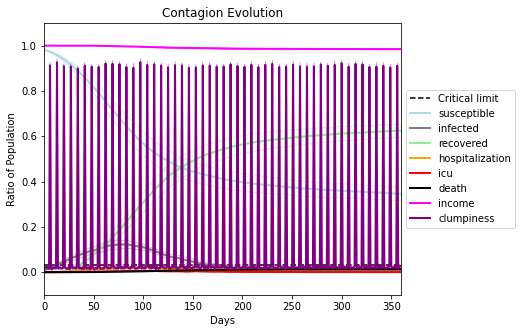

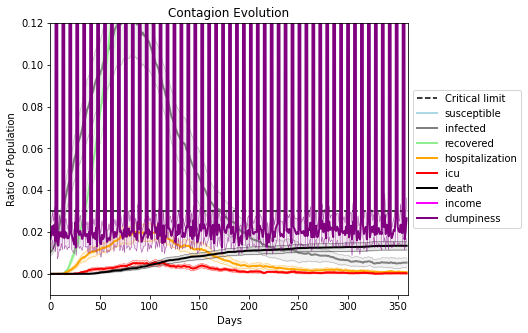

In [41]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[629, 1000, 6288, 2559, 5327, 2404, 9645, 3086, 458, 178, 4291, 8176, 5117, 5676, 4898, 2456, 2304, 39, 4791, 4133]
Average similarity between family members is 0.11265961597550267 at temperature 0.33
Average similarity between family and home is 0.9998610238156419 at temperature -1
Average similarity between students and their classroom is 0.13061244613687464 at temperature 0.33
Average classroom occupancy is 4.098591549295775 and number classrooms is 71
Average similarity between workers is 0.10221546174157047 at temperature 0.33
Average office occupancy is 3.174129353233831 and number offices is 201
Average friend similarity for adults: 0.16228716979858174 for kids: 0.1574767256488402
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.008984355246876786
avg restaurant similarity 0.028451153632785248
avg restaurant similarity 0.06122778535820167
avg restaurant similarity 0.052368254582718335
avg restaurant similarity 0.01920372852837291
avg restaurant similarity 0.017189991835156328
avg restaurant similarity 0.02715249384271324
avg restaurant similarity 0.02383083430036173
avg restaurant similarity 0.0422485642750918
avg restaurant similarity 0.01189870029950589
avg restaurant similarity -0.003541793855395213
avg restaurant similarity 0.061789999839243964
avg restaurant similarity 0.046623947915849555
avg restaurant similarity 0.03563226342228594
avg restaurant similarity -0.0009565277704141551
avg restaurant similarity 0.07035846836519323
avg restaurant similarity 0.06390961142465966
avg restaurant similarity 0.05911081805415324
avg restaurant similarity -0.0028354266049281335
avg restaurant similarity 0.037227662845873054
avg restaurant similarity 0.06568198725611957
avg restaurant simil

avg restaurant similarity 0.06512242381048562
avg restaurant similarity 0.02134339165623036
avg restaurant similarity -0.014776677634868216
avg restaurant similarity 0.010374439848248493
avg restaurant similarity 0.006638707101359335
avg restaurant similarity -0.017788850357179236
avg restaurant similarity 0.04128843391584446
avg restaurant similarity 0.009572866834983419
avg restaurant similarity 0.020684051094251435
avg restaurant similarity 0.023216997764262025
avg restaurant similarity 0.020888314692580314
avg restaurant similarity 0.020589300538173316
avg restaurant similarity 0.0297729781919192
avg restaurant similarity 0.0368772321447596
avg restaurant similarity -0.008728224545144945
avg restaurant similarity 0.020905381344000128
avg restaurant similarity 0.029982107067435544
avg restaurant similarity 0.044588287065046896
avg restaurant similarity 0.07413251483967577
avg restaurant similarity 0.03993822641570457
avg restaurant similarity -0.0018015185317451054
avg restaurant si

avg restaurant similarity 0.06564900566480528
avg restaurant similarity 0.07354542079158514
avg restaurant similarity 0.03086797411507653
avg restaurant similarity 0.03434860709960509
avg restaurant similarity 0.04232912387653672
avg restaurant similarity 0.06324839798420338
avg restaurant similarity 0.0491343413741637
avg restaurant similarity 0.030017805015787973
avg restaurant similarity 0.029501022755847296
avg restaurant similarity 0.004627438402376977
avg restaurant similarity 0.054369461261785525
avg restaurant similarity 0.05256447603001677
avg restaurant similarity 0.06167171992555513
avg restaurant similarity 0.0402156916490337
avg restaurant similarity 0.01689718867635489
avg restaurant similarity 0.041053408945014164
avg restaurant similarity 0.008116636127238862
avg restaurant similarity 0.06223099222839145
avg restaurant similarity 0.03937278810873033
avg restaurant similarity 0.11240133391563435
avg restaurant similarity -0.004975898333286996
avg restaurant similarity 0.

avg restaurant similarity 0.07561346316090663
avg restaurant similarity 0.08837781061192986
avg restaurant similarity 0.021844207205658155
avg restaurant similarity 0.06017415008938673
avg restaurant similarity 0.033047217162080755
avg restaurant similarity 0.0633900724516337
avg restaurant similarity 0.03281281801252598
avg restaurant similarity 0.021845478015877554
avg restaurant similarity 0.04679204032452503
avg restaurant similarity 0.02415119556904237
avg restaurant similarity 0.06567156218378563
avg restaurant similarity 0.08509088107124399
avg restaurant similarity -0.021329729008368124
avg restaurant similarity -5.9622701043669655e-05
avg restaurant similarity -0.0020515517873172695
avg restaurant similarity 0.04317752706591204
avg restaurant similarity 0.026185394741656796
avg restaurant similarity 0.006476320630911992
avg restaurant similarity 0.031646342481632714
avg restaurant similarity -0.0016325163217372964
avg restaurant similarity 0.018528017924609175
avg restaurant s

avg restaurant similarity 0.03970644454949889
avg restaurant similarity 0.07465822971414905
avg restaurant similarity -0.028983304321994887
avg restaurant similarity 0.05992344263175698
avg restaurant similarity 0.04584881767752151
avg restaurant similarity 0.01578969073880581
avg restaurant similarity 0.013404493356949248
avg restaurant similarity 0.09334918612019445
avg restaurant similarity 0.039916836623625315
avg restaurant similarity 0.03609810932255113
avg restaurant similarity 0.01428253135841402
avg restaurant similarity 0.04630352909315969
avg restaurant similarity 0.054064111660456514
avg restaurant similarity 0.054612740018475124
avg restaurant similarity -0.005478075940998286
avg restaurant similarity 0.044374911416358805
avg restaurant similarity 0.05334772419568459
avg restaurant similarity 0.03261222805010597
avg restaurant similarity 0.06484283210212098
avg restaurant similarity 0.01684914767021128
avg restaurant similarity 0.06039383750821508
avg restaurant similarity

avg restaurant similarity 0.07764461471929528
avg restaurant similarity 0.028092988275998855
avg restaurant similarity 0.05782130760492326
avg restaurant similarity 0.05467024750299289
avg restaurant similarity 0.024732095900985115
avg restaurant similarity 0.018762623267100213
avg restaurant similarity 0.05488870510640197
avg restaurant similarity 0.002570145892120033
avg restaurant similarity 0.005891887096617585
avg restaurant similarity 0.04560570236668199
avg restaurant similarity 0.03933693869485928
avg restaurant similarity 0.04844490202118501
avg restaurant similarity 0.03247012619235013
avg restaurant similarity 0.051090699937434085
avg restaurant similarity 0.05654608333897587
avg restaurant similarity 0.00521985324945454
avg restaurant similarity 0.06977276092992374
avg restaurant similarity 0.03828924769754156
avg restaurant similarity 0.01780978101993222
avg restaurant similarity 0.050758247198601954
avg restaurant similarity 0.08551136868211336
avg restaurant similarity 0

avg restaurant similarity 0.1256690482711664
avg restaurant similarity 0.03987339020079162
avg restaurant similarity -0.011835722893309617
avg restaurant similarity 0.06887521970750181
avg restaurant similarity 0.08166880066247223
avg restaurant similarity 0.1375501775962382
avg restaurant similarity 0.060596716385535286
avg restaurant similarity 0.02877116053966145
avg restaurant similarity 0.05192481329271849
avg restaurant similarity 0.061717149111015245
avg restaurant similarity 0.04762478180124542
avg restaurant similarity 0.050354669652134976
avg restaurant similarity 0.052332351069717696
avg restaurant similarity 0.021584851548559006
avg restaurant similarity 0.06052641524997343
avg restaurant similarity 0.04360527256666586
avg restaurant similarity 0.061392905806347126
avg restaurant similarity 0.02926936766914303
avg restaurant similarity 0.06923527631246966
avg restaurant similarity 0.03789724792383248
avg restaurant similarity 0.04139626720232554
avg restaurant similarity 0.

avg restaurant similarity 0.016202605057738427
avg restaurant similarity 0.10452922423843446
avg restaurant similarity 0.10944786863019075
avg restaurant similarity 0.010667499249611204
avg restaurant similarity 0.07351164272527369
avg restaurant similarity 0.057216523473044796
avg restaurant similarity 0.0319667719963547
avg restaurant similarity 0.07173190148806148
avg restaurant similarity 0.0859560717852702
avg restaurant similarity 0.0325157853318695
avg restaurant similarity 0.05503753713288596
avg restaurant similarity 0.03518742048824614
avg restaurant similarity 0.06256000790524435
avg restaurant similarity 0.07206948834687434
avg restaurant similarity 0.031192325699085345
avg restaurant similarity -0.01495120457236852
avg restaurant similarity 0.04667733196657721
avg restaurant similarity 0.07748314845462526
avg restaurant similarity 0.061926715020993
avg restaurant similarity 0.0605582846796813
avg restaurant similarity 0.08701247191271791
avg restaurant similarity 0.0357632

avg restaurant similarity 0.024796588957285516
avg restaurant similarity 0.03239008960650211
avg restaurant similarity -0.009157131600354154
avg restaurant similarity 0.03788546266431729
avg restaurant similarity 0.052402971899632625
avg restaurant similarity 0.018217171775906586
avg restaurant similarity 0.03068225674675653
avg restaurant similarity 0.006897999164073019
avg restaurant similarity 0.019633741358802363
avg restaurant similarity 0.04786063546576403
avg restaurant similarity 0.02225823851739848
avg restaurant similarity 0.031795675708977914
avg restaurant similarity 0.051691857039510326
avg restaurant similarity 0.054894309145527925
avg restaurant similarity 0.046299753056219924
avg restaurant similarity 0.016869598406544915
avg restaurant similarity 0.01904848435181862
avg restaurant similarity -0.020247170420849017
avg restaurant similarity 0.011531203845867477
avg restaurant similarity 0.028943733448768792
avg restaurant similarity 0.012569286696331132
avg restaurant si

avg restaurant similarity 0.0630195062036514
avg restaurant similarity 0.02882927027725896
avg restaurant similarity 0.005453901785910481
avg restaurant similarity 0.05476663812724118
avg restaurant similarity 0.01818054717527977
avg restaurant similarity 0.02703462054175556
avg restaurant similarity 0.005683826105960752
avg restaurant similarity 0.10063387003007412
avg restaurant similarity 0.05380245060701
avg restaurant similarity 0.003205436156699382
avg restaurant similarity -0.026359459587814767
avg restaurant similarity 0.0392976966522832
avg restaurant similarity 0.02044284259756884
avg restaurant similarity 0.04295413489091445
avg restaurant similarity 0.06183021944970842
avg restaurant similarity 0.043614815687921055
avg restaurant similarity 0.06280974392163598
avg restaurant similarity 0.01916313225350172
avg restaurant similarity 0.05546164123351667
avg restaurant similarity 0.07687493952211166
avg restaurant similarity 0.07233259238816404
avg restaurant similarity 0.02505

avg restaurant similarity 0.01877452076933991
avg restaurant similarity 0.040157955046389145
avg restaurant similarity 0.024391915561333553
avg restaurant similarity 0.05301229377283913
avg restaurant similarity 0.06267414637147851
avg restaurant similarity 0.03926018887047517
avg restaurant similarity 0.04582258689656062
avg restaurant similarity -0.022808168913000304
avg restaurant similarity 0.016707676949679104
avg restaurant similarity 0.02163178739355541
avg restaurant similarity 0.02616757343655877
avg restaurant similarity 0.08972360778084683
avg restaurant similarity 0.024673485449667007
avg restaurant similarity -0.002625105944509238
avg restaurant similarity 0.06833895723787219
avg restaurant similarity -0.019141328827462587
avg restaurant similarity 0.032702300024935724
avg restaurant similarity 0.03227165236272031
avg restaurant similarity 0.031122674292327464
avg restaurant similarity 0.0012044984208964247
avg restaurant similarity 0.0013979628097256704
avg restaurant sim

avg restaurant similarity 0.04976601582629172
avg restaurant similarity 0.055442234131374016
avg restaurant similarity 0.012022140484996571
avg restaurant similarity 0.056236657360532
avg restaurant similarity 0.027390071012150685
avg restaurant similarity 0.05239005961420302
avg restaurant similarity 0.059547757856942586
avg restaurant similarity 0.07129943558182976
avg restaurant similarity 0.019554806276245642
avg restaurant similarity 0.07291949012830101
avg restaurant similarity 0.03165826973295868
avg restaurant similarity 0.008513395441284622
avg restaurant similarity 0.026922957774349453
avg restaurant similarity -0.01381803757153809
avg restaurant similarity 0.022847902168679872
avg restaurant similarity 0.06677374833726941
avg restaurant similarity 0.011560566817724636
avg restaurant similarity 0.026880157233107497
avg restaurant similarity 0.07123910560922814
avg restaurant similarity -0.026689792631650357
avg restaurant similarity -0.02370286902921498
avg restaurant similar

avg restaurant similarity 0.023861777356567263
avg restaurant similarity 0.03783308772935622
avg restaurant similarity 0.016358866870714882
avg restaurant similarity 0.04446530101633496
avg restaurant similarity 0.024673753060182182
avg restaurant similarity 0.08506200464105831
avg restaurant similarity 0.017540019974684427
avg restaurant similarity 0.03644847779227694
avg restaurant similarity -0.027987561131130042
avg restaurant similarity 0.03138294750992097
avg restaurant similarity 0.03443665614336526
avg restaurant similarity 0.007445378432734291
avg restaurant similarity 0.06970222599595016
avg restaurant similarity 0.04942148653614427
avg restaurant similarity 0.013305000473875665
avg restaurant similarity 0.03729734700955714
avg restaurant similarity 0.035580230000810856
avg restaurant similarity 0.03780707531389845
avg restaurant similarity 0.045645271785290785
avg restaurant similarity 0.052165904431509126
avg restaurant similarity 0.004079449726946723
avg restaurant similar

avg restaurant similarity 0.08582293213464708
avg restaurant similarity 0.04451066611963965
avg restaurant similarity 0.02054454333918663
avg restaurant similarity 0.05205379203942602
avg restaurant similarity 0.04380642083309734
avg restaurant similarity 0.0432582702818521
avg restaurant similarity 0.0754335705997567
avg restaurant similarity 0.05147194414243566
avg restaurant similarity 0.04798513119655357
avg restaurant similarity 0.043485116447361964
avg restaurant similarity 0.055958364480389794
avg restaurant similarity 0.07670888095055078
avg restaurant similarity 0.0010625561013677517
avg restaurant similarity 0.06632929997155743
avg restaurant similarity 0.04215724655855014
avg restaurant similarity 0.06924992805603422
avg restaurant similarity 0.05173236314314625
avg restaurant similarity -0.0023788401761712626
avg restaurant similarity 0.03793593833216312
avg restaurant similarity 0.02457911242551992
avg restaurant similarity 0.09251119719125826
avg restaurant similarity -0.

avg restaurant similarity 0.0488675777378952
avg restaurant similarity 0.06235296016705182
avg restaurant similarity -0.012166709265154363
avg restaurant similarity 0.06670631367564286
avg restaurant similarity 0.05357716506597041
avg restaurant similarity 0.06274116435213853
avg restaurant similarity 0.03762172780091098
avg restaurant similarity 0.058895676100211035
avg restaurant similarity 0.04223311198647038
avg restaurant similarity 0.04217656870106785
avg restaurant similarity 0.07431399764311777
avg restaurant similarity 0.028241573125338888
avg restaurant similarity 0.05346186136320239
avg restaurant similarity -0.035283034047879754
avg restaurant similarity 0.02657691794035313
avg restaurant similarity 0.06050634911042671
avg restaurant similarity 0.06575303874176859
avg restaurant similarity 0.0551430764878929
avg restaurant similarity 0.0844605803437558
avg restaurant similarity 0.03370318423618814
avg restaurant similarity 0.040403978498593604
avg restaurant similarity 0.02

avg restaurant similarity 0.03610488111955328
avg restaurant similarity 0.09120323572652926
avg restaurant similarity 0.039764176253174424
avg restaurant similarity 0.03177577907019861
avg restaurant similarity 0.06326807018733496
avg restaurant similarity 0.077684896744951
avg restaurant similarity 0.03957161248171969
avg restaurant similarity 0.012136254498830828
avg restaurant similarity 0.06053329648716136
avg restaurant similarity 0.05880277059805485
avg restaurant similarity 0.08869838219701252
avg restaurant similarity 0.03242905830382907
avg restaurant similarity 0.08054533240670149
avg restaurant similarity 0.043456831331731574
avg restaurant similarity 0.047210057388237914
avg restaurant similarity 0.041827645233914135
avg restaurant similarity 0.10302691620772719
avg restaurant similarity 0.05809001090587189
avg restaurant similarity 0.07083547713838467
avg restaurant similarity 0.06421491195402507
avg restaurant similarity 0.04181798149311859
avg restaurant similarity 0.045

avg restaurant similarity 0.0624591553057056
avg restaurant similarity 0.05201835236032453
avg restaurant similarity -0.003773929225599892
avg restaurant similarity 0.002487439742415202
avg restaurant similarity 0.014646979642411911
avg restaurant similarity 0.021645744004234104
avg restaurant similarity 0.032997039544589594
avg restaurant similarity 0.07179714059093424
avg restaurant similarity 0.03959005023412654
avg restaurant similarity 0.015203668329034517
avg restaurant similarity -0.010392481631066068
avg restaurant similarity 0.060343859367629836
avg restaurant similarity 0.06230151355597971
avg restaurant similarity 0.05165228172507191
avg restaurant similarity 0.009049142294686901
avg restaurant similarity -0.006552705804737397
avg restaurant similarity -0.021650096076648855
avg restaurant similarity 0.07598800301158716
avg restaurant similarity 0.037189613202621055
avg restaurant similarity -0.008694474868495436
avg restaurant similarity 0.038011889339587275
avg restaurant s

avg restaurant similarity 0.025723299259333872
avg restaurant similarity -0.054017617124148695
avg restaurant similarity 0.01354288193598747
avg restaurant similarity 0.038728296982876
avg restaurant similarity 0.06802474652862833
avg restaurant similarity -0.004620360441088438
avg restaurant similarity 0.049744934947599316
avg restaurant similarity -0.01787158404421362
avg restaurant similarity 0.0267981458863078
avg restaurant similarity -0.007076165341686039
avg restaurant similarity -0.0057585273745590195
avg restaurant similarity 0.021560035227826544
avg restaurant similarity 0.03184837715179139
avg restaurant similarity 0.03404527932922074
avg restaurant similarity 0.005510086117654481
avg restaurant similarity 0.0490558703557671
avg restaurant similarity 0.008075813867243254
avg restaurant similarity -0.003237285113880166
avg restaurant similarity 0.030461637044247987
avg restaurant similarity 0.010322796463628287
avg restaurant similarity -0.023184462775265466
avg restaurant si

avg restaurant similarity 0.04365173245486065
avg restaurant similarity 0.06487419749045985
avg restaurant similarity 0.060109386131198726
avg restaurant similarity 0.0626382355640798
avg restaurant similarity -0.0005317547150461349
avg restaurant similarity 0.07543121192282384
avg restaurant similarity 0.04390251485046918
avg restaurant similarity 0.06368803564310599
avg restaurant similarity 0.0856442000012931
avg restaurant similarity 0.038661961031566536
avg restaurant similarity 0.05264748080944846
avg restaurant similarity 0.07049070293611108
avg restaurant similarity 0.07268761085068823
avg restaurant similarity 0.03570513751914581
avg restaurant similarity 0.06043147101462542
avg restaurant similarity 0.07474737067050519
avg restaurant similarity 0.05634961324340441
avg restaurant similarity 0.03769718379054682
avg restaurant similarity 0.04634512843424095
avg restaurant similarity 0.07331743415749445
avg restaurant similarity 0.04034859680677731
avg restaurant similarity 0.044

avg restaurant similarity 0.061353493313245466
avg restaurant similarity 0.045007124066247926
avg restaurant similarity 0.03890717361271355
avg restaurant similarity 0.09025559341971523
avg restaurant similarity 0.04893510227679742
avg restaurant similarity 0.07749546323206609
avg restaurant similarity 0.055002538035720756
avg restaurant similarity 0.05288247652391015
avg restaurant similarity 0.0508419822305092
avg restaurant similarity 0.04249382589640967
avg restaurant similarity 0.03510249397882668
avg restaurant similarity 0.04307111504179491
avg restaurant similarity 0.03235496090378925
avg restaurant similarity 0.0435276313348711
avg restaurant similarity 0.09442056715713192
avg restaurant similarity 0.06268425988729301
avg restaurant similarity 0.029591457668537914
avg restaurant similarity 0.03501811433327165
avg restaurant similarity 0.08679403704211186
avg restaurant similarity 0.06765921733295502
avg restaurant similarity 0.07476488635440674
avg restaurant similarity 0.0259

avg restaurant similarity 0.014914804011730015
avg restaurant similarity 0.04147316200549302
avg restaurant similarity 0.01677512578402406
avg restaurant similarity 0.04226688109341409
avg restaurant similarity 0.04434482612730195
avg restaurant similarity 0.029195520164073514
avg restaurant similarity 0.053318499718315406
avg restaurant similarity 0.05914536770352101
avg restaurant similarity 0.03833480454054305
avg restaurant similarity 0.06622054937132188
avg restaurant similarity 0.043644414089572925
avg restaurant similarity 0.022664523900050138
avg restaurant similarity 0.04433258156790394
avg restaurant similarity 0.009368780776631619
avg restaurant similarity 0.07084355962376139
avg restaurant similarity 0.06272816546090204
avg restaurant similarity 0.03815673269313213
avg restaurant similarity 0.04886064820048962
avg restaurant similarity 0.010147054230918169
avg restaurant similarity 0.04239695710429179
avg restaurant similarity 0.05923021893913845
avg restaurant similarity 0

avg restaurant similarity 0.03090406035802176
avg restaurant similarity 0.020684061427346988
avg restaurant similarity 0.02595950213393183
avg restaurant similarity 0.0165618004279912
avg restaurant similarity 0.04767692675819699
avg restaurant similarity 0.046588963805837734
avg restaurant similarity 0.07365589390172982
avg restaurant similarity 0.05335310411502723
avg restaurant similarity 0.06607875898296559
avg restaurant similarity 0.06569350013708923
avg restaurant similarity 0.04695720716031749
avg restaurant similarity 0.03737431077047676
avg restaurant similarity 0.011485610955771297
avg restaurant similarity 0.045115954156842664
avg restaurant similarity 0.04102062967918035
avg restaurant similarity 0.05863739171534215
avg restaurant similarity -0.017512858410756824
avg restaurant similarity 0.028023131468196405
avg restaurant similarity 0.09893985319527261
avg restaurant similarity 0.020877370638971927
avg restaurant similarity 0.05097547434145433
avg restaurant similarity -

avg restaurant similarity 0.008683076245199142
avg restaurant similarity 0.038776110616913446
avg restaurant similarity 0.028178850259637764
avg restaurant similarity 0.036862017971410505
avg restaurant similarity 0.02163546838516482
avg restaurant similarity -0.008782406960506363
avg restaurant similarity 0.00044993632105816677
avg restaurant similarity 0.010651662949306723
avg restaurant similarity 0.005870904141817067
avg restaurant similarity 0.03665289340946998
avg restaurant similarity 0.017838359351927558
avg restaurant similarity 0.019001380230775872
avg restaurant similarity 0.06024058543067548
avg restaurant similarity 0.03965528040604973
avg restaurant similarity 0.021238475223525725
avg restaurant similarity 0.024637998387591772
avg restaurant similarity 0.024921517587328728
avg restaurant similarity 0.06151610513380582
avg restaurant similarity 0.0276876523837128
avg restaurant similarity 0.05147623814222599
avg restaurant similarity 0.06868890653007087
avg restaurant simi

avg restaurant similarity 0.029286965410346717
avg restaurant similarity -0.0076352802651218086
avg restaurant similarity -0.009222212794281086
avg restaurant similarity 0.060562171181672064
avg restaurant similarity 0.0025611158748727854
avg restaurant similarity 0.0103096474834742
avg restaurant similarity 0.022274263408800652
avg restaurant similarity 0.014049609090053145
avg restaurant similarity 0.046944116318647235
avg restaurant similarity 0.02747217792584126
avg restaurant similarity -0.007963699821462299
avg restaurant similarity -0.01636741620832726
avg restaurant similarity 0.028378196643296178
avg restaurant similarity 0.03387172355773382
avg restaurant similarity 0.03943404014185744
avg restaurant similarity 0.028758624089824172
avg restaurant similarity 0.020706411508329876
avg restaurant similarity -0.003468165878780899
avg restaurant similarity 0.026817119802173748
avg restaurant similarity 0.03308266187913073
avg restaurant similarity 0.013789711120612912
avg restauran

avg restaurant similarity -0.04871281519128117
avg restaurant similarity 0.04255449201492245
avg restaurant similarity 0.05914252412200414
avg restaurant similarity 0.070244777596277
avg restaurant similarity 0.024781988214499395
avg restaurant similarity -0.004100645690993794
avg restaurant similarity 0.032496705523437974
avg restaurant similarity 0.016490689402321648
avg restaurant similarity 0.07065188195083874
avg restaurant similarity 0.043506067103897865
avg restaurant similarity 0.05352076095936548
avg restaurant similarity 0.0853951845029056
avg restaurant similarity 0.029529906302207636
avg restaurant similarity -0.011627520454533632
avg restaurant similarity 0.022853971376261238
avg restaurant similarity -0.012334846139438943
avg restaurant similarity 0.04226352612548307
avg restaurant similarity 0.057470451365904535
avg restaurant similarity 0.053552668524344885
avg restaurant similarity -0.0018072436743110589
avg restaurant similarity 0.04989228390229991
avg restaurant simi

avg restaurant similarity 0.008745377119210921
avg restaurant similarity 0.007789422312716658
avg restaurant similarity 0.012446527343839487
avg restaurant similarity 0.02759151962580335
avg restaurant similarity 0.00032911080716275376
avg restaurant similarity 0.016681197677477746
avg restaurant similarity 0.002113042985025746
avg restaurant similarity 0.04175383225142491
avg restaurant similarity 0.05074978875743472
avg restaurant similarity 0.00017879745907218667
avg restaurant similarity 0.013236099043159538
avg restaurant similarity 0.028704581135724726
avg restaurant similarity 0.018352415263459446
avg restaurant similarity 0.04434550959954115
avg restaurant similarity 0.0635968693877084
avg restaurant similarity 0.017185626094766294
avg restaurant similarity 0.05412541653356205
avg restaurant similarity 0.013822046227287495
avg restaurant similarity 0.03182203887701183
avg restaurant similarity 0.03319724690783009
avg restaurant similarity 0.013610051273203335
avg restaurant sim

avg restaurant similarity 0.05533186266040093
avg restaurant similarity 0.04189290568349334
avg restaurant similarity 0.043695198180484146
avg restaurant similarity 0.0028467213492091438
avg restaurant similarity 0.07034331103005487
avg restaurant similarity 0.023435057821652047
avg restaurant similarity 0.044155536149932215
avg restaurant similarity 0.041100669570563256
avg restaurant similarity -0.004412722520689159
avg restaurant similarity 0.020601988811195356
avg restaurant similarity 0.061179298847687864
avg restaurant similarity 0.023507207608071432
avg restaurant similarity 0.03127730923575881
avg restaurant similarity 0.021358757576090258
avg restaurant similarity 0.004515081621412546
avg restaurant similarity 0.05324805741755015
avg restaurant similarity 0.048427092967015715
avg restaurant similarity 0.035660017083555366
avg restaurant similarity 0.016747395057253978
avg restaurant similarity 0.041985753193709716
avg restaurant similarity 0.042863515082384174
avg restaurant s

avg restaurant similarity 0.04209800542948114
avg restaurant similarity 0.06730128657547275
avg restaurant similarity 0.015093712807488224
avg restaurant similarity 0.04106766626369422
avg restaurant similarity 0.03739025357451965
avg restaurant similarity 0.0149940334498115
avg restaurant similarity 0.04303130185146191
avg restaurant similarity 0.0319837094179673
avg restaurant similarity 0.044688753925802564
avg restaurant similarity 0.030763247271741567
avg restaurant similarity 0.009197855660044335
avg restaurant similarity 0.0576137714140291
avg restaurant similarity 0.005976230148025263
avg restaurant similarity 0.014781556640295847
avg restaurant similarity 0.03889937627014935
avg restaurant similarity 0.023452923064650164
avg restaurant similarity 0.050761464988775006
avg restaurant similarity 0.035257537096633526
avg restaurant similarity 0.0144899605954659
avg restaurant similarity 0.06668207234770668
avg restaurant similarity 0.07241542281677649
avg restaurant similarity 0.0

avg restaurant similarity 0.03709678611657244
avg restaurant similarity 0.030583760200067617
avg restaurant similarity 0.051357927709712134
avg restaurant similarity 0.010850036904528439
avg restaurant similarity -0.028358052650932237
avg restaurant similarity 0.08092387315611582
avg restaurant similarity 0.06253952152268816
avg restaurant similarity 0.03446967678972613
avg restaurant similarity 0.03067419232359036
avg restaurant similarity 0.05722245379431022
avg restaurant similarity 0.04607134639252249
avg restaurant similarity -0.007712931918797919
avg restaurant similarity 0.021159685149383746
avg restaurant similarity 0.05732403661414015
avg restaurant similarity 0.06531508291134829
avg restaurant similarity 0.0357098495784784
avg restaurant similarity 0.036474401763284606
avg restaurant similarity 0.05334854293602019
avg restaurant similarity 0.021376951706898937
avg restaurant similarity 0.026258012163978963
avg restaurant similarity 0.03684026301065573
avg restaurant similarit

avg restaurant similarity 0.053971413347388725
avg restaurant similarity 0.03891616067039713
avg restaurant similarity 0.05722253796627964
avg restaurant similarity 0.06559437544774495
avg restaurant similarity 0.010824295888468899
avg restaurant similarity 0.009743149547555941
avg restaurant similarity -0.023069447758082465
avg restaurant similarity 0.08340241055024146
avg restaurant similarity 0.0759091319408424
avg restaurant similarity 0.022595672444292943
avg restaurant similarity 0.07988735822273174
avg restaurant similarity 0.008060602281583439
avg restaurant similarity 0.05696276429070573
avg restaurant similarity 0.02417451421574935
avg restaurant similarity 0.057710994590932665
avg restaurant similarity 0.06252248634349766
avg restaurant similarity 0.015231849195702883
avg restaurant similarity 0.05810362719984418
avg restaurant similarity 0.03454721617952923
avg restaurant similarity 0.04127592096938129
avg restaurant similarity 0.019771237036125405
avg restaurant similarity

avg restaurant similarity 0.017188044838743057
avg restaurant similarity 0.10664815469488138
avg restaurant similarity 0.10306714682422917
avg restaurant similarity 0.0817088799411687
avg restaurant similarity 0.044093129691172364
avg restaurant similarity 0.044512454008289196
avg restaurant similarity 0.06280645403383024
avg restaurant similarity 0.05953596485752252
avg restaurant similarity 0.018601939304407466
avg restaurant similarity 0.06185917060329074
avg restaurant similarity 0.0935816547010483
avg restaurant similarity 0.07543858759360003
avg restaurant similarity 0.027559812079783013
avg restaurant similarity 0.028143595533943456
avg restaurant similarity 0.030211421575563252
avg restaurant similarity 0.03363516897945765
avg restaurant similarity 0.09389237426962974
avg restaurant similarity 0.06114802419868455
avg restaurant similarity 0.05167992110624451
avg restaurant similarity 0.05324711463662258
avg restaurant similarity 0.07413654088676674
avg restaurant similarity 0.0

avg restaurant similarity 0.10454591299237713
avg restaurant similarity 0.014389225699608129
avg restaurant similarity 0.021136284271709195
avg restaurant similarity 0.08713716984476516
avg restaurant similarity 0.07231142863501905
avg restaurant similarity 0.058468806006694254
avg restaurant similarity 0.08359897335577361
avg restaurant similarity 0.05649860948531556
avg restaurant similarity 0.0693670823837247
avg restaurant similarity 0.03891612790182452
avg restaurant similarity 0.049127687491133325
avg restaurant similarity 0.00767698407291867
avg restaurant similarity 0.05241513142374018
avg restaurant similarity 0.07294367868083883
avg restaurant similarity 0.09408116011310955
avg restaurant similarity 0.07349967322038507
avg restaurant similarity 0.08036574709500015
avg restaurant similarity 0.07513459199649603
avg restaurant similarity 0.029292242484178384
avg restaurant similarity 0.06152135401679702
avg restaurant similarity 0.04229758090552084
avg restaurant similarity 0.03

avg restaurant similarity 0.01036448473906611
avg restaurant similarity 0.04450215744781099
avg restaurant similarity 0.023358728826597914
avg restaurant similarity 0.0460053271222342
avg restaurant similarity 0.045673918075639364
avg restaurant similarity 0.07382874765926016
avg restaurant similarity 0.03970973290158114
avg restaurant similarity 0.03992682857674914
avg restaurant similarity 0.053012411383234745
avg restaurant similarity 0.0027456270514697348
avg restaurant similarity 0.05292843783520519
avg restaurant similarity 0.027299421865468264
avg restaurant similarity 0.05104937848434766
avg restaurant similarity 0.05059510737909888
avg restaurant similarity 0.04140008502032108
avg restaurant similarity 0.035770212526866844
avg restaurant similarity 0.039715621312970885
avg restaurant similarity 0.04651319283414952
avg restaurant similarity 0.02654370414498566
avg restaurant similarity 0.021113532374974087
avg restaurant similarity 0.011645953194128767
avg restaurant similarity

avg restaurant similarity 0.052321835779159914
avg restaurant similarity 0.008267233641847999
avg restaurant similarity 0.04685091090324218
avg restaurant similarity 0.04906073292136893
avg restaurant similarity 0.013875427837696403
avg restaurant similarity 0.03545840404329948
avg restaurant similarity 0.034032785158167156
avg restaurant similarity 0.025050576098668148
avg restaurant similarity 0.046067742981496816
avg restaurant similarity 0.006250877725812
avg restaurant similarity 0.011581039792937266
avg restaurant similarity 0.03922671001192076
avg restaurant similarity -0.013945911855061466
avg restaurant similarity 0.02906836522957327
avg restaurant similarity 0.0458295290462018
avg restaurant similarity 0.057178716096801835
avg restaurant similarity 0.006389167215841377
avg restaurant similarity 0.021367714929192608
avg restaurant similarity 0.018862806948348916
avg restaurant similarity 0.07430095934941584
avg restaurant similarity 0.0029913530358123227
avg restaurant similar

avg restaurant similarity 0.08161102260235992
avg restaurant similarity 0.04467849681338943
avg restaurant similarity 0.06894829359804579
avg restaurant similarity 0.07176357054744471
avg restaurant similarity 0.044946197373271095
avg restaurant similarity -0.015117560193310967
avg restaurant similarity 0.014087314611782418
avg restaurant similarity 0.0723028103773657
avg restaurant similarity 0.0221106627572126
avg restaurant similarity -0.05795033000159101
avg restaurant similarity 0.06679113305492745
avg restaurant similarity 0.035560773790792206
avg restaurant similarity 0.03668571026638784
avg restaurant similarity 0.04107899949907353
avg restaurant similarity 0.03466339994148436
avg restaurant similarity 0.025601981517764175
avg restaurant similarity -0.0033359350991271053
avg restaurant similarity 0.029373324250205158
avg restaurant similarity 0.034018037858784676
avg restaurant similarity -0.00293469601404284
avg restaurant similarity 0.04983635665901389
avg restaurant similari

avg restaurant similarity 0.04081933841465433
avg restaurant similarity 0.07402933365104995
avg restaurant similarity 0.033379151747319834
avg restaurant similarity 0.02163287209215939
avg restaurant similarity 0.1159325937861351
avg restaurant similarity 0.04976182973270063
avg restaurant similarity 0.00959886212464813
avg restaurant similarity 0.039183052785785516
avg restaurant similarity 0.042875266720145654
avg restaurant similarity 0.043707689206306154
avg restaurant similarity 0.029009209087577165
avg restaurant similarity 0.03600490174031422
avg restaurant similarity 0.042004379896800635
avg restaurant similarity 0.010826164679481862
avg restaurant similarity 0.008998478428811053
avg restaurant similarity 0.00258766852322008
avg restaurant similarity 0.03224119488491236
avg restaurant similarity 0.02496355875078789
avg restaurant similarity 0.07598367869500972
avg restaurant similarity 0.009195345360543526
avg restaurant similarity 0.0037241583577998874
avg restaurant similarit

avg restaurant similarity 0.04538429303705641
avg restaurant similarity 0.017339652750645224
avg restaurant similarity 0.01721291693758883
avg restaurant similarity 0.02918214005241957
avg restaurant similarity 0.037391820480793606
avg restaurant similarity 0.04592746749080547
avg restaurant similarity 0.05899275746173614
avg restaurant similarity 0.0053899650881838014
avg restaurant similarity 0.02668405783350491
avg restaurant similarity -0.004053767298128786
avg restaurant similarity 0.050580239257253
avg restaurant similarity 0.03402510425872116
avg restaurant similarity 0.017440009837539638
avg restaurant similarity 0.003692364632878918
avg restaurant similarity 0.017152895929033133
avg restaurant similarity 0.04416005981908112
avg restaurant similarity 0.0223120856552397
avg restaurant similarity 0.04204534934953335
avg restaurant similarity 0.01850471717506239
avg restaurant similarity 0.017067589112567394
avg restaurant similarity 0.09196741416642111
avg restaurant similarity -

avg restaurant similarity 0.05130482961859458
avg restaurant similarity 0.0582107415172521
avg restaurant similarity 0.026918170141330067
avg restaurant similarity 0.027996329812735834
avg restaurant similarity 0.041165794643208485
avg restaurant similarity 0.003459388456254728
avg restaurant similarity 0.015048885373132419
avg restaurant similarity 0.040869596401318216
avg restaurant similarity 0.049612519493978345
avg restaurant similarity 0.054609960701918044
avg restaurant similarity -0.005986377356104319
avg restaurant similarity 0.009119206371018686
avg restaurant similarity 0.015657555204222573
avg restaurant similarity 0.05756551206607966
avg restaurant similarity 0.05315395415815759
avg restaurant similarity 0.019693851812146054
avg restaurant similarity 0.044705456380607536
avg restaurant similarity 0.053540885093449626
avg restaurant similarity 0.02220906534293241
avg restaurant similarity 0.031044564457250037
avg restaurant similarity 0.005600075534835099
avg restaurant sim

avg restaurant similarity 0.05477894152696816
avg restaurant similarity 0.0650036388719994
avg restaurant similarity 0.06722456704098385
avg restaurant similarity 0.06432021760829246
avg restaurant similarity 0.04710096066760715
avg restaurant similarity 0.039326000927233866
avg restaurant similarity 0.05570615532663734
avg restaurant similarity 0.05726881691527836
avg restaurant similarity 0.0674054687112354
avg restaurant similarity 0.04083124790423723
avg restaurant similarity 0.04177486540747346
avg restaurant similarity 0.04905146549227974
avg restaurant similarity 0.03968802479652647
avg restaurant similarity 0.09108176684785967
avg restaurant similarity 0.03257712402568872
avg restaurant similarity 0.046983020416224465
avg restaurant similarity 0.00898424524953678
avg restaurant similarity 0.03382921462694058
avg restaurant similarity 0.07052085448901112
avg restaurant similarity 0.0049722539654941155
avg restaurant similarity 0.10161875292309888
avg restaurant similarity 0.0806

avg restaurant similarity 0.05291121786164077
avg restaurant similarity 0.08000761077052213
avg restaurant similarity 0.06424568009182906
avg restaurant similarity 0.051172116760756364
avg restaurant similarity 0.07269999350251732
avg restaurant similarity 0.0640005593389751
avg restaurant similarity 0.05389682848365346
avg restaurant similarity 0.0937946510674287
avg restaurant similarity 0.046744181969221345
avg restaurant similarity 0.05280846271851633
avg restaurant similarity 0.0006491747136190394
avg restaurant similarity 0.042688142799138774
avg restaurant similarity 0.041151185789984834
avg restaurant similarity 0.06150130961716145
avg restaurant similarity 0.0322972229788097
avg restaurant similarity 0.06131709388513459
avg restaurant similarity 0.08986597855137728
avg restaurant similarity 0.0029559294840058392
avg restaurant similarity 0.03849953048498792
avg restaurant similarity 0.0633315476203334
avg restaurant similarity 0.05618242443236685
avg restaurant similarity 0.03

(<function dict.items>, <function dict.items>, <function dict.items>)

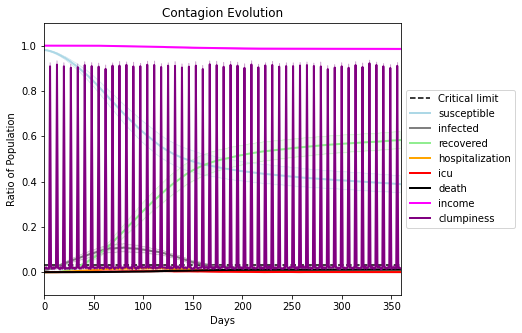

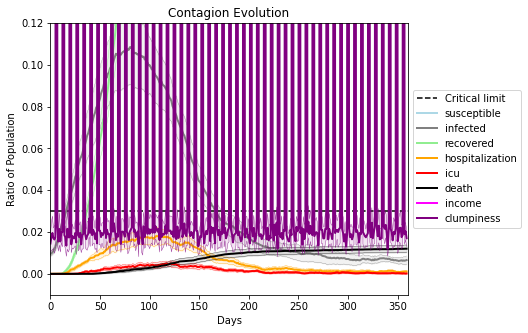

In [42]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3495, 6163, 3482, 1423, 5150, 9019, 5964, 8932, 8177, 3171, 9320, 8894, 4543, 1894, 2090, 8475, 9587, 1393, 5511, 3103]
Average similarity between family members is 0.09106787365511795 at temperature 0.66
Average similarity between family and home is 0.9998540655750513 at temperature -1
Average similarity between students and their classroom is 0.07783651007825422 at temperature 0.66
Average classroom occupancy is 4.267605633802817 and number classrooms is 71
Average similarity between workers is 0.058017945072570416 at temperature 0.66
Average office occupancy is 3.1791044776119404 and number offices is 201
Average friend similarity for adults: 0.13604624184520941 for kids: 0.13155925530620885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.032969269303975
avg restaurant similarity 0.05690776247583291
avg restaurant similarity 0.02699505539563706
avg restaurant similarity 0.04127998003216876
avg restaurant similarity 0.04479287778920143
avg restaurant similarity 0.07979297986784303
avg restaurant similarity 0.05206463725710897
avg restaurant similarity 0.062010931960405184
avg restaurant similarity 0.06504688339003295
avg restaurant similarity 0.016621419866714122
avg restaurant similarity 0.03459931310724213
avg restaurant similarity 0.013800584651335795
avg restaurant similarity -0.008340635014835448
avg restaurant similarity 0.03442652985590608
avg restaurant similarity 0.05684297578067588
avg restaurant similarity 0.0420863816227731
avg restaurant similarity 0.03138508250189124
avg restaurant similarity -0.014556578163656176
avg restaurant similarity 0.08620114103212036
avg restaurant similarity 0.05180869305320807
avg restaurant similarity 0.04605892728581036
avg restaurant similarity 0.02

avg restaurant similarity 0.04617092996810511
avg restaurant similarity 0.055370521588547446
avg restaurant similarity 0.02600573736347982
avg restaurant similarity 0.08695509385894719
avg restaurant similarity 0.10377213206645554
avg restaurant similarity 0.05270235113724202
avg restaurant similarity 0.0014403324627724086
avg restaurant similarity 0.017097281653623612
avg restaurant similarity 0.024357363194486725
avg restaurant similarity 0.02923157703199836
avg restaurant similarity 0.015307117801590468
avg restaurant similarity 0.02959241028076153
avg restaurant similarity 0.06384363404875959
avg restaurant similarity 0.009849827388501126
avg restaurant similarity 0.03271855757597462
avg restaurant similarity 0.021914481188027756
avg restaurant similarity 0.03659845194615556
avg restaurant similarity 0.023579415928718272
avg restaurant similarity 0.004720465465331404
avg restaurant similarity 0.0362481093580802
avg restaurant similarity -0.012908056415306027
avg restaurant similari

avg restaurant similarity -0.0025227239607282766
avg restaurant similarity 0.04314875698789957
avg restaurant similarity 0.016824746891454963
avg restaurant similarity 0.04253551974895171
avg restaurant similarity 0.045850949507275335
avg restaurant similarity 0.03174121745018307
avg restaurant similarity 0.01021205240194309
avg restaurant similarity 0.06260514952018556
avg restaurant similarity 0.046223606965354075
avg restaurant similarity 0.08435127094676155
avg restaurant similarity 0.045885798096277505
avg restaurant similarity 0.053930586239926075
avg restaurant similarity 0.013944227858274738
avg restaurant similarity -0.015833192206449784
avg restaurant similarity 0.04981061030476928
avg restaurant similarity 0.009473090569891792
avg restaurant similarity 0.019235040017984505
avg restaurant similarity 0.046468132774889266
avg restaurant similarity 0.008991225284390149
avg restaurant similarity 0.0038787421109237213
avg restaurant similarity 0.018608650605983993
avg restaurant s

avg restaurant similarity 0.047888014492381274
avg restaurant similarity 0.04706691085018922
avg restaurant similarity 0.033810468224504064
avg restaurant similarity 0.042411150258020204
avg restaurant similarity 0.01833045326677746
avg restaurant similarity 0.06544044251319757
avg restaurant similarity 0.01624078486556043
avg restaurant similarity 0.05610049602959216
avg restaurant similarity 0.03243286670910211
avg restaurant similarity -0.04173609676583386
avg restaurant similarity 0.005729546349861597
avg restaurant similarity 0.016471533237625607
avg restaurant similarity 0.06590332778303451
avg restaurant similarity 0.010630286866934187
avg restaurant similarity -0.0014723941374961069
avg restaurant similarity 0.06601030626982464
avg restaurant similarity 0.02786077212239125
avg restaurant similarity 0.01246395801435815
avg restaurant similarity 0.06784414281454385
avg restaurant similarity 0.039984706249088516
avg restaurant similarity 0.06098346096576639
avg restaurant similari

avg restaurant similarity 0.03848965306212384
avg restaurant similarity 0.05426125469731433
avg restaurant similarity 0.06503472719654299
avg restaurant similarity 0.0475821874290726
avg restaurant similarity 0.06530966071164825
avg restaurant similarity 0.0484123636168586
avg restaurant similarity 0.08999993375017541
avg restaurant similarity -0.005913639263636752
avg restaurant similarity 0.07936032314244901
avg restaurant similarity 0.07882600926702557
avg restaurant similarity 0.060948410559961794
avg restaurant similarity 0.022691280724153405
avg restaurant similarity 0.03057852358875487
avg restaurant similarity 0.06263525234575576
avg restaurant similarity 0.057001689707008765
avg restaurant similarity 0.09485637243084848
avg restaurant similarity 0.059130298188312766
avg restaurant similarity -0.01167610956949173
avg restaurant similarity 0.046809773575580214
avg restaurant similarity 0.03668777038493155
avg restaurant similarity 0.04584592947548983
avg restaurant similarity 0.

avg restaurant similarity -0.005584668304199929
avg restaurant similarity 0.0589683902707255
avg restaurant similarity 0.03835466329791372
avg restaurant similarity 0.012919546239055058
avg restaurant similarity 0.04413448129851206
avg restaurant similarity 0.004414256680098535
avg restaurant similarity -0.001323517190577772
avg restaurant similarity 0.06513955291208831
avg restaurant similarity 0.09364976561665803
avg restaurant similarity 0.04307838517639952
avg restaurant similarity 0.08900026436554742
avg restaurant similarity 0.07668024126219254
avg restaurant similarity 0.05328255465438351
avg restaurant similarity 0.06685437391934335
avg restaurant similarity 0.006886296892522042
avg restaurant similarity 0.027803728379153177
avg restaurant similarity 0.05021286141919801
avg restaurant similarity 0.04237287539222182
avg restaurant similarity 0.02509848533354158
avg restaurant similarity 0.020045648133434006
avg restaurant similarity 0.04045541848741303
avg restaurant similarity 

avg restaurant similarity 0.008341253371952774
avg restaurant similarity -0.0028235523462977427
avg restaurant similarity -0.010362693415678479
avg restaurant similarity -0.02797753076223123
avg restaurant similarity 0.011518737117871564
avg restaurant similarity 0.004380598953316059
avg restaurant similarity -0.026983100950345486
avg restaurant similarity 0.014007284542600158
avg restaurant similarity -0.03507363291847734
avg restaurant similarity -0.0006510458364673313
avg restaurant similarity 0.05042972918794897
avg restaurant similarity 0.012445125321781351
avg restaurant similarity -0.0010614667412813961
avg restaurant similarity 0.021693919360031677
avg restaurant similarity -0.012293489539113418
avg restaurant similarity 0.020011426747543366
avg restaurant similarity 0.03432193403828774
avg restaurant similarity -0.02412168964619277
avg restaurant similarity 0.02267449689369197
avg restaurant similarity 0.006678560059249547
avg restaurant similarity 0.0258628643462935
avg resta

avg restaurant similarity 0.011731982592507977
avg restaurant similarity 0.018956313418995358
avg restaurant similarity -0.006712325057274819
avg restaurant similarity 0.0006483465009810326
avg restaurant similarity 0.027842570055478966
avg restaurant similarity 0.0064460233670444005
avg restaurant similarity 0.01670470105470249
avg restaurant similarity -0.0012246425487248411
avg restaurant similarity 0.043861077245402655
avg restaurant similarity 0.023024304641649004
avg restaurant similarity 0.010079527142102312
avg restaurant similarity 0.00478705291021425
avg restaurant similarity 0.01718080931363232
avg restaurant similarity 0.0028409803037596306
avg restaurant similarity 0.007464012257151632
avg restaurant similarity 0.011329326786745295
avg restaurant similarity 0.011525005827302018
avg restaurant similarity 0.030259004367121218
avg restaurant similarity 0.0522138524061231
avg restaurant similarity 0.03218395082903446
avg restaurant similarity 0.02475588017918325
avg restaurant

avg restaurant similarity -0.007081267963857718
avg restaurant similarity 0.019816138513689352
avg restaurant similarity -0.01539781658090417
avg restaurant similarity 0.02498767297927388
avg restaurant similarity 0.0025411091618226947
avg restaurant similarity 0.005858942612522248
avg restaurant similarity 0.04805738405301404
avg restaurant similarity 0.03430164146938981
avg restaurant similarity 0.01682002601160961
avg restaurant similarity -0.01693956732083478
avg restaurant similarity 0.01530178710218539
avg restaurant similarity -0.044732684465709015
avg restaurant similarity -0.010499022073139165
avg restaurant similarity -0.005763412259312972
avg restaurant similarity 0.00034777080932688547
avg restaurant similarity 0.022051430644820857
avg restaurant similarity -0.015388464056641309
avg restaurant similarity -0.011415740324156898
avg restaurant similarity 0.02996301862866799
avg restaurant similarity 0.033530378588670515
avg restaurant similarity 0.04188374863426155
avg restaur

avg restaurant similarity -0.027206882595962788
avg restaurant similarity -0.022944854421621096
avg restaurant similarity -0.004035289454413098
avg restaurant similarity -0.01812495403038849
avg restaurant similarity -0.021439463444777877
avg restaurant similarity -0.011494387970789577
avg restaurant similarity 0.006387365507353887
avg restaurant similarity -0.01920703136793161
avg restaurant similarity -0.05641680028041882
avg restaurant similarity 0.01855444237053745
avg restaurant similarity 0.028364559455687763
avg restaurant similarity -1.2386564611990988e-05
avg restaurant similarity -0.0017020317573792872
avg restaurant similarity -0.004602978051844407
avg restaurant similarity -0.018589401706149613
avg restaurant similarity 0.013471038011482818
avg restaurant similarity 0.006660123410833164
avg restaurant similarity -0.010621514803251577
avg restaurant similarity -0.016589161769424557
avg restaurant similarity -0.008632187218253139
avg restaurant similarity 0.04068000512194089


avg restaurant similarity 0.030670272512495118
avg restaurant similarity 0.03771998952389717
avg restaurant similarity 0.011612604911707344
avg restaurant similarity 0.01743319621827467
avg restaurant similarity 0.004580527107070599
avg restaurant similarity 0.02676015183906542
avg restaurant similarity 0.03126025710002849
avg restaurant similarity -0.0027391761328915943
avg restaurant similarity 0.009174724516591739
avg restaurant similarity -0.016404246290996533
avg restaurant similarity 0.012550834496332779
avg restaurant similarity 0.03608862954462113
avg restaurant similarity 0.024611797722818827
avg restaurant similarity -0.01997766240845544
avg restaurant similarity 0.01819015024128077
avg restaurant similarity 0.016059940630400806
avg restaurant similarity 0.05381562118417577
avg restaurant similarity -0.005096852947954537
avg restaurant similarity 0.02941973467905068
avg restaurant similarity 0.031350457148794246
avg restaurant similarity 0.015585352439112124
avg restaurant si

avg restaurant similarity 0.01176761786519443
avg restaurant similarity -0.010918620979395504
avg restaurant similarity 0.045858916063621406
avg restaurant similarity -0.014643782706828463
avg restaurant similarity 0.01307082784194855
avg restaurant similarity -0.00823214066298145
avg restaurant similarity 0.022483859434019905
avg restaurant similarity 0.012265634556719711
avg restaurant similarity 0.041915252315565255
avg restaurant similarity 0.008566651558994054
avg restaurant similarity 0.04132800055867848
avg restaurant similarity 0.06445524129945505
avg restaurant similarity 0.03602900209419883
avg restaurant similarity 0.04455874756351564
avg restaurant similarity 0.006534645561917132
avg restaurant similarity 0.01981569756336076
avg restaurant similarity 0.02583075153838786
avg restaurant similarity 0.028115123213574667
avg restaurant similarity -0.0011349017180390703
avg restaurant similarity 0.03891471387024002
avg restaurant similarity 0.006536243995063538
avg restaurant sim

avg restaurant similarity 0.047177950389520204
avg restaurant similarity 0.06225247564613358
avg restaurant similarity 0.018615025816343268
avg restaurant similarity 0.05255586504724757
avg restaurant similarity 0.030083486209369993
avg restaurant similarity 0.010567490578028048
avg restaurant similarity 0.027738537067053842
avg restaurant similarity 0.05974356981970626
avg restaurant similarity 0.04904636667889423
avg restaurant similarity -0.019361484619619406
avg restaurant similarity 0.041022740412553965
avg restaurant similarity 0.04012282222285582
avg restaurant similarity 0.017563274245974165
avg restaurant similarity 0.0023227878981585304
avg restaurant similarity 0.0574493261019471
avg restaurant similarity -0.011485004629208163
avg restaurant similarity 0.04292118658136456
avg restaurant similarity 0.008869379216139835
avg restaurant similarity 0.035648323277412415
avg restaurant similarity 0.04489717232001337
avg restaurant similarity 0.040775829413982216
avg restaurant simi

avg restaurant similarity 0.00029999188605247216
avg restaurant similarity 0.029322456929651783
avg restaurant similarity 0.017365046789646253
avg restaurant similarity -0.023136672630932824
avg restaurant similarity 0.011500881911343543
avg restaurant similarity 0.007869719051288875
avg restaurant similarity 0.0019161463047245471
avg restaurant similarity 0.03870722738862594
avg restaurant similarity 0.01952579599812633
avg restaurant similarity 0.02203467556003205
avg restaurant similarity 0.040428912947717006
avg restaurant similarity -0.008293992976423133
avg restaurant similarity 0.013302285728870962
avg restaurant similarity 0.047937545158037935
avg restaurant similarity 0.029239902376764874
avg restaurant similarity 0.04003131721336784
avg restaurant similarity -0.01091843085638036
avg restaurant similarity 0.013275499630385521
avg restaurant similarity 0.0197978789739566
avg restaurant similarity 0.0260685787799128
avg restaurant similarity 0.037816867608400154
avg restaurant s

avg restaurant similarity 0.029067702247811657
avg restaurant similarity 0.05939049386109841
avg restaurant similarity 0.05052021690776153
avg restaurant similarity 0.019510575237393614
avg restaurant similarity 0.038175471164630416
avg restaurant similarity 0.04390955824471399
avg restaurant similarity 0.026073045312307617
avg restaurant similarity 0.015283018061922705
avg restaurant similarity 0.006405474787675514
avg restaurant similarity -0.015737167702326058
avg restaurant similarity 0.0981024027095791
avg restaurant similarity 0.00895843135066134
avg restaurant similarity 0.09786975168964426
avg restaurant similarity 0.032227441671431704
avg restaurant similarity 0.0522207238467436
avg restaurant similarity 0.022446835838960226
avg restaurant similarity -0.014880449219297593
avg restaurant similarity 0.05111751025043449
avg restaurant similarity 0.06670332850292693
avg restaurant similarity 0.023600081619275213
avg restaurant similarity 0.021786782939649266
avg restaurant similar

avg restaurant similarity 0.022459317514948868
avg restaurant similarity 0.05924783264115562
avg restaurant similarity 0.060176889464237326
avg restaurant similarity 0.03905906979276372
avg restaurant similarity 0.035063997592832574
avg restaurant similarity -0.001719442118508656
avg restaurant similarity 0.03588583495879758
avg restaurant similarity 0.04765679215217484
avg restaurant similarity 0.09102039355623374
avg restaurant similarity 0.03056562359857714
avg restaurant similarity 0.04514968079915805
avg restaurant similarity -0.001544204928359422
avg restaurant similarity 0.015050960885263389
avg restaurant similarity 0.000320717487745178
avg restaurant similarity 0.06104537391594954
avg restaurant similarity 0.03800140609495839
avg restaurant similarity 0.052541157876924635
avg restaurant similarity 0.0578527381284316
avg restaurant similarity 0.054369904739058596
avg restaurant similarity 0.010657574029192568
avg restaurant similarity 0.05754022779692202
avg restaurant similari

avg restaurant similarity 0.02368064116843478
avg restaurant similarity 0.020322447316316106
avg restaurant similarity -0.00011035563642295646
avg restaurant similarity 0.07026620028429494
avg restaurant similarity 0.04439568163802417
avg restaurant similarity 0.01174025757195196
avg restaurant similarity 0.026487290081231494
avg restaurant similarity 0.02409351215037404
avg restaurant similarity 0.05105299422425708
avg restaurant similarity 0.05202056255923895
avg restaurant similarity 0.015895909244375526
avg restaurant similarity 0.006043312409935015
avg restaurant similarity -0.026325508177722258
avg restaurant similarity -0.0038875878859414357
avg restaurant similarity 0.02895522287479659
avg restaurant similarity 0.035467179615381636
avg restaurant similarity 0.014268214085206064
avg restaurant similarity 0.0700917319086203
avg restaurant similarity -0.0014393535970637617
avg restaurant similarity 0.026649174989508626
avg restaurant similarity 0.018780453125865293
avg restaurant 

avg restaurant similarity 0.01615671906697302
avg restaurant similarity 0.03983944612246111
avg restaurant similarity 0.0031202395493578855
avg restaurant similarity 0.04411724074212288
avg restaurant similarity 0.018723197398817837
avg restaurant similarity 0.030510177619035492
avg restaurant similarity -0.006259648742071619
avg restaurant similarity 0.01459500643036561
avg restaurant similarity -0.021648322572530618
avg restaurant similarity 0.01754911318282568
avg restaurant similarity 0.02045412758104607
avg restaurant similarity 0.02090248753767674
avg restaurant similarity 0.038960788440529324
avg restaurant similarity 0.02227451579754193
avg restaurant similarity 0.018654248691951692
avg restaurant similarity 0.021705586578786865
avg restaurant similarity 0.015885900440343437
avg restaurant similarity 0.014082485374772283
avg restaurant similarity 0.03401761388833072
avg restaurant similarity 0.007921116349439018
avg restaurant similarity 0.008844421318069439
avg restaurant simi

avg restaurant similarity 0.027021691273664356
avg restaurant similarity -0.010736454783309852
avg restaurant similarity 0.013519265643988712
avg restaurant similarity -0.005922843400039857
avg restaurant similarity 0.01033858343851878
avg restaurant similarity 0.030574695433136276
avg restaurant similarity 0.03763059637153966
avg restaurant similarity -0.008985259272937616
avg restaurant similarity 0.014962021254221846
avg restaurant similarity 0.036135412276094514
avg restaurant similarity 0.022066509057090154
avg restaurant similarity 0.06171299030896477
avg restaurant similarity -0.03892496616375093
avg restaurant similarity 0.01921791690436991
avg restaurant similarity 0.006110018305020709
avg restaurant similarity 0.01243143086146502
avg restaurant similarity 0.008174109826272244
avg restaurant similarity 0.03365196878552387
avg restaurant similarity 0.009159724492316754
avg restaurant similarity 0.03008190314183191
avg restaurant similarity 0.0024765347278701603
avg restaurant s

avg restaurant similarity -0.006304555643543783
avg restaurant similarity -0.0015284461220150523
avg restaurant similarity 0.05798844593234791
avg restaurant similarity 0.0180109523748695
avg restaurant similarity 0.04191839728875036
avg restaurant similarity 0.034570942963687824
avg restaurant similarity 0.034812258158116186
avg restaurant similarity -0.0273178752556597
avg restaurant similarity 0.05058799580408733
avg restaurant similarity 0.0027218510793701957
avg restaurant similarity -0.019831832526681678
avg restaurant similarity 0.006069309514952801
avg restaurant similarity 0.06270603148174539
avg restaurant similarity 0.06102210622828809
avg restaurant similarity 0.0057204008129494305
avg restaurant similarity 0.012432462145089071
avg restaurant similarity 0.033054724416133906
avg restaurant similarity 0.0006230354154810835
avg restaurant similarity 0.020545575149208517
avg restaurant similarity 0.04953606079374613
avg restaurant similarity 0.02674218762476994
avg restaurant s

avg restaurant similarity 0.06516428199285372
avg restaurant similarity 0.031158976047789257
avg restaurant similarity 0.045939906136790665
avg restaurant similarity 0.020781504109487113
avg restaurant similarity 0.060224737816968715
avg restaurant similarity 0.020487538030067757
avg restaurant similarity 0.009481323836343715
avg restaurant similarity 0.07981539939972883
avg restaurant similarity 0.009093173846027145
avg restaurant similarity 0.033976432154888846
avg restaurant similarity 0.05460445631363483
avg restaurant similarity 0.016972517224538457
avg restaurant similarity 0.010133541464827651
avg restaurant similarity 0.031220417665349345
avg restaurant similarity 0.026965654718582067
avg restaurant similarity 0.035842455736612426
avg restaurant similarity 0.034186030626936016
avg restaurant similarity 0.053713026729029036
avg restaurant similarity 0.05314617233409018
avg restaurant similarity 0.04595381008403468
avg restaurant similarity 0.021657141098944246
avg restaurant sim

avg restaurant similarity 0.016238416419843017
avg restaurant similarity 0.028556657534714345
avg restaurant similarity 0.026438351005042205
avg restaurant similarity 0.021701640117005663
avg restaurant similarity -0.0130986855471355
avg restaurant similarity 0.03339405105209909
avg restaurant similarity 0.012427067879376329
avg restaurant similarity 0.014556461469607216
avg restaurant similarity 0.0071033669198491654
avg restaurant similarity 0.04414768872873467
avg restaurant similarity 0.055797158263271376
avg restaurant similarity 0.06902885147161993
avg restaurant similarity 0.04543356830526397
avg restaurant similarity 0.0390717817951866
avg restaurant similarity 0.01528439203237966
avg restaurant similarity 0.022166062324626364
avg restaurant similarity 0.02913377554836083
avg restaurant similarity 0.011366934550087094
avg restaurant similarity 0.02063784484737937
avg restaurant similarity -0.007123889033622014
avg restaurant similarity 0.008987997661780269
avg restaurant simila

avg restaurant similarity 0.012078835794056952
avg restaurant similarity 0.026975443219359428
avg restaurant similarity -0.00019670605537979008
avg restaurant similarity 0.06422999954171255
avg restaurant similarity 0.06542439119335171
avg restaurant similarity 0.008632490907301872
avg restaurant similarity 0.06756573765148682
avg restaurant similarity 0.05012696309440146
avg restaurant similarity 0.009979204424221204
avg restaurant similarity 0.05468590643275498
avg restaurant similarity 0.05716572944050185
avg restaurant similarity 0.025017022330842967
avg restaurant similarity -0.005031555247065988
avg restaurant similarity 0.0073059899734251406
avg restaurant similarity 0.05419898029134277
avg restaurant similarity 0.04524860573202912
avg restaurant similarity 0.008918255198329717
avg restaurant similarity -0.0010045132768025317
avg restaurant similarity 0.03025249390670839
avg restaurant similarity 0.033797737328233754
avg restaurant similarity 0.09006063983216536
avg restaurant s

avg restaurant similarity 0.028371015304981578
avg restaurant similarity 0.04331439788814333
avg restaurant similarity 0.06088453401601656
avg restaurant similarity 0.0408948512941876
avg restaurant similarity 0.05700477017420773
avg restaurant similarity 0.06569048267774284
avg restaurant similarity 0.015382531130111479
avg restaurant similarity 0.047568681211489
avg restaurant similarity 0.08342664637808496
avg restaurant similarity -0.0014233546438842937
avg restaurant similarity 0.030300929278953788
avg restaurant similarity 0.11431687704592122
avg restaurant similarity 0.06169426344765263
avg restaurant similarity 0.04594320860898342
avg restaurant similarity 0.016279047213729577
avg restaurant similarity 0.05220350035172622
avg restaurant similarity 0.036191954556599765
avg restaurant similarity 0.02426631989544204
avg restaurant similarity 0.032029829922167685
avg restaurant similarity -0.0005929856627684482
avg restaurant similarity 0.05119252453104109
avg restaurant similarity

avg restaurant similarity 0.06407840981864756
avg restaurant similarity 0.06892029221014093
avg restaurant similarity 0.05712614224586019
avg restaurant similarity 0.0448132831572965
avg restaurant similarity 0.034787710513278024
avg restaurant similarity 0.06533539690072585
avg restaurant similarity 0.031027814162072436
avg restaurant similarity 0.05694181039225184
avg restaurant similarity 0.06043354891112932
avg restaurant similarity 0.014097866515574207
avg restaurant similarity 0.05195454900407789
avg restaurant similarity 0.03146530849871237
avg restaurant similarity 0.07348560376148208
avg restaurant similarity 0.0020922979104964503
avg restaurant similarity 0.029997033293228097
avg restaurant similarity 0.05565587457378845
avg restaurant similarity 0.03214393644888504
avg restaurant similarity 0.026107383706647055
avg restaurant similarity 0.03009936748212628
avg restaurant similarity 0.02469673977167377
avg restaurant similarity 0.10593544243773866
avg restaurant similarity 0.

avg restaurant similarity 0.0552762182341903
avg restaurant similarity 0.042681088961678874
avg restaurant similarity 0.04738225944265088
avg restaurant similarity 0.023038198725990423
avg restaurant similarity 0.04673210195550587
avg restaurant similarity 0.020324841450162775
avg restaurant similarity 0.029326526301641783
avg restaurant similarity 0.03971195545994474
avg restaurant similarity 0.010202649360916893
avg restaurant similarity 0.02181530439412616
avg restaurant similarity 0.04551200148114828
avg restaurant similarity 0.045488192049231504
avg restaurant similarity -0.017553727270973766
avg restaurant similarity 0.0904124592852069
avg restaurant similarity 0.061305660975502205
avg restaurant similarity 0.045190274018777746
avg restaurant similarity 0.0796461593992352
avg restaurant similarity 0.05606755326900225
avg restaurant similarity 0.014015314566256369
avg restaurant similarity 0.03728317096498074
avg restaurant similarity 0.051240157436957166
avg restaurant similarity

avg restaurant similarity 0.016424286316745668
avg restaurant similarity -0.01373086041776033
avg restaurant similarity 0.04107511882216923
avg restaurant similarity 0.014448890961737727
avg restaurant similarity 0.08541290079983527
avg restaurant similarity 0.05306335550027446
avg restaurant similarity 0.01982105934398534
avg restaurant similarity 0.035532839318188854
avg restaurant similarity -0.0011299939519055287
avg restaurant similarity 0.04390986453701814
avg restaurant similarity 0.041094724309075674
avg restaurant similarity 0.01889321474547257
avg restaurant similarity 0.07267187520935228
avg restaurant similarity 0.029687173208179162
avg restaurant similarity 0.0028696921006490673
avg restaurant similarity -0.0043483843625038866
avg restaurant similarity 0.06397329808308859
avg restaurant similarity -0.01406635056900128
avg restaurant similarity 0.02907469119659336
avg restaurant similarity 0.05063815377168851
avg restaurant similarity 0.012618916191256884
avg restaurant sim

avg restaurant similarity 0.0032624829930500364
avg restaurant similarity 0.009293394926886741
avg restaurant similarity 0.013085951558699987
avg restaurant similarity 0.017576287141738044
avg restaurant similarity 0.012495200622706216
avg restaurant similarity 0.029388481928538376
avg restaurant similarity -0.017292041197752878
avg restaurant similarity 0.09696489974167113
avg restaurant similarity 0.059223959071117264
avg restaurant similarity 0.05549277448066519
avg restaurant similarity 0.038989326886227055
avg restaurant similarity 0.025129783734329097
avg restaurant similarity 0.043355838917095005
avg restaurant similarity 0.037405057732898525
avg restaurant similarity -0.017365240738229024
avg restaurant similarity 0.03623032910564802
avg restaurant similarity 0.03105701725048687
avg restaurant similarity 0.018695820957002295
avg restaurant similarity 0.056320407496768816
avg restaurant similarity -0.009012492665050154
avg restaurant similarity -0.016192310242220356
avg restaura

avg restaurant similarity -0.007657270270564074
avg restaurant similarity 0.07235478407697293
avg restaurant similarity 0.06641558517125985
avg restaurant similarity 0.04356417163848489
avg restaurant similarity 0.033270981365987
avg restaurant similarity -0.01752432341615201
avg restaurant similarity 0.023179295364868978
avg restaurant similarity 0.0757823080975512
avg restaurant similarity 0.033783517613548995
avg restaurant similarity 0.03644385736783893
avg restaurant similarity 0.020159606993206847
avg restaurant similarity 0.04638568739257526
avg restaurant similarity 0.05854065330474659
avg restaurant similarity 0.0489217108218076
avg restaurant similarity 0.006103073564146918
avg restaurant similarity 0.039001589311499656
avg restaurant similarity 0.02058503709365884
avg restaurant similarity -0.008573506206184201
avg restaurant similarity 0.08504282802770008
avg restaurant similarity 0.02586199728408895
avg restaurant similarity 0.031620839391391785
avg restaurant similarity 0

avg restaurant similarity 0.05826485984716379
avg restaurant similarity 0.07352969113737227
avg restaurant similarity -0.0008376670705621719
avg restaurant similarity 0.020184695896789954
avg restaurant similarity 0.048600967547617904
avg restaurant similarity -0.019690639250300596
avg restaurant similarity 0.053671853618462974
avg restaurant similarity -0.0022998429682151373
avg restaurant similarity 0.04941460103971184
avg restaurant similarity 0.08102210439156685
avg restaurant similarity 0.0443142114708571
avg restaurant similarity -0.0038789095054658413
avg restaurant similarity 0.0006451681604051702
avg restaurant similarity 0.05247693412168259
avg restaurant similarity 0.03433295652284894
avg restaurant similarity 0.06242647362524007
avg restaurant similarity 0.015254502052981346
avg restaurant similarity 0.0135308486907805
avg restaurant similarity 0.00841318252695521
avg restaurant similarity 0.022112250730349368
avg restaurant similarity 0.033196451580729404
avg restaurant si

avg restaurant similarity 0.02509232504715387
avg restaurant similarity 0.030531621629267373
avg restaurant similarity 0.0055793174359843765
avg restaurant similarity 0.013463812876934017
avg restaurant similarity 0.03259378480251603
avg restaurant similarity 0.0249191214386331
avg restaurant similarity 0.021303715456537073
avg restaurant similarity 0.03125394474358131
avg restaurant similarity -0.026441173998601582
avg restaurant similarity 0.07430334684435096
avg restaurant similarity 0.03987572507365755
avg restaurant similarity 0.012394152739648707
avg restaurant similarity 0.01497534239051031
avg restaurant similarity 0.06693949986948183
avg restaurant similarity 0.06155545874158151
avg restaurant similarity 0.018968261775829533
avg restaurant similarity 0.021188356247318428
avg restaurant similarity 0.011923736845766645
avg restaurant similarity 0.05288359764142577
avg restaurant similarity 0.009614691026718806
avg restaurant similarity 0.05812514298700157
avg restaurant similari

avg restaurant similarity 0.03429811342881733
avg restaurant similarity -0.025735540181515134
avg restaurant similarity 0.07152210214941622
avg restaurant similarity 0.036866197278816716
avg restaurant similarity 0.020405236786505982
avg restaurant similarity 0.07207435297432957
avg restaurant similarity 0.04125910905572728
avg restaurant similarity 0.06284089778524195
avg restaurant similarity -0.01921123083346013
avg restaurant similarity 0.04364828640260358
avg restaurant similarity 0.06687231189028894
avg restaurant similarity 0.04791782471613386
avg restaurant similarity 0.03242237951860758
avg restaurant similarity 0.0762046683640225
avg restaurant similarity -0.018722993052300445
avg restaurant similarity 0.02886558903551918
avg restaurant similarity 0.02001545048089284
avg restaurant similarity 0.054192698950988036
avg restaurant similarity 0.0884599414362217
avg restaurant similarity 0.05755221018033066
avg restaurant similarity 0.05103936702495435
avg restaurant similarity 0.

avg restaurant similarity 0.016678033810020993
avg restaurant similarity 0.05177477862602892
avg restaurant similarity 0.07740557589079489
avg restaurant similarity -0.007497134422820368
avg restaurant similarity 0.049589449122290366
avg restaurant similarity 0.019620888119488998
avg restaurant similarity 0.045438132199925936
avg restaurant similarity 0.015876415146290443
avg restaurant similarity 0.037009513533642895
avg restaurant similarity 0.04072381668554879
avg restaurant similarity 0.0037351853695499235
avg restaurant similarity 0.051979517206338
avg restaurant similarity 0.02913598486931086
avg restaurant similarity 0.01047368747802631
avg restaurant similarity 0.008698819648961142
avg restaurant similarity 0.026245164217559337
avg restaurant similarity 0.025146551714237818
avg restaurant similarity 0.05004384244002165
avg restaurant similarity 0.03427801847999859
avg restaurant similarity 0.07288468789901788
avg restaurant similarity 0.025796784568837664
avg restaurant similar

avg restaurant similarity 0.023101313162198468
avg restaurant similarity 0.01778628978592859
avg restaurant similarity -0.000964211175811801
avg restaurant similarity -0.0058383434547511015
avg restaurant similarity 0.017940431150192764
avg restaurant similarity 0.023329763311342767
avg restaurant similarity 0.029076169428002247
avg restaurant similarity 0.016785341237288327
avg restaurant similarity 0.001837069584154568
avg restaurant similarity -0.01819473939459022
avg restaurant similarity 0.035498109955087814
avg restaurant similarity 0.013051259972807129
avg restaurant similarity 0.048615113890763874
avg restaurant similarity -0.011952419541750602
avg restaurant similarity 0.06625476304218941
avg restaurant similarity 0.01353800697043193
avg restaurant similarity -0.005181129378492604
avg restaurant similarity 0.025011832681110197
avg restaurant similarity 0.024026866151972776
avg restaurant similarity 0.04212895064440348
avg restaurant similarity 0.03259579430803401
avg restauran

avg restaurant similarity 0.025695580196575744
avg restaurant similarity 0.055966106392788845
avg restaurant similarity 0.06963855666239223
avg restaurant similarity -0.0004621977252110596
avg restaurant similarity 0.045833097489089945
avg restaurant similarity 0.08755270588164044
avg restaurant similarity 0.06292474012810678
avg restaurant similarity 0.045729514805525256
avg restaurant similarity 0.06362826091400688
avg restaurant similarity 0.0737940513399
avg restaurant similarity 0.09600493022816531
avg restaurant similarity 0.049167891883129915
avg restaurant similarity 0.05041746275526308
avg restaurant similarity 0.05072680495547036
avg restaurant similarity 0.0025147620798726678
avg restaurant similarity 0.04744104912358479
avg restaurant similarity -0.0004192283444227618
avg restaurant similarity 0.0027630783167499474
avg restaurant similarity 0.04473268366875114
avg restaurant similarity 0.06566954135110763
avg restaurant similarity 0.041602323283811395
avg restaurant similar

avg restaurant similarity 0.0695884948027059
avg restaurant similarity 0.018741220514866173
avg restaurant similarity 0.05916143547667232
avg restaurant similarity 0.014212648916722071
avg restaurant similarity 0.1004532018286233
avg restaurant similarity 0.03455769646952484
avg restaurant similarity 0.06427456681114425
avg restaurant similarity 0.07298939155086166
avg restaurant similarity 0.08482242373565065
avg restaurant similarity 0.009079464377574793
avg restaurant similarity 0.06234495058074133
avg restaurant similarity 0.042008125226144256
avg restaurant similarity 0.0562646767608853
avg restaurant similarity 0.05632474554454434
avg restaurant similarity 0.07466894552658465
avg restaurant similarity 0.05916726428407494
avg restaurant similarity 0.04840630799230146
avg restaurant similarity 0.037512424982966495
avg restaurant similarity 0.053321315424837666
avg restaurant similarity 0.057518926959388456
avg restaurant similarity 0.036376341817348855
avg restaurant similarity -0.

avg restaurant similarity 0.05179370534461908
avg restaurant similarity 0.026203495076401174
avg restaurant similarity 0.056959001199697164
avg restaurant similarity 0.07300920318088247
avg restaurant similarity 0.032905266579957494
avg restaurant similarity 0.0535419413060545
avg restaurant similarity -0.015064225641174033
avg restaurant similarity -0.007522536290487474
avg restaurant similarity -0.002612748062884505
avg restaurant similarity 0.04771391170887772
avg restaurant similarity -0.01650497997388062
avg restaurant similarity 0.027655137040323657
avg restaurant similarity 0.04199633680181021
avg restaurant similarity 0.05888849410074655
avg restaurant similarity 0.02262415581845534
avg restaurant similarity 0.07207299625229846
avg restaurant similarity -0.021706346056831718
avg restaurant similarity 0.050698081210468315
avg restaurant similarity -0.020246777590657204
avg restaurant similarity 0.005253971168123114
avg restaurant similarity -0.027887332048689963
avg restaurant s

avg restaurant similarity 0.05547576899528875
avg restaurant similarity 0.08097842882573576
avg restaurant similarity -0.016556979762996738
avg restaurant similarity 0.06070705326238654
avg restaurant similarity 0.022794631123762836
avg restaurant similarity 0.0794856153165962
avg restaurant similarity 0.005044840242366101
avg restaurant similarity 0.0022294293332503845
avg restaurant similarity 0.03657919047925261
avg restaurant similarity 0.03178551982490072
avg restaurant similarity 0.014549863471347332
avg restaurant similarity 0.03204703124624954
avg restaurant similarity 0.022204106667573668
avg restaurant similarity -0.021189524523581662
avg restaurant similarity 0.051321005212213916
avg restaurant similarity 0.022733046760290337
avg restaurant similarity 0.049440514541912894
avg restaurant similarity 0.0551263484163082
avg restaurant similarity 0.022897375385412522
avg restaurant similarity 0.011310898117042797
avg restaurant similarity 0.0033556759191988505
avg restaurant simi

avg restaurant similarity -0.0017794441097332035
avg restaurant similarity -0.015477762407928669
avg restaurant similarity 0.03293675017269053
avg restaurant similarity 0.04576107316546062
avg restaurant similarity 0.016496972794784234
avg restaurant similarity 0.012651695418577465
avg restaurant similarity 0.031792908104364956
avg restaurant similarity 0.01421678173670287
avg restaurant similarity 0.04138132079723212
avg restaurant similarity 0.01562140747844656
avg restaurant similarity 0.01848028519641002
avg restaurant similarity -0.03887925490926555
avg restaurant similarity 0.046903954647906324
avg restaurant similarity -0.023500525970604313
avg restaurant similarity 0.04090687274230177
avg restaurant similarity 0.006894006847269335
avg restaurant similarity -0.028474604791550263
avg restaurant similarity 0.013356537973945143
avg restaurant similarity 0.021422595865384777
avg restaurant similarity -0.018283174155669844
avg restaurant similarity 0.06120252856003437
avg restaurant 

avg restaurant similarity -0.040249044754974934
avg restaurant similarity -0.007783612995989371
avg restaurant similarity 0.04107231045679346
avg restaurant similarity 0.034607663806791075
avg restaurant similarity 0.07700128131102192
avg restaurant similarity 0.0028370994424378945
avg restaurant similarity -0.026125178454781527
avg restaurant similarity -0.030286218780954204
avg restaurant similarity 0.00874460580742003
avg restaurant similarity -0.023825232848679684
avg restaurant similarity 0.058588913291382806
avg restaurant similarity 0.007705183998285278
avg restaurant similarity 0.014995750151814766
avg restaurant similarity -0.005449201369877871
avg restaurant similarity -0.0038635831920264883
avg restaurant similarity 0.03423987183506574
avg restaurant similarity -0.0024581841803489836
avg restaurant similarity 0.0027177484619026935
avg restaurant similarity -0.012625944836453094
avg restaurant similarity 0.07072925007056591
avg restaurant similarity 0.045198930457979763
avg r

(<function dict.items>, <function dict.items>, <function dict.items>)

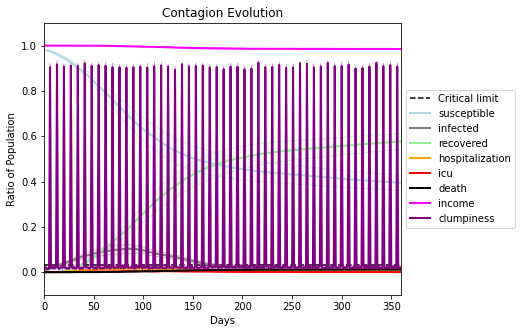

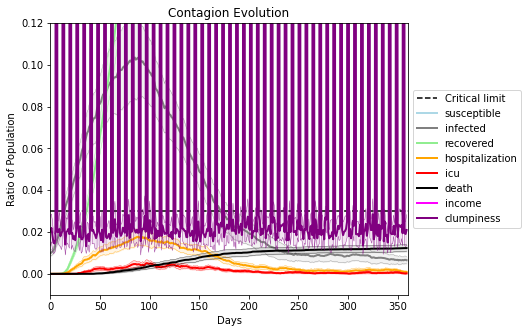

In [43]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8510, 5723, 1237, 8202, 4435, 2072, 4171, 2148, 6530, 3271, 8298, 4202, 862, 2804, 7906, 4725, 6659, 235, 1108, 9731]
Average similarity between family members is 0.010792901011560762 at temperature 1
Average similarity between family and home is 0.9998470791860621 at temperature -1
Average similarity between students and their classroom is 0.012754809724828555 at temperature 1
Average classroom occupancy is 4.071428571428571 and number classrooms is 70
Average similarity between workers is -0.002868169348099897 at temperature 1
Average office occupancy is 3.2663316582914574 and number offices is 199
Average friend similarity for adults: 0.0781757131303824 for kids: 0.08333693449722479
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity -0.0176157464841294
avg restaurant similarity -0.004637847087961743
avg restaurant similarity -0.047287675412126015
avg restaurant similarity 0.005443875364484197
avg restaurant similarity 0.009377882140134115
avg restaurant similarity -0.01886919024618135
avg restaurant similarity 0.007891092644988025
avg restaurant similarity -0.009207466356394935
avg restaurant similarity 0.00022293725052072313
avg restaurant similarity -0.018788686559654027
avg restaurant similarity -0.054731330397425025
avg restaurant similarity 0.009470508236736362
avg restaurant similarity 0.023817669454669343
avg restaurant similarity -0.05897746461557669
avg restaurant similarity 0.012585641397882692
avg restaurant similarity -0.02900056013322809
avg restaurant similarity 0.004731711286661421
avg restaurant similarity -0.014909439958974898
avg restaurant similarity 0.017047868336312326
avg restaurant similarity -0.03988770311376988
avg restaurant similarity -0.017244864858372504
avg r

avg restaurant similarity 0.0167250328245603
avg restaurant similarity 0.010743783877729026
avg restaurant similarity -0.010575736489374932
avg restaurant similarity -0.02687691146547259
avg restaurant similarity -0.030009790831193543
avg restaurant similarity -0.0019292466993779361
avg restaurant similarity 0.0028119724259928645
avg restaurant similarity -0.03889460362804094
avg restaurant similarity 0.0018474781415725764
avg restaurant similarity -0.0080382057636957
avg restaurant similarity -0.03736984600272629
avg restaurant similarity -0.018735302633161047
avg restaurant similarity 0.009834563560530233
avg restaurant similarity -0.01697279056450415
avg restaurant similarity 0.027939392554307645
avg restaurant similarity -0.06751708780870906
avg restaurant similarity -0.03705606113392854
avg restaurant similarity -0.027664132165657107
avg restaurant similarity -0.012554145885364371
avg restaurant similarity 0.011751201017863873
avg restaurant similarity -0.02094125370486409
avg res

avg restaurant similarity 0.0500757661832033
avg restaurant similarity -0.012369868473647499
avg restaurant similarity -0.00028560002242102093
avg restaurant similarity -0.008560567902049353
avg restaurant similarity 0.04146774978816793
avg restaurant similarity 0.004550130594562377
avg restaurant similarity 0.005544555645559294
avg restaurant similarity 0.0232888421197545
avg restaurant similarity 0.010959822454764484
avg restaurant similarity 0.03310349417054032
avg restaurant similarity 0.02399467535829935
avg restaurant similarity 0.03731563561222363
avg restaurant similarity 0.03350538025484541
avg restaurant similarity 0.005527961570129212
avg restaurant similarity -0.0007723264341266092
avg restaurant similarity 0.040942802423677
avg restaurant similarity 0.01980024384244852
avg restaurant similarity 0.020632610983258404
avg restaurant similarity 0.006361890045398343
avg restaurant similarity 0.024061761522704325
avg restaurant similarity -0.0028952340568104296
avg restaurant si

avg restaurant similarity 0.0007771537706953838
avg restaurant similarity 0.013460935418299774
avg restaurant similarity -0.04462149559765965
avg restaurant similarity 0.023710422745037874
avg restaurant similarity -0.007421827453426133
avg restaurant similarity -0.0013033359119223164
avg restaurant similarity 0.03490103256750834
avg restaurant similarity 0.034169841491639014
avg restaurant similarity 0.03712100750296348
avg restaurant similarity -0.015246502056680768
avg restaurant similarity 0.020875381165658895
avg restaurant similarity 0.020463280201726525
avg restaurant similarity 0.004355258205153056
avg restaurant similarity -0.008592611230354758
avg restaurant similarity 0.008720564878395664
avg restaurant similarity 0.02030413176422328
avg restaurant similarity -0.015318025520395373
avg restaurant similarity 0.03398167930585952
avg restaurant similarity 0.012826395103834367
avg restaurant similarity -0.007569405794113522
avg restaurant similarity -0.0003441497428028813
avg res

avg restaurant similarity 0.005111915052714616
avg restaurant similarity 0.039685610351433157
avg restaurant similarity 0.03656004688445595
avg restaurant similarity -0.029580616071258056
avg restaurant similarity 0.03582414227160525
avg restaurant similarity 0.010098226212869023
avg restaurant similarity -0.018006836304786094
avg restaurant similarity 0.038876010940334306
avg restaurant similarity 0.028305974616448563
avg restaurant similarity 0.016308966509105464
avg restaurant similarity -0.02716501346634665
avg restaurant similarity 0.013050796098087349
avg restaurant similarity 0.031144242418172593
avg restaurant similarity 0.03438698206470603
avg restaurant similarity 0.001886636188177592
avg restaurant similarity 0.024629306359749126
avg restaurant similarity 0.025104449965750997
avg restaurant similarity 0.019428008973874433
avg restaurant similarity 0.039551168378839714
avg restaurant similarity -0.03429206153857894
avg restaurant similarity 0.03437153529568515
avg restaurant 

avg restaurant similarity -0.00478697449170209
avg restaurant similarity 0.03612638598739955
avg restaurant similarity 0.04495880466122068
avg restaurant similarity 0.03333410370309788
avg restaurant similarity -0.0017779807351134093
avg restaurant similarity -0.023806306656539884
avg restaurant similarity 0.030109935005119725
avg restaurant similarity 0.06320763776634258
avg restaurant similarity 0.03856595782033521
avg restaurant similarity 0.028014179245977676
avg restaurant similarity -0.0013311491866739565
avg restaurant similarity 0.030982452942530825
avg restaurant similarity 0.05880518315272732
avg restaurant similarity 0.04602910988557147
avg restaurant similarity 0.016159590076364142
avg restaurant similarity 0.057574155698535454
avg restaurant similarity -0.011870432900795688
avg restaurant similarity 8.23944051183821e-05
avg restaurant similarity 0.048334313768803705
avg restaurant similarity 0.03404065390227999
avg restaurant similarity 0.027662288561796096
avg restaurant 

avg restaurant similarity 0.012731742270041532
avg restaurant similarity 0.024642485110039972
avg restaurant similarity 0.013345866120606623
avg restaurant similarity 0.016918380403277217
avg restaurant similarity 0.01946977676807707
avg restaurant similarity 0.023458113970851745
avg restaurant similarity -0.06630411920316726
avg restaurant similarity 0.005954386762349335
avg restaurant similarity -0.02111060862364031
avg restaurant similarity 0.020897923878490002
avg restaurant similarity 0.01900144784813347
avg restaurant similarity 0.02224047669910044
avg restaurant similarity -0.034051886643541134
avg restaurant similarity 0.05767203029222437
avg restaurant similarity -0.036027958719672806
avg restaurant similarity 0.006231412379136187
avg restaurant similarity -0.015583636751875015
avg restaurant similarity -0.006725056537327783
avg restaurant similarity -0.016783424963523787
avg restaurant similarity 0.0314165973919631
avg restaurant similarity 0.009668643159319923
avg restaurant

avg restaurant similarity 0.010139689023656948
avg restaurant similarity 0.021376086215562272
avg restaurant similarity -0.020867902431370332
avg restaurant similarity 0.0253190770118545
avg restaurant similarity -0.042516538672641414
avg restaurant similarity 0.007095932183540714
avg restaurant similarity 0.03579959701516289
avg restaurant similarity -0.003588543710806228
avg restaurant similarity 0.0452356240259328
avg restaurant similarity 0.033820725601964856
avg restaurant similarity -0.043215465139131194
avg restaurant similarity 0.042827370777778935
avg restaurant similarity 0.0036075450567255966
avg restaurant similarity -0.016743943454259457
avg restaurant similarity -0.023888176336205307
avg restaurant similarity 0.006068460553750244
avg restaurant similarity 0.016254081419574525
avg restaurant similarity -0.021693030158025588
avg restaurant similarity 0.05729854447773436
avg restaurant similarity -0.004057069212258753
avg restaurant similarity 0.006218182723430508
avg restau

avg restaurant similarity 0.02111453504151813
avg restaurant similarity -0.010037513611224168
avg restaurant similarity 0.018276497115834178
avg restaurant similarity -0.00823902184080557
avg restaurant similarity 0.03410201018493355
avg restaurant similarity 0.036021462366713795
avg restaurant similarity 0.017216834687835397
avg restaurant similarity -0.015167778249605864
avg restaurant similarity 0.020538813876277272
avg restaurant similarity 0.04637113022383599
avg restaurant similarity 0.024573830748155945
avg restaurant similarity 0.023506736694607334
avg restaurant similarity 0.0323476113468786
avg restaurant similarity -0.006285535180437574
avg restaurant similarity -0.005181163142791339
avg restaurant similarity -0.0008166755948426333
avg restaurant similarity 0.01580155639147231
avg restaurant similarity 0.02033888690548216
avg restaurant similarity -0.01630323487987756
avg restaurant similarity -0.0008083161839384006
avg restaurant similarity -0.003017440430779502
avg restaur

avg restaurant similarity -0.023486108305639422
avg restaurant similarity 0.005761058959427674
avg restaurant similarity -0.007099666583336836
avg restaurant similarity -0.009303448631821084
avg restaurant similarity 0.04402222316359998
avg restaurant similarity -0.014784012919794382
avg restaurant similarity 0.007373326880244448
avg restaurant similarity 0.0625902113669743
avg restaurant similarity 0.01788397502788134
avg restaurant similarity 0.004679883781978723
avg restaurant similarity -0.0023211273744354536
avg restaurant similarity -0.0026039455102181215
avg restaurant similarity 0.010462454174561597
avg restaurant similarity 0.0019718131924018898
avg restaurant similarity -0.01099909161995945
avg restaurant similarity -0.0032533607704489636
avg restaurant similarity 0.0037568193498387996
avg restaurant similarity -0.03634643552523415
avg restaurant similarity 0.005381559179819635
avg restaurant similarity 0.032773770899526114
avg restaurant similarity 0.04533451634015134
avg re

avg restaurant similarity 0.0025377498963327968
avg restaurant similarity 0.007372839295827556
avg restaurant similarity 0.01686926656395686
avg restaurant similarity -0.03143356063328835
avg restaurant similarity -0.005642968065131981
avg restaurant similarity -0.005974368926218524
avg restaurant similarity 0.015648578005041984
avg restaurant similarity 0.01707135757804696
avg restaurant similarity 0.04897682502711904
avg restaurant similarity -0.04576795556627508
avg restaurant similarity 0.035747260551836225
avg restaurant similarity 0.014779332940130514
avg restaurant similarity 0.06221755577609076
avg restaurant similarity -0.008548247191567456
avg restaurant similarity -0.012398199669960206
avg restaurant similarity 0.0018719347404614602
avg restaurant similarity -0.005104875526528922
avg restaurant similarity -0.032263494227985426
avg restaurant similarity -0.01834527064724385
avg restaurant similarity 0.012580907283415469
avg restaurant similarity 0.022691899420143605
avg resta

avg restaurant similarity 0.009333536924965555
avg restaurant similarity -0.0009981020313956568
avg restaurant similarity 0.005236091068435645
avg restaurant similarity -0.03800730877874726
avg restaurant similarity -0.010794684005254088
avg restaurant similarity 0.03367615732642469
avg restaurant similarity 0.017983766582055243
avg restaurant similarity -0.002104032702058418
avg restaurant similarity -0.020346987889757136
avg restaurant similarity 0.005501015683842154
avg restaurant similarity -0.002549219014220032
avg restaurant similarity 0.02376002764014199
avg restaurant similarity 0.0011779502535461874
avg restaurant similarity 0.029613089314465622
avg restaurant similarity -0.004539080611737012
avg restaurant similarity 0.012560389085948307
avg restaurant similarity 0.012163466262153042
avg restaurant similarity 0.016186287992021542
avg restaurant similarity -0.016052201262669673
avg restaurant similarity -0.022019365426030977
avg restaurant similarity 0.01656137214331556
avg re

avg restaurant similarity 0.028737780160949373
avg restaurant similarity -0.0011201730389711665
avg restaurant similarity 0.02824241210255067
avg restaurant similarity 0.010679301514822069
avg restaurant similarity -0.03918192893585019
avg restaurant similarity -0.025575323810318077
avg restaurant similarity 0.03761812652749134
avg restaurant similarity -0.007722289805262689
avg restaurant similarity -0.02666717636997923
avg restaurant similarity 0.02007280129668631
avg restaurant similarity -0.08648705083747922
avg restaurant similarity 0.03601443565262269
avg restaurant similarity -0.042634308904848026
avg restaurant similarity -0.04432114866634213
avg restaurant similarity -0.006839171841088101
avg restaurant similarity -0.010713943169291577
avg restaurant similarity 1.5401761571050474e-06
avg restaurant similarity -0.027491070546044275
avg restaurant similarity 0.005637833318993814
avg restaurant similarity 0.0180607836878975
avg restaurant similarity -0.0061283811122758184
avg res

avg restaurant similarity 0.005644031241173035
avg restaurant similarity -0.003794274438677229
avg restaurant similarity 0.008400166168758594
avg restaurant similarity 0.038228884690258334
avg restaurant similarity 0.02291806016596982
avg restaurant similarity 0.0010153220690141075
avg restaurant similarity 0.0409131173665591
avg restaurant similarity -0.05685385346491003
avg restaurant similarity 0.03923278646075419
avg restaurant similarity 0.03742567244982842
avg restaurant similarity 0.004060976697876611
avg restaurant similarity -0.0202991665136465
avg restaurant similarity 0.00017656739776332117
avg restaurant similarity 0.009897328706469479
avg restaurant similarity 0.01423640974231354
avg restaurant similarity 0.011283722346103158
avg restaurant similarity -0.03526950497672653
avg restaurant similarity 0.021565224979927588
avg restaurant similarity -0.008187736619906068
avg restaurant similarity -0.020699124722531024
avg restaurant similarity -0.006658274371429873
avg restauran

avg restaurant similarity -0.01139765128584115
avg restaurant similarity 0.01702419287585324
avg restaurant similarity 0.00013850054811566874
avg restaurant similarity -0.02444143101637976
avg restaurant similarity -0.025013137216328144
avg restaurant similarity 0.02294395387820153
avg restaurant similarity -0.030996783348834423
avg restaurant similarity -0.0684435969988813
avg restaurant similarity -0.027694019393512848
avg restaurant similarity 0.023562967515160422
avg restaurant similarity -0.010517211230370263
avg restaurant similarity 0.026623444519428174
avg restaurant similarity -0.016361597563601366
avg restaurant similarity 0.015452616008379364
avg restaurant similarity 0.019499692712097925
avg restaurant similarity 0.003929360953796033
avg restaurant similarity 0.031123506086099408
avg restaurant similarity -0.0384652955952718
avg restaurant similarity -0.012949683751626407
avg restaurant similarity 0.031622191718919744
avg restaurant similarity 0.02022167029053632
avg restau

avg restaurant similarity 0.015762054955934468
avg restaurant similarity -0.04706034660359132
avg restaurant similarity -0.0010680690504405502
avg restaurant similarity 0.0036509525319621317
avg restaurant similarity -0.03581463181013865
avg restaurant similarity -0.0010129083520147475
avg restaurant similarity -0.06528271811844508
avg restaurant similarity -0.00281670528077784
avg restaurant similarity -0.014209253214129735
avg restaurant similarity 0.002976174890467113
avg restaurant similarity 0.002315637947690041
avg restaurant similarity 0.015196673701498147
avg restaurant similarity -0.037563945243211064
avg restaurant similarity 0.019422709294452715
avg restaurant similarity -0.037032816104341434
avg restaurant similarity -0.01377105687104694
avg restaurant similarity -0.020282848561705882
avg restaurant similarity -0.021771883915629026
avg restaurant similarity 0.017188052873515016
avg restaurant similarity 0.007614143300272059
avg restaurant similarity -0.005642349319572762
av

avg restaurant similarity 0.024471598558003297
avg restaurant similarity 0.05345672002401311
avg restaurant similarity 0.014194975955424924
avg restaurant similarity 0.04989798894856488
avg restaurant similarity 0.0826819585440378
avg restaurant similarity 0.04688633710091816
avg restaurant similarity 0.02866917252068527
avg restaurant similarity 0.09177227551092965
avg restaurant similarity 0.07469813126810482
avg restaurant similarity 0.051837717303452685
avg restaurant similarity 0.01622989998223509
avg restaurant similarity 0.028590073175608022
avg restaurant similarity 0.04614352856595827
avg restaurant similarity 0.0502211200857751
avg restaurant similarity 0.03196585028968693
avg restaurant similarity 0.05141598024215149
avg restaurant similarity 0.046388997389815285
avg restaurant similarity 0.023898774537107516
avg restaurant similarity 0.017292752814532842
avg restaurant similarity 0.09210491949087728
avg restaurant similarity 0.09008692891001936
avg restaurant similarity 0.0

avg restaurant similarity 0.029484009763358257
avg restaurant similarity 0.0248058021934773
avg restaurant similarity -0.020407670255408756
avg restaurant similarity 0.02462665131829294
avg restaurant similarity 0.0382408334600322
avg restaurant similarity 0.031193533486766307
avg restaurant similarity 0.039246760215905764
avg restaurant similarity 0.038522431936836354
avg restaurant similarity 0.06797790078115246
avg restaurant similarity 0.043992736109292115
avg restaurant similarity 0.04558335745278775
avg restaurant similarity 0.03010969387628777
avg restaurant similarity 0.014562218956384727
avg restaurant similarity 0.02045118065680663
avg restaurant similarity 0.061596452198393055
avg restaurant similarity 0.027536790280102398
avg restaurant similarity -0.011104166779178342
avg restaurant similarity 0.008351533710668664
avg restaurant similarity -0.0031381834708340043
avg restaurant similarity 0.043756416447294985
avg restaurant similarity -0.019907834635746743
avg restaurant si

avg restaurant similarity -0.011804929048013345
avg restaurant similarity 0.012992663484817627
avg restaurant similarity 0.027145341423755714
avg restaurant similarity 0.026789153057535237
avg restaurant similarity -0.029536570087055278
avg restaurant similarity 0.0020990438660151204
avg restaurant similarity 0.01967949591329263
avg restaurant similarity 0.006886456031121451
avg restaurant similarity 0.017212168889032493
avg restaurant similarity -0.023033353699531696
avg restaurant similarity 0.010563902002529808
avg restaurant similarity 0.006663054995177146
avg restaurant similarity -0.004012347800022169
avg restaurant similarity -0.01539425703093762
avg restaurant similarity 0.03921432471492316
avg restaurant similarity 0.022121187690843223
avg restaurant similarity 0.06770582318682061
avg restaurant similarity -0.0056974364504989656
avg restaurant similarity -0.03774722526815922
avg restaurant similarity 0.0288064964559595
avg restaurant similarity -0.018012885281558432
avg restau

avg restaurant similarity 0.028989846839198582
avg restaurant similarity 0.0322642812972774
avg restaurant similarity 0.00032702669174407316
avg restaurant similarity -0.036517460638754426
avg restaurant similarity -0.0011254626050016558
avg restaurant similarity 0.028288225100843802
avg restaurant similarity 0.04946885145376435
avg restaurant similarity -0.020940407523980038
avg restaurant similarity 0.01626512731985791
avg restaurant similarity 0.03134337100058642
avg restaurant similarity 0.029974520495751382
avg restaurant similarity 0.01743780141566927
avg restaurant similarity 0.02260866334560579
avg restaurant similarity -0.014772295906361994
avg restaurant similarity -0.006350919801917957
avg restaurant similarity -0.006782105060923188
avg restaurant similarity -0.01192664717987175
avg restaurant similarity 0.004880381652861347
avg restaurant similarity 0.020584972433905543
avg restaurant similarity 0.031470210050951124
avg restaurant similarity -0.002996351737842919
avg restau

avg restaurant similarity 0.014277843158657879
avg restaurant similarity -0.01396407938705464
avg restaurant similarity -0.02606595141372063
avg restaurant similarity -0.020467638960888018
avg restaurant similarity 0.015184318034360458
avg restaurant similarity 0.02793301060837993
avg restaurant similarity -0.04867705024511291
avg restaurant similarity -0.05184319668208579
avg restaurant similarity -0.010307889893081885
avg restaurant similarity 0.03827009048887972
avg restaurant similarity -0.004111432957989233
avg restaurant similarity 0.0097602256421581
avg restaurant similarity -0.0250061744434789
avg restaurant similarity -0.02248529715244407
avg restaurant similarity -0.021627561753286985
avg restaurant similarity -0.0049377848503993635
avg restaurant similarity -0.033349642010154626
avg restaurant similarity -0.0056281194708229605
avg restaurant similarity -0.034931113336374796
avg restaurant similarity 0.04681847928433089
avg restaurant similarity -0.05008685195104836
avg resta

avg restaurant similarity -0.02648744670282438
avg restaurant similarity -0.048875934529183644
avg restaurant similarity 2.4553696571721643e-05
avg restaurant similarity 0.020385190861900104
avg restaurant similarity 0.028787667572315233
avg restaurant similarity -0.0696564587432439
avg restaurant similarity 0.0389366127213615
avg restaurant similarity -0.017264037950701566
avg restaurant similarity -0.021791330440152124
avg restaurant similarity 0.0030421764625016496
avg restaurant similarity 0.002406639862619171
avg restaurant similarity 0.015185662834839561
avg restaurant similarity -0.018035108882645267
avg restaurant similarity 0.025437188012258114
avg restaurant similarity -0.04467741276582436
avg restaurant similarity -0.002430202223397369
avg restaurant similarity 0.0050403988540262895
avg restaurant similarity -0.05392362987520061
avg restaurant similarity -0.05383128249811392
avg restaurant similarity -0.019968428099310435
avg restaurant similarity -0.03729953552449763
avg re

avg restaurant similarity 0.006836378535501304
avg restaurant similarity 0.019607288015945204
avg restaurant similarity -0.0028353195140845755
avg restaurant similarity 0.04217872910713471
avg restaurant similarity 0.024293490522054102
avg restaurant similarity -0.03157057566525214
avg restaurant similarity -0.02690829513609551
avg restaurant similarity -0.023257918142234595
avg restaurant similarity -0.00033426820765409176
avg restaurant similarity -0.00813567591401108
avg restaurant similarity -0.030294483594568614
avg restaurant similarity -0.02839938742055638
avg restaurant similarity 0.02178756586170645
avg restaurant similarity 0.012649016729921053
avg restaurant similarity -0.010360265258727191
avg restaurant similarity -0.021949498861345444
avg restaurant similarity 0.0130059443086562
avg restaurant similarity 0.032810049562551936
avg restaurant similarity -0.01414358829642098
avg restaurant similarity 0.04578905976321329
avg restaurant similarity -0.00631736919981414
avg resta

avg restaurant similarity 0.006241315978886771
avg restaurant similarity -0.0011282446539513274
avg restaurant similarity -0.002530808971477902
avg restaurant similarity 0.006089307776339764
avg restaurant similarity 0.0006469469449411013
avg restaurant similarity 0.0037522700016057358
avg restaurant similarity 0.008486426968620113
avg restaurant similarity -0.032876047733554334
avg restaurant similarity -0.010762756115356499
avg restaurant similarity 0.02981725678383995
avg restaurant similarity 0.048699368489443576
avg restaurant similarity -0.02041322334948249
avg restaurant similarity 0.009850325391149786
avg restaurant similarity -0.010910448033266337
avg restaurant similarity -0.026054587235890825
avg restaurant similarity 0.04090856792852806
avg restaurant similarity 0.004858052551723817
avg restaurant similarity -0.001538299650077204
avg restaurant similarity -0.0017107448587074202
avg restaurant similarity -0.0003889845375758321
avg restaurant similarity 0.025764813540075926
a

avg restaurant similarity -0.006688590926761512
avg restaurant similarity 0.0024181417004992233
avg restaurant similarity 0.039381185312140306
avg restaurant similarity 0.026188407205444252
avg restaurant similarity -0.005947264142619088
avg restaurant similarity -0.011577041040157122
avg restaurant similarity 0.044408320188704054
avg restaurant similarity -0.02094901778803269
avg restaurant similarity 0.0173192290447231
avg restaurant similarity 0.03557160050852402
avg restaurant similarity 0.009866644835790639
avg restaurant similarity 0.006919919795503304
avg restaurant similarity 0.020238717591985454
avg restaurant similarity 0.016244895686842942
avg restaurant similarity 0.005237714499254214
avg restaurant similarity 0.05310837700498
avg restaurant similarity -0.05696706162727838
avg restaurant similarity -0.009478201924758766
avg restaurant similarity 0.016482534245369128
avg restaurant similarity 0.01329386035065288
avg restaurant similarity -0.0026694950126720965
avg restaurant

avg restaurant similarity 0.04388400629800492
avg restaurant similarity 0.05313445666462916
avg restaurant similarity -0.0006511750320667937
avg restaurant similarity -0.0015279262473252974
avg restaurant similarity -0.001413673451045819
avg restaurant similarity -0.03997055839085919
avg restaurant similarity 0.01732303647139172
avg restaurant similarity 0.029618606171743122
avg restaurant similarity 0.023005107789146436
avg restaurant similarity -0.015307994407318695
avg restaurant similarity 0.04332934109215743
avg restaurant similarity 0.006349267639364261
avg restaurant similarity 0.017767062716968086
avg restaurant similarity 0.03870952467978771
avg restaurant similarity 0.039381687108144325
avg restaurant similarity -0.003267680618677719
avg restaurant similarity 0.05582039481834073
avg restaurant similarity 0.02361868433350484
avg restaurant similarity -0.001896521171508669
avg restaurant similarity -0.015256414770954334
avg restaurant similarity -0.059667711265471844
avg restau

avg restaurant similarity 0.01439453519618364
avg restaurant similarity -0.010847820313170607
avg restaurant similarity 0.023079069836126263
avg restaurant similarity 0.03548219601815001
avg restaurant similarity 0.03098034565053057
avg restaurant similarity -0.0397487356541121
avg restaurant similarity 0.0029386579276669497
avg restaurant similarity 0.013718714725252278
avg restaurant similarity 0.01483469889878896
avg restaurant similarity 0.025793343852594443
avg restaurant similarity 0.08340459043369874
avg restaurant similarity 0.0011832392915097965
avg restaurant similarity 0.03093013454411274
avg restaurant similarity 0.01502178086504719
avg restaurant similarity 0.02121873177760009
avg restaurant similarity 0.03595581372518677
avg restaurant similarity 0.02025872439741925
avg restaurant similarity 0.020288402032321642
avg restaurant similarity 0.011787603504976983
avg restaurant similarity 0.0444887992590304
avg restaurant similarity -0.0042292392596021
avg restaurant similarit

avg restaurant similarity -0.005811527095833445
avg restaurant similarity -0.008222428674961625
avg restaurant similarity -0.005697530447569388
avg restaurant similarity -0.009079682402255118
avg restaurant similarity 0.03812870968784521
avg restaurant similarity 0.027637441792861456
avg restaurant similarity 0.005135921126182914
avg restaurant similarity 0.025757494880578515
avg restaurant similarity 0.03271090808291056
avg restaurant similarity 0.010571021380887308
avg restaurant similarity -0.01730053775942845
avg restaurant similarity -0.0029001085458774008
avg restaurant similarity 0.004664278140052278
avg restaurant similarity -0.0030639279147577215
avg restaurant similarity -0.015161884489266302
avg restaurant similarity 0.005171394794191582
avg restaurant similarity 0.00497225631118308
avg restaurant similarity -0.046064821178243766
avg restaurant similarity 0.027074168870242228
avg restaurant similarity 0.005147450137606958
avg restaurant similarity 0.04303375307676264
avg res

avg restaurant similarity 0.06078789721331765
avg restaurant similarity -0.011868931309143306
avg restaurant similarity 0.019078415170538283
avg restaurant similarity 0.038360773198754285
avg restaurant similarity 0.0409942368724033
avg restaurant similarity 0.04049607689995893
avg restaurant similarity 0.04504409030680615
avg restaurant similarity 0.02125778957029674
avg restaurant similarity -0.00835710428463108
avg restaurant similarity 0.03412405979201852
avg restaurant similarity 0.05519532404506238
avg restaurant similarity 0.049250912834222824
avg restaurant similarity 0.028211856938446966
avg restaurant similarity 0.04676178882644167
avg restaurant similarity 0.02853859836020223
avg restaurant similarity -0.02129180933168821
avg restaurant similarity 0.012070258327980338
avg restaurant similarity -0.001746851254772493
avg restaurant similarity 0.022711968387436676
avg restaurant similarity 0.009146497879442016
avg restaurant similarity -0.0035772683920148084
avg restaurant simi

avg restaurant similarity 0.042931313610144586
avg restaurant similarity 0.03227373468300396
avg restaurant similarity 0.037144558225300134
avg restaurant similarity -0.0007997214858699208
avg restaurant similarity 0.04537978667949549
avg restaurant similarity 0.05577174377938502
avg restaurant similarity 0.06949988022352925
avg restaurant similarity 0.025684265767258532
avg restaurant similarity 0.01499053171081593
avg restaurant similarity 0.029809253911159347
avg restaurant similarity 0.005799003942503195
avg restaurant similarity 0.013406399093891831
avg restaurant similarity 0.06293094782387888
avg restaurant similarity 0.04748152101190678
avg restaurant similarity -0.009289839024954154
avg restaurant similarity 0.04029470793575356
avg restaurant similarity 0.0020135408452456485
avg restaurant similarity 0.0068389001882208315
avg restaurant similarity 0.039095075076275056
avg restaurant similarity 0.0669793800946252
avg restaurant similarity 0.04152492680618773
avg restaurant simi

avg restaurant similarity -0.009081450283010295
avg restaurant similarity -0.05058470275049022
avg restaurant similarity -0.02793167476131656
avg restaurant similarity 0.024629447286464032
avg restaurant similarity -0.022721877270071394
avg restaurant similarity 0.012136027713822137
avg restaurant similarity -0.05370329585846813
avg restaurant similarity -0.016528053524624463
avg restaurant similarity -0.014433669740130987
avg restaurant similarity 0.025850500068375255
avg restaurant similarity 0.003365242622995972
avg restaurant similarity 0.008718412678545102
avg restaurant similarity 0.01802807827383586
avg restaurant similarity 0.028573751305930054
avg restaurant similarity -0.028140483058090252
avg restaurant similarity 0.03998940173212453
avg restaurant similarity -0.035124121264354435
avg restaurant similarity -0.021639915489071525
avg restaurant similarity 0.015548675728927897
avg restaurant similarity -0.013617755162833577
avg restaurant similarity 0.021635594055909948
avg res

avg restaurant similarity 0.01854757640478472
avg restaurant similarity -0.00524359999262172
avg restaurant similarity 0.02168507506919405
avg restaurant similarity 0.005051403887376257
avg restaurant similarity 0.0004774961527898516
avg restaurant similarity 0.022102860222737514
avg restaurant similarity 0.03525925039090264
avg restaurant similarity 0.015696087608255593
avg restaurant similarity -0.036386353412323325
avg restaurant similarity 0.013704635679980743
avg restaurant similarity -0.03499269116488822
avg restaurant similarity -0.07790103333180194
avg restaurant similarity 0.02644371367562204
avg restaurant similarity 0.019346984454881543
avg restaurant similarity 0.009243059778853141
avg restaurant similarity 0.016166723322585515
avg restaurant similarity 0.01383258494357047
avg restaurant similarity -0.04110864624012926
avg restaurant similarity -0.03484627927224922
avg restaurant similarity 0.002802554683211463
avg restaurant similarity -0.04122906439234719
avg restaurant s

avg restaurant similarity -0.005741611069647205
avg restaurant similarity -0.002439827922215841
avg restaurant similarity -0.004164660113638078
avg restaurant similarity 0.004872560546688442
avg restaurant similarity -0.025719746043061084
avg restaurant similarity 0.004910800958031085
avg restaurant similarity 0.005186464306910211
avg restaurant similarity -0.05608915544388154
avg restaurant similarity 0.03484229819043087
avg restaurant similarity 0.009405358879420013
avg restaurant similarity -0.014927406224999442
avg restaurant similarity 0.012998077748409824
avg restaurant similarity 0.012966209032615462
avg restaurant similarity -0.007534025386924454
avg restaurant similarity 0.010185508752366918
avg restaurant similarity -0.0714233747354847
avg restaurant similarity 0.009700298690793764
avg restaurant similarity 0.0042658872453271955
avg restaurant similarity 0.01158879989059157
avg restaurant similarity 0.06552630148370953
avg restaurant similarity -0.03166473218874216
avg restau

avg restaurant similarity 0.02277351021563639
avg restaurant similarity -0.046417873454265644
avg restaurant similarity 0.022574871320655433
avg restaurant similarity 0.03256011395642957
avg restaurant similarity -0.007942391237634907
avg restaurant similarity 0.0033849468065413595
avg restaurant similarity -0.004723346088188187
avg restaurant similarity 0.015541779974055708
avg restaurant similarity -0.01974845639924742
avg restaurant similarity 0.02195695109582865
avg restaurant similarity 0.027722939279568884
avg restaurant similarity 0.03205951126091541
avg restaurant similarity -0.03178837047814707
avg restaurant similarity 0.012203642434151115
avg restaurant similarity 0.008802078803056052
avg restaurant similarity 0.00343242451279156
avg restaurant similarity -0.014312658746237805
avg restaurant similarity 0.030397901986561705
avg restaurant similarity 0.022599284561307623
avg restaurant similarity -0.014143358480563662
avg restaurant similarity 0.02555464744661791
avg restauran

avg restaurant similarity -0.03591945334459122
avg restaurant similarity -0.0026735910942567113
avg restaurant similarity -0.0120536624145107
avg restaurant similarity -0.000284188396487563
avg restaurant similarity 0.017871212671944824
avg restaurant similarity -0.03875367374204621
avg restaurant similarity -0.015073148564045744
avg restaurant similarity 0.03142003228066014
avg restaurant similarity 0.019901782961859744
avg restaurant similarity -0.012869500742660472
avg restaurant similarity -0.012923990070453766
avg restaurant similarity -0.00843927139454928
avg restaurant similarity 0.01503207446012202
avg restaurant similarity -0.010929917774034245
avg restaurant similarity 0.04243127725966531
avg restaurant similarity 0.03094391180727408
avg restaurant similarity 0.048682772289317895
avg restaurant similarity 0.016991516134394594
avg restaurant similarity 0.030947489391150704
avg restaurant similarity -0.01724830190990535
avg restaurant similarity -0.013576954057313868
avg restau

avg restaurant similarity 0.03239849317609451
avg restaurant similarity 0.019167223763468372
avg restaurant similarity 0.027594312221967204
avg restaurant similarity 0.007731382481419831
avg restaurant similarity -0.03222587737468192
avg restaurant similarity 0.029799636660593248
avg restaurant similarity 0.004443027681151021
avg restaurant similarity -0.015516837307504503
avg restaurant similarity 0.004469576513837929
avg restaurant similarity 0.024566212021154277
avg restaurant similarity -0.020884522868082598
avg restaurant similarity 0.014982027402594359
avg restaurant similarity -0.006026396878805301
avg restaurant similarity 0.05701178218443879
avg restaurant similarity 0.015719835353666972
avg restaurant similarity -0.01939297738310584
avg restaurant similarity 0.009826624740632188
avg restaurant similarity -0.005578629478821779
avg restaurant similarity -0.05221480118485431
avg restaurant similarity -0.04092459883530042
avg restaurant similarity -0.020836032715841002
avg restau

avg restaurant similarity 0.02254617986725032
avg restaurant similarity 0.006546072099352605
avg restaurant similarity -0.012604519915939274
avg restaurant similarity -0.01068845743583508
avg restaurant similarity 0.0064313544233656995
avg restaurant similarity -0.0142952755638336
avg restaurant similarity 0.004719439561459658
avg restaurant similarity 0.015349129186828597
avg restaurant similarity -0.01114237114228134
avg restaurant similarity 0.05281542129562824
avg restaurant similarity 0.017720946323486978
avg restaurant similarity -0.0046696738805046155
avg restaurant similarity 0.022499268366366086
avg restaurant similarity 0.014452376751133457
avg restaurant similarity 0.00607286083970203
avg restaurant similarity 0.04609884240694519
avg restaurant similarity 0.006439804626727587
avg restaurant similarity -0.012184559543036001
avg restaurant similarity -0.00991825206979554
avg restaurant similarity -0.00547683446667914
avg restaurant similarity 0.00022826245774663106
avg restaur

avg restaurant similarity 0.009332080553819058
avg restaurant similarity -0.018705275810735635
avg restaurant similarity -0.012598179640655911
avg restaurant similarity 0.015939745382309526
avg restaurant similarity -0.014619044784127396
avg restaurant similarity -0.020259844511303228
avg restaurant similarity -0.04826895432453451
avg restaurant similarity 0.01990706196817896
avg restaurant similarity -0.056235244910047937
avg restaurant similarity 0.03825249873452447
avg restaurant similarity 0.045260516358284174
avg restaurant similarity 0.008500234204148438
avg restaurant similarity 0.00945016628643483
avg restaurant similarity 0.011572100914063771
avg restaurant similarity -0.01951414014783812
avg restaurant similarity 0.04212776716448279
avg restaurant similarity 0.028691457573983344
avg restaurant similarity -0.05774069385905316
avg restaurant similarity 0.004029734302851664
avg restaurant similarity 0.010047320436468792
avg restaurant similarity -0.004600470953432136
avg restaur

avg restaurant similarity 0.04216542520290505
avg restaurant similarity 0.001989786751132018
avg restaurant similarity 0.011049739826626284
avg restaurant similarity -0.010610843031588343
avg restaurant similarity 0.04199058815987631
avg restaurant similarity 0.025585329258874842
avg restaurant similarity 0.03611293733524084
avg restaurant similarity 0.006462019154670956
avg restaurant similarity -0.020659572574512317
avg restaurant similarity 0.014439773500593403
avg restaurant similarity 0.032996955506001006
avg restaurant similarity -0.027291275069111574
avg restaurant similarity -0.011471351184039852
avg restaurant similarity -0.021314813900209947
avg restaurant similarity 0.015142502280652953
avg restaurant similarity -0.009104352661119077
avg restaurant similarity 0.007341507455378232
avg restaurant similarity 0.02633217051802428
avg restaurant similarity 0.04797130788373132
avg restaurant similarity -0.005671401831111907
avg restaurant similarity -0.030087531148450204
avg restau

avg restaurant similarity 0.022243742915605554
avg restaurant similarity 0.0025586624170319604
avg restaurant similarity 0.010694756042072862
avg restaurant similarity 0.034041994291686424
avg restaurant similarity -0.003768274870239017
avg restaurant similarity -0.015885597454500636
avg restaurant similarity -0.0064948993606411464
avg restaurant similarity 0.026534915545524774
avg restaurant similarity 0.007646986307554558
avg restaurant similarity 0.06163820994695722
avg restaurant similarity 0.0009802659129323574
avg restaurant similarity -0.007854518861923027
avg restaurant similarity 0.007918033774430884
avg restaurant similarity 5.687925177132649e-05
avg restaurant similarity -0.036373458668653554
avg restaurant similarity 0.06456908194554593
avg restaurant similarity 0.0018278138494359582
avg restaurant similarity 0.00662315343475677
avg restaurant similarity -0.04141888695281821
avg restaurant similarity 0.033554329799541184
avg restaurant similarity 2.274110720808346e-05
avg r

(<function dict.items>, <function dict.items>, <function dict.items>)

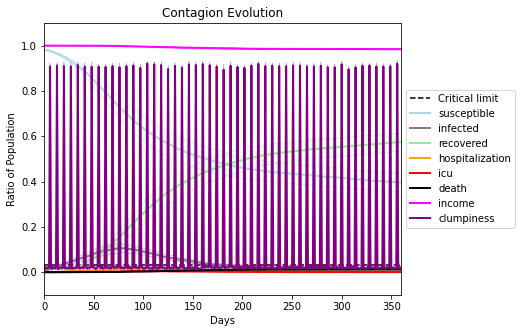

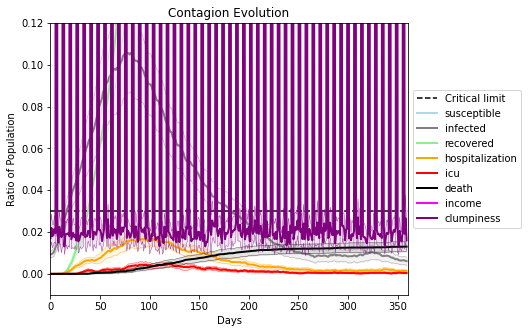

In [44]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)